<a href="https://colab.research.google.com/github/sundar911/fake_review_detection/blob/main/multi_head_HAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#imports and setup


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import numpy as np
import pandas as pd
import os
import pickle
import spacy

from pathlib import Path
from sklearn.model_selection import train_test_split
from gensim.utils import tokenize

/usr/local/lib/python3.9/dist-packages/torch/cuda/__init__.py:497: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")


##yelp dataset

In [ ]:
import sqlite3
import pandas as pd
# Create your connection.
cnx = sqlite3.connect('/content/drive/MyDrive/DL Project | Sundar NIT-T/yelp_dataset/yelpResData.db')
#cnx.text_factory = bytes
cnx.text_factory = lambda b: b.decode(errors = 'ignore')

df = pd.read_sql_query("SELECT * FROM review", cnx) #contains 5 tables (csv files): hotel, review, reviewer, sqlite_stat1, sqlite_stat2

In [ ]:
df

,date,reviewID,reviewerID,reviewContent,rating,usefulCount,coolCount,funnyCount,flagged,restaurantID
0,9/22/2012,GtwU21YOQn-wf4vWRUIx6w,bNYesZ944s6IJVowOnB0iA,"Unlike Next, which we'd eaten at the previous ...",5,0,0,0,N,pbEiXam9YJL3neCYHGwLUA
1,9/22/2012,0LpVTc3,TRKxLC3y-ZvP45e5iilMtw,Probably one of the best meals I've had ever. ...,5,0,0,0,N,pbEiXam9YJL3neCYHGwLUA
2,9/19/2012,tljtLzf68Fkwf,0EMm8umAqXZzyhxNpL4M9g,Service was impeccable. Experience and present...,3,2,0,0,N,pbEiXam9YJL3neCYHGwLUA
3,9/6/2012,iSN,DlwexC7z88ymAzu45skODw,"The problem with places like this, given the e...",3,8,0,3,N,pbEiXam9YJL3neCYHGwLUA
4,9/9/2012,Jmwrh7,kW2dk1CWihmh3g7k9N2G8A,I have no idea how to write my review - dining...,5,1,2,0,N,pbEiXam9YJL3neCYHGwLUA
...,...,...,...,...,...,...,...,...,...,...
788466,8/11/2010,wlRLaN_7uW8wUfWGN2VWaA,zZ7Jv1LONquJKkWT4VaSAw,"Oh Yelp, how I love thee...let me count the wa...",5,3,3,3,YR,ODxgfOWurWb0HjmshUTuTA
788467,8/11/2010,p4KYz4FE4bnkXdFZFyNM_Q,zZ7Jv1LONquJKkWT4VaSAw,I originally thought I'd give this place only ...,5,4,3,3,NR,pyZeiWGwzbb1jO1XS1iCeg
788468,8/5/2010,jqy-fe-EuFICjRbBwEA89g,zZ7Jv1LONquJKkWT4VaSAw,YUM! YUM! YUM! My husband and I went here for...,4,2,0,0,NR,UACRe1ZDEfK3DpTKciYGdg
788469,8/5/2010,D9IPwOicWnGY01A9MPwYjg,zZ7Jv1LONquJKkWT4VaSAw,A great neighborhood bar! I wish I could have...,4,0,1,0,YR,vEzJt2Ouq0KZcTNLk-KBgw


In [ ]:
df.flagged.value_counts()

NR    402774
YR    318678
N      58716
Y       8303
Name: flagged, dtype: int64

https://sci-hub.ru/https://link.springer.com/article/10.1007/s42001-021-00114-y -> table 1 page 11

In [ ]:
df = df[(df.flagged=='Y') | (df.flagged=='N')]
df = df[['reviewContent', 'flagged']]

In [ ]:
df

,reviewContent,flagged
0,"Unlike Next, which we'd eaten at the previous ...",N
1,Probably one of the best meals I've had ever. ...,N
2,Service was impeccable. Experience and present...,N
3,"The problem with places like this, given the e...",N
4,I have no idea how to write my review - dining...,N
...,...,...
497204,I've passed this place a bunch of times on my ...,N
501512,Rubino's is not really setup as a retail opera...,N
504898,This place is amazing. The food is great and ...,N
506036,OK went back the next day as I was driving by ...,N


In [ ]:
df.flagged.value_counts()

N    58716
Y     8303
Name: flagged, dtype: int64

In [ ]:
df_y = df[df.flagged=='Y']
df_n = df[df.flagged=='N']

In [ ]:
0.2*58716

11743.2

In [ ]:
df_n = df_n.sample(frac=0.2)

In [ ]:
df = pd.concat([df_y, df_n])

In [ ]:
df.flagged.value_counts()

N    11743
Y     8303
Name: flagged, dtype: int64

In [ ]:
df.rename(columns = {'reviewContent':'review'}, inplace = True)

In [ ]:
df

,review,flagged
58589,The food is amazing. I have two tickets for t...,Y
58590,I did not know what to expect from this restau...,Y
58591,I liked the services offered by (Alinea) resta...,Y
58592,I liked the services offered by (Alinea) resta...,Y
58593,Presumably one of the best restaurants in Amer...,Y
...,...,...
27703,"This was great deep dish, and it will be your ...",N
48189,"The food here is decent, at best. To be honest...",N
11744,The Bongo Room is by far one of my favorite br...,N
57564,"My first deep dish, and I was not disappointed...",N


In [ ]:
df.flagged.replace({'Y':1, 'N':0}, inplace=True)

In [ ]:
df

,review,flagged
58589,The food is amazing. I have two tickets for t...,1
58590,I did not know what to expect from this restau...,1
58591,I liked the services offered by (Alinea) resta...,1
58592,I liked the services offered by (Alinea) resta...,1
58593,Presumably one of the best restaurants in Amer...,1
...,...,...
27703,"This was great deep dish, and it will be your ...",0
48189,"The food here is decent, at best. To be honest...",0
11744,The Bongo Room is by far one of my favorite br...,0
57564,"My first deep dish, and I was not disappointed...",0


In [ ]:
df.flagged.value_counts()

0    11743
1     8303
Name: flagged, dtype: int64

##myle ott dataset

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/DL Project | Sundar NIT-T/trial_dataset.csv')

In [ ]:
df

,review_text,label
0,The Amalfi Hotel has a beautiful website and i...,1.0
1,First stepping foot on the hotel propety I cou...,1.0
2,I needed to find a last minute hotel to stay i...,1.0
3,We will not be back to this hotel. There are s...,1.0
4,A decent place to stay. The people are nice en...,1.0
...,...,...
795,This is about the fourth time we stayed at the...,0.0
796,this is my letter to the management..... Sir o...,0.0
797,"To start with, this hotel had the worst custom...",0.0
798,"Often visit Chicago, but this was my first sta...",0.0


In [ ]:
df = pd.read_csv('/content/drive/MyDrive/DL Project | Sundar NIT-T/myle_ott_complete.csv')

In [ ]:
df

,review_text,label
0,The Amalfi Hotel has a beautiful website and i...,1.0
1,First stepping foot on the hotel propety I cou...,1.0
2,I needed to find a last minute hotel to stay i...,1.0
3,We will not be back to this hotel. There are s...,1.0
4,A decent place to stay. The people are nice en...,1.0
...,...,...
1595,We needed an extra night in Chicago after a gr...,0.0
1596,I LOVED this hotel. The room was so chic and t...,0.0
1597,Stayed at the Monaco for a romantic weekend ge...,0.0
1598,Mostly great with a few islands of relatively ...,0.0


In [ ]:
import glob

In [ ]:
texts = glob.glob('/content/drive/MyDrive/DL Project | Sundar NIT-T/dataset/negative_polarity/deceptive_from_MTurk/fold*/d_*.txt')
texts_1 = glob.glob('/content/drive/MyDrive/DL Project | Sundar NIT-T/dataset/negative_polarity//truthful_from_Web/fold*/t_*.txt')
texts_2 = glob.glob('/content/drive/MyDrive/DL Project | Sundar NIT-T/dataset/positive_polarity/deceptive_from_MTurk/fold*/d_*.txt')
texts_3 = glob.glob('/content/drive/MyDrive/DL Project | Sundar NIT-T/dataset/positive_polarity/truthful_from_TripAdvisor/fold*/t_*.txt')

In [ ]:
len(texts)

400

In [ ]:
len(texts_1)

400

In [ ]:
len(texts_2)

400

In [ ]:
len(texts_3)

400

In [ ]:
reviews = []

for i in texts:
  with open(i) as f:
      lines = f.readlines()
      reviews.append(lines)

In [ ]:
for i in texts_1:
  with open(i) as f:
      lines = f.readlines()
      reviews.append(lines)

In [ ]:
for i in texts_2:
  with open(i) as f:
      lines = f.readlines()
      reviews.append(lines)

In [ ]:
for i in texts_3:
  with open(i) as f:
      lines = f.readlines()
      reviews.append(lines)

In [ ]:
len( np.concatenate(reviews).ravel() )

1600

In [ ]:
df = pd.DataFrame(columns=['review_text'])

In [ ]:
df.review_text = np.concatenate(reviews).ravel()

In [ ]:
df

,review_text
0,The Amalfi Hotel has a beautiful website and i...
1,First stepping foot on the hotel propety I cou...
2,I needed to find a last minute hotel to stay i...
3,We will not be back to this hotel. There are s...
4,A decent place to stay. The people are nice en...
...,...
1595,We needed an extra night in Chicago after a gr...
1596,I LOVED this hotel. The room was so chic and t...
1597,Stayed at the Monaco for a romantic weekend ge...
1598,Mostly great with a few islands of relatively ...


In [ ]:
a = np.ones(400)

In [ ]:
b = np.zeros(400)

In [ ]:
c = np.concatenate((a,b,a,b), axis=0)

In [ ]:
df['label'] = c

In [ ]:
df

,review_text,label
0,The Amalfi Hotel has a beautiful website and i...,1.0
1,First stepping foot on the hotel propety I cou...,1.0
2,I needed to find a last minute hotel to stay i...,1.0
3,We will not be back to this hotel. There are s...,1.0
4,A decent place to stay. The people are nice en...,1.0
...,...,...
1595,We needed an extra night in Chicago after a gr...,0.0
1596,I LOVED this hotel. The room was so chic and t...,0.0
1597,Stayed at the Monaco for a romantic weekend ge...,0.0
1598,Mostly great with a few islands of relatively ...,0.0


In [ ]:
df.to_csv('/content/drive/MyDrive/DL Project | Sundar NIT-T/trial_dataset.csv', index=False)

In [ ]:
pd.read_csv('/content/drive/MyDrive/DL Project | Sundar NIT-T/trial_dataset.csv')

,review_text,label
0,The Amalfi Hotel has a beautiful website and i...,1.0
1,First stepping foot on the hotel propety I cou...,1.0
2,I needed to find a last minute hotel to stay i...,1.0
3,We will not be back to this hotel. There are s...,1.0
4,A decent place to stay. The people are nice en...,1.0
...,...,...
795,This is about the fourth time we stayed at the...,0.0
796,this is my letter to the management..... Sir o...,0.0
797,"To start with, this hotel had the worst custom...",0.0
798,"Often visit Chicago, but this was my first sta...",0.0


In [ ]:
df.to_csv('/content/drive/MyDrive/DL Project | Sundar NIT-T/myle_ott_complete.csv', index=False)

In [ ]:
pd.read_csv('/content/drive/MyDrive/DL Project | Sundar NIT-T/myle_ott_complete.csv')

,review_text,label
0,The Amalfi Hotel has a beautiful website and i...,1.0
1,First stepping foot on the hotel propety I cou...,1.0
2,I needed to find a last minute hotel to stay i...,1.0
3,We will not be back to this hotel. There are s...,1.0
4,A decent place to stay. The people are nice en...,1.0
...,...,...
1595,We needed an extra night in Chicago after a gr...,0.0
1596,I LOVED this hotel. The room was so chic and t...,0.0
1597,Stayed at the Monaco for a romantic weekend ge...,0.0
1598,Mostly great with a few islands of relatively ...,0.0


#preprocessing

In [ ]:
import pandas as pd
import re
import time
import nltk
import nltk.corpus
from nltk.corpus import stopwords
nltk.download('stopwords')
from nltk.tokenize import word_tokenize
from bs4 import BeautifulSoup
from nltk.corpus import stopwords
from nltk import word_tokenize
import string

a = df.review_text

def remove_newlines_tabs(text):
    """
    This function will remove all the occurrences of newlines, tabs, and combinations like: \\n, \\.

    Input : This is her \\ first day at this place.\n Please,\t Be nice to her.\\n
    Output : This is her first day at this place. Please, Be nice to her.

    """
    # Replacing all the occurrences of \n,\\n,\t,\\ with a space.
    Formatted_text = text.replace('\\n', ' ').replace('\n', ' ').replace('\t',' ').replace('\\', ' ').replace('. com', '.com')
    return Formatted_text

a = a.apply(remove_newlines_tabs)

def strip_html_tags(text):
    """
    This function will remove all the occurrences of html tags from the text.

    Example:
    Input : This is a nice place to live. <IMG>
    Output : This is a nice place to live.
    """
    # Initiating BeautifulSoup object soup.
    soup = BeautifulSoup(text, "html.parser")
    # Get all the text other than html tags.
    stripped_text = soup.get_text(separator=" ")
    return stripped_text

a = a.apply(strip_html_tags)


def remove_links(text):
    """
    This function will remove all the occurrences of links.

    Example:
    Input : To know more about this website: kajalyadav.com  visit: https://kajalyadav.com//Blogs
    Output : To know more about this website: visit:

    """

    # Removing all the occurrences of links that starts with https
    remove_https = re.sub(r'http\S+', '', text)
    # Remove all the occurrences of text that ends with .com
    remove_com = re.sub(r"\ [A-Za-z]*\.com", " ", remove_https)
    return remove_com

a = a.apply(remove_links)

def rem_num(text):
  remove_numbers = re.sub("^\d+\s|\s\d+\s|\s\d+$", " ", text)
  return remove_numbers

a = a.apply(rem_num)


def remove_whitespace(text):
    """
    This function will remove extra whitespaces from the text

    Example:
    Input : How   are   you   doing   ?
    Output : How are you doing ?

    """
    pattern = re.compile(r'\s+')
    Without_whitespace = re.sub(pattern, ' ', text)
    # There are some instances where there is no space after '?' & ')',
    # So I am replacing these with one space so that It will not consider two words as one token.
    text = Without_whitespace.replace('?', ' ? ').replace(')', ' ) ').replace('.', ' . ')
    return text

a = a.apply(remove_whitespace)



# making sure all characters are ASCII and converting them into ASCII if they aren't
!pip install unidecode
import unidecode
a = a.apply(lambda x: unidecode.unidecode(x))

a = a.str.lower()

# Removing url's
def remove_urls(text):
    url_pattern = re.compile(r'https?://\S+|www\.\S+')
    return url_pattern.sub(r'', text)

a = a.apply(remove_urls)

# didn't -> did not
!pip install contractions

import contractions
def fix_cont(text):
  return contractions.fix(text)
a = a.apply(fix_cont)

# removing punctuations
a = a.str.replace('[^\w\s]', ' ')


# removing repeated characters and punctuations
def reducing_incorrect_character_repeatation(text):
    """
    This Function will reduce repeatition to two characters
    for alphabets and to one character for punctuations.

    Example:
    Input : Realllllllllyyyyy,        Greeeeaaaatttt   !!!!?....;;;;:)
    Output : Reallyy, Greeaatt !?.;:)

    """
    # Pattern matching for all case alphabets
    Pattern_alpha = re.compile(r"([A-Za-z])\1{1,}", re.DOTALL)

    # Limiting all the  repeatation to two characters.
    Formatted_text = Pattern_alpha.sub(r"\1\1", text)

    # Pattern matching for all the punctuations that can occur
    Pattern_Punct = re.compile(r'([.,/#!$%^&*?;:{}=_`~()+-])\1{1,}')

    # Limiting punctuations in previously formatted string to only one.
    Combined_Formatted = Pattern_Punct.sub(r'\1', Formatted_text)

    # The below statement is replacing repeatation of spaces that occur more than two times with that of one occurrence.
    Final_Formatted = re.sub(' {2,}',' ', Combined_Formatted)
    return Final_Formatted

a = a.apply(reducing_incorrect_character_repeatation)


# The code for removing special characters
def removing_special_characters(text):
    """Removing all the special characters except the one that is passed within
       the regex to match, as they have imp meaning in the text provided.

    Example:
    Input : Hello, K-a-j-a-l. Thi*s is $100.05 : the payment that you will recieve! (Is this okay?)
    Output :  Hello, Kajal. This is $100.05 : the payment that you will recieve! Is this okay?

   """
    # The formatted text after removing not necessary punctuations.
    Formatted_Text = re.sub(r"[^a-zA-Z:$-,%.?!]+", ' ', text)
    # In the above regex expression,I am providing necessary set of punctuations that are frequent in this particular dataset.
    return Formatted_Text

a = a.apply(removing_special_characters)

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:115: FutureWarning: The default value of regex will change from True to False in a future version.


In [ ]:
df['cleaned_review_text'] = a

In [ ]:
text_list = df.cleaned_review_text.to_list()

In [ ]:
text_list = df.review_text.to_list() #myle ott

In [ ]:
text_list = df.review.to_list() #yelp

https://github.com/jrzaurin/nlp-stuff/blob/master/text_classification_HAN/notebooks/01_Data_Preparation.ipynb

In [ ]:
texts_sents[0]

["The Amalfi Hotel has a beautiful website and interior decorating, but that's about it.",
 'When my wife and I got here, we were given keys to a room that had not even been cleaned!',
 "The Internet access promised on the hotel's website was down, so I couldn't catch up on any of the business I had intended to do, and my wife thought that the dark design details in the room made her feel claustrophobic, like she was sleeping inside a Salvador Dali painting.",
 'All in all, this hotel was not worth the money, especially since we spent most of our time enjoying the city--something more casual and comfortable would have been better, and it would probably have been cleaner, too!\n']

In [ ]:
tok_func = spacy.load("en_core_web_sm")
n_cpus = os.cpu_count()
bsz = 100
texts_sents = []
for doc in tok_func.pipe(text_list, n_process=n_cpus, batch_size=bsz):
    sents = [str(s) for s in list(doc.sents)]
    texts_sents.append(sents)

In [ ]:
len(texts_sents) #no of reviews

1600

In [ ]:
# from nested to flat list.
all_sents = [s for sents in texts_sents for s in sents]

In [ ]:
len(all_sents) #no of sentences

15590

In [ ]:
all_sents[0]

"The Amalfi Hotel has a beautiful website and interior decorating, but that's about it."

In [ ]:
all_sents[1]

In [ ]:
# saving the lengths of the documents: 1) for padding purposes and 2) to compute consecutive ranges
# so we can "fold" the list again
texts_length = [0] + [len(s) for s in texts_sents]
range_idx = [sum(texts_length[: i + 1]) for i in range(len(texts_length))]

In [ ]:
len(texts_length)

1601

In [ ]:
texts_length[1] #4 sentences in the first review

4

In [ ]:
len(range_idx)

1601

##check fastai tokenizer

In [ ]:
!pip install fastai==1.0.61

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 239.2/239.2 KB 4.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 353.1/353.1 KB 22.8 MB/s eta 0:00:00
  Created wheel for nvidia-ml-py3: filename=nvidia_ml_py3-7.352.0-py3-none-any.whl size=19188 sha256=14e831bc9b51c14d41f93fab9e94a79dea3f76180e0fc616b9e244f07704bf84
  Stored in directory: /root/.cache/pip/wheels/f6/d8/b0/15cfd7805d39250ac29318105f09b1750683387630d68423e1
Successfully built nvidia-ml-py3
  Attempting uninstall: fastai
    Found existing installation: fastai 2.7.11
    Uninstalling fastai-2.7.11:
      Successfully uninstalled fastai-2.7.11


In [ ]:
import fastai
from fastai.text import Tokenizer
#from fastai.text import BaseTokenizer

In [ ]:
sents_tokens = Tokenizer().prepare_all(all_sents)

##nltk tokenise

In [ ]:
import nltk
from nltk.tokenize import word_tokenize
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [ ]:
tok_sent = []
for i in all_sents:
  tok_sent.append(word_tokenize(i))

In [ ]:
tok_sent[0]

['The',
 'Amalfi',
 'Hotel',
 'has',
 'a',
 'beautiful',
 'website',
 'and',
 'interior',
 'decorating',
 ',',
 'but',
 'that',
 "'s",
 'about',
 'it',
 '.']

In [ ]:
len(tok_sent)

15590

In [ ]:
#  saving the lengths of sentences for padding purposes
sents_length = [len(s) for s in tok_sent]

In [ ]:
# Create Vocabulary using fastai's Vocab class
vocab = fastai.text.Vocab.create(tok_sent, max_vocab=5000, min_freq=1)

In [ ]:
# 'numericalize' each sentence
sents_numz = [vocab.numericalize(s) for s in tok_sent]

In [ ]:
sents_numz[0]

[19, 405, 71, 129, 15, 190, 327, 12, 2034, 2718, 11, 36, 27, 66, 80, 24, 9]

In [ ]:
len(sents_numz)

15590

In [ ]:
# group the sentences again into documents
texts_numz = [sents_numz[range_idx[i] : range_idx[i + 1]] for i in range(len(range_idx[:-1]))]

In [ ]:
texts_numz[0] #4 sentences in the first review numericalised

[[19, 405, 71, 129, 15, 190, 327, 12, 2034, 2718, 11, 36, 27, 66, 80, 24, 9],
 [109,
  28,
  208,
  12,
  14,
  99,
  93,
  11,
  26,
  29,
  334,
  1187,
  13,
  15,
  22,
  27,
  31,
  32,
  94,
  107,
  467,
  33],
 [19,
  965,
  409,
  938,
  34,
  10,
  21,
  66,
  327,
  16,
  142,
  11,
  56,
  14,
  70,
  43,
  2035,
  68,
  34,
  150,
  18,
  10,
  132,
  14,
  31,
  2423,
  13,
  96,
  11,
  12,
  28,
  208,
  348,
  27,
  10,
  762,
  911,
  1905,
  17,
  10,
  22,
  119,
  275,
  233,
  3638,
  11,
  72,
  210,
  16,
  1086,
  684,
  15,
  0,
  0,
  4450,
  9],
 [336,
  17,
  52,
  11,
  37,
  21,
  16,
  32,
  313,
  10,
  269,
  11,
  374,
  330,
  26,
  460,
  220,
  18,
  40,
  77,
  1596,
  10,
  146,
  171,
  344,
  105,
  3106,
  12,
  123,
  47,
  41,
  107,
  144,
  11,
  12,
  24,
  47,
  776,
  41,
  107,
  2424,
  11,
  182,
  33]]

In [ ]:
len(texts_numz)

1600

In [ ]:
q=0.8
maxlen_sent = int(np.quantile(sents_length, q=q))
maxlen_doc  = int(np.quantile(texts_length[1:], q=q))

80%ile of sentence and doc length being set as max for padding

In [ ]:
print(maxlen_sent, maxlen_doc)

24 13


In [ ]:
def pad_sequences(seq, maxlen, pad_first=True, pad_idx=1):
    if len(seq) >= maxlen:
        res = np.array(seq[-maxlen:]).astype("int32")
        return res
    else:
        res = np.zeros(maxlen, dtype="int32") + pad_idx
        if pad_first:
            res[-len(seq) :] = seq
        else:
            res[: len(seq) :] = seq
        return res


def pad_nested_sequences(
    seq, maxlen_sent, maxlen_doc, pad_sent_first=True, pad_doc_first=False, pad_idx=1
):
    seq = [s for s in seq if len(s) >= 1]
    if len(seq) == 0:
        return np.array([[pad_idx] * maxlen_sent] * maxlen_doc).astype("int32")
    seq = [pad_sequences(s, maxlen_sent, pad_sent_first, pad_idx) for s in seq]
    if len(seq) >= maxlen_doc:
        return np.array(seq[:maxlen_doc])
    else:
        res = np.array([[pad_idx] * maxlen_sent] * maxlen_doc).astype("int32")
        if pad_doc_first:
            res[-len(seq) :] = seq
        else:
            res[: len(seq) :] = seq
        return res

In [ ]:
padded_texts = np.stack([pad_nested_sequences(r, maxlen_sent, maxlen_doc) for r in texts_numz], axis=0)

In [ ]:
padded_texts.shape #myle ott

(1600, 13, 24)

1600 = no of reviews
| 13 = max sentences in a doc
| 24 = max words in a sentence

In [ ]:
padded_texts

array([[[   1,    1,    1,    1, ...,   66,   80,   24,    9],
        [   1,    1,  109,   28, ...,   94,  107,  467,   33],
        [ 348,   27,   10,  762, ...,    0,    0, 4450,    9],
        [1596,   10,  146,  171, ..., 2424,   11,  182,   33],
        ...,
        [   1,    1,    1,    1, ...,    1,    1,    1,    1],
        [   1,    1,    1,    1, ...,    1,    1,    1,    1],
        [   1,    1,    1,    1, ...,    1,    1,    1,    1],
        [   1,    1,    1,    1, ...,    1,    1,    1,    1]],

       [[  24,   16,   15,  912, ...,    0,   10,  610,    9],
        [2036,   10,  130,    0, ...,   13,  110,    0,    9],
        [   1,    1,    1,    1, ...,    0, 1087,   53,    9],
        [  15,    0,  891,   18, ...,   18, 1153,    0,    9],
        ...,
        [   1,    1,    1,    1, ...,    1,    1,    1,    1],
        [   1,    1,    1,    1, ...,    1,    1,    1,    1],
        [   1,    1,    1,    1, ...,    1,    1,    1,    1],
        [   1,    1,    1, 

In [ ]:
padded_texts.shape #yelp

(1600, 13, 24)

#HAN

In [ ]:
import numpy as np
import torch
import torch.nn.functional as F

from torch import nn

https://towardsdatascience.com/predicting-amazon-reviews-scores-using-hierarchical-attention-networks-with-pytorch-and-apache-5214edb3df20

In [ ]:
class AttentionWithContext(nn.Module):
    def __init__(self, hidden_dim):
        super(AttentionWithContext, self).__init__()

        self.attn = nn.Linear(hidden_dim, hidden_dim)
        self.contx = nn.Linear(hidden_dim, 1, bias=False)

    def forward(self, inp):
        # The first expression in the attention mechanism is simply a linear layer that receives
        # the output of the Word-GRU referred here as 'inp' and h_{it} in the paper
        u = torch.tanh_(self.attn(inp))
        # The second expression is...the same but without bias, wrapped up in a Softmax function
        a = F.softmax(self.contx(u), dim=1)
        # And finally, an element-wise multiplication taking advantage of Pytorch's broadcasting abilities
        s = (a * inp).sum(1)
        # we will also return the normalized importance weights
        return a.permute(0, 2, 1), s

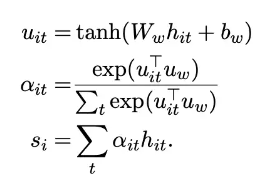

In [ ]:
class WordAttnNet(nn.Module):
    def __init__(
        self,
        vocab_size,
        hidden_dim=32,
        padding_idx=1,
        embed_dim=50,
        embedding_matrix=None,
        weight_drop=1
    ):
        super(WordAttnNet, self).__init__()

        if isinstance(embedding_matrix, np.ndarray): #if the embedding matrix is given and is a numpy array, then execute below code
        #the above is to allow the use of pre-trained embeddings
            self.word_embed = nn.Embedding(
                vocab_size, embedding_matrix.shape[1], padding_idx=padding_idx
            ) #A simple lookup table that stores embeddings of each word in the specified vocabulary
            self.word_embed.weight = nn.Parameter(torch.Tensor(embedding_matrix))
            embed_dim = embedding_matrix.shape[1]
        else:
            self.word_embed = nn.Embedding(vocab_size, embed_dim, padding_idx=padding_idx)

        self.rnn = nn.GRU(embed_dim, hidden_dim, bidirectional=True, batch_first=True)

        if weight_drop:
            self.rnn = WeightDrop(
                self.rnn, ["weight_hh_l0", "weight_hh_l0_reverse"], dropout=weight_drop
            )

        self.word_attn = AttentionWithContext(hidden_dim * 2)

    def forward(self, X, h_n): #X: input matrix (reviews), h_n: initial hidden_state for GRU
        embed = self.word_embed(X.long()) #word embeddings created
        h_t, h_n = self.rnn(embed, h_n) #word embeddings go through GRU
        a, s = self.word_attn(h_t) #GRU output goes through attention module which returns attention weights for the words and the sentence vector thus created using word embeddings (vectors)
        return a, s.unsqueeze(1), h_n #returns attention weights, sentence vectors, last hidden state (last hidden state is used further for the next sentence, hence we return it here)

try changing the internal architecture of the RNN used (GRU here)

##example implementation of word attention

In [ ]:
bsz = 16
maxlen_sent = 20
hidden_dim  = 32
embed_dim   = 100
vocab_size  = 1000
padding_idx = 1

# net
word_embed = nn.Embedding(vocab_size, embed_dim, padding_idx=padding_idx)
rnn = nn.GRU(embed_dim, hidden_dim, bidirectional=True, batch_first=True)
attn = nn.Linear(hidden_dim*2, hidden_dim*2)
contx = nn.Linear(hidden_dim*2, 1, bias=False)

# inputs
np.arange(1000)
np.arange(1000)
X = torch.from_numpy(np.random.choice(vocab_size, (bsz, maxlen_sent))) #generates bsz x maxlen_sent size arrray with randomly chosen samples from np.arange(vocab_size)
h_n = torch.zeros((2, bsz, hidden_dim)) #initialising hidden state for GRU

In [ ]:
h_n.shape

torch.Size([2, 16, 32])

In [ ]:
X.shape

torch.Size([16, 20])

in the above X, only the first sentence from each review is taken. In reality, after this step, the 2nd sentence of each review is passed and then the 3rd and so on.

16 reviews with 20 words each (20 is the max, reviews with words lesser than 20 are padded)

In [ ]:
# 1. Word Embeddings
# (bsz, maxlen_sent, embed_dim)
embed = word_embed(X)
embed.shape

torch.Size([16, 20, 100])

embed = embedding matrix = for each of the 16 x 20 words, embeddings of size 100 are generated

In [ ]:
# 2. GRU
h_t, h_n = rnn(embed, h_n)
# (bsz, seq_len, hidden_dim*2)
h_t.shape

torch.Size([16, 20, 64])

embedding matrix is processed by GRU and a 16, 20, 64 (hidden_dim*2 as bidirectional=True) matrix is generated as output

In [ ]:
# 3. Attention
u = torch.tanh_(attn(h_t))
a = F.softmax(contx(u), dim=1)
print(h_t.shape, u.shape, a.shape)

torch.Size([16, 20, 64]) torch.Size([16, 20, 64]) torch.Size([16, 20, 1])


In [ ]:
# RNN outputs scaled by their importance weights
s = (a * h_t)
print(s.shape)
# Sum along the seq dim so we end up with a representation per document/review
s = s.sum(1) #sentence vector obtained for each review as the sum of the 20 attention-weighted GRU-processed 64D word vectors
print(s.shape)
# Because this will be stack for all sentences, we do the `.unsqueeze(1)`
print(s.unsqueeze(1).shape)

torch.Size([16, 20, 64])
torch.Size([16, 64])
torch.Size([16, 1, 64])


##sentence attention

check out GRU and LSTM

In [ ]:
class SentAttnNet(nn.Module):
    def __init__(self, word_hidden_dim=32, sent_hidden_dim=32, padding_idx=1, weight_drop=1):

        super(SentAttnNet, self).__init__()

        self.rnn = nn.GRU(
            word_hidden_dim * 2, sent_hidden_dim, bidirectional=True, batch_first=True
        ) #gru takes 16,1,64 sentence matrix from last step and gives out a 16,1,64


        if weight_drop:
            self.rnn = WeightDrop(
                self.rnn, ["weight_hh_l0", "weight_hh_l0_reverse"], dropout=weight_drop
            )

        self.sent_attn = AttentionWithContext(sent_hidden_dim * 2) #takes in a 16,1,64 and gives out 16,1,64

    def forward(self, X):
        h_t, h_n = self.rnn(X) #sentence vectors passed to GRU
        a, v = self.sent_attn(h_t) #output given to attention module which returns sentence weights and document vector
        return a.permute(0,2,1), v

same things that applied from word -> sent, apply to sent -> doc here

In [ ]:
class HierAttnNet(nn.Module):
    def __init__(
        self,
        vocab_size,
        maxlen_sent,
        maxlen_doc,
        word_hidden_dim=32,
        sent_hidden_dim=32,
        padding_idx=1,
        embed_dim=50,
        embedding_matrix=None,
        num_class=2,
    ):
        super(HierAttnNet, self).__init__()

        self.word_hidden_dim = word_hidden_dim

        self.wordattnnet = WordAttnNet(
            vocab_size=vocab_size,
            hidden_dim=word_hidden_dim,
            padding_idx=padding_idx,
            embed_dim=embed_dim,
            embedding_matrix=embedding_matrix,
        )

        self.sentattnnet = SentAttnNet(
            word_hidden_dim=word_hidden_dim,
            sent_hidden_dim=sent_hidden_dim,
            padding_idx=padding_idx,
        )

        self.fc = nn.Linear(sent_hidden_dim * 2, num_class) #final 0/1 prediciton

    def forward(self, X):
        x = X.permute(1, 0, 2) #rearranging dimensions to process one sentence at a time
        word_h_n = nn.init.zeros_(torch.Tensor(2, X.shape[0], self.word_hidden_dim)) #initialising random context vector
        if use_cuda:
            word_h_n = word_h_n.cuda()

        # alpha and s Tensor Lists
        word_a_list, word_s_list = [], []
        for sent in x: #going through the numerical representation of each sentence
            word_a, word_s, word_h_n = self.wordattnnet(sent, word_h_n)  #we get attention weights, sentence vector, and updated context vector (last hidden state of rnn)
            word_a_list.append(word_a) #list of attention weights
            word_s_list.append(word_s) #list of sentence vectors

        # Importance attention weights per word in sentence
        self.sent_a = torch.cat(word_a_list, 1)

        # Sentences representation
        sent_s = torch.cat(word_s_list, 1) #sentence vectors to be passed into the sentence attention net

        # Importance attention weights per sentence in doc and document representation
        self.doc_a, doc_s = self.sentattnnet(sent_s) #sentence weights and document vector
        return self.fc(doc_s)

experiment without class balancing and check other evaluation metric such as AUC

##example implementation of whole run

In [ ]:
maxlen_sent = 20
maxlen_doc = 5
num_class = 2
word_hidden_dim = 32
sent_hidden_dim = 32

wordattnnet = WordAttnNet(vocab_size, hidden_dim, padding_idx, embed_dim, embedding_matrix=None)
sentattnnet = SentAttnNet(word_hidden_dim, sent_hidden_dim, padding_idx)
fc = nn.Linear(sent_hidden_dim * 2, num_class)

In [ ]:
X = torch.from_numpy(np.random.choice(vocab_size, (bsz, maxlen_doc, maxlen_sent))) #16,5,20

16 reviews made up of 5 sentences and 20 words each

In [ ]:
x = X.permute(1, 0, 2)
x.shape

torch.Size([5, 16, 20])

this is done to pass in sentence-by-sentence for each review ie 1st sentence of each review, then 2nd, then 3rd, and so on

In [ ]:
# Initial Word RNN hidden state
word_h_n = nn.init.zeros_(torch.Tensor(2, X.shape[0], word_hidden_dim))

In [ ]:
word_h_n.shape

torch.Size([2, 16, 32])

In [ ]:
# Loop through sentences:
word_a_list, word_s_list = [], []
for sent in x:
    word_a, word_s, word_h_n = wordattnnet(sent, word_h_n)
    word_a_list.append(word_a)
    word_s_list.append(word_s)
# Importance attention weights per word in sentence
sent_a = torch.cat(word_a_list, 1)
# Sentences representation
sent_s = torch.cat(word_s_list, 1)
# (bsz, maxlen_doc, maxlen_sent)
print(sent_a.shape)
# (bsz, maxlen_doc, hidden_dim*2)
print(sent_s.shape)

torch.Size([16, 5, 20])
torch.Size([16, 5, 64])


In [ ]:
sent.shape #ith sentence from each review

torch.Size([16, 20])

In [ ]:
word_a.shape #attention weight for each of the 20 words of an ith sentence from each of the 16 reviews

torch.Size([16, 1, 20])

In [ ]:
len(word_a_list) #concatenation of 20 word attention weights of all 5 sentences of all 16 reviews

5

In [ ]:
word_s.shape #sentence vector

torch.Size([16, 1, 64])

In [ ]:
len(word_s_list) #concat of all 5 sentence vectors for all reviews

5

In [ ]:
sent_a.shape #basically forming a 3D tensor out of a list of tensors (word_a_list)

torch.Size([16, 5, 20])

In [ ]:
sent_s.shape #basically forming a 3D tensor out of a list of tensors (word_s_list)

torch.Size([16, 5, 64])

In [ ]:
doc_a, doc_s = sentattnnet(sent_s) #getting sentence level attention and document vectors
# (bsz, maxlen_doc, 1). One could .squeeze(2)
print(doc_a.shape)
# (bsz, hidden_dim*2)
print(doc_s.shape)

torch.Size([16, 5, 1])
torch.Size([16, 64])


In [ ]:
out = fc(doc_s)
out.shape

torch.Size([16, 2])

In [ ]:
out

tensor([[-0.1483, -0.0414],
        [-0.1430, -0.0908],
        [-0.1338, -0.0595],
        [-0.1279, -0.0537],
        [-0.1450, -0.0717],
        [-0.1506, -0.0880],
        [-0.1594, -0.0751],
        [-0.1208, -0.0375],
        [-0.1239, -0.0873],
        [-0.1632, -0.0725],
        [-0.1960, -0.0803],
        [-0.1330, -0.0595],
        [-0.1459, -0.0915],
        [-0.1631, -0.0449],
        [-0.1751, -0.0795],
        [-0.1148, -0.0865]], grad_fn=<AddmmBackward0>)

#Running HAN

In [ ]:
import pandas as pd
import numpy as np
import pickle
import torch
import os
import torch.nn.functional as F

from pathlib import Path
from tqdm import trange
from sklearn.metrics import accuracy_score, f1_score, precision_score
from torch.optim.lr_scheduler import CyclicLR, ReduceLROnPlateau
from torch.utils.data import TensorDataset, DataLoader

In [ ]:
df

,review_text,label
0,The Amalfi Hotel has a beautiful website and i...,1.0
1,First stepping foot on the hotel propety I cou...,1.0
2,I needed to find a last minute hotel to stay i...,1.0
3,We will not be back to this hotel. There are s...,1.0
4,A decent place to stay. The people are nice en...,1.0
...,...,...
795,This is about the fourth time we stayed at the...,0.0
796,this is my letter to the management..... Sir o...,0.0
797,"To start with, this hotel had the worst custom...",0.0
798,"Often visit Chicago, but this was my first sta...",0.0


yelp

In [ ]:
X_train, X_valid, y_train, y_valid = train_test_split(
        padded_texts, df.flagged, train_size=0.7, random_state=1, stratify=df.flagged
    )
X_valid, X_test, y_valid, y_test = train_test_split(
        X_valid, y_valid, train_size=0.5, random_state=1, stratify=y_valid
)

myle ott

In [ ]:
X_train, X_valid, y_train, y_valid = train_test_split(
        padded_texts, df.label, train_size=0.7, random_state=1, stratify=df.label
    )
X_valid, X_test, y_valid, y_test = train_test_split(
        X_valid, y_valid, train_size=0.5, random_state=1, stratify=y_valid
)

In [ ]:
batch_size = 64

train_set = TensorDataset(
    torch.from_numpy(X_train),
    torch.from_numpy( y_train.values.astype(int) ),
)

train_loader = DataLoader(dataset=train_set, batch_size=batch_size, num_workers=n_cpus)

test_set = TensorDataset(
    torch.from_numpy(X_test),
    torch.from_numpy( y_test.values.astype(int) ),
)

test_loader = DataLoader(dataset=test_set, batch_size=batch_size, num_workers=n_cpus)

eval_set = TensorDataset(
    torch.from_numpy(X_valid),
    torch.from_numpy( np.array( y_valid.astype(int) ) ),
)

eval_loader = DataLoader(
    dataset=eval_set, batch_size=batch_size, num_workers=n_cpus, shuffle=False
)

In [ ]:
y_valid.astype(int)

291     1
1420    0
949     1
1334    0
68      1
       ..
307     1
965     1
59      1
1058    1
930     1
Name: label, Length: 240, dtype: int64

In [ ]:
torch.utils.data.ConcatDataset([train_set, eval_set])

In [ ]:
class CategoricalAccuracy(object):
    def __init__(self, top_k=1):
        self.top_k = top_k
        self.correct_count = 0
        self.total_count = 0

        self._name = "acc"

    def reset(self):
        self.correct_count = 0
        self.total_count = 0

    def __call__(self, y_pred, y_true):
        top_k = y_pred.topk(self.top_k, 1)[1]
        true_k = y_true.view(len(y_true), 1).expand_as(top_k)
        self.correct_count += top_k.eq(true_k).float().sum().item()
        self.total_count += len(y_pred)
        accuracy = float(self.correct_count) / float(self.total_count)
        return np.round(accuracy, 4)

In [ ]:
model = HierAttnNet(
    vocab_size=len(vocab.stoi),
    maxlen_sent=maxlen_sent,
    maxlen_doc=maxlen_doc,
    word_hidden_dim=204,
    sent_hidden_dim=102,
    padding_idx=1,
    embed_dim=211,
    #weight_drop=0.,
    #embed_drop=0.,
    #locked_drop=0.,
    #last_drop=0.,
    embedding_matrix=None,
    num_class=2,
)

Applying weight drop of 1 to weight_hh_l0
Applying weight drop of 1 to weight_hh_l0_reverse
Applying weight drop of 1 to weight_hh_l0
Applying weight drop of 1 to weight_hh_l0_reverse


In [ ]:
optimizer = torch.optim.AdamW(model.parameters(), lr=0.01, weight_decay=0.05)
# This class is at the utils module
metric = CategoricalAccuracy()

In [ ]:
metric = CategoricalAccuracy()

In [ ]:
import os
import torch
from torch import nn
from torchvision.datasets import MNIST
from torch.utils.data import DataLoader, ConcatDataset
from torchvision import transforms
from sklearn.model_selection import KFold


def reset_weights(m):
  '''
    Try resetting model weights to avoid
    weight leakage.
  '''
  for layer in m.children():
   if hasattr(layer, 'reset_parameters'):
    print(f'Reset trainable parameters of layer = {layer}')
    layer.reset_parameters()

class SimpleConvNet(nn.Module):
  '''
    Simple Convolutional Neural Network
  '''
  def __init__(self):
    super().__init__()
    self.layers = nn.Sequential(
      nn.Conv2d(1, 10, kernel_size=3),
      nn.ReLU(),
      nn.Flatten(),
      nn.Linear(26 * 26 * 10, 50),
      nn.ReLU(),
      nn.Linear(50, 20),
      nn.ReLU(),
      nn.Linear(20, 10)
    )


  def forward(self, x):
    '''Forward pass'''
    return self.layers(x)


if __name__ == '__main__':

  # Configuration options
  k_folds = 5
  num_epochs = 1
  loss_function = nn.CrossEntropyLoss()

  # For fold results
  results = {}

  # Set fixed random number seed
  torch.manual_seed(42)

  # Prepare MNIST dataset by concatenating Train/Test part; we split later.
  dataset_train_part = MNIST(os.getcwd(), download=True, transform=transforms.ToTensor(), train=True)
  dataset_test_part = MNIST(os.getcwd(), download=True, transform=transforms.ToTensor(), train=False)
  dataset = ConcatDataset([dataset_train_part, dataset_test_part])

  # Define the K-fold Cross Validator
  kfold = KFold(n_splits=k_folds, shuffle=True)

  # Start print
  print('--------------------------------')

  # K-fold Cross Validation model evaluation
  for fold, (train_ids, test_ids) in enumerate(kfold.split(dataset)):

    # Print
    print(f'FOLD {fold}')
    print('--------------------------------')

    # Sample elements randomly from a given list of ids, no replacement.
    train_subsampler = torch.utils.data.SubsetRandomSampler(train_ids)
    test_subsampler = torch.utils.data.SubsetRandomSampler(test_ids)

    # Define data loaders for training and testing data in this fold
    trainloader = torch.utils.data.DataLoader(
                      dataset,
                      batch_size=10, sampler=train_subsampler)
    testloader = torch.utils.data.DataLoader(
                      dataset,
                      batch_size=10, sampler=test_subsampler)

    # Init the neural network
    network = SimpleConvNet()
    network.apply(reset_weights)

    # Initialize optimizer
    optimizer = torch.optim.Adam(network.parameters(), lr=1e-4)

    # Run the training loop for defined number of epochs
    for epoch in range(0, num_epochs):

      # Print epoch
      print(f'Starting epoch {epoch+1}')

      # Set current loss value
      current_loss = 0.0

      # Iterate over the DataLoader for training data
      for i, data in enumerate(trainloader, 0):

        # Get inputs
        inputs, targets = data

        # Zero the gradients
        optimizer.zero_grad()

        # Perform forward pass
        outputs = network(inputs)

        # Compute loss
        loss = loss_function(outputs, targets)

        # Perform backward pass
        loss.backward()

        # Perform optimization
        optimizer.step()

        # Print statistics
        current_loss += loss.item()
        if i % 500 == 499:
            print('Loss after mini-batch %5d: %.3f' %
                  (i + 1, current_loss / 500))
            current_loss = 0.0

    # Process is complete.
    print('Training process has finished. Saving trained model.')

    # Print about testing
    print('Starting testing')

    # Saving the model
    save_path = f'./model-fold-{fold}.pth'
    torch.save(network.state_dict(), save_path)

    # Evaluationfor this fold
    correct, total = 0, 0
    with torch.no_grad():

      # Iterate over the test data and generate predictions
      for i, data in enumerate(testloader, 0):

        # Get inputs
        inputs, targets = data

        # Generate outputs
        outputs = network(inputs)

        # Set total and correct
        _, predicted = torch.max(outputs.data, 1)
        total += targets.size(0)
        correct += (predicted == targets).sum().item()

      # Print accuracy
      print('Accuracy for fold %d: %d %%' % (fold, 100.0 * correct / total))
      print('--------------------------------')
      results[fold] = 100.0 * (correct / total)

  # Print fold results
  print(f'K-FOLD CROSS VALIDATION RESULTS FOR {k_folds} FOLDS')
  print('--------------------------------')
  sum = 0.0
  for key, value in results.items():
    print(f'Fold {key}: {value} %')
    sum += value
  print(f'Average: {sum/len(results.items())} %')

##k-fold cross validation

In [ ]:
n_cpus = os.cpu_count()
use_cuda = torch.cuda.is_available()

In [ ]:
import os
import torch
from torch import nn
from torchvision.datasets import MNIST
from torch.utils.data import DataLoader, ConcatDataset
from torchvision import transforms
from sklearn.model_selection import KFold


if __name__ == '__main__':

  # Configuration options
  k_folds = 5
  num_epochs = 5
  loss_function = nn.CrossEntropyLoss()

  # For fold results
  results = {}

  # Set fixed random number seed
  torch.manual_seed(42)

  # Prepare MNIST dataset by concatenating Train/Test part; we split later.
  dataset = torch.utils.data.ConcatDataset([train_set, test_set])

  # Define the K-fold Cross Validator
  kfold = KFold(n_splits=k_folds, shuffle=True)

  # Start print
  print('--------------------------------')

  # K-fold Cross Validation model evaluation
  for fold, (train_ids, test_ids) in enumerate(kfold.split(dataset)):

    # Print
    print(f'FOLD {fold}')
    print('--------------------------------')


    # Sample elements randomly from a given list of ids, no replacement.
    train_subsampler = torch.utils.data.SubsetRandomSampler(train_ids)
    test_subsampler = torch.utils.data.SubsetRandomSampler(test_ids)

    # Define data loaders for training and testing data in this fold
    trainloader = torch.utils.data.DataLoader(
                      dataset,
                      batch_size=64, sampler=train_subsampler)
    testloader = torch.utils.data.DataLoader(
                      dataset,
                      batch_size=64, sampler=test_subsampler)

    # Init the neural network
    network = model

    # Initialize optimizer
    optimizer = optimizer

    # Run the training loop for defined number of epochs
    for epoch in range(0, num_epochs):

      # Print epoch
      print(f'Starting epoch {epoch+1}')

      # Set current loss value
      current_loss = 0.0

      # Iterate over the DataLoader for training data
      for i, data in enumerate(trainloader, 0):

        # Get inputs
        inputs, targets = data

        # Zero the gradients
        optimizer.zero_grad()

        # Perform forward pass
        outputs = network(inputs)

        # Compute loss
        loss = loss_function(outputs, targets)

        # Perform backward pass
        loss.backward()

        # Perform optimization
        optimizer.step()

        # Print statistics
        current_loss += loss.item()
        if i % 500 == 499:
            print('Loss after mini-batch %5d: %.3f' %
                  (i + 1, current_loss / 500))
            current_loss = 0.0

    # Process is complete.
    print('Training process has finished. Saving trained model.')

    # Print about testing
    print('Starting testing')

    # Evaluationfor this fold
    correct, total = 0, 0
    with torch.no_grad():

      # Iterate over the test data and generate predictions
      for i, data in enumerate(testloader, 0):

        # Get inputs
        inputs, targets = data

        # Generate outputs
        outputs = network(inputs)

        # Set total and correct
        _, predicted = torch.max(outputs.data, 1)
        total += targets.size(0)
        correct += (predicted == targets).sum().item()

      # Print accuracy
      print('Accuracy for fold %d: %d %%' % (fold, 100.0 * correct / total))
      print('--------------------------------')
      results[fold] = 100.0 * (correct / total)

  # Print fold results
  print(f'K-FOLD CROSS VALIDATION RESULTS FOR {k_folds} FOLDS')
  print('--------------------------------')
  sum = 0.0
  for key, value in results.items():
    print(f'Fold {key}: {value} %')
    sum += value
  print(f'Average: {sum/len(results.items())} %')

--------------------------------
FOLD 0
--------------------------------
Starting epoch 1
Starting epoch 2
Starting epoch 3
Starting epoch 4
Starting epoch 5
Training process has finished. Saving trained model.
Starting testing
Accuracy for fold 0: 65 %
--------------------------------
FOLD 1
--------------------------------
Starting epoch 1
Starting epoch 2
Starting epoch 3
Starting epoch 4
Starting epoch 5
Training process has finished. Saving trained model.
Starting testing
Accuracy for fold 1: 65 %
--------------------------------
FOLD 2
--------------------------------
Starting epoch 1
Starting epoch 2
Starting epoch 3
Starting epoch 4
Starting epoch 5
Training process has finished. Saving trained model.
Starting testing
Accuracy for fold 2: 70 %
--------------------------------
FOLD 3
--------------------------------
Starting epoch 1
Starting epoch 2
Starting epoch 3
Starting epoch 4
Starting epoch 5
Training process has finished. Saving trained model.
Starting testing
Accuracy f

##hyperparameter tuning

In [ ]:
!pip install optuna

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 348 kB 4.0 MB/s 
     |████████████████████████████████| 209 kB 49.0 MB/s 
     |████████████████████████████████| 81 kB 9.1 MB/s 
     |████████████████████████████████| 78 kB 6.0 MB/s 
     |████████████████████████████████| 147 kB 40.9 MB/s 
     |████████████████████████████████| 112 kB 45.8 MB/s 
     |████████████████████████████████| 50 kB 5.6 MB/s 
  Created wheel for pyperclip: filename=pyperclip-1.8.2-py3-none-any.whl size=11136 sha256=db75a8ed809709d647725054231b928a001efddda0e1b05d656fcdbd595377b4
  Stored in directory: /root/.cache/pip/wheels/9f/18/84/8f69f8b08169c7bae2dde6bd7daf0c19fca8c8e500ee620a28
Successfully built pyperclip


In [ ]:
!pip install ray torch torchvision

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 59.1 MB 1.3 MB/s 
     |████████████████████████████████| 8.8 MB 12.3 MB/s 
     |████████████████████████████████| 468 kB 44.5 MB/s 


In [ ]:
!pip install "ray[tune]"

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 125 kB 4.1 MB/s 


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
        padded_texts, df.label, train_size=0.7, random_state=1, stratify=df.label
    )

AttributeError: ignored

In [ ]:
batch_size = 64

train_set = TensorDataset(
    torch.from_numpy(X_train),
    torch.from_numpy( y_train.values.astype(int) ),
)

train_loader = DataLoader(dataset=train_set, batch_size=batch_size, num_workers=n_cpus)



test_set = TensorDataset(
    torch.from_numpy(X_test),
    torch.from_numpy( np.array( y_test.astype(int) ) ),
)

test_loader = DataLoader(
    dataset=test_set, batch_size=batch_size, num_workers=n_cpus, shuffle=False
)

In [ ]:
maxlen_doc

13

https://pytorch.org/tutorials/beginner/hyperparameter_tuning_tutorial.html

In [ ]:
# 2. Define a search space and initialize the search algorithm.
search_space = {"word_hidden_dim": tune.randint(32, 256), "sent_hidden_dim": tune.randint(32, 256), "embed_dim": tune.randint(32, 256),
                "lr": tune.loguniform(1e-4, 1e-1), "weight_decay": tune.loguniform(1e-4, 1)}

def train_model(search_space):
  model =  HierAttnNet( vocab_size=len(vocab.stoi),
                        maxlen_sent=23,
                        maxlen_doc=13,
                        word_hidden_dim=search_space["word_hidden_dim"],
                        sent_hidden_dim=search_space["sent_hidden_dim"],
                        embed_dim=search_space["embed_dim"] )

###fail

In [ ]:
def train_step_hyp(search_space, train_loader, epoch, metric):
    model = HierAttnNet( vocab_size=len(vocab.stoi), maxlen_sent=23, maxlen_doc=13, word_hidden_dim=search_space["word_hidden_dim"],  sent_hidden_dim=search_space["sent_hidden_dim"], embed_dim=search_space["embed_dim"] )
    model.train()
    metric.reset()
    train_steps = len(train_loader)
    running_loss = 0
    optimizer = torch.optim.AdamW(model.parameters(), lr=search_space["lr"], weight_decay=search_space["weight_decay"])

    with trange(train_steps) as t:
        for batch_idx, (data, target) in zip(t, train_loader):
            t.set_description("epoch %i" % (epoch + 1))

            X = data.cuda() if use_cuda else data
            y = target.cuda() if use_cuda else target

            optimizer.zero_grad()
            y_pred = model(X)
            loss = F.cross_entropy(y_pred, y)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()
            avg_loss = running_loss / (batch_idx + 1)
            acc = metric(F.softmax(y_pred, dim=1), y)
            tune.report(loss=avg_loss, accuracy=acc)

            t.set_postfix(acc=acc, loss=avg_loss)

In [ ]:
import torch
import ray
from ray import tune, air
from ray.air import session
from ray.tune.search.optuna import OptunaSearch
from ray.tune.schedulers import ASHAScheduler
from ray.tune import CLIReporter


# 2. Define a search space and initialize the search algorithm.
search_space = {"word_hidden_dim": tune.randint(32, 256), "sent_hidden_dim": tune.randint(32, 256), "embed_dim": tune.randint(32, 256),
                "lr": tune.loguniform(1e-4, 1e-1), "weight_decay": tune.loguniform(1e-4, 1)}
algo = OptunaSearch()

scheduler = ASHAScheduler(
        metric="loss",
        mode="min",
        max_t=10,
        grace_period=3,
        reduction_factor=2)

reporter = CLIReporter(
        # parameter_columns=["l1", "l2", "lr", "batch_size"],
        metric_columns=["loss", "accuracy", "training_iteration"])


# 1. Wrap a PyTorch model in an objective function.
def objective(config):
    tr_loader, tst_loader = train_loader, eval_loader # Load some data
    num_epochs = 10
    met = metric

    while True:
        train_step_hyp(search_space, tr_loader, num_epochs, met)  # Train the model
        #_, _, acc = eval_step(mod, tst_loader, met, True)  # Compute test accuracy
        #session.report({"mean_accuracy": acc})  # Report to Tune

# 3. Start a Tune run that maximizes mean accuracy
tuner = tune.Tuner(
    objective,
    tune_config=tune.TuneConfig(
        metric="mean_accuracy",
        mode="max",
        search_alg=algo,
        scheduler=scheduler
    ),
    run_config=air.RunConfig(
        stop={"training_iteration": 25},
        progress_reporter=reporter,
    ),
    param_space=search_space,

)

results = tuner.fit()
print("Best config is:", results.get_best_result().config)

/usr/local/lib/python3.7/dist-packages/ray/tune/search/optuna/optuna_search.py:697: FutureWarning: IntUniformDistribution has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :class:`~optuna.distributions.IntDistribution` instead.
  step=quantize or 1,
/usr/local/lib/python3.7/dist-packages/ray/tune/search/optuna/optuna_search.py:674: FutureWarning: LogUniformDistribution has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use :class:`~optuna.distributions.FloatDistribution` instead.
  domain.lower, domain.upper
[I 2022-11-19 12:49:33,951] A new study created in memory with name: optuna
/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:766: FutureWarning: IntUniformDistribution(high=255, low=32, step=1) is deprecated and internally converted to IntDistribution(high=255, log=False, low=32, step=1). See https://github.co

== Status ==
Current time: 2022-11-19 12:49:50 (running for 00:00:16.86)
Memory usage on this node: 3.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 6.000: None | Iter 3.000: None
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.27 GiB heap, 0.0/3.64 GiB objects
Result logdir: /root/ray_results/objective_2022-11-19_12-49-33
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+-----------------+-------------+-------------+-------------------+----------------+-------------------+
| Trial name         | status   | loc             |   embed_dim |          lr |   sent_hidden_dim |   weight_decay |   word_hidden_dim |
|--------------------+----------+-----------------+-------------+-------------+-------------------+----------------+-------------------|
| objective_9e1564e2 | RUNNING  | 172.28.0.2:2000 |          34 | 0.000630071 |               129 |       0.016516 |               199 |
+--------------------+----------+-----------------+-------------+------------

Trial name,date,experiment_id,hostname,node_ip,pid,timestamp,trial_id
objective_9e1564e2,2022-11-19_12-49-50,1f0be87cc5664aa6a96049ff98d83a6e,d96d4ba4f512,172.28.0.2,2000,1668862190,9e1564e2


2022-11-19 12:49:50,965	ERROR tune.py:773 -- Trials did not complete: [objective_9e1564e2]
2022-11-19 12:49:50,971	INFO tune.py:778 -- Total run time: 17.46 seconds (16.90 seconds for the tuning loop).


== Status ==
Current time: 2022-11-19 12:49:50 (running for 00:00:16.90)
Memory usage on this node: 3.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 6.000: None | Iter 3.000: None
Resources requested: 0/2 CPUs, 0/0 GPUs, 0.0/7.27 GiB heap, 0.0/3.64 GiB objects
Result logdir: /root/ray_results/objective_2022-11-19_12-49-33
Number of trials: 1/1 (1 ERROR)
+--------------------+----------+-----------------+-------------+-------------+-------------------+----------------+-------------------+
| Trial name         | status   | loc             |   embed_dim |          lr |   sent_hidden_dim |   weight_decay |   word_hidden_dim |
|--------------------+----------+-----------------+-------------+-------------+-------------------+----------------+-------------------|
| objective_9e1564e2 | ERROR    | 172.28.0.2:2000 |          34 | 0.000630071 |               129 |       0.016516 |               199 |
+--------------------+----------+-----------------+-------------+-------------+--

In [ ]:
import torch
import ray
from ray import tune, air
from ray.air import session
from ray.tune.search.optuna import OptunaSearch
from ray.tune.schedulers import ASHAScheduler
from ray.tune import CLIReporter

'''
# 1. Wrap a PyTorch model in an objective function.
def objective(config):
    tr_loader, tst_loader = train_loader, eval_loader # Load some data
    #mod = model
    #mod = HierAttnNet( len(vocab.stoi), maxlen_sent, maxlen_doc, word_hidden_dim=search_space["word_hidden_dim"],  sent_hidden_dim=search_space["sent_hidden_dim"],
                       #padding_idx=1, embed_dim=search_space["embed_dim"], embedding_matrix=None, num_class=2)
    #opt = optimizer
    #opt = torch.optim.AdamW(mod.parameters(), lr=search_space["lr"], weight_decay=search_space["weight_decay"])
    num_epochs = 10
    met = metric

    while True:
        train_step(mod, opt, tr_loader, num_epochs, met)  # Train the model
        _, _, acc = eval_step(mod, tst_loader, met, True)  # Compute test accuracy
        session.report({"mean_accuracy": acc})  # Report to Tune
'''

# 2. Define a search space and initialize the search algorithm.
search_space = {"word_hidden_dim": tune.randint(32, 256), "sent_hidden_dim": tune.randint(32, 256), "embed_dim": tune.randint(32, 256),
                "lr": tune.loguniform(1e-4, 1e-1), "weight_decay": tune.loguniform(1e-4, 1)}
algo = OptunaSearch()

scheduler = ASHAScheduler(
        max_t=10,
        grace_period=3,
        reduction_factor=2)

reporter = CLIReporter()

model =  HierAttnNet( vocab_size=len(vocab.stoi), maxlen_sent=23, maxlen_doc=13, word_hidden_dim=search_space["word_hidden_dim"],  sent_hidden_dim=search_space["sent_hidden_dim"],
                      embed_dim=search_space["embed_dim"] )

# 1. Wrap a PyTorch model in an objective function.
def objective(config):
    tr_loader, tst_loader = train_loader, eval_loader # Load some data
    mod = model
    #mod = HierAttnNet( vocab_size=len(vocab.stoi), maxlen_sent=23, maxlen_doc=13, word_hidden_dim=search_space["word_hidden_dim"],  sent_hidden_dim=search_space["sent_hidden_dim"],
    #                   embed_dim=search_space["embed_dim"] )
    #opt = optimizer
    opt = torch.optim.AdamW(mod.parameters(), lr=search_space["lr"], weight_decay=search_space["weight_decay"])
    num_epochs = 10
    met = metric

    while True:
        train_step(mod, opt, tr_loader, num_epochs, met)  # Train the model
        _, _, acc = eval_step(mod, tst_loader, met, True)  # Compute test accuracy
        session.report({"mean_accuracy": acc})  # Report to Tune


# 3. Start a Tune run that maximizes mean accuracy
tuner = tune.Tuner(
    objective,
    tune_config=tune.TuneConfig(
        metric="mean_accuracy",
        mode="max",
        search_alg=algo,
        scheduler=scheduler
    ),
    run_config=air.RunConfig(
        stop={"training_iteration": 25},
        progress_reporter=reporter,
    ),
    param_space=search_space,

)

results = tuner.fit()
print("Best config is:", results.get_best_result().config)

TypeError: ignored

##hyperparameter tuning 2

In [ ]:
from functools import partial
import numpy as np
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import random_split
import torchvision
import torchvision.transforms as transforms
from ray import tune
from ray.tune import CLIReporter
from ray.tune.schedulers import ASHAScheduler

In [ ]:
config = {
    "word_hidden_dim": tune.randint(32, 256),
    "sent_hidden_dim": tune.randint(32, 256),
    "embed_dim": tune.randint(20, 400),
    "lr": tune.loguniform(1e-4, 1e-1),
    "wd": tune.loguniform(1e-4, 1)
}

In [ ]:
gpus_per_trial = 2
# ...
result = tune.run(
    partial(train_cifar, data_dir=data_dir),
    resources_per_trial={"cpu": 8, "gpu": gpus_per_trial},
    config=config,
    num_samples=num_samples,
    scheduler=scheduler,
    progress_reporter=reporter,
    checkpoint_at_end=True)

NameError: ignored

In [ ]:
net = HierAttnNet(config["word_hideen_dim"], config["sent_hidden_dim"], config["embed_dim"])

if checkpoint_dir:
    model_state, optimizer_state = torch.load(
        os.path.join(checkpoint_dir, "checkpoint"))
    net.load_state_dict(model_state)
    optimizer.load_state_dict(optimizer_state)

NameError: ignored

In [ ]:
optimizer = optim.SGD(net.parameters(), lr=config["lr"], weight_decay=config["wd"])

In [ ]:
device = "cpu"
if torch.cuda.is_available():
    device = "cuda:0"
    if torch.cuda.device_count() > 1:
        net = nn.DataParallel(net)
net.to(device)

In [ ]:
with tune.checkpoint_dir(epoch) as checkpoint_dir:
    path = os.path.join(checkpoint_dir, "checkpoint")
    torch.save((net.state_dict(), optimizer.state_dict()), path)

tune.report(loss=(val_loss / val_steps), accuracy=correct / total)

In [ ]:
def train_cifar(config, checkpoint_dir=None, data_dir=None):
    net = Net(config["l1"], config["l2"])

    device = "cpu"
    if torch.cuda.is_available():
        device = "cuda:0"
        if torch.cuda.device_count() > 1:
            net = nn.DataParallel(net)
    net.to(device)

    criterion = nn.CrossEntropyLoss()
    optimizer = optim.SGD(net.parameters(), lr=config["lr"], momentum=0.9)

    if checkpoint_dir:
        model_state, optimizer_state = torch.load(
            os.path.join(checkpoint_dir, "checkpoint"))
        net.load_state_dict(model_state)
        optimizer.load_state_dict(optimizer_state)

    trainset, testset = load_data(data_dir)

    test_abs = int(len(trainset) * 0.8)
    train_subset, val_subset = random_split(
        trainset, [test_abs, len(trainset) - test_abs])

    trainloader = torch.utils.data.DataLoader(
        train_subset,
        batch_size=int(config["batch_size"]),
        shuffle=True,
        num_workers=8)
    valloader = torch.utils.data.DataLoader(
        val_subset,
        batch_size=int(config["batch_size"]),
        shuffle=True,
        num_workers=8)

    for epoch in range(10):  # loop over the dataset multiple times
        running_loss = 0.0
        epoch_steps = 0
        for i, data in enumerate(trainloader, 0):
            # get the inputs; data is a list of [inputs, labels]
            inputs, labels = data
            inputs, labels = inputs.to(device), labels.to(device)

            # zero the parameter gradients
            optimizer.zero_grad()

            # forward + backward + optimize
            outputs = net(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            # print statistics
            running_loss += loss.item()
            epoch_steps += 1
            if i % 2000 == 1999:  # print every 2000 mini-batches
                print("[%d, %5d] loss: %.3f" % (epoch + 1, i + 1,
                                                running_loss / epoch_steps))
                running_loss = 0.0

        # Validation loss
        val_loss = 0.0
        val_steps = 0
        total = 0
        correct = 0
        for i, data in enumerate(valloader, 0):
            with torch.no_grad():
                inputs, labels = data
                inputs, labels = inputs.to(device), labels.to(device)

                outputs = net(inputs)
                _, predicted = torch.max(outputs.data, 1)
                total += labels.size(0)
                correct += (predicted == labels).sum().item()

                loss = criterion(outputs, labels)
                val_loss += loss.cpu().numpy()
                val_steps += 1

        with tune.checkpoint_dir(epoch) as checkpoint_dir:
            path = os.path.join(checkpoint_dir, "checkpoint")
            torch.save((net.state_dict(), optimizer.state_dict()), path)

        tune.report(loss=(val_loss / val_steps), accuracy=correct / total)
    print("Finished Training")

In [ ]:
def test_accuracy(net, device="cpu"):
    trainset, testset = load_data()

    testloader = torch.utils.data.DataLoader(
        testset, batch_size=4, shuffle=False, num_workers=2)

    correct = 0
    total = 0
    with torch.no_grad():
        for data in testloader:
            images, labels = data
            images, labels = images.to(device), labels.to(device)
            outputs = net(images)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    return correct / total

In [ ]:
def main(num_samples=10, max_num_epochs=10, gpus_per_trial=2):

    data_dir = os.path.abspath("./data")

    load_data(data_dir)

    config = {
        "l1": tune.sample_from(lambda _: 2 ** np.random.randint(2, 9)),
        "l2": tune.sample_from(lambda _: 2 ** np.random.randint(2, 9)),
        "lr": tune.loguniform(1e-4, 1e-1),
        "batch_size": tune.choice([2, 4, 8, 16])
    }

    scheduler = ASHAScheduler(
        metric="loss",
        mode="min",
        max_t=max_num_epochs,
        grace_period=1,
        reduction_factor=2)

    reporter = CLIReporter(
        # parameter_columns=["l1", "l2", "lr", "batch_size"],
        metric_columns=["loss", "accuracy", "training_iteration"])

    result = tune.run(
        partial(train_cifar, data_dir=data_dir),
        resources_per_trial={"cpu": 2, "gpu": gpus_per_trial},
        config=config,
        num_samples=num_samples,
        scheduler=scheduler,
        progress_reporter=reporter)

    best_trial = result.get_best_trial("loss", "min", "last")
    print("Best trial config: {}".format(best_trial.config))
    print("Best trial final validation loss: {}".format(
        best_trial.last_result["loss"]))
    print("Best trial final validation accuracy: {}".format(
        best_trial.last_result["accuracy"]))

    best_trained_model = Net(best_trial.config["l1"], best_trial.config["l2"])
    device = "cpu"
    if torch.cuda.is_available():
        device = "cuda:0"
        if gpus_per_trial > 1:
            best_trained_model = nn.DataParallel(best_trained_model)
    best_trained_model.to(device)

    best_checkpoint_dir = best_trial.checkpoint.value
    model_state, optimizer_state = torch.load(os.path.join(
        best_checkpoint_dir, "checkpoint"))
    best_trained_model.load_state_dict(model_state)

    test_acc = test_accuracy(best_trained_model, device)
    print("Best trial test set accuracy: {}".format(test_acc))


if __name__ == "__main__":
    # You can change the number of GPUs per trial here:
    main(num_samples=10, max_num_epochs=10, gpus_per_trial=0)

###full code

https://github.com/pytorch/tutorials/blob/master/beginner_source/hyperparameter_tuning_tutorial.py


In [ ]:
from functools import partial
import numpy as np
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import random_split
import torchvision
import torchvision.transforms as transforms
from ray import tune
from ray.tune import CLIReporter
from ray.tune.schedulers import ASHAScheduler

def load_data():

    train_set = TensorDataset(
        torch.from_numpy(X_train),
        torch.from_numpy( y_train.values.astype(int) ),
    )


    test_set = TensorDataset(
        torch.from_numpy(X_test),
        torch.from_numpy( y_test.values.astype(int) ),
    )

    return train_set, test_set

def train_cifar(config, checkpoint_dir=None, data_dir=None):
    net = HierAttnNet( vocab_size=len(vocab.stoi), maxlen_sent=23, maxlen_doc=13, word_hidden_dim=config["word_hidden_dim"],
                       sent_hidden_dim=config["sent_hidden_dim"], embed_dim=config["embed_dim"] )

    '''
    device = "cpu"
    if torch.cuda.is_available():
        device = "cuda:0"
        if torch.cuda.device_count() > 1:
            net = nn.DataParallel(net)
    net.to(device)
    '''
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.SGD(net.parameters(), lr=config["lr"], weight_decay=config["wd"])

    if checkpoint_dir:
        model_state, optimizer_state = torch.load(
            os.path.join(checkpoint_dir, "checkpoint"))
        net.load_state_dict(model_state)
        optimizer.load_state_dict(optimizer_state)

    trainset, testset = load_data()

    test_abs = int(len(trainset) * 0.8)
    train_subset, val_subset = random_split(
        trainset, [test_abs, len(trainset) - test_abs])

    trainloader = torch.utils.data.DataLoader(
        train_subset,
        batch_size=int(config["batch_size"]),
        shuffle=True,
        num_workers=8)
    valloader = torch.utils.data.DataLoader(
        val_subset,
        batch_size=int(config["batch_size"]),
        shuffle=True,
        num_workers=8)

    for epoch in range(10):  # loop over the dataset multiple times
        running_loss = 0.0
        epoch_steps = 0
        for i, data in enumerate(trainloader, 0):
            # get the inputs; data is a list of [inputs, labels]
            inputs, labels = data
            inputs, labels = inputs.to(device), labels.to(device)

            # zero the parameter gradients
            optimizer.zero_grad()

            # forward + backward + optimize
            outputs = net(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            # print statistics
            running_loss += loss.item()
            epoch_steps += 1
            if i % 2000 == 1999:  # print every 2000 mini-batches
                print("[%d, %5d] loss: %.3f" % (epoch + 1, i + 1,
                                                running_loss / epoch_steps))
                running_loss = 0.0

        # Validation loss
        val_loss = 0.0
        val_steps = 0
        total = 0
        correct = 0
        for i, data in enumerate(valloader, 0):
            with torch.no_grad():
                inputs, labels = data
                inputs, labels = inputs.to(device), labels.to(device)

                outputs = net(inputs)
                _, predicted = torch.max(outputs.data, 1)
                total += labels.size(0)
                correct += (predicted == labels).sum().item()

                loss = criterion(outputs, labels)
                val_loss += loss.cpu().numpy()
                val_steps += 1

        with tune.checkpoint_dir(epoch) as checkpoint_dir:
            path = os.path.join(checkpoint_dir, "checkpoint")
            torch.save((net.state_dict(), optimizer.state_dict()), path)

        tune.report(loss=(val_loss / val_steps), accuracy=correct / total)
    print("Finished Training")

def test_accuracy(net, device="cpu"):
    trainset, testset = load_data()

    testloader = torch.utils.data.DataLoader(
        testset, batch_size=4, shuffle=False, num_workers=2)

    correct = 0
    total = 0
    with torch.no_grad():
        for data in testloader:
            images, labels = data
            images, labels = images.to(device), labels.to(device)
            outputs = net(images)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    return correct / total

def main(num_samples=10, max_num_epochs=10, gpus_per_trial=2):
    #data_dir = os.path.abspath("./data")
    load_data()

    config = {
        "word_hidden_dim": tune.randint(32, 256),
        "sent_hidden_dim": tune.randint(32, 256),
        "embed_dim": tune.randint(32, 256),
        "lr": tune.loguniform(1e-4, 1e-1),
        "wd": tune.loguniform(1e-4, 1),
        "batch_size": tune.choice([2, 4, 8, 16])
    }

    scheduler = ASHAScheduler(
        metric="loss",
        mode="min",
        max_t=max_num_epochs,
        grace_period=1,
        reduction_factor=2)

    reporter = CLIReporter(
        # parameter_columns=["l1", "l2", "lr", "batch_size"],
        metric_columns=["loss", "accuracy", "training_iteration"])

    result = tune.run(
        partial(train_cifar,),
                #data_dir=data_dir),
        resources_per_trial={"cpu": 2, "gpu": gpus_per_trial},
        config=config,
        num_samples=num_samples,
        scheduler=scheduler,
        progress_reporter=reporter)

    best_trial = result.get_best_trial("loss", "min", "last")
    print("Best trial config: {}".format(best_trial.config))
    print("Best trial final validation loss: {}".format(
        best_trial.last_result["loss"]))
    print("Best trial final validation accuracy: {}".format(
        best_trial.last_result["accuracy"]))

    best_trained_model = HierAttnNet(vocab_size = len(vocab.stoi), maxlen_sent=23, maxlen_doc=13,
                                     word_hidden_dim=best_trial.config["word_hidden_dim"], sent_hidden_dim=best_trial.config["sent_hidden_dim"],
                                     embed_dim=best_trial.config["embed_dim"])


    device = "cpu"
    if torch.cuda.is_available():
        device = "cuda:0"
        if gpus_per_trial > 1:
            best_trained_model = nn.DataParallel(best_trained_model)
    best_trained_model.to(device)

    best_checkpoint_dir = best_trial.checkpoint.value
    model_state, optimizer_state = torch.load(os.path.join(
        best_checkpoint_dir, "checkpoint"))
    best_trained_model.load_state_dict(model_state)

    test_acc = test_accuracy(best_trained_model, device)
    print("Best trial test set accuracy: {}".format(test_acc))


if __name__ == "__main__":
    # You can change the number of GPUs per trial here:
    main(num_samples=10, max_num_epochs=10, gpus_per_trial=0)


2022-11-22 13:54:07,313	INFO worker.py:1528 -- Started a local Ray instance.
/usr/local/lib/python3.7/dist-packages/ray/tune/trainable/function_trainable.py:611: DeprecationWarning: `checkpoint_dir` in `func(config, checkpoint_dir)` is being deprecated. To save and load checkpoint in trainable functions, please use the `ray.air.session` API:

from ray.air import session

def train(config):
    # ...
    session.report({"metric": metric}, checkpoint=checkpoint)

For more information please see https://docs.ray.io/en/master/tune/api_docs/trainable.html

  DeprecationWarning,
2022-11-22 13:54:17,715	WARNING worker.py:1839 -- Warning: The actor ImplicitFunc is very large (19 MiB). Check that its definition is not implicitly capturing a large array or other object in scope. Tip: use ray.put() to put large objects in the Ray object store.
2022-11-22 13:54:17,805	WARNING util.py:244 -- The `start_trial` operation took 0.830 s, which may be a performance bottleneck.
(pid=4844) 2022-11-22 13:54

== Status ==
Current time: 2022-11-22 13:54:17 (running for 00:00:05.53)
Memory usage on this node: 2.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 8.000: None | Iter 4.000: None | Iter 2.000: None | Iter 1.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.38 GiB heap, 0.0/3.69 GiB objects
Result logdir: /root/ray_results/train_cifar_2022-11-22_13-54-12
Number of trials: 10/10 (9 PENDING, 1 RUNNING)
+-------------------------+----------+-----------------+--------------+-------------+-------------+-------------------+-------------+-------------------+
| Trial name              | status   | loc             |   batch_size |   embed_dim |          lr |   sent_hidden_dim |          wd |   word_hidden_dim |
|-------------------------+----------+-----------------+--------------+-------------+-------------+-------------------+-------------+-------------------|
| train_cifar_24f3a_00000 | RUNNING  | 172.28.0.2:4844 |            2 |          50 | 0.00155267  |           

(func pid=4844) /usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
(func pid=4844)   cpuset_checked))
2022-11-22 13:54:30,970	ERROR trial_runner.py:993 -- Trial train_cifar_24f3a_00000: Error processing event.
ray.exceptions.RayTaskError(NameError): ray::ImplicitFunc.train() (pid=4844, ip=172.28.0.2, repr=func)
  File "/usr/local/lib/python3.7/dist-packages/ray/tune/trainable/trainable.py", line 355, in train
    raise skipped from exception_cause(skipped)
  File "/usr/local/lib/python3.7/dist-packages/ray/tune/trainable/function_trainable.py", line 328, in entrypoint
    self._status_reporter.get_checkpoin

Trial name,date,experiment_id,hostname,node_ip,pid,timestamp,trial_id
train_cifar_24f3a_00000,2022-11-22_13-54-30,2d6c526c74614c91a473b1d41a3c1f05,6c282062758f,172.28.0.2,4844,1669125270,24f3a_00000
train_cifar_24f3a_00001,2022-11-22_13-54-41,1ac9acb886db4a72ae4601a8c8b3a92c,6c282062758f,172.28.0.2,4975,1669125281,24f3a_00001
train_cifar_24f3a_00002,2022-11-22_13-54-51,0f767aecaa4447d5b523f40c76a6ca69,6c282062758f,172.28.0.2,5093,1669125291,24f3a_00002


== Status ==
Current time: 2022-11-22 13:54:31 (running for 00:00:18.71)
Memory usage on this node: 2.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 8.000: None | Iter 4.000: None | Iter 2.000: None | Iter 1.000: None
Resources requested: 0/2 CPUs, 0/0 GPUs, 0.0/7.38 GiB heap, 0.0/3.69 GiB objects
Result logdir: /root/ray_results/train_cifar_2022-11-22_13-54-12
Number of trials: 10/10 (1 ERROR, 9 PENDING)
+-------------------------+----------+-----------------+--------------+-------------+-------------+-------------------+-------------+-------------------+
| Trial name              | status   | loc             |   batch_size |   embed_dim |          lr |   sent_hidden_dim |          wd |   word_hidden_dim |
|-------------------------+----------+-----------------+--------------+-------------+-------------+-------------------+-------------+-------------------|
| train_cifar_24f3a_00001 | PENDING  |                 |           16 |         218 | 0.00122732  |               

(pid=4975) 2022-11-22 13:54:40.543665: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected


== Status ==
Current time: 2022-11-22 13:54:36 (running for 00:00:24.52)
Memory usage on this node: 2.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 8.000: None | Iter 4.000: None | Iter 2.000: None | Iter 1.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.38 GiB heap, 0.0/3.69 GiB objects
Result logdir: /root/ray_results/train_cifar_2022-11-22_13-54-12
Number of trials: 10/10 (1 ERROR, 8 PENDING, 1 RUNNING)
+-------------------------+----------+-----------------+--------------+-------------+-------------+-------------------+-------------+-------------------+
| Trial name              | status   | loc             |   batch_size |   embed_dim |          lr |   sent_hidden_dim |          wd |   word_hidden_dim |
|-------------------------+----------+-----------------+--------------+-------------+-------------+-------------------+-------------+-------------------|
| train_cifar_24f3a_00001 | RUNNING  | 172.28.0.2:4975 |           16 |         218 | 0.00122732  |  

(func pid=4975) /usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
(func pid=4975)   cpuset_checked))
2022-11-22 13:54:41,744	ERROR trial_runner.py:993 -- Trial train_cifar_24f3a_00001: Error processing event.
ray.exceptions.RayTaskError(NameError): ray::ImplicitFunc.train() (pid=4975, ip=172.28.0.2, repr=func)
  File "/usr/local/lib/python3.7/dist-packages/ray/tune/trainable/trainable.py", line 355, in train
    raise skipped from exception_cause(skipped)
  File "/usr/local/lib/python3.7/dist-packages/ray/tune/trainable/function_trainable.py", line 328, in entrypoint
    self._status_reporter.get_checkpoin

== Status ==
Current time: 2022-11-22 13:54:42 (running for 00:00:30.48)
Memory usage on this node: 2.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 8.000: None | Iter 4.000: None | Iter 2.000: None | Iter 1.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.38 GiB heap, 0.0/3.69 GiB objects
Result logdir: /root/ray_results/train_cifar_2022-11-22_13-54-12
Number of trials: 10/10 (2 ERROR, 7 PENDING, 1 RUNNING)
+-------------------------+----------+-----------------+--------------+-------------+-------------+-------------------+-------------+-------------------+
| Trial name              | status   | loc             |   batch_size |   embed_dim |          lr |   sent_hidden_dim |          wd |   word_hidden_dim |
|-------------------------+----------+-----------------+--------------+-------------+-------------+-------------------+-------------+-------------------|
| train_cifar_24f3a_00002 | RUNNING  | 172.28.0.2:5093 |            2 |         127 | 0.000198673 |  

(func pid=5093) /usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
(func pid=5093)   cpuset_checked))
2022-11-22 13:54:52,523	WARNING tune.py:706 -- Stop signal received (e.g. via SIGINT/Ctrl+C), ending Ray Tune run. This will try to checkpoint the experiment state one last time. Press CTRL+C (or send SIGINT/SIGKILL/SIGTERM) to skip. 
2022-11-22 13:54:52,528	ERROR trial_runner.py:993 -- Trial train_cifar_24f3a_00002: Error processing event.
ray.exceptions.RayTaskError(NameError): ray::ImplicitFunc.train() (pid=5093, ip=172.28.0.2, repr=func)
  File "/usr/local/lib/python3.7/dist-packages/ray/tune/trainable/

== Status ==
Current time: 2022-11-22 13:54:52 (running for 00:00:40.27)
Memory usage on this node: 2.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 8.000: None | Iter 4.000: None | Iter 2.000: None | Iter 1.000: None
Resources requested: 0/2 CPUs, 0/0 GPUs, 0.0/7.38 GiB heap, 0.0/3.69 GiB objects
Result logdir: /root/ray_results/train_cifar_2022-11-22_13-54-12
Number of trials: 10/10 (3 ERROR, 7 PENDING)
+-------------------------+----------+-----------------+--------------+-------------+-------------+-------------------+-------------+-------------------+
| Trial name              | status   | loc             |   batch_size |   embed_dim |          lr |   sent_hidden_dim |          wd |   word_hidden_dim |
|-------------------------+----------+-----------------+--------------+-------------+-------------+-------------------+-------------+-------------------|
| train_cifar_24f3a_00003 | PENDING  |                 |           16 |          85 | 0.00348916  |               

2022-11-22 13:54:52,808	ERROR tune.py:773 -- Trials did not complete: [train_cifar_24f3a_00000, train_cifar_24f3a_00001, train_cifar_24f3a_00002, train_cifar_24f3a_00003, train_cifar_24f3a_00004, train_cifar_24f3a_00005, train_cifar_24f3a_00006, train_cifar_24f3a_00007, train_cifar_24f3a_00008, train_cifar_24f3a_00009]
2022-11-22 13:54:52,811	INFO tune.py:778 -- Total run time: 41.60 seconds (40.28 seconds for the tuning loop).
2022-11-22 13:54:52,813	WARNING tune.py:784 -- Experiment has been interrupted, but the most recent state was saved. You can continue running this experiment by passing `resume=True` to `tune.run()`
2022-11-22 13:54:52,832	WARNING experiment_analysis.py:628 -- Could not find best trial. Did you pass the correct `metric` parameter?


AttributeError: ignored

In [ ]:
from functools import partial
import numpy as np
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import random_split
import torchvision
import torchvision.transforms as transforms
from ray import tune
from ray.tune import CLIReporter
from ray.tune.schedulers import ASHAScheduler

def load_data():

    train_set = TensorDataset(
        torch.from_numpy(X_train),
        torch.from_numpy( y_train.values.astype(int) ),
    )


    test_set = TensorDataset(
        torch.from_numpy(X_test),
        torch.from_numpy( y_test.values.astype(int) ),
    )

    return train_set, test_set

def train_cifar(config):
    net = HierAttnNet( vocab_size=len(vocab.stoi),
                       maxlen_sent=23,
                       maxlen_doc=13,
                       word_hidden_dim=config["word_hidden_dim"],
                       sent_hidden_dim=config["sent_hidden_dim"],
                       embed_dim=config["embed_dim"] )

    criterion = nn.CrossEntropyLoss()
    optimizer = optim.SGD(net.parameters(), lr=config["lr"], weight_decay=config["wd"])

    trainset, testset = load_data()

    test_abs = int(len(trainset) * 0.8)
    train_subset, val_subset = random_split(
        trainset, [test_abs, len(trainset) - test_abs])

    trainloader = torch.utils.data.DataLoader(
        train_subset,
        batch_size=int(config["batch_size"]),
        shuffle=True,
        num_workers=8)
    valloader = torch.utils.data.DataLoader(
        val_subset,
        batch_size=int(config["batch_size"]),
        shuffle=True,
        num_workers=8)

    for epoch in range(10):  # loop over the dataset multiple times
        running_loss = 0.0
        epoch_steps = 0
        for i, data in enumerate(trainloader, 0):
            # get the inputs; data is a list of [inputs, labels]
            inputs, labels = data
            # zero the parameter gradients
            optimizer.zero_grad()

            # forward + backward + optimize
            outputs = net(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            # print statistics
            running_loss += loss.item()
            epoch_steps += 1
            if i % 2000 == 1999:  # print every 2000 mini-batches
                print("[%d, %5d] loss: %.3f" % (epoch + 1, i + 1,
                                                running_loss / epoch_steps))
                running_loss = 0.0

        # Validation loss
        val_loss = 0.0
        val_steps = 0
        total = 0
        correct = 0
        for i, data in enumerate(valloader, 0):
            with torch.no_grad():
                inputs, labels = data
                outputs = net(inputs)
                _, predicted = torch.max(outputs.data, 1)
                total += labels.size(0)
                correct += (predicted == labels).sum().item()

                loss = criterion(outputs, labels)
                val_loss += loss.cpu().numpy()
                val_steps += 1

        tune.report(loss=(val_loss / val_steps), accuracy=correct / total)
    print("Finished Training")

def test_accuracy(net):
    trainset, testset = load_data()

    testloader = torch.utils.data.DataLoader(
        testset, batch_size=4, shuffle=False, num_workers=2)

    correct = 0
    total = 0
    with torch.no_grad():
        for data in testloader:
            images, labels = data
            outputs = net(images)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    return correct / total

def main(num_samples=10, max_num_epochs=10, gpus_per_trial=2):
    #data_dir = os.path.abspath("./data")
    load_data()

    config = {
        "word_hidden_dim": tune.randint(32, 256),
        "sent_hidden_dim": tune.randint(32, 256),
        "embed_dim": tune.randint(32, 256),
        "lr": tune.loguniform(1e-4, 1e-1),
        "wd": tune.loguniform(1e-4, 1),
        "batch_size": tune.choice([2, 4, 8, 16])
    }

    scheduler = ASHAScheduler(
        metric="loss",
        mode="min",
        max_t=max_num_epochs,
        grace_period=1,
        reduction_factor=2)

    reporter = CLIReporter(
        # parameter_columns=["l1", "l2", "lr", "batch_size"],
        metric_columns=["loss", "accuracy", "training_iteration"])

    #experiment = train_cifar(config)

    result = tune.run(
        #partial(train_cifar,
        #        data_dir=""),
        train_cifar(config),
        resources_per_trial={"cpu": 2, "gpu": gpus_per_trial},
        config=config,
        num_samples=num_samples,
        scheduler=scheduler,
        progress_reporter=reporter)

    best_trial = result.get_best_trial("loss", "min", "last")
    print("Best trial config: {}".format(best_trial.config))
    print("Best trial final validation loss: {}".format(
        best_trial.last_result["loss"]))
    print("Best trial final validation accuracy: {}".format(
        best_trial.last_result["accuracy"]))

    best_trained_model = HierAttnNet(vocab_size = len(vocab.stoi), maxlen_sent=23, maxlen_doc=13,
                                     word_hidden_dim=best_trial.config["word_hidden_dim"], sent_hidden_dim=best_trial.config["sent_hidden_dim"],
                                     embed_dim=best_trial.config["embed_dim"])

    test_acc = test_accuracy(best_trained_model)
    print("Best trial test set accuracy: {}".format(test_acc))


if __name__ == "__main__":
    # You can change the number of GPUs per trial here:
    main(num_samples=10, max_num_epochs=10, gpus_per_trial=0)


TypeError: ignored

##normal run of the model

In [ ]:
def train_step(model, optimizer, train_loader, epoch, metric):
    model.train()
    metric.reset()
    train_steps = len(train_loader)
    running_loss = 0
    with trange(train_steps) as t:
        for batch_idx, (data, target) in zip(t, train_loader):
            t.set_description("epoch %i" % (epoch + 1))

            X = data.cuda() if use_cuda else data
            y = target.cuda() if use_cuda else target

            optimizer.zero_grad()
            y_pred = model(X)
            loss = F.cross_entropy(y_pred, y)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()
            avg_loss = running_loss / (batch_idx + 1)
            acc = metric(F.softmax(y_pred, dim=1), y)

            t.set_postfix(acc=acc, loss=avg_loss)

In [ ]:
def eval_step(model, eval_loader, metric, is_test=False):
    model.eval()
    metric.reset()
    eval_steps = len(eval_loader)
    running_loss = 0
    preds = []
    with torch.no_grad():
        with trange(eval_steps) as t:
            for batch_idx, (data, target) in zip(t, eval_loader):
                if is_test:
                    t.set_description("test")
                else:
                    t.set_description("valid")

                X = data.cuda() if use_cuda else data
                y = target.cuda() if use_cuda else target

                y_pred = model(X)
                loss = F.cross_entropy(y_pred, y)
                running_loss += loss.item()
                avg_loss = running_loss / (batch_idx + 1)
                acc = metric(F.softmax(y_pred, dim=1), y)
                if is_test:
                    preds.append(y_pred)
                t.set_postfix(acc=acc, loss=avg_loss)

    return avg_loss, preds, acc

In [ ]:
def early_stopping(curr_value, best_value, stop_step, patience):
    if curr_value <= best_value:
        stop_step, best_value = 0, curr_value
    else:
        stop_step += 1
    if stop_step >= patience:
        print("Early stopping triggered. log:{}".format(best_value))
        stop = True
    else:
        stop = False
    return best_value, stop_step, stop

In [ ]:
n_cpus = os.cpu_count()
use_cuda = torch.cuda.is_available()

In [ ]:
metric = CategoricalAccuracy()
n_epochs = 30
eval_every = 1
patience = 30
stop_step = 0
best_loss = 1e6
for epoch in range(n_epochs):
    train_step(model, optimizer, train_loader, epoch, metric)
    if epoch % eval_every == (eval_every - 1):
        val_loss, _, _ = eval_step(model, eval_loader, metric)
        best_loss, stop_step, stop = early_stopping(
            val_loss, best_loss, stop_step, patience
        )
    if stop:
        break

valid: 100%|██████████| 4/4 [00:02<00:00,  1.36it/s, acc=0.85, loss=0.604]


by the 10th epoch, we get a 95% training accuracy and 83% testing accuracy -> myle ott (only negative)

validation saturates at 84% -> myle ott complete dataset

In [ ]:
metric = CategoricalAccuracy()
n_epochs = 10
eval_every = 1
patience = 1
stop_step = 0
best_loss = 1e6
for epoch in range(n_epochs):
    train_step(model, optimizer, train_loader, epoch, metric)
    if epoch % eval_every == (eval_every - 1):
        val_loss, _, _ = eval_step(model, eval_loader, metric)
        best_loss, stop_step, stop = early_stopping(
            val_loss, best_loss, stop_step, patience
        )
    if stop:
        break

valid: 100%|██████████| 47/47 [00:34<00:00,  1.37it/s, acc=0.65, loss=0.641]

Early stopping triggered. log:0.6273406186002366


yelp dataset HAN model

In [ ]:
 np.random.choice([6, 2])

2

In [ ]:
# 1. Wrap your PyTorch model in an objective function.
import torch
import ray
from ray import tune, air
from ray.air import session
from ray.tune.search.optuna import OptunaSearch
from ray.tune.search import BasicVariantGenerator
from ray.tune.schedulers import ASHAScheduler
from ray.tune import CLIReporter


# 1. Wrap a PyTorch model in an objective function.
def objective(config):
    tr_loader, tst_loader = train_loader, eval_loader # Load some data
    mod = model
    opt = optimizer
    num_epochs = 15
    met = metric

    while True:
        train_step(mod, opt, tr_loader, num_epochs, met)  # Train the model
        _, _, acc = eval_step(mod, tst_loader, met, True)  # Compute test accuracy
        session.report({"mean_accuracy": acc})  # Report to Tune


# 2. Define a search space and initialize the search algorithm.
search_space = {"word_hidden_dim": tune.grid_search([32, 64, 128, 256]), "sent_hidden_dim": tune.grid_search([32, 64, 128, 256]), "embed_dim":  tune.grid_search([50, 100, 150, 200, 250, 300]),
                "heads": tune.grid_search([1, 25, 50, 75, 100]), "heads_dim":tune.grid_search([16, 32, 64, 128])}
#algo = OptunaSearch()
algo = BasicVariantGenerator()

scheduler = ASHAScheduler(
        max_t=10,
        grace_period=5,
        reduction_factor=4)

reporter = CLIReporter()


# 3. Start a Tune run that maximizes mean accuracy
tuner = tune.Tuner(
    objective,
    tune_config=tune.TuneConfig(
        metric="mean_accuracy",
        mode="max",
        search_alg=algo,
        scheduler=scheduler
    ),
    run_config=air.RunConfig(
        stop={"training_iteration": 30},
        progress_reporter=reporter,
        #local_dir="/content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1",
        #name="test_experiment"
    ),
    param_space=search_space,


)

results = tuner.fit()
print("Best config is:", results.get_best_result().config)

2022-11-23 08:46:05,059	WARNING worker.py:1839 -- Warning: The actor ImplicitFunc is very large (68 MiB). Check that its definition is not implicitly capturing a large array or other object in scope. Tip: use ray.put() to put large objects in the Ray object store.
2022-11-23 08:46:05,612	WARNING util.py:244 -- The `start_trial` operation took 1.994 s, which may be a performance bottleneck.


== Status ==
Current time: 2022-11-23 08:46:11 (running for 00:00:23.08)
Memory usage on this node: 3.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 16/1920 (15 PENDING, 1 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | PENDING  |                 |         100 |       1 |          16 |    

epoch 16:   0%|          | 0/220 [00:00<?, ?it/s]
2022-11-23 08:46:12,854	WARNING util.py:244 -- The `start_trial` operation took 0.741 s, which may be a performance bottleneck.
epoch 16:   0%|          | 1/220 [00:06<23:59,  6.57s/it, acc=0.594, loss=0.683]


== Status ==
Current time: 2022-11-23 08:46:21 (running for 00:00:33.48)
Memory usage on this node: 6.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 17/1920 (15 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:   1%|          | 2/220 [00:16<30:53,  8.50s/it, acc=0.555, loss=1.48]


== Status ==
Current time: 2022-11-23 08:46:29 (running for 00:00:41.24)
Memory usage on this node: 3.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:   1%|▏         | 3/220 [00:21<25:15,  6.98s/it, acc=0.526, loss=1.23]


== Status ==
Current time: 2022-11-23 08:46:34 (running for 00:00:46.25)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:   1%|          | 2/220 [00:16<27:41,  7.62s/it, acc=0.555, loss=1.48]


== Status ==
Current time: 2022-11-23 08:46:39 (running for 00:00:51.33)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:   1%|▏         | 3/220 [00:21<23:30,  6.50s/it, acc=0.526, loss=1.23]


== Status ==
Current time: 2022-11-23 08:46:44 (running for 00:00:56.34)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:   2%|▏         | 4/220 [00:26<21:21,  5.93s/it, acc=0.539, loss=1.09]


== Status ==
Current time: 2022-11-23 08:46:49 (running for 00:01:01.40)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:   2%|▏         | 5/220 [00:31<20:09,  5.63s/it, acc=0.525, loss=1.01]


== Status ==
Current time: 2022-11-23 08:46:54 (running for 00:01:06.41)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:   3%|▎         | 6/220 [00:36<19:26,  5.45s/it, acc=0.536, loss=0.956]


== Status ==
Current time: 2022-11-23 08:46:59 (running for 00:01:11.49)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:   3%|▎         | 7/220 [00:41<19:02,  5.36s/it, acc=0.542, loss=0.915]


== Status ==
Current time: 2022-11-23 08:47:04 (running for 00:01:16.51)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:   4%|▎         | 8/220 [00:46<18:40,  5.29s/it, acc=0.553, loss=0.882]


== Status ==
Current time: 2022-11-23 08:47:09 (running for 00:01:21.62)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:   4%|▍         | 9/220 [00:54<21:00,  5.97s/it, acc=0.562, loss=0.861]


== Status ==
Current time: 2022-11-23 08:47:19 (running for 00:01:31.71)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:   5%|▍         | 10/220 [01:00<21:01,  6.01s/it, acc=0.569, loss=0.841]


== Status ==
Current time: 2022-11-23 08:47:24 (running for 00:01:36.72)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:   5%|▌         | 11/220 [01:05<20:02,  5.75s/it, acc=0.568, loss=0.825]


== Status ==
Current time: 2022-11-23 08:47:29 (running for 00:01:41.79)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:   5%|▌         | 12/220 [01:10<19:19,  5.58s/it, acc=0.569, loss=0.816]


== Status ==
Current time: 2022-11-23 08:47:34 (running for 00:01:46.80)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:   6%|▌         | 13/220 [01:16<18:46,  5.44s/it, acc=0.57, loss=0.804]


== Status ==
Current time: 2022-11-23 08:47:39 (running for 00:01:51.88)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:   6%|▋         | 14/220 [01:21<18:18,  5.33s/it, acc=0.575, loss=0.794]


== Status ==
Current time: 2022-11-23 08:47:44 (running for 00:01:56.89)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:   7%|▋         | 15/220 [01:26<18:00,  5.27s/it, acc=0.583, loss=0.784]


== Status ==
Current time: 2022-11-23 08:47:49 (running for 00:02:01.98)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:   7%|▋         | 16/220 [01:31<17:53,  5.26s/it, acc=0.585, loss=0.777]


== Status ==
Current time: 2022-11-23 08:47:55 (running for 00:02:06.99)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:   8%|▊         | 17/220 [01:36<17:45,  5.25s/it, acc=0.586, loss=0.769]


== Status ==
Current time: 2022-11-23 08:48:00 (running for 00:02:12.07)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:   8%|▊         | 18/220 [01:42<17:46,  5.28s/it, acc=0.587, loss=0.761]


== Status ==
Current time: 2022-11-23 08:48:05 (running for 00:02:17.08)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:   9%|▊         | 19/220 [01:47<17:39,  5.27s/it, acc=0.591, loss=0.754]


== Status ==
Current time: 2022-11-23 08:48:10 (running for 00:02:22.16)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:   9%|▉         | 20/220 [01:52<17:35,  5.28s/it, acc=0.591, loss=0.75]


== Status ==
Current time: 2022-11-23 08:48:15 (running for 00:02:27.17)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  10%|▉         | 21/220 [01:57<17:26,  5.26s/it, acc=0.589, loss=0.747]


== Status ==
Current time: 2022-11-23 08:48:20 (running for 00:02:32.24)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  10%|█         | 22/220 [02:03<17:19,  5.25s/it, acc=0.594, loss=0.741]


== Status ==
Current time: 2022-11-23 08:48:25 (running for 00:02:37.26)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  10%|█         | 23/220 [02:08<17:07,  5.22s/it, acc=0.59, loss=0.742]


== Status ==
Current time: 2022-11-23 08:48:30 (running for 00:02:42.33)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  11%|█         | 24/220 [02:13<17:01,  5.21s/it, acc=0.587, loss=0.74]


== Status ==
Current time: 2022-11-23 08:48:35 (running for 00:02:47.34)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  11%|█▏        | 25/220 [02:18<16:40,  5.13s/it, acc=0.59, loss=0.738]


== Status ==
Current time: 2022-11-23 08:48:40 (running for 00:02:52.41)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  12%|█▏        | 26/220 [02:23<16:44,  5.18s/it, acc=0.587, loss=0.735]


== Status ==
Current time: 2022-11-23 08:48:45 (running for 00:02:57.42)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  12%|█▏        | 27/220 [02:28<16:43,  5.20s/it, acc=0.588, loss=0.732]


== Status ==
Current time: 2022-11-23 08:48:50 (running for 00:03:02.49)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  14%|█▎        | 30/220 [02:41<15:58,  5.05s/it, acc=0.588, loss=0.727]


== Status ==
Current time: 2022-11-23 08:48:55 (running for 00:03:07.51)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  14%|█▍        | 31/220 [02:46<15:47,  5.02s/it, acc=0.589, loss=0.726]


== Status ==
Current time: 2022-11-23 08:49:00 (running for 00:03:12.58)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  15%|█▍        | 32/220 [02:51<15:40,  5.00s/it, acc=0.59, loss=0.724]


== Status ==
Current time: 2022-11-23 08:49:05 (running for 00:03:17.59)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  15%|█▌        | 33/220 [02:58<17:41,  5.68s/it, acc=0.588, loss=0.722]


== Status ==
Current time: 2022-11-23 08:49:10 (running for 00:03:22.66)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  15%|█▌        | 34/220 [03:03<16:57,  5.47s/it, acc=0.586, loss=0.721]


== Status ==
Current time: 2022-11-23 08:49:15 (running for 00:03:27.68)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  16%|█▌        | 35/220 [03:09<16:28,  5.34s/it, acc=0.585, loss=0.72]


== Status ==
Current time: 2022-11-23 08:49:20 (running for 00:03:32.74)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  16%|█▋        | 36/220 [03:14<16:03,  5.24s/it, acc=0.59, loss=0.718]


== Status ==
Current time: 2022-11-23 08:49:25 (running for 00:03:37.77)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  17%|█▋        | 37/220 [03:19<15:47,  5.18s/it, acc=0.588, loss=0.717]


== Status ==
Current time: 2022-11-23 08:49:30 (running for 00:03:42.84)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  17%|█▋        | 38/220 [03:24<15:32,  5.12s/it, acc=0.59, loss=0.715]


== Status ==
Current time: 2022-11-23 08:49:35 (running for 00:03:47.85)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  18%|█▊        | 39/220 [03:29<15:27,  5.12s/it, acc=0.589, loss=0.714]


== Status ==
Current time: 2022-11-23 08:49:40 (running for 00:03:52.92)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  18%|█▊        | 40/220 [03:34<15:16,  5.09s/it, acc=0.586, loss=0.715]


== Status ==
Current time: 2022-11-23 08:49:45 (running for 00:03:57.94)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  19%|█▊        | 41/220 [03:39<15:09,  5.08s/it, acc=0.587, loss=0.712]


== Status ==
Current time: 2022-11-23 08:49:51 (running for 00:04:03.02)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  19%|█▉        | 42/220 [03:44<15:06,  5.09s/it, acc=0.587, loss=0.711]


== Status ==
Current time: 2022-11-23 08:49:56 (running for 00:04:08.04)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  20%|█▉        | 43/220 [03:49<15:00,  5.09s/it, acc=0.588, loss=0.711]


== Status ==
Current time: 2022-11-23 08:50:01 (running for 00:04:13.11)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  20%|██        | 44/220 [03:54<14:58,  5.11s/it, acc=0.586, loss=0.711]


== Status ==
Current time: 2022-11-23 08:50:06 (running for 00:04:18.12)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  20%|██        | 45/220 [03:59<14:59,  5.14s/it, acc=0.586, loss=0.711]


== Status ==
Current time: 2022-11-23 08:50:11 (running for 00:04:23.20)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  20%|█▉        | 43/220 [03:54<15:29,  5.25s/it, acc=0.588, loss=0.711]


== Status ==
Current time: 2022-11-23 08:50:16 (running for 00:04:28.21)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  21%|██▏       | 47/220 [04:10<14:48,  5.14s/it, acc=0.586, loss=0.709]


== Status ==
Current time: 2022-11-23 08:50:21 (running for 00:04:33.28)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  22%|██▏       | 48/220 [04:15<14:45,  5.15s/it, acc=0.586, loss=0.708]


== Status ==
Current time: 2022-11-23 08:50:31 (running for 00:04:43.37)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  23%|██▎       | 50/220 [04:25<14:24,  5.09s/it, acc=0.586, loss=0.707]


== Status ==
Current time: 2022-11-23 08:50:36 (running for 00:04:48.39)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  21%|██▏       | 47/220 [04:15<15:00,  5.20s/it, acc=0.586, loss=0.709]


== Status ==
Current time: 2022-11-23 08:50:41 (running for 00:04:53.45)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  22%|██▏       | 48/220 [04:20<14:50,  5.17s/it, acc=0.586, loss=0.708]


== Status ==
Current time: 2022-11-23 08:50:47 (running for 00:04:59.01)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  22%|██▏       | 49/220 [04:26<15:13,  5.34s/it, acc=0.584, loss=0.708]


== Status ==
Current time: 2022-11-23 08:50:52 (running for 00:05:04.09)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  23%|██▎       | 50/220 [04:31<15:08,  5.34s/it, acc=0.586, loss=0.707]


== Status ==
Current time: 2022-11-23 08:50:57 (running for 00:05:09.11)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  23%|██▎       | 51/220 [04:36<14:53,  5.29s/it, acc=0.586, loss=0.707]


== Status ==
Current time: 2022-11-23 08:51:02 (running for 00:05:14.19)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  24%|██▎       | 52/220 [04:41<14:46,  5.28s/it, acc=0.585, loss=0.705]


== Status ==
Current time: 2022-11-23 08:51:07 (running for 00:05:19.21)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  24%|██▍       | 53/220 [04:47<14:39,  5.27s/it, acc=0.584, loss=0.704]


== Status ==
Current time: 2022-11-23 08:51:12 (running for 00:05:24.29)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  25%|██▍       | 54/220 [04:52<14:34,  5.27s/it, acc=0.583, loss=0.704]


== Status ==
Current time: 2022-11-23 08:51:17 (running for 00:05:29.30)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  25%|██▌       | 55/220 [04:57<14:29,  5.27s/it, acc=0.582, loss=0.705]


== Status ==
Current time: 2022-11-23 08:51:22 (running for 00:05:34.37)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  25%|██▌       | 56/220 [05:02<14:21,  5.25s/it, acc=0.583, loss=0.704]


== Status ==
Current time: 2022-11-23 08:51:27 (running for 00:05:39.38)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  26%|██▌       | 57/220 [05:08<14:15,  5.25s/it, acc=0.583, loss=0.703]


== Status ==
Current time: 2022-11-23 08:51:32 (running for 00:05:44.46)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  26%|██▋       | 58/220 [05:13<14:08,  5.24s/it, acc=0.582, loss=0.703]


== Status ==
Current time: 2022-11-23 08:51:37 (running for 00:05:49.47)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  27%|██▋       | 59/220 [05:18<14:00,  5.22s/it, acc=0.582, loss=0.703]


== Status ==
Current time: 2022-11-23 08:51:42 (running for 00:05:54.54)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  27%|██▋       | 60/220 [05:23<13:57,  5.24s/it, acc=0.581, loss=0.702]


== Status ==
Current time: 2022-11-23 08:51:47 (running for 00:05:59.56)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  28%|██▊       | 61/220 [05:28<13:50,  5.23s/it, acc=0.582, loss=0.701]


== Status ==
Current time: 2022-11-23 08:51:52 (running for 00:06:04.63)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  28%|██▊       | 62/220 [05:34<13:52,  5.27s/it, acc=0.583, loss=0.699]


== Status ==
Current time: 2022-11-23 08:51:57 (running for 00:06:09.64)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  29%|██▊       | 63/220 [05:39<13:50,  5.29s/it, acc=0.584, loss=0.698]


== Status ==
Current time: 2022-11-23 08:52:02 (running for 00:06:14.71)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  29%|██▉       | 64/220 [05:44<13:47,  5.31s/it, acc=0.585, loss=0.697]


== Status ==
Current time: 2022-11-23 08:52:07 (running for 00:06:19.73)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  30%|██▉       | 65/220 [05:50<13:35,  5.26s/it, acc=0.584, loss=0.699]


== Status ==
Current time: 2022-11-23 08:52:12 (running for 00:06:24.81)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  30%|███       | 66/220 [05:55<13:27,  5.25s/it, acc=0.585, loss=0.699]


== Status ==
Current time: 2022-11-23 08:52:17 (running for 00:06:29.82)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  30%|███       | 67/220 [06:00<13:16,  5.21s/it, acc=0.583, loss=0.699]


== Status ==
Current time: 2022-11-23 08:52:22 (running for 00:06:34.91)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  31%|███       | 68/220 [06:05<13:17,  5.25s/it, acc=0.582, loss=0.699]


== Status ==
Current time: 2022-11-23 08:52:27 (running for 00:06:39.93)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  31%|███▏      | 69/220 [06:11<13:10,  5.24s/it, acc=0.582, loss=0.699]


== Status ==
Current time: 2022-11-23 08:52:33 (running for 00:06:45.00)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  32%|███▏      | 70/220 [06:16<13:05,  5.23s/it, acc=0.583, loss=0.699]


== Status ==
Current time: 2022-11-23 08:52:38 (running for 00:06:50.01)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  32%|███▏      | 71/220 [06:21<12:48,  5.16s/it, acc=0.583, loss=0.698]


== Status ==
Current time: 2022-11-23 08:52:43 (running for 00:06:55.08)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  33%|███▎      | 72/220 [06:26<12:44,  5.17s/it, acc=0.582, loss=0.698]


== Status ==
Current time: 2022-11-23 08:52:48 (running for 00:07:00.10)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  33%|███▎      | 73/220 [06:31<12:40,  5.17s/it, acc=0.581, loss=0.698]


== Status ==
Current time: 2022-11-23 08:52:53 (running for 00:07:05.17)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  35%|███▌      | 77/220 [06:43<12:09,  5.10s/it, acc=0.582, loss=0.696]


== Status ==
Current time: 2022-11-23 08:52:58 (running for 00:07:10.19)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  35%|███▌      | 78/220 [06:48<12:02,  5.09s/it, acc=0.583, loss=0.695]


== Status ==
Current time: 2022-11-23 08:53:03 (running for 00:07:15.26)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  36%|███▌      | 79/220 [06:53<11:51,  5.05s/it, acc=0.583, loss=0.694]


== Status ==
Current time: 2022-11-23 08:53:08 (running for 00:07:20.27)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  36%|███▋      | 80/220 [06:58<11:49,  5.07s/it, acc=0.584, loss=0.693]


== Status ==
Current time: 2022-11-23 08:53:13 (running for 00:07:25.35)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  37%|███▋      | 81/220 [07:03<12:00,  5.18s/it, acc=0.584, loss=0.693]


== Status ==
Current time: 2022-11-23 08:53:18 (running for 00:07:30.37)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  37%|███▋      | 82/220 [07:08<11:54,  5.17s/it, acc=0.585, loss=0.693]


== Status ==
Current time: 2022-11-23 08:53:23 (running for 00:07:35.45)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  38%|███▊      | 83/220 [07:14<11:49,  5.18s/it, acc=0.586, loss=0.693]


== Status ==
Current time: 2022-11-23 08:53:28 (running for 00:07:40.47)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  38%|███▊      | 84/220 [07:19<11:36,  5.12s/it, acc=0.586, loss=0.692]


== Status ==
Current time: 2022-11-23 08:53:33 (running for 00:07:45.54)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  39%|███▊      | 85/220 [07:24<11:32,  5.13s/it, acc=0.586, loss=0.691]


== Status ==
Current time: 2022-11-23 08:53:38 (running for 00:07:50.55)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  39%|███▉      | 86/220 [07:29<11:20,  5.08s/it, acc=0.587, loss=0.691]


== Status ==
Current time: 2022-11-23 08:53:43 (running for 00:07:55.62)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  38%|███▊      | 83/220 [07:23<11:55,  5.23s/it, acc=0.586, loss=0.693]


== Status ==
Current time: 2022-11-23 08:53:48 (running for 00:08:00.63)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  38%|███▊      | 84/220 [07:29<11:55,  5.26s/it, acc=0.586, loss=0.692]


== Status ==
Current time: 2022-11-23 08:53:53 (running for 00:08:05.72)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  39%|███▊      | 85/220 [07:34<11:44,  5.22s/it, acc=0.586, loss=0.691]


== Status ==
Current time: 2022-11-23 08:53:58 (running for 00:08:10.74)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  39%|███▉      | 86/220 [07:39<11:42,  5.24s/it, acc=0.587, loss=0.691]


== Status ==
Current time: 2022-11-23 08:54:03 (running for 00:08:15.81)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  40%|███▉      | 87/220 [07:45<11:40,  5.27s/it, acc=0.588, loss=0.69]


== Status ==
Current time: 2022-11-23 08:54:08 (running for 00:08:20.82)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  40%|████      | 88/220 [07:50<11:31,  5.24s/it, acc=0.589, loss=0.69]


== Status ==
Current time: 2022-11-23 08:54:13 (running for 00:08:25.91)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  40%|████      | 89/220 [07:55<11:27,  5.25s/it, acc=0.589, loss=0.689]


== Status ==
Current time: 2022-11-23 08:54:18 (running for 00:08:30.92)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  41%|████      | 90/220 [08:00<11:20,  5.23s/it, acc=0.589, loss=0.689]


== Status ==
Current time: 2022-11-23 08:54:24 (running for 00:08:36.00)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  41%|████▏     | 91/220 [08:06<11:21,  5.28s/it, acc=0.589, loss=0.688]


== Status ==
Current time: 2022-11-23 08:54:29 (running for 00:08:41.02)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  42%|████▏     | 92/220 [08:11<11:14,  5.27s/it, acc=0.59, loss=0.687]


== Status ==
Current time: 2022-11-23 08:54:34 (running for 00:08:46.08)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  42%|████▏     | 93/220 [08:16<11:05,  5.24s/it, acc=0.589, loss=0.687]


== Status ==
Current time: 2022-11-23 08:54:39 (running for 00:08:51.10)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  43%|████▎     | 94/220 [08:21<10:51,  5.17s/it, acc=0.589, loss=0.687]


== Status ==
Current time: 2022-11-23 08:54:44 (running for 00:08:56.18)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  43%|████▎     | 95/220 [08:26<10:48,  5.19s/it, acc=0.589, loss=0.687]


== Status ==
Current time: 2022-11-23 08:54:49 (running for 00:09:01.19)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  44%|████▎     | 96/220 [08:32<10:48,  5.23s/it, acc=0.59, loss=0.687]


== Status ==
Current time: 2022-11-23 08:54:54 (running for 00:09:06.26)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  44%|████▍     | 97/220 [08:37<10:51,  5.29s/it, acc=0.59, loss=0.687]


== Status ==
Current time: 2022-11-23 08:54:59 (running for 00:09:11.27)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  45%|████▍     | 98/220 [08:42<10:44,  5.28s/it, acc=0.59, loss=0.686]


== Status ==
Current time: 2022-11-23 08:55:04 (running for 00:09:16.34)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  47%|████▋     | 103/220 [08:54<09:49,  5.04s/it, acc=0.591, loss=0.686]


== Status ==
Current time: 2022-11-23 08:55:09 (running for 00:09:21.36)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  47%|████▋     | 104/220 [08:59<09:51,  5.10s/it, acc=0.592, loss=0.685]


== Status ==
Current time: 2022-11-23 08:55:14 (running for 00:09:26.42)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  48%|████▊     | 105/220 [09:04<09:45,  5.09s/it, acc=0.591, loss=0.685]


== Status ==
Current time: 2022-11-23 08:55:19 (running for 00:09:31.43)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  48%|████▊     | 106/220 [09:10<09:48,  5.16s/it, acc=0.591, loss=0.685]


== Status ==
Current time: 2022-11-23 08:55:24 (running for 00:09:36.50)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  49%|████▊     | 107/220 [09:15<09:43,  5.17s/it, acc=0.591, loss=0.685]


== Status ==
Current time: 2022-11-23 08:55:29 (running for 00:09:41.52)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  49%|████▉     | 108/220 [09:20<09:35,  5.14s/it, acc=0.591, loss=0.685]


== Status ==
Current time: 2022-11-23 08:55:34 (running for 00:09:46.61)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  50%|████▉     | 109/220 [09:25<09:32,  5.16s/it, acc=0.59, loss=0.685]


== Status ==
Current time: 2022-11-23 08:55:39 (running for 00:09:51.62)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  50%|█████     | 110/220 [09:31<09:30,  5.19s/it, acc=0.589, loss=0.685]


== Status ==
Current time: 2022-11-23 08:55:44 (running for 00:09:56.70)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  50%|█████     | 111/220 [09:36<09:24,  5.18s/it, acc=0.589, loss=0.685]


== Status ==
Current time: 2022-11-23 08:55:49 (running for 00:10:01.72)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  51%|█████     | 112/220 [09:41<09:17,  5.16s/it, acc=0.589, loss=0.685]


== Status ==
Current time: 2022-11-23 08:55:54 (running for 00:10:06.79)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  51%|█████▏    | 113/220 [09:46<09:12,  5.16s/it, acc=0.589, loss=0.684]


== Status ==
Current time: 2022-11-23 08:55:59 (running for 00:10:11.82)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  52%|█████▏    | 114/220 [09:51<09:03,  5.13s/it, acc=0.589, loss=0.685]


== Status ==
Current time: 2022-11-23 08:56:04 (running for 00:10:16.89)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  52%|█████▏    | 115/220 [09:56<08:57,  5.12s/it, acc=0.59, loss=0.684]


== Status ==
Current time: 2022-11-23 08:56:09 (running for 00:10:21.91)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  53%|█████▎    | 116/220 [10:01<08:54,  5.14s/it, acc=0.591, loss=0.683]


== Status ==
Current time: 2022-11-23 08:56:14 (running for 00:10:26.98)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  53%|█████▎    | 117/220 [10:06<08:45,  5.10s/it, acc=0.591, loss=0.683]


== Status ==
Current time: 2022-11-23 08:56:20 (running for 00:10:31.99)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  54%|█████▎    | 118/220 [10:11<08:38,  5.09s/it, acc=0.59, loss=0.683]


== Status ==
Current time: 2022-11-23 08:56:25 (running for 00:10:37.06)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  54%|█████▍    | 119/220 [10:16<08:33,  5.09s/it, acc=0.59, loss=0.683]


== Status ==
Current time: 2022-11-23 08:56:30 (running for 00:10:42.08)
Memory usage on this node: 5.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  55%|█████▍    | 120/220 [10:25<10:09,  6.09s/it, acc=0.591, loss=0.683]


== Status ==
Current time: 2022-11-23 08:56:40 (running for 00:10:52.19)
Memory usage on this node: 3.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  55%|█████▌    | 121/220 [10:31<09:54,  6.00s/it, acc=0.591, loss=0.682]


== Status ==
Current time: 2022-11-23 08:56:45 (running for 00:10:57.26)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  55%|█████▌    | 122/220 [10:36<09:22,  5.74s/it, acc=0.591, loss=0.682]


== Status ==
Current time: 2022-11-23 08:56:50 (running for 00:11:02.27)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  56%|█████▌    | 123/220 [10:41<08:58,  5.55s/it, acc=0.592, loss=0.682]


== Status ==
Current time: 2022-11-23 08:56:55 (running for 00:11:07.36)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  56%|█████▋    | 124/220 [10:46<08:38,  5.40s/it, acc=0.592, loss=0.681]


== Status ==
Current time: 2022-11-23 08:57:00 (running for 00:11:12.38)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  57%|█████▋    | 125/220 [10:51<08:26,  5.33s/it, acc=0.593, loss=0.681]


== Status ==
Current time: 2022-11-23 08:57:05 (running for 00:11:17.45)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  57%|█████▋    | 126/220 [10:56<08:15,  5.27s/it, acc=0.594, loss=0.68]


== Status ==
Current time: 2022-11-23 08:57:10 (running for 00:11:22.47)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  55%|█████▌    | 122/220 [10:51<08:43,  5.34s/it, acc=0.591, loss=0.682]


== Status ==
Current time: 2022-11-23 08:57:15 (running for 00:11:27.54)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  58%|█████▊    | 128/220 [11:07<08:00,  5.22s/it, acc=0.595, loss=0.68]


== Status ==
Current time: 2022-11-23 08:57:20 (running for 00:11:32.55)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  56%|█████▋    | 124/220 [11:01<08:25,  5.27s/it, acc=0.592, loss=0.681]


== Status ==
Current time: 2022-11-23 08:57:25 (running for 00:11:37.63)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  57%|█████▋    | 125/220 [11:07<08:20,  5.27s/it, acc=0.593, loss=0.681]


== Status ==
Current time: 2022-11-23 08:57:30 (running for 00:11:42.66)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  57%|█████▋    | 126/220 [11:12<08:10,  5.22s/it, acc=0.594, loss=0.68]


== Status ==
Current time: 2022-11-23 08:57:35 (running for 00:11:47.74)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  58%|█████▊    | 127/220 [11:17<08:01,  5.17s/it, acc=0.594, loss=0.68]


== Status ==
Current time: 2022-11-23 08:57:40 (running for 00:11:52.76)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  58%|█████▊    | 128/220 [11:22<07:56,  5.18s/it, acc=0.595, loss=0.68]


== Status ==
Current time: 2022-11-23 08:57:45 (running for 00:11:57.83)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  59%|█████▊    | 129/220 [11:27<07:51,  5.19s/it, acc=0.596, loss=0.679]


== Status ==
Current time: 2022-11-23 08:57:50 (running for 00:12:02.84)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  59%|█████▉    | 130/220 [11:33<07:48,  5.21s/it, acc=0.595, loss=0.68]


== Status ==
Current time: 2022-11-23 08:57:55 (running for 00:12:07.91)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  60%|█████▉    | 131/220 [11:38<07:39,  5.16s/it, acc=0.596, loss=0.679]


== Status ==
Current time: 2022-11-23 08:58:00 (running for 00:12:12.92)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  60%|██████    | 132/220 [11:43<07:31,  5.13s/it, acc=0.596, loss=0.679]


== Status ==
Current time: 2022-11-23 08:58:05 (running for 00:12:17.98)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  60%|██████    | 133/220 [11:48<07:32,  5.20s/it, acc=0.596, loss=0.679]


== Status ==
Current time: 2022-11-23 08:58:11 (running for 00:12:23.00)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  61%|██████    | 134/220 [11:53<07:28,  5.21s/it, acc=0.596, loss=0.679]


== Status ==
Current time: 2022-11-23 08:58:16 (running for 00:12:28.07)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  61%|██████▏   | 135/220 [11:58<07:19,  5.17s/it, acc=0.596, loss=0.679]


== Status ==
Current time: 2022-11-23 08:58:21 (running for 00:12:33.08)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  62%|██████▏   | 136/220 [12:03<07:13,  5.16s/it, acc=0.595, loss=0.679]


== Status ==
Current time: 2022-11-23 08:58:26 (running for 00:12:38.14)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  65%|██████▍   | 142/220 [12:19<06:47,  5.22s/it, acc=0.598, loss=0.677]


== Status ==
Current time: 2022-11-23 08:58:31 (running for 00:12:43.16)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  63%|██████▎   | 138/220 [12:14<07:04,  5.17s/it, acc=0.595, loss=0.679]


== Status ==
Current time: 2022-11-23 08:58:36 (running for 00:12:48.23)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  63%|██████▎   | 139/220 [12:19<07:01,  5.20s/it, acc=0.596, loss=0.678]


== Status ==
Current time: 2022-11-23 08:58:41 (running for 00:12:53.24)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  64%|██████▎   | 140/220 [12:24<06:54,  5.18s/it, acc=0.597, loss=0.678]


== Status ==
Current time: 2022-11-23 08:58:46 (running for 00:12:58.31)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  64%|██████▍   | 141/220 [12:29<06:45,  5.13s/it, acc=0.597, loss=0.678]


== Status ==
Current time: 2022-11-23 08:58:51 (running for 00:13:03.32)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  65%|██████▍   | 142/220 [12:34<06:40,  5.14s/it, acc=0.598, loss=0.677]


== Status ==
Current time: 2022-11-23 08:58:56 (running for 00:13:08.39)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  65%|██████▌   | 143/220 [12:39<06:33,  5.12s/it, acc=0.597, loss=0.678]


== Status ==
Current time: 2022-11-23 08:59:01 (running for 00:13:13.41)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  65%|██████▌   | 144/220 [12:45<06:29,  5.12s/it, acc=0.598, loss=0.678]


== Status ==
Current time: 2022-11-23 08:59:11 (running for 00:13:23.51)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  66%|██████▌   | 145/220 [12:50<06:27,  5.16s/it, acc=0.598, loss=0.678]


== Status ==
Current time: 2022-11-23 08:59:16 (running for 00:13:28.57)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  66%|██████▋   | 146/220 [12:55<06:26,  5.22s/it, acc=0.598, loss=0.678]


== Status ==
Current time: 2022-11-23 08:59:21 (running for 00:13:33.59)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  67%|██████▋   | 147/220 [13:00<06:20,  5.21s/it, acc=0.598, loss=0.678]


== Status ==
Current time: 2022-11-23 08:59:26 (running for 00:13:38.66)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  67%|██████▋   | 148/220 [13:06<06:19,  5.27s/it, acc=0.597, loss=0.678]


== Status ==
Current time: 2022-11-23 08:59:31 (running for 00:13:43.68)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  68%|██████▊   | 149/220 [13:11<06:11,  5.24s/it, acc=0.598, loss=0.678]


== Status ==
Current time: 2022-11-23 08:59:36 (running for 00:13:48.76)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  68%|██████▊   | 150/220 [13:16<06:04,  5.21s/it, acc=0.597, loss=0.678]


== Status ==
Current time: 2022-11-23 08:59:41 (running for 00:13:53.78)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  69%|██████▊   | 151/220 [13:21<05:57,  5.18s/it, acc=0.597, loss=0.677]


== Status ==
Current time: 2022-11-23 08:59:46 (running for 00:13:58.85)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  69%|██████▉   | 152/220 [13:26<05:50,  5.16s/it, acc=0.597, loss=0.677]


== Status ==
Current time: 2022-11-23 08:59:51 (running for 00:14:03.86)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  70%|██████▉   | 153/220 [13:32<05:46,  5.17s/it, acc=0.597, loss=0.677]


== Status ==
Current time: 2022-11-23 08:59:56 (running for 00:14:08.94)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  70%|███████   | 154/220 [13:36<05:37,  5.11s/it, acc=0.597, loss=0.678]


== Status ==
Current time: 2022-11-23 09:00:01 (running for 00:14:13.95)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  70%|███████   | 155/220 [13:42<05:37,  5.19s/it, acc=0.598, loss=0.678]


== Status ==
Current time: 2022-11-23 09:00:07 (running for 00:14:19.03)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  71%|███████   | 156/220 [13:47<05:37,  5.27s/it, acc=0.598, loss=0.677]


== Status ==
Current time: 2022-11-23 09:00:12 (running for 00:14:24.04)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  71%|███████▏  | 157/220 [13:53<05:38,  5.37s/it, acc=0.598, loss=0.678]


== Status ==
Current time: 2022-11-23 09:00:17 (running for 00:14:29.12)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  72%|███████▏  | 158/220 [13:58<05:34,  5.39s/it, acc=0.598, loss=0.678]


== Status ==
Current time: 2022-11-23 09:00:22 (running for 00:14:34.13)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  72%|███████▏  | 159/220 [14:04<05:27,  5.37s/it, acc=0.597, loss=0.678]


== Status ==
Current time: 2022-11-23 09:00:27 (running for 00:14:39.19)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  73%|███████▎  | 160/220 [14:09<05:21,  5.36s/it, acc=0.597, loss=0.677]


== Status ==
Current time: 2022-11-23 09:00:32 (running for 00:14:44.21)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  73%|███████▎  | 161/220 [14:14<05:12,  5.30s/it, acc=0.597, loss=0.677]


== Status ==
Current time: 2022-11-23 09:00:37 (running for 00:14:49.27)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  74%|███████▎  | 162/220 [14:20<05:08,  5.32s/it, acc=0.597, loss=0.677]


== Status ==
Current time: 2022-11-23 09:00:42 (running for 00:14:54.29)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  74%|███████▍  | 163/220 [14:25<05:12,  5.49s/it, acc=0.598, loss=0.677]


== Status ==
Current time: 2022-11-23 09:00:48 (running for 00:15:00.05)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  75%|███████▍  | 164/220 [14:31<05:07,  5.49s/it, acc=0.598, loss=0.676]


== Status ==
Current time: 2022-11-23 09:00:53 (running for 00:15:05.06)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  75%|███████▌  | 165/220 [14:36<04:57,  5.42s/it, acc=0.599, loss=0.676]


== Status ==
Current time: 2022-11-23 09:00:58 (running for 00:15:10.14)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  78%|███████▊  | 171/220 [14:51<04:19,  5.29s/it, acc=0.599, loss=0.676]


== Status ==
Current time: 2022-11-23 09:01:03 (running for 00:15:15.16)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  78%|███████▊  | 172/220 [14:56<04:13,  5.28s/it, acc=0.599, loss=0.676]


== Status ==
Current time: 2022-11-23 09:01:08 (running for 00:15:20.24)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  79%|███████▊  | 173/220 [15:01<04:06,  5.24s/it, acc=0.599, loss=0.676]


== Status ==
Current time: 2022-11-23 09:01:13 (running for 00:15:25.25)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  79%|███████▉  | 174/220 [15:06<03:59,  5.20s/it, acc=0.599, loss=0.676]


== Status ==
Current time: 2022-11-23 09:01:18 (running for 00:15:30.36)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  80%|███████▉  | 175/220 [15:12<03:55,  5.22s/it, acc=0.598, loss=0.676]


== Status ==
Current time: 2022-11-23 09:01:23 (running for 00:15:35.37)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  77%|███████▋  | 170/220 [15:03<04:25,  5.31s/it, acc=0.599, loss=0.677]


== Status ==
Current time: 2022-11-23 09:01:28 (running for 00:15:40.45)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  78%|███████▊  | 171/220 [15:08<04:19,  5.29s/it, acc=0.599, loss=0.676]


== Status ==
Current time: 2022-11-23 09:01:33 (running for 00:15:45.46)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  78%|███████▊  | 172/220 [15:13<04:13,  5.29s/it, acc=0.599, loss=0.676]


== Status ==
Current time: 2022-11-23 09:01:38 (running for 00:15:50.54)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  79%|███████▊  | 173/220 [15:18<04:06,  5.24s/it, acc=0.599, loss=0.676]


== Status ==
Current time: 2022-11-23 09:01:43 (running for 00:15:55.55)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  79%|███████▉  | 174/220 [15:24<04:02,  5.27s/it, acc=0.599, loss=0.676]


== Status ==
Current time: 2022-11-23 09:01:48 (running for 00:16:00.62)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  80%|███████▉  | 175/220 [15:29<03:56,  5.26s/it, acc=0.598, loss=0.676]


== Status ==
Current time: 2022-11-23 09:01:53 (running for 00:16:05.63)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  80%|████████  | 176/220 [15:34<03:51,  5.26s/it, acc=0.598, loss=0.676]


== Status ==
Current time: 2022-11-23 09:01:58 (running for 00:16:10.70)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  80%|████████  | 177/220 [15:40<03:48,  5.32s/it, acc=0.598, loss=0.676]


== Status ==
Current time: 2022-11-23 09:02:03 (running for 00:16:15.73)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  81%|████████  | 178/220 [15:45<03:42,  5.29s/it, acc=0.597, loss=0.676]


== Status ==
Current time: 2022-11-23 09:02:08 (running for 00:16:20.80)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  81%|████████▏ | 179/220 [15:50<03:37,  5.30s/it, acc=0.597, loss=0.676]


== Status ==
Current time: 2022-11-23 09:02:13 (running for 00:16:25.82)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  82%|████████▏ | 180/220 [15:55<03:33,  5.33s/it, acc=0.598, loss=0.676]


== Status ==
Current time: 2022-11-23 09:02:18 (running for 00:16:30.88)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  82%|████████▏ | 181/220 [16:01<03:27,  5.31s/it, acc=0.598, loss=0.676]


== Status ==
Current time: 2022-11-23 09:02:23 (running for 00:16:35.90)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  83%|████████▎ | 182/220 [16:06<03:21,  5.30s/it, acc=0.599, loss=0.676]


== Status ==
Current time: 2022-11-23 09:02:28 (running for 00:16:40.98)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  83%|████████▎ | 183/220 [16:11<03:17,  5.33s/it, acc=0.599, loss=0.675]


== Status ==
Current time: 2022-11-23 09:02:34 (running for 00:16:45.99)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  84%|████████▎ | 184/220 [16:17<03:11,  5.32s/it, acc=0.598, loss=0.676]


== Status ==
Current time: 2022-11-23 09:02:39 (running for 00:16:51.07)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  86%|████████▋ | 190/220 [16:30<02:37,  5.25s/it, acc=0.598, loss=0.676]


== Status ==
Current time: 2022-11-23 09:02:44 (running for 00:16:56.08)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  87%|████████▋ | 191/220 [16:36<02:31,  5.23s/it, acc=0.598, loss=0.676]


== Status ==
Current time: 2022-11-23 09:02:49 (running for 00:17:01.14)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  87%|████████▋ | 192/220 [16:41<02:26,  5.24s/it, acc=0.598, loss=0.676]


== Status ==
Current time: 2022-11-23 09:02:54 (running for 00:17:06.17)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  88%|████████▊ | 193/220 [16:46<02:20,  5.21s/it, acc=0.597, loss=0.676]


== Status ==
Current time: 2022-11-23 09:02:59 (running for 00:17:11.23)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  88%|████████▊ | 194/220 [16:51<02:15,  5.21s/it, acc=0.597, loss=0.676]


== Status ==
Current time: 2022-11-23 09:03:04 (running for 00:17:16.25)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  89%|████████▊ | 195/220 [16:57<02:10,  5.24s/it, acc=0.598, loss=0.676]


== Status ==
Current time: 2022-11-23 09:03:09 (running for 00:17:21.32)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  89%|████████▉ | 196/220 [17:02<02:06,  5.26s/it, acc=0.598, loss=0.675]


== Status ==
Current time: 2022-11-23 09:03:14 (running for 00:17:26.34)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  90%|████████▉ | 197/220 [17:07<02:01,  5.29s/it, acc=0.598, loss=0.675]


== Status ==
Current time: 2022-11-23 09:03:19 (running for 00:17:31.41)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  90%|█████████ | 198/220 [17:12<01:56,  5.29s/it, acc=0.598, loss=0.675]


== Status ==
Current time: 2022-11-23 09:03:24 (running for 00:17:36.42)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  90%|█████████ | 199/220 [17:18<01:50,  5.27s/it, acc=0.598, loss=0.675]


== Status ==
Current time: 2022-11-23 09:03:29 (running for 00:17:41.50)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  88%|████████▊ | 194/220 [17:10<02:19,  5.38s/it, acc=0.597, loss=0.676]


== Status ==
Current time: 2022-11-23 09:03:34 (running for 00:17:46.52)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  89%|████████▊ | 195/220 [17:15<02:13,  5.34s/it, acc=0.598, loss=0.676]


== Status ==
Current time: 2022-11-23 09:03:39 (running for 00:17:51.59)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  89%|████████▉ | 196/220 [17:20<02:06,  5.26s/it, acc=0.598, loss=0.675]


== Status ==
Current time: 2022-11-23 09:03:44 (running for 00:17:56.60)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  90%|████████▉ | 197/220 [17:26<02:03,  5.36s/it, acc=0.598, loss=0.675]


== Status ==
Current time: 2022-11-23 09:03:49 (running for 00:18:01.68)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  90%|█████████ | 198/220 [17:31<01:56,  5.31s/it, acc=0.598, loss=0.675]


== Status ==
Current time: 2022-11-23 09:03:54 (running for 00:18:06.70)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  90%|█████████ | 199/220 [17:36<01:51,  5.31s/it, acc=0.598, loss=0.675]


== Status ==
Current time: 2022-11-23 09:03:59 (running for 00:18:11.77)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  91%|█████████ | 200/220 [17:42<01:45,  5.30s/it, acc=0.599, loss=0.675]


== Status ==
Current time: 2022-11-23 09:04:04 (running for 00:18:16.79)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  91%|█████████▏| 201/220 [17:47<01:41,  5.33s/it, acc=0.599, loss=0.675]


== Status ==
Current time: 2022-11-23 09:04:09 (running for 00:18:21.86)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  92%|█████████▏| 202/220 [17:52<01:36,  5.34s/it, acc=0.599, loss=0.675]


== Status ==
Current time: 2022-11-23 09:04:14 (running for 00:18:26.88)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  92%|█████████▏| 203/220 [17:58<01:30,  5.31s/it, acc=0.599, loss=0.675]


== Status ==
Current time: 2022-11-23 09:04:19 (running for 00:18:31.94)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  93%|█████████▎| 204/220 [18:03<01:24,  5.30s/it, acc=0.599, loss=0.675]


== Status ==
Current time: 2022-11-23 09:04:24 (running for 00:18:36.96)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  95%|█████████▌| 210/220 [18:16<00:52,  5.23s/it, acc=0.598, loss=0.675]


== Status ==
Current time: 2022-11-23 09:04:30 (running for 00:18:42.02)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  96%|█████████▌| 211/220 [18:21<00:46,  5.20s/it, acc=0.599, loss=0.674]


== Status ==
Current time: 2022-11-23 09:04:35 (running for 00:18:47.04)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  96%|█████████▋| 212/220 [18:26<00:41,  5.18s/it, acc=0.6, loss=0.674]


== Status ==
Current time: 2022-11-23 09:04:40 (running for 00:18:52.11)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  97%|█████████▋| 213/220 [18:31<00:36,  5.18s/it, acc=0.6, loss=0.674]


== Status ==
Current time: 2022-11-23 09:04:45 (running for 00:18:57.12)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  97%|█████████▋| 214/220 [18:37<00:31,  5.23s/it, acc=0.599, loss=0.674]


== Status ==
Current time: 2022-11-23 09:04:50 (running for 00:19:02.21)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  98%|█████████▊| 215/220 [18:42<00:26,  5.24s/it, acc=0.599, loss=0.674]


== Status ==
Current time: 2022-11-23 09:04:55 (running for 00:19:07.23)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  98%|█████████▊| 216/220 [18:47<00:20,  5.22s/it, acc=0.599, loss=0.674]


== Status ==
Current time: 2022-11-23 09:05:00 (running for 00:19:12.31)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  99%|█████████▊| 217/220 [18:53<00:15,  5.27s/it, acc=0.599, loss=0.674]


== Status ==
Current time: 2022-11-23 09:05:05 (running for 00:19:17.32)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  99%|█████████▉| 218/220 [18:58<00:10,  5.28s/it, acc=0.599, loss=0.674]


== Status ==
Current time: 2022-11-23 09:05:10 (running for 00:19:22.40)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  97%|█████████▋| 213/220 [18:52<00:39,  5.68s/it, acc=0.6, loss=0.674]


== Status ==
Current time: 2022-11-23 09:05:15 (running for 00:19:27.41)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

test:   2%|▏         | 1/47 [00:01<01:23,  1.82s/it, acc=0.594, loss=0.668]


== Status ==
Current time: 2022-11-23 09:05:20 (running for 00:19:32.49)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  98%|█████████▊| 215/220 [19:03<00:27,  5.56s/it, acc=0.599, loss=0.674]


== Status ==
Current time: 2022-11-23 09:05:25 (running for 00:19:37.53)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  98%|█████████▊| 216/220 [19:08<00:21,  5.43s/it, acc=0.599, loss=0.674]


== Status ==
Current time: 2022-11-23 09:05:30 (running for 00:19:42.60)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  99%|█████████▊| 217/220 [19:13<00:16,  5.40s/it, acc=0.599, loss=0.674]


== Status ==
Current time: 2022-11-23 09:05:35 (running for 00:19:47.62)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

epoch 16:  99%|█████████▉| 218/220 [19:18<00:10,  5.28s/it, acc=0.599, loss=0.674]


== Status ==
Current time: 2022-11-23 09:05:40 (running for 00:19:52.68)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

test:  38%|███▊      | 18/47 [00:26<00:42,  1.46s/it, acc=0.647, loss=0.637]


== Status ==
Current time: 2022-11-23 09:05:45 (running for 00:19:57.70)
Memory usage on this node: 3.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

test:   2%|▏         | 1/47 [00:01<01:21,  1.78s/it, acc=0.594, loss=0.668]


== Status ==
Current time: 2022-11-23 09:05:50 (running for 00:20:02.78)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

test:  11%|█         | 5/47 [00:07<00:59,  1.42s/it, acc=0.637, loss=0.637]


== Status ==
Current time: 2022-11-23 09:05:55 (running for 00:20:07.79)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

test:  17%|█▋        | 8/47 [00:11<00:55,  1.43s/it, acc=0.629, loss=0.645]


== Status ==
Current time: 2022-11-23 09:06:00 (running for 00:20:12.87)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

test:  26%|██▌       | 12/47 [00:17<00:49,  1.41s/it, acc=0.634, loss=0.642]


== Status ==
Current time: 2022-11-23 09:06:05 (running for 00:20:17.88)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

test:  32%|███▏      | 15/47 [00:21<00:44,  1.41s/it, acc=0.64, loss=0.642]


== Status ==
Current time: 2022-11-23 09:06:10 (running for 00:20:22.95)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

test:  83%|████████▎ | 39/47 [00:57<00:11,  1.44s/it, acc=0.628, loss=0.651]


== Status ==
Current time: 2022-11-23 09:06:15 (running for 00:20:27.97)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

test:  49%|████▉     | 23/47 [00:32<00:33,  1.38s/it, acc=0.636, loss=0.647]


== Status ==
Current time: 2022-11-23 09:06:21 (running for 00:20:33.04)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

test:  98%|█████████▊| 46/47 [01:07<00:01,  1.45s/it, acc=0.626, loss=0.651]


== Status ==
Current time: 2022-11-23 09:06:26 (running for 00:20:38.05)
Memory usage on this node: 3.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_38863_00000 | RUNNING  | 172.28.0.2:1109 |          50 |       1 |          16 |                32 |                32 |
| objective_38863_00001 | RUNNING  | 172.28.0.2:1171 |         100 |       1 |          16 |    

test:  57%|█████▋    | 27/47 [00:38<00:28,  1.42s/it, acc=0.637, loss=0.646]


Trial name,date,done,episodes_total,experiment_id,hostname,iterations_since_restore,mean_accuracy,node_ip,pid,time_since_restore,time_this_iter_s,time_total_s,timestamp,timesteps_since_restore,timesteps_total,training_iteration,trial_id,warmup_time
objective_38863_00000,2022-11-23_12-58-35,True,,075226e3625a4935bdfa8e9a033f2eb9,49acd057f9d0,10,0.6345,172.28.0.2,1109,15144.5,1793.38,15144.5,1669208315,0,,10,38863_00000,0.00594234
objective_38863_00001,2022-11-23_12-58-21,True,,f2c7074bd308428ab9cf82bc8f9b36dd,49acd057f9d0,10,0.6345,172.28.0.2,1171,15120.4,1813.53,15120.4,1669208301,0,,10,38863_00001,0.0104771
objective_38863_00002,2022-11-23_14-33-26,False,,f2c7074bd308428ab9cf82bc8f9b36dd,49acd057f9d0,3,0.6358,172.28.0.2,1171,5704.21,1959.04,5704.21,1669214006,0,,3,38863_00002,0.0104771
objective_38863_00003,2022-11-23_14-33-35,False,,075226e3625a4935bdfa8e9a033f2eb9,49acd057f9d0,3,0.6358,172.28.0.2,1109,5699.85,1970.11,5699.85,1669214015,0,,3,38863_00003,0.00594234


test:  66%|██████▌   | 31/47 [00:43<00:21,  1.32s/it, acc=0.636, loss=0.646]


== Status ==
Current time: 2022-11-23 09:06:32 (running for 00:20:44.45)
Memory usage on this node: 3.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  74%|███████▍  | 35/47 [00:49<00:16,  1.36s/it, acc=0.631, loss=0.647]


== Status ==
Current time: 2022-11-23 09:06:37 (running for 00:20:49.46)
Memory usage on this node: 3.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  81%|████████  | 38/47 [00:53<00:12,  1.39s/it, acc=0.627, loss=0.65]


== Status ==
Current time: 2022-11-23 09:06:42 (running for 00:20:54.53)
Memory usage on this node: 3.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  89%|████████▉ | 42/47 [00:59<00:06,  1.39s/it, acc=0.626, loss=0.651]


== Status ==
Current time: 2022-11-23 09:06:47 (running for 00:20:59.55)
Memory usage on this node: 3.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   2%|▏         | 4/220 [00:24<20:48,  5.78s/it, acc=0.641, loss=0.636]


== Status ==
Current time: 2022-11-23 09:06:52 (running for 00:21:04.62)
Memory usage on this node: 3.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   2%|▏         | 5/220 [00:29<20:02,  5.59s/it, acc=0.634, loss=0.645]


== Status ==
Current time: 2022-11-23 09:06:59 (running for 00:21:11.36)
Memory usage on this node: 5.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   3%|▎         | 6/220 [00:39<24:57,  7.00s/it, acc=0.635, loss=0.645]


== Status ==
Current time: 2022-11-23 09:07:09 (running for 00:21:21.58)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   3%|▎         | 7/220 [00:45<23:25,  6.60s/it, acc=0.623, loss=0.658]


== Status ==
Current time: 2022-11-23 09:07:14 (running for 00:21:26.66)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   4%|▎         | 8/220 [00:50<22:06,  6.25s/it, acc=0.623, loss=0.656]


== Status ==
Current time: 2022-11-23 09:07:19 (running for 00:21:31.67)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   4%|▍         | 9/220 [00:56<21:04,  5.99s/it, acc=0.608, loss=0.66]


== Status ==
Current time: 2022-11-23 09:07:24 (running for 00:21:36.75)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   5%|▍         | 10/220 [01:01<20:24,  5.83s/it, acc=0.608, loss=0.661]


== Status ==
Current time: 2022-11-23 09:07:29 (running for 00:21:41.77)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   5%|▌         | 11/220 [01:07<19:49,  5.69s/it, acc=0.602, loss=0.66]


== Status ==
Current time: 2022-11-23 09:07:34 (running for 00:21:46.83)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   5%|▌         | 12/220 [01:12<19:16,  5.56s/it, acc=0.596, loss=0.663]


== Status ==
Current time: 2022-11-23 09:07:39 (running for 00:21:51.85)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   4%|▎         | 8/220 [00:49<19:46,  5.60s/it, acc=0.623, loss=0.656]


== Status ==
Current time: 2022-11-23 09:07:44 (running for 00:21:56.91)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   4%|▍         | 9/220 [00:55<19:39,  5.59s/it, acc=0.608, loss=0.66]


== Status ==
Current time: 2022-11-23 09:07:49 (running for 00:22:01.93)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   6%|▋         | 14/220 [01:22<18:25,  5.36s/it, acc=0.594, loss=0.664]


== Status ==
Current time: 2022-11-23 09:07:55 (running for 00:22:07.01)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   7%|▋         | 15/220 [01:28<18:26,  5.40s/it, acc=0.604, loss=0.66]


== Status ==
Current time: 2022-11-23 09:08:00 (running for 00:22:12.04)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   7%|▋         | 16/220 [01:33<18:13,  5.36s/it, acc=0.605, loss=0.662]


== Status ==
Current time: 2022-11-23 09:08:05 (running for 00:22:17.11)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   8%|▊         | 17/220 [01:38<18:00,  5.32s/it, acc=0.601, loss=0.662]


== Status ==
Current time: 2022-11-23 09:08:10 (running for 00:22:22.12)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   8%|▊         | 18/220 [01:44<17:58,  5.34s/it, acc=0.601, loss=0.661]


== Status ==
Current time: 2022-11-23 09:08:15 (running for 00:22:27.19)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   9%|▊         | 19/220 [01:49<17:51,  5.33s/it, acc=0.599, loss=0.661]


== Status ==
Current time: 2022-11-23 09:08:20 (running for 00:22:32.20)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   9%|▉         | 20/220 [01:54<17:42,  5.31s/it, acc=0.598, loss=0.662]


== Status ==
Current time: 2022-11-23 09:08:25 (running for 00:22:37.27)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  10%|▉         | 21/220 [02:00<17:42,  5.34s/it, acc=0.6, loss=0.66]


== Status ==
Current time: 2022-11-23 09:08:30 (running for 00:22:42.29)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  10%|█         | 22/220 [02:05<17:37,  5.34s/it, acc=0.605, loss=0.656]


== Status ==
Current time: 2022-11-23 09:08:35 (running for 00:22:47.36)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  10%|█         | 23/220 [02:10<17:28,  5.32s/it, acc=0.601, loss=0.659]


== Status ==
Current time: 2022-11-23 09:08:40 (running for 00:22:52.38)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  11%|█         | 24/220 [02:15<17:21,  5.31s/it, acc=0.6, loss=0.661]


== Status ==
Current time: 2022-11-23 09:08:45 (running for 00:22:57.46)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  11%|█▏        | 25/220 [02:21<17:25,  5.36s/it, acc=0.603, loss=0.66]


== Status ==
Current time: 2022-11-23 09:08:50 (running for 00:23:02.47)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  12%|█▏        | 26/220 [02:26<17:25,  5.39s/it, acc=0.6, loss=0.661]


== Status ==
Current time: 2022-11-23 09:08:55 (running for 00:23:07.55)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  12%|█▏        | 27/220 [02:32<17:32,  5.45s/it, acc=0.601, loss=0.66]


== Status ==
Current time: 2022-11-23 09:09:00 (running for 00:23:12.56)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  13%|█▎        | 28/220 [02:37<17:15,  5.39s/it, acc=0.605, loss=0.659]


== Status ==
Current time: 2022-11-23 09:09:05 (running for 00:23:17.64)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  13%|█▎        | 29/220 [02:43<17:15,  5.42s/it, acc=0.603, loss=0.659]


== Status ==
Current time: 2022-11-23 09:09:10 (running for 00:23:22.66)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  11%|█▏        | 25/220 [02:19<17:15,  5.31s/it, acc=0.603, loss=0.66]


== Status ==
Current time: 2022-11-23 09:09:15 (running for 00:23:27.73)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  12%|█▏        | 26/220 [02:24<17:14,  5.33s/it, acc=0.6, loss=0.661]


== Status ==
Current time: 2022-11-23 09:09:20 (running for 00:23:32.75)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  12%|█▏        | 27/220 [02:30<17:09,  5.33s/it, acc=0.601, loss=0.66]


== Status ==
Current time: 2022-11-23 09:09:25 (running for 00:23:37.83)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  13%|█▎        | 28/220 [02:35<17:07,  5.35s/it, acc=0.605, loss=0.659]


== Status ==
Current time: 2022-11-23 09:09:30 (running for 00:23:42.84)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  13%|█▎        | 29/220 [02:40<16:58,  5.33s/it, acc=0.603, loss=0.659]


== Status ==
Current time: 2022-11-23 09:09:35 (running for 00:23:47.91)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  14%|█▎        | 30/220 [02:46<16:50,  5.32s/it, acc=0.604, loss=0.659]


== Status ==
Current time: 2022-11-23 09:09:40 (running for 00:23:52.93)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  14%|█▍        | 31/220 [02:51<16:41,  5.30s/it, acc=0.603, loss=0.659]


== Status ==
Current time: 2022-11-23 09:09:46 (running for 00:23:58.01)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  16%|█▋        | 36/220 [03:20<16:17,  5.31s/it, acc=0.602, loss=0.659]


== Status ==
Current time: 2022-11-23 09:09:51 (running for 00:24:03.02)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  17%|█▋        | 37/220 [03:25<16:10,  5.30s/it, acc=0.604, loss=0.658]


== Status ==
Current time: 2022-11-23 09:09:56 (running for 00:24:08.09)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  17%|█▋        | 38/220 [03:30<16:04,  5.30s/it, acc=0.599, loss=0.666]


== Status ==
Current time: 2022-11-23 09:10:01 (running for 00:24:13.10)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  18%|█▊        | 39/220 [03:36<15:59,  5.30s/it, acc=0.597, loss=0.667]


== Status ==
Current time: 2022-11-23 09:10:06 (running for 00:24:18.18)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  18%|█▊        | 40/220 [03:41<15:54,  5.30s/it, acc=0.592, loss=0.673]


== Status ==
Current time: 2022-11-23 09:10:11 (running for 00:24:23.19)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  19%|█▊        | 41/220 [03:47<16:01,  5.37s/it, acc=0.593, loss=0.672]


== Status ==
Current time: 2022-11-23 09:10:16 (running for 00:24:28.26)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  19%|█▉        | 42/220 [03:52<15:53,  5.36s/it, acc=0.592, loss=0.674]


== Status ==
Current time: 2022-11-23 09:10:21 (running for 00:24:33.28)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  20%|█▉        | 43/220 [03:57<15:52,  5.38s/it, acc=0.592, loss=0.676]


== Status ==
Current time: 2022-11-23 09:10:26 (running for 00:24:38.36)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  20%|██        | 44/220 [04:03<15:50,  5.40s/it, acc=0.59, loss=0.679]


== Status ==
Current time: 2022-11-23 09:10:31 (running for 00:24:43.38)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  20%|██        | 45/220 [04:08<15:38,  5.36s/it, acc=0.589, loss=0.679]


== Status ==
Current time: 2022-11-23 09:10:36 (running for 00:24:48.45)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  21%|██        | 46/220 [04:13<15:32,  5.36s/it, acc=0.587, loss=0.68]


== Status ==
Current time: 2022-11-23 09:10:41 (running for 00:24:53.46)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  19%|█▉        | 42/220 [03:49<15:32,  5.24s/it, acc=0.592, loss=0.674]


== Status ==
Current time: 2022-11-23 09:10:47 (running for 00:24:59.04)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  20%|█▉        | 43/220 [03:55<15:50,  5.37s/it, acc=0.592, loss=0.676]


== Status ==
Current time: 2022-11-23 09:10:52 (running for 00:25:04.05)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  20%|██        | 44/220 [04:00<15:36,  5.32s/it, acc=0.59, loss=0.679]


== Status ==
Current time: 2022-11-23 09:10:57 (running for 00:25:09.13)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  20%|██        | 45/220 [04:05<15:32,  5.33s/it, acc=0.589, loss=0.679]


== Status ==
Current time: 2022-11-23 09:11:02 (running for 00:25:14.15)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  21%|██        | 46/220 [04:11<15:32,  5.36s/it, acc=0.587, loss=0.68]


== Status ==
Current time: 2022-11-23 09:11:07 (running for 00:25:19.22)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  21%|██▏       | 47/220 [04:16<15:17,  5.30s/it, acc=0.584, loss=0.681]


== Status ==
Current time: 2022-11-23 09:11:12 (running for 00:25:24.24)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  22%|██▏       | 48/220 [04:21<15:19,  5.35s/it, acc=0.585, loss=0.68]


== Status ==
Current time: 2022-11-23 09:11:17 (running for 00:25:29.31)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  22%|██▏       | 49/220 [04:27<15:17,  5.36s/it, acc=0.584, loss=0.68]


== Status ==
Current time: 2022-11-23 09:11:22 (running for 00:25:34.34)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  23%|██▎       | 50/220 [04:32<15:12,  5.37s/it, acc=0.584, loss=0.679]


== Status ==
Current time: 2022-11-23 09:11:27 (running for 00:25:39.41)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  25%|██▌       | 55/220 [05:02<14:46,  5.37s/it, acc=0.581, loss=0.68]


== Status ==
Current time: 2022-11-23 09:11:32 (running for 00:25:44.43)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  25%|██▌       | 56/220 [05:08<14:38,  5.36s/it, acc=0.582, loss=0.679]


== Status ==
Current time: 2022-11-23 09:11:37 (running for 00:25:49.50)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  26%|██▌       | 57/220 [05:13<14:37,  5.38s/it, acc=0.583, loss=0.679]


== Status ==
Current time: 2022-11-23 09:11:42 (running for 00:25:54.51)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  26%|██▋       | 58/220 [05:19<14:31,  5.38s/it, acc=0.584, loss=0.678]


== Status ==
Current time: 2022-11-23 09:11:47 (running for 00:25:59.58)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  27%|██▋       | 59/220 [05:24<14:23,  5.36s/it, acc=0.584, loss=0.678]


== Status ==
Current time: 2022-11-23 09:11:52 (running for 00:26:04.59)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  27%|██▋       | 60/220 [05:29<14:25,  5.41s/it, acc=0.586, loss=0.677]


== Status ==
Current time: 2022-11-23 09:11:57 (running for 00:26:09.67)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  25%|██▌       | 56/220 [05:05<14:44,  5.39s/it, acc=0.582, loss=0.679]


== Status ==
Current time: 2022-11-23 09:12:02 (running for 00:26:14.68)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  26%|██▌       | 57/220 [05:10<14:46,  5.44s/it, acc=0.583, loss=0.679]


== Status ==
Current time: 2022-11-23 09:12:07 (running for 00:26:19.75)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  26%|██▋       | 58/220 [05:16<14:46,  5.47s/it, acc=0.584, loss=0.678]


== Status ==
Current time: 2022-11-23 09:12:12 (running for 00:26:24.77)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  27%|██▋       | 59/220 [05:21<14:38,  5.46s/it, acc=0.584, loss=0.678]


== Status ==
Current time: 2022-11-23 09:12:17 (running for 00:26:29.85)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  27%|██▋       | 60/220 [05:27<14:28,  5.43s/it, acc=0.586, loss=0.677]


== Status ==
Current time: 2022-11-23 09:12:22 (running for 00:26:34.87)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  28%|██▊       | 61/220 [05:32<14:27,  5.46s/it, acc=0.587, loss=0.675]


== Status ==
Current time: 2022-11-23 09:12:27 (running for 00:26:39.94)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  28%|██▊       | 62/220 [05:38<14:21,  5.46s/it, acc=0.59, loss=0.673]


== Status ==
Current time: 2022-11-23 09:12:32 (running for 00:26:44.96)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  30%|███       | 67/220 [06:07<13:39,  5.36s/it, acc=0.592, loss=0.673]


== Status ==
Current time: 2022-11-23 09:12:38 (running for 00:26:50.02)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  31%|███       | 68/220 [06:12<13:19,  5.26s/it, acc=0.591, loss=0.674]


== Status ==
Current time: 2022-11-23 09:12:43 (running for 00:26:55.04)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  31%|███▏      | 69/220 [06:17<13:05,  5.20s/it, acc=0.591, loss=0.674]


== Status ==
Current time: 2022-11-23 09:12:48 (running for 00:27:00.11)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  32%|███▏      | 70/220 [06:23<13:02,  5.22s/it, acc=0.592, loss=0.673]


== Status ==
Current time: 2022-11-23 09:12:53 (running for 00:27:05.13)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  32%|███▏      | 71/220 [06:28<12:56,  5.21s/it, acc=0.593, loss=0.673]


== Status ==
Current time: 2022-11-23 09:12:58 (running for 00:27:10.20)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  33%|███▎      | 72/220 [06:33<12:52,  5.22s/it, acc=0.594, loss=0.672]


== Status ==
Current time: 2022-11-23 09:13:03 (running for 00:27:15.22)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  33%|███▎      | 73/220 [06:38<12:54,  5.27s/it, acc=0.593, loss=0.672]


== Status ==
Current time: 2022-11-23 09:13:08 (running for 00:27:20.29)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  34%|███▎      | 74/220 [06:44<12:54,  5.30s/it, acc=0.594, loss=0.672]


== Status ==
Current time: 2022-11-23 09:13:13 (running for 00:27:25.32)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  34%|███▍      | 75/220 [06:49<12:45,  5.28s/it, acc=0.594, loss=0.671]


== Status ==
Current time: 2022-11-23 09:13:18 (running for 00:27:30.39)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  35%|███▍      | 76/220 [06:54<12:45,  5.32s/it, acc=0.595, loss=0.671]


== Status ==
Current time: 2022-11-23 09:13:23 (running for 00:27:35.40)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  35%|███▌      | 77/220 [07:00<12:44,  5.35s/it, acc=0.595, loss=0.671]


== Status ==
Current time: 2022-11-23 09:13:28 (running for 00:27:40.48)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  35%|███▌      | 78/220 [07:05<12:36,  5.32s/it, acc=0.596, loss=0.67]


== Status ==
Current time: 2022-11-23 09:13:33 (running for 00:27:45.49)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  36%|███▌      | 79/220 [07:10<12:28,  5.31s/it, acc=0.597, loss=0.67]


== Status ==
Current time: 2022-11-23 09:13:38 (running for 00:27:50.57)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  36%|███▋      | 80/220 [07:16<12:22,  5.30s/it, acc=0.598, loss=0.669]


== Status ==
Current time: 2022-11-23 09:13:43 (running for 00:27:55.58)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  35%|███▍      | 76/220 [06:52<12:37,  5.26s/it, acc=0.595, loss=0.671]


== Status ==
Current time: 2022-11-23 09:13:48 (running for 00:28:00.67)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  35%|███▌      | 77/220 [06:57<12:30,  5.25s/it, acc=0.595, loss=0.671]


== Status ==
Current time: 2022-11-23 09:13:53 (running for 00:28:05.68)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  35%|███▌      | 78/220 [07:02<12:23,  5.23s/it, acc=0.596, loss=0.67]


== Status ==
Current time: 2022-11-23 09:13:58 (running for 00:28:10.76)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  36%|███▌      | 79/220 [07:08<12:18,  5.24s/it, acc=0.597, loss=0.67]


== Status ==
Current time: 2022-11-23 09:14:03 (running for 00:28:15.78)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  36%|███▋      | 80/220 [07:13<12:19,  5.28s/it, acc=0.598, loss=0.669]


== Status ==
Current time: 2022-11-23 09:14:08 (running for 00:28:20.85)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  37%|███▋      | 81/220 [07:18<12:18,  5.31s/it, acc=0.597, loss=0.668]


== Status ==
Current time: 2022-11-23 09:14:13 (running for 00:28:25.87)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  37%|███▋      | 82/220 [07:24<12:13,  5.31s/it, acc=0.598, loss=0.669]


== Status ==
Current time: 2022-11-23 09:14:18 (running for 00:28:30.95)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  38%|███▊      | 83/220 [07:29<12:07,  5.31s/it, acc=0.597, loss=0.669]


== Status ==
Current time: 2022-11-23 09:14:23 (running for 00:28:35.96)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  40%|████      | 88/220 [07:58<11:43,  5.33s/it, acc=0.599, loss=0.666]


== Status ==
Current time: 2022-11-23 09:14:29 (running for 00:28:41.05)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  40%|████      | 89/220 [08:04<11:38,  5.33s/it, acc=0.599, loss=0.665]


== Status ==
Current time: 2022-11-23 09:14:34 (running for 00:28:46.06)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  41%|████      | 90/220 [08:09<11:32,  5.32s/it, acc=0.6, loss=0.664]


== Status ==
Current time: 2022-11-23 09:14:39 (running for 00:28:51.14)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  41%|████▏     | 91/220 [08:14<11:35,  5.39s/it, acc=0.601, loss=0.664]


== Status ==
Current time: 2022-11-23 09:14:44 (running for 00:28:56.16)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  42%|████▏     | 92/220 [08:20<11:27,  5.37s/it, acc=0.601, loss=0.663]


== Status ==
Current time: 2022-11-23 09:14:49 (running for 00:29:01.23)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  42%|████▏     | 93/220 [08:25<11:24,  5.39s/it, acc=0.601, loss=0.663]


== Status ==
Current time: 2022-11-23 09:14:54 (running for 00:29:06.25)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  43%|████▎     | 94/220 [08:31<11:19,  5.39s/it, acc=0.601, loss=0.663]


== Status ==
Current time: 2022-11-23 09:14:59 (running for 00:29:11.32)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  43%|████▎     | 95/220 [08:36<11:18,  5.43s/it, acc=0.601, loss=0.663]


== Status ==
Current time: 2022-11-23 09:15:04 (running for 00:29:16.34)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  41%|████▏     | 91/220 [08:11<11:23,  5.30s/it, acc=0.601, loss=0.664]


== Status ==
Current time: 2022-11-23 09:15:09 (running for 00:29:21.42)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  42%|████▏     | 92/220 [08:17<11:19,  5.31s/it, acc=0.601, loss=0.663]


== Status ==
Current time: 2022-11-23 09:15:14 (running for 00:29:26.43)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  42%|████▏     | 93/220 [08:22<11:17,  5.34s/it, acc=0.601, loss=0.663]


== Status ==
Current time: 2022-11-23 09:15:19 (running for 00:29:31.50)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  43%|████▎     | 94/220 [08:28<11:15,  5.36s/it, acc=0.601, loss=0.663]


== Status ==
Current time: 2022-11-23 09:15:24 (running for 00:29:36.52)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  43%|████▎     | 95/220 [08:33<11:10,  5.36s/it, acc=0.601, loss=0.663]


== Status ==
Current time: 2022-11-23 09:15:29 (running for 00:29:41.60)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  44%|████▎     | 96/220 [08:38<11:03,  5.35s/it, acc=0.6, loss=0.664]


== Status ==
Current time: 2022-11-23 09:15:34 (running for 00:29:46.62)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  44%|████▍     | 97/220 [08:44<10:59,  5.36s/it, acc=0.599, loss=0.664]


== Status ==
Current time: 2022-11-23 09:15:39 (running for 00:29:51.69)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  45%|████▍     | 98/220 [08:49<10:55,  5.37s/it, acc=0.6, loss=0.664]


== Status ==
Current time: 2022-11-23 09:15:44 (running for 00:29:56.72)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  45%|████▌     | 99/220 [08:54<10:49,  5.36s/it, acc=0.6, loss=0.663]


== Status ==
Current time: 2022-11-23 09:15:49 (running for 00:30:01.79)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  45%|████▌     | 100/220 [09:00<10:45,  5.38s/it, acc=0.601, loss=0.663]


== Status ==
Current time: 2022-11-23 09:15:54 (running for 00:30:06.81)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  48%|████▊     | 105/220 [09:31<10:33,  5.51s/it, acc=0.601, loss=0.663]


== Status ==
Current time: 2022-11-23 09:15:59 (running for 00:30:11.88)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  48%|████▊     | 106/220 [09:37<10:25,  5.48s/it, acc=0.601, loss=0.663]


== Status ==
Current time: 2022-11-23 09:16:04 (running for 00:30:16.90)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  46%|████▋     | 102/220 [09:11<10:39,  5.42s/it, acc=0.602, loss=0.662]


== Status ==
Current time: 2022-11-23 09:16:09 (running for 00:30:21.97)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  47%|████▋     | 103/220 [09:16<10:43,  5.50s/it, acc=0.602, loss=0.663]


== Status ==
Current time: 2022-11-23 09:16:15 (running for 00:30:26.99)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  47%|████▋     | 104/220 [09:22<10:40,  5.52s/it, acc=0.602, loss=0.662]


== Status ==
Current time: 2022-11-23 09:16:20 (running for 00:30:32.07)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  48%|████▊     | 105/220 [09:28<10:40,  5.57s/it, acc=0.601, loss=0.663]


== Status ==
Current time: 2022-11-23 09:16:25 (running for 00:30:37.09)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  48%|████▊     | 106/220 [09:33<10:31,  5.54s/it, acc=0.601, loss=0.663]


== Status ==
Current time: 2022-11-23 09:16:30 (running for 00:30:42.17)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  49%|████▊     | 107/220 [09:39<10:22,  5.51s/it, acc=0.6, loss=0.663]


== Status ==
Current time: 2022-11-23 09:16:35 (running for 00:30:47.19)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  49%|████▉     | 108/220 [09:44<10:15,  5.50s/it, acc=0.601, loss=0.663]


== Status ==
Current time: 2022-11-23 09:16:40 (running for 00:30:52.26)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  50%|████▉     | 109/220 [09:50<10:13,  5.53s/it, acc=0.602, loss=0.663]


== Status ==
Current time: 2022-11-23 09:16:45 (running for 00:30:57.28)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  50%|█████     | 110/220 [09:55<10:05,  5.50s/it, acc=0.602, loss=0.663]


== Status ==
Current time: 2022-11-23 09:16:50 (running for 00:31:02.35)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  52%|█████▏    | 115/220 [10:26<09:35,  5.48s/it, acc=0.602, loss=0.662]


== Status ==
Current time: 2022-11-23 09:16:55 (running for 00:31:07.37)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  53%|█████▎    | 116/220 [10:32<09:32,  5.50s/it, acc=0.603, loss=0.661]


== Status ==
Current time: 2022-11-23 09:17:00 (running for 00:31:12.43)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  53%|█████▎    | 117/220 [10:37<09:26,  5.50s/it, acc=0.602, loss=0.661]


== Status ==
Current time: 2022-11-23 09:17:05 (running for 00:31:17.45)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  51%|█████▏    | 113/220 [10:12<09:50,  5.52s/it, acc=0.601, loss=0.663]


== Status ==
Current time: 2022-11-23 09:17:10 (running for 00:31:22.52)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  52%|█████▏    | 114/220 [10:17<09:47,  5.54s/it, acc=0.601, loss=0.663]


== Status ==
Current time: 2022-11-23 09:17:15 (running for 00:31:27.53)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  52%|█████▏    | 115/220 [10:23<09:40,  5.53s/it, acc=0.602, loss=0.662]


== Status ==
Current time: 2022-11-23 09:17:20 (running for 00:31:32.61)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  53%|█████▎    | 116/220 [10:28<09:33,  5.51s/it, acc=0.603, loss=0.661]


== Status ==
Current time: 2022-11-23 09:17:25 (running for 00:31:37.62)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  53%|█████▎    | 117/220 [10:34<09:29,  5.53s/it, acc=0.602, loss=0.661]


== Status ==
Current time: 2022-11-23 09:17:30 (running for 00:31:42.69)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  54%|█████▎    | 118/220 [10:39<09:26,  5.55s/it, acc=0.603, loss=0.661]


== Status ==
Current time: 2022-11-23 09:17:35 (running for 00:31:47.71)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  54%|█████▍    | 119/220 [10:45<09:24,  5.59s/it, acc=0.603, loss=0.661]


== Status ==
Current time: 2022-11-23 09:17:40 (running for 00:31:52.79)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  55%|█████▍    | 120/220 [10:51<09:21,  5.62s/it, acc=0.604, loss=0.661]


== Status ==
Current time: 2022-11-23 09:17:45 (running for 00:31:57.80)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  57%|█████▋    | 125/220 [11:22<08:51,  5.60s/it, acc=0.606, loss=0.66]


== Status ==
Current time: 2022-11-23 09:17:50 (running for 00:32:02.87)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  57%|█████▋    | 126/220 [11:27<08:48,  5.63s/it, acc=0.606, loss=0.659]


== Status ==
Current time: 2022-11-23 09:17:55 (running for 00:32:07.89)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  55%|█████▌    | 122/220 [11:02<09:21,  5.73s/it, acc=0.605, loss=0.661]


== Status ==
Current time: 2022-11-23 09:18:00 (running for 00:32:12.95)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  56%|█████▌    | 123/220 [11:08<09:12,  5.70s/it, acc=0.605, loss=0.661]


== Status ==
Current time: 2022-11-23 09:18:05 (running for 00:32:17.97)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  56%|█████▋    | 124/220 [11:14<09:04,  5.67s/it, acc=0.606, loss=0.66]


== Status ==
Current time: 2022-11-23 09:18:11 (running for 00:32:23.03)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  57%|█████▋    | 125/220 [11:20<09:01,  5.70s/it, acc=0.606, loss=0.66]


== Status ==
Current time: 2022-11-23 09:18:16 (running for 00:32:28.05)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  57%|█████▋    | 126/220 [11:25<08:50,  5.64s/it, acc=0.606, loss=0.659]


== Status ==
Current time: 2022-11-23 09:18:21 (running for 00:32:33.12)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  58%|█████▊    | 127/220 [11:31<08:48,  5.68s/it, acc=0.606, loss=0.659]


== Status ==
Current time: 2022-11-23 09:18:26 (running for 00:32:38.13)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  60%|██████    | 132/220 [12:01<08:10,  5.58s/it, acc=0.608, loss=0.657]


== Status ==
Current time: 2022-11-23 09:18:31 (running for 00:32:43.20)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  60%|██████    | 133/220 [12:06<07:59,  5.51s/it, acc=0.608, loss=0.658]


== Status ==
Current time: 2022-11-23 09:18:36 (running for 00:32:48.22)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  61%|██████    | 134/220 [12:12<07:52,  5.49s/it, acc=0.608, loss=0.658]


== Status ==
Current time: 2022-11-23 09:18:41 (running for 00:32:53.31)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  61%|██████▏   | 135/220 [12:17<07:48,  5.51s/it, acc=0.608, loss=0.659]


== Status ==
Current time: 2022-11-23 09:18:46 (running for 00:32:58.33)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  62%|██████▏   | 136/220 [12:23<07:46,  5.55s/it, acc=0.607, loss=0.659]


== Status ==
Current time: 2022-11-23 09:18:51 (running for 00:33:03.40)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  60%|██████    | 132/220 [11:59<08:13,  5.61s/it, acc=0.608, loss=0.657]


== Status ==
Current time: 2022-11-23 09:18:56 (running for 00:33:08.41)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  60%|██████    | 133/220 [12:04<08:01,  5.54s/it, acc=0.608, loss=0.658]


== Status ==
Current time: 2022-11-23 09:19:01 (running for 00:33:13.50)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  61%|██████    | 134/220 [12:10<07:52,  5.50s/it, acc=0.608, loss=0.658]


== Status ==
Current time: 2022-11-23 09:19:06 (running for 00:33:18.51)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  61%|██████▏   | 135/220 [12:15<07:51,  5.54s/it, acc=0.608, loss=0.659]


== Status ==
Current time: 2022-11-23 09:19:11 (running for 00:33:23.59)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  62%|██████▏   | 136/220 [12:21<07:49,  5.59s/it, acc=0.607, loss=0.659]


== Status ==
Current time: 2022-11-23 09:19:16 (running for 00:33:28.60)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  64%|██████▍   | 141/220 [12:54<08:00,  6.08s/it, acc=0.608, loss=0.659]


== Status ==
Current time: 2022-11-23 09:19:21 (running for 00:33:33.67)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  63%|██████▎   | 138/220 [12:33<07:58,  5.84s/it, acc=0.607, loss=0.659]


== Status ==
Current time: 2022-11-23 09:19:31 (running for 00:33:43.78)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  65%|██████▌   | 143/220 [13:06<07:55,  6.17s/it, acc=0.608, loss=0.659]


== Status ==
Current time: 2022-11-23 09:19:36 (running for 00:33:48.79)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  65%|██████▌   | 144/220 [13:13<07:53,  6.23s/it, acc=0.608, loss=0.659]


== Status ==
Current time: 2022-11-23 09:19:41 (running for 00:33:53.87)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  66%|██████▌   | 145/220 [13:19<07:45,  6.21s/it, acc=0.608, loss=0.659]


== Status ==
Current time: 2022-11-23 09:19:46 (running for 00:33:58.89)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  65%|██████▍   | 142/220 [12:57<07:41,  5.91s/it, acc=0.608, loss=0.659]


== Status ==
Current time: 2022-11-23 09:19:51 (running for 00:34:03.96)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  66%|██████▋   | 146/220 [13:25<07:47,  6.32s/it, acc=0.608, loss=0.659]


== Status ==
Current time: 2022-11-23 09:19:56 (running for 00:34:08.98)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  67%|██████▋   | 147/220 [13:32<07:43,  6.35s/it, acc=0.608, loss=0.659]


== Status ==
Current time: 2022-11-23 09:20:02 (running for 00:34:14.06)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  67%|██████▋   | 148/220 [13:38<07:41,  6.41s/it, acc=0.608, loss=0.659]


== Status ==
Current time: 2022-11-23 09:20:07 (running for 00:34:19.08)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  66%|██████▌   | 145/220 [13:15<07:28,  5.98s/it, acc=0.608, loss=0.659]


== Status ==
Current time: 2022-11-23 09:20:12 (running for 00:34:24.18)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  66%|██████▋   | 146/220 [13:21<07:35,  6.15s/it, acc=0.608, loss=0.659]


== Status ==
Current time: 2022-11-23 09:20:17 (running for 00:34:29.19)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  68%|██████▊   | 150/220 [13:51<07:19,  6.28s/it, acc=0.61, loss=0.658]


== Status ==
Current time: 2022-11-23 09:20:22 (running for 00:34:34.26)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  69%|██████▊   | 151/220 [13:57<07:12,  6.27s/it, acc=0.609, loss=0.658]


== Status ==
Current time: 2022-11-23 09:20:27 (running for 00:34:39.28)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  69%|██████▉   | 152/220 [14:03<07:03,  6.23s/it, acc=0.609, loss=0.658]


== Status ==
Current time: 2022-11-23 09:20:32 (running for 00:34:44.34)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  70%|██████▉   | 153/220 [14:09<06:48,  6.09s/it, acc=0.61, loss=0.658]


== Status ==
Current time: 2022-11-23 09:20:37 (running for 00:34:49.36)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  68%|██████▊   | 150/220 [13:47<07:24,  6.34s/it, acc=0.61, loss=0.658]


== Status ==
Current time: 2022-11-23 09:20:42 (running for 00:34:54.43)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  70%|███████   | 154/220 [14:15<06:44,  6.13s/it, acc=0.61, loss=0.658]


== Status ==
Current time: 2022-11-23 09:20:47 (running for 00:34:59.95)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  70%|███████   | 155/220 [14:21<06:41,  6.17s/it, acc=0.61, loss=0.658]


== Status ==
Current time: 2022-11-23 09:20:53 (running for 00:35:05.01)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  69%|██████▉   | 152/220 [14:00<07:16,  6.42s/it, acc=0.609, loss=0.658]


== Status ==
Current time: 2022-11-23 09:20:58 (running for 00:35:10.03)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  70%|██████▉   | 153/220 [14:06<07:03,  6.32s/it, acc=0.61, loss=0.658]


== Status ==
Current time: 2022-11-23 09:21:03 (running for 00:35:15.11)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  70%|███████   | 154/220 [14:13<06:58,  6.34s/it, acc=0.61, loss=0.658]


== Status ==
Current time: 2022-11-23 09:21:08 (running for 00:35:20.12)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  72%|███████▏  | 159/220 [14:44<05:57,  5.86s/it, acc=0.611, loss=0.658]


== Status ==
Current time: 2022-11-23 09:21:13 (running for 00:35:25.22)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  73%|███████▎  | 160/220 [14:50<05:49,  5.83s/it, acc=0.611, loss=0.658]


== Status ==
Current time: 2022-11-23 09:21:18 (running for 00:35:30.24)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  71%|███████   | 156/220 [14:25<06:33,  6.15s/it, acc=0.61, loss=0.657]


== Status ==
Current time: 2022-11-23 09:21:23 (running for 00:35:35.32)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  71%|███████▏  | 157/220 [14:31<06:23,  6.09s/it, acc=0.61, loss=0.658]


== Status ==
Current time: 2022-11-23 09:21:28 (running for 00:35:40.33)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  72%|███████▏  | 158/220 [14:36<06:12,  6.01s/it, acc=0.61, loss=0.658]


== Status ==
Current time: 2022-11-23 09:21:33 (running for 00:35:45.40)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  74%|███████▍  | 163/220 [15:09<05:54,  6.22s/it, acc=0.611, loss=0.657]


== Status ==
Current time: 2022-11-23 09:21:38 (running for 00:35:50.42)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  75%|███████▍  | 164/220 [15:15<05:49,  6.25s/it, acc=0.612, loss=0.657]


== Status ==
Current time: 2022-11-23 09:21:43 (running for 00:35:55.50)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  73%|███████▎  | 161/220 [14:53<05:42,  5.81s/it, acc=0.611, loss=0.658]


== Status ==
Current time: 2022-11-23 09:21:48 (running for 00:36:00.53)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  75%|███████▌  | 165/220 [15:22<05:45,  6.29s/it, acc=0.613, loss=0.656]


== Status ==
Current time: 2022-11-23 09:21:53 (running for 00:36:05.60)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  75%|███████▌  | 166/220 [15:28<05:40,  6.31s/it, acc=0.613, loss=0.656]


== Status ==
Current time: 2022-11-23 09:21:58 (running for 00:36:10.62)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  76%|███████▌  | 167/220 [15:34<05:32,  6.27s/it, acc=0.613, loss=0.656]


== Status ==
Current time: 2022-11-23 09:22:03 (running for 00:36:15.69)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  76%|███████▋  | 168/220 [15:41<05:26,  6.27s/it, acc=0.612, loss=0.657]


== Status ==
Current time: 2022-11-23 09:22:08 (running for 00:36:20.71)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  75%|███████▌  | 165/220 [15:18<05:33,  6.06s/it, acc=0.613, loss=0.656]


== Status ==
Current time: 2022-11-23 09:22:13 (running for 00:36:25.79)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  77%|███████▋  | 169/220 [15:47<05:25,  6.37s/it, acc=0.613, loss=0.656]


== Status ==
Current time: 2022-11-23 09:22:18 (running for 00:36:30.82)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  77%|███████▋  | 170/220 [15:54<05:21,  6.43s/it, acc=0.613, loss=0.656]


== Status ==
Current time: 2022-11-23 09:22:23 (running for 00:36:35.88)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  78%|███████▊  | 171/220 [16:01<05:20,  6.54s/it, acc=0.613, loss=0.656]


== Status ==
Current time: 2022-11-23 09:22:28 (running for 00:36:40.89)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  76%|███████▋  | 168/220 [15:36<05:17,  6.10s/it, acc=0.612, loss=0.657]


== Status ==
Current time: 2022-11-23 09:22:33 (running for 00:36:45.96)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  77%|███████▋  | 169/220 [15:43<05:16,  6.21s/it, acc=0.613, loss=0.656]


== Status ==
Current time: 2022-11-23 09:22:38 (running for 00:36:50.98)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  79%|███████▊  | 173/220 [16:14<05:13,  6.67s/it, acc=0.613, loss=0.656]


== Status ==
Current time: 2022-11-23 09:22:44 (running for 00:36:56.06)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  79%|███████▉  | 174/220 [16:21<05:03,  6.60s/it, acc=0.613, loss=0.656]


== Status ==
Current time: 2022-11-23 09:22:49 (running for 00:37:01.07)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  78%|███████▊  | 171/220 [15:56<05:11,  6.35s/it, acc=0.613, loss=0.656]


== Status ==
Current time: 2022-11-23 09:22:54 (running for 00:37:06.15)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  78%|███████▊  | 172/220 [16:02<05:07,  6.42s/it, acc=0.613, loss=0.656]


== Status ==
Current time: 2022-11-23 09:22:59 (running for 00:37:11.16)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  79%|███████▊  | 173/220 [16:09<05:07,  6.54s/it, acc=0.613, loss=0.656]


== Status ==
Current time: 2022-11-23 09:23:04 (running for 00:37:16.23)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  79%|███████▉  | 174/220 [16:16<04:59,  6.50s/it, acc=0.613, loss=0.656]


== Status ==
Current time: 2022-11-23 09:23:14 (running for 00:37:26.33)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  80%|███████▉  | 175/220 [16:23<04:58,  6.63s/it, acc=0.613, loss=0.656]


== Status ==
Current time: 2022-11-23 09:23:19 (running for 00:37:31.34)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  81%|████████▏ | 179/220 [16:56<04:50,  7.09s/it, acc=0.611, loss=0.656]


== Status ==
Current time: 2022-11-23 09:23:24 (running for 00:37:36.41)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  80%|████████  | 176/220 [16:30<04:57,  6.75s/it, acc=0.613, loss=0.656]


== Status ==
Current time: 2022-11-23 09:23:29 (running for 00:37:41.43)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  80%|████████  | 177/220 [16:37<04:56,  6.90s/it, acc=0.612, loss=0.656]


== Status ==
Current time: 2022-11-23 09:23:34 (running for 00:37:46.48)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  81%|████████  | 178/220 [16:44<04:54,  7.02s/it, acc=0.612, loss=0.656]


== Status ==
Current time: 2022-11-23 09:23:39 (running for 00:37:51.49)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  83%|████████▎ | 182/220 [17:18<04:37,  7.29s/it, acc=0.612, loss=0.655]


== Status ==
Current time: 2022-11-23 09:23:49 (running for 00:38:01.59)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  82%|████████▏ | 180/220 [16:58<04:39,  6.98s/it, acc=0.611, loss=0.656]


== Status ==
Current time: 2022-11-23 09:23:54 (running for 00:38:06.65)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  82%|████████▏ | 181/220 [17:05<04:35,  7.06s/it, acc=0.611, loss=0.656]


== Status ==
Current time: 2022-11-23 09:24:04 (running for 00:38:16.74)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  83%|████████▎ | 182/220 [17:13<04:35,  7.26s/it, acc=0.612, loss=0.655]


== Status ==
Current time: 2022-11-23 09:24:09 (running for 00:38:21.75)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  85%|████████▍ | 186/220 [17:46<04:03,  7.17s/it, acc=0.613, loss=0.655]


== Status ==
Current time: 2022-11-23 09:24:14 (running for 00:38:26.83)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  83%|████████▎ | 183/220 [17:20<04:24,  7.16s/it, acc=0.612, loss=0.655]


== Status ==
Current time: 2022-11-23 09:24:19 (running for 00:38:31.85)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  85%|████████▌ | 187/220 [17:54<04:01,  7.31s/it, acc=0.613, loss=0.655]


== Status ==
Current time: 2022-11-23 09:24:24 (running for 00:38:36.91)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  85%|████████▌ | 188/220 [18:01<03:54,  7.33s/it, acc=0.613, loss=0.655]


== Status ==
Current time: 2022-11-23 09:24:29 (running for 00:38:41.92)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  86%|████████▌ | 189/220 [18:09<03:45,  7.27s/it, acc=0.613, loss=0.656]


== Status ==
Current time: 2022-11-23 09:24:40 (running for 00:38:52.01)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  86%|████████▋ | 190/220 [18:16<03:39,  7.33s/it, acc=0.613, loss=0.655]


== Status ==
Current time: 2022-11-23 09:24:45 (running for 00:38:57.07)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  85%|████████▌ | 188/220 [17:56<03:55,  7.37s/it, acc=0.613, loss=0.655]


== Status ==
Current time: 2022-11-23 09:24:55 (running for 00:39:07.16)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  86%|████████▌ | 189/220 [18:04<03:47,  7.35s/it, acc=0.613, loss=0.656]


== Status ==
Current time: 2022-11-23 09:25:00 (running for 00:39:12.17)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  88%|████████▊ | 193/220 [18:37<03:08,  6.99s/it, acc=0.613, loss=0.655]


== Status ==
Current time: 2022-11-23 09:25:05 (running for 00:39:17.24)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  86%|████████▋ | 190/220 [18:11<03:44,  7.48s/it, acc=0.613, loss=0.655]


== Status ==
Current time: 2022-11-23 09:25:10 (running for 00:39:22.26)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  87%|████████▋ | 191/220 [18:18<03:33,  7.35s/it, acc=0.613, loss=0.655]


== Status ==
Current time: 2022-11-23 09:25:15 (running for 00:39:27.33)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  87%|████████▋ | 192/220 [18:25<03:22,  7.23s/it, acc=0.613, loss=0.655]


== Status ==
Current time: 2022-11-23 09:25:20 (running for 00:39:32.35)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  88%|████████▊ | 193/220 [18:32<03:11,  7.10s/it, acc=0.613, loss=0.655]


== Status ==
Current time: 2022-11-23 09:25:30 (running for 00:39:42.42)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  88%|████████▊ | 194/220 [18:39<03:02,  7.04s/it, acc=0.613, loss=0.655]


== Status ==
Current time: 2022-11-23 09:25:35 (running for 00:39:47.49)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  90%|█████████ | 198/220 [19:12<02:35,  7.07s/it, acc=0.613, loss=0.655]


== Status ==
Current time: 2022-11-23 09:25:40 (running for 00:39:52.51)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  89%|████████▊ | 195/220 [18:46<02:54,  7.00s/it, acc=0.613, loss=0.655]


== Status ==
Current time: 2022-11-23 09:25:45 (running for 00:39:57.58)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  89%|████████▉ | 196/220 [18:53<02:50,  7.09s/it, acc=0.613, loss=0.655]


== Status ==
Current time: 2022-11-23 09:25:50 (running for 00:40:02.59)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  90%|████████▉ | 197/220 [19:00<02:43,  7.11s/it, acc=0.613, loss=0.655]


== Status ==
Current time: 2022-11-23 09:25:55 (running for 00:40:07.67)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  90%|█████████ | 198/220 [19:07<02:35,  7.06s/it, acc=0.613, loss=0.655]


== Status ==
Current time: 2022-11-23 09:26:05 (running for 00:40:17.74)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  90%|█████████ | 199/220 [19:15<02:29,  7.13s/it, acc=0.614, loss=0.655]


== Status ==
Current time: 2022-11-23 09:26:10 (running for 00:40:22.76)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  91%|█████████ | 200/220 [19:22<02:21,  7.10s/it, acc=0.615, loss=0.654]


== Status ==
Current time: 2022-11-23 09:26:20 (running for 00:40:32.83)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  91%|█████████▏| 201/220 [19:29<02:17,  7.23s/it, acc=0.615, loss=0.654]


== Status ==
Current time: 2022-11-23 09:26:25 (running for 00:40:37.90)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  93%|█████████▎| 205/220 [20:03<01:48,  7.22s/it, acc=0.615, loss=0.654]


== Status ==
Current time: 2022-11-23 09:26:30 (running for 00:40:42.91)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  92%|█████████▏| 202/220 [19:36<02:09,  7.22s/it, acc=0.615, loss=0.655]


== Status ==
Current time: 2022-11-23 09:26:35 (running for 00:40:47.98)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  92%|█████████▏| 203/220 [19:44<02:03,  7.27s/it, acc=0.615, loss=0.654]


== Status ==
Current time: 2022-11-23 09:26:41 (running for 00:40:52.99)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  93%|█████████▎| 204/220 [19:51<01:55,  7.20s/it, acc=0.615, loss=0.654]


== Status ==
Current time: 2022-11-23 09:26:46 (running for 00:40:58.06)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  93%|█████████▎| 205/220 [19:58<01:47,  7.14s/it, acc=0.615, loss=0.654]


== Status ==
Current time: 2022-11-23 09:26:56 (running for 00:41:08.14)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  95%|█████████▌| 209/220 [20:33<01:22,  7.49s/it, acc=0.616, loss=0.654]


== Status ==
Current time: 2022-11-23 09:27:01 (running for 00:41:13.15)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  95%|█████████▌| 210/220 [20:41<01:16,  7.67s/it, acc=0.615, loss=0.654]


== Status ==
Current time: 2022-11-23 09:27:11 (running for 00:41:23.22)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  95%|█████████▍| 208/220 [20:20<01:26,  7.21s/it, acc=0.615, loss=0.654]


== Status ==
Current time: 2022-11-23 09:27:16 (running for 00:41:28.29)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  96%|█████████▌| 211/220 [20:49<01:10,  7.78s/it, acc=0.615, loss=0.654]


== Status ==
Current time: 2022-11-23 09:27:21 (running for 00:41:33.30)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  96%|█████████▋| 212/220 [20:57<01:03,  7.89s/it, acc=0.615, loss=0.654]


== Status ==
Current time: 2022-11-23 09:27:26 (running for 00:41:38.36)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  95%|█████████▌| 210/220 [20:35<01:15,  7.52s/it, acc=0.615, loss=0.654]


== Status ==
Current time: 2022-11-23 09:27:31 (running for 00:41:43.38)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  97%|█████████▋| 213/220 [21:05<00:56,  8.03s/it, acc=0.615, loss=0.654]


== Status ==
Current time: 2022-11-23 09:27:36 (running for 00:41:48.44)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  96%|█████████▌| 211/220 [20:43<01:08,  7.64s/it, acc=0.615, loss=0.654]


== Status ==
Current time: 2022-11-23 09:27:41 (running for 00:41:53.45)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  96%|█████████▋| 212/220 [20:51<01:01,  7.75s/it, acc=0.615, loss=0.654]


== Status ==
Current time: 2022-11-23 09:27:46 (running for 00:41:58.52)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  98%|█████████▊| 215/220 [21:22<00:40,  8.03s/it, acc=0.615, loss=0.654]


== Status ==
Current time: 2022-11-23 09:27:51 (running for 00:42:03.53)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  97%|█████████▋| 213/220 [20:59<00:55,  7.88s/it, acc=0.615, loss=0.654]


== Status ==
Current time: 2022-11-23 09:27:56 (running for 00:42:08.60)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  98%|█████████▊| 216/220 [21:29<00:31,  7.89s/it, acc=0.615, loss=0.654]


== Status ==
Current time: 2022-11-23 09:28:01 (running for 00:42:13.62)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  99%|█████████▊| 217/220 [21:37<00:23,  7.88s/it, acc=0.615, loss=0.654]


== Status ==
Current time: 2022-11-23 09:28:06 (running for 00:42:18.67)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  98%|█████████▊| 215/220 [21:15<00:39,  7.91s/it, acc=0.615, loss=0.654]


== Status ==
Current time: 2022-11-23 09:28:11 (running for 00:42:23.69)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  99%|█████████▉| 218/220 [21:45<00:15,  7.81s/it, acc=0.615, loss=0.654]


== Status ==
Current time: 2022-11-23 09:28:16 (running for 00:42:28.75)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16: 100%|█████████▉| 219/220 [21:53<00:07,  7.96s/it, acc=0.615, loss=0.654]


== Status ==
Current time: 2022-11-23 09:28:21 (running for 00:42:33.76)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:   4%|▍         | 2/47 [00:02<01:03,  1.42s/it, acc=0.617, loss=0.661]


== Status ==
Current time: 2022-11-23 09:28:26 (running for 00:42:38.83)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  11%|█         | 5/47 [00:06<00:56,  1.35s/it, acc=0.625, loss=0.63]


== Status ==
Current time: 2022-11-23 09:28:31 (running for 00:42:43.85)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  19%|█▉        | 9/47 [00:12<00:51,  1.34s/it, acc=0.641, loss=0.641]


== Status ==
Current time: 2022-11-23 09:28:36 (running for 00:42:48.91)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  28%|██▊       | 13/47 [00:17<00:43,  1.27s/it, acc=0.648, loss=0.629]


== Status ==
Current time: 2022-11-23 09:28:41 (running for 00:42:53.93)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:   0%|          | 0/47 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-23 09:28:47 (running for 00:42:59.04)
Memory usage on this node: 4.0/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  45%|████▍     | 21/47 [00:28<00:36,  1.41s/it, acc=0.648, loss=0.637]


== Status ==
Current time: 2022-11-23 09:28:52 (running for 00:43:04.06)
Memory usage on this node: 4.0/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  51%|█████     | 24/47 [00:32<00:32,  1.41s/it, acc=0.645, loss=0.64]


== Status ==
Current time: 2022-11-23 09:28:57 (running for 00:43:09.13)
Memory usage on this node: 4.0/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  60%|█████▉    | 28/47 [00:38<00:27,  1.44s/it, acc=0.648, loss=0.643]


== Status ==
Current time: 2022-11-23 09:29:02 (running for 00:43:14.15)
Memory usage on this node: 4.0/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  66%|██████▌   | 31/47 [00:42<00:22,  1.40s/it, acc=0.648, loss=0.639]


== Status ==
Current time: 2022-11-23 09:29:07 (running for 00:43:19.22)
Memory usage on this node: 4.0/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  74%|███████▍  | 35/47 [00:47<00:16,  1.40s/it, acc=0.643, loss=0.64]


== Status ==
Current time: 2022-11-23 09:29:12 (running for 00:43:24.24)
Memory usage on this node: 4.0/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  81%|████████  | 38/47 [00:52<00:12,  1.43s/it, acc=0.636, loss=0.645]


== Status ==
Current time: 2022-11-23 09:29:17 (running for 00:43:29.30)
Memory usage on this node: 4.0/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  89%|████████▉ | 42/47 [00:57<00:07,  1.40s/it, acc=0.632, loss=0.645]


== Status ==
Current time: 2022-11-23 09:29:22 (running for 00:43:34.32)
Memory usage on this node: 4.0/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  96%|█████████▌| 45/47 [01:02<00:02,  1.41s/it, acc=0.633, loss=0.646]


== Status ==
Current time: 2022-11-23 09:29:27 (running for 00:43:39.39)
Memory usage on this node: 4.0/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6265 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  68%|██████▊   | 32/47 [00:46<00:21,  1.40s/it, acc=0.645, loss=0.64]


== Status ==
Current time: 2022-11-23 09:29:33 (running for 00:43:45.84)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  77%|███████▋  | 36/47 [00:51<00:14,  1.31s/it, acc=0.639, loss=0.643]


== Status ==
Current time: 2022-11-23 09:29:38 (running for 00:43:50.92)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  85%|████████▌ | 40/47 [00:56<00:09,  1.33s/it, acc=0.634, loss=0.646]


== Status ==
Current time: 2022-11-23 09:29:43 (running for 00:43:55.94)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   1%|          | 2/220 [00:20<35:56,  9.89s/it, acc=0.617, loss=0.643]


== Status ==
Current time: 2022-11-23 09:29:49 (running for 00:44:01.03)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   0%|          | 0/220 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-23 09:29:57 (running for 00:44:09.81)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   1%|▏         | 3/220 [00:29<34:14,  9.47s/it, acc=0.625, loss=0.645]


== Status ==
Current time: 2022-11-23 09:30:02 (running for 00:44:14.88)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   2%|▏         | 4/220 [00:37<31:56,  8.87s/it, acc=0.641, loss=0.633]


== Status ==
Current time: 2022-11-23 09:30:07 (running for 00:44:19.90)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   1%|          | 2/220 [00:19<34:00,  9.36s/it, acc=0.617, loss=0.643]


== Status ==
Current time: 2022-11-23 09:30:12 (running for 00:44:24.97)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   2%|▏         | 5/220 [00:44<30:06,  8.40s/it, acc=0.641, loss=0.645]


== Status ==
Current time: 2022-11-23 09:30:18 (running for 00:44:29.99)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   3%|▎         | 6/220 [00:52<29:24,  8.24s/it, acc=0.648, loss=0.637]


== Status ==
Current time: 2022-11-23 09:30:23 (running for 00:44:35.05)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   3%|▎         | 7/220 [01:00<29:19,  8.26s/it, acc=0.652, loss=0.639]


== Status ==
Current time: 2022-11-23 09:30:33 (running for 00:44:45.13)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   4%|▎         | 8/220 [01:08<28:40,  8.12s/it, acc=0.652, loss=0.638]


== Status ==
Current time: 2022-11-23 09:30:38 (running for 00:44:50.15)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   4%|▍         | 9/220 [01:17<29:11,  8.30s/it, acc=0.637, loss=0.646]


== Status ==
Current time: 2022-11-23 09:30:49 (running for 00:45:01.12)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   5%|▍         | 10/220 [01:25<28:25,  8.12s/it, acc=0.644, loss=0.644]


== Status ==
Current time: 2022-11-23 09:30:54 (running for 00:45:06.19)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   5%|▌         | 11/220 [01:32<27:40,  7.95s/it, acc=0.645, loss=0.643]


== Status ==
Current time: 2022-11-23 09:31:04 (running for 00:45:16.28)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   5%|▌         | 12/220 [01:40<27:15,  7.86s/it, acc=0.638, loss=0.648]


== Status ==
Current time: 2022-11-23 09:31:09 (running for 00:45:21.30)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   6%|▌         | 13/220 [01:47<26:55,  7.80s/it, acc=0.636, loss=0.647]


== Status ==
Current time: 2022-11-23 09:31:19 (running for 00:45:31.37)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   5%|▌         | 11/220 [01:30<27:17,  7.83s/it, acc=0.645, loss=0.643]


== Status ==
Current time: 2022-11-23 09:31:24 (running for 00:45:36.45)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   6%|▋         | 14/220 [01:55<27:02,  7.88s/it, acc=0.629, loss=0.648]


== Status ==
Current time: 2022-11-23 09:31:29 (running for 00:45:41.46)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   7%|▋         | 15/220 [02:03<26:46,  7.83s/it, acc=0.635, loss=0.643]


== Status ==
Current time: 2022-11-23 09:31:34 (running for 00:45:46.52)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   6%|▌         | 13/220 [01:45<26:43,  7.75s/it, acc=0.636, loss=0.647]


== Status ==
Current time: 2022-11-23 09:31:39 (running for 00:45:51.54)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   7%|▋         | 16/220 [02:11<26:30,  7.79s/it, acc=0.639, loss=0.643]


== Status ==
Current time: 2022-11-23 09:31:44 (running for 00:45:56.61)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   8%|▊         | 17/220 [02:18<25:52,  7.65s/it, acc=0.636, loss=0.643]


== Status ==
Current time: 2022-11-23 09:31:49 (running for 00:46:01.62)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   7%|▋         | 15/220 [02:00<26:05,  7.64s/it, acc=0.635, loss=0.643]


== Status ==
Current time: 2022-11-23 09:31:54 (running for 00:46:06.68)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   8%|▊         | 18/220 [02:26<25:51,  7.68s/it, acc=0.636, loss=0.642]


== Status ==
Current time: 2022-11-23 09:31:59 (running for 00:46:11.69)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   9%|▊         | 19/220 [02:34<25:36,  7.65s/it, acc=0.632, loss=0.644]


== Status ==
Current time: 2022-11-23 09:32:04 (running for 00:46:16.77)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   8%|▊         | 17/220 [02:15<25:02,  7.40s/it, acc=0.636, loss=0.643]


== Status ==
Current time: 2022-11-23 09:32:09 (running for 00:46:21.78)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   9%|▉         | 20/220 [02:41<25:12,  7.56s/it, acc=0.63, loss=0.644]


== Status ==
Current time: 2022-11-23 09:32:14 (running for 00:46:26.84)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  10%|▉         | 21/220 [02:48<24:07,  7.27s/it, acc=0.632, loss=0.644]


== Status ==
Current time: 2022-11-23 09:32:19 (running for 00:46:31.86)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  10%|█         | 22/220 [02:55<24:05,  7.30s/it, acc=0.638, loss=0.639]


== Status ==
Current time: 2022-11-23 09:32:24 (running for 00:46:36.93)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  10%|█         | 23/220 [03:02<23:40,  7.21s/it, acc=0.638, loss=0.64]


== Status ==
Current time: 2022-11-23 09:32:35 (running for 00:46:47.01)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  11%|█         | 24/220 [03:09<23:34,  7.22s/it, acc=0.634, loss=0.64]


== Status ==
Current time: 2022-11-23 09:32:40 (running for 00:46:52.03)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  10%|█         | 22/220 [02:51<23:43,  7.19s/it, acc=0.638, loss=0.639]


== Status ==
Current time: 2022-11-23 09:32:45 (running for 00:46:57.09)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  11%|█▏        | 25/220 [03:16<23:33,  7.25s/it, acc=0.637, loss=0.638]


== Status ==
Current time: 2022-11-23 09:32:50 (running for 00:47:02.11)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  12%|█▏        | 26/220 [03:23<23:10,  7.17s/it, acc=0.632, loss=0.641]


== Status ==
Current time: 2022-11-23 09:32:55 (running for 00:47:07.18)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  12%|█▏        | 27/220 [03:30<22:48,  7.09s/it, acc=0.632, loss=0.641]


== Status ==
Current time: 2022-11-23 09:33:00 (running for 00:47:12.20)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  11%|█▏        | 25/220 [03:12<22:49,  7.03s/it, acc=0.637, loss=0.638]


== Status ==
Current time: 2022-11-23 09:33:05 (running for 00:47:17.29)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  13%|█▎        | 28/220 [03:37<22:42,  7.10s/it, acc=0.629, loss=0.642]


== Status ==
Current time: 2022-11-23 09:33:10 (running for 00:47:22.31)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  13%|█▎        | 29/220 [03:44<22:15,  6.99s/it, acc=0.631, loss=0.643]


== Status ==
Current time: 2022-11-23 09:33:15 (running for 00:47:27.37)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  14%|█▎        | 30/220 [03:51<21:48,  6.89s/it, acc=0.629, loss=0.643]


== Status ==
Current time: 2022-11-23 09:33:20 (running for 00:47:32.38)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  14%|█▍        | 31/220 [03:58<22:05,  7.01s/it, acc=0.627, loss=0.644]


== Status ==
Current time: 2022-11-23 09:33:30 (running for 00:47:42.46)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  15%|█▍        | 32/220 [04:05<21:53,  6.99s/it, acc=0.628, loss=0.644]


== Status ==
Current time: 2022-11-23 09:33:35 (running for 00:47:47.52)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  14%|█▎        | 30/220 [03:45<21:23,  6.75s/it, acc=0.629, loss=0.643]


== Status ==
Current time: 2022-11-23 09:33:40 (running for 00:47:52.54)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  15%|█▌        | 33/220 [04:12<21:47,  6.99s/it, acc=0.628, loss=0.643]


== Status ==
Current time: 2022-11-23 09:33:45 (running for 00:47:57.59)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  15%|█▌        | 34/220 [04:19<21:23,  6.90s/it, acc=0.629, loss=0.643]


== Status ==
Current time: 2022-11-23 09:33:50 (running for 00:48:02.61)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  16%|█▌        | 35/220 [04:25<21:05,  6.84s/it, acc=0.625, loss=0.645]


== Status ==
Current time: 2022-11-23 09:33:55 (running for 00:48:07.68)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  15%|█▌        | 33/220 [04:07<21:33,  6.92s/it, acc=0.628, loss=0.643]


== Status ==
Current time: 2022-11-23 09:34:00 (running for 00:48:12.70)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  16%|█▋        | 36/220 [04:32<20:49,  6.79s/it, acc=0.627, loss=0.644]


== Status ==
Current time: 2022-11-23 09:34:05 (running for 00:48:17.79)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  17%|█▋        | 37/220 [04:39<20:40,  6.78s/it, acc=0.629, loss=0.643]


== Status ==
Current time: 2022-11-23 09:34:10 (running for 00:48:22.80)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  17%|█▋        | 38/220 [04:45<20:20,  6.70s/it, acc=0.624, loss=0.648]


== Status ==
Current time: 2022-11-23 09:34:15 (running for 00:48:27.87)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  16%|█▋        | 36/220 [04:27<20:57,  6.83s/it, acc=0.627, loss=0.644]


== Status ==
Current time: 2022-11-23 09:34:20 (running for 00:48:32.89)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  18%|█▊        | 39/220 [04:52<19:48,  6.57s/it, acc=0.623, loss=0.649]


== Status ==
Current time: 2022-11-23 09:34:25 (running for 00:48:37.95)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  18%|█▊        | 40/220 [04:58<19:54,  6.64s/it, acc=0.623, loss=0.648]


== Status ==
Current time: 2022-11-23 09:34:30 (running for 00:48:42.96)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  19%|█▊        | 41/220 [05:05<20:04,  6.73s/it, acc=0.625, loss=0.647]


== Status ==
Current time: 2022-11-23 09:34:36 (running for 00:48:48.03)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  18%|█▊        | 39/220 [04:47<20:01,  6.64s/it, acc=0.623, loss=0.649]


== Status ==
Current time: 2022-11-23 09:34:41 (running for 00:48:53.04)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  19%|█▉        | 42/220 [05:12<19:38,  6.62s/it, acc=0.623, loss=0.648]


== Status ==
Current time: 2022-11-23 09:34:46 (running for 00:48:58.11)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  20%|█▉        | 43/220 [05:18<19:30,  6.61s/it, acc=0.62, loss=0.649]


== Status ==
Current time: 2022-11-23 09:34:51 (running for 00:49:03.13)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  20%|██        | 44/220 [05:25<19:08,  6.53s/it, acc=0.62, loss=0.649]


== Status ==
Current time: 2022-11-23 09:34:56 (running for 00:49:08.22)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  20%|██        | 45/220 [05:31<18:58,  6.51s/it, acc=0.617, loss=0.652]


== Status ==
Current time: 2022-11-23 09:35:01 (running for 00:49:13.24)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  20%|█▉        | 43/220 [05:13<19:07,  6.49s/it, acc=0.62, loss=0.649]


== Status ==
Current time: 2022-11-23 09:35:06 (running for 00:49:18.30)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  21%|██        | 46/220 [05:38<19:04,  6.58s/it, acc=0.619, loss=0.651]


== Status ==
Current time: 2022-11-23 09:35:11 (running for 00:49:23.31)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  21%|██▏       | 47/220 [05:44<18:38,  6.47s/it, acc=0.621, loss=0.651]


== Status ==
Current time: 2022-11-23 09:35:16 (running for 00:49:28.39)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  22%|██▏       | 48/220 [05:50<18:25,  6.43s/it, acc=0.622, loss=0.651]


== Status ==
Current time: 2022-11-23 09:35:21 (running for 00:49:33.40)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  22%|██▏       | 49/220 [05:57<18:20,  6.44s/it, acc=0.621, loss=0.651]


== Status ==
Current time: 2022-11-23 09:35:26 (running for 00:49:38.47)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  23%|██▎       | 50/220 [06:03<18:12,  6.43s/it, acc=0.622, loss=0.65]


== Status ==
Current time: 2022-11-23 09:35:36 (running for 00:49:48.54)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  23%|██▎       | 51/220 [06:10<18:17,  6.49s/it, acc=0.622, loss=0.65]


== Status ==
Current time: 2022-11-23 09:35:41 (running for 00:49:53.56)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  24%|██▎       | 52/220 [06:17<18:36,  6.65s/it, acc=0.623, loss=0.65]


== Status ==
Current time: 2022-11-23 09:35:46 (running for 00:49:58.66)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  23%|██▎       | 50/220 [05:57<17:56,  6.33s/it, acc=0.622, loss=0.65]


== Status ==
Current time: 2022-11-23 09:35:51 (running for 00:50:03.67)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  24%|██▍       | 53/220 [06:24<18:38,  6.70s/it, acc=0.623, loss=0.649]


== Status ==
Current time: 2022-11-23 09:35:56 (running for 00:50:08.73)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  25%|██▍       | 54/220 [06:31<18:35,  6.72s/it, acc=0.623, loss=0.649]


== Status ==
Current time: 2022-11-23 09:36:01 (running for 00:50:13.75)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  25%|██▌       | 55/220 [06:37<18:28,  6.72s/it, acc=0.621, loss=0.65]


== Status ==
Current time: 2022-11-23 09:36:06 (running for 00:50:18.84)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  24%|██▍       | 53/220 [06:17<18:07,  6.51s/it, acc=0.623, loss=0.649]


== Status ==
Current time: 2022-11-23 09:36:11 (running for 00:50:23.86)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  25%|██▌       | 56/220 [06:44<18:25,  6.74s/it, acc=0.622, loss=0.65]


== Status ==
Current time: 2022-11-23 09:36:16 (running for 00:50:28.92)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  26%|██▌       | 57/220 [06:51<18:06,  6.66s/it, acc=0.621, loss=0.65]


== Status ==
Current time: 2022-11-23 09:36:21 (running for 00:50:33.94)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  26%|██▋       | 58/220 [06:57<17:50,  6.61s/it, acc=0.621, loss=0.65]


== Status ==
Current time: 2022-11-23 09:36:27 (running for 00:50:39.03)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  25%|██▌       | 56/220 [06:37<18:05,  6.62s/it, acc=0.622, loss=0.65]


== Status ==
Current time: 2022-11-23 09:36:32 (running for 00:50:44.04)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  26%|██▌       | 57/220 [06:44<17:45,  6.54s/it, acc=0.621, loss=0.65]


== Status ==
Current time: 2022-11-23 09:36:37 (running for 00:50:49.12)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  27%|██▋       | 60/220 [07:10<17:07,  6.42s/it, acc=0.622, loss=0.648]


== Status ==
Current time: 2022-11-23 09:36:42 (running for 00:50:54.13)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  28%|██▊       | 61/220 [07:16<16:47,  6.34s/it, acc=0.625, loss=0.647]


== Status ==
Current time: 2022-11-23 09:36:47 (running for 00:50:59.21)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  28%|██▊       | 62/220 [07:22<16:35,  6.30s/it, acc=0.626, loss=0.645]


== Status ==
Current time: 2022-11-23 09:36:52 (running for 00:51:04.24)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  27%|██▋       | 60/220 [07:02<16:46,  6.29s/it, acc=0.622, loss=0.648]


== Status ==
Current time: 2022-11-23 09:36:57 (running for 00:51:09.31)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  28%|██▊       | 61/220 [07:08<16:42,  6.30s/it, acc=0.625, loss=0.647]


== Status ==
Current time: 2022-11-23 09:37:02 (running for 00:51:14.33)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  29%|██▉       | 64/220 [07:34<16:03,  6.18s/it, acc=0.626, loss=0.644]


== Status ==
Current time: 2022-11-23 09:37:07 (running for 00:51:19.40)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  30%|██▉       | 65/220 [07:40<15:39,  6.06s/it, acc=0.626, loss=0.646]


== Status ==
Current time: 2022-11-23 09:37:12 (running for 00:51:24.42)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  30%|███       | 66/220 [07:47<16:01,  6.25s/it, acc=0.627, loss=0.646]


== Status ==
Current time: 2022-11-23 09:37:17 (running for 00:51:29.49)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  30%|███       | 67/220 [07:53<15:44,  6.18s/it, acc=0.628, loss=0.645]


== Status ==
Current time: 2022-11-23 09:37:22 (running for 00:51:34.50)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  30%|██▉       | 65/220 [07:34<16:10,  6.26s/it, acc=0.626, loss=0.646]


== Status ==
Current time: 2022-11-23 09:37:27 (running for 00:51:39.57)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  31%|███       | 68/220 [07:59<15:34,  6.15s/it, acc=0.627, loss=0.646]


== Status ==
Current time: 2022-11-23 09:37:32 (running for 00:51:44.59)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  31%|███▏      | 69/220 [08:05<15:28,  6.15s/it, acc=0.626, loss=0.647]


== Status ==
Current time: 2022-11-23 09:37:37 (running for 00:51:49.66)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  32%|███▏      | 70/220 [08:11<15:21,  6.14s/it, acc=0.627, loss=0.647]


== Status ==
Current time: 2022-11-23 09:37:42 (running for 00:51:54.67)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  32%|███▏      | 71/220 [08:17<15:07,  6.09s/it, acc=0.626, loss=0.646]


== Status ==
Current time: 2022-11-23 09:37:47 (running for 00:51:59.74)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  33%|███▎      | 72/220 [08:23<15:01,  6.09s/it, acc=0.626, loss=0.647]


== Status ==
Current time: 2022-11-23 09:37:52 (running for 00:52:04.75)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  32%|███▏      | 70/220 [08:03<14:43,  5.89s/it, acc=0.627, loss=0.647]


== Status ==
Current time: 2022-11-23 09:37:57 (running for 00:52:09.83)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  32%|███▏      | 71/220 [08:09<14:41,  5.92s/it, acc=0.626, loss=0.646]


== Status ==
Current time: 2022-11-23 09:38:02 (running for 00:52:14.85)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  34%|███▎      | 74/220 [08:35<14:51,  6.11s/it, acc=0.625, loss=0.648]


== Status ==
Current time: 2022-11-23 09:38:07 (running for 00:52:19.91)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  34%|███▍      | 75/220 [08:41<14:48,  6.13s/it, acc=0.625, loss=0.647]


== Status ==
Current time: 2022-11-23 09:38:12 (running for 00:52:24.92)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  35%|███▍      | 76/220 [08:48<14:51,  6.19s/it, acc=0.626, loss=0.647]


== Status ==
Current time: 2022-11-23 09:38:18 (running for 00:52:29.99)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  34%|███▎      | 74/220 [08:27<14:33,  5.98s/it, acc=0.625, loss=0.648]


== Status ==
Current time: 2022-11-23 09:38:23 (running for 00:52:35.01)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  34%|███▍      | 75/220 [08:33<14:22,  5.95s/it, acc=0.625, loss=0.647]


== Status ==
Current time: 2022-11-23 09:38:28 (running for 00:52:40.08)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  35%|███▍      | 76/220 [08:39<14:44,  6.14s/it, acc=0.626, loss=0.647]


== Status ==
Current time: 2022-11-23 09:38:33 (running for 00:52:45.10)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  36%|███▌      | 79/220 [09:07<14:45,  6.28s/it, acc=0.627, loss=0.646]


== Status ==
Current time: 2022-11-23 09:38:38 (running for 00:52:50.18)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  36%|███▋      | 80/220 [09:13<14:56,  6.41s/it, acc=0.627, loss=0.646]


== Status ==
Current time: 2022-11-23 09:38:43 (running for 00:52:55.19)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  35%|███▌      | 78/220 [08:52<14:46,  6.24s/it, acc=0.626, loss=0.647]


== Status ==
Current time: 2022-11-23 09:38:48 (running for 00:53:00.26)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  36%|███▌      | 79/220 [08:58<14:37,  6.23s/it, acc=0.627, loss=0.646]


== Status ==
Current time: 2022-11-23 09:38:53 (running for 00:53:05.27)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  36%|███▋      | 80/220 [09:05<14:42,  6.30s/it, acc=0.627, loss=0.646]


== Status ==
Current time: 2022-11-23 09:38:58 (running for 00:53:10.34)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  38%|███▊      | 83/220 [09:32<14:15,  6.25s/it, acc=0.625, loss=0.648]


== Status ==
Current time: 2022-11-23 09:39:03 (running for 00:53:15.36)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  38%|███▊      | 84/220 [09:39<14:18,  6.31s/it, acc=0.626, loss=0.647]


== Status ==
Current time: 2022-11-23 09:39:08 (running for 00:53:20.44)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  37%|███▋      | 82/220 [09:17<14:35,  6.34s/it, acc=0.626, loss=0.648]


== Status ==
Current time: 2022-11-23 09:39:13 (running for 00:53:25.46)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  38%|███▊      | 83/220 [09:24<14:27,  6.33s/it, acc=0.625, loss=0.648]


== Status ==
Current time: 2022-11-23 09:39:18 (running for 00:53:30.53)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  38%|███▊      | 84/220 [09:30<14:19,  6.32s/it, acc=0.626, loss=0.647]


== Status ==
Current time: 2022-11-23 09:39:23 (running for 00:53:35.54)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  40%|███▉      | 87/220 [09:56<13:17,  6.00s/it, acc=0.627, loss=0.646]


== Status ==
Current time: 2022-11-23 09:39:28 (running for 00:53:40.62)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  40%|████      | 88/220 [10:02<13:06,  5.96s/it, acc=0.627, loss=0.647]


== Status ==
Current time: 2022-11-23 09:39:33 (running for 00:53:45.64)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  40%|████      | 89/220 [10:08<12:53,  5.91s/it, acc=0.627, loss=0.647]


== Status ==
Current time: 2022-11-23 09:39:38 (running for 00:53:50.72)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  41%|████      | 90/220 [10:14<12:37,  5.83s/it, acc=0.627, loss=0.646]


== Status ==
Current time: 2022-11-23 09:39:43 (running for 00:53:55.74)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  41%|████▏     | 91/220 [10:19<12:21,  5.75s/it, acc=0.628, loss=0.645]


== Status ==
Current time: 2022-11-23 09:39:48 (running for 00:54:00.81)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  40%|████      | 89/220 [09:59<12:42,  5.82s/it, acc=0.627, loss=0.647]


== Status ==
Current time: 2022-11-23 09:39:53 (running for 00:54:05.82)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  41%|████      | 90/220 [10:04<12:22,  5.72s/it, acc=0.627, loss=0.646]


== Status ==
Current time: 2022-11-23 09:39:58 (running for 00:54:10.89)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  41%|████▏     | 91/220 [10:10<12:13,  5.68s/it, acc=0.628, loss=0.645]


== Status ==
Current time: 2022-11-23 09:40:03 (running for 00:54:15.91)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  42%|████▏     | 92/220 [10:15<11:59,  5.62s/it, acc=0.627, loss=0.645]


== Status ==
Current time: 2022-11-23 09:40:08 (running for 00:54:20.98)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  43%|████▎     | 95/220 [10:41<11:41,  5.62s/it, acc=0.626, loss=0.647]


== Status ==
Current time: 2022-11-23 09:40:14 (running for 00:54:26.00)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  44%|████▎     | 96/220 [10:47<11:35,  5.61s/it, acc=0.626, loss=0.647]


== Status ==
Current time: 2022-11-23 09:40:19 (running for 00:54:31.07)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  44%|████▍     | 97/220 [10:53<11:33,  5.64s/it, acc=0.626, loss=0.647]


== Status ==
Current time: 2022-11-23 09:40:24 (running for 00:54:36.09)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  45%|████▍     | 98/220 [10:58<11:21,  5.58s/it, acc=0.626, loss=0.647]


== Status ==
Current time: 2022-11-23 09:40:29 (running for 00:54:41.15)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  45%|████▌     | 99/220 [11:04<11:14,  5.58s/it, acc=0.625, loss=0.647]


== Status ==
Current time: 2022-11-23 09:40:34 (running for 00:54:46.17)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  45%|████▌     | 100/220 [11:09<11:07,  5.56s/it, acc=0.625, loss=0.648]


== Status ==
Current time: 2022-11-23 09:40:39 (running for 00:54:51.24)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  46%|████▌     | 101/220 [11:15<11:02,  5.57s/it, acc=0.625, loss=0.648]


== Status ==
Current time: 2022-11-23 09:40:44 (running for 00:54:56.25)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  45%|████▌     | 99/220 [10:54<11:08,  5.53s/it, acc=0.625, loss=0.647]


== Status ==
Current time: 2022-11-23 09:40:50 (running for 00:55:02.07)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  45%|████▌     | 100/220 [10:59<10:59,  5.50s/it, acc=0.625, loss=0.648]


== Status ==
Current time: 2022-11-23 09:40:55 (running for 00:55:07.09)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  46%|████▌     | 101/220 [11:05<10:49,  5.46s/it, acc=0.625, loss=0.648]


== Status ==
Current time: 2022-11-23 09:41:00 (running for 00:55:12.16)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  46%|████▋     | 102/220 [11:10<10:38,  5.41s/it, acc=0.625, loss=0.647]


== Status ==
Current time: 2022-11-23 09:41:05 (running for 00:55:17.18)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  47%|████▋     | 103/220 [11:15<10:37,  5.45s/it, acc=0.625, loss=0.647]


== Status ==
Current time: 2022-11-23 09:41:10 (running for 00:55:22.26)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  47%|████▋     | 104/220 [11:21<10:35,  5.48s/it, acc=0.625, loss=0.646]


== Status ==
Current time: 2022-11-23 09:41:15 (running for 00:55:27.27)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  48%|████▊     | 105/220 [11:26<10:20,  5.40s/it, acc=0.624, loss=0.647]


== Status ==
Current time: 2022-11-23 09:41:20 (running for 00:55:32.37)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  48%|████▊     | 106/220 [11:31<10:09,  5.35s/it, acc=0.623, loss=0.648]


== Status ==
Current time: 2022-11-23 09:41:25 (running for 00:55:37.38)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  49%|████▊     | 107/220 [11:37<10:03,  5.34s/it, acc=0.624, loss=0.647]


== Status ==
Current time: 2022-11-23 09:41:30 (running for 00:55:42.45)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  49%|████▉     | 108/220 [11:42<09:54,  5.30s/it, acc=0.624, loss=0.647]


== Status ==
Current time: 2022-11-23 09:41:35 (running for 00:55:47.47)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  50%|█████     | 111/220 [12:10<09:55,  5.46s/it, acc=0.622, loss=0.649]


== Status ==
Current time: 2022-11-23 09:41:40 (running for 00:55:52.55)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  51%|█████     | 112/220 [12:15<09:47,  5.44s/it, acc=0.623, loss=0.648]


== Status ==
Current time: 2022-11-23 09:41:45 (running for 00:55:57.57)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  51%|█████▏    | 113/220 [12:21<09:43,  5.45s/it, acc=0.623, loss=0.648]


== Status ==
Current time: 2022-11-23 09:41:50 (running for 00:56:02.64)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  52%|█████▏    | 114/220 [12:26<09:34,  5.42s/it, acc=0.622, loss=0.649]


== Status ==
Current time: 2022-11-23 09:41:55 (running for 00:56:07.66)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  52%|█████▏    | 115/220 [12:31<09:21,  5.35s/it, acc=0.623, loss=0.648]


== Status ==
Current time: 2022-11-23 09:42:00 (running for 00:56:12.76)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  51%|█████▏    | 113/220 [12:09<09:30,  5.33s/it, acc=0.623, loss=0.648]


== Status ==
Current time: 2022-11-23 09:42:05 (running for 00:56:17.77)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  52%|█████▏    | 114/220 [12:14<09:21,  5.29s/it, acc=0.622, loss=0.649]


== Status ==
Current time: 2022-11-23 09:42:10 (running for 00:56:22.84)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  52%|█████▏    | 115/220 [12:19<09:18,  5.32s/it, acc=0.623, loss=0.648]


== Status ==
Current time: 2022-11-23 09:42:15 (running for 00:56:27.86)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  53%|█████▎    | 116/220 [12:24<09:08,  5.27s/it, acc=0.623, loss=0.648]


== Status ==
Current time: 2022-11-23 09:42:20 (running for 00:56:32.93)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  53%|█████▎    | 117/220 [12:30<09:07,  5.32s/it, acc=0.623, loss=0.648]


== Status ==
Current time: 2022-11-23 09:42:25 (running for 00:56:37.94)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  54%|█████▎    | 118/220 [12:35<09:02,  5.32s/it, acc=0.623, loss=0.648]


== Status ==
Current time: 2022-11-23 09:42:31 (running for 00:56:43.01)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  54%|█████▍    | 119/220 [12:40<08:56,  5.31s/it, acc=0.623, loss=0.648]


== Status ==
Current time: 2022-11-23 09:42:36 (running for 00:56:48.03)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  55%|█████▌    | 122/220 [13:10<09:12,  5.63s/it, acc=0.624, loss=0.647]


== Status ==
Current time: 2022-11-23 09:42:41 (running for 00:56:53.10)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  56%|█████▌    | 123/220 [13:16<09:14,  5.72s/it, acc=0.624, loss=0.647]


== Status ==
Current time: 2022-11-23 09:42:46 (running for 00:56:58.11)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  55%|█████▌    | 122/220 [12:57<08:56,  5.47s/it, acc=0.624, loss=0.647]


== Status ==
Current time: 2022-11-23 09:42:51 (running for 00:57:03.18)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  56%|█████▌    | 123/220 [13:03<08:59,  5.56s/it, acc=0.624, loss=0.647]


== Status ==
Current time: 2022-11-23 09:42:56 (running for 00:57:08.20)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  57%|█████▋    | 125/220 [13:28<09:19,  5.89s/it, acc=0.625, loss=0.647]


== Status ==
Current time: 2022-11-23 09:43:01 (running for 00:57:13.27)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  57%|█████▋    | 126/220 [13:35<09:27,  6.04s/it, acc=0.625, loss=0.647]


== Status ==
Current time: 2022-11-23 09:43:06 (running for 00:57:18.28)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  58%|█████▊    | 127/220 [13:41<09:44,  6.28s/it, acc=0.625, loss=0.647]


== Status ==
Current time: 2022-11-23 09:43:11 (running for 00:57:23.34)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  57%|█████▋    | 126/220 [13:21<09:15,  5.91s/it, acc=0.625, loss=0.647]


== Status ==
Current time: 2022-11-23 09:43:16 (running for 00:57:28.36)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  58%|█████▊    | 127/220 [13:27<09:24,  6.07s/it, acc=0.625, loss=0.647]


== Status ==
Current time: 2022-11-23 09:43:21 (running for 00:57:33.44)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  59%|█████▊    | 129/220 [13:55<10:02,  6.62s/it, acc=0.625, loss=0.646]


== Status ==
Current time: 2022-11-23 09:43:26 (running for 00:57:38.45)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  58%|█████▊    | 128/220 [13:34<09:42,  6.33s/it, acc=0.625, loss=0.646]


== Status ==
Current time: 2022-11-23 09:43:31 (running for 00:57:43.53)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  59%|█████▊    | 129/220 [13:41<09:41,  6.39s/it, acc=0.625, loss=0.646]


== Status ==
Current time: 2022-11-23 09:43:36 (running for 00:57:48.55)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  59%|█████▉    | 130/220 [13:48<09:54,  6.60s/it, acc=0.624, loss=0.646]


== Status ==
Current time: 2022-11-23 09:43:41 (running for 00:57:53.64)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  60%|██████    | 132/220 [14:17<10:10,  6.94s/it, acc=0.625, loss=0.646]


== Status ==
Current time: 2022-11-23 09:43:46 (running for 00:57:58.66)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  60%|█████▉    | 131/220 [13:55<09:53,  6.67s/it, acc=0.624, loss=0.646]


== Status ==
Current time: 2022-11-23 09:43:51 (running for 00:58:03.73)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  60%|██████    | 132/220 [14:02<09:57,  6.79s/it, acc=0.625, loss=0.646]


== Status ==
Current time: 2022-11-23 09:43:56 (running for 00:58:08.74)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  61%|██████    | 134/220 [14:31<10:13,  7.14s/it, acc=0.625, loss=0.647]


== Status ==
Current time: 2022-11-23 09:44:01 (running for 00:58:13.81)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  60%|██████    | 133/220 [14:09<10:01,  6.91s/it, acc=0.624, loss=0.647]


== Status ==
Current time: 2022-11-23 09:44:06 (running for 00:58:18.83)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  61%|██████    | 134/220 [14:17<10:11,  7.11s/it, acc=0.625, loss=0.647]


== Status ==
Current time: 2022-11-23 09:44:11 (running for 00:58:23.91)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  62%|██████▏   | 136/220 [14:46<10:15,  7.32s/it, acc=0.624, loss=0.647]


== Status ==
Current time: 2022-11-23 09:44:16 (running for 00:58:28.95)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  61%|██████▏   | 135/220 [14:24<10:15,  7.25s/it, acc=0.624, loss=0.647]


== Status ==
Current time: 2022-11-23 09:44:22 (running for 00:58:34.02)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  62%|██████▏   | 136/220 [14:31<10:11,  7.28s/it, acc=0.624, loss=0.647]


== Status ==
Current time: 2022-11-23 09:44:27 (running for 00:58:39.03)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  62%|██████▏   | 137/220 [14:39<10:04,  7.28s/it, acc=0.624, loss=0.648]


== Status ==
Current time: 2022-11-23 09:44:32 (running for 00:58:44.11)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  63%|██████▎   | 138/220 [14:47<10:11,  7.46s/it, acc=0.624, loss=0.648]


== Status ==
Current time: 2022-11-23 09:44:42 (running for 00:58:54.20)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  64%|██████▎   | 140/220 [15:18<10:15,  7.70s/it, acc=0.624, loss=0.647]


== Status ==
Current time: 2022-11-23 09:44:47 (running for 00:58:59.21)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  63%|██████▎   | 139/220 [14:55<10:18,  7.63s/it, acc=0.624, loss=0.647]


== Status ==
Current time: 2022-11-23 09:44:52 (running for 00:59:04.27)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  64%|██████▎   | 140/220 [15:02<10:12,  7.66s/it, acc=0.624, loss=0.647]


== Status ==
Current time: 2022-11-23 09:44:57 (running for 00:59:09.28)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  64%|██████▍   | 141/220 [15:10<10:01,  7.62s/it, acc=0.624, loss=0.647]


== Status ==
Current time: 2022-11-23 09:45:07 (running for 00:59:19.38)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  65%|██████▍   | 142/220 [15:18<10:07,  7.79s/it, acc=0.624, loss=0.647]


== Status ==
Current time: 2022-11-23 09:45:12 (running for 00:59:24.45)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  65%|██████▌   | 144/220 [15:50<10:16,  8.11s/it, acc=0.624, loss=0.647]


== Status ==
Current time: 2022-11-23 09:45:22 (running for 00:59:34.53)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  65%|██████▌   | 144/220 [15:34<09:55,  7.83s/it, acc=0.624, loss=0.647]


== Status ==
Current time: 2022-11-23 09:45:27 (running for 00:59:39.54)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  66%|██████▌   | 145/220 [15:58<10:07,  8.11s/it, acc=0.624, loss=0.647]


== Status ==
Current time: 2022-11-23 09:45:32 (running for 00:59:44.60)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  66%|██████▋   | 146/220 [16:07<10:01,  8.13s/it, acc=0.624, loss=0.648]


== Status ==
Current time: 2022-11-23 09:45:37 (running for 00:59:49.61)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  67%|██████▋   | 147/220 [16:15<10:00,  8.23s/it, acc=0.623, loss=0.648]


== Status ==
Current time: 2022-11-23 09:45:47 (running for 00:59:59.73)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  67%|██████▋   | 148/220 [16:23<09:56,  8.28s/it, acc=0.623, loss=0.648]


== Status ==
Current time: 2022-11-23 09:45:52 (running for 01:00:04.79)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  68%|██████▊   | 149/220 [16:31<09:33,  8.08s/it, acc=0.624, loss=0.647]


== Status ==
Current time: 2022-11-23 09:46:02 (running for 01:00:14.87)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  68%|██████▊   | 149/220 [16:14<09:24,  7.95s/it, acc=0.624, loss=0.647]


== Status ==
Current time: 2022-11-23 09:46:07 (running for 01:00:19.89)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  68%|██████▊   | 150/220 [16:39<09:30,  8.14s/it, acc=0.624, loss=0.647]


== Status ==
Current time: 2022-11-23 09:46:12 (running for 01:00:24.96)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  69%|██████▊   | 151/220 [16:47<09:15,  8.05s/it, acc=0.625, loss=0.647]


== Status ==
Current time: 2022-11-23 09:46:17 (running for 01:00:29.98)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  69%|██████▊   | 151/220 [16:30<09:06,  7.92s/it, acc=0.625, loss=0.647]


== Status ==
Current time: 2022-11-23 09:46:23 (running for 01:00:35.06)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  69%|██████▉   | 152/220 [16:55<08:58,  7.92s/it, acc=0.625, loss=0.646]


== Status ==
Current time: 2022-11-23 09:46:28 (running for 01:00:40.07)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  70%|██████▉   | 153/220 [17:02<08:45,  7.85s/it, acc=0.625, loss=0.646]


== Status ==
Current time: 2022-11-23 09:46:33 (running for 01:00:45.14)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  70%|███████   | 154/220 [17:10<08:33,  7.78s/it, acc=0.626, loss=0.646]


== Status ==
Current time: 2022-11-23 09:46:43 (running for 01:00:55.25)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  70%|███████   | 155/220 [17:17<08:13,  7.59s/it, acc=0.626, loss=0.646]


== Status ==
Current time: 2022-11-23 09:46:48 (running for 01:01:00.26)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  70%|███████   | 155/220 [16:59<08:08,  7.51s/it, acc=0.626, loss=0.646]


== Status ==
Current time: 2022-11-23 09:46:53 (running for 01:01:05.33)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  71%|███████   | 156/220 [17:24<07:52,  7.39s/it, acc=0.626, loss=0.646]


== Status ==
Current time: 2022-11-23 09:46:58 (running for 01:01:10.34)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  71%|███████▏  | 157/220 [17:31<07:41,  7.32s/it, acc=0.626, loss=0.646]


== Status ==
Current time: 2022-11-23 09:47:03 (running for 01:01:15.40)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  72%|███████▏  | 158/220 [17:38<07:22,  7.13s/it, acc=0.625, loss=0.647]


== Status ==
Current time: 2022-11-23 09:47:08 (running for 01:01:20.42)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  72%|███████▏  | 158/220 [17:20<07:19,  7.09s/it, acc=0.625, loss=0.647]


== Status ==
Current time: 2022-11-23 09:47:13 (running for 01:01:25.49)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  72%|███████▏  | 159/220 [17:45<07:20,  7.23s/it, acc=0.626, loss=0.646]


== Status ==
Current time: 2022-11-23 09:47:18 (running for 01:01:30.50)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  73%|███████▎  | 160/220 [17:52<07:04,  7.08s/it, acc=0.627, loss=0.646]


== Status ==
Current time: 2022-11-23 09:47:23 (running for 01:01:35.57)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  73%|███████▎  | 161/220 [17:59<06:53,  7.01s/it, acc=0.627, loss=0.646]


== Status ==
Current time: 2022-11-23 09:47:28 (running for 01:01:40.61)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  74%|███████▎  | 162/220 [18:06<06:43,  6.96s/it, acc=0.626, loss=0.646]


== Status ==
Current time: 2022-11-23 09:47:38 (running for 01:01:50.68)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  74%|███████▍  | 163/220 [18:13<06:35,  6.94s/it, acc=0.627, loss=0.646]


== Status ==
Current time: 2022-11-23 09:47:43 (running for 01:01:55.74)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  75%|███████▍  | 164/220 [18:19<06:23,  6.85s/it, acc=0.627, loss=0.645]


== Status ==
Current time: 2022-11-23 09:47:48 (running for 01:02:00.75)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  75%|███████▌  | 165/220 [18:26<06:16,  6.85s/it, acc=0.627, loss=0.645]


== Status ==
Current time: 2022-11-23 09:47:58 (running for 01:02:10.83)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  75%|███████▌  | 166/220 [18:33<06:07,  6.81s/it, acc=0.627, loss=0.645]


== Status ==
Current time: 2022-11-23 09:48:03 (running for 01:02:15.90)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  75%|███████▌  | 166/220 [18:15<06:11,  6.87s/it, acc=0.627, loss=0.645]


== Status ==
Current time: 2022-11-23 09:48:08 (running for 01:02:20.93)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  76%|███████▋  | 168/220 [18:46<05:47,  6.69s/it, acc=0.627, loss=0.645]


== Status ==
Current time: 2022-11-23 09:48:19 (running for 01:02:31.00)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  77%|███████▋  | 169/220 [18:53<05:44,  6.76s/it, acc=0.628, loss=0.645]


== Status ==
Current time: 2022-11-23 09:48:24 (running for 01:02:36.06)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  77%|███████▋  | 170/220 [19:00<05:37,  6.75s/it, acc=0.628, loss=0.644]


== Status ==
Current time: 2022-11-23 09:48:29 (running for 01:02:41.08)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  78%|███████▊  | 171/220 [19:07<05:31,  6.77s/it, acc=0.629, loss=0.644]


== Status ==
Current time: 2022-11-23 09:48:39 (running for 01:02:51.20)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  78%|███████▊  | 172/220 [19:13<05:22,  6.71s/it, acc=0.629, loss=0.644]


== Status ==
Current time: 2022-11-23 09:48:44 (running for 01:02:56.26)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  79%|███████▊  | 173/220 [19:20<05:12,  6.64s/it, acc=0.629, loss=0.644]


== Status ==
Current time: 2022-11-23 09:48:49 (running for 01:03:01.28)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  79%|███████▉  | 174/220 [19:26<05:01,  6.54s/it, acc=0.629, loss=0.644]


== Status ==
Current time: 2022-11-23 09:48:59 (running for 01:03:11.37)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  80%|███████▉  | 175/220 [19:32<04:53,  6.53s/it, acc=0.629, loss=0.644]


== Status ==
Current time: 2022-11-23 09:49:04 (running for 01:03:16.44)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  80%|████████  | 176/220 [19:39<04:47,  6.53s/it, acc=0.629, loss=0.644]


== Status ==
Current time: 2022-11-23 09:49:09 (running for 01:03:21.45)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  80%|████████  | 176/220 [19:21<04:44,  6.48s/it, acc=0.629, loss=0.644]


== Status ==
Current time: 2022-11-23 09:49:14 (running for 01:03:26.52)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  80%|████████  | 177/220 [19:45<04:40,  6.52s/it, acc=0.629, loss=0.644]


== Status ==
Current time: 2022-11-23 09:49:19 (running for 01:03:31.54)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  81%|████████  | 178/220 [19:52<04:33,  6.51s/it, acc=0.629, loss=0.644]


== Status ==
Current time: 2022-11-23 09:49:24 (running for 01:03:36.61)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  81%|████████▏ | 179/220 [19:58<04:27,  6.51s/it, acc=0.629, loss=0.644]


== Status ==
Current time: 2022-11-23 09:49:29 (running for 01:03:41.63)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  82%|████████▏ | 180/220 [20:05<04:18,  6.45s/it, acc=0.629, loss=0.644]


== Status ==
Current time: 2022-11-23 09:49:34 (running for 01:03:46.70)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  82%|████████▏ | 180/220 [19:46<04:14,  6.35s/it, acc=0.629, loss=0.644]


== Status ==
Current time: 2022-11-23 09:49:39 (running for 01:03:51.72)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  82%|████████▏ | 181/220 [20:11<04:11,  6.44s/it, acc=0.629, loss=0.643]


== Status ==
Current time: 2022-11-23 09:49:44 (running for 01:03:56.80)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  83%|████████▎ | 182/220 [20:18<04:07,  6.52s/it, acc=0.629, loss=0.643]


== Status ==
Current time: 2022-11-23 09:49:49 (running for 01:04:01.81)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  83%|████████▎ | 183/220 [20:24<03:55,  6.38s/it, acc=0.63, loss=0.643]


== Status ==
Current time: 2022-11-23 09:49:54 (running for 01:04:06.88)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  84%|████████▎ | 184/220 [20:30<03:48,  6.36s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:49:59 (running for 01:04:11.89)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  84%|████████▍ | 185/220 [20:37<03:42,  6.35s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:50:09 (running for 01:04:21.97)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  85%|████████▍ | 186/220 [20:43<03:38,  6.41s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:50:15 (running for 01:04:27.05)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  85%|████████▌ | 187/220 [20:50<03:32,  6.45s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:50:20 (running for 01:04:32.06)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  85%|████████▌ | 187/220 [20:31<03:32,  6.43s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:50:25 (running for 01:04:37.13)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  85%|████████▌ | 188/220 [20:56<03:26,  6.45s/it, acc=0.63, loss=0.643]


== Status ==
Current time: 2022-11-23 09:50:30 (running for 01:04:42.15)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  86%|████████▌ | 189/220 [21:02<03:19,  6.43s/it, acc=0.63, loss=0.643]


== Status ==
Current time: 2022-11-23 09:50:35 (running for 01:04:47.24)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  86%|████████▋ | 190/220 [21:09<03:16,  6.55s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:50:40 (running for 01:04:52.27)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  87%|████████▋ | 191/220 [21:16<03:07,  6.48s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:50:46 (running for 01:04:58.24)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  87%|████████▋ | 191/220 [20:57<03:10,  6.57s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:50:51 (running for 01:05:03.26)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  87%|████████▋ | 192/220 [21:23<03:05,  6.63s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:50:56 (running for 01:05:08.33)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  88%|████████▊ | 193/220 [21:29<02:56,  6.52s/it, acc=0.63, loss=0.643]


== Status ==
Current time: 2022-11-23 09:51:01 (running for 01:05:13.34)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  88%|████████▊ | 194/220 [21:35<02:47,  6.43s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:51:06 (running for 01:05:18.41)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  89%|████████▊ | 195/220 [21:41<02:40,  6.42s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:51:11 (running for 01:05:23.43)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  89%|████████▊ | 195/220 [21:22<02:37,  6.30s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:51:16 (running for 01:05:28.50)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  89%|████████▉ | 196/220 [21:48<02:35,  6.46s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:51:21 (running for 01:05:33.52)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  90%|████████▉ | 197/220 [21:54<02:28,  6.47s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:51:26 (running for 01:05:38.59)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  90%|█████████ | 198/220 [22:01<02:21,  6.43s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:51:31 (running for 01:05:43.61)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  90%|█████████ | 198/220 [21:41<02:19,  6.35s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:51:36 (running for 01:05:48.69)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  90%|█████████ | 199/220 [21:48<02:14,  6.42s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:51:41 (running for 01:05:53.70)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  91%|█████████ | 200/220 [22:14<02:08,  6.45s/it, acc=0.63, loss=0.641]


== Status ==
Current time: 2022-11-23 09:51:46 (running for 01:05:58.77)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  91%|█████████▏| 201/220 [22:21<02:04,  6.57s/it, acc=0.63, loss=0.641]


== Status ==
Current time: 2022-11-23 09:51:51 (running for 01:06:03.78)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  92%|█████████▏| 202/220 [22:27<01:58,  6.56s/it, acc=0.631, loss=0.641]


== Status ==
Current time: 2022-11-23 09:51:56 (running for 01:06:08.87)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  92%|█████████▏| 202/220 [22:07<01:55,  6.40s/it, acc=0.631, loss=0.641]


== Status ==
Current time: 2022-11-23 09:52:01 (running for 01:06:13.89)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  92%|█████████▏| 203/220 [22:34<01:52,  6.63s/it, acc=0.631, loss=0.641]


== Status ==
Current time: 2022-11-23 09:52:06 (running for 01:06:18.97)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  93%|█████████▎| 204/220 [22:41<01:46,  6.65s/it, acc=0.631, loss=0.641]


== Status ==
Current time: 2022-11-23 09:52:11 (running for 01:06:23.98)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  93%|█████████▎| 205/220 [22:47<01:37,  6.52s/it, acc=0.631, loss=0.641]


== Status ==
Current time: 2022-11-23 09:52:17 (running for 01:06:29.05)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  93%|█████████▎| 205/220 [22:27<01:36,  6.42s/it, acc=0.631, loss=0.641]


== Status ==
Current time: 2022-11-23 09:52:22 (running for 01:06:34.07)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  94%|█████████▎| 206/220 [22:33<01:29,  6.38s/it, acc=0.631, loss=0.641]


== Status ==
Current time: 2022-11-23 09:52:27 (running for 01:06:39.14)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  94%|█████████▍| 207/220 [23:00<01:24,  6.53s/it, acc=0.631, loss=0.641]


== Status ==
Current time: 2022-11-23 09:52:32 (running for 01:06:44.16)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  95%|█████████▍| 208/220 [23:06<01:17,  6.45s/it, acc=0.631, loss=0.641]


== Status ==
Current time: 2022-11-23 09:52:37 (running for 01:06:49.24)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  95%|█████████▌| 209/220 [23:13<01:11,  6.47s/it, acc=0.631, loss=0.641]


== Status ==
Current time: 2022-11-23 09:52:42 (running for 01:06:54.25)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  95%|█████████▌| 209/220 [22:52<01:09,  6.36s/it, acc=0.631, loss=0.641]


== Status ==
Current time: 2022-11-23 09:52:47 (running for 01:06:59.31)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  95%|█████████▌| 210/220 [22:58<01:03,  6.33s/it, acc=0.631, loss=0.642]


== Status ==
Current time: 2022-11-23 09:52:52 (running for 01:07:04.32)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  96%|█████████▌| 211/220 [23:26<00:58,  6.51s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:52:57 (running for 01:07:09.39)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  96%|█████████▋| 212/220 [23:32<00:51,  6.47s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:53:02 (running for 01:07:14.40)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  96%|█████████▋| 212/220 [23:11<00:51,  6.38s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:53:07 (running for 01:07:19.48)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  97%|█████████▋| 213/220 [23:17<00:44,  6.33s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:53:12 (running for 01:07:24.49)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  97%|█████████▋| 214/220 [23:24<00:38,  6.38s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:53:17 (running for 01:07:29.57)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  98%|█████████▊| 215/220 [23:52<00:32,  6.48s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:53:22 (running for 01:07:34.59)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  98%|█████████▊| 216/220 [23:58<00:26,  6.52s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:53:27 (running for 01:07:39.66)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  98%|█████████▊| 216/220 [23:37<00:25,  6.44s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:53:32 (running for 01:07:44.67)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  99%|█████████▊| 217/220 [23:43<00:19,  6.41s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:53:37 (running for 01:07:49.73)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  99%|█████████▉| 218/220 [24:11<00:13,  6.53s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:53:42 (running for 01:07:54.75)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16: 100%|█████████▉| 219/220 [24:18<00:06,  6.50s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:53:47 (running for 01:07:59.83)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:   0%|          | 0/47 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-23 09:53:52 (running for 01:08:04.85)
Memory usage on this node: 4.0/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  11%|█         | 5/47 [00:07<01:01,  1.48s/it, acc=0.634, loss=0.626]


== Status ==
Current time: 2022-11-23 09:53:57 (running for 01:08:09.94)
Memory usage on this node: 4.0/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  11%|█         | 5/47 [00:10<01:44,  2.48s/it, acc=0.634, loss=0.626]


== Status ==
Current time: 2022-11-23 09:54:02 (running for 01:08:14.96)
Memory usage on this node: 6.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  15%|█▍        | 7/47 [00:15<01:42,  2.56s/it, acc=0.623, loss=0.632]


== Status ==
Current time: 2022-11-23 09:54:08 (running for 01:08:20.04)
Memory usage on this node: 9.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  21%|██▏       | 10/47 [00:19<01:07,  1.83s/it, acc=0.628, loss=0.628]


== Status ==
Current time: 2022-11-23 09:54:13 (running for 01:08:25.05)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  32%|███▏      | 15/47 [00:27<00:50,  1.57s/it, acc=0.633, loss=0.628]


== Status ==
Current time: 2022-11-23 09:54:18 (running for 01:08:30.15)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  36%|███▌      | 17/47 [00:29<00:43,  1.45s/it, acc=0.643, loss=0.623]


== Status ==
Current time: 2022-11-23 09:54:23 (running for 01:08:35.17)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  45%|████▍     | 21/47 [00:35<00:36,  1.40s/it, acc=0.638, loss=0.626]


== Status ==
Current time: 2022-11-23 09:54:28 (running for 01:08:40.25)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  53%|█████▎    | 25/47 [00:40<00:30,  1.39s/it, acc=0.632, loss=0.63]


== Status ==
Current time: 2022-11-23 09:54:33 (running for 01:08:45.27)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  60%|█████▉    | 28/47 [00:44<00:26,  1.39s/it, acc=0.633, loss=0.63]


== Status ==
Current time: 2022-11-23 09:54:38 (running for 01:08:50.35)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  70%|███████   | 33/47 [00:52<00:20,  1.43s/it, acc=0.632, loss=0.629]


== Status ==
Current time: 2022-11-23 09:54:43 (running for 01:08:55.37)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  77%|███████▋  | 36/47 [00:56<00:15,  1.39s/it, acc=0.627, loss=0.633]


== Status ==
Current time: 2022-11-23 09:54:48 (running for 01:09:00.44)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  85%|████████▌ | 40/47 [01:03<00:10,  1.44s/it, acc=0.624, loss=0.634]


== Status ==
Current time: 2022-11-23 09:54:53 (running for 01:09:05.46)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  91%|█████████▏| 43/47 [01:06<00:05,  1.42s/it, acc=0.624, loss=0.635]


== Status ==
Current time: 2022-11-23 09:54:58 (running for 01:09:10.53)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6329 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

  0%|          | 0/220 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-23 09:55:04 (running for 01:09:16.24)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   0%|          | 0/220 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-23 09:55:09 (running for 01:09:21.33)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   0%|          | 1/220 [00:09<32:49,  8.99s/it, acc=0.703, loss=0.612]


== Status ==
Current time: 2022-11-23 09:55:14 (running for 01:09:26.34)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   1%|          | 2/220 [00:15<27:46,  7.65s/it, acc=0.664, loss=0.63]


== Status ==
Current time: 2022-11-23 09:55:19 (running for 01:09:31.41)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   1%|          | 2/220 [00:15<28:15,  7.78s/it, acc=0.664, loss=0.63]


== Status ==
Current time: 2022-11-23 09:55:24 (running for 01:09:36.43)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   1%|▏         | 3/220 [00:22<25:59,  7.19s/it, acc=0.661, loss=0.618]


== Status ==
Current time: 2022-11-23 09:55:29 (running for 01:09:41.51)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   2%|▏         | 4/220 [00:28<24:50,  6.90s/it, acc=0.648, loss=0.624]


== Status ==
Current time: 2022-11-23 09:55:34 (running for 01:09:46.52)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   2%|▏         | 5/220 [00:35<23:51,  6.66s/it, acc=0.662, loss=0.624]


== Status ==
Current time: 2022-11-23 09:55:39 (running for 01:09:51.59)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   3%|▎         | 6/220 [00:41<23:20,  6.55s/it, acc=0.667, loss=0.617]


== Status ==
Current time: 2022-11-23 09:55:49 (running for 01:10:01.69)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   3%|▎         | 7/220 [00:48<23:52,  6.73s/it, acc=0.667, loss=0.623]


== Status ==
Current time: 2022-11-23 09:55:54 (running for 01:10:06.71)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   4%|▎         | 8/220 [00:54<22:47,  6.45s/it, acc=0.658, loss=0.624]


== Status ==
Current time: 2022-11-23 09:55:59 (running for 01:10:11.78)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   4%|▍         | 9/220 [01:01<23:16,  6.62s/it, acc=0.648, loss=0.633]


== Status ==
Current time: 2022-11-23 09:56:09 (running for 01:10:21.85)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   5%|▍         | 10/220 [01:07<22:36,  6.46s/it, acc=0.65, loss=0.632]


== Status ==
Current time: 2022-11-23 09:56:14 (running for 01:10:26.87)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   5%|▌         | 11/220 [01:14<22:23,  6.43s/it, acc=0.653, loss=0.631]


== Status ==
Current time: 2022-11-23 09:56:19 (running for 01:10:31.93)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   5%|▌         | 12/220 [01:19<22:04,  6.37s/it, acc=0.648, loss=0.637]


== Status ==
Current time: 2022-11-23 09:56:24 (running for 01:10:36.95)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   6%|▌         | 13/220 [01:26<21:40,  6.28s/it, acc=0.651, loss=0.634]


== Status ==
Current time: 2022-11-23 09:56:30 (running for 01:10:42.01)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   6%|▌         | 13/220 [01:25<21:54,  6.35s/it, acc=0.651, loss=0.634]


== Status ==
Current time: 2022-11-23 09:56:35 (running for 01:10:47.03)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   6%|▋         | 14/220 [01:32<21:46,  6.34s/it, acc=0.643, loss=0.638]


== Status ==
Current time: 2022-11-23 09:56:40 (running for 01:10:52.10)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   7%|▋         | 15/220 [01:38<21:16,  6.23s/it, acc=0.646, loss=0.634]


== Status ==
Current time: 2022-11-23 09:56:45 (running for 01:10:57.12)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   7%|▋         | 16/220 [01:44<21:11,  6.23s/it, acc=0.644, loss=0.636]


== Status ==
Current time: 2022-11-23 09:56:50 (running for 01:11:02.19)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   8%|▊         | 17/220 [01:50<20:40,  6.11s/it, acc=0.642, loss=0.635]


== Status ==
Current time: 2022-11-23 09:56:55 (running for 01:11:07.21)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   8%|▊         | 18/220 [01:56<20:36,  6.12s/it, acc=0.644, loss=0.633]


== Status ==
Current time: 2022-11-23 09:57:05 (running for 01:11:17.32)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   9%|▊         | 19/220 [02:02<20:19,  6.07s/it, acc=0.646, loss=0.631]


== Status ==
Current time: 2022-11-23 09:57:10 (running for 01:11:22.40)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   9%|▉         | 20/220 [02:08<20:03,  6.02s/it, acc=0.645, loss=0.632]


== Status ==
Current time: 2022-11-23 09:57:15 (running for 01:11:27.41)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  10%|▉         | 21/220 [02:13<19:41,  5.94s/it, acc=0.647, loss=0.631]


== Status ==
Current time: 2022-11-23 09:57:20 (running for 01:11:32.49)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  10%|█         | 22/220 [02:19<19:10,  5.81s/it, acc=0.65, loss=0.627]


== Status ==
Current time: 2022-11-23 09:57:25 (running for 01:11:37.50)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  10%|█         | 23/220 [02:26<19:16,  5.87s/it, acc=0.648, loss=0.627]


== Status ==
Current time: 2022-11-23 09:57:30 (running for 01:11:42.58)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  11%|█         | 24/220 [02:31<18:59,  5.82s/it, acc=0.647, loss=0.629]


== Status ==
Current time: 2022-11-23 09:57:35 (running for 01:11:47.59)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  11%|█▏        | 25/220 [02:36<18:29,  5.69s/it, acc=0.644, loss=0.631]


== Status ==
Current time: 2022-11-23 09:57:40 (running for 01:11:52.67)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  11%|█▏        | 25/220 [02:37<18:52,  5.81s/it, acc=0.644, loss=0.631]


== Status ==
Current time: 2022-11-23 09:57:45 (running for 01:11:57.69)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  12%|█▏        | 26/220 [02:43<18:45,  5.80s/it, acc=0.641, loss=0.634]


== Status ==
Current time: 2022-11-23 09:57:50 (running for 01:12:02.76)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  12%|█▏        | 27/220 [02:48<18:28,  5.74s/it, acc=0.638, loss=0.635]


== Status ==
Current time: 2022-11-23 09:57:55 (running for 01:12:07.78)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  13%|█▎        | 28/220 [02:54<18:16,  5.71s/it, acc=0.636, loss=0.636]


== Status ==
Current time: 2022-11-23 09:58:00 (running for 01:12:12.85)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  13%|█▎        | 29/220 [03:00<18:00,  5.66s/it, acc=0.637, loss=0.636]


== Status ==
Current time: 2022-11-23 09:58:05 (running for 01:12:17.87)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  14%|█▎        | 30/220 [03:05<17:36,  5.56s/it, acc=0.637, loss=0.635]


== Status ==
Current time: 2022-11-23 09:58:10 (running for 01:12:22.94)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  14%|█▍        | 31/220 [03:10<17:23,  5.52s/it, acc=0.636, loss=0.636]


== Status ==
Current time: 2022-11-23 09:58:15 (running for 01:12:27.95)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  15%|█▍        | 32/220 [03:16<17:18,  5.52s/it, acc=0.635, loss=0.636]


== Status ==
Current time: 2022-11-23 09:58:21 (running for 01:12:33.03)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  15%|█▌        | 33/220 [03:21<17:11,  5.52s/it, acc=0.635, loss=0.636]


== Status ==
Current time: 2022-11-23 09:58:26 (running for 01:12:38.05)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  15%|█▌        | 34/220 [03:27<17:05,  5.51s/it, acc=0.636, loss=0.636]


== Status ==
Current time: 2022-11-23 09:58:31 (running for 01:12:43.15)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  16%|█▌        | 35/220 [03:30<16:31,  5.36s/it, acc=0.633, loss=0.639]


== Status ==
Current time: 2022-11-23 09:58:36 (running for 01:12:48.18)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  16%|█▋        | 36/220 [03:35<16:22,  5.34s/it, acc=0.634, loss=0.638]


== Status ==
Current time: 2022-11-23 09:58:41 (running for 01:12:53.26)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  17%|█▋        | 37/220 [03:41<16:18,  5.35s/it, acc=0.635, loss=0.636]


== Status ==
Current time: 2022-11-23 09:58:46 (running for 01:12:58.27)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  17%|█▋        | 38/220 [03:46<16:02,  5.29s/it, acc=0.629, loss=0.642]


== Status ==
Current time: 2022-11-23 09:58:51 (running for 01:13:03.34)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  18%|█▊        | 39/220 [03:51<15:59,  5.30s/it, acc=0.628, loss=0.643]


== Status ==
Current time: 2022-11-23 09:58:56 (running for 01:13:08.36)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  18%|█▊        | 40/220 [03:57<15:57,  5.32s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:59:01 (running for 01:13:13.43)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  18%|█▊        | 40/220 [03:59<16:15,  5.42s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 09:59:06 (running for 01:13:18.45)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  19%|█▊        | 41/220 [04:05<16:14,  5.45s/it, acc=0.633, loss=0.64]


== Status ==
Current time: 2022-11-23 09:59:11 (running for 01:13:23.52)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  19%|█▉        | 42/220 [04:10<16:01,  5.40s/it, acc=0.631, loss=0.642]


== Status ==
Current time: 2022-11-23 09:59:16 (running for 01:13:28.54)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  20%|█▉        | 43/220 [04:16<15:51,  5.38s/it, acc=0.629, loss=0.643]


== Status ==
Current time: 2022-11-23 09:59:21 (running for 01:13:33.61)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  20%|██        | 44/220 [04:21<15:49,  5.39s/it, acc=0.628, loss=0.644]


== Status ==
Current time: 2022-11-23 09:59:26 (running for 01:13:38.63)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  20%|██        | 45/220 [04:27<15:50,  5.43s/it, acc=0.626, loss=0.645]


== Status ==
Current time: 2022-11-23 09:59:31 (running for 01:13:43.71)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  21%|██        | 46/220 [04:32<15:47,  5.45s/it, acc=0.627, loss=0.644]


== Status ==
Current time: 2022-11-23 09:59:36 (running for 01:13:48.73)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  21%|██▏       | 47/220 [04:38<15:46,  5.47s/it, acc=0.629, loss=0.644]


== Status ==
Current time: 2022-11-23 09:59:41 (running for 01:13:53.80)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  22%|██▏       | 48/220 [04:39<14:58,  5.23s/it, acc=0.629, loss=0.644]


== Status ==
Current time: 2022-11-23 09:59:46 (running for 01:13:58.84)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  22%|██▏       | 49/220 [04:44<14:53,  5.23s/it, acc=0.629, loss=0.643]


== Status ==
Current time: 2022-11-23 09:59:51 (running for 01:14:03.93)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  23%|██▎       | 50/220 [04:49<14:51,  5.25s/it, acc=0.63, loss=0.643]


== Status ==
Current time: 2022-11-23 09:59:56 (running for 01:14:08.94)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  23%|██▎       | 51/220 [04:54<14:40,  5.21s/it, acc=0.631, loss=0.642]


== Status ==
Current time: 2022-11-23 10:00:02 (running for 01:14:14.03)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  24%|██▎       | 52/220 [05:00<14:35,  5.21s/it, acc=0.631, loss=0.642]


== Status ==
Current time: 2022-11-23 10:00:07 (running for 01:14:19.04)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  24%|██▍       | 53/220 [05:05<14:40,  5.27s/it, acc=0.631, loss=0.642]


== Status ==
Current time: 2022-11-23 10:00:12 (running for 01:14:24.12)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  25%|██▍       | 54/220 [05:10<14:38,  5.29s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 10:00:17 (running for 01:14:29.14)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  25%|██▌       | 55/220 [05:16<14:33,  5.30s/it, acc=0.628, loss=0.643]


== Status ==
Current time: 2022-11-23 10:00:22 (running for 01:14:34.21)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  25%|██▌       | 56/220 [05:21<14:30,  5.31s/it, acc=0.629, loss=0.643]


== Status ==
Current time: 2022-11-23 10:00:27 (running for 01:14:39.23)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  26%|██▌       | 57/220 [05:26<14:13,  5.24s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 10:00:32 (running for 01:14:44.29)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  26%|██▌       | 57/220 [05:32<14:54,  5.49s/it, acc=0.63, loss=0.642]


== Status ==
Current time: 2022-11-23 10:00:37 (running for 01:14:49.31)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  26%|██▋       | 58/220 [05:37<14:46,  5.47s/it, acc=0.632, loss=0.641]


== Status ==
Current time: 2022-11-23 10:00:42 (running for 01:14:54.38)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  27%|██▋       | 59/220 [05:44<15:09,  5.65s/it, acc=0.633, loss=0.64]


== Status ==
Current time: 2022-11-23 10:00:48 (running for 01:15:00.18)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  27%|██▋       | 60/220 [05:49<14:48,  5.56s/it, acc=0.636, loss=0.638]


== Status ==
Current time: 2022-11-23 10:00:53 (running for 01:15:05.25)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  28%|██▊       | 62/220 [05:52<13:53,  5.27s/it, acc=0.639, loss=0.636]


== Status ==
Current time: 2022-11-23 10:00:58 (running for 01:15:10.27)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  29%|██▊       | 63/220 [05:58<13:52,  5.30s/it, acc=0.64, loss=0.635]


== Status ==
Current time: 2022-11-23 10:01:03 (running for 01:15:15.35)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  29%|██▉       | 64/220 [06:03<13:53,  5.34s/it, acc=0.641, loss=0.635]


== Status ==
Current time: 2022-11-23 10:01:08 (running for 01:15:20.37)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  30%|██▉       | 65/220 [06:08<13:36,  5.27s/it, acc=0.641, loss=0.635]


== Status ==
Current time: 2022-11-23 10:01:13 (running for 01:15:25.44)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  29%|██▉       | 64/220 [06:11<14:13,  5.47s/it, acc=0.641, loss=0.635]


== Status ==
Current time: 2022-11-23 10:01:18 (running for 01:15:30.49)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  30%|██▉       | 65/220 [06:17<15:07,  5.86s/it, acc=0.641, loss=0.635]


== Status ==
Current time: 2022-11-23 10:01:23 (running for 01:15:35.65)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  30%|███       | 66/220 [06:23<14:46,  5.75s/it, acc=0.642, loss=0.633]


== Status ==
Current time: 2022-11-23 10:01:28 (running for 01:15:40.67)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  30%|███       | 67/220 [06:29<14:30,  5.69s/it, acc=0.642, loss=0.633]


== Status ==
Current time: 2022-11-23 10:01:33 (running for 01:15:45.75)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  31%|███       | 68/220 [06:34<14:14,  5.62s/it, acc=0.641, loss=0.635]


== Status ==
Current time: 2022-11-23 10:01:38 (running for 01:15:50.76)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  31%|███▏      | 69/220 [06:39<13:55,  5.53s/it, acc=0.641, loss=0.635]


== Status ==
Current time: 2022-11-23 10:01:43 (running for 01:15:55.84)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  32%|███▏      | 70/220 [06:45<13:41,  5.47s/it, acc=0.642, loss=0.634]


== Status ==
Current time: 2022-11-23 10:01:48 (running for 01:16:00.85)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  32%|███▏      | 71/220 [06:50<13:22,  5.39s/it, acc=0.643, loss=0.633]


== Status ==
Current time: 2022-11-23 10:01:53 (running for 01:16:05.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  33%|███▎      | 73/220 [06:52<13:06,  5.35s/it, acc=0.643, loss=0.634]


== Status ==
Current time: 2022-11-23 10:01:58 (running for 01:16:10.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  34%|███▎      | 74/220 [06:58<13:06,  5.39s/it, acc=0.644, loss=0.633]


== Status ==
Current time: 2022-11-23 10:02:04 (running for 01:16:16.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  34%|███▍      | 75/220 [07:03<12:58,  5.37s/it, acc=0.645, loss=0.633]


== Status ==
Current time: 2022-11-23 10:02:09 (running for 01:16:21.06)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  35%|███▍      | 76/220 [07:09<12:48,  5.34s/it, acc=0.646, loss=0.632]


== Status ==
Current time: 2022-11-23 10:02:14 (running for 01:16:26.13)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  35%|███▌      | 77/220 [07:14<12:38,  5.30s/it, acc=0.646, loss=0.631]


== Status ==
Current time: 2022-11-23 10:02:19 (running for 01:16:31.14)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  35%|███▌      | 78/220 [07:19<12:30,  5.28s/it, acc=0.646, loss=0.631]


== Status ==
Current time: 2022-11-23 10:02:24 (running for 01:16:36.22)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  36%|███▌      | 79/220 [07:24<12:29,  5.31s/it, acc=0.647, loss=0.631]


== Status ==
Current time: 2022-11-23 10:02:29 (running for 01:16:41.26)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  35%|███▌      | 78/220 [07:28<12:47,  5.41s/it, acc=0.646, loss=0.631]


== Status ==
Current time: 2022-11-23 10:02:34 (running for 01:16:46.33)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  36%|███▌      | 79/220 [07:33<12:48,  5.45s/it, acc=0.647, loss=0.631]


== Status ==
Current time: 2022-11-23 10:02:39 (running for 01:16:51.35)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  36%|███▋      | 80/220 [07:39<12:44,  5.46s/it, acc=0.647, loss=0.63]


== Status ==
Current time: 2022-11-23 10:02:44 (running for 01:16:56.42)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  37%|███▋      | 81/220 [07:44<12:42,  5.49s/it, acc=0.647, loss=0.63]


== Status ==
Current time: 2022-11-23 10:02:49 (running for 01:17:01.43)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  37%|███▋      | 82/220 [07:50<12:33,  5.46s/it, acc=0.646, loss=0.631]


== Status ==
Current time: 2022-11-23 10:02:54 (running for 01:17:06.50)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  38%|███▊      | 83/220 [07:55<12:23,  5.43s/it, acc=0.646, loss=0.631]


== Status ==
Current time: 2022-11-23 10:02:59 (running for 01:17:11.52)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  38%|███▊      | 84/220 [08:00<12:13,  5.40s/it, acc=0.647, loss=0.63]


== Status ==
Current time: 2022-11-23 10:03:04 (running for 01:17:16.60)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  39%|███▉      | 86/220 [08:02<11:58,  5.36s/it, acc=0.649, loss=0.629]


== Status ==
Current time: 2022-11-23 10:03:09 (running for 01:17:21.62)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  40%|███▉      | 87/220 [08:07<11:47,  5.32s/it, acc=0.65, loss=0.629]


== Status ==
Current time: 2022-11-23 10:03:14 (running for 01:17:26.69)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  40%|████      | 88/220 [08:13<11:48,  5.37s/it, acc=0.65, loss=0.628]


== Status ==
Current time: 2022-11-23 10:03:19 (running for 01:17:31.71)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  40%|████      | 89/220 [08:18<11:44,  5.38s/it, acc=0.65, loss=0.628]


== Status ==
Current time: 2022-11-23 10:03:24 (running for 01:17:36.79)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  41%|████      | 90/220 [08:23<11:36,  5.36s/it, acc=0.649, loss=0.627]


== Status ==
Current time: 2022-11-23 10:03:29 (running for 01:17:41.80)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  41%|████▏     | 91/220 [08:29<11:38,  5.41s/it, acc=0.651, loss=0.626]


== Status ==
Current time: 2022-11-23 10:03:34 (running for 01:17:46.88)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  42%|████▏     | 92/220 [08:35<11:42,  5.49s/it, acc=0.651, loss=0.625]


== Status ==
Current time: 2022-11-23 10:03:39 (running for 01:17:51.90)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  42%|████▏     | 93/220 [08:40<11:28,  5.42s/it, acc=0.652, loss=0.624]


== Status ==
Current time: 2022-11-23 10:03:44 (running for 01:17:56.98)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  42%|████▏     | 92/220 [08:44<11:38,  5.46s/it, acc=0.651, loss=0.625]


== Status ==
Current time: 2022-11-23 10:03:50 (running for 01:18:02.00)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  42%|████▏     | 93/220 [08:49<11:30,  5.43s/it, acc=0.652, loss=0.624]


== Status ==
Current time: 2022-11-23 10:03:55 (running for 01:18:07.06)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  43%|████▎     | 94/220 [08:55<11:26,  5.45s/it, acc=0.652, loss=0.624]


== Status ==
Current time: 2022-11-23 10:04:00 (running for 01:18:12.08)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  43%|████▎     | 95/220 [09:00<11:22,  5.46s/it, acc=0.651, loss=0.624]


== Status ==
Current time: 2022-11-23 10:04:05 (running for 01:18:17.17)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  44%|████▎     | 96/220 [09:06<11:26,  5.53s/it, acc=0.652, loss=0.624]


== Status ==
Current time: 2022-11-23 10:04:10 (running for 01:18:22.19)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  45%|████▍     | 98/220 [09:07<11:09,  5.49s/it, acc=0.652, loss=0.624]


== Status ==
Current time: 2022-11-23 10:04:15 (running for 01:18:27.27)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  45%|████▌     | 99/220 [09:13<10:58,  5.44s/it, acc=0.652, loss=0.624]


== Status ==
Current time: 2022-11-23 10:04:20 (running for 01:18:32.28)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  45%|████▌     | 100/220 [09:18<10:51,  5.43s/it, acc=0.652, loss=0.624]


== Status ==
Current time: 2022-11-23 10:04:25 (running for 01:18:37.35)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  46%|████▌     | 101/220 [09:23<10:41,  5.39s/it, acc=0.653, loss=0.623]


== Status ==
Current time: 2022-11-23 10:04:30 (running for 01:18:42.37)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  46%|████▋     | 102/220 [09:29<10:29,  5.34s/it, acc=0.654, loss=0.622]


== Status ==
Current time: 2022-11-23 10:04:35 (running for 01:18:47.45)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  47%|████▋     | 103/220 [09:34<10:21,  5.31s/it, acc=0.653, loss=0.622]


== Status ==
Current time: 2022-11-23 10:04:40 (running for 01:18:52.47)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  47%|████▋     | 104/220 [09:39<10:20,  5.35s/it, acc=0.654, loss=0.622]


== Status ==
Current time: 2022-11-23 10:04:45 (running for 01:18:57.54)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  48%|████▊     | 105/220 [09:45<10:15,  5.35s/it, acc=0.654, loss=0.622]


== Status ==
Current time: 2022-11-23 10:04:50 (running for 01:19:02.56)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  48%|████▊     | 106/220 [09:50<10:13,  5.38s/it, acc=0.654, loss=0.622]


== Status ==
Current time: 2022-11-23 10:04:55 (running for 01:19:07.63)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  49%|████▊     | 107/220 [09:56<10:13,  5.43s/it, acc=0.654, loss=0.622]


== Status ==
Current time: 2022-11-23 10:05:00 (running for 01:19:12.64)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  49%|████▉     | 108/220 [10:01<10:06,  5.42s/it, acc=0.655, loss=0.622]


== Status ==
Current time: 2022-11-23 10:05:05 (running for 01:19:17.72)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  49%|████▊     | 107/220 [10:07<10:17,  5.47s/it, acc=0.654, loss=0.622]


== Status ==
Current time: 2022-11-23 10:05:10 (running for 01:19:22.74)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  50%|████▉     | 109/220 [10:07<10:07,  5.47s/it, acc=0.655, loss=0.621]


== Status ==
Current time: 2022-11-23 10:05:15 (running for 01:19:27.82)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  50%|█████     | 110/220 [10:12<10:05,  5.51s/it, acc=0.655, loss=0.622]


== Status ==
Current time: 2022-11-23 10:05:20 (running for 01:19:32.84)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  50%|█████     | 111/220 [10:18<10:18,  5.68s/it, acc=0.655, loss=0.622]


== Status ==
Current time: 2022-11-23 10:05:25 (running for 01:19:37.92)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  51%|█████     | 112/220 [10:24<10:15,  5.70s/it, acc=0.654, loss=0.622]


== Status ==
Current time: 2022-11-23 10:05:30 (running for 01:19:42.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  51%|█████▏    | 113/220 [10:30<10:06,  5.67s/it, acc=0.654, loss=0.622]


== Status ==
Current time: 2022-11-23 10:05:36 (running for 01:19:48.02)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  52%|█████▏    | 114/220 [10:35<09:58,  5.64s/it, acc=0.653, loss=0.622]


== Status ==
Current time: 2022-11-23 10:05:41 (running for 01:19:53.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  52%|█████▏    | 115/220 [10:41<09:52,  5.64s/it, acc=0.654, loss=0.621]


== Status ==
Current time: 2022-11-23 10:05:46 (running for 01:19:58.11)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  53%|█████▎    | 116/220 [10:46<09:44,  5.62s/it, acc=0.655, loss=0.621]


== Status ==
Current time: 2022-11-23 10:05:51 (running for 01:20:03.12)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  52%|█████▏    | 115/220 [10:52<09:55,  5.67s/it, acc=0.654, loss=0.621]


== Status ==
Current time: 2022-11-23 10:05:56 (running for 01:20:08.19)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  53%|█████▎    | 117/220 [10:52<09:40,  5.64s/it, acc=0.655, loss=0.62]


== Status ==
Current time: 2022-11-23 10:06:01 (running for 01:20:13.22)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  54%|█████▎    | 118/220 [10:58<09:35,  5.64s/it, acc=0.655, loss=0.62]


== Status ==
Current time: 2022-11-23 10:06:06 (running for 01:20:18.29)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  54%|█████▍    | 119/220 [11:03<09:31,  5.66s/it, acc=0.655, loss=0.62]


== Status ==
Current time: 2022-11-23 10:06:11 (running for 01:20:23.31)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  55%|█████▍    | 120/220 [11:09<09:23,  5.64s/it, acc=0.655, loss=0.62]


== Status ==
Current time: 2022-11-23 10:06:16 (running for 01:20:28.37)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  55%|█████▌    | 121/220 [11:14<09:14,  5.60s/it, acc=0.655, loss=0.62]


== Status ==
Current time: 2022-11-23 10:06:21 (running for 01:20:33.39)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  55%|█████▌    | 122/220 [11:20<09:05,  5.57s/it, acc=0.655, loss=0.62]


== Status ==
Current time: 2022-11-23 10:06:26 (running for 01:20:38.48)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  56%|█████▌    | 123/220 [11:26<09:02,  5.60s/it, acc=0.655, loss=0.62]


== Status ==
Current time: 2022-11-23 10:06:31 (running for 01:20:43.50)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  56%|█████▋    | 124/220 [11:31<08:50,  5.53s/it, acc=0.656, loss=0.619]


== Status ==
Current time: 2022-11-23 10:06:36 (running for 01:20:48.57)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  57%|█████▋    | 125/220 [11:36<08:42,  5.50s/it, acc=0.657, loss=0.619]


== Status ==
Current time: 2022-11-23 10:06:41 (running for 01:20:53.59)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  57%|█████▋    | 126/220 [11:42<08:32,  5.45s/it, acc=0.657, loss=0.618]


== Status ==
Current time: 2022-11-23 10:06:46 (running for 01:20:58.66)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  57%|█████▋    | 125/220 [11:47<08:41,  5.49s/it, acc=0.657, loss=0.619]


== Status ==
Current time: 2022-11-23 10:06:51 (running for 01:21:03.67)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  58%|█████▊    | 127/220 [11:48<08:36,  5.55s/it, acc=0.657, loss=0.618]


== Status ==
Current time: 2022-11-23 10:06:56 (running for 01:21:08.78)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  58%|█████▊    | 128/220 [11:53<08:24,  5.48s/it, acc=0.657, loss=0.618]


== Status ==
Current time: 2022-11-23 10:07:01 (running for 01:21:13.80)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  59%|█████▊    | 129/220 [11:58<08:12,  5.41s/it, acc=0.657, loss=0.618]


== Status ==
Current time: 2022-11-23 10:07:06 (running for 01:21:18.88)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  59%|█████▉    | 130/220 [12:03<08:04,  5.38s/it, acc=0.657, loss=0.618]


== Status ==
Current time: 2022-11-23 10:07:11 (running for 01:21:23.90)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  60%|█████▉    | 131/220 [12:09<07:57,  5.37s/it, acc=0.657, loss=0.617]


== Status ==
Current time: 2022-11-23 10:07:16 (running for 01:21:28.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  59%|█████▉    | 130/220 [12:15<08:12,  5.47s/it, acc=0.657, loss=0.618]


== Status ==
Current time: 2022-11-23 10:07:21 (running for 01:21:33.99)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  60%|█████▉    | 131/220 [12:20<08:07,  5.48s/it, acc=0.657, loss=0.617]


== Status ==
Current time: 2022-11-23 10:07:27 (running for 01:21:39.06)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  60%|██████    | 132/220 [12:26<08:01,  5.47s/it, acc=0.657, loss=0.617]


== Status ==
Current time: 2022-11-23 10:07:32 (running for 01:21:44.09)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  60%|██████    | 133/220 [12:31<07:52,  5.43s/it, acc=0.658, loss=0.617]


== Status ==
Current time: 2022-11-23 10:07:37 (running for 01:21:49.17)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  61%|██████    | 134/220 [12:37<07:45,  5.41s/it, acc=0.658, loss=0.617]


== Status ==
Current time: 2022-11-23 10:07:42 (running for 01:21:54.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  61%|██████▏   | 135/220 [12:42<07:35,  5.36s/it, acc=0.658, loss=0.617]


== Status ==
Current time: 2022-11-23 10:07:47 (running for 01:21:59.26)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  62%|██████▏   | 136/220 [12:47<07:26,  5.31s/it, acc=0.658, loss=0.617]


== Status ==
Current time: 2022-11-23 10:07:52 (running for 01:22:04.28)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  62%|██████▏   | 137/220 [12:52<07:20,  5.31s/it, acc=0.659, loss=0.617]


== Status ==
Current time: 2022-11-23 10:07:57 (running for 01:22:09.35)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  63%|██████▎   | 138/220 [12:58<07:18,  5.35s/it, acc=0.66, loss=0.616]


== Status ==
Current time: 2022-11-23 10:08:02 (running for 01:22:14.37)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  63%|██████▎   | 139/220 [13:03<07:15,  5.38s/it, acc=0.66, loss=0.616]


== Status ==
Current time: 2022-11-23 10:08:07 (running for 01:22:19.46)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  65%|██████▍   | 142/220 [13:07<06:56,  5.34s/it, acc=0.66, loss=0.616]


== Status ==
Current time: 2022-11-23 10:08:12 (running for 01:22:24.49)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  65%|██████▌   | 143/220 [13:12<06:48,  5.31s/it, acc=0.66, loss=0.616]


== Status ==
Current time: 2022-11-23 10:08:17 (running for 01:22:29.58)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  65%|██████▌   | 144/220 [13:18<06:41,  5.29s/it, acc=0.66, loss=0.616]


== Status ==
Current time: 2022-11-23 10:08:22 (running for 01:22:34.61)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  65%|██████▍   | 142/220 [13:19<07:01,  5.40s/it, acc=0.66, loss=0.616]


== Status ==
Current time: 2022-11-23 10:08:27 (running for 01:22:39.68)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  65%|██████▌   | 143/220 [13:25<06:56,  5.41s/it, acc=0.66, loss=0.616]


== Status ==
Current time: 2022-11-23 10:08:32 (running for 01:22:44.70)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  65%|██████▌   | 144/220 [13:30<06:49,  5.39s/it, acc=0.66, loss=0.616]


== Status ==
Current time: 2022-11-23 10:08:37 (running for 01:22:49.78)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  66%|██████▌   | 145/220 [13:36<06:44,  5.39s/it, acc=0.661, loss=0.615]


== Status ==
Current time: 2022-11-23 10:08:42 (running for 01:22:54.79)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  66%|██████▋   | 146/220 [13:41<06:37,  5.37s/it, acc=0.661, loss=0.615]


== Status ==
Current time: 2022-11-23 10:08:47 (running for 01:22:59.88)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  67%|██████▋   | 147/220 [13:46<06:27,  5.31s/it, acc=0.66, loss=0.616]


== Status ==
Current time: 2022-11-23 10:08:52 (running for 01:23:04.90)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  67%|██████▋   | 148/220 [13:52<06:24,  5.34s/it, acc=0.66, loss=0.616]


== Status ==
Current time: 2022-11-23 10:08:58 (running for 01:23:09.99)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  68%|██████▊   | 149/220 [13:57<06:20,  5.36s/it, acc=0.66, loss=0.615]


== Status ==
Current time: 2022-11-23 10:09:03 (running for 01:23:15.01)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  68%|██████▊   | 150/220 [14:02<06:18,  5.41s/it, acc=0.661, loss=0.615]


== Status ==
Current time: 2022-11-23 10:09:08 (running for 01:23:20.09)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  69%|██████▊   | 151/220 [14:08<06:15,  5.45s/it, acc=0.661, loss=0.615]


== Status ==
Current time: 2022-11-23 10:09:13 (running for 01:23:25.11)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  69%|██████▉   | 152/220 [14:13<06:09,  5.44s/it, acc=0.661, loss=0.614]


== Status ==
Current time: 2022-11-23 10:09:18 (running for 01:23:30.18)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  70%|██████▉   | 153/220 [14:19<06:12,  5.55s/it, acc=0.661, loss=0.614]


== Status ==
Current time: 2022-11-23 10:09:23 (running for 01:23:35.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  71%|███████   | 156/220 [14:23<05:49,  5.47s/it, acc=0.661, loss=0.614]


== Status ==
Current time: 2022-11-23 10:09:28 (running for 01:23:40.27)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  71%|███████▏  | 157/220 [14:28<05:44,  5.47s/it, acc=0.661, loss=0.614]


== Status ==
Current time: 2022-11-23 10:09:33 (running for 01:23:45.28)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  72%|███████▏  | 158/220 [14:33<05:37,  5.44s/it, acc=0.661, loss=0.614]


== Status ==
Current time: 2022-11-23 10:09:38 (running for 01:23:50.35)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  71%|███████   | 156/220 [14:36<05:54,  5.54s/it, acc=0.661, loss=0.614]


== Status ==
Current time: 2022-11-23 10:09:43 (running for 01:23:55.37)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  71%|███████▏  | 157/220 [14:41<05:48,  5.54s/it, acc=0.661, loss=0.614]


== Status ==
Current time: 2022-11-23 10:09:48 (running for 01:24:00.45)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  72%|███████▏  | 158/220 [14:47<05:42,  5.52s/it, acc=0.661, loss=0.614]


== Status ==
Current time: 2022-11-23 10:09:53 (running for 01:24:05.48)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  72%|███████▏  | 159/220 [14:52<05:37,  5.53s/it, acc=0.661, loss=0.614]


== Status ==
Current time: 2022-11-23 10:09:58 (running for 01:24:10.55)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  73%|███████▎  | 160/220 [14:58<05:33,  5.55s/it, acc=0.662, loss=0.613]


== Status ==
Current time: 2022-11-23 10:10:03 (running for 01:24:15.57)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  73%|███████▎  | 161/220 [15:04<05:30,  5.61s/it, acc=0.661, loss=0.614]


== Status ==
Current time: 2022-11-23 10:10:08 (running for 01:24:20.64)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  74%|███████▎  | 162/220 [15:09<05:23,  5.57s/it, acc=0.661, loss=0.614]


== Status ==
Current time: 2022-11-23 10:10:13 (running for 01:24:25.66)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  75%|███████▌  | 165/220 [15:12<05:00,  5.47s/it, acc=0.662, loss=0.612]


== Status ==
Current time: 2022-11-23 10:10:18 (running for 01:24:30.75)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  75%|███████▌  | 166/220 [15:17<04:54,  5.45s/it, acc=0.662, loss=0.612]


== Status ==
Current time: 2022-11-23 10:10:23 (running for 01:24:35.76)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  76%|███████▌  | 167/220 [15:22<04:46,  5.40s/it, acc=0.662, loss=0.612]


== Status ==
Current time: 2022-11-23 10:10:28 (running for 01:24:40.83)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  76%|███████▋  | 168/220 [15:28<04:39,  5.37s/it, acc=0.662, loss=0.612]


== Status ==
Current time: 2022-11-23 10:10:33 (running for 01:24:45.85)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  77%|███████▋  | 169/220 [15:33<04:34,  5.38s/it, acc=0.663, loss=0.612]


== Status ==
Current time: 2022-11-23 10:10:38 (running for 01:24:50.92)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  77%|███████▋  | 170/220 [15:39<04:29,  5.38s/it, acc=0.663, loss=0.611]


== Status ==
Current time: 2022-11-23 10:10:43 (running for 01:24:55.93)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  78%|███████▊  | 171/220 [15:44<04:29,  5.50s/it, acc=0.663, loss=0.611]


== Status ==
Current time: 2022-11-23 10:10:49 (running for 01:25:01.35)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  77%|███████▋  | 169/220 [15:49<04:51,  5.71s/it, acc=0.663, loss=0.612]


== Status ==
Current time: 2022-11-23 10:10:54 (running for 01:25:06.36)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  77%|███████▋  | 170/220 [15:55<04:42,  5.66s/it, acc=0.663, loss=0.611]


== Status ==
Current time: 2022-11-23 10:10:59 (running for 01:25:11.43)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  78%|███████▊  | 171/220 [16:00<04:36,  5.65s/it, acc=0.663, loss=0.611]


== Status ==
Current time: 2022-11-23 10:11:04 (running for 01:25:16.45)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  79%|███████▉  | 174/220 [16:01<04:11,  5.46s/it, acc=0.663, loss=0.611]


== Status ==
Current time: 2022-11-23 10:11:09 (running for 01:25:21.53)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  80%|███████▉  | 175/220 [16:06<04:02,  5.39s/it, acc=0.664, loss=0.611]


== Status ==
Current time: 2022-11-23 10:11:14 (running for 01:25:26.55)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  80%|████████  | 176/220 [16:11<03:57,  5.39s/it, acc=0.664, loss=0.611]


== Status ==
Current time: 2022-11-23 10:11:19 (running for 01:25:31.62)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  80%|████████  | 177/220 [16:17<03:50,  5.37s/it, acc=0.664, loss=0.611]


== Status ==
Current time: 2022-11-23 10:11:24 (running for 01:25:36.64)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  81%|████████  | 178/220 [16:22<03:45,  5.38s/it, acc=0.665, loss=0.61]


== Status ==
Current time: 2022-11-23 10:11:29 (running for 01:25:41.71)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  81%|████████▏ | 179/220 [16:27<03:40,  5.38s/it, acc=0.665, loss=0.61]


== Status ==
Current time: 2022-11-23 10:11:34 (running for 01:25:46.73)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  82%|████████▏ | 180/220 [16:33<03:34,  5.37s/it, acc=0.664, loss=0.611]


== Status ==
Current time: 2022-11-23 10:11:39 (running for 01:25:51.80)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  82%|████████▏ | 181/220 [16:38<03:29,  5.38s/it, acc=0.665, loss=0.61]


== Status ==
Current time: 2022-11-23 10:11:44 (running for 01:25:56.83)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  83%|████████▎ | 182/220 [16:43<03:22,  5.33s/it, acc=0.665, loss=0.61]


== Status ==
Current time: 2022-11-23 10:11:49 (running for 01:26:01.90)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  82%|████████▏ | 180/220 [16:50<03:39,  5.48s/it, acc=0.664, loss=0.611]


== Status ==
Current time: 2022-11-23 10:11:54 (running for 01:26:06.92)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  82%|████████▏ | 181/220 [16:55<03:33,  5.49s/it, acc=0.665, loss=0.61]


== Status ==
Current time: 2022-11-23 10:12:00 (running for 01:26:11.99)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  83%|████████▎ | 182/220 [17:01<03:29,  5.51s/it, acc=0.665, loss=0.61]


== Status ==
Current time: 2022-11-23 10:12:05 (running for 01:26:17.00)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  85%|████████▍ | 186/220 [17:04<02:58,  5.24s/it, acc=0.666, loss=0.61]


== Status ==
Current time: 2022-11-23 10:12:10 (running for 01:26:22.08)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  85%|████████▌ | 187/220 [17:09<02:51,  5.20s/it, acc=0.666, loss=0.61]


== Status ==
Current time: 2022-11-23 10:12:15 (running for 01:26:27.09)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  85%|████████▌ | 188/220 [17:15<02:47,  5.23s/it, acc=0.665, loss=0.61]


== Status ==
Current time: 2022-11-23 10:12:20 (running for 01:26:32.17)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  86%|████████▌ | 189/220 [17:20<02:43,  5.27s/it, acc=0.665, loss=0.61]


== Status ==
Current time: 2022-11-23 10:12:25 (running for 01:26:37.19)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  86%|████████▋ | 190/220 [17:25<02:38,  5.27s/it, acc=0.665, loss=0.61]


== Status ==
Current time: 2022-11-23 10:12:30 (running for 01:26:42.27)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  87%|████████▋ | 191/220 [17:30<02:32,  5.25s/it, acc=0.665, loss=0.61]


== Status ==
Current time: 2022-11-23 10:12:35 (running for 01:26:47.29)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  85%|████████▌ | 188/220 [17:33<02:52,  5.40s/it, acc=0.665, loss=0.61]


== Status ==
Current time: 2022-11-23 10:12:40 (running for 01:26:52.37)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  86%|████████▌ | 189/220 [17:38<02:47,  5.39s/it, acc=0.665, loss=0.61]


== Status ==
Current time: 2022-11-23 10:12:45 (running for 01:26:57.39)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  86%|████████▋ | 190/220 [17:44<02:43,  5.45s/it, acc=0.665, loss=0.61]


== Status ==
Current time: 2022-11-23 10:12:50 (running for 01:27:02.46)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  87%|████████▋ | 191/220 [17:49<02:37,  5.42s/it, acc=0.665, loss=0.61]


== Status ==
Current time: 2022-11-23 10:12:55 (running for 01:27:07.48)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  87%|████████▋ | 192/220 [17:55<02:32,  5.44s/it, acc=0.665, loss=0.61]


== Status ==
Current time: 2022-11-23 10:13:00 (running for 01:27:12.55)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  88%|████████▊ | 193/220 [18:00<02:27,  5.45s/it, acc=0.664, loss=0.61]


== Status ==
Current time: 2022-11-23 10:13:05 (running for 01:27:17.57)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  88%|████████▊ | 194/220 [18:06<02:20,  5.38s/it, acc=0.665, loss=0.61]


== Status ==
Current time: 2022-11-23 10:13:10 (running for 01:27:22.64)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  89%|████████▊ | 195/220 [18:11<02:15,  5.43s/it, acc=0.665, loss=0.61]


== Status ==
Current time: 2022-11-23 10:13:15 (running for 01:27:27.66)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  89%|████████▉ | 196/220 [18:17<02:11,  5.46s/it, acc=0.665, loss=0.609]


== Status ==
Current time: 2022-11-23 10:13:20 (running for 01:27:32.73)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  91%|█████████ | 200/220 [18:19<01:48,  5.45s/it, acc=0.666, loss=0.609]


== Status ==
Current time: 2022-11-23 10:13:25 (running for 01:27:37.74)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  91%|█████████▏| 201/220 [18:25<01:43,  5.44s/it, acc=0.666, loss=0.609]


== Status ==
Current time: 2022-11-23 10:13:30 (running for 01:27:42.81)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  92%|█████████▏| 202/220 [18:30<01:37,  5.39s/it, acc=0.666, loss=0.608]


== Status ==
Current time: 2022-11-23 10:13:35 (running for 01:27:47.83)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  92%|█████████▏| 203/220 [18:35<01:31,  5.37s/it, acc=0.667, loss=0.608]


== Status ==
Current time: 2022-11-23 10:13:40 (running for 01:27:52.90)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  93%|█████████▎| 204/220 [18:41<01:25,  5.32s/it, acc=0.667, loss=0.607]


== Status ==
Current time: 2022-11-23 10:13:45 (running for 01:27:57.92)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  93%|█████████▎| 205/220 [18:46<01:19,  5.28s/it, acc=0.667, loss=0.607]


== Status ==
Current time: 2022-11-23 10:13:51 (running for 01:28:03.00)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  94%|█████████▎| 206/220 [18:51<01:14,  5.30s/it, acc=0.667, loss=0.607]


== Status ==
Current time: 2022-11-23 10:13:56 (running for 01:28:08.01)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  92%|█████████▏| 203/220 [18:56<01:32,  5.46s/it, acc=0.667, loss=0.608]


== Status ==
Current time: 2022-11-23 10:14:01 (running for 01:28:13.08)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  93%|█████████▎| 204/220 [19:01<01:27,  5.44s/it, acc=0.667, loss=0.607]


== Status ==
Current time: 2022-11-23 10:14:06 (running for 01:28:18.10)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  93%|█████████▎| 205/220 [19:06<01:22,  5.47s/it, acc=0.667, loss=0.607]


== Status ==
Current time: 2022-11-23 10:14:11 (running for 01:28:23.16)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  94%|█████████▎| 206/220 [19:12<01:15,  5.41s/it, acc=0.667, loss=0.607]


== Status ==
Current time: 2022-11-23 10:14:16 (running for 01:28:28.18)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  94%|█████████▍| 207/220 [19:17<01:10,  5.42s/it, acc=0.667, loss=0.607]


== Status ==
Current time: 2022-11-23 10:14:21 (running for 01:28:33.25)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  96%|█████████▌| 211/220 [19:18<00:48,  5.36s/it, acc=0.667, loss=0.607]


== Status ==
Current time: 2022-11-23 10:14:26 (running for 01:28:38.27)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  96%|█████████▋| 212/220 [19:23<00:43,  5.39s/it, acc=0.667, loss=0.607]


== Status ==
Current time: 2022-11-23 10:14:31 (running for 01:28:43.35)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  97%|█████████▋| 213/220 [19:29<00:37,  5.42s/it, acc=0.667, loss=0.607]


== Status ==
Current time: 2022-11-23 10:14:36 (running for 01:28:48.36)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  97%|█████████▋| 214/220 [19:34<00:32,  5.38s/it, acc=0.667, loss=0.608]


== Status ==
Current time: 2022-11-23 10:14:41 (running for 01:28:53.45)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  98%|█████████▊| 215/220 [19:40<00:27,  5.42s/it, acc=0.667, loss=0.608]


== Status ==
Current time: 2022-11-23 10:14:46 (running for 01:28:58.46)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  98%|█████████▊| 216/220 [19:45<00:21,  5.45s/it, acc=0.667, loss=0.609]


== Status ==
Current time: 2022-11-23 10:14:51 (running for 01:29:03.54)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  99%|█████████▊| 217/220 [19:50<00:16,  5.39s/it, acc=0.667, loss=0.608]


== Status ==
Current time: 2022-11-23 10:14:56 (running for 01:29:08.56)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  99%|█████████▉| 218/220 [19:56<00:10,  5.37s/it, acc=0.667, loss=0.608]


== Status ==
Current time: 2022-11-23 10:15:01 (running for 01:29:13.64)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16: 100%|█████████▉| 219/220 [20:01<00:05,  5.41s/it, acc=0.667, loss=0.608]


== Status ==
Current time: 2022-11-23 10:15:06 (running for 01:29:18.66)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:   2%|▏         | 1/47 [00:01<01:20,  1.75s/it, acc=0.609, loss=0.666]


== Status ==
Current time: 2022-11-23 10:15:11 (running for 01:29:23.73)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  11%|█         | 5/47 [00:07<01:03,  1.50s/it, acc=0.666, loss=0.615]


== Status ==
Current time: 2022-11-23 10:15:16 (running for 01:29:28.74)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  99%|█████████▉| 218/220 [20:18<00:11,  5.88s/it, acc=0.667, loss=0.608]


== Status ==
Current time: 2022-11-23 10:15:21 (running for 01:29:33.85)
Memory usage on this node: 6.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  19%|█▉        | 9/47 [00:15<01:14,  1.95s/it, acc=0.668, loss=0.624]


== Status ==
Current time: 2022-11-23 10:15:26 (running for 01:29:38.87)
Memory usage on this node: 10.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+---------

test:  26%|██▌       | 12/47 [00:22<01:09,  1.99s/it, acc=0.659, loss=0.632]


== Status ==
Current time: 2022-11-23 10:15:31 (running for 01:29:43.96)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:   4%|▍         | 2/47 [00:03<01:13,  1.63s/it, acc=0.594, loss=0.649]


== Status ==
Current time: 2022-11-23 10:15:36 (running for 01:29:48.97)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  13%|█▎        | 6/47 [00:09<00:59,  1.45s/it, acc=0.661, loss=0.621]


== Status ==
Current time: 2022-11-23 10:15:42 (running for 01:29:54.04)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  19%|█▉        | 9/47 [00:13<00:56,  1.48s/it, acc=0.668, loss=0.624]


== Status ==
Current time: 2022-11-23 10:15:47 (running for 01:29:59.06)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  55%|█████▌    | 26/47 [00:42<00:30,  1.43s/it, acc=0.643, loss=0.633]


== Status ==
Current time: 2022-11-23 10:15:52 (running for 01:30:04.13)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  34%|███▍      | 16/47 [00:24<00:46,  1.50s/it, acc=0.653, loss=0.631]


== Status ==
Current time: 2022-11-23 10:15:57 (running for 01:30:09.15)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  70%|███████   | 33/47 [00:53<00:20,  1.47s/it, acc=0.642, loss=0.634]


== Status ==
Current time: 2022-11-23 10:16:02 (running for 01:30:14.22)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  77%|███████▋  | 36/47 [00:57<00:16,  1.47s/it, acc=0.639, loss=0.637]


== Status ==
Current time: 2022-11-23 10:16:07 (running for 01:30:19.23)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  55%|█████▌    | 26/47 [00:39<00:31,  1.49s/it, acc=0.643, loss=0.633]


== Status ==
Current time: 2022-11-23 10:16:12 (running for 01:30:24.31)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  91%|█████████▏| 43/47 [01:08<00:05,  1.47s/it, acc=0.636, loss=0.638]


== Status ==
Current time: 2022-11-23 10:16:17 (running for 01:30:29.32)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  70%|███████   | 33/47 [00:49<00:20,  1.46s/it, acc=0.642, loss=0.634]


== Status ==
Current time: 2022-11-23 10:16:22 (running for 01:30:34.40)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6269 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  77%|███████▋  | 36/47 [00:53<00:16,  1.47s/it, acc=0.639, loss=0.637]


== Status ==
Current time: 2022-11-23 10:16:27 (running for 01:30:39.90)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00001 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 100, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+---------

test:  85%|████████▌ | 40/47 [00:59<00:10,  1.47s/it, acc=0.638, loss=0.636]


== Status ==
Current time: 2022-11-23 10:16:33 (running for 01:30:44.99)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00001 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 100, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+---------

test:  91%|█████████▏| 43/47 [01:04<00:05,  1.49s/it, acc=0.636, loss=0.638]


== Status ==
Current time: 2022-11-23 10:16:38 (running for 01:30:50.00)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00001 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 100, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+---------

  0%|          | 0/220 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-23 10:16:43 (running for 01:30:55.09)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   2%|▏         | 4/220 [00:23<20:32,  5.70s/it, acc=0.672, loss=0.608]


== Status ==
Current time: 2022-11-23 10:16:48 (running for 01:31:00.11)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   2%|▏         | 5/220 [00:29<20:01,  5.59s/it, acc=0.666, loss=0.605]


== Status ==
Current time: 2022-11-23 10:16:53 (running for 01:31:05.18)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   3%|▎         | 6/220 [00:34<19:28,  5.46s/it, acc=0.667, loss=0.595]


== Status ==
Current time: 2022-11-23 10:16:58 (running for 01:31:10.21)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   3%|▎         | 7/220 [00:39<19:13,  5.41s/it, acc=0.658, loss=0.607]


== Status ==
Current time: 2022-11-23 10:17:03 (running for 01:31:15.30)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   2%|▏         | 4/220 [00:24<20:53,  5.81s/it, acc=0.672, loss=0.608]


== Status ==
Current time: 2022-11-23 10:17:08 (running for 01:31:20.32)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   2%|▏         | 5/220 [00:29<20:17,  5.66s/it, acc=0.666, loss=0.605]


== Status ==
Current time: 2022-11-23 10:17:13 (running for 01:31:25.39)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   3%|▎         | 6/220 [00:35<19:42,  5.52s/it, acc=0.667, loss=0.595]


== Status ==
Current time: 2022-11-23 10:17:18 (running for 01:31:30.41)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   5%|▍         | 10/220 [00:56<18:49,  5.38s/it, acc=0.673, loss=0.6]


== Status ==
Current time: 2022-11-23 10:17:23 (running for 01:31:35.48)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   5%|▌         | 11/220 [01:01<18:55,  5.43s/it, acc=0.673, loss=0.6]


== Status ==
Current time: 2022-11-23 10:17:28 (running for 01:31:40.50)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   5%|▌         | 12/220 [01:07<18:44,  5.41s/it, acc=0.667, loss=0.605]


== Status ==
Current time: 2022-11-23 10:17:33 (running for 01:31:45.59)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   6%|▌         | 13/220 [01:12<18:36,  5.39s/it, acc=0.672, loss=0.597]


== Status ==
Current time: 2022-11-23 10:17:38 (running for 01:31:50.60)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   6%|▋         | 14/220 [01:17<18:26,  5.37s/it, acc=0.667, loss=0.604]


== Status ==
Current time: 2022-11-23 10:17:43 (running for 01:31:55.68)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   7%|▋         | 15/220 [01:23<18:26,  5.40s/it, acc=0.667, loss=0.602]


== Status ==
Current time: 2022-11-23 10:17:48 (running for 01:32:00.70)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   7%|▋         | 16/220 [01:28<18:18,  5.38s/it, acc=0.665, loss=0.605]


== Status ==
Current time: 2022-11-23 10:17:53 (running for 01:32:05.79)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   8%|▊         | 17/220 [01:33<18:12,  5.38s/it, acc=0.663, loss=0.609]


== Status ==
Current time: 2022-11-23 10:17:58 (running for 01:32:10.81)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   8%|▊         | 18/220 [01:39<18:09,  5.39s/it, acc=0.663, loss=0.605]


== Status ==
Current time: 2022-11-23 10:18:03 (running for 01:32:15.88)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   9%|▊         | 19/220 [01:44<18:07,  5.41s/it, acc=0.668, loss=0.602]


== Status ==
Current time: 2022-11-23 10:18:08 (running for 01:32:20.90)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   9%|▉         | 20/220 [01:50<17:59,  5.40s/it, acc=0.661, loss=0.608]


== Status ==
Current time: 2022-11-23 10:18:13 (running for 01:32:25.97)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  10%|▉         | 21/220 [01:55<17:47,  5.37s/it, acc=0.658, loss=0.611]


== Status ==
Current time: 2022-11-23 10:18:18 (running for 01:32:30.98)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  10%|█         | 22/220 [02:00<17:44,  5.38s/it, acc=0.664, loss=0.605]


== Status ==
Current time: 2022-11-23 10:18:24 (running for 01:32:36.09)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   9%|▊         | 19/220 [01:43<17:34,  5.24s/it, acc=0.668, loss=0.602]


== Status ==
Current time: 2022-11-23 10:18:29 (running for 01:32:41.11)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:   9%|▉         | 20/220 [01:49<17:27,  5.24s/it, acc=0.661, loss=0.608]


== Status ==
Current time: 2022-11-23 10:18:34 (running for 01:32:46.19)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  10%|▉         | 21/220 [01:54<17:27,  5.26s/it, acc=0.658, loss=0.611]


== Status ==
Current time: 2022-11-23 10:18:39 (running for 01:32:51.21)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  10%|█         | 22/220 [01:59<17:08,  5.19s/it, acc=0.664, loss=0.605]


== Status ==
Current time: 2022-11-23 10:18:44 (running for 01:32:56.29)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  10%|█         | 23/220 [02:04<16:59,  5.18s/it, acc=0.667, loss=0.605]


== Status ==
Current time: 2022-11-23 10:18:49 (running for 01:33:01.31)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  11%|█         | 24/220 [02:09<16:57,  5.19s/it, acc=0.669, loss=0.604]


== Status ==
Current time: 2022-11-23 10:18:54 (running for 01:33:06.38)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  11%|█▏        | 25/220 [02:15<17:11,  5.29s/it, acc=0.669, loss=0.604]


== Status ==
Current time: 2022-11-23 10:18:59 (running for 01:33:11.40)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  12%|█▏        | 26/220 [02:20<17:02,  5.27s/it, acc=0.666, loss=0.606]


== Status ==
Current time: 2022-11-23 10:19:04 (running for 01:33:16.47)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  12%|█▏        | 27/220 [02:25<16:56,  5.27s/it, acc=0.667, loss=0.605]


== Status ==
Current time: 2022-11-23 10:19:09 (running for 01:33:21.48)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  13%|█▎        | 28/220 [02:31<16:46,  5.24s/it, acc=0.667, loss=0.603]


== Status ==
Current time: 2022-11-23 10:19:14 (running for 01:33:26.55)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  13%|█▎        | 29/220 [02:36<16:44,  5.26s/it, acc=0.666, loss=0.604]


== Status ==
Current time: 2022-11-23 10:19:19 (running for 01:33:31.57)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  15%|█▌        | 33/220 [02:59<16:33,  5.31s/it, acc=0.666, loss=0.605]


== Status ==
Current time: 2022-11-23 10:19:24 (running for 01:33:36.65)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  15%|█▌        | 34/220 [03:05<16:31,  5.33s/it, acc=0.664, loss=0.606]


== Status ==
Current time: 2022-11-23 10:19:29 (running for 01:33:41.66)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  16%|█▌        | 35/220 [03:10<16:34,  5.38s/it, acc=0.664, loss=0.606]


== Status ==
Current time: 2022-11-23 10:19:34 (running for 01:33:46.74)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  16%|█▋        | 36/220 [03:16<16:35,  5.41s/it, acc=0.667, loss=0.604]


== Status ==
Current time: 2022-11-23 10:19:39 (running for 01:33:51.75)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  17%|█▋        | 37/220 [03:21<16:24,  5.38s/it, acc=0.667, loss=0.605]


== Status ==
Current time: 2022-11-23 10:19:44 (running for 01:33:56.82)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  17%|█▋        | 38/220 [03:26<16:08,  5.32s/it, acc=0.664, loss=0.608]


== Status ==
Current time: 2022-11-23 10:19:49 (running for 01:34:01.83)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  16%|█▌        | 35/220 [03:08<16:14,  5.27s/it, acc=0.664, loss=0.606]


== Status ==
Current time: 2022-11-23 10:19:54 (running for 01:34:06.92)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  16%|█▋        | 36/220 [03:13<16:05,  5.25s/it, acc=0.667, loss=0.604]


== Status ==
Current time: 2022-11-23 10:19:59 (running for 01:34:11.94)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  17%|█▋        | 37/220 [03:18<16:06,  5.28s/it, acc=0.667, loss=0.605]


== Status ==
Current time: 2022-11-23 10:20:05 (running for 01:34:17.02)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  17%|█▋        | 38/220 [03:24<16:09,  5.33s/it, acc=0.664, loss=0.608]


== Status ==
Current time: 2022-11-23 10:20:10 (running for 01:34:22.04)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  18%|█▊        | 39/220 [03:29<16:04,  5.33s/it, acc=0.664, loss=0.607]


== Status ==
Current time: 2022-11-23 10:20:15 (running for 01:34:27.11)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  18%|█▊        | 40/220 [03:34<16:02,  5.35s/it, acc=0.664, loss=0.606]


== Status ==
Current time: 2022-11-23 10:20:20 (running for 01:34:32.13)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  19%|█▊        | 41/220 [03:40<15:57,  5.35s/it, acc=0.666, loss=0.604]


== Status ==
Current time: 2022-11-23 10:20:25 (running for 01:34:37.22)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  19%|█▉        | 42/220 [03:45<15:42,  5.30s/it, acc=0.665, loss=0.607]


== Status ==
Current time: 2022-11-23 10:20:30 (running for 01:34:42.23)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  20%|█▉        | 43/220 [03:50<15:37,  5.30s/it, acc=0.665, loss=0.607]


== Status ==
Current time: 2022-11-23 10:20:35 (running for 01:34:47.31)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  20%|██        | 44/220 [03:55<15:29,  5.28s/it, acc=0.665, loss=0.607]


== Status ==
Current time: 2022-11-23 10:20:40 (running for 01:34:52.32)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  20%|██        | 45/220 [04:01<15:20,  5.26s/it, acc=0.663, loss=0.609]


== Status ==
Current time: 2022-11-23 10:20:45 (running for 01:34:57.40)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  21%|██        | 46/220 [04:06<15:51,  5.47s/it, acc=0.665, loss=0.607]


== Status ==
Current time: 2022-11-23 10:20:50 (running for 01:35:02.42)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  21%|██▏       | 47/220 [04:12<15:34,  5.40s/it, acc=0.665, loss=0.608]


== Status ==
Current time: 2022-11-23 10:20:55 (running for 01:35:07.49)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  23%|██▎       | 51/220 [04:36<15:10,  5.39s/it, acc=0.666, loss=0.604]


== Status ==
Current time: 2022-11-23 10:21:00 (running for 01:35:12.51)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  24%|██▎       | 52/220 [04:42<15:09,  5.41s/it, acc=0.666, loss=0.605]


== Status ==
Current time: 2022-11-23 10:21:05 (running for 01:35:17.61)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  22%|██▏       | 49/220 [04:23<15:24,  5.40s/it, acc=0.665, loss=0.607]


== Status ==
Current time: 2022-11-23 10:21:10 (running for 01:35:22.63)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  23%|██▎       | 50/220 [04:28<15:10,  5.35s/it, acc=0.666, loss=0.605]


== Status ==
Current time: 2022-11-23 10:21:15 (running for 01:35:27.72)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  23%|██▎       | 51/220 [04:33<15:08,  5.37s/it, acc=0.666, loss=0.604]


== Status ==
Current time: 2022-11-23 10:21:20 (running for 01:35:32.74)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  24%|██▎       | 52/220 [04:39<15:06,  5.40s/it, acc=0.666, loss=0.605]


== Status ==
Current time: 2022-11-23 10:21:25 (running for 01:35:37.82)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  24%|██▍       | 53/220 [04:45<15:30,  5.57s/it, acc=0.663, loss=0.605]


== Status ==
Current time: 2022-11-23 10:21:30 (running for 01:35:42.84)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  25%|██▍       | 54/220 [04:50<15:17,  5.52s/it, acc=0.663, loss=0.604]


== Status ==
Current time: 2022-11-23 10:21:35 (running for 01:35:47.93)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  25%|██▌       | 55/220 [04:55<15:02,  5.47s/it, acc=0.662, loss=0.606]


== Status ==
Current time: 2022-11-23 10:21:40 (running for 01:35:52.95)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  25%|██▌       | 56/220 [05:01<14:51,  5.44s/it, acc=0.663, loss=0.606]


== Status ==
Current time: 2022-11-23 10:21:46 (running for 01:35:58.02)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  26%|██▌       | 57/220 [05:06<14:33,  5.36s/it, acc=0.664, loss=0.605]


== Status ==
Current time: 2022-11-23 10:21:51 (running for 01:36:03.03)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  26%|██▋       | 58/220 [05:11<14:21,  5.32s/it, acc=0.666, loss=0.604]


== Status ==
Current time: 2022-11-23 10:21:56 (running for 01:36:08.11)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  27%|██▋       | 59/220 [05:16<14:12,  5.30s/it, acc=0.669, loss=0.602]


== Status ==
Current time: 2022-11-23 10:22:01 (running for 01:36:13.12)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  29%|██▊       | 63/220 [05:42<14:14,  5.44s/it, acc=0.673, loss=0.599]


== Status ==
Current time: 2022-11-23 10:22:06 (running for 01:36:18.19)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  29%|██▉       | 64/220 [05:47<14:12,  5.47s/it, acc=0.674, loss=0.598]


== Status ==
Current time: 2022-11-23 10:22:11 (running for 01:36:23.21)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  30%|██▉       | 65/220 [05:53<14:02,  5.43s/it, acc=0.674, loss=0.598]


== Status ==
Current time: 2022-11-23 10:22:16 (running for 01:36:28.28)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  29%|██▊       | 63/220 [05:37<13:48,  5.28s/it, acc=0.673, loss=0.599]


== Status ==
Current time: 2022-11-23 10:22:21 (running for 01:36:33.30)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  29%|██▉       | 64/220 [05:43<13:45,  5.29s/it, acc=0.674, loss=0.598]


== Status ==
Current time: 2022-11-23 10:22:26 (running for 01:36:38.36)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  30%|███       | 67/220 [06:04<13:50,  5.43s/it, acc=0.675, loss=0.596]


== Status ==
Current time: 2022-11-23 10:22:31 (running for 01:36:43.38)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  31%|███       | 68/220 [06:09<13:47,  5.44s/it, acc=0.674, loss=0.597]


== Status ==
Current time: 2022-11-23 10:22:36 (running for 01:36:48.46)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  31%|███▏      | 69/220 [06:15<13:43,  5.45s/it, acc=0.672, loss=0.599]


== Status ==
Current time: 2022-11-23 10:22:41 (running for 01:36:53.48)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  32%|███▏      | 70/220 [06:20<13:35,  5.43s/it, acc=0.672, loss=0.599]


== Status ==
Current time: 2022-11-23 10:22:46 (running for 01:36:58.55)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  32%|███▏      | 71/220 [06:25<13:30,  5.44s/it, acc=0.673, loss=0.598]


== Status ==
Current time: 2022-11-23 10:22:51 (running for 01:37:03.57)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  33%|███▎      | 72/220 [06:31<13:22,  5.42s/it, acc=0.674, loss=0.597]


== Status ==
Current time: 2022-11-23 10:22:56 (running for 01:37:08.66)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  33%|███▎      | 73/220 [06:36<13:17,  5.42s/it, acc=0.674, loss=0.598]


== Status ==
Current time: 2022-11-23 10:23:01 (running for 01:37:13.67)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  34%|███▎      | 74/220 [06:42<13:15,  5.45s/it, acc=0.674, loss=0.598]


== Status ==
Current time: 2022-11-23 10:23:06 (running for 01:37:18.74)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  34%|███▍      | 75/220 [06:47<13:10,  5.45s/it, acc=0.674, loss=0.597]


== Status ==
Current time: 2022-11-23 10:23:11 (running for 01:37:23.76)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  35%|███▍      | 76/220 [06:53<13:03,  5.44s/it, acc=0.674, loss=0.597]


== Status ==
Current time: 2022-11-23 10:23:16 (running for 01:37:28.83)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  35%|███▌      | 77/220 [06:58<13:04,  5.48s/it, acc=0.675, loss=0.597]


== Status ==
Current time: 2022-11-23 10:23:21 (running for 01:37:33.85)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  34%|███▍      | 75/220 [06:41<12:54,  5.34s/it, acc=0.674, loss=0.597]


== Status ==
Current time: 2022-11-23 10:23:26 (running for 01:37:38.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  35%|███▍      | 76/220 [06:47<12:57,  5.40s/it, acc=0.674, loss=0.597]


== Status ==
Current time: 2022-11-23 10:23:31 (running for 01:37:43.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  35%|███▌      | 77/220 [06:52<12:53,  5.41s/it, acc=0.675, loss=0.597]


== Status ==
Current time: 2022-11-23 10:23:37 (running for 01:37:49.03)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  35%|███▌      | 78/220 [06:58<12:53,  5.45s/it, acc=0.675, loss=0.597]


== Status ==
Current time: 2022-11-23 10:23:42 (running for 01:37:54.05)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  36%|███▌      | 79/220 [07:03<12:48,  5.45s/it, acc=0.676, loss=0.596]


== Status ==
Current time: 2022-11-23 10:23:47 (running for 01:37:59.14)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  36%|███▋      | 80/220 [07:09<12:39,  5.42s/it, acc=0.676, loss=0.596]


== Status ==
Current time: 2022-11-23 10:23:52 (running for 01:38:04.16)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  38%|███▊      | 83/220 [07:31<12:30,  5.48s/it, acc=0.674, loss=0.597]


== Status ==
Current time: 2022-11-23 10:23:57 (running for 01:38:09.24)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  38%|███▊      | 84/220 [07:37<12:23,  5.46s/it, acc=0.675, loss=0.596]


== Status ==
Current time: 2022-11-23 10:24:02 (running for 01:38:14.25)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  39%|███▊      | 85/220 [07:42<12:15,  5.45s/it, acc=0.676, loss=0.595]


== Status ==
Current time: 2022-11-23 10:24:07 (running for 01:38:19.32)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  39%|███▉      | 86/220 [07:48<12:10,  5.45s/it, acc=0.677, loss=0.595]


== Status ==
Current time: 2022-11-23 10:24:12 (running for 01:38:24.34)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  40%|███▉      | 87/220 [07:53<12:02,  5.43s/it, acc=0.678, loss=0.594]


== Status ==
Current time: 2022-11-23 10:24:17 (running for 01:38:29.41)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  40%|████      | 88/220 [07:58<12:00,  5.46s/it, acc=0.679, loss=0.594]


== Status ==
Current time: 2022-11-23 10:24:22 (running for 01:38:34.43)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  40%|████      | 89/220 [08:04<11:55,  5.46s/it, acc=0.679, loss=0.593]


== Status ==
Current time: 2022-11-23 10:24:27 (running for 01:38:39.50)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  40%|███▉      | 87/220 [07:46<11:52,  5.36s/it, acc=0.678, loss=0.594]


== Status ==
Current time: 2022-11-23 10:24:32 (running for 01:38:44.52)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  40%|████      | 88/220 [07:52<11:52,  5.39s/it, acc=0.679, loss=0.594]


== Status ==
Current time: 2022-11-23 10:24:37 (running for 01:38:49.59)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  40%|████      | 89/220 [07:57<11:41,  5.36s/it, acc=0.679, loss=0.593]


== Status ==
Current time: 2022-11-23 10:24:42 (running for 01:38:54.60)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  41%|████      | 90/220 [08:02<11:34,  5.34s/it, acc=0.679, loss=0.592]


== Status ==
Current time: 2022-11-23 10:24:47 (running for 01:38:59.67)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  41%|████▏     | 91/220 [08:08<11:34,  5.38s/it, acc=0.68, loss=0.591]


== Status ==
Current time: 2022-11-23 10:24:52 (running for 01:39:04.69)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  42%|████▏     | 92/220 [08:13<11:28,  5.38s/it, acc=0.68, loss=0.591]


== Status ==
Current time: 2022-11-23 10:24:57 (running for 01:39:09.76)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  42%|████▏     | 93/220 [08:19<11:27,  5.41s/it, acc=0.68, loss=0.59]


== Status ==
Current time: 2022-11-23 10:25:02 (running for 01:39:14.79)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  43%|████▎     | 94/220 [08:24<11:23,  5.43s/it, acc=0.681, loss=0.589]


== Status ==
Current time: 2022-11-23 10:25:07 (running for 01:39:19.86)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  44%|████▍     | 97/220 [08:47<11:03,  5.40s/it, acc=0.681, loss=0.59]


== Status ==
Current time: 2022-11-23 10:25:12 (running for 01:39:24.88)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  45%|████▍     | 98/220 [08:53<10:58,  5.40s/it, acc=0.682, loss=0.59]


== Status ==
Current time: 2022-11-23 10:25:17 (running for 01:39:29.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  45%|████▌     | 99/220 [08:58<10:56,  5.43s/it, acc=0.682, loss=0.59]


== Status ==
Current time: 2022-11-23 10:25:22 (running for 01:39:34.98)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  45%|████▌     | 100/220 [09:04<10:51,  5.43s/it, acc=0.683, loss=0.589]


== Status ==
Current time: 2022-11-23 10:25:28 (running for 01:39:40.05)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  46%|████▌     | 101/220 [09:09<10:57,  5.52s/it, acc=0.684, loss=0.587]


== Status ==
Current time: 2022-11-23 10:25:33 (running for 01:39:45.07)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  45%|████▌     | 99/220 [08:51<10:47,  5.35s/it, acc=0.682, loss=0.59]


== Status ==
Current time: 2022-11-23 10:25:38 (running for 01:39:50.16)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  45%|████▌     | 100/220 [08:56<10:40,  5.34s/it, acc=0.683, loss=0.589]


== Status ==
Current time: 2022-11-23 10:25:43 (running for 01:39:55.17)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  46%|████▌     | 101/220 [09:02<10:40,  5.38s/it, acc=0.684, loss=0.587]


== Status ==
Current time: 2022-11-23 10:25:48 (running for 01:40:00.25)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  46%|████▋     | 102/220 [09:07<10:33,  5.37s/it, acc=0.684, loss=0.587]


== Status ==
Current time: 2022-11-23 10:25:53 (running for 01:40:05.26)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  47%|████▋     | 103/220 [09:13<10:31,  5.40s/it, acc=0.684, loss=0.587]


== Status ==
Current time: 2022-11-23 10:25:58 (running for 01:40:10.34)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  47%|████▋     | 104/220 [09:18<10:23,  5.37s/it, acc=0.684, loss=0.587]


== Status ==
Current time: 2022-11-23 10:26:03 (running for 01:40:15.36)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  48%|████▊     | 105/220 [09:23<10:16,  5.36s/it, acc=0.683, loss=0.588]


== Status ==
Current time: 2022-11-23 10:26:08 (running for 01:40:20.43)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  48%|████▊     | 106/220 [09:29<10:12,  5.37s/it, acc=0.683, loss=0.588]


== Status ==
Current time: 2022-11-23 10:26:13 (running for 01:40:25.46)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  49%|████▊     | 107/220 [09:34<10:10,  5.41s/it, acc=0.682, loss=0.588]


== Status ==
Current time: 2022-11-23 10:26:18 (running for 01:40:30.52)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  49%|████▉     | 108/220 [09:39<10:04,  5.40s/it, acc=0.682, loss=0.588]


== Status ==
Current time: 2022-11-23 10:26:23 (running for 01:40:35.54)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  50%|████▉     | 109/220 [09:45<09:57,  5.39s/it, acc=0.682, loss=0.588]


== Status ==
Current time: 2022-11-23 10:26:28 (running for 01:40:40.63)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  51%|█████     | 112/220 [10:09<09:47,  5.44s/it, acc=0.681, loss=0.589]


== Status ==
Current time: 2022-11-23 10:26:33 (running for 01:40:45.65)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  51%|█████▏    | 113/220 [10:15<09:42,  5.44s/it, acc=0.68, loss=0.589]


== Status ==
Current time: 2022-11-23 10:26:38 (running for 01:40:50.73)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  52%|█████▏    | 114/220 [10:20<09:29,  5.37s/it, acc=0.679, loss=0.59]


== Status ==
Current time: 2022-11-23 10:26:43 (running for 01:40:55.74)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  52%|█████▏    | 115/220 [10:25<09:29,  5.43s/it, acc=0.679, loss=0.59]


== Status ==
Current time: 2022-11-23 10:26:48 (running for 01:41:00.82)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  51%|█████▏    | 113/220 [10:06<09:35,  5.37s/it, acc=0.68, loss=0.589]


== Status ==
Current time: 2022-11-23 10:26:53 (running for 01:41:05.86)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  52%|█████▏    | 114/220 [10:12<09:31,  5.39s/it, acc=0.679, loss=0.59]


== Status ==
Current time: 2022-11-23 10:26:58 (running for 01:41:10.93)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  52%|█████▏    | 115/220 [10:17<09:29,  5.42s/it, acc=0.679, loss=0.59]


== Status ==
Current time: 2022-11-23 10:27:03 (running for 01:41:15.95)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  53%|█████▎    | 116/220 [10:23<09:19,  5.38s/it, acc=0.68, loss=0.59]


== Status ==
Current time: 2022-11-23 10:27:09 (running for 01:41:21.02)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  53%|█████▎    | 117/220 [10:28<09:12,  5.36s/it, acc=0.68, loss=0.59]


== Status ==
Current time: 2022-11-23 10:27:14 (running for 01:41:26.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  54%|█████▎    | 118/220 [10:33<09:08,  5.37s/it, acc=0.681, loss=0.589]


== Status ==
Current time: 2022-11-23 10:27:19 (running for 01:41:31.11)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  54%|█████▍    | 119/220 [10:39<09:03,  5.38s/it, acc=0.681, loss=0.589]


== Status ==
Current time: 2022-11-23 10:27:24 (running for 01:41:36.13)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  55%|█████▍    | 120/220 [10:44<09:03,  5.43s/it, acc=0.681, loss=0.589]


== Status ==
Current time: 2022-11-23 10:27:29 (running for 01:41:41.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  55%|█████▌    | 121/220 [10:50<09:00,  5.46s/it, acc=0.682, loss=0.589]


== Status ==
Current time: 2022-11-23 10:27:34 (running for 01:41:46.21)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  55%|█████▌    | 122/220 [10:55<08:52,  5.43s/it, acc=0.681, loss=0.589]


== Status ==
Current time: 2022-11-23 10:27:39 (running for 01:41:51.28)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  56%|█████▌    | 123/220 [11:01<08:46,  5.43s/it, acc=0.681, loss=0.589]


== Status ==
Current time: 2022-11-23 10:27:44 (running for 01:41:56.29)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  57%|█████▋    | 126/220 [11:24<08:24,  5.37s/it, acc=0.682, loss=0.587]


== Status ==
Current time: 2022-11-23 10:27:49 (running for 01:42:01.37)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  58%|█████▊    | 127/220 [11:30<08:17,  5.35s/it, acc=0.683, loss=0.587]


== Status ==
Current time: 2022-11-23 10:27:54 (running for 01:42:06.38)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  58%|█████▊    | 128/220 [11:35<08:16,  5.39s/it, acc=0.683, loss=0.587]


== Status ==
Current time: 2022-11-23 10:27:59 (running for 01:42:11.46)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  59%|█████▊    | 129/220 [11:41<08:14,  5.43s/it, acc=0.684, loss=0.586]


== Status ==
Current time: 2022-11-23 10:28:04 (running for 01:42:16.49)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  58%|█████▊    | 127/220 [11:22<08:21,  5.40s/it, acc=0.683, loss=0.587]


== Status ==
Current time: 2022-11-23 10:28:09 (running for 01:42:21.57)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  58%|█████▊    | 128/220 [11:28<08:15,  5.38s/it, acc=0.683, loss=0.587]


== Status ==
Current time: 2022-11-23 10:28:14 (running for 01:42:26.59)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  59%|█████▊    | 129/220 [11:33<08:04,  5.32s/it, acc=0.684, loss=0.586]


== Status ==
Current time: 2022-11-23 10:28:19 (running for 01:42:31.67)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  59%|█████▉    | 130/220 [11:38<07:59,  5.32s/it, acc=0.684, loss=0.585]


== Status ==
Current time: 2022-11-23 10:28:24 (running for 01:42:36.70)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  60%|█████▉    | 131/220 [11:43<07:55,  5.34s/it, acc=0.684, loss=0.585]


== Status ==
Current time: 2022-11-23 10:28:29 (running for 01:42:41.77)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  60%|██████    | 132/220 [11:49<07:52,  5.37s/it, acc=0.684, loss=0.585]


== Status ==
Current time: 2022-11-23 10:28:34 (running for 01:42:46.80)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  60%|██████    | 133/220 [11:54<07:46,  5.37s/it, acc=0.685, loss=0.584]


== Status ==
Current time: 2022-11-23 10:28:39 (running for 01:42:51.86)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  61%|██████    | 134/220 [12:00<07:41,  5.36s/it, acc=0.685, loss=0.585]


== Status ==
Current time: 2022-11-23 10:28:44 (running for 01:42:56.88)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  61%|██████▏   | 135/220 [12:05<07:37,  5.38s/it, acc=0.684, loss=0.585]


== Status ==
Current time: 2022-11-23 10:28:49 (running for 01:43:01.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  63%|██████▎   | 138/220 [12:31<07:35,  5.56s/it, acc=0.686, loss=0.584]


== Status ==
Current time: 2022-11-23 10:28:54 (running for 01:43:06.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  63%|██████▎   | 139/220 [12:36<07:30,  5.56s/it, acc=0.686, loss=0.584]


== Status ==
Current time: 2022-11-23 10:29:00 (running for 01:43:12.03)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  63%|██████▎   | 138/220 [12:21<07:24,  5.41s/it, acc=0.686, loss=0.584]


== Status ==
Current time: 2022-11-23 10:29:05 (running for 01:43:17.04)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  64%|██████▎   | 140/220 [12:42<07:32,  5.66s/it, acc=0.687, loss=0.584]


== Status ==
Current time: 2022-11-23 10:29:10 (running for 01:43:22.11)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  64%|██████▍   | 141/220 [12:48<07:28,  5.67s/it, acc=0.687, loss=0.584]


== Status ==
Current time: 2022-11-23 10:29:15 (running for 01:43:27.12)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  65%|██████▍   | 142/220 [12:53<07:21,  5.66s/it, acc=0.687, loss=0.583]


== Status ==
Current time: 2022-11-23 10:29:20 (running for 01:43:32.19)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  65%|██████▌   | 143/220 [12:59<07:18,  5.70s/it, acc=0.688, loss=0.583]


== Status ==
Current time: 2022-11-23 10:29:25 (running for 01:43:37.21)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  65%|██████▌   | 144/220 [13:05<07:17,  5.75s/it, acc=0.688, loss=0.582]


== Status ==
Current time: 2022-11-23 10:29:30 (running for 01:43:42.29)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  66%|██████▌   | 145/220 [13:11<07:13,  5.78s/it, acc=0.688, loss=0.582]


== Status ==
Current time: 2022-11-23 10:29:35 (running for 01:43:47.30)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  66%|██████▋   | 146/220 [13:17<07:08,  5.79s/it, acc=0.689, loss=0.582]


== Status ==
Current time: 2022-11-23 10:29:40 (running for 01:43:52.37)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  66%|██████▌   | 145/220 [13:01<07:05,  5.68s/it, acc=0.688, loss=0.582]


== Status ==
Current time: 2022-11-23 10:29:45 (running for 01:43:57.39)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  66%|██████▋   | 146/220 [13:07<07:02,  5.71s/it, acc=0.689, loss=0.582]


== Status ==
Current time: 2022-11-23 10:29:50 (running for 01:44:02.46)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  67%|██████▋   | 148/220 [13:29<07:13,  6.02s/it, acc=0.689, loss=0.582]


== Status ==
Current time: 2022-11-23 10:29:55 (running for 01:44:07.48)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  68%|██████▊   | 149/220 [13:35<07:04,  5.98s/it, acc=0.689, loss=0.582]


== Status ==
Current time: 2022-11-23 10:30:00 (running for 01:44:12.55)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  68%|██████▊   | 150/220 [13:41<06:59,  5.99s/it, acc=0.69, loss=0.581]


== Status ==
Current time: 2022-11-23 10:30:05 (running for 01:44:17.57)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  68%|██████▊   | 149/220 [13:25<06:57,  5.88s/it, acc=0.689, loss=0.582]


== Status ==
Current time: 2022-11-23 10:30:10 (running for 01:44:22.64)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  68%|██████▊   | 150/220 [13:31<06:54,  5.92s/it, acc=0.69, loss=0.581]


== Status ==
Current time: 2022-11-23 10:30:15 (running for 01:44:27.65)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  69%|██████▊   | 151/220 [13:37<06:51,  5.97s/it, acc=0.69, loss=0.581]


== Status ==
Current time: 2022-11-23 10:30:20 (running for 01:44:32.73)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  70%|██████▉   | 153/220 [14:00<06:59,  6.26s/it, acc=0.69, loss=0.581]


== Status ==
Current time: 2022-11-23 10:30:25 (running for 01:44:37.75)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  70%|███████   | 154/220 [14:07<06:59,  6.36s/it, acc=0.69, loss=0.581]


== Status ==
Current time: 2022-11-23 10:30:30 (running for 01:44:42.81)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  70%|██████▉   | 153/220 [13:49<06:49,  6.11s/it, acc=0.69, loss=0.581]


== Status ==
Current time: 2022-11-23 10:30:35 (running for 01:44:47.83)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  70%|███████   | 154/220 [13:56<06:49,  6.20s/it, acc=0.69, loss=0.581]


== Status ==
Current time: 2022-11-23 10:30:40 (running for 01:44:52.91)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  70%|███████   | 155/220 [14:03<07:01,  6.48s/it, acc=0.69, loss=0.58]


== Status ==
Current time: 2022-11-23 10:30:46 (running for 01:44:58.32)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  71%|███████▏  | 157/220 [14:27<06:59,  6.66s/it, acc=0.69, loss=0.58]


== Status ==
Current time: 2022-11-23 10:30:51 (running for 01:45:03.40)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  71%|███████   | 156/220 [14:09<06:58,  6.54s/it, acc=0.69, loss=0.58]


== Status ==
Current time: 2022-11-23 10:30:56 (running for 01:45:08.41)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  71%|███████▏  | 157/220 [14:16<06:54,  6.58s/it, acc=0.69, loss=0.58]


== Status ==
Current time: 2022-11-23 10:31:01 (running for 01:45:13.49)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  72%|███████▏  | 158/220 [14:23<06:45,  6.55s/it, acc=0.69, loss=0.58]


== Status ==
Current time: 2022-11-23 10:31:06 (running for 01:45:18.52)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  73%|███████▎  | 160/220 [14:47<06:43,  6.72s/it, acc=0.691, loss=0.579]


== Status ==
Current time: 2022-11-23 10:31:11 (running for 01:45:23.58)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  72%|███████▏  | 159/220 [14:29<06:45,  6.65s/it, acc=0.691, loss=0.58]


== Status ==
Current time: 2022-11-23 10:31:16 (running for 01:45:28.60)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  73%|███████▎  | 160/220 [14:36<06:39,  6.67s/it, acc=0.691, loss=0.579]


== Status ==
Current time: 2022-11-23 10:31:21 (running for 01:45:33.67)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  73%|███████▎  | 161/220 [14:43<06:32,  6.64s/it, acc=0.691, loss=0.579]


== Status ==
Current time: 2022-11-23 10:31:26 (running for 01:45:38.68)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  74%|███████▍  | 163/220 [15:08<06:28,  6.81s/it, acc=0.691, loss=0.579]


== Status ==
Current time: 2022-11-23 10:31:31 (running for 01:45:43.77)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  74%|███████▎  | 162/220 [14:50<06:36,  6.83s/it, acc=0.691, loss=0.58]


== Status ==
Current time: 2022-11-23 10:31:36 (running for 01:45:48.79)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  74%|███████▍  | 163/220 [14:57<06:25,  6.76s/it, acc=0.691, loss=0.579]


== Status ==
Current time: 2022-11-23 10:31:41 (running for 01:45:53.86)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  75%|███████▌  | 165/220 [15:22<06:15,  6.83s/it, acc=0.692, loss=0.578]


== Status ==
Current time: 2022-11-23 10:31:46 (running for 01:45:58.87)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  75%|███████▍  | 164/220 [15:03<06:18,  6.76s/it, acc=0.692, loss=0.578]


== Status ==
Current time: 2022-11-23 10:31:51 (running for 01:46:03.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  75%|███████▌  | 165/220 [15:10<06:13,  6.79s/it, acc=0.692, loss=0.578]


== Status ==
Current time: 2022-11-23 10:31:56 (running for 01:46:08.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  75%|███████▌  | 166/220 [15:17<06:08,  6.83s/it, acc=0.692, loss=0.578]


== Status ==
Current time: 2022-11-23 10:32:02 (running for 01:46:14.02)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  76%|███████▋  | 168/220 [15:42<05:51,  6.77s/it, acc=0.692, loss=0.578]


== Status ==
Current time: 2022-11-23 10:32:07 (running for 01:46:19.03)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  76%|███████▌  | 167/220 [15:24<06:03,  6.86s/it, acc=0.692, loss=0.578]


== Status ==
Current time: 2022-11-23 10:32:12 (running for 01:46:24.11)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  76%|███████▋  | 168/220 [15:31<05:53,  6.80s/it, acc=0.692, loss=0.578]


== Status ==
Current time: 2022-11-23 10:32:17 (running for 01:46:29.13)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  77%|███████▋  | 169/220 [15:38<05:50,  6.88s/it, acc=0.692, loss=0.578]


== Status ==
Current time: 2022-11-23 10:32:22 (running for 01:46:34.21)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  78%|███████▊  | 171/220 [16:03<05:35,  6.84s/it, acc=0.693, loss=0.577]


== Status ==
Current time: 2022-11-23 10:32:27 (running for 01:46:39.22)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  77%|███████▋  | 170/220 [15:45<05:43,  6.87s/it, acc=0.693, loss=0.578]


== Status ==
Current time: 2022-11-23 10:32:32 (running for 01:46:44.29)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  78%|███████▊  | 171/220 [15:52<05:37,  6.89s/it, acc=0.693, loss=0.577]


== Status ==
Current time: 2022-11-23 10:32:37 (running for 01:46:49.30)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  78%|███████▊  | 172/220 [15:58<05:27,  6.82s/it, acc=0.693, loss=0.577]


== Status ==
Current time: 2022-11-23 10:32:42 (running for 01:46:54.37)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  79%|███████▉  | 174/220 [16:23<05:11,  6.77s/it, acc=0.693, loss=0.577]


== Status ==
Current time: 2022-11-23 10:32:47 (running for 01:46:59.39)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  79%|███████▊  | 173/220 [16:05<05:24,  6.91s/it, acc=0.693, loss=0.577]


== Status ==
Current time: 2022-11-23 10:32:52 (running for 01:47:04.45)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  79%|███████▉  | 174/220 [16:12<05:08,  6.70s/it, acc=0.693, loss=0.577]


== Status ==
Current time: 2022-11-23 10:32:57 (running for 01:47:09.47)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  80%|███████▉  | 175/220 [16:18<05:00,  6.67s/it, acc=0.693, loss=0.577]


== Status ==
Current time: 2022-11-23 10:33:02 (running for 01:47:14.53)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  80%|████████  | 177/220 [16:44<04:55,  6.87s/it, acc=0.694, loss=0.577]


== Status ==
Current time: 2022-11-23 10:33:07 (running for 01:47:19.55)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  80%|████████  | 176/220 [16:25<04:58,  6.77s/it, acc=0.693, loss=0.577]


== Status ==
Current time: 2022-11-23 10:33:12 (running for 01:47:24.60)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  80%|████████  | 177/220 [16:32<04:52,  6.79s/it, acc=0.694, loss=0.577]


== Status ==
Current time: 2022-11-23 10:33:17 (running for 01:47:29.62)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  81%|████████  | 178/220 [16:39<04:43,  6.76s/it, acc=0.694, loss=0.577]


== Status ==
Current time: 2022-11-23 10:33:22 (running for 01:47:34.69)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  82%|████████▏ | 180/220 [17:04<04:31,  6.80s/it, acc=0.694, loss=0.577]


== Status ==
Current time: 2022-11-23 10:33:27 (running for 01:47:39.70)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  81%|████████▏ | 179/220 [16:45<04:36,  6.75s/it, acc=0.694, loss=0.577]


== Status ==
Current time: 2022-11-23 10:33:32 (running for 01:47:44.76)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  82%|████████▏ | 180/220 [16:52<04:26,  6.67s/it, acc=0.694, loss=0.577]


== Status ==
Current time: 2022-11-23 10:33:37 (running for 01:47:49.78)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  82%|████████▏ | 181/220 [16:59<04:20,  6.69s/it, acc=0.694, loss=0.577]


== Status ==
Current time: 2022-11-23 10:33:42 (running for 01:47:54.85)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  83%|████████▎ | 182/220 [17:06<04:26,  7.02s/it, acc=0.694, loss=0.577]


== Status ==
Current time: 2022-11-23 10:33:52 (running for 01:48:04.93)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  83%|████████▎ | 183/220 [17:13<04:17,  6.96s/it, acc=0.694, loss=0.576]


== Status ==
Current time: 2022-11-23 10:33:57 (running for 01:48:09.95)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  84%|████████▍ | 185/220 [17:39<04:05,  7.03s/it, acc=0.694, loss=0.576]


== Status ==
Current time: 2022-11-23 10:34:03 (running for 01:48:15.02)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  84%|████████▎ | 184/220 [17:20<04:09,  6.93s/it, acc=0.694, loss=0.576]


== Status ==
Current time: 2022-11-23 10:34:08 (running for 01:48:20.03)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  84%|████████▍ | 185/220 [17:27<04:06,  7.03s/it, acc=0.694, loss=0.576]


== Status ==
Current time: 2022-11-23 10:34:13 (running for 01:48:25.09)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  85%|████████▍ | 186/220 [17:34<03:57,  6.99s/it, acc=0.695, loss=0.576]


== Status ==
Current time: 2022-11-23 10:34:18 (running for 01:48:30.11)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  85%|████████▌ | 187/220 [17:41<03:52,  7.03s/it, acc=0.695, loss=0.576]


== Status ==
Current time: 2022-11-23 10:34:28 (running for 01:48:40.19)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  85%|████████▌ | 188/220 [17:49<03:46,  7.07s/it, acc=0.694, loss=0.576]


== Status ==
Current time: 2022-11-23 10:34:33 (running for 01:48:45.27)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  86%|████████▋ | 190/220 [18:14<03:32,  7.08s/it, acc=0.695, loss=0.575]


== Status ==
Current time: 2022-11-23 10:34:38 (running for 01:48:50.29)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  86%|████████▌ | 189/220 [17:55<03:37,  7.02s/it, acc=0.695, loss=0.576]


== Status ==
Current time: 2022-11-23 10:34:43 (running for 01:48:55.35)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  86%|████████▋ | 190/220 [18:03<03:32,  7.09s/it, acc=0.695, loss=0.575]


== Status ==
Current time: 2022-11-23 10:34:48 (running for 01:49:00.37)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  87%|████████▋ | 191/220 [18:10<03:23,  7.03s/it, acc=0.695, loss=0.575]


== Status ==
Current time: 2022-11-23 10:34:53 (running for 01:49:05.44)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  88%|████████▊ | 193/220 [18:35<03:06,  6.90s/it, acc=0.695, loss=0.576]


== Status ==
Current time: 2022-11-23 10:34:58 (running for 01:49:10.45)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  87%|████████▋ | 192/220 [18:17<03:16,  7.03s/it, acc=0.695, loss=0.575]


== Status ==
Current time: 2022-11-23 10:35:03 (running for 01:49:15.51)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  88%|████████▊ | 193/220 [18:23<03:06,  6.91s/it, acc=0.695, loss=0.576]


== Status ==
Current time: 2022-11-23 10:35:08 (running for 01:49:20.53)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  89%|████████▊ | 195/220 [18:49<02:53,  6.95s/it, acc=0.695, loss=0.575]


== Status ==
Current time: 2022-11-23 10:35:13 (running for 01:49:25.61)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  88%|████████▊ | 194/220 [18:30<02:59,  6.90s/it, acc=0.695, loss=0.575]


== Status ==
Current time: 2022-11-23 10:35:18 (running for 01:49:30.62)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  89%|████████▊ | 195/220 [18:37<02:51,  6.87s/it, acc=0.695, loss=0.575]


== Status ==
Current time: 2022-11-23 10:35:23 (running for 01:49:35.69)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  89%|████████▉ | 196/220 [18:44<02:45,  6.91s/it, acc=0.695, loss=0.575]


== Status ==
Current time: 2022-11-23 10:35:28 (running for 01:49:40.71)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  90%|█████████ | 198/220 [19:10<02:33,  6.99s/it, acc=0.696, loss=0.575]


== Status ==
Current time: 2022-11-23 10:35:33 (running for 01:49:45.78)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  90%|████████▉ | 197/220 [18:51<02:40,  6.97s/it, acc=0.696, loss=0.575]


== Status ==
Current time: 2022-11-23 10:35:38 (running for 01:49:50.79)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  90%|█████████ | 198/220 [18:58<02:32,  6.92s/it, acc=0.696, loss=0.575]


== Status ==
Current time: 2022-11-23 10:35:43 (running for 01:49:55.87)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  90%|█████████ | 199/220 [19:05<02:25,  6.92s/it, acc=0.696, loss=0.574]


== Status ==
Current time: 2022-11-23 10:35:48 (running for 01:50:00.89)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  91%|█████████▏| 201/220 [19:32<02:15,  7.13s/it, acc=0.696, loss=0.574]


== Status ==
Current time: 2022-11-23 10:35:58 (running for 01:50:10.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  92%|█████████▏| 202/220 [19:39<02:08,  7.11s/it, acc=0.697, loss=0.574]


== Status ==
Current time: 2022-11-23 10:36:04 (running for 01:50:16.05)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  92%|█████████▏| 202/220 [19:25<02:04,  6.91s/it, acc=0.697, loss=0.574]


== Status ==
Current time: 2022-11-23 10:36:09 (running for 01:50:21.06)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  92%|█████████▏| 203/220 [19:46<02:00,  7.06s/it, acc=0.697, loss=0.574]


== Status ==
Current time: 2022-11-23 10:36:14 (running for 01:50:26.14)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  93%|█████████▎| 204/220 [19:53<01:53,  7.09s/it, acc=0.697, loss=0.573]


== Status ==
Current time: 2022-11-23 10:36:19 (running for 01:50:31.16)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  93%|█████████▎| 205/220 [20:00<01:45,  7.03s/it, acc=0.697, loss=0.573]


== Status ==
Current time: 2022-11-23 10:36:24 (running for 01:50:36.23)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  93%|█████████▎| 205/220 [19:45<01:41,  6.78s/it, acc=0.697, loss=0.573]


== Status ==
Current time: 2022-11-23 10:36:29 (running for 01:50:41.25)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  94%|█████████▎| 206/220 [20:07<01:38,  7.04s/it, acc=0.697, loss=0.573]


== Status ==
Current time: 2022-11-23 10:36:34 (running for 01:50:46.32)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  94%|█████████▍| 207/220 [20:14<01:31,  7.05s/it, acc=0.697, loss=0.573]


== Status ==
Current time: 2022-11-23 10:36:39 (running for 01:50:51.34)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  95%|█████████▍| 208/220 [20:21<01:23,  6.95s/it, acc=0.697, loss=0.573]


== Status ==
Current time: 2022-11-23 10:36:44 (running for 01:50:56.41)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  95%|█████████▍| 208/220 [20:06<01:20,  6.74s/it, acc=0.697, loss=0.573]


== Status ==
Current time: 2022-11-23 10:36:49 (running for 01:51:01.42)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  95%|█████████▌| 209/220 [20:28<01:17,  7.07s/it, acc=0.697, loss=0.573]


== Status ==
Current time: 2022-11-23 10:36:54 (running for 01:51:06.50)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  95%|█████████▌| 210/220 [20:35<01:10,  7.09s/it, acc=0.697, loss=0.573]


== Status ==
Current time: 2022-11-23 10:36:59 (running for 01:51:11.51)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  95%|█████████▌| 210/220 [20:19<01:08,  6.85s/it, acc=0.697, loss=0.573]


== Status ==
Current time: 2022-11-23 10:37:04 (running for 01:51:16.58)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  96%|█████████▌| 211/220 [20:42<01:03,  7.07s/it, acc=0.697, loss=0.573]


== Status ==
Current time: 2022-11-23 10:37:09 (running for 01:51:21.60)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  96%|█████████▋| 212/220 [20:49<00:56,  7.01s/it, acc=0.697, loss=0.574]


== Status ==
Current time: 2022-11-23 10:37:14 (running for 01:51:26.66)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  97%|█████████▋| 213/220 [20:56<00:48,  6.99s/it, acc=0.697, loss=0.574]


== Status ==
Current time: 2022-11-23 10:37:19 (running for 01:51:31.67)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  97%|█████████▋| 213/220 [20:40<00:48,  6.90s/it, acc=0.697, loss=0.574]


== Status ==
Current time: 2022-11-23 10:37:24 (running for 01:51:36.87)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  97%|█████████▋| 214/220 [21:04<00:43,  7.22s/it, acc=0.696, loss=0.574]


== Status ==
Current time: 2022-11-23 10:37:29 (running for 01:51:41.90)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  98%|█████████▊| 215/220 [21:11<00:35,  7.13s/it, acc=0.696, loss=0.574]


== Status ==
Current time: 2022-11-23 10:37:34 (running for 01:51:46.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  98%|█████████▊| 215/220 [20:55<00:35,  7.08s/it, acc=0.696, loss=0.574]


== Status ==
Current time: 2022-11-23 10:37:39 (running for 01:51:51.98)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  98%|█████████▊| 216/220 [21:17<00:28,  7.07s/it, acc=0.696, loss=0.574]


== Status ==
Current time: 2022-11-23 10:37:45 (running for 01:51:57.05)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  99%|█████████▊| 217/220 [21:25<00:21,  7.10s/it, acc=0.696, loss=0.574]


== Status ==
Current time: 2022-11-23 10:37:50 (running for 01:52:02.07)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  99%|█████████▉| 218/220 [21:32<00:14,  7.04s/it, acc=0.696, loss=0.574]


== Status ==
Current time: 2022-11-23 10:37:55 (running for 01:52:07.13)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

epoch 16:  99%|█████████▉| 218/220 [21:16<00:13,  6.99s/it, acc=0.696, loss=0.574]


== Status ==
Current time: 2022-11-23 10:38:00 (running for 01:52:12.14)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

  0%|          | 0/47 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-23 10:38:05 (running for 01:52:17.21)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

  0%|          | 0/47 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-23 10:38:10 (running for 01:52:22.22)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:   6%|▋         | 3/47 [00:04<01:10,  1.60s/it, acc=0.599, loss=0.636]


== Status ==
Current time: 2022-11-23 10:38:15 (running for 01:52:27.30)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  19%|█▉        | 9/47 [00:13<00:58,  1.53s/it, acc=0.677, loss=0.602]


== Status ==
Current time: 2022-11-23 10:38:20 (running for 01:52:32.33)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  17%|█▋        | 8/47 [00:15<01:19,  2.04s/it, acc=0.678, loss=0.6]


== Status ==
Current time: 2022-11-23 10:38:25 (running for 01:52:37.58)
Memory usage on this node: 10.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+---------

test:  28%|██▊       | 13/47 [00:24<01:15,  2.21s/it, acc=0.659, loss=0.612]


== Status ==
Current time: 2022-11-23 10:38:30 (running for 01:52:42.66)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  30%|██▉       | 14/47 [00:25<00:54,  1.66s/it, acc=0.66, loss=0.61]


== Status ==
Current time: 2022-11-23 10:38:35 (running for 01:52:47.73)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  36%|███▌      | 17/47 [00:30<00:47,  1.60s/it, acc=0.653, loss=0.619]


== Status ==
Current time: 2022-11-23 10:38:40 (running for 01:52:52.75)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  51%|█████     | 24/47 [00:40<00:34,  1.48s/it, acc=0.656, loss=0.618]


== Status ==
Current time: 2022-11-23 10:38:45 (running for 01:52:57.82)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  57%|█████▋    | 27/47 [00:44<00:30,  1.51s/it, acc=0.656, loss=0.619]


== Status ==
Current time: 2022-11-23 10:38:50 (running for 01:53:02.84)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  57%|█████▋    | 27/47 [00:45<00:30,  1.52s/it, acc=0.656, loss=0.619]


== Status ==
Current time: 2022-11-23 10:38:55 (running for 01:53:07.91)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  72%|███████▏  | 34/47 [00:55<00:19,  1.53s/it, acc=0.653, loss=0.621]


== Status ==
Current time: 2022-11-23 10:39:00 (running for 01:53:12.92)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  79%|███████▊  | 37/47 [01:00<00:15,  1.55s/it, acc=0.646, loss=0.624]


== Status ==
Current time: 2022-11-23 10:39:06 (running for 01:53:18.00)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  85%|████████▌ | 40/47 [01:05<00:11,  1.58s/it, acc=0.647, loss=0.623]


== Status ==
Current time: 2022-11-23 10:39:11 (running for 01:53:23.01)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

test:  85%|████████▌ | 40/47 [01:05<00:10,  1.51s/it, acc=0.647, loss=0.623]


== Status ==
Current time: 2022-11-23 10:39:16 (running for 01:53:28.11)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: None
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6398 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+----------

  0%|          | 0/220 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-23 10:39:21 (running for 01:53:33.17)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00001 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 100, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------

test:  98%|█████████▊| 46/47 [01:14<00:01,  1.51s/it, acc=0.646, loss=0.623]


== Status ==
Current time: 2022-11-23 10:39:26 (running for 01:53:38.26)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00001 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 100, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------

epoch 16:   0%|          | 0/220 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-23 10:39:31 (running for 01:53:43.42)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   0%|          | 1/220 [00:10<38:49, 10.64s/it, acc=0.75, loss=0.528]


== Status ==
Current time: 2022-11-23 10:39:36 (running for 01:53:48.49)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   1%|          | 2/220 [00:18<31:47,  8.75s/it, acc=0.742, loss=0.562]


== Status ==
Current time: 2022-11-23 10:39:41 (running for 01:53:53.51)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   1%|▏         | 3/220 [00:25<29:06,  8.05s/it, acc=0.76, loss=0.549]


== Status ==
Current time: 2022-11-23 10:39:46 (running for 01:53:58.58)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   2%|▏         | 4/220 [00:32<27:50,  7.74s/it, acc=0.75, loss=0.555]


== Status ==
Current time: 2022-11-23 10:39:56 (running for 01:54:08.67)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   2%|▏         | 5/220 [00:39<26:47,  7.48s/it, acc=0.747, loss=0.551]


== Status ==
Current time: 2022-11-23 10:40:01 (running for 01:54:13.68)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   2%|▏         | 5/220 [00:39<26:39,  7.44s/it, acc=0.747, loss=0.551]


== Status ==
Current time: 2022-11-23 10:40:06 (running for 01:54:18.75)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   3%|▎         | 6/220 [00:47<26:43,  7.49s/it, acc=0.745, loss=0.543]


== Status ==
Current time: 2022-11-23 10:40:11 (running for 01:54:23.76)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   3%|▎         | 7/220 [00:54<26:34,  7.48s/it, acc=0.737, loss=0.549]


== Status ==
Current time: 2022-11-23 10:40:16 (running for 01:54:28.85)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   3%|▎         | 7/220 [00:53<25:58,  7.32s/it, acc=0.737, loss=0.549]


== Status ==
Current time: 2022-11-23 10:40:21 (running for 01:54:33.87)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   4%|▎         | 8/220 [01:01<26:15,  7.43s/it, acc=0.732, loss=0.546]


== Status ==
Current time: 2022-11-23 10:40:26 (running for 01:54:38.94)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   4%|▍         | 9/220 [01:09<26:05,  7.42s/it, acc=0.727, loss=0.546]


== Status ==
Current time: 2022-11-23 10:40:31 (running for 01:54:43.96)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   4%|▍         | 9/220 [01:08<25:28,  7.25s/it, acc=0.727, loss=0.546]


== Status ==
Current time: 2022-11-23 10:40:37 (running for 01:54:49.03)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   5%|▍         | 10/220 [01:15<25:06,  7.17s/it, acc=0.727, loss=0.547]


== Status ==
Current time: 2022-11-23 10:40:42 (running for 01:54:54.04)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   5%|▌         | 11/220 [01:23<25:28,  7.32s/it, acc=0.727, loss=0.548]


== Status ==
Current time: 2022-11-23 10:40:47 (running for 01:54:59.44)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   5%|▌         | 11/220 [01:22<25:30,  7.32s/it, acc=0.727, loss=0.548]


== Status ==
Current time: 2022-11-23 10:40:52 (running for 01:55:04.46)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   5%|▌         | 12/220 [01:30<25:16,  7.29s/it, acc=0.721, loss=0.552]


== Status ==
Current time: 2022-11-23 10:40:57 (running for 01:55:09.54)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   6%|▌         | 13/220 [01:38<25:22,  7.35s/it, acc=0.724, loss=0.545]


== Status ==
Current time: 2022-11-23 10:41:02 (running for 01:55:14.56)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   6%|▋         | 14/220 [01:46<25:19,  7.38s/it, acc=0.721, loss=0.551]


== Status ==
Current time: 2022-11-23 10:41:07 (running for 01:55:19.64)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   6%|▋         | 14/220 [01:44<24:58,  7.28s/it, acc=0.721, loss=0.551]


== Status ==
Current time: 2022-11-23 10:41:12 (running for 01:55:24.67)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   7%|▋         | 15/220 [01:53<25:10,  7.37s/it, acc=0.717, loss=0.553]


== Status ==
Current time: 2022-11-23 10:41:17 (running for 01:55:29.74)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   7%|▋         | 16/220 [02:00<24:56,  7.34s/it, acc=0.716, loss=0.555]


== Status ==
Current time: 2022-11-23 10:41:22 (running for 01:55:34.77)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   7%|▋         | 16/220 [01:59<24:44,  7.28s/it, acc=0.716, loss=0.555]


== Status ==
Current time: 2022-11-23 10:41:27 (running for 01:55:39.83)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   8%|▊         | 17/220 [02:06<24:23,  7.21s/it, acc=0.711, loss=0.558]


== Status ==
Current time: 2022-11-23 10:41:32 (running for 01:55:44.86)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   8%|▊         | 18/220 [02:15<24:49,  7.38s/it, acc=0.712, loss=0.556]


== Status ==
Current time: 2022-11-23 10:41:37 (running for 01:55:49.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   8%|▊         | 18/220 [02:13<24:31,  7.28s/it, acc=0.712, loss=0.556]


== Status ==
Current time: 2022-11-23 10:41:42 (running for 01:55:54.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   9%|▊         | 19/220 [02:20<24:29,  7.31s/it, acc=0.709, loss=0.557]


== Status ==
Current time: 2022-11-23 10:41:48 (running for 01:56:00.02)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   9%|▉         | 20/220 [02:30<24:18,  7.29s/it, acc=0.705, loss=0.562]


== Status ==
Current time: 2022-11-23 10:41:53 (running for 01:56:05.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   9%|▉         | 20/220 [02:28<24:11,  7.26s/it, acc=0.705, loss=0.562]


== Status ==
Current time: 2022-11-23 10:41:58 (running for 01:56:10.10)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  10%|▉         | 21/220 [02:35<23:51,  7.19s/it, acc=0.704, loss=0.563]


== Status ==
Current time: 2022-11-23 10:42:03 (running for 01:56:15.12)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  10%|█         | 22/220 [02:44<23:44,  7.20s/it, acc=0.707, loss=0.559]


== Status ==
Current time: 2022-11-23 10:42:08 (running for 01:56:20.18)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  10%|█         | 23/220 [02:51<23:38,  7.20s/it, acc=0.702, loss=0.562]


== Status ==
Current time: 2022-11-23 10:42:13 (running for 01:56:25.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  10%|█         | 23/220 [02:49<23:19,  7.11s/it, acc=0.702, loss=0.562]


== Status ==
Current time: 2022-11-23 10:42:18 (running for 01:56:30.27)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  11%|█         | 24/220 [02:56<23:19,  7.14s/it, acc=0.704, loss=0.56]


== Status ==
Current time: 2022-11-23 10:42:23 (running for 01:56:35.28)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  11%|█▏        | 25/220 [03:06<23:52,  7.35s/it, acc=0.708, loss=0.557]


== Status ==
Current time: 2022-11-23 10:42:28 (running for 01:56:40.34)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  11%|█▏        | 25/220 [03:04<23:44,  7.30s/it, acc=0.708, loss=0.557]


== Status ==
Current time: 2022-11-23 10:42:33 (running for 01:56:45.36)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  12%|█▏        | 26/220 [03:11<23:21,  7.22s/it, acc=0.703, loss=0.56]


== Status ==
Current time: 2022-11-23 10:42:38 (running for 01:56:50.43)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  12%|█▏        | 27/220 [03:21<23:42,  7.37s/it, acc=0.703, loss=0.559]


== Status ==
Current time: 2022-11-23 10:42:43 (running for 01:56:55.45)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  12%|█▏        | 27/220 [03:18<23:31,  7.32s/it, acc=0.703, loss=0.559]


== Status ==
Current time: 2022-11-23 10:42:48 (running for 01:57:00.53)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  13%|█▎        | 28/220 [03:26<23:28,  7.34s/it, acc=0.704, loss=0.56]


== Status ==
Current time: 2022-11-23 10:42:53 (running for 01:57:05.55)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  13%|█▎        | 29/220 [03:35<23:12,  7.29s/it, acc=0.703, loss=0.562]


== Status ==
Current time: 2022-11-23 10:42:58 (running for 01:57:10.61)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  13%|█▎        | 29/220 [03:33<23:17,  7.32s/it, acc=0.703, loss=0.562]


== Status ==
Current time: 2022-11-23 10:43:03 (running for 01:57:15.63)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  14%|█▎        | 30/220 [03:40<22:49,  7.21s/it, acc=0.702, loss=0.561]


== Status ==
Current time: 2022-11-23 10:43:08 (running for 01:57:20.70)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  14%|█▍        | 31/220 [03:50<22:52,  7.26s/it, acc=0.7, loss=0.563]


== Status ==
Current time: 2022-11-23 10:43:13 (running for 01:57:25.71)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  15%|█▍        | 32/220 [03:57<22:46,  7.27s/it, acc=0.697, loss=0.564]


== Status ==
Current time: 2022-11-23 10:43:18 (running for 01:57:30.78)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  15%|█▍        | 32/220 [03:54<22:23,  7.15s/it, acc=0.697, loss=0.564]


== Status ==
Current time: 2022-11-23 10:43:23 (running for 01:57:35.80)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  15%|█▌        | 33/220 [04:01<22:10,  7.11s/it, acc=0.696, loss=0.565]


== Status ==
Current time: 2022-11-23 10:43:28 (running for 01:57:40.88)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  15%|█▌        | 34/220 [04:11<22:07,  7.14s/it, acc=0.698, loss=0.564]


== Status ==
Current time: 2022-11-23 10:43:33 (running for 01:57:45.89)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  15%|█▌        | 34/220 [04:08<22:06,  7.13s/it, acc=0.698, loss=0.564]


== Status ==
Current time: 2022-11-23 10:43:38 (running for 01:57:50.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  16%|█▌        | 35/220 [04:15<21:46,  7.06s/it, acc=0.699, loss=0.564]


== Status ==
Current time: 2022-11-23 10:43:43 (running for 01:57:55.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  16%|█▋        | 36/220 [04:22<21:25,  6.99s/it, acc=0.702, loss=0.562]


== Status ==
Current time: 2022-11-23 10:43:49 (running for 01:58:01.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  17%|█▋        | 37/220 [04:31<21:09,  6.94s/it, acc=0.702, loss=0.562]


== Status ==
Current time: 2022-11-23 10:43:54 (running for 01:58:06.05)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  17%|█▋        | 37/220 [04:29<21:02,  6.90s/it, acc=0.702, loss=0.562]


== Status ==
Current time: 2022-11-23 10:43:59 (running for 01:58:11.11)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  17%|█▋        | 38/220 [04:35<20:43,  6.83s/it, acc=0.699, loss=0.563]


== Status ==
Current time: 2022-11-23 10:44:04 (running for 01:58:16.13)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  18%|█▊        | 39/220 [04:42<20:24,  6.77s/it, acc=0.702, loss=0.562]


== Status ==
Current time: 2022-11-23 10:44:09 (running for 01:58:21.21)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  18%|█▊        | 40/220 [04:52<20:19,  6.78s/it, acc=0.703, loss=0.561]


== Status ==
Current time: 2022-11-23 10:44:14 (running for 01:58:26.22)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  18%|█▊        | 40/220 [04:49<20:18,  6.77s/it, acc=0.703, loss=0.561]


== Status ==
Current time: 2022-11-23 10:44:19 (running for 01:58:31.29)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  19%|█▊        | 41/220 [04:56<20:13,  6.78s/it, acc=0.705, loss=0.56]


== Status ==
Current time: 2022-11-23 10:44:24 (running for 01:58:36.31)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  19%|█▉        | 42/220 [05:02<19:39,  6.62s/it, acc=0.702, loss=0.562]


== Status ==
Current time: 2022-11-23 10:44:29 (running for 01:58:41.38)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  20%|█▉        | 43/220 [05:12<19:58,  6.77s/it, acc=0.703, loss=0.561]


== Status ==
Current time: 2022-11-23 10:44:34 (running for 01:58:46.40)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  20%|█▉        | 43/220 [05:09<19:41,  6.68s/it, acc=0.703, loss=0.561]


== Status ==
Current time: 2022-11-23 10:44:39 (running for 01:58:51.46)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  20%|██        | 44/220 [05:15<19:18,  6.58s/it, acc=0.703, loss=0.562]


== Status ==
Current time: 2022-11-23 10:44:44 (running for 01:58:56.48)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  20%|██        | 45/220 [05:21<19:03,  6.53s/it, acc=0.702, loss=0.563]


== Status ==
Current time: 2022-11-23 10:44:49 (running for 01:59:01.55)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  21%|██        | 46/220 [05:32<19:24,  6.69s/it, acc=0.704, loss=0.562]


== Status ==
Current time: 2022-11-23 10:44:54 (running for 01:59:06.56)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  21%|██        | 46/220 [05:28<19:10,  6.61s/it, acc=0.704, loss=0.562]


== Status ==
Current time: 2022-11-23 10:44:59 (running for 01:59:11.63)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  21%|██▏       | 47/220 [05:35<19:01,  6.60s/it, acc=0.704, loss=0.562]


== Status ==
Current time: 2022-11-23 10:45:04 (running for 01:59:16.65)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  22%|██▏       | 48/220 [05:41<19:02,  6.64s/it, acc=0.704, loss=0.561]


== Status ==
Current time: 2022-11-23 10:45:09 (running for 01:59:21.72)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  22%|██▏       | 49/220 [05:52<18:47,  6.60s/it, acc=0.705, loss=0.56]


== Status ==
Current time: 2022-11-23 10:45:14 (running for 01:59:26.74)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  22%|██▏       | 49/220 [05:48<19:07,  6.71s/it, acc=0.705, loss=0.56]


== Status ==
Current time: 2022-11-23 10:45:19 (running for 01:59:31.80)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  23%|██▎       | 50/220 [05:55<18:48,  6.64s/it, acc=0.705, loss=0.56]


== Status ==
Current time: 2022-11-23 10:45:24 (running for 01:59:36.81)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  23%|██▎       | 51/220 [06:06<19:35,  6.95s/it, acc=0.706, loss=0.559]


== Status ==
Current time: 2022-11-23 10:45:29 (running for 01:59:41.89)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  23%|██▎       | 51/220 [06:04<20:31,  7.29s/it, acc=0.706, loss=0.559]


== Status ==
Current time: 2022-11-23 10:45:34 (running for 01:59:46.90)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  24%|██▎       | 52/220 [06:10<19:55,  7.12s/it, acc=0.706, loss=0.557]


== Status ==
Current time: 2022-11-23 10:45:39 (running for 01:59:51.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  24%|██▍       | 53/220 [06:17<19:20,  6.95s/it, acc=0.706, loss=0.558]


== Status ==
Current time: 2022-11-23 10:45:45 (running for 01:59:56.99)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  25%|██▍       | 54/220 [06:27<19:22,  7.00s/it, acc=0.708, loss=0.556]


== Status ==
Current time: 2022-11-23 10:45:50 (running for 02:00:02.05)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  25%|██▍       | 54/220 [06:24<19:05,  6.90s/it, acc=0.708, loss=0.556]


== Status ==
Current time: 2022-11-23 10:45:55 (running for 02:00:07.07)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  25%|██▌       | 55/220 [06:30<18:37,  6.77s/it, acc=0.706, loss=0.557]


== Status ==
Current time: 2022-11-23 10:46:00 (running for 02:00:12.13)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  25%|██▌       | 56/220 [06:37<18:37,  6.82s/it, acc=0.707, loss=0.557]


== Status ==
Current time: 2022-11-23 10:46:05 (running for 02:00:17.15)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  26%|██▌       | 57/220 [06:47<18:24,  6.78s/it, acc=0.708, loss=0.556]


== Status ==
Current time: 2022-11-23 10:46:10 (running for 02:00:22.22)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  26%|██▌       | 57/220 [06:44<18:35,  6.84s/it, acc=0.708, loss=0.556]


== Status ==
Current time: 2022-11-23 10:46:15 (running for 02:00:27.23)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  26%|██▋       | 58/220 [06:50<18:05,  6.70s/it, acc=0.709, loss=0.555]


== Status ==
Current time: 2022-11-23 10:46:20 (running for 02:00:32.31)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  27%|██▋       | 59/220 [06:57<17:45,  6.62s/it, acc=0.712, loss=0.552]


== Status ==
Current time: 2022-11-23 10:46:25 (running for 02:00:37.33)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  27%|██▋       | 60/220 [07:03<17:34,  6.59s/it, acc=0.713, loss=0.55]


== Status ==
Current time: 2022-11-23 10:46:30 (running for 02:00:42.40)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  28%|██▊       | 61/220 [07:13<17:21,  6.55s/it, acc=0.716, loss=0.548]


== Status ==
Current time: 2022-11-23 10:46:35 (running for 02:00:47.41)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  28%|██▊       | 61/220 [07:10<17:28,  6.59s/it, acc=0.716, loss=0.548]


== Status ==
Current time: 2022-11-23 10:46:40 (running for 02:00:52.49)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  28%|██▊       | 62/220 [07:16<17:21,  6.59s/it, acc=0.717, loss=0.546]


== Status ==
Current time: 2022-11-23 10:46:45 (running for 02:00:57.50)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  29%|██▊       | 63/220 [07:23<17:08,  6.55s/it, acc=0.717, loss=0.546]


== Status ==
Current time: 2022-11-23 10:46:50 (running for 02:01:02.57)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  29%|██▉       | 64/220 [07:33<16:42,  6.43s/it, acc=0.718, loss=0.545]


== Status ==
Current time: 2022-11-23 10:46:55 (running for 02:01:07.59)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  30%|██▉       | 65/220 [07:39<16:28,  6.38s/it, acc=0.718, loss=0.544]


== Status ==
Current time: 2022-11-23 10:47:00 (running for 02:01:12.67)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  30%|██▉       | 65/220 [07:36<16:37,  6.43s/it, acc=0.718, loss=0.544]


== Status ==
Current time: 2022-11-23 10:47:05 (running for 02:01:17.69)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  30%|███       | 66/220 [07:42<16:22,  6.38s/it, acc=0.719, loss=0.542]


== Status ==
Current time: 2022-11-23 10:47:10 (running for 02:01:22.77)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  30%|███       | 67/220 [07:48<16:07,  6.32s/it, acc=0.719, loss=0.542]


== Status ==
Current time: 2022-11-23 10:47:15 (running for 02:01:27.79)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  31%|███       | 68/220 [07:58<15:59,  6.31s/it, acc=0.719, loss=0.543]


== Status ==
Current time: 2022-11-23 10:47:20 (running for 02:01:32.86)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  31%|███▏      | 69/220 [08:04<15:48,  6.28s/it, acc=0.719, loss=0.544]


== Status ==
Current time: 2022-11-23 10:47:25 (running for 02:01:37.88)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  31%|███▏      | 69/220 [08:00<15:38,  6.22s/it, acc=0.719, loss=0.544]


== Status ==
Current time: 2022-11-23 10:47:30 (running for 02:01:42.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  32%|███▏      | 70/220 [08:07<15:32,  6.22s/it, acc=0.72, loss=0.544]


== Status ==
Current time: 2022-11-23 10:47:35 (running for 02:01:47.95)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  32%|███▏      | 71/220 [08:13<15:18,  6.17s/it, acc=0.721, loss=0.543]


== Status ==
Current time: 2022-11-23 10:47:41 (running for 02:01:53.01)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  33%|███▎      | 72/220 [08:19<15:09,  6.14s/it, acc=0.721, loss=0.543]


== Status ==
Current time: 2022-11-23 10:47:46 (running for 02:01:58.03)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  33%|███▎      | 73/220 [08:29<15:18,  6.25s/it, acc=0.72, loss=0.544]


== Status ==
Current time: 2022-11-23 10:47:51 (running for 02:02:03.11)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  33%|███▎      | 73/220 [08:25<14:57,  6.10s/it, acc=0.72, loss=0.544]


== Status ==
Current time: 2022-11-23 10:47:56 (running for 02:02:08.12)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  34%|███▎      | 74/220 [08:30<14:37,  6.01s/it, acc=0.72, loss=0.543]


== Status ==
Current time: 2022-11-23 10:48:01 (running for 02:02:13.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  34%|███▍      | 75/220 [08:37<14:35,  6.04s/it, acc=0.72, loss=0.543]


== Status ==
Current time: 2022-11-23 10:48:06 (running for 02:02:18.22)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  35%|███▍      | 76/220 [08:43<14:40,  6.11s/it, acc=0.721, loss=0.542]


== Status ==
Current time: 2022-11-23 10:48:11 (running for 02:02:23.29)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  35%|███▌      | 77/220 [08:49<14:30,  6.09s/it, acc=0.72, loss=0.542]


== Status ==
Current time: 2022-11-23 10:48:16 (running for 02:02:28.31)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  35%|███▌      | 78/220 [08:55<14:16,  6.03s/it, acc=0.721, loss=0.542]


== Status ==
Current time: 2022-11-23 10:48:26 (running for 02:02:38.42)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  36%|███▌      | 79/220 [09:06<14:34,  6.21s/it, acc=0.721, loss=0.542]


== Status ==
Current time: 2022-11-23 10:48:31 (running for 02:02:43.49)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  36%|███▋      | 80/220 [09:12<14:23,  6.17s/it, acc=0.721, loss=0.542]


== Status ==
Current time: 2022-11-23 10:48:36 (running for 02:02:48.50)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  37%|███▋      | 81/220 [09:18<14:12,  6.13s/it, acc=0.721, loss=0.542]


== Status ==
Current time: 2022-11-23 10:48:41 (running for 02:02:53.57)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  37%|███▋      | 82/220 [09:24<14:00,  6.09s/it, acc=0.721, loss=0.542]


== Status ==
Current time: 2022-11-23 10:48:46 (running for 02:02:58.59)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  38%|███▊      | 83/220 [09:30<13:51,  6.07s/it, acc=0.72, loss=0.543]


== Status ==
Current time: 2022-11-23 10:48:56 (running for 02:03:08.67)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  38%|███▊      | 84/220 [09:36<13:56,  6.15s/it, acc=0.721, loss=0.543]


== Status ==
Current time: 2022-11-23 10:49:01 (running for 02:03:13.75)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  39%|███▊      | 85/220 [09:43<13:49,  6.14s/it, acc=0.721, loss=0.542]


== Status ==
Current time: 2022-11-23 10:49:06 (running for 02:03:18.76)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  39%|███▉      | 86/220 [09:49<13:42,  6.14s/it, acc=0.722, loss=0.542]


== Status ==
Current time: 2022-11-23 10:49:11 (running for 02:03:23.84)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  40%|███▉      | 87/220 [09:55<13:35,  6.13s/it, acc=0.722, loss=0.542]


== Status ==
Current time: 2022-11-23 10:49:16 (running for 02:03:28.86)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  40%|████      | 88/220 [10:01<13:37,  6.20s/it, acc=0.722, loss=0.541]


== Status ==
Current time: 2022-11-23 10:49:26 (running for 02:03:38.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  40%|████      | 89/220 [10:07<13:31,  6.20s/it, acc=0.723, loss=0.54]


== Status ==
Current time: 2022-11-23 10:49:32 (running for 02:03:44.01)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  41%|████      | 90/220 [10:13<13:16,  6.13s/it, acc=0.724, loss=0.539]


== Status ==
Current time: 2022-11-23 10:49:37 (running for 02:03:49.03)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  41%|████▏     | 91/220 [10:19<13:07,  6.10s/it, acc=0.725, loss=0.537]


== Status ==
Current time: 2022-11-23 10:49:42 (running for 02:03:54.10)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  42%|████▏     | 92/220 [10:19<12:44,  5.97s/it, acc=0.725, loss=0.536]


== Status ==
Current time: 2022-11-23 10:49:47 (running for 02:03:59.12)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  42%|████▏     | 93/220 [10:25<12:30,  5.91s/it, acc=0.726, loss=0.536]


== Status ==
Current time: 2022-11-23 10:49:52 (running for 02:04:04.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  42%|████▏     | 93/220 [10:32<12:54,  6.10s/it, acc=0.726, loss=0.536]


== Status ==
Current time: 2022-11-23 10:49:57 (running for 02:04:09.22)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  43%|████▎     | 94/220 [10:37<12:35,  5.99s/it, acc=0.726, loss=0.535]


== Status ==
Current time: 2022-11-23 10:50:02 (running for 02:04:14.28)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  43%|████▎     | 95/220 [10:43<12:21,  5.93s/it, acc=0.727, loss=0.534]


== Status ==
Current time: 2022-11-23 10:50:07 (running for 02:04:19.29)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  44%|████▎     | 96/220 [10:49<12:14,  5.92s/it, acc=0.727, loss=0.534]


== Status ==
Current time: 2022-11-23 10:50:12 (running for 02:04:24.37)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  44%|████▍     | 97/220 [10:55<12:01,  5.87s/it, acc=0.727, loss=0.535]


== Status ==
Current time: 2022-11-23 10:50:17 (running for 02:04:29.39)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  45%|████▍     | 98/220 [11:00<11:50,  5.83s/it, acc=0.728, loss=0.534]


== Status ==
Current time: 2022-11-23 10:50:22 (running for 02:04:34.49)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  45%|████▌     | 99/220 [11:00<11:33,  5.73s/it, acc=0.728, loss=0.534]


== Status ==
Current time: 2022-11-23 10:50:27 (running for 02:04:39.51)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  45%|████▌     | 100/220 [11:05<11:23,  5.70s/it, acc=0.728, loss=0.533]


== Status ==
Current time: 2022-11-23 10:50:32 (running for 02:04:44.60)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  45%|████▌     | 100/220 [11:12<11:40,  5.84s/it, acc=0.728, loss=0.533]


== Status ==
Current time: 2022-11-23 10:50:37 (running for 02:04:49.62)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  46%|████▌     | 101/220 [11:18<11:33,  5.83s/it, acc=0.729, loss=0.532]


== Status ==
Current time: 2022-11-23 10:50:42 (running for 02:04:54.69)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  46%|████▋     | 102/220 [11:24<11:25,  5.81s/it, acc=0.729, loss=0.531]


== Status ==
Current time: 2022-11-23 10:50:48 (running for 02:05:00.35)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  47%|████▋     | 103/220 [11:30<11:41,  6.00s/it, acc=0.728, loss=0.533]


== Status ==
Current time: 2022-11-23 10:50:53 (running for 02:05:05.43)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  47%|████▋     | 104/220 [11:36<11:25,  5.91s/it, acc=0.729, loss=0.533]


== Status ==
Current time: 2022-11-23 10:50:58 (running for 02:05:10.44)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  48%|████▊     | 105/220 [11:42<11:13,  5.86s/it, acc=0.728, loss=0.534]


== Status ==
Current time: 2022-11-23 10:51:03 (running for 02:05:15.51)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  48%|████▊     | 106/220 [11:40<11:01,  5.80s/it, acc=0.728, loss=0.534]


== Status ==
Current time: 2022-11-23 10:51:08 (running for 02:05:20.53)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  49%|████▊     | 107/220 [11:46<10:51,  5.76s/it, acc=0.727, loss=0.535]


== Status ==
Current time: 2022-11-23 10:51:13 (running for 02:05:25.60)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  49%|████▉     | 108/220 [11:52<10:45,  5.76s/it, acc=0.726, loss=0.536]


== Status ==
Current time: 2022-11-23 10:51:18 (running for 02:05:30.62)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  49%|████▉     | 108/220 [11:59<10:56,  5.87s/it, acc=0.726, loss=0.536]


== Status ==
Current time: 2022-11-23 10:51:23 (running for 02:05:35.68)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  50%|████▉     | 109/220 [12:05<10:55,  5.91s/it, acc=0.726, loss=0.536]


== Status ==
Current time: 2022-11-23 10:51:28 (running for 02:05:40.70)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  50%|█████     | 110/220 [12:11<10:51,  5.92s/it, acc=0.725, loss=0.537]


== Status ==
Current time: 2022-11-23 10:51:33 (running for 02:05:45.77)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  50%|█████     | 111/220 [12:10<10:49,  5.96s/it, acc=0.724, loss=0.538]


== Status ==
Current time: 2022-11-23 10:51:38 (running for 02:05:50.79)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  51%|█████     | 112/220 [12:16<10:50,  6.03s/it, acc=0.724, loss=0.538]


== Status ==
Current time: 2022-11-23 10:51:43 (running for 02:05:55.88)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  51%|█████     | 112/220 [12:24<10:55,  6.07s/it, acc=0.724, loss=0.538]


== Status ==
Current time: 2022-11-23 10:51:48 (running for 02:06:00.90)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  51%|█████▏    | 113/220 [12:30<10:53,  6.11s/it, acc=0.724, loss=0.538]


== Status ==
Current time: 2022-11-23 10:51:53 (running for 02:06:05.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  52%|█████▏    | 114/220 [12:36<10:57,  6.20s/it, acc=0.723, loss=0.539]


== Status ==
Current time: 2022-11-23 10:51:59 (running for 02:06:10.99)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  52%|█████▏    | 115/220 [12:35<10:46,  6.16s/it, acc=0.724, loss=0.538]


== Status ==
Current time: 2022-11-23 10:52:04 (running for 02:06:16.06)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  53%|█████▎    | 116/220 [12:41<10:44,  6.20s/it, acc=0.724, loss=0.538]


== Status ==
Current time: 2022-11-23 10:52:09 (running for 02:06:21.08)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  53%|█████▎    | 117/220 [12:47<10:36,  6.18s/it, acc=0.725, loss=0.537]


== Status ==
Current time: 2022-11-23 10:52:14 (running for 02:06:26.18)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  53%|█████▎    | 117/220 [12:56<10:52,  6.33s/it, acc=0.725, loss=0.537]


== Status ==
Current time: 2022-11-23 10:52:19 (running for 02:06:31.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  54%|█████▎    | 118/220 [13:02<10:48,  6.36s/it, acc=0.725, loss=0.537]


== Status ==
Current time: 2022-11-23 10:52:24 (running for 02:06:36.26)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  54%|█████▍    | 119/220 [13:00<10:34,  6.29s/it, acc=0.726, loss=0.537]


== Status ==
Current time: 2022-11-23 10:52:29 (running for 02:06:41.28)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  55%|█████▍    | 120/220 [13:06<10:32,  6.32s/it, acc=0.726, loss=0.536]


== Status ==
Current time: 2022-11-23 10:52:34 (running for 02:06:46.35)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  55%|█████▍    | 120/220 [13:16<10:58,  6.58s/it, acc=0.726, loss=0.536]


== Status ==
Current time: 2022-11-23 10:52:39 (running for 02:06:51.36)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  55%|█████▌    | 121/220 [13:22<10:41,  6.48s/it, acc=0.726, loss=0.536]


== Status ==
Current time: 2022-11-23 10:52:44 (running for 02:06:56.44)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  55%|█████▌    | 122/220 [13:20<10:37,  6.50s/it, acc=0.726, loss=0.536]


== Status ==
Current time: 2022-11-23 10:52:49 (running for 02:07:01.46)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  56%|█████▌    | 123/220 [13:26<10:25,  6.45s/it, acc=0.726, loss=0.537]


== Status ==
Current time: 2022-11-23 10:52:54 (running for 02:07:06.52)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  56%|█████▋    | 124/220 [13:32<10:24,  6.50s/it, acc=0.726, loss=0.536]


== Status ==
Current time: 2022-11-23 10:52:59 (running for 02:07:11.54)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  56%|█████▋    | 124/220 [13:42<10:28,  6.54s/it, acc=0.726, loss=0.536]


== Status ==
Current time: 2022-11-23 10:53:04 (running for 02:07:16.60)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  57%|█████▋    | 125/220 [13:39<10:19,  6.52s/it, acc=0.727, loss=0.536]


== Status ==
Current time: 2022-11-23 10:53:09 (running for 02:07:21.62)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  57%|█████▋    | 126/220 [13:46<10:13,  6.53s/it, acc=0.727, loss=0.536]


== Status ==
Current time: 2022-11-23 10:53:14 (running for 02:07:26.69)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  58%|█████▊    | 127/220 [13:52<10:18,  6.65s/it, acc=0.728, loss=0.535]


== Status ==
Current time: 2022-11-23 10:53:19 (running for 02:07:31.70)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  58%|█████▊    | 127/220 [14:01<10:14,  6.61s/it, acc=0.728, loss=0.535]


== Status ==
Current time: 2022-11-23 10:53:24 (running for 02:07:36.76)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  58%|█████▊    | 128/220 [13:59<10:17,  6.71s/it, acc=0.728, loss=0.534]


== Status ==
Current time: 2022-11-23 10:53:29 (running for 02:07:41.78)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  59%|█████▊    | 129/220 [14:06<10:11,  6.72s/it, acc=0.729, loss=0.534]


== Status ==
Current time: 2022-11-23 10:53:34 (running for 02:07:46.85)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  59%|█████▉    | 130/220 [14:13<09:59,  6.66s/it, acc=0.729, loss=0.534]


== Status ==
Current time: 2022-11-23 10:53:39 (running for 02:07:51.86)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  59%|█████▉    | 130/220 [14:22<10:01,  6.69s/it, acc=0.729, loss=0.534]


== Status ==
Current time: 2022-11-23 10:53:44 (running for 02:07:56.93)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  60%|█████▉    | 131/220 [14:28<09:47,  6.61s/it, acc=0.728, loss=0.534]


== Status ==
Current time: 2022-11-23 10:53:49 (running for 02:08:01.95)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  60%|██████    | 132/220 [14:25<09:25,  6.43s/it, acc=0.729, loss=0.534]


== Status ==
Current time: 2022-11-23 10:53:55 (running for 02:08:07.02)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  60%|██████    | 133/220 [14:31<09:12,  6.36s/it, acc=0.729, loss=0.533]


== Status ==
Current time: 2022-11-23 10:54:00 (running for 02:08:12.03)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  61%|██████    | 134/220 [14:38<09:03,  6.32s/it, acc=0.729, loss=0.534]


== Status ==
Current time: 2022-11-23 10:54:05 (running for 02:08:17.12)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  61%|██████    | 134/220 [14:48<09:22,  6.54s/it, acc=0.729, loss=0.534]


== Status ==
Current time: 2022-11-23 10:54:10 (running for 02:08:22.14)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  61%|██████▏   | 135/220 [14:44<08:54,  6.29s/it, acc=0.728, loss=0.534]


== Status ==
Current time: 2022-11-23 10:54:15 (running for 02:08:27.22)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  62%|██████▏   | 136/220 [14:50<08:42,  6.21s/it, acc=0.728, loss=0.534]


== Status ==
Current time: 2022-11-23 10:54:20 (running for 02:08:32.24)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  62%|██████▏   | 137/220 [14:56<08:29,  6.14s/it, acc=0.729, loss=0.534]


== Status ==
Current time: 2022-11-23 10:54:25 (running for 02:08:37.31)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  63%|██████▎   | 138/220 [15:02<08:16,  6.06s/it, acc=0.729, loss=0.533]


== Status ==
Current time: 2022-11-23 10:54:30 (running for 02:08:42.32)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  63%|██████▎   | 139/220 [15:07<08:06,  6.01s/it, acc=0.73, loss=0.532]


== Status ==
Current time: 2022-11-23 10:54:35 (running for 02:08:47.42)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  64%|██████▎   | 140/220 [15:13<07:59,  6.00s/it, acc=0.73, loss=0.532]


== Status ==
Current time: 2022-11-23 10:54:40 (running for 02:08:52.44)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  64%|██████▍   | 141/220 [15:20<07:55,  6.02s/it, acc=0.731, loss=0.532]


== Status ==
Current time: 2022-11-23 10:54:50 (running for 02:09:02.52)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  65%|██████▍   | 142/220 [15:26<07:50,  6.04s/it, acc=0.731, loss=0.532]


== Status ==
Current time: 2022-11-23 10:54:55 (running for 02:09:07.60)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  65%|██████▌   | 143/220 [15:31<07:38,  5.96s/it, acc=0.731, loss=0.532]


== Status ==
Current time: 2022-11-23 10:55:00 (running for 02:09:12.61)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  65%|██████▌   | 144/220 [15:37<07:29,  5.91s/it, acc=0.731, loss=0.531]


== Status ==
Current time: 2022-11-23 10:55:05 (running for 02:09:17.68)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  65%|██████▌   | 144/220 [15:48<07:37,  6.02s/it, acc=0.731, loss=0.531]


== Status ==
Current time: 2022-11-23 10:55:10 (running for 02:09:22.69)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  66%|██████▋   | 146/220 [15:49<07:08,  5.79s/it, acc=0.732, loss=0.531]


== Status ==
Current time: 2022-11-23 10:55:15 (running for 02:09:27.78)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  66%|██████▌   | 145/220 [15:54<07:32,  6.03s/it, acc=0.732, loss=0.531]


== Status ==
Current time: 2022-11-23 10:55:20 (running for 02:09:32.79)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  66%|██████▋   | 146/220 [16:00<07:22,  5.98s/it, acc=0.732, loss=0.531]


== Status ==
Current time: 2022-11-23 10:55:25 (running for 02:09:37.86)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  67%|██████▋   | 147/220 [16:06<07:13,  5.94s/it, acc=0.731, loss=0.531]


== Status ==
Current time: 2022-11-23 10:55:30 (running for 02:09:42.88)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  67%|██████▋   | 148/220 [16:12<07:05,  5.91s/it, acc=0.731, loss=0.531]


== Status ==
Current time: 2022-11-23 10:55:35 (running for 02:09:47.95)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  68%|██████▊   | 149/220 [16:18<06:57,  5.88s/it, acc=0.731, loss=0.531]


== Status ==
Current time: 2022-11-23 10:55:40 (running for 02:09:52.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  68%|██████▊   | 150/220 [16:23<06:50,  5.87s/it, acc=0.732, loss=0.53]


== Status ==
Current time: 2022-11-23 10:55:46 (running for 02:09:58.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  69%|██████▉   | 152/220 [16:22<06:19,  5.58s/it, acc=0.731, loss=0.53]


== Status ==
Current time: 2022-11-23 10:55:51 (running for 02:10:03.05)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  70%|██████▉   | 153/220 [16:28<06:13,  5.58s/it, acc=0.732, loss=0.529]


== Status ==
Current time: 2022-11-23 10:55:56 (running for 02:10:08.14)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  70%|███████   | 154/220 [16:33<06:05,  5.54s/it, acc=0.732, loss=0.529]


== Status ==
Current time: 2022-11-23 10:56:01 (running for 02:10:13.16)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  70%|███████   | 155/220 [16:39<06:03,  5.59s/it, acc=0.733, loss=0.529]


== Status ==
Current time: 2022-11-23 10:56:06 (running for 02:10:18.24)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  70%|███████   | 154/220 [16:46<06:19,  5.75s/it, acc=0.732, loss=0.529]


== Status ==
Current time: 2022-11-23 10:56:11 (running for 02:10:23.25)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  70%|███████   | 155/220 [16:52<06:09,  5.69s/it, acc=0.733, loss=0.529]


== Status ==
Current time: 2022-11-23 10:56:16 (running for 02:10:28.33)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  71%|███████   | 156/220 [16:57<06:01,  5.64s/it, acc=0.733, loss=0.529]


== Status ==
Current time: 2022-11-23 10:56:21 (running for 02:10:33.35)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  71%|███████▏  | 157/220 [17:03<05:54,  5.62s/it, acc=0.733, loss=0.528]


== Status ==
Current time: 2022-11-23 10:56:26 (running for 02:10:38.42)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  72%|███████▏  | 158/220 [17:09<05:46,  5.59s/it, acc=0.733, loss=0.528]


== Status ==
Current time: 2022-11-23 10:56:31 (running for 02:10:43.44)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  72%|███████▏  | 159/220 [17:14<05:36,  5.51s/it, acc=0.734, loss=0.527]


== Status ==
Current time: 2022-11-23 10:56:36 (running for 02:10:48.51)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  73%|███████▎  | 160/220 [17:19<05:28,  5.48s/it, acc=0.734, loss=0.527]


== Status ==
Current time: 2022-11-23 10:56:41 (running for 02:10:53.53)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  73%|███████▎  | 161/220 [17:25<05:23,  5.48s/it, acc=0.734, loss=0.527]


== Status ==
Current time: 2022-11-23 10:56:46 (running for 02:10:58.61)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  74%|███████▍  | 163/220 [17:23<05:14,  5.52s/it, acc=0.735, loss=0.526]


== Status ==
Current time: 2022-11-23 10:56:51 (running for 02:11:03.62)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  75%|███████▍  | 164/220 [17:29<05:07,  5.49s/it, acc=0.735, loss=0.526]


== Status ==
Current time: 2022-11-23 10:56:56 (running for 02:11:08.69)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  75%|███████▌  | 165/220 [17:34<05:02,  5.51s/it, acc=0.735, loss=0.525]


== Status ==
Current time: 2022-11-23 10:57:01 (running for 02:11:13.71)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  75%|███████▍  | 164/220 [17:41<05:07,  5.48s/it, acc=0.735, loss=0.526]


== Status ==
Current time: 2022-11-23 10:57:06 (running for 02:11:18.80)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  75%|███████▌  | 165/220 [17:47<04:59,  5.45s/it, acc=0.735, loss=0.525]


== Status ==
Current time: 2022-11-23 10:57:11 (running for 02:11:23.82)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  75%|███████▌  | 166/220 [17:52<04:53,  5.43s/it, acc=0.736, loss=0.525]


== Status ==
Current time: 2022-11-23 10:57:16 (running for 02:11:28.90)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  76%|███████▌  | 167/220 [17:57<04:48,  5.45s/it, acc=0.736, loss=0.524]


== Status ==
Current time: 2022-11-23 10:57:21 (running for 02:11:33.92)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  76%|███████▋  | 168/220 [18:03<04:46,  5.50s/it, acc=0.736, loss=0.525]


== Status ==
Current time: 2022-11-23 10:57:27 (running for 02:11:39.00)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  77%|███████▋  | 169/220 [18:09<04:44,  5.57s/it, acc=0.736, loss=0.525]


== Status ==
Current time: 2022-11-23 10:57:32 (running for 02:11:44.01)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  77%|███████▋  | 170/220 [18:14<04:38,  5.56s/it, acc=0.737, loss=0.524]


== Status ==
Current time: 2022-11-23 10:57:37 (running for 02:11:49.08)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  78%|███████▊  | 171/220 [18:20<04:34,  5.61s/it, acc=0.737, loss=0.524]


== Status ==
Current time: 2022-11-23 10:57:42 (running for 02:11:54.10)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  79%|███████▊  | 173/220 [18:19<04:20,  5.55s/it, acc=0.737, loss=0.524]


== Status ==
Current time: 2022-11-23 10:57:47 (running for 02:11:59.19)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  79%|███████▉  | 174/220 [18:24<04:13,  5.50s/it, acc=0.737, loss=0.524]


== Status ==
Current time: 2022-11-23 10:57:52 (running for 02:12:04.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  80%|███████▉  | 175/220 [18:30<04:08,  5.52s/it, acc=0.737, loss=0.524]


== Status ==
Current time: 2022-11-23 10:57:57 (running for 02:12:09.30)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  79%|███████▉  | 174/220 [18:37<04:19,  5.63s/it, acc=0.737, loss=0.524]


== Status ==
Current time: 2022-11-23 10:58:02 (running for 02:12:14.32)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  80%|███████▉  | 175/220 [18:43<04:13,  5.63s/it, acc=0.737, loss=0.524]


== Status ==
Current time: 2022-11-23 10:58:07 (running for 02:12:19.39)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  80%|████████  | 176/220 [18:48<04:08,  5.64s/it, acc=0.737, loss=0.524]


== Status ==
Current time: 2022-11-23 10:58:12 (running for 02:12:24.40)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  80%|████████  | 177/220 [18:54<04:02,  5.64s/it, acc=0.737, loss=0.524]


== Status ==
Current time: 2022-11-23 10:58:17 (running for 02:12:29.47)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  81%|████████  | 178/220 [19:00<03:56,  5.64s/it, acc=0.737, loss=0.524]


== Status ==
Current time: 2022-11-23 10:58:22 (running for 02:12:34.49)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  81%|████████▏ | 179/220 [19:05<03:49,  5.60s/it, acc=0.737, loss=0.524]


== Status ==
Current time: 2022-11-23 10:58:27 (running for 02:12:39.56)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  82%|████████▏ | 181/220 [19:04<03:39,  5.64s/it, acc=0.737, loss=0.523]


== Status ==
Current time: 2022-11-23 10:58:32 (running for 02:12:44.58)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  83%|████████▎ | 182/220 [19:10<03:35,  5.66s/it, acc=0.738, loss=0.523]


== Status ==
Current time: 2022-11-23 10:58:37 (running for 02:12:49.66)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  83%|████████▎ | 183/220 [19:15<03:29,  5.66s/it, acc=0.738, loss=0.522]


== Status ==
Current time: 2022-11-23 10:58:42 (running for 02:12:54.68)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  83%|████████▎ | 182/220 [19:22<03:36,  5.69s/it, acc=0.738, loss=0.523]


== Status ==
Current time: 2022-11-23 10:58:47 (running for 02:12:59.74)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  83%|████████▎ | 183/220 [19:28<03:31,  5.72s/it, acc=0.738, loss=0.522]


== Status ==
Current time: 2022-11-23 10:58:52 (running for 02:13:04.76)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  84%|████████▎ | 184/220 [19:34<03:25,  5.70s/it, acc=0.739, loss=0.522]


== Status ==
Current time: 2022-11-23 10:58:57 (running for 02:13:09.86)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  84%|████████▍ | 185/220 [19:40<03:20,  5.73s/it, acc=0.738, loss=0.522]


== Status ==
Current time: 2022-11-23 10:59:02 (running for 02:13:14.87)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  85%|████████▍ | 186/220 [19:46<03:17,  5.80s/it, acc=0.739, loss=0.522]


== Status ==
Current time: 2022-11-23 10:59:07 (running for 02:13:19.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  85%|████████▌ | 187/220 [19:51<03:10,  5.76s/it, acc=0.739, loss=0.521]


== Status ==
Current time: 2022-11-23 10:59:12 (running for 02:13:24.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  86%|████████▌ | 189/220 [19:50<02:59,  5.80s/it, acc=0.739, loss=0.521]


== Status ==
Current time: 2022-11-23 10:59:18 (running for 02:13:30.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  86%|████████▋ | 190/220 [19:56<02:55,  5.83s/it, acc=0.739, loss=0.521]


== Status ==
Current time: 2022-11-23 10:59:23 (running for 02:13:35.06)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  86%|████████▌ | 189/220 [20:03<02:59,  5.80s/it, acc=0.739, loss=0.521]


== Status ==
Current time: 2022-11-23 10:59:28 (running for 02:13:40.13)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  86%|████████▋ | 190/220 [20:09<02:55,  5.84s/it, acc=0.739, loss=0.521]


== Status ==
Current time: 2022-11-23 10:59:33 (running for 02:13:45.15)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  87%|████████▋ | 191/220 [20:15<02:51,  5.91s/it, acc=0.739, loss=0.521]


== Status ==
Current time: 2022-11-23 10:59:38 (running for 02:13:50.22)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  87%|████████▋ | 192/220 [20:21<02:46,  5.94s/it, acc=0.739, loss=0.521]


== Status ==
Current time: 2022-11-23 10:59:43 (running for 02:13:55.24)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  88%|████████▊ | 194/220 [20:19<02:32,  5.85s/it, acc=0.739, loss=0.521]


== Status ==
Current time: 2022-11-23 10:59:48 (running for 02:14:00.32)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  89%|████████▊ | 195/220 [20:25<02:27,  5.89s/it, acc=0.74, loss=0.52]


== Status ==
Current time: 2022-11-23 10:59:53 (running for 02:14:05.34)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  89%|████████▉ | 196/220 [20:31<02:22,  5.96s/it, acc=0.74, loss=0.52]


== Status ==
Current time: 2022-11-23 10:59:58 (running for 02:14:10.41)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  89%|████████▊ | 195/220 [20:39<02:29,  5.97s/it, acc=0.74, loss=0.52]


== Status ==
Current time: 2022-11-23 11:00:03 (running for 02:14:15.43)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  89%|████████▉ | 196/220 [20:45<02:22,  5.95s/it, acc=0.74, loss=0.52]


== Status ==
Current time: 2022-11-23 11:00:08 (running for 02:14:20.49)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  90%|████████▉ | 197/220 [20:51<02:18,  6.01s/it, acc=0.74, loss=0.52]


== Status ==
Current time: 2022-11-23 11:00:13 (running for 02:14:25.51)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  90%|█████████ | 199/220 [20:50<02:07,  6.09s/it, acc=0.741, loss=0.52]


== Status ==
Current time: 2022-11-23 11:00:18 (running for 02:14:30.58)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  91%|█████████ | 200/220 [20:56<02:01,  6.05s/it, acc=0.741, loss=0.519]


== Status ==
Current time: 2022-11-23 11:00:23 (running for 02:14:35.60)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  90%|█████████ | 199/220 [21:03<02:08,  6.13s/it, acc=0.741, loss=0.52]


== Status ==
Current time: 2022-11-23 11:00:28 (running for 02:14:40.68)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  91%|█████████ | 200/220 [21:10<02:02,  6.14s/it, acc=0.741, loss=0.519]


== Status ==
Current time: 2022-11-23 11:00:33 (running for 02:14:45.69)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  91%|█████████▏| 201/220 [21:16<01:56,  6.11s/it, acc=0.741, loss=0.519]


== Status ==
Current time: 2022-11-23 11:00:38 (running for 02:14:50.77)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  92%|█████████▏| 202/220 [21:22<01:49,  6.11s/it, acc=0.742, loss=0.519]


== Status ==
Current time: 2022-11-23 11:00:43 (running for 02:14:55.79)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  93%|█████████▎| 204/220 [21:21<01:39,  6.23s/it, acc=0.742, loss=0.518]


== Status ==
Current time: 2022-11-23 11:00:49 (running for 02:15:01.55)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  93%|█████████▎| 205/220 [21:27<01:32,  6.18s/it, acc=0.742, loss=0.518]


== Status ==
Current time: 2022-11-23 11:00:54 (running for 02:15:06.57)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  93%|█████████▎| 204/220 [21:34<01:39,  6.19s/it, acc=0.742, loss=0.518]


== Status ==
Current time: 2022-11-23 11:00:59 (running for 02:15:11.65)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  93%|█████████▎| 205/220 [21:40<01:32,  6.15s/it, acc=0.742, loss=0.518]


== Status ==
Current time: 2022-11-23 11:01:04 (running for 02:15:16.67)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  94%|█████████▎| 206/220 [21:47<01:26,  6.20s/it, acc=0.742, loss=0.519]


== Status ==
Current time: 2022-11-23 11:01:09 (running for 02:15:21.76)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  94%|█████████▍| 207/220 [21:53<01:19,  6.13s/it, acc=0.742, loss=0.519]


== Status ==
Current time: 2022-11-23 11:01:14 (running for 02:15:26.79)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  95%|█████████▌| 209/220 [21:52<01:08,  6.24s/it, acc=0.742, loss=0.519]


== Status ==
Current time: 2022-11-23 11:01:19 (running for 02:15:31.85)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  95%|█████████▍| 208/220 [21:59<01:14,  6.24s/it, acc=0.742, loss=0.519]


== Status ==
Current time: 2022-11-23 11:01:24 (running for 02:15:36.87)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  95%|█████████▌| 209/220 [22:06<01:08,  6.27s/it, acc=0.742, loss=0.519]


== Status ==
Current time: 2022-11-23 11:01:29 (running for 02:15:41.95)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  95%|█████████▌| 210/220 [22:12<01:02,  6.27s/it, acc=0.742, loss=0.519]


== Status ==
Current time: 2022-11-23 11:01:34 (running for 02:15:46.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  96%|█████████▌| 211/220 [22:18<00:56,  6.27s/it, acc=0.742, loss=0.519]


== Status ==
Current time: 2022-11-23 11:01:40 (running for 02:15:52.06)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  97%|█████████▋| 213/220 [22:17<00:43,  6.27s/it, acc=0.741, loss=0.519]


== Status ==
Current time: 2022-11-23 11:01:45 (running for 02:15:57.10)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  96%|█████████▋| 212/220 [22:25<00:50,  6.35s/it, acc=0.742, loss=0.52]


== Status ==
Current time: 2022-11-23 11:01:50 (running for 02:16:02.19)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  97%|█████████▋| 213/220 [22:31<00:44,  6.37s/it, acc=0.741, loss=0.519]


== Status ==
Current time: 2022-11-23 11:01:55 (running for 02:16:07.21)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  97%|█████████▋| 214/220 [22:38<00:38,  6.41s/it, acc=0.741, loss=0.519]


== Status ==
Current time: 2022-11-23 11:02:00 (running for 02:16:12.28)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  98%|█████████▊| 216/220 [22:36<00:25,  6.27s/it, acc=0.741, loss=0.52]


== Status ==
Current time: 2022-11-23 11:02:05 (running for 02:16:17.29)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  99%|█████████▊| 217/220 [22:42<00:19,  6.35s/it, acc=0.741, loss=0.519]


== Status ==
Current time: 2022-11-23 11:02:10 (running for 02:16:22.37)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  98%|█████████▊| 216/220 [22:50<00:25,  6.39s/it, acc=0.741, loss=0.52]


== Status ==
Current time: 2022-11-23 11:02:15 (running for 02:16:27.39)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  99%|█████████▊| 217/220 [22:57<00:19,  6.43s/it, acc=0.741, loss=0.519]


== Status ==
Current time: 2022-11-23 11:02:20 (running for 02:16:32.45)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:   0%|          | 0/47 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-23 11:02:25 (running for 02:16:37.47)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:   4%|▍         | 2/47 [00:03<01:15,  1.68s/it, acc=0.633, loss=0.701]


== Status ==
Current time: 2022-11-23 11:02:30 (running for 02:16:42.83)
Memory usage on this node: 5.0/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16: 100%|█████████▉| 219/220 [23:12<00:07,  7.13s/it, acc=0.741, loss=0.519]


== Status ==
Current time: 2022-11-23 11:02:35 (running for 02:16:47.91)
Memory usage on this node: 10.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------

test:  15%|█▍        | 7/47 [00:15<01:25,  2.15s/it, acc=0.67, loss=0.635]


== Status ==
Current time: 2022-11-23 11:02:41 (running for 02:16:53.03)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  21%|██▏       | 10/47 [00:20<01:05,  1.76s/it, acc=0.673, loss=0.625]


== Status ==
Current time: 2022-11-23 11:02:46 (running for 02:16:58.04)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  15%|█▍        | 7/47 [00:11<01:04,  1.60s/it, acc=0.67, loss=0.635]


== Status ==
Current time: 2022-11-23 11:02:51 (running for 02:17:03.12)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  21%|██▏       | 10/47 [00:16<00:59,  1.60s/it, acc=0.673, loss=0.625]


== Status ==
Current time: 2022-11-23 11:02:56 (running for 02:17:08.14)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  43%|████▎     | 20/47 [00:35<00:41,  1.54s/it, acc=0.652, loss=0.651]


== Status ==
Current time: 2022-11-23 11:03:01 (running for 02:17:13.22)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  34%|███▍      | 16/47 [00:25<00:48,  1.58s/it, acc=0.666, loss=0.638]


== Status ==
Current time: 2022-11-23 11:03:06 (running for 02:17:18.26)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  40%|████      | 19/47 [00:30<00:42,  1.53s/it, acc=0.651, loss=0.65]


== Status ==
Current time: 2022-11-23 11:03:11 (running for 02:17:23.33)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  49%|████▉     | 23/47 [00:36<00:37,  1.58s/it, acc=0.655, loss=0.651]


== Status ==
Current time: 2022-11-23 11:03:16 (running for 02:17:28.35)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  55%|█████▌    | 26/47 [00:41<00:33,  1.61s/it, acc=0.652, loss=0.649]


== Status ==
Current time: 2022-11-23 11:03:21 (running for 02:17:33.44)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  62%|██████▏   | 29/47 [00:46<00:29,  1.64s/it, acc=0.65, loss=0.65]


== Status ==
Current time: 2022-11-23 11:03:26 (running for 02:17:38.45)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  68%|██████▊   | 32/47 [00:51<00:24,  1.64s/it, acc=0.654, loss=0.652]


== Status ==
Current time: 2022-11-23 11:03:31 (running for 02:17:43.54)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  91%|█████████▏| 43/47 [01:11<00:06,  1.56s/it, acc=0.652, loss=0.653]


== Status ==
Current time: 2022-11-23 11:03:36 (running for 02:17:48.55)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  98%|█████████▊| 46/47 [01:16<00:01,  1.54s/it, acc=0.651, loss=0.651]


== Status ==
Current time: 2022-11-23 11:03:41 (running for 02:17:53.62)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6482 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  89%|████████▉ | 42/47 [01:07<00:07,  1.55s/it, acc=0.653, loss=0.652]


== Status ==
Current time: 2022-11-23 11:03:47 (running for 02:17:59.90)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   0%|          | 1/220 [00:09<32:58,  9.03s/it, acc=0.75, loss=0.436]


== Status ==
Current time: 2022-11-23 11:03:52 (running for 02:18:04.98)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   1%|          | 2/220 [00:15<28:21,  7.81s/it, acc=0.68, loss=0.58]


== Status ==
Current time: 2022-11-23 11:04:00 (running for 02:18:12.12)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   0%|          | 1/220 [00:09<33:01,  9.05s/it, acc=0.75, loss=0.436]


== Status ==
Current time: 2022-11-23 11:04:05 (running for 02:18:17.24)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   1%|▏         | 3/220 [00:22<26:25,  7.31s/it, acc=0.714, loss=0.543]


== Status ==
Current time: 2022-11-23 11:04:10 (running for 02:18:22.26)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   2%|▏         | 4/220 [00:29<25:25,  7.06s/it, acc=0.719, loss=0.54]


== Status ==
Current time: 2022-11-23 11:04:15 (running for 02:18:27.33)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   2%|▏         | 5/220 [00:35<24:22,  6.80s/it, acc=0.728, loss=0.528]


== Status ==
Current time: 2022-11-23 11:04:20 (running for 02:18:32.34)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   3%|▎         | 6/220 [00:41<23:29,  6.59s/it, acc=0.747, loss=0.508]


== Status ==
Current time: 2022-11-23 11:04:25 (running for 02:18:37.41)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   2%|▏         | 5/220 [00:34<23:26,  6.54s/it, acc=0.728, loss=0.528]


== Status ==
Current time: 2022-11-23 11:04:30 (running for 02:18:42.42)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   3%|▎         | 7/220 [00:48<23:10,  6.53s/it, acc=0.741, loss=0.516]


== Status ==
Current time: 2022-11-23 11:04:35 (running for 02:18:47.50)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   4%|▎         | 8/220 [00:54<22:50,  6.46s/it, acc=0.748, loss=0.514]


== Status ==
Current time: 2022-11-23 11:04:40 (running for 02:18:52.52)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   4%|▍         | 9/220 [01:00<22:29,  6.40s/it, acc=0.748, loss=0.516]


== Status ==
Current time: 2022-11-23 11:04:45 (running for 02:18:57.59)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   5%|▍         | 10/220 [01:07<22:12,  6.35s/it, acc=0.756, loss=0.512]


== Status ==
Current time: 2022-11-23 11:04:50 (running for 02:19:02.61)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   4%|▍         | 9/220 [00:59<22:22,  6.36s/it, acc=0.748, loss=0.516]


== Status ==
Current time: 2022-11-23 11:04:55 (running for 02:19:07.68)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   5%|▌         | 11/220 [01:13<22:21,  6.42s/it, acc=0.754, loss=0.512]


== Status ==
Current time: 2022-11-23 11:05:00 (running for 02:19:12.69)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   5%|▌         | 12/220 [01:19<22:03,  6.36s/it, acc=0.751, loss=0.517]


== Status ==
Current time: 2022-11-23 11:05:05 (running for 02:19:17.76)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   6%|▌         | 13/220 [01:26<21:53,  6.34s/it, acc=0.758, loss=0.507]


== Status ==
Current time: 2022-11-23 11:05:10 (running for 02:19:22.78)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   6%|▋         | 14/220 [01:32<21:53,  6.37s/it, acc=0.749, loss=0.516]


== Status ==
Current time: 2022-11-23 11:05:15 (running for 02:19:27.86)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   6%|▌         | 13/220 [01:24<21:30,  6.23s/it, acc=0.758, loss=0.507]


== Status ==
Current time: 2022-11-23 11:05:20 (running for 02:19:32.88)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   6%|▋         | 14/220 [01:30<21:24,  6.23s/it, acc=0.749, loss=0.516]


== Status ==
Current time: 2022-11-23 11:05:26 (running for 02:19:37.99)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   7%|▋         | 16/220 [01:45<21:25,  6.30s/it, acc=0.744, loss=0.517]


== Status ==
Current time: 2022-11-23 11:05:31 (running for 02:19:43.01)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   8%|▊         | 17/220 [01:51<21:23,  6.32s/it, acc=0.744, loss=0.517]


== Status ==
Current time: 2022-11-23 11:05:36 (running for 02:19:48.08)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   8%|▊         | 18/220 [01:58<21:30,  6.39s/it, acc=0.746, loss=0.512]


== Status ==
Current time: 2022-11-23 11:05:41 (running for 02:19:53.09)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   8%|▊         | 17/220 [01:49<21:08,  6.25s/it, acc=0.744, loss=0.517]


== Status ==
Current time: 2022-11-23 11:05:46 (running for 02:19:58.17)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   8%|▊         | 18/220 [01:55<21:00,  6.24s/it, acc=0.746, loss=0.512]


== Status ==
Current time: 2022-11-23 11:05:51 (running for 02:20:03.19)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   9%|▉         | 20/220 [02:10<21:24,  6.42s/it, acc=0.742, loss=0.516]


== Status ==
Current time: 2022-11-23 11:05:56 (running for 02:20:08.27)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  10%|▉         | 21/220 [02:17<21:17,  6.42s/it, acc=0.742, loss=0.516]


== Status ==
Current time: 2022-11-23 11:06:01 (running for 02:20:13.28)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   9%|▉         | 20/220 [02:08<20:49,  6.25s/it, acc=0.742, loss=0.516]


== Status ==
Current time: 2022-11-23 11:06:06 (running for 02:20:18.35)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  10%|▉         | 21/220 [02:14<20:53,  6.30s/it, acc=0.742, loss=0.516]


== Status ==
Current time: 2022-11-23 11:06:11 (running for 02:20:23.37)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  10%|█         | 22/220 [02:21<21:01,  6.37s/it, acc=0.745, loss=0.511]


== Status ==
Current time: 2022-11-23 11:06:16 (running for 02:20:28.42)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  11%|█         | 24/220 [02:37<21:17,  6.52s/it, acc=0.743, loss=0.515]


== Status ==
Current time: 2022-11-23 11:06:21 (running for 02:20:33.44)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  10%|█         | 23/220 [02:27<20:59,  6.39s/it, acc=0.741, loss=0.519]


== Status ==
Current time: 2022-11-23 11:06:26 (running for 02:20:38.53)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  11%|█         | 24/220 [02:34<21:18,  6.52s/it, acc=0.743, loss=0.515]


== Status ==
Current time: 2022-11-23 11:06:31 (running for 02:20:43.55)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  11%|█▏        | 25/220 [02:41<21:22,  6.58s/it, acc=0.745, loss=0.51]


== Status ==
Current time: 2022-11-23 11:06:36 (running for 02:20:48.61)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  12%|█▏        | 27/220 [02:56<21:02,  6.54s/it, acc=0.741, loss=0.511]


== Status ==
Current time: 2022-11-23 11:06:41 (running for 02:20:53.63)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  13%|█▎        | 28/220 [03:03<20:46,  6.49s/it, acc=0.741, loss=0.513]


== Status ==
Current time: 2022-11-23 11:06:46 (running for 02:20:58.73)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  12%|█▏        | 27/220 [02:54<21:19,  6.63s/it, acc=0.741, loss=0.511]


== Status ==
Current time: 2022-11-23 11:06:51 (running for 02:21:03.75)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  13%|█▎        | 28/220 [03:01<21:04,  6.59s/it, acc=0.741, loss=0.513]


== Status ==
Current time: 2022-11-23 11:06:56 (running for 02:21:08.81)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  14%|█▎        | 30/220 [03:16<20:25,  6.45s/it, acc=0.741, loss=0.515]


== Status ==
Current time: 2022-11-23 11:07:01 (running for 02:21:13.83)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  14%|█▍        | 31/220 [03:22<20:33,  6.52s/it, acc=0.737, loss=0.519]


== Status ==
Current time: 2022-11-23 11:07:06 (running for 02:21:18.90)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  14%|█▎        | 30/220 [03:13<20:35,  6.50s/it, acc=0.741, loss=0.515]


== Status ==
Current time: 2022-11-23 11:07:11 (running for 02:21:23.92)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  14%|█▍        | 31/220 [03:20<20:20,  6.46s/it, acc=0.737, loss=0.519]


== Status ==
Current time: 2022-11-23 11:07:17 (running for 02:21:28.99)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  15%|█▍        | 32/220 [03:26<20:18,  6.48s/it, acc=0.738, loss=0.518]


== Status ==
Current time: 2022-11-23 11:07:22 (running for 02:21:34.01)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  15%|█▌        | 34/220 [03:41<19:50,  6.40s/it, acc=0.737, loss=0.519]


== Status ==
Current time: 2022-11-23 11:07:27 (running for 02:21:39.09)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  16%|█▌        | 35/220 [03:48<19:45,  6.41s/it, acc=0.736, loss=0.521]


== Status ==
Current time: 2022-11-23 11:07:32 (running for 02:21:44.12)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  15%|█▌        | 34/220 [03:39<19:51,  6.41s/it, acc=0.737, loss=0.519]


== Status ==
Current time: 2022-11-23 11:07:37 (running for 02:21:49.19)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  16%|█▌        | 35/220 [03:45<19:28,  6.31s/it, acc=0.736, loss=0.521]


== Status ==
Current time: 2022-11-23 11:07:42 (running for 02:21:54.21)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  16%|█▋        | 36/220 [03:51<19:16,  6.28s/it, acc=0.738, loss=0.519]


== Status ==
Current time: 2022-11-23 11:07:47 (running for 02:21:59.30)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  17%|█▋        | 38/220 [04:07<19:28,  6.42s/it, acc=0.739, loss=0.52]


== Status ==
Current time: 2022-11-23 11:07:52 (running for 02:22:04.32)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  18%|█▊        | 39/220 [04:14<19:21,  6.42s/it, acc=0.74, loss=0.519]


== Status ==
Current time: 2022-11-23 11:07:57 (running for 02:22:09.39)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  17%|█▋        | 38/220 [04:04<19:01,  6.27s/it, acc=0.739, loss=0.52]


== Status ==
Current time: 2022-11-23 11:08:02 (running for 02:22:14.41)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  18%|█▊        | 39/220 [04:10<18:56,  6.28s/it, acc=0.74, loss=0.519]


== Status ==
Current time: 2022-11-23 11:08:07 (running for 02:22:19.48)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  18%|█▊        | 40/220 [04:16<18:51,  6.29s/it, acc=0.739, loss=0.52]


== Status ==
Current time: 2022-11-23 11:08:12 (running for 02:22:24.50)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  19%|█▉        | 42/220 [04:33<19:15,  6.49s/it, acc=0.74, loss=0.518]


== Status ==
Current time: 2022-11-23 11:08:17 (running for 02:22:29.56)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  19%|█▊        | 41/220 [04:23<19:02,  6.38s/it, acc=0.741, loss=0.518]


== Status ==
Current time: 2022-11-23 11:08:22 (running for 02:22:34.57)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  19%|█▉        | 42/220 [04:29<18:50,  6.35s/it, acc=0.74, loss=0.518]


== Status ==
Current time: 2022-11-23 11:08:27 (running for 02:22:39.66)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  20%|█▉        | 43/220 [04:36<18:40,  6.33s/it, acc=0.742, loss=0.518]


== Status ==
Current time: 2022-11-23 11:08:32 (running for 02:22:44.67)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  20%|██        | 44/220 [04:42<18:26,  6.29s/it, acc=0.74, loss=0.519]


== Status ==
Current time: 2022-11-23 11:08:37 (running for 02:22:49.74)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  20%|██        | 45/220 [04:48<18:33,  6.36s/it, acc=0.741, loss=0.519]


== Status ==
Current time: 2022-11-23 11:08:47 (running for 02:22:59.83)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  21%|██        | 46/220 [04:55<18:30,  6.38s/it, acc=0.743, loss=0.517]


== Status ==
Current time: 2022-11-23 11:08:52 (running for 02:23:04.85)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  22%|██▏       | 48/220 [05:13<19:05,  6.66s/it, acc=0.743, loss=0.517]


== Status ==
Current time: 2022-11-23 11:08:57 (running for 02:23:09.92)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  22%|██▏       | 49/220 [05:20<19:09,  6.72s/it, acc=0.743, loss=0.516]


== Status ==
Current time: 2022-11-23 11:09:08 (running for 02:23:20.01)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  23%|██▎       | 50/220 [05:27<18:56,  6.68s/it, acc=0.744, loss=0.514]


== Status ==
Current time: 2022-11-23 11:09:13 (running for 02:23:25.03)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  23%|██▎       | 50/220 [05:21<18:41,  6.60s/it, acc=0.744, loss=0.514]


== Status ==
Current time: 2022-11-23 11:09:18 (running for 02:23:30.11)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  24%|██▎       | 52/220 [05:40<18:48,  6.72s/it, acc=0.745, loss=0.511]


== Status ==
Current time: 2022-11-23 11:09:28 (running for 02:23:40.21)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  24%|██▍       | 53/220 [05:47<18:52,  6.78s/it, acc=0.746, loss=0.512]


== Status ==
Current time: 2022-11-23 11:09:33 (running for 02:23:45.23)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  25%|██▍       | 54/220 [05:54<18:55,  6.84s/it, acc=0.747, loss=0.51]


== Status ==
Current time: 2022-11-23 11:09:38 (running for 02:23:50.30)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  25%|██▌       | 55/220 [06:01<18:48,  6.84s/it, acc=0.747, loss=0.51]


== Status ==
Current time: 2022-11-23 11:09:48 (running for 02:24:00.39)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  25%|██▌       | 56/220 [06:08<18:43,  6.85s/it, acc=0.747, loss=0.509]


== Status ==
Current time: 2022-11-23 11:09:53 (running for 02:24:05.40)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  26%|██▌       | 57/220 [06:15<18:39,  6.87s/it, acc=0.747, loss=0.51]


== Status ==
Current time: 2022-11-23 11:09:58 (running for 02:24:10.47)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  26%|██▋       | 58/220 [06:22<18:42,  6.93s/it, acc=0.749, loss=0.508]


== Status ==
Current time: 2022-11-23 11:10:08 (running for 02:24:20.55)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  27%|██▋       | 59/220 [06:29<18:24,  6.86s/it, acc=0.75, loss=0.505]


== Status ==
Current time: 2022-11-23 11:10:13 (running for 02:24:25.57)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  27%|██▋       | 59/220 [06:23<18:22,  6.85s/it, acc=0.75, loss=0.505]


== Status ==
Current time: 2022-11-23 11:10:18 (running for 02:24:30.67)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  27%|██▋       | 60/220 [06:35<18:14,  6.84s/it, acc=0.753, loss=0.502]


== Status ==
Current time: 2022-11-23 11:10:23 (running for 02:24:35.68)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  28%|██▊       | 61/220 [06:42<18:10,  6.86s/it, acc=0.754, loss=0.499]


== Status ==
Current time: 2022-11-23 11:10:28 (running for 02:24:40.75)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  28%|██▊       | 62/220 [06:49<18:03,  6.86s/it, acc=0.755, loss=0.499]


== Status ==
Current time: 2022-11-23 11:10:33 (running for 02:24:45.76)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  28%|██▊       | 62/220 [06:43<17:50,  6.77s/it, acc=0.755, loss=0.499]


== Status ==
Current time: 2022-11-23 11:10:38 (running for 02:24:50.83)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  29%|██▊       | 63/220 [06:56<17:56,  6.86s/it, acc=0.756, loss=0.499]


== Status ==
Current time: 2022-11-23 11:10:43 (running for 02:24:55.86)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  29%|██▉       | 64/220 [07:03<18:14,  7.02s/it, acc=0.757, loss=0.497]


== Status ==
Current time: 2022-11-23 11:10:49 (running for 02:25:01.72)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  30%|██▉       | 65/220 [07:10<17:55,  6.94s/it, acc=0.758, loss=0.497]


== Status ==
Current time: 2022-11-23 11:10:54 (running for 02:25:06.74)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  30%|██▉       | 65/220 [07:03<17:20,  6.71s/it, acc=0.758, loss=0.497]


== Status ==
Current time: 2022-11-23 11:10:59 (running for 02:25:11.81)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  30%|███       | 66/220 [07:17<17:43,  6.91s/it, acc=0.758, loss=0.496]


== Status ==
Current time: 2022-11-23 11:11:04 (running for 02:25:16.82)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  30%|███       | 67/220 [07:24<17:39,  6.92s/it, acc=0.758, loss=0.496]


== Status ==
Current time: 2022-11-23 11:11:09 (running for 02:25:21.89)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  31%|███       | 68/220 [07:31<17:30,  6.91s/it, acc=0.758, loss=0.497]


== Status ==
Current time: 2022-11-23 11:11:14 (running for 02:25:26.90)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  31%|███       | 68/220 [07:23<16:51,  6.65s/it, acc=0.758, loss=0.497]


== Status ==
Current time: 2022-11-23 11:11:19 (running for 02:25:31.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  31%|███▏      | 69/220 [07:38<17:35,  6.99s/it, acc=0.757, loss=0.499]


== Status ==
Current time: 2022-11-23 11:11:24 (running for 02:25:36.98)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  32%|███▏      | 70/220 [07:45<17:43,  7.09s/it, acc=0.758, loss=0.499]


== Status ==
Current time: 2022-11-23 11:11:30 (running for 02:25:42.05)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  32%|███▏      | 70/220 [07:37<17:06,  6.84s/it, acc=0.758, loss=0.499]


== Status ==
Current time: 2022-11-23 11:11:35 (running for 02:25:47.07)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  32%|███▏      | 71/220 [07:44<16:48,  6.77s/it, acc=0.759, loss=0.498]


== Status ==
Current time: 2022-11-23 11:11:40 (running for 02:25:52.16)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  33%|███▎      | 72/220 [08:00<17:37,  7.15s/it, acc=0.759, loss=0.499]


== Status ==
Current time: 2022-11-23 11:11:45 (running for 02:25:57.17)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  33%|███▎      | 72/220 [07:51<16:52,  6.84s/it, acc=0.759, loss=0.499]


== Status ==
Current time: 2022-11-23 11:11:50 (running for 02:26:02.25)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  33%|███▎      | 73/220 [07:58<16:54,  6.90s/it, acc=0.759, loss=0.499]


== Status ==
Current time: 2022-11-23 11:11:55 (running for 02:26:07.26)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  34%|███▎      | 74/220 [08:14<17:35,  7.23s/it, acc=0.757, loss=0.499]


== Status ==
Current time: 2022-11-23 11:12:00 (running for 02:26:12.33)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  34%|███▍      | 75/220 [08:22<17:25,  7.21s/it, acc=0.758, loss=0.499]


== Status ==
Current time: 2022-11-23 11:12:05 (running for 02:26:17.34)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  34%|███▍      | 75/220 [08:12<16:58,  7.02s/it, acc=0.758, loss=0.499]


== Status ==
Current time: 2022-11-23 11:12:10 (running for 02:26:22.43)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  35%|███▍      | 76/220 [08:20<17:16,  7.20s/it, acc=0.759, loss=0.498]


== Status ==
Current time: 2022-11-23 11:12:15 (running for 02:26:27.44)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  35%|███▌      | 77/220 [08:36<17:26,  7.32s/it, acc=0.759, loss=0.498]


== Status ==
Current time: 2022-11-23 11:12:20 (running for 02:26:32.51)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  35%|███▌      | 77/220 [08:27<17:17,  7.26s/it, acc=0.759, loss=0.498]


== Status ==
Current time: 2022-11-23 11:12:25 (running for 02:26:37.53)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  35%|███▌      | 78/220 [08:34<16:57,  7.17s/it, acc=0.761, loss=0.497]


== Status ==
Current time: 2022-11-23 11:12:30 (running for 02:26:42.60)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  36%|███▌      | 79/220 [08:51<17:02,  7.25s/it, acc=0.76, loss=0.498]


== Status ==
Current time: 2022-11-23 11:12:35 (running for 02:26:47.62)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  36%|███▌      | 79/220 [08:41<16:53,  7.19s/it, acc=0.76, loss=0.498]


== Status ==
Current time: 2022-11-23 11:12:40 (running for 02:26:52.70)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  36%|███▋      | 80/220 [08:48<16:46,  7.19s/it, acc=0.76, loss=0.497]


== Status ==
Current time: 2022-11-23 11:12:45 (running for 02:26:57.73)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  37%|███▋      | 81/220 [09:06<17:08,  7.40s/it, acc=0.761, loss=0.496]


== Status ==
Current time: 2022-11-23 11:12:50 (running for 02:27:02.80)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  37%|███▋      | 81/220 [08:56<16:46,  7.24s/it, acc=0.761, loss=0.496]


== Status ==
Current time: 2022-11-23 11:12:55 (running for 02:27:07.81)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  37%|███▋      | 82/220 [09:03<16:42,  7.26s/it, acc=0.76, loss=0.497]


== Status ==
Current time: 2022-11-23 11:13:00 (running for 02:27:12.87)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  38%|███▊      | 83/220 [09:10<16:34,  7.26s/it, acc=0.76, loss=0.497]


== Status ==
Current time: 2022-11-23 11:13:05 (running for 02:27:17.89)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  38%|███▊      | 84/220 [09:18<16:50,  7.43s/it, acc=0.759, loss=0.498]


== Status ==
Current time: 2022-11-23 11:13:15 (running for 02:27:27.98)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  39%|███▊      | 85/220 [09:25<16:37,  7.39s/it, acc=0.76, loss=0.497]


== Status ==
Current time: 2022-11-23 11:13:21 (running for 02:27:33.06)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  39%|███▉      | 86/220 [09:33<16:35,  7.43s/it, acc=0.76, loss=0.497]


== Status ==
Current time: 2022-11-23 11:13:31 (running for 02:27:43.13)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  40%|███▉      | 87/220 [09:40<16:14,  7.33s/it, acc=0.761, loss=0.496]


== Status ==
Current time: 2022-11-23 11:13:36 (running for 02:27:48.15)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  40%|████      | 88/220 [09:48<16:15,  7.39s/it, acc=0.76, loss=0.496]


== Status ==
Current time: 2022-11-23 11:13:46 (running for 02:27:58.23)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  40%|████      | 89/220 [09:55<16:04,  7.36s/it, acc=0.762, loss=0.494]


== Status ==
Current time: 2022-11-23 11:13:51 (running for 02:28:03.30)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  41%|████      | 90/220 [10:13<15:57,  7.36s/it, acc=0.762, loss=0.494]


== Status ==
Current time: 2022-11-23 11:13:56 (running for 02:28:08.31)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  41%|████      | 90/220 [10:02<15:48,  7.30s/it, acc=0.762, loss=0.494]


== Status ==
Current time: 2022-11-23 11:14:01 (running for 02:28:13.37)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  41%|████▏     | 91/220 [10:09<15:42,  7.30s/it, acc=0.763, loss=0.492]


== Status ==
Current time: 2022-11-23 11:14:06 (running for 02:28:18.39)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  42%|████▏     | 92/220 [10:28<15:57,  7.48s/it, acc=0.763, loss=0.493]


== Status ==
Current time: 2022-11-23 11:14:11 (running for 02:28:23.46)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  42%|████▏     | 92/220 [10:17<15:43,  7.37s/it, acc=0.763, loss=0.493]


== Status ==
Current time: 2022-11-23 11:14:16 (running for 02:28:28.47)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  42%|████▏     | 93/220 [10:24<15:35,  7.37s/it, acc=0.763, loss=0.492]


== Status ==
Current time: 2022-11-23 11:14:21 (running for 02:28:33.53)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  43%|████▎     | 94/220 [10:43<15:54,  7.57s/it, acc=0.764, loss=0.491]


== Status ==
Current time: 2022-11-23 11:14:26 (running for 02:28:38.55)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  43%|████▎     | 94/220 [10:32<15:37,  7.44s/it, acc=0.764, loss=0.491]


== Status ==
Current time: 2022-11-23 11:14:31 (running for 02:28:43.62)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  43%|████▎     | 95/220 [10:39<15:24,  7.40s/it, acc=0.764, loss=0.49]


== Status ==
Current time: 2022-11-23 11:14:36 (running for 02:28:48.63)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  44%|████▎     | 96/220 [10:58<15:20,  7.42s/it, acc=0.766, loss=0.489]


== Status ==
Current time: 2022-11-23 11:14:41 (running for 02:28:53.70)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  44%|████▎     | 96/220 [10:46<15:05,  7.30s/it, acc=0.766, loss=0.489]


== Status ==
Current time: 2022-11-23 11:14:46 (running for 02:28:58.72)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  44%|████▍     | 97/220 [10:54<15:03,  7.35s/it, acc=0.766, loss=0.489]


== Status ==
Current time: 2022-11-23 11:14:51 (running for 02:29:03.79)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  45%|████▍     | 98/220 [11:01<14:52,  7.31s/it, acc=0.766, loss=0.488]


== Status ==
Current time: 2022-11-23 11:14:56 (running for 02:29:08.80)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  45%|████▌     | 99/220 [11:21<15:12,  7.54s/it, acc=0.766, loss=0.488]


== Status ==
Current time: 2022-11-23 11:15:06 (running for 02:29:18.88)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  45%|████▌     | 100/220 [11:28<15:09,  7.58s/it, acc=0.766, loss=0.488]


== Status ==
Current time: 2022-11-23 11:15:11 (running for 02:29:23.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  46%|████▌     | 101/220 [11:36<15:11,  7.66s/it, acc=0.767, loss=0.486]


== Status ==
Current time: 2022-11-23 11:15:22 (running for 02:29:34.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  46%|████▋     | 102/220 [11:30<14:25,  7.34s/it, acc=0.767, loss=0.486]


== Status ==
Current time: 2022-11-23 11:15:27 (running for 02:29:39.06)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  46%|████▋     | 102/220 [11:44<15:06,  7.68s/it, acc=0.767, loss=0.486]


== Status ==
Current time: 2022-11-23 11:15:32 (running for 02:29:44.13)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  47%|████▋     | 103/220 [11:52<15:08,  7.77s/it, acc=0.767, loss=0.486]


== Status ==
Current time: 2022-11-23 11:15:37 (running for 02:29:49.15)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  47%|████▋     | 104/220 [11:45<14:24,  7.45s/it, acc=0.768, loss=0.486]


== Status ==
Current time: 2022-11-23 11:15:42 (running for 02:29:54.22)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  47%|████▋     | 104/220 [11:59<14:57,  7.74s/it, acc=0.768, loss=0.486]


== Status ==
Current time: 2022-11-23 11:15:47 (running for 02:29:59.24)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  48%|████▊     | 105/220 [12:07<14:35,  7.61s/it, acc=0.767, loss=0.488]


== Status ==
Current time: 2022-11-23 11:15:52 (running for 02:30:04.32)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  48%|████▊     | 106/220 [12:00<13:57,  7.35s/it, acc=0.766, loss=0.489]


== Status ==
Current time: 2022-11-23 11:15:57 (running for 02:30:09.33)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  48%|████▊     | 106/220 [12:14<14:17,  7.52s/it, acc=0.766, loss=0.489]


== Status ==
Current time: 2022-11-23 11:16:02 (running for 02:30:14.42)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  49%|████▊     | 107/220 [12:22<14:11,  7.54s/it, acc=0.767, loss=0.489]


== Status ==
Current time: 2022-11-23 11:16:07 (running for 02:30:19.44)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  49%|████▉     | 108/220 [12:29<13:59,  7.50s/it, acc=0.766, loss=0.489]


== Status ==
Current time: 2022-11-23 11:16:12 (running for 02:30:24.53)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  50%|████▉     | 109/220 [12:22<13:34,  7.34s/it, acc=0.766, loss=0.491]


== Status ==
Current time: 2022-11-23 11:16:17 (running for 02:30:29.56)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  50%|████▉     | 109/220 [12:37<13:55,  7.53s/it, acc=0.766, loss=0.491]


== Status ==
Current time: 2022-11-23 11:16:22 (running for 02:30:34.63)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  50%|█████     | 110/220 [12:30<13:40,  7.46s/it, acc=0.765, loss=0.492]


== Status ==
Current time: 2022-11-23 11:16:27 (running for 02:30:39.65)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  50%|█████     | 111/220 [12:37<13:24,  7.38s/it, acc=0.765, loss=0.493]


== Status ==
Current time: 2022-11-23 11:16:32 (running for 02:30:44.72)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  50%|█████     | 111/220 [12:52<13:53,  7.64s/it, acc=0.765, loss=0.493]


== Status ==
Current time: 2022-11-23 11:16:37 (running for 02:30:49.73)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  51%|█████     | 112/220 [12:44<13:26,  7.47s/it, acc=0.765, loss=0.492]


== Status ==
Current time: 2022-11-23 11:16:42 (running for 02:30:54.82)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  51%|█████▏    | 113/220 [12:52<13:16,  7.45s/it, acc=0.765, loss=0.492]


== Status ==
Current time: 2022-11-23 11:16:47 (running for 02:30:59.84)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  51%|█████▏    | 113/220 [13:08<13:44,  7.70s/it, acc=0.765, loss=0.492]


== Status ==
Current time: 2022-11-23 11:16:52 (running for 02:31:04.92)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  52%|█████▏    | 114/220 [12:59<13:12,  7.48s/it, acc=0.764, loss=0.493]


== Status ==
Current time: 2022-11-23 11:16:57 (running for 02:31:09.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  52%|█████▏    | 115/220 [13:07<13:07,  7.50s/it, acc=0.764, loss=0.493]


== Status ==
Current time: 2022-11-23 11:17:03 (running for 02:31:15.02)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  52%|█████▏    | 115/220 [13:23<13:16,  7.59s/it, acc=0.764, loss=0.493]


== Status ==
Current time: 2022-11-23 11:17:08 (running for 02:31:20.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  53%|█████▎    | 116/220 [13:15<13:12,  7.62s/it, acc=0.764, loss=0.493]


== Status ==
Current time: 2022-11-23 11:17:13 (running for 02:31:25.10)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  53%|█████▎    | 117/220 [13:22<12:59,  7.57s/it, acc=0.764, loss=0.493]


== Status ==
Current time: 2022-11-23 11:17:18 (running for 02:31:30.11)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  53%|█████▎    | 117/220 [13:38<13:03,  7.61s/it, acc=0.764, loss=0.493]


== Status ==
Current time: 2022-11-23 11:17:23 (running for 02:31:35.18)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  54%|█████▎    | 118/220 [13:30<12:53,  7.59s/it, acc=0.765, loss=0.492]


== Status ==
Current time: 2022-11-23 11:17:28 (running for 02:31:40.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  54%|█████▎    | 118/220 [13:46<13:01,  7.66s/it, acc=0.765, loss=0.492]


== Status ==
Current time: 2022-11-23 11:17:33 (running for 02:31:45.26)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  54%|█████▍    | 119/220 [13:54<13:09,  7.82s/it, acc=0.765, loss=0.492]


== Status ==
Current time: 2022-11-23 11:17:38 (running for 02:31:50.27)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  55%|█████▍    | 120/220 [13:46<12:52,  7.72s/it, acc=0.765, loss=0.492]


== Status ==
Current time: 2022-11-23 11:17:43 (running for 02:31:55.33)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  55%|█████▍    | 120/220 [14:02<12:59,  7.79s/it, acc=0.765, loss=0.492]


== Status ==
Current time: 2022-11-23 11:17:48 (running for 02:32:00.35)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  55%|█████▌    | 121/220 [14:09<12:38,  7.66s/it, acc=0.765, loss=0.493]


== Status ==
Current time: 2022-11-23 11:17:53 (running for 02:32:05.42)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  55%|█████▌    | 122/220 [14:01<12:36,  7.72s/it, acc=0.764, loss=0.493]


== Status ==
Current time: 2022-11-23 11:17:58 (running for 02:32:10.43)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  55%|█████▌    | 122/220 [14:17<12:42,  7.79s/it, acc=0.764, loss=0.493]


== Status ==
Current time: 2022-11-23 11:18:03 (running for 02:32:15.51)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  56%|█████▌    | 123/220 [14:25<12:29,  7.73s/it, acc=0.763, loss=0.493]


== Status ==
Current time: 2022-11-23 11:18:08 (running for 02:32:20.53)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  56%|█████▋    | 124/220 [14:16<12:05,  7.56s/it, acc=0.764, loss=0.493]


== Status ==
Current time: 2022-11-23 11:18:13 (running for 02:32:25.60)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  56%|█████▋    | 124/220 [14:32<12:18,  7.69s/it, acc=0.764, loss=0.493]


== Status ==
Current time: 2022-11-23 11:18:18 (running for 02:32:30.62)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  57%|█████▋    | 125/220 [14:40<12:13,  7.72s/it, acc=0.763, loss=0.493]


== Status ==
Current time: 2022-11-23 11:18:23 (running for 02:32:35.67)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  57%|█████▋    | 126/220 [14:31<11:45,  7.50s/it, acc=0.764, loss=0.493]


== Status ==
Current time: 2022-11-23 11:18:28 (running for 02:32:40.69)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  57%|█████▋    | 126/220 [14:48<12:06,  7.73s/it, acc=0.764, loss=0.493]


== Status ==
Current time: 2022-11-23 11:18:33 (running for 02:32:45.76)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  58%|█████▊    | 127/220 [14:39<11:48,  7.62s/it, acc=0.764, loss=0.492]


== Status ==
Current time: 2022-11-23 11:18:38 (running for 02:32:50.77)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  58%|█████▊    | 128/220 [14:47<11:46,  7.68s/it, acc=0.764, loss=0.492]


== Status ==
Current time: 2022-11-23 11:18:43 (running for 02:32:55.84)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  58%|█████▊    | 128/220 [15:04<11:54,  7.77s/it, acc=0.764, loss=0.492]


== Status ==
Current time: 2022-11-23 11:18:48 (running for 02:33:00.86)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  59%|█████▊    | 129/220 [14:54<11:38,  7.67s/it, acc=0.764, loss=0.492]


== Status ==
Current time: 2022-11-23 11:18:53 (running for 02:33:05.92)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  59%|█████▉    | 130/220 [15:02<11:31,  7.68s/it, acc=0.764, loss=0.492]


== Status ==
Current time: 2022-11-23 11:18:58 (running for 02:33:10.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  59%|█████▉    | 130/220 [15:19<11:45,  7.84s/it, acc=0.764, loss=0.492]


== Status ==
Current time: 2022-11-23 11:19:04 (running for 02:33:16.01)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  60%|█████▉    | 131/220 [15:09<11:11,  7.54s/it, acc=0.764, loss=0.492]


== Status ==
Current time: 2022-11-23 11:19:09 (running for 02:33:21.02)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  60%|██████    | 132/220 [15:17<11:01,  7.51s/it, acc=0.764, loss=0.492]


== Status ==
Current time: 2022-11-23 11:19:14 (running for 02:33:26.08)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  60%|██████    | 132/220 [15:34<11:13,  7.66s/it, acc=0.764, loss=0.492]


== Status ==
Current time: 2022-11-23 11:19:19 (running for 02:33:31.10)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  60%|██████    | 133/220 [15:24<10:59,  7.58s/it, acc=0.764, loss=0.492]


== Status ==
Current time: 2022-11-23 11:19:24 (running for 02:33:36.16)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  61%|██████    | 134/220 [15:32<11:02,  7.70s/it, acc=0.763, loss=0.492]


== Status ==
Current time: 2022-11-23 11:19:29 (running for 02:33:41.18)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  61%|██████    | 134/220 [15:50<11:08,  7.77s/it, acc=0.763, loss=0.492]


== Status ==
Current time: 2022-11-23 11:19:34 (running for 02:33:46.25)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  61%|██████▏   | 135/220 [15:40<10:53,  7.69s/it, acc=0.763, loss=0.493]


== Status ==
Current time: 2022-11-23 11:19:39 (running for 02:33:51.27)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  62%|██████▏   | 136/220 [15:47<10:39,  7.61s/it, acc=0.764, loss=0.492]


== Status ==
Current time: 2022-11-23 11:19:44 (running for 02:33:56.33)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  62%|██████▏   | 136/220 [16:05<10:47,  7.71s/it, acc=0.764, loss=0.492]


== Status ==
Current time: 2022-11-23 11:19:49 (running for 02:34:01.35)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  62%|██████▏   | 137/220 [15:55<10:25,  7.54s/it, acc=0.764, loss=0.492]


== Status ==
Current time: 2022-11-23 11:19:54 (running for 02:34:06.42)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  63%|██████▎   | 138/220 [16:02<10:16,  7.52s/it, acc=0.764, loss=0.491]


== Status ==
Current time: 2022-11-23 11:19:59 (running for 02:34:11.44)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  63%|██████▎   | 138/220 [16:20<10:24,  7.62s/it, acc=0.764, loss=0.491]


== Status ==
Current time: 2022-11-23 11:20:04 (running for 02:34:16.52)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  63%|██████▎   | 139/220 [16:10<10:11,  7.55s/it, acc=0.764, loss=0.491]


== Status ==
Current time: 2022-11-23 11:20:09 (running for 02:34:21.53)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  64%|██████▎   | 140/220 [16:17<10:04,  7.56s/it, acc=0.764, loss=0.491]


== Status ==
Current time: 2022-11-23 11:20:14 (running for 02:34:26.61)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  64%|██████▎   | 140/220 [16:36<10:15,  7.70s/it, acc=0.764, loss=0.491]


== Status ==
Current time: 2022-11-23 11:20:19 (running for 02:34:31.63)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  64%|██████▍   | 141/220 [16:25<09:54,  7.52s/it, acc=0.764, loss=0.491]


== Status ==
Current time: 2022-11-23 11:20:24 (running for 02:34:36.71)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  65%|██████▍   | 142/220 [16:33<09:51,  7.58s/it, acc=0.764, loss=0.491]


== Status ==
Current time: 2022-11-23 11:20:29 (running for 02:34:41.73)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  65%|██████▌   | 143/220 [16:40<09:33,  7.45s/it, acc=0.764, loss=0.491]


== Status ==
Current time: 2022-11-23 11:20:39 (running for 02:34:51.81)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  65%|██████▌   | 144/220 [16:47<09:24,  7.43s/it, acc=0.765, loss=0.49]


== Status ==
Current time: 2022-11-23 11:20:44 (running for 02:34:56.89)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  66%|██████▌   | 145/220 [16:55<09:21,  7.48s/it, acc=0.765, loss=0.489]


== Status ==
Current time: 2022-11-23 11:20:50 (running for 02:35:02.59)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  65%|██████▌   | 144/220 [17:07<09:53,  7.81s/it, acc=0.765, loss=0.49]


== Status ==
Current time: 2022-11-23 11:20:55 (running for 02:35:07.67)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  66%|██████▌   | 145/220 [17:15<09:35,  7.68s/it, acc=0.765, loss=0.489]


== Status ==
Current time: 2022-11-23 11:21:00 (running for 02:35:12.68)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  66%|██████▋   | 146/220 [17:22<09:22,  7.61s/it, acc=0.765, loss=0.489]


== Status ==
Current time: 2022-11-23 11:21:05 (running for 02:35:17.78)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  67%|██████▋   | 147/220 [17:30<09:17,  7.63s/it, acc=0.766, loss=0.489]


== Status ==
Current time: 2022-11-23 11:21:15 (running for 02:35:27.86)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  67%|██████▋   | 148/220 [17:37<09:05,  7.58s/it, acc=0.766, loss=0.489]


== Status ==
Current time: 2022-11-23 11:21:20 (running for 02:35:32.88)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  68%|██████▊   | 149/220 [17:45<08:58,  7.59s/it, acc=0.766, loss=0.488]


== Status ==
Current time: 2022-11-23 11:21:30 (running for 02:35:42.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  68%|██████▊   | 150/220 [17:52<08:42,  7.46s/it, acc=0.767, loss=0.488]


== Status ==
Current time: 2022-11-23 11:21:36 (running for 02:35:48.03)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  69%|██████▊   | 151/220 [18:00<08:42,  7.57s/it, acc=0.767, loss=0.487]


== Status ==
Current time: 2022-11-23 11:21:46 (running for 02:35:58.11)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  69%|██████▉   | 152/220 [18:07<08:32,  7.53s/it, acc=0.767, loss=0.487]


== Status ==
Current time: 2022-11-23 11:21:51 (running for 02:36:03.13)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  70%|██████▉   | 153/220 [18:15<08:26,  7.56s/it, acc=0.767, loss=0.486]


== Status ==
Current time: 2022-11-23 11:22:01 (running for 02:36:13.22)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  70%|███████   | 154/220 [18:23<08:20,  7.59s/it, acc=0.767, loss=0.487]


== Status ==
Current time: 2022-11-23 11:22:06 (running for 02:36:18.29)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  70%|███████   | 155/220 [18:30<08:13,  7.60s/it, acc=0.767, loss=0.487]


== Status ==
Current time: 2022-11-23 11:22:16 (running for 02:36:28.38)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  71%|███████   | 156/220 [18:38<08:00,  7.51s/it, acc=0.768, loss=0.486]


== Status ==
Current time: 2022-11-23 11:22:21 (running for 02:36:33.39)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  71%|███████▏  | 157/220 [18:45<07:52,  7.50s/it, acc=0.768, loss=0.485]


== Status ==
Current time: 2022-11-23 11:22:31 (running for 02:36:43.47)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  72%|███████▏  | 158/220 [18:52<07:39,  7.41s/it, acc=0.768, loss=0.486]


== Status ==
Current time: 2022-11-23 11:22:36 (running for 02:36:48.54)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  72%|███████▏  | 159/220 [19:00<07:39,  7.53s/it, acc=0.768, loss=0.486]


== Status ==
Current time: 2022-11-23 11:22:46 (running for 02:36:58.62)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  73%|███████▎  | 160/220 [19:07<07:26,  7.45s/it, acc=0.768, loss=0.486]


== Status ==
Current time: 2022-11-23 11:22:51 (running for 02:37:03.64)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  74%|███████▎  | 162/220 [19:01<07:06,  7.35s/it, acc=0.768, loss=0.486]


== Status ==
Current time: 2022-11-23 11:22:56 (running for 02:37:08.70)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  73%|███████▎  | 161/220 [19:15<07:14,  7.36s/it, acc=0.768, loss=0.486]


== Status ==
Current time: 2022-11-23 11:23:01 (running for 02:37:13.72)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  74%|███████▎  | 162/220 [19:22<07:09,  7.41s/it, acc=0.768, loss=0.486]


== Status ==
Current time: 2022-11-23 11:23:06 (running for 02:37:18.80)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  75%|███████▍  | 164/220 [19:15<06:47,  7.28s/it, acc=0.769, loss=0.485]


== Status ==
Current time: 2022-11-23 11:23:11 (running for 02:37:23.82)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  74%|███████▍  | 163/220 [19:30<07:05,  7.47s/it, acc=0.769, loss=0.485]


== Status ==
Current time: 2022-11-23 11:23:16 (running for 02:37:28.88)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  75%|███████▍  | 164/220 [19:37<06:55,  7.42s/it, acc=0.769, loss=0.485]


== Status ==
Current time: 2022-11-23 11:23:21 (running for 02:37:33.89)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  75%|███████▌  | 166/220 [19:30<06:35,  7.33s/it, acc=0.769, loss=0.484]


== Status ==
Current time: 2022-11-23 11:23:26 (running for 02:37:38.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  75%|███████▌  | 165/220 [19:45<06:50,  7.47s/it, acc=0.769, loss=0.484]


== Status ==
Current time: 2022-11-23 11:23:31 (running for 02:37:43.98)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  75%|███████▌  | 166/220 [19:52<06:44,  7.50s/it, acc=0.769, loss=0.484]


== Status ==
Current time: 2022-11-23 11:23:37 (running for 02:37:49.06)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  76%|███████▋  | 168/220 [19:44<06:17,  7.27s/it, acc=0.769, loss=0.483]


== Status ==
Current time: 2022-11-23 11:23:42 (running for 02:37:54.08)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  76%|███████▌  | 167/220 [20:00<06:35,  7.47s/it, acc=0.77, loss=0.483]


== Status ==
Current time: 2022-11-23 11:23:47 (running for 02:37:59.16)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  76%|███████▋  | 168/220 [20:07<06:24,  7.40s/it, acc=0.769, loss=0.483]


== Status ==
Current time: 2022-11-23 11:23:52 (running for 02:38:04.17)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  77%|███████▋  | 170/220 [19:59<06:01,  7.23s/it, acc=0.77, loss=0.482]


== Status ==
Current time: 2022-11-23 11:23:57 (running for 02:38:09.25)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  78%|███████▊  | 171/220 [20:06<05:54,  7.23s/it, acc=0.77, loss=0.482]


== Status ==
Current time: 2022-11-23 11:24:02 (running for 02:38:14.27)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  77%|███████▋  | 170/220 [20:21<06:06,  7.33s/it, acc=0.77, loss=0.482]


== Status ==
Current time: 2022-11-23 11:24:07 (running for 02:38:19.33)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  78%|███████▊  | 171/220 [20:29<05:57,  7.29s/it, acc=0.77, loss=0.482]


== Status ==
Current time: 2022-11-23 11:24:12 (running for 02:38:24.35)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  79%|███████▊  | 173/220 [20:20<05:39,  7.23s/it, acc=0.771, loss=0.482]


== Status ==
Current time: 2022-11-23 11:24:17 (running for 02:38:29.42)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  78%|███████▊  | 172/220 [20:36<05:53,  7.36s/it, acc=0.77, loss=0.482]


== Status ==
Current time: 2022-11-23 11:24:22 (running for 02:38:34.43)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  79%|███████▊  | 173/220 [20:43<05:45,  7.35s/it, acc=0.771, loss=0.482]


== Status ==
Current time: 2022-11-23 11:24:27 (running for 02:38:39.52)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  80%|███████▉  | 175/220 [20:35<05:24,  7.21s/it, acc=0.77, loss=0.483]


== Status ==
Current time: 2022-11-23 11:24:32 (running for 02:38:44.53)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  80%|████████  | 176/220 [20:42<05:17,  7.22s/it, acc=0.771, loss=0.482]


== Status ==
Current time: 2022-11-23 11:24:37 (running for 02:38:49.61)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  80%|███████▉  | 175/220 [20:58<05:25,  7.23s/it, acc=0.77, loss=0.483]


== Status ==
Current time: 2022-11-23 11:24:42 (running for 02:38:54.63)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  80%|████████  | 177/220 [20:49<05:14,  7.32s/it, acc=0.771, loss=0.482]


== Status ==
Current time: 2022-11-23 11:24:47 (running for 02:38:59.69)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  81%|████████  | 178/220 [20:57<05:07,  7.33s/it, acc=0.772, loss=0.481]


== Status ==
Current time: 2022-11-23 11:24:52 (running for 02:39:04.71)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  80%|████████  | 177/220 [21:12<05:15,  7.33s/it, acc=0.771, loss=0.482]


== Status ==
Current time: 2022-11-23 11:24:57 (running for 02:39:09.80)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  81%|████████▏ | 179/220 [21:04<05:01,  7.35s/it, acc=0.772, loss=0.481]


== Status ==
Current time: 2022-11-23 11:25:02 (running for 02:39:14.81)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  82%|████████▏ | 180/220 [21:11<04:49,  7.25s/it, acc=0.772, loss=0.481]


== Status ==
Current time: 2022-11-23 11:25:07 (running for 02:39:19.89)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  81%|████████▏ | 179/220 [21:27<05:04,  7.43s/it, acc=0.772, loss=0.481]


== Status ==
Current time: 2022-11-23 11:25:12 (running for 02:39:24.92)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  82%|████████▏ | 180/220 [21:35<04:52,  7.32s/it, acc=0.772, loss=0.481]


== Status ==
Current time: 2022-11-23 11:25:18 (running for 02:39:30.01)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  83%|████████▎ | 182/220 [21:26<04:43,  7.46s/it, acc=0.773, loss=0.479]


== Status ==
Current time: 2022-11-23 11:25:23 (running for 02:39:35.03)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  82%|████████▏ | 181/220 [21:42<04:47,  7.37s/it, acc=0.772, loss=0.48]


== Status ==
Current time: 2022-11-23 11:25:28 (running for 02:39:40.11)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  83%|████████▎ | 183/220 [21:33<04:30,  7.30s/it, acc=0.773, loss=0.479]


== Status ==
Current time: 2022-11-23 11:25:33 (running for 02:39:45.13)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  84%|████████▎ | 184/220 [21:42<04:33,  7.61s/it, acc=0.772, loss=0.479]


== Status ==
Current time: 2022-11-23 11:25:38 (running for 02:39:50.21)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  83%|████████▎ | 183/220 [21:58<04:44,  7.70s/it, acc=0.773, loss=0.479]


== Status ==
Current time: 2022-11-23 11:25:43 (running for 02:39:55.23)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  84%|████████▍ | 185/220 [21:49<04:24,  7.56s/it, acc=0.773, loss=0.479]


== Status ==
Current time: 2022-11-23 11:25:48 (running for 02:40:00.31)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  85%|████████▍ | 186/220 [21:56<04:12,  7.44s/it, acc=0.773, loss=0.479]


== Status ==
Current time: 2022-11-23 11:25:53 (running for 02:40:05.33)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  84%|████████▍ | 185/220 [22:15<04:40,  8.02s/it, acc=0.773, loss=0.479]


== Status ==
Current time: 2022-11-23 11:25:58 (running for 02:40:10.44)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  85%|████████▌ | 187/220 [22:05<04:21,  7.92s/it, acc=0.773, loss=0.478]


== Status ==
Current time: 2022-11-23 11:26:03 (running for 02:40:15.48)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  85%|████████▍ | 186/220 [22:24<04:43,  8.34s/it, acc=0.773, loss=0.479]


== Status ==
Current time: 2022-11-23 11:26:08 (running for 02:40:20.58)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  85%|████████▌ | 188/220 [22:14<04:23,  8.23s/it, acc=0.773, loss=0.478]


== Status ==
Current time: 2022-11-23 11:26:13 (running for 02:40:25.61)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  86%|████████▌ | 189/220 [22:22<04:14,  8.22s/it, acc=0.773, loss=0.478]


== Status ==
Current time: 2022-11-23 11:26:18 (running for 02:40:30.69)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  86%|████████▋ | 190/220 [22:30<04:04,  8.14s/it, acc=0.773, loss=0.477]


== Status ==
Current time: 2022-11-23 11:26:28 (running for 02:40:40.79)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  87%|████████▋ | 191/220 [22:38<03:48,  7.89s/it, acc=0.773, loss=0.477]


== Status ==
Current time: 2022-11-23 11:26:33 (running for 02:40:45.81)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  86%|████████▋ | 190/220 [22:55<03:53,  7.79s/it, acc=0.773, loss=0.477]


== Status ==
Current time: 2022-11-23 11:26:38 (running for 02:40:50.89)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  87%|████████▋ | 192/220 [22:45<03:37,  7.77s/it, acc=0.773, loss=0.477]


== Status ==
Current time: 2022-11-23 11:26:43 (running for 02:40:55.91)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  88%|████████▊ | 193/220 [22:52<03:22,  7.52s/it, acc=0.772, loss=0.478]


== Status ==
Current time: 2022-11-23 11:26:48 (running for 02:41:00.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  87%|████████▋ | 192/220 [23:10<03:30,  7.51s/it, acc=0.773, loss=0.477]


== Status ==
Current time: 2022-11-23 11:26:54 (running for 02:41:05.99)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  88%|████████▊ | 194/220 [22:59<03:11,  7.38s/it, acc=0.773, loss=0.478]


== Status ==
Current time: 2022-11-23 11:26:59 (running for 02:41:11.06)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  89%|████████▊ | 195/220 [23:06<03:03,  7.35s/it, acc=0.773, loss=0.477]


== Status ==
Current time: 2022-11-23 11:27:04 (running for 02:41:16.07)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  88%|████████▊ | 194/220 [23:24<03:09,  7.28s/it, acc=0.773, loss=0.478]


== Status ==
Current time: 2022-11-23 11:27:09 (running for 02:41:21.14)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  89%|████████▉ | 196/220 [23:14<02:58,  7.44s/it, acc=0.773, loss=0.477]


== Status ==
Current time: 2022-11-23 11:27:14 (running for 02:41:26.16)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  90%|████████▉ | 197/220 [23:21<02:49,  7.37s/it, acc=0.773, loss=0.477]


== Status ==
Current time: 2022-11-23 11:27:19 (running for 02:41:31.23)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  90%|█████████ | 198/220 [23:29<02:41,  7.33s/it, acc=0.773, loss=0.477]


== Status ==
Current time: 2022-11-23 11:27:24 (running for 02:41:36.25)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  90%|█████████ | 199/220 [23:36<02:35,  7.41s/it, acc=0.773, loss=0.477]


== Status ==
Current time: 2022-11-23 11:27:34 (running for 02:41:46.34)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  91%|█████████ | 200/220 [23:43<02:26,  7.33s/it, acc=0.774, loss=0.476]


== Status ==
Current time: 2022-11-23 11:27:39 (running for 02:41:51.42)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  91%|█████████▏| 201/220 [23:51<02:21,  7.43s/it, acc=0.774, loss=0.476]


== Status ==
Current time: 2022-11-23 11:27:49 (running for 02:42:01.51)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  92%|█████████▏| 202/220 [23:58<02:14,  7.45s/it, acc=0.774, loss=0.476]


== Status ==
Current time: 2022-11-23 11:27:54 (running for 02:42:06.52)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  91%|█████████▏| 201/220 [24:16<02:21,  7.45s/it, acc=0.774, loss=0.476]


== Status ==
Current time: 2022-11-23 11:27:59 (running for 02:42:11.60)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  92%|█████████▏| 203/220 [24:06<02:05,  7.38s/it, acc=0.774, loss=0.476]


== Status ==
Current time: 2022-11-23 11:28:04 (running for 02:42:16.62)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  93%|█████████▎| 204/220 [24:13<01:57,  7.32s/it, acc=0.774, loss=0.476]


== Status ==
Current time: 2022-11-23 11:28:09 (running for 02:42:21.70)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  92%|█████████▏| 203/220 [24:31<02:06,  7.46s/it, acc=0.774, loss=0.476]


== Status ==
Current time: 2022-11-23 11:28:14 (running for 02:42:26.71)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  93%|█████████▎| 205/220 [24:20<01:49,  7.29s/it, acc=0.774, loss=0.476]


== Status ==
Current time: 2022-11-23 11:28:19 (running for 02:42:31.79)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  94%|█████████▎| 206/220 [24:27<01:42,  7.32s/it, acc=0.774, loss=0.477]


== Status ==
Current time: 2022-11-23 11:28:24 (running for 02:42:36.80)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  93%|█████████▎| 205/220 [24:45<01:50,  7.34s/it, acc=0.774, loss=0.476]


== Status ==
Current time: 2022-11-23 11:28:29 (running for 02:42:41.87)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  94%|█████████▍| 207/220 [24:35<01:35,  7.31s/it, acc=0.774, loss=0.477]


== Status ==
Current time: 2022-11-23 11:28:34 (running for 02:42:46.89)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  95%|█████████▍| 208/220 [24:42<01:26,  7.24s/it, acc=0.774, loss=0.477]


== Status ==
Current time: 2022-11-23 11:28:39 (running for 02:42:51.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  95%|█████████▌| 209/220 [24:49<01:19,  7.20s/it, acc=0.774, loss=0.477]


== Status ==
Current time: 2022-11-23 11:28:44 (running for 02:42:56.99)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  95%|█████████▌| 210/220 [24:56<01:12,  7.30s/it, acc=0.774, loss=0.477]


== Status ==
Current time: 2022-11-23 11:28:55 (running for 02:43:07.06)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  96%|█████████▌| 211/220 [25:04<01:05,  7.28s/it, acc=0.774, loss=0.477]


== Status ==
Current time: 2022-11-23 11:29:00 (running for 02:43:12.13)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  96%|█████████▋| 212/220 [25:11<00:58,  7.32s/it, acc=0.774, loss=0.478]


== Status ==
Current time: 2022-11-23 11:29:10 (running for 02:43:22.21)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  96%|█████████▌| 211/220 [25:30<01:07,  7.52s/it, acc=0.774, loss=0.477]


== Status ==
Current time: 2022-11-23 11:29:15 (running for 02:43:27.23)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  97%|█████████▋| 214/220 [25:26<00:44,  7.35s/it, acc=0.774, loss=0.478]


== Status ==
Current time: 2022-11-23 11:29:25 (running for 02:43:37.32)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  98%|█████████▊| 215/220 [25:33<00:36,  7.31s/it, acc=0.774, loss=0.478]


== Status ==
Current time: 2022-11-23 11:29:30 (running for 02:43:42.38)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  97%|█████████▋| 214/220 [25:53<00:45,  7.57s/it, acc=0.774, loss=0.478]


== Status ==
Current time: 2022-11-23 11:29:40 (running for 02:43:52.47)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  98%|█████████▊| 215/220 [26:00<00:37,  7.47s/it, acc=0.774, loss=0.478]


== Status ==
Current time: 2022-11-23 11:29:45 (running for 02:43:57.49)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  99%|█████████▉| 218/220 [25:55<00:14,  7.33s/it, acc=0.773, loss=0.479]


== Status ==
Current time: 2022-11-23 11:29:55 (running for 02:44:07.58)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  99%|█████████▊| 217/220 [26:15<00:22,  7.39s/it, acc=0.773, loss=0.478]


== Status ==
Current time: 2022-11-23 11:30:00 (running for 02:44:12.64)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:   4%|▍         | 2/47 [00:03<01:10,  1.56s/it, acc=0.625, loss=0.765]


== Status ==
Current time: 2022-11-23 11:30:05 (running for 02:44:17.67)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  11%|█         | 5/47 [00:07<01:01,  1.47s/it, acc=0.666, loss=0.657]


== Status ==
Current time: 2022-11-23 11:30:10 (running for 02:44:22.75)
Memory usage on this node: 5.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  15%|█▍        | 7/47 [00:12<01:14,  1.87s/it, acc=0.647, loss=0.671]


== Status ==
Current time: 2022-11-23 11:30:15 (running for 02:44:27.78)
Memory usage on this node: 10.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------

test:  21%|██▏       | 10/47 [00:18<01:14,  2.00s/it, acc=0.656, loss=0.658]


== Status ==
Current time: 2022-11-23 11:30:20 (running for 02:44:32.95)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  28%|██▊       | 13/47 [00:23<00:58,  1.73s/it, acc=0.655, loss=0.658]


== Status ==
Current time: 2022-11-23 11:30:25 (running for 02:44:37.98)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  36%|███▌      | 17/47 [00:29<00:47,  1.58s/it, acc=0.643, loss=0.669]


== Status ==
Current time: 2022-11-23 11:30:31 (running for 02:44:43.07)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  43%|████▎     | 20/47 [00:34<00:42,  1.58s/it, acc=0.638, loss=0.677]


== Status ==
Current time: 2022-11-23 11:30:36 (running for 02:44:48.09)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  49%|████▉     | 23/47 [00:39<00:38,  1.58s/it, acc=0.639, loss=0.675]


== Status ==
Current time: 2022-11-23 11:30:41 (running for 02:44:53.16)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  30%|██▉       | 14/47 [00:24<01:00,  1.82s/it, acc=0.655, loss=0.655]


== Status ==
Current time: 2022-11-23 11:30:47 (running for 02:44:59.10)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  36%|███▌      | 17/47 [00:29<00:51,  1.71s/it, acc=0.643, loss=0.669]


== Status ==
Current time: 2022-11-23 11:30:52 (running for 02:45:04.19)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  43%|████▎     | 20/47 [00:34<00:45,  1.68s/it, acc=0.638, loss=0.677]


== Status ==
Current time: 2022-11-23 11:30:57 (running for 02:45:09.21)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  49%|████▉     | 23/47 [00:39<00:39,  1.64s/it, acc=0.639, loss=0.675]


== Status ==
Current time: 2022-11-23 11:31:02 (running for 02:45:14.31)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  55%|█████▌    | 26/47 [00:44<00:34,  1.65s/it, acc=0.639, loss=0.675]


== Status ==
Current time: 2022-11-23 11:31:07 (running for 02:45:19.32)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  62%|██████▏   | 29/47 [00:49<00:29,  1.62s/it, acc=0.643, loss=0.674]


== Status ==
Current time: 2022-11-23 11:31:12 (running for 02:45:24.40)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  68%|██████▊   | 32/47 [00:54<00:23,  1.60s/it, acc=0.645, loss=0.671]


== Status ==
Current time: 2022-11-23 11:31:17 (running for 02:45:29.42)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  77%|███████▋  | 36/47 [01:00<00:17,  1.61s/it, acc=0.644, loss=0.672]


== Status ==
Current time: 2022-11-23 11:31:24 (running for 02:45:36.57)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  85%|████████▌ | 40/47 [01:06<00:10,  1.50s/it, acc=0.642, loss=0.672]


== Status ==
Current time: 2022-11-23 11:31:29 (running for 02:45:41.59)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  91%|█████████▏| 43/47 [01:11<00:06,  1.51s/it, acc=0.639, loss=0.675]


== Status ==
Current time: 2022-11-23 11:31:34 (running for 02:45:46.67)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   1%|          | 2/220 [00:19<34:49,  9.59s/it, acc=0.797, loss=0.494]


== Status ==
Current time: 2022-11-23 11:31:39 (running for 02:45:51.69)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6535 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   0%|          | 0/220 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-23 11:31:45 (running for 02:45:57.17)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   0%|          | 1/220 [00:09<34:57,  9.58s/it, acc=0.844, loss=0.386]


== Status ==
Current time: 2022-11-23 11:31:50 (running for 02:46:02.19)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   2%|▏         | 4/220 [00:35<29:42,  8.25s/it, acc=0.797, loss=0.477]


== Status ==
Current time: 2022-11-23 11:31:55 (running for 02:46:07.26)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   1%|          | 2/220 [00:17<30:31,  8.40s/it, acc=0.797, loss=0.494]


== Status ==
Current time: 2022-11-23 11:32:00 (running for 02:46:12.27)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   1%|▏         | 3/220 [00:24<28:52,  7.98s/it, acc=0.807, loss=0.487]


== Status ==
Current time: 2022-11-23 11:32:05 (running for 02:46:17.34)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   3%|▎         | 6/220 [00:49<27:25,  7.69s/it, acc=0.805, loss=0.457]


== Status ==
Current time: 2022-11-23 11:32:10 (running for 02:46:22.36)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   2%|▏         | 4/220 [00:32<28:05,  7.80s/it, acc=0.797, loss=0.477]


== Status ==
Current time: 2022-11-23 11:32:15 (running for 02:46:27.43)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   2%|▏         | 5/220 [00:39<26:50,  7.49s/it, acc=0.794, loss=0.481]


== Status ==
Current time: 2022-11-23 11:32:20 (running for 02:46:32.44)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   4%|▎         | 8/220 [01:04<26:35,  7.53s/it, acc=0.797, loss=0.47]


== Status ==
Current time: 2022-11-23 11:32:25 (running for 02:46:37.51)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   3%|▎         | 6/220 [00:46<26:39,  7.47s/it, acc=0.805, loss=0.457]


== Status ==
Current time: 2022-11-23 11:32:30 (running for 02:46:42.52)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   3%|▎         | 7/220 [00:53<26:05,  7.35s/it, acc=0.799, loss=0.475]


== Status ==
Current time: 2022-11-23 11:32:35 (running for 02:46:47.60)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   5%|▍         | 10/220 [01:19<26:03,  7.45s/it, acc=0.792, loss=0.468]


== Status ==
Current time: 2022-11-23 11:32:40 (running for 02:46:52.61)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   4%|▎         | 8/220 [01:00<25:51,  7.32s/it, acc=0.797, loss=0.47]


== Status ==
Current time: 2022-11-23 11:32:45 (running for 02:46:57.70)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   4%|▍         | 9/220 [01:08<25:44,  7.32s/it, acc=0.795, loss=0.469]


== Status ==
Current time: 2022-11-23 11:32:50 (running for 02:47:02.71)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   5%|▍         | 10/220 [01:15<25:16,  7.22s/it, acc=0.792, loss=0.468]


== Status ==
Current time: 2022-11-23 11:32:55 (running for 02:47:07.80)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   6%|▌         | 13/220 [01:41<25:18,  7.34s/it, acc=0.787, loss=0.464]


== Status ==
Current time: 2022-11-23 11:33:00 (running for 02:47:12.81)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   5%|▌         | 11/220 [01:22<25:18,  7.26s/it, acc=0.788, loss=0.469]


== Status ==
Current time: 2022-11-23 11:33:05 (running for 02:47:17.88)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   5%|▌         | 12/220 [01:29<24:57,  7.20s/it, acc=0.781, loss=0.475]


== Status ==
Current time: 2022-11-23 11:33:10 (running for 02:47:22.89)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   7%|▋         | 15/220 [01:56<25:32,  7.48s/it, acc=0.782, loss=0.467]


== Status ==
Current time: 2022-11-23 11:33:15 (running for 02:47:27.98)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   6%|▌         | 13/220 [01:36<24:56,  7.23s/it, acc=0.787, loss=0.464]


== Status ==
Current time: 2022-11-23 11:33:21 (running for 02:47:33.00)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   6%|▋         | 14/220 [01:44<25:02,  7.29s/it, acc=0.781, loss=0.47]


== Status ==
Current time: 2022-11-23 11:33:26 (running for 02:47:38.08)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   8%|▊         | 17/220 [02:11<25:05,  7.42s/it, acc=0.776, loss=0.47]


== Status ==
Current time: 2022-11-23 11:33:31 (running for 02:47:43.10)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   7%|▋         | 15/220 [01:51<25:12,  7.38s/it, acc=0.782, loss=0.467]


== Status ==
Current time: 2022-11-23 11:33:36 (running for 02:47:48.18)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   7%|▋         | 16/220 [01:59<24:58,  7.35s/it, acc=0.779, loss=0.469]


== Status ==
Current time: 2022-11-23 11:33:41 (running for 02:47:53.19)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   9%|▊         | 19/220 [02:26<25:09,  7.51s/it, acc=0.777, loss=0.468]


== Status ==
Current time: 2022-11-23 11:33:46 (running for 02:47:58.26)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   8%|▊         | 17/220 [02:06<24:27,  7.23s/it, acc=0.776, loss=0.47]


== Status ==
Current time: 2022-11-23 11:33:51 (running for 02:48:03.27)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   8%|▊         | 18/220 [02:14<24:57,  7.41s/it, acc=0.779, loss=0.464]


== Status ==
Current time: 2022-11-23 11:33:56 (running for 02:48:08.35)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  10%|▉         | 21/220 [02:40<24:23,  7.35s/it, acc=0.772, loss=0.473]


== Status ==
Current time: 2022-11-23 11:34:01 (running for 02:48:13.36)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   9%|▊         | 19/220 [02:21<24:54,  7.43s/it, acc=0.777, loss=0.468]


== Status ==
Current time: 2022-11-23 11:34:06 (running for 02:48:18.43)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   9%|▉         | 20/220 [02:28<24:50,  7.45s/it, acc=0.773, loss=0.474]


== Status ==
Current time: 2022-11-23 11:34:11 (running for 02:48:23.45)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  10%|▉         | 21/220 [02:35<24:06,  7.27s/it, acc=0.772, loss=0.473]


== Status ==
Current time: 2022-11-23 11:34:16 (running for 02:48:28.52)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  10%|█         | 22/220 [02:43<23:57,  7.26s/it, acc=0.777, loss=0.469]


== Status ==
Current time: 2022-11-23 11:34:26 (running for 02:48:38.62)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  10%|█         | 23/220 [02:50<23:30,  7.16s/it, acc=0.776, loss=0.472]


== Status ==
Current time: 2022-11-23 11:34:31 (running for 02:48:43.63)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  11%|█         | 24/220 [02:57<23:45,  7.27s/it, acc=0.776, loss=0.469]


== Status ==
Current time: 2022-11-23 11:34:41 (running for 02:48:53.73)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  11%|█▏        | 25/220 [03:04<23:46,  7.32s/it, acc=0.777, loss=0.467]


== Status ==
Current time: 2022-11-23 11:34:46 (running for 02:48:58.79)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  13%|█▎        | 28/220 [03:32<24:02,  7.52s/it, acc=0.78, loss=0.467]


== Status ==
Current time: 2022-11-23 11:34:56 (running for 02:49:08.88)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  12%|█▏        | 27/220 [03:19<23:42,  7.37s/it, acc=0.781, loss=0.465]


== Status ==
Current time: 2022-11-23 11:35:01 (running for 02:49:13.89)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  14%|█▎        | 30/220 [03:47<23:10,  7.32s/it, acc=0.78, loss=0.468]


== Status ==
Current time: 2022-11-23 11:35:07 (running for 02:49:19.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  13%|█▎        | 28/220 [03:27<24:01,  7.51s/it, acc=0.78, loss=0.467]


== Status ==
Current time: 2022-11-23 11:35:12 (running for 02:49:24.08)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  13%|█▎        | 29/220 [03:34<23:25,  7.36s/it, acc=0.779, loss=0.468]


== Status ==
Current time: 2022-11-23 11:35:17 (running for 02:49:29.16)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  14%|█▎        | 30/220 [03:41<22:55,  7.24s/it, acc=0.78, loss=0.468]


== Status ==
Current time: 2022-11-23 11:35:22 (running for 02:49:34.18)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  15%|█▍        | 32/220 [04:02<23:44,  7.58s/it, acc=0.779, loss=0.471]


== Status ==
Current time: 2022-11-23 11:35:27 (running for 02:49:39.25)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  15%|█▌        | 33/220 [04:10<23:21,  7.49s/it, acc=0.777, loss=0.472]


== Status ==
Current time: 2022-11-23 11:35:32 (running for 02:49:44.27)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  15%|█▍        | 32/220 [03:56<23:19,  7.44s/it, acc=0.779, loss=0.471]


== Status ==
Current time: 2022-11-23 11:35:37 (running for 02:49:49.34)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  15%|█▌        | 33/220 [04:04<23:04,  7.40s/it, acc=0.777, loss=0.472]


== Status ==
Current time: 2022-11-23 11:35:47 (running for 02:49:59.43)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  16%|█▋        | 36/220 [04:32<22:45,  7.42s/it, acc=0.779, loss=0.471]


== Status ==
Current time: 2022-11-23 11:35:52 (running for 02:50:04.45)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  17%|█▋        | 37/220 [04:39<22:32,  7.39s/it, acc=0.779, loss=0.471]


== Status ==
Current time: 2022-11-23 11:36:02 (running for 02:50:14.53)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  17%|█▋        | 38/220 [04:46<22:24,  7.39s/it, acc=0.779, loss=0.471]


== Status ==
Current time: 2022-11-23 11:36:07 (running for 02:50:19.60)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  17%|█▋        | 37/220 [04:33<22:25,  7.35s/it, acc=0.779, loss=0.471]


== Status ==
Current time: 2022-11-23 11:36:17 (running for 02:50:29.69)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  17%|█▋        | 38/220 [04:40<22:19,  7.36s/it, acc=0.779, loss=0.471]


== Status ==
Current time: 2022-11-23 11:36:22 (running for 02:50:34.70)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  18%|█▊        | 39/220 [04:47<21:28,  7.12s/it, acc=0.779, loss=0.472]


== Status ==
Current time: 2022-11-23 11:36:27 (running for 02:50:39.78)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  19%|█▊        | 41/220 [05:08<22:14,  7.46s/it, acc=0.777, loss=0.472]


== Status ==
Current time: 2022-11-23 11:36:32 (running for 02:50:44.79)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  19%|█▉        | 42/220 [05:16<21:53,  7.38s/it, acc=0.776, loss=0.475]


== Status ==
Current time: 2022-11-23 11:36:37 (running for 02:50:49.87)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  19%|█▊        | 41/220 [05:01<21:37,  7.25s/it, acc=0.777, loss=0.472]


== Status ==
Current time: 2022-11-23 11:36:42 (running for 02:50:54.89)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  20%|█▉        | 43/220 [05:23<21:40,  7.35s/it, acc=0.776, loss=0.473]


== Status ==
Current time: 2022-11-23 11:36:47 (running for 02:50:59.98)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  20%|██        | 44/220 [05:30<21:28,  7.32s/it, acc=0.775, loss=0.475]


== Status ==
Current time: 2022-11-23 11:36:53 (running for 02:51:04.99)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  20%|██        | 45/220 [05:38<21:24,  7.34s/it, acc=0.775, loss=0.474]


== Status ==
Current time: 2022-11-23 11:36:58 (running for 02:51:10.06)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  21%|██        | 46/220 [05:45<21:22,  7.37s/it, acc=0.775, loss=0.474]


== Status ==
Current time: 2022-11-23 11:37:08 (running for 02:51:20.15)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  21%|██▏       | 47/220 [05:52<21:08,  7.33s/it, acc=0.775, loss=0.474]


== Status ==
Current time: 2022-11-23 11:37:13 (running for 02:51:25.17)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  21%|██        | 46/220 [05:38<20:59,  7.24s/it, acc=0.775, loss=0.474]


== Status ==
Current time: 2022-11-23 11:37:18 (running for 02:51:30.25)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  22%|██▏       | 48/220 [06:00<21:16,  7.42s/it, acc=0.777, loss=0.472]


== Status ==
Current time: 2022-11-23 11:37:23 (running for 02:51:35.27)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  22%|██▏       | 49/220 [06:07<21:01,  7.38s/it, acc=0.777, loss=0.47]


== Status ==
Current time: 2022-11-23 11:37:28 (running for 02:51:40.35)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  22%|██▏       | 48/220 [05:52<20:49,  7.26s/it, acc=0.777, loss=0.472]


== Status ==
Current time: 2022-11-23 11:37:33 (running for 02:51:45.36)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  23%|██▎       | 50/220 [06:15<21:10,  7.48s/it, acc=0.779, loss=0.467]


== Status ==
Current time: 2022-11-23 11:37:38 (running for 02:51:50.43)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  23%|██▎       | 51/220 [06:22<20:47,  7.38s/it, acc=0.78, loss=0.466]


== Status ==
Current time: 2022-11-23 11:37:43 (running for 02:51:55.44)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  23%|██▎       | 50/220 [06:07<20:36,  7.28s/it, acc=0.779, loss=0.467]


== Status ==
Current time: 2022-11-23 11:37:48 (running for 02:52:00.51)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  24%|██▎       | 52/220 [06:30<20:52,  7.46s/it, acc=0.782, loss=0.464]


== Status ==
Current time: 2022-11-23 11:37:53 (running for 02:52:05.54)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  24%|██▍       | 53/220 [06:37<20:33,  7.39s/it, acc=0.781, loss=0.465]


== Status ==
Current time: 2022-11-23 11:37:58 (running for 02:52:10.61)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  24%|██▎       | 52/220 [06:21<20:24,  7.29s/it, acc=0.782, loss=0.464]


== Status ==
Current time: 2022-11-23 11:38:03 (running for 02:52:15.62)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  25%|██▍       | 54/220 [06:44<20:39,  7.47s/it, acc=0.784, loss=0.462]


== Status ==
Current time: 2022-11-23 11:38:08 (running for 02:52:20.70)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  25%|██▌       | 55/220 [06:52<20:35,  7.49s/it, acc=0.785, loss=0.46]


== Status ==
Current time: 2022-11-23 11:38:13 (running for 02:52:25.71)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  25%|██▍       | 54/220 [06:36<20:22,  7.36s/it, acc=0.784, loss=0.462]


== Status ==
Current time: 2022-11-23 11:38:18 (running for 02:52:30.77)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  25%|██▌       | 56/220 [07:00<20:37,  7.54s/it, acc=0.785, loss=0.46]


== Status ==
Current time: 2022-11-23 11:38:23 (running for 02:52:35.79)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  26%|██▌       | 57/220 [07:07<20:38,  7.60s/it, acc=0.785, loss=0.46]


== Status ==
Current time: 2022-11-23 11:38:28 (running for 02:52:40.86)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  25%|██▌       | 56/220 [06:51<20:27,  7.49s/it, acc=0.785, loss=0.46]


== Status ==
Current time: 2022-11-23 11:38:33 (running for 02:52:45.88)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  26%|██▋       | 58/220 [07:15<20:34,  7.62s/it, acc=0.787, loss=0.456]


== Status ==
Current time: 2022-11-23 11:38:38 (running for 02:52:50.93)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  27%|██▋       | 59/220 [07:23<20:16,  7.56s/it, acc=0.789, loss=0.454]


== Status ==
Current time: 2022-11-23 11:38:43 (running for 02:52:55.95)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  26%|██▋       | 58/220 [07:06<20:20,  7.53s/it, acc=0.787, loss=0.456]


== Status ==
Current time: 2022-11-23 11:38:49 (running for 02:53:01.02)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  27%|██▋       | 60/220 [07:30<20:18,  7.61s/it, acc=0.79, loss=0.452]


== Status ==
Current time: 2022-11-23 11:38:54 (running for 02:53:06.03)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  28%|██▊       | 61/220 [07:38<20:10,  7.62s/it, acc=0.791, loss=0.45]


== Status ==
Current time: 2022-11-23 11:38:59 (running for 02:53:11.10)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  27%|██▋       | 60/220 [07:21<19:54,  7.46s/it, acc=0.79, loss=0.452]


== Status ==
Current time: 2022-11-23 11:39:04 (running for 02:53:16.12)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  28%|██▊       | 61/220 [07:28<19:42,  7.44s/it, acc=0.791, loss=0.45]


== Status ==
Current time: 2022-11-23 11:39:09 (running for 02:53:21.21)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  29%|██▊       | 63/220 [07:53<19:52,  7.59s/it, acc=0.792, loss=0.447]


== Status ==
Current time: 2022-11-23 11:39:14 (running for 02:53:26.23)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  28%|██▊       | 62/220 [07:36<19:57,  7.58s/it, acc=0.792, loss=0.448]


== Status ==
Current time: 2022-11-23 11:39:19 (running for 02:53:31.30)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  29%|██▉       | 64/220 [08:01<19:38,  7.56s/it, acc=0.792, loss=0.447]


== Status ==
Current time: 2022-11-23 11:39:24 (running for 02:53:36.31)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  30%|██▉       | 65/220 [08:08<19:24,  7.51s/it, acc=0.793, loss=0.445]


== Status ==
Current time: 2022-11-23 11:39:29 (running for 02:53:41.38)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  29%|██▉       | 64/220 [07:51<19:27,  7.48s/it, acc=0.792, loss=0.447]


== Status ==
Current time: 2022-11-23 11:39:34 (running for 02:53:46.40)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  30%|██▉       | 65/220 [07:58<19:01,  7.37s/it, acc=0.793, loss=0.445]


== Status ==
Current time: 2022-11-23 11:39:39 (running for 02:53:51.47)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  30%|███       | 67/220 [08:23<19:06,  7.49s/it, acc=0.796, loss=0.442]


== Status ==
Current time: 2022-11-23 11:39:44 (running for 02:53:56.49)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  30%|███       | 66/220 [08:06<18:51,  7.35s/it, acc=0.795, loss=0.444]


== Status ==
Current time: 2022-11-23 11:39:49 (running for 02:54:01.57)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  30%|███       | 67/220 [08:13<18:47,  7.37s/it, acc=0.796, loss=0.442]


== Status ==
Current time: 2022-11-23 11:39:54 (running for 02:54:06.59)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  31%|███▏      | 69/220 [08:37<18:30,  7.36s/it, acc=0.795, loss=0.443]


== Status ==
Current time: 2022-11-23 11:39:59 (running for 02:54:11.66)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  32%|███▏      | 70/220 [08:45<18:19,  7.33s/it, acc=0.795, loss=0.444]


== Status ==
Current time: 2022-11-23 11:40:04 (running for 02:54:16.68)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  31%|███▏      | 69/220 [08:27<18:21,  7.29s/it, acc=0.795, loss=0.443]


== Status ==
Current time: 2022-11-23 11:40:09 (running for 02:54:21.75)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  32%|███▏      | 71/220 [08:52<18:10,  7.32s/it, acc=0.795, loss=0.443]


== Status ==
Current time: 2022-11-23 11:40:14 (running for 02:54:26.76)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  33%|███▎      | 72/220 [08:59<18:07,  7.35s/it, acc=0.796, loss=0.442]


== Status ==
Current time: 2022-11-23 11:40:19 (running for 02:54:31.83)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  32%|███▏      | 71/220 [08:42<18:04,  7.28s/it, acc=0.795, loss=0.443]


== Status ==
Current time: 2022-11-23 11:40:24 (running for 02:54:36.85)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  33%|███▎      | 72/220 [08:49<17:56,  7.27s/it, acc=0.796, loss=0.442]


== Status ==
Current time: 2022-11-23 11:40:29 (running for 02:54:41.92)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  34%|███▎      | 74/220 [09:15<18:11,  7.47s/it, acc=0.793, loss=0.444]


== Status ==
Current time: 2022-11-23 11:40:34 (running for 02:54:46.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  33%|███▎      | 73/220 [08:57<17:55,  7.32s/it, acc=0.794, loss=0.443]


== Status ==
Current time: 2022-11-23 11:40:40 (running for 02:54:52.01)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  34%|███▎      | 74/220 [09:04<17:46,  7.31s/it, acc=0.793, loss=0.444]


== Status ==
Current time: 2022-11-23 11:40:45 (running for 02:54:57.03)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  35%|███▍      | 76/220 [09:30<18:26,  7.68s/it, acc=0.793, loss=0.446]


== Status ==
Current time: 2022-11-23 11:40:50 (running for 02:55:02.81)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  34%|███▍      | 75/220 [09:12<18:00,  7.45s/it, acc=0.793, loss=0.444]


== Status ==
Current time: 2022-11-23 11:40:55 (running for 02:55:07.84)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  35%|███▍      | 76/220 [09:19<17:51,  7.44s/it, acc=0.793, loss=0.446]


== Status ==
Current time: 2022-11-23 11:41:00 (running for 02:55:12.91)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  35%|███▌      | 78/220 [09:45<17:51,  7.55s/it, acc=0.794, loss=0.445]


== Status ==
Current time: 2022-11-23 11:41:05 (running for 02:55:17.93)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  35%|███▌      | 77/220 [09:27<18:04,  7.58s/it, acc=0.792, loss=0.447]


== Status ==
Current time: 2022-11-23 11:41:11 (running for 02:55:22.99)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  35%|███▌      | 78/220 [09:34<17:41,  7.47s/it, acc=0.794, loss=0.445]


== Status ==
Current time: 2022-11-23 11:41:16 (running for 02:55:28.01)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  36%|███▋      | 80/220 [10:00<17:40,  7.57s/it, acc=0.794, loss=0.445]


== Status ==
Current time: 2022-11-23 11:41:21 (running for 02:55:33.09)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  36%|███▌      | 79/220 [09:42<17:27,  7.43s/it, acc=0.794, loss=0.445]


== Status ==
Current time: 2022-11-23 11:41:26 (running for 02:55:38.11)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  36%|███▋      | 80/220 [09:49<17:20,  7.43s/it, acc=0.794, loss=0.445]


== Status ==
Current time: 2022-11-23 11:41:31 (running for 02:55:43.18)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  37%|███▋      | 82/220 [10:16<17:32,  7.63s/it, acc=0.792, loss=0.445]


== Status ==
Current time: 2022-11-23 11:41:36 (running for 02:55:48.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  37%|███▋      | 81/220 [09:57<17:17,  7.46s/it, acc=0.793, loss=0.445]


== Status ==
Current time: 2022-11-23 11:41:41 (running for 02:55:53.27)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  37%|███▋      | 82/220 [10:04<17:05,  7.43s/it, acc=0.792, loss=0.445]


== Status ==
Current time: 2022-11-23 11:41:46 (running for 02:55:58.29)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  38%|███▊      | 84/220 [10:31<17:16,  7.62s/it, acc=0.792, loss=0.447]


== Status ==
Current time: 2022-11-23 11:41:51 (running for 02:56:03.36)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  38%|███▊      | 83/220 [10:11<16:39,  7.29s/it, acc=0.792, loss=0.447]


== Status ==
Current time: 2022-11-23 11:41:56 (running for 02:56:08.37)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  38%|███▊      | 84/220 [10:19<16:48,  7.42s/it, acc=0.792, loss=0.447]


== Status ==
Current time: 2022-11-23 11:42:01 (running for 02:56:13.45)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  39%|███▊      | 85/220 [10:26<16:26,  7.31s/it, acc=0.792, loss=0.447]


== Status ==
Current time: 2022-11-23 11:42:06 (running for 02:56:18.46)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  39%|███▉      | 86/220 [10:33<16:22,  7.33s/it, acc=0.792, loss=0.446]


== Status ==
Current time: 2022-11-23 11:42:16 (running for 02:56:28.55)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  40%|████      | 88/220 [11:00<16:29,  7.50s/it, acc=0.792, loss=0.445]


== Status ==
Current time: 2022-11-23 11:42:21 (running for 02:56:33.62)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  40%|████      | 88/220 [10:47<16:01,  7.29s/it, acc=0.792, loss=0.445]


== Status ==
Current time: 2022-11-23 11:42:31 (running for 02:56:43.71)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  40%|████      | 89/220 [10:55<15:55,  7.29s/it, acc=0.793, loss=0.444]


== Status ==
Current time: 2022-11-23 11:42:36 (running for 02:56:48.72)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  41%|████▏     | 91/220 [11:23<15:54,  7.40s/it, acc=0.793, loss=0.443]


== Status ==
Current time: 2022-11-23 11:42:46 (running for 02:56:58.80)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  42%|████▏     | 92/220 [11:30<15:42,  7.36s/it, acc=0.792, loss=0.444]


== Status ==
Current time: 2022-11-23 11:42:51 (running for 02:57:03.89)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  42%|████▏     | 92/220 [11:16<15:14,  7.14s/it, acc=0.792, loss=0.444]


== Status ==
Current time: 2022-11-23 11:42:56 (running for 02:57:08.91)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  42%|████▏     | 93/220 [11:38<15:49,  7.48s/it, acc=0.793, loss=0.442]


== Status ==
Current time: 2022-11-23 11:43:01 (running for 02:57:13.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  43%|████▎     | 94/220 [11:45<15:46,  7.51s/it, acc=0.793, loss=0.441]


== Status ==
Current time: 2022-11-23 11:43:06 (running for 02:57:18.98)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  43%|████▎     | 94/220 [11:31<15:25,  7.34s/it, acc=0.793, loss=0.441]


== Status ==
Current time: 2022-11-23 11:43:12 (running for 02:57:24.07)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  43%|████▎     | 95/220 [11:52<15:32,  7.46s/it, acc=0.794, loss=0.439]


== Status ==
Current time: 2022-11-23 11:43:17 (running for 02:57:29.08)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  44%|████▎     | 96/220 [12:00<15:17,  7.40s/it, acc=0.794, loss=0.438]


== Status ==
Current time: 2022-11-23 11:43:22 (running for 02:57:34.14)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  44%|████▎     | 96/220 [11:45<15:00,  7.26s/it, acc=0.794, loss=0.438]


== Status ==
Current time: 2022-11-23 11:43:27 (running for 02:57:39.16)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  44%|████▍     | 97/220 [12:07<15:17,  7.46s/it, acc=0.794, loss=0.438]


== Status ==
Current time: 2022-11-23 11:43:32 (running for 02:57:44.22)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  45%|████▍     | 98/220 [12:15<15:07,  7.44s/it, acc=0.795, loss=0.437]


== Status ==
Current time: 2022-11-23 11:43:37 (running for 02:57:49.24)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  45%|████▌     | 99/220 [12:22<14:55,  7.40s/it, acc=0.795, loss=0.437]


== Status ==
Current time: 2022-11-23 11:43:42 (running for 02:57:54.32)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  45%|████▌     | 100/220 [12:29<14:49,  7.42s/it, acc=0.795, loss=0.436]


== Status ==
Current time: 2022-11-23 11:43:52 (running for 02:58:04.40)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  46%|████▌     | 101/220 [12:37<14:44,  7.43s/it, acc=0.796, loss=0.435]


== Status ==
Current time: 2022-11-23 11:43:57 (running for 02:58:09.42)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  46%|████▋     | 102/220 [12:44<14:32,  7.40s/it, acc=0.796, loss=0.435]


== Status ==
Current time: 2022-11-23 11:44:07 (running for 02:58:19.50)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  47%|████▋     | 103/220 [12:52<14:24,  7.39s/it, acc=0.797, loss=0.434]


== Status ==
Current time: 2022-11-23 11:44:12 (running for 02:58:24.57)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  47%|████▋     | 103/220 [12:36<14:09,  7.26s/it, acc=0.797, loss=0.434]


== Status ==
Current time: 2022-11-23 11:44:17 (running for 02:58:29.59)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  47%|████▋     | 104/220 [12:59<14:13,  7.36s/it, acc=0.797, loss=0.434]


== Status ==
Current time: 2022-11-23 11:44:22 (running for 02:58:34.65)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  48%|████▊     | 105/220 [13:06<13:51,  7.23s/it, acc=0.797, loss=0.434]


== Status ==
Current time: 2022-11-23 11:44:27 (running for 02:58:39.67)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  48%|████▊     | 105/220 [12:51<13:40,  7.14s/it, acc=0.797, loss=0.434]


== Status ==
Current time: 2022-11-23 11:44:32 (running for 02:58:44.73)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  48%|████▊     | 106/220 [13:13<13:41,  7.21s/it, acc=0.797, loss=0.434]


== Status ==
Current time: 2022-11-23 11:44:37 (running for 02:58:49.75)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  49%|████▊     | 107/220 [13:20<13:34,  7.21s/it, acc=0.797, loss=0.435]


== Status ==
Current time: 2022-11-23 11:44:42 (running for 02:58:54.84)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  49%|████▉     | 108/220 [13:27<13:17,  7.12s/it, acc=0.796, loss=0.436]


== Status ==
Current time: 2022-11-23 11:44:47 (running for 02:58:59.85)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  49%|████▉     | 108/220 [13:11<13:05,  7.02s/it, acc=0.796, loss=0.436]


== Status ==
Current time: 2022-11-23 11:44:52 (running for 02:59:04.93)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  50%|████▉     | 109/220 [13:34<13:01,  7.04s/it, acc=0.796, loss=0.436]


== Status ==
Current time: 2022-11-23 11:44:57 (running for 02:59:09.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  50%|█████     | 110/220 [13:41<12:51,  7.01s/it, acc=0.796, loss=0.437]


== Status ==
Current time: 2022-11-23 11:45:03 (running for 02:59:15.01)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  50%|█████     | 111/220 [13:48<12:43,  7.01s/it, acc=0.796, loss=0.436]


== Status ==
Current time: 2022-11-23 11:45:08 (running for 02:59:20.03)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  50%|█████     | 111/220 [13:31<12:17,  6.76s/it, acc=0.796, loss=0.436]


== Status ==
Current time: 2022-11-23 11:45:13 (running for 02:59:25.10)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  51%|█████     | 112/220 [13:55<12:36,  7.01s/it, acc=0.797, loss=0.436]


== Status ==
Current time: 2022-11-23 11:45:18 (running for 02:59:30.12)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  51%|█████▏    | 113/220 [14:02<12:21,  6.93s/it, acc=0.797, loss=0.436]


== Status ==
Current time: 2022-11-23 11:45:23 (running for 02:59:35.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  51%|█████▏    | 113/220 [13:45<12:07,  6.80s/it, acc=0.797, loss=0.436]


== Status ==
Current time: 2022-11-23 11:45:28 (running for 02:59:40.21)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  52%|█████▏    | 114/220 [13:52<11:54,  6.74s/it, acc=0.796, loss=0.437]


== Status ==
Current time: 2022-11-23 11:45:33 (running for 02:59:45.68)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  52%|█████▏    | 115/220 [14:17<12:48,  7.32s/it, acc=0.796, loss=0.437]


== Status ==
Current time: 2022-11-23 11:45:38 (running for 02:59:50.74)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  53%|█████▎    | 116/220 [14:24<12:27,  7.18s/it, acc=0.796, loss=0.437]


== Status ==
Current time: 2022-11-23 11:45:43 (running for 02:59:55.80)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  53%|█████▎    | 116/220 [14:06<12:08,  7.00s/it, acc=0.796, loss=0.437]


== Status ==
Current time: 2022-11-23 11:45:48 (running for 03:00:00.82)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  53%|█████▎    | 117/220 [14:13<11:52,  6.92s/it, acc=0.795, loss=0.437]


== Status ==
Current time: 2022-11-23 11:45:53 (running for 03:00:05.88)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  54%|█████▎    | 118/220 [14:37<11:58,  7.04s/it, acc=0.795, loss=0.437]


== Status ==
Current time: 2022-11-23 11:45:58 (running for 03:00:10.90)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  54%|█████▎    | 118/220 [14:20<11:44,  6.91s/it, acc=0.795, loss=0.437]


== Status ==
Current time: 2022-11-23 11:46:03 (running for 03:00:15.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  54%|█████▍    | 119/220 [14:27<11:36,  6.90s/it, acc=0.795, loss=0.438]


== Status ==
Current time: 2022-11-23 11:46:09 (running for 03:00:20.99)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  55%|█████▍    | 120/220 [14:52<12:05,  7.25s/it, acc=0.795, loss=0.437]


== Status ==
Current time: 2022-11-23 11:46:14 (running for 03:00:26.05)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  55%|█████▍    | 120/220 [14:34<11:39,  7.00s/it, acc=0.795, loss=0.437]


== Status ==
Current time: 2022-11-23 11:46:19 (running for 03:00:31.07)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  55%|█████▌    | 121/220 [14:41<11:33,  7.01s/it, acc=0.795, loss=0.438]


== Status ==
Current time: 2022-11-23 11:46:24 (running for 03:00:36.13)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  55%|█████▌    | 122/220 [15:07<11:56,  7.31s/it, acc=0.794, loss=0.438]


== Status ==
Current time: 2022-11-23 11:46:29 (running for 03:00:41.15)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  56%|█████▌    | 123/220 [15:14<11:34,  7.16s/it, acc=0.794, loss=0.439]


== Status ==
Current time: 2022-11-23 11:46:34 (running for 03:00:46.24)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  56%|█████▌    | 123/220 [14:56<11:37,  7.19s/it, acc=0.794, loss=0.439]


== Status ==
Current time: 2022-11-23 11:46:39 (running for 03:00:51.26)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  56%|█████▋    | 124/220 [15:03<11:20,  7.09s/it, acc=0.794, loss=0.439]


== Status ==
Current time: 2022-11-23 11:46:44 (running for 03:00:56.33)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  57%|█████▋    | 125/220 [15:28<11:24,  7.21s/it, acc=0.794, loss=0.439]


== Status ==
Current time: 2022-11-23 11:46:49 (running for 03:01:01.35)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  57%|█████▋    | 125/220 [15:10<11:18,  7.14s/it, acc=0.794, loss=0.439]


== Status ==
Current time: 2022-11-23 11:46:54 (running for 03:01:06.42)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  57%|█████▋    | 126/220 [15:17<11:09,  7.12s/it, acc=0.794, loss=0.439]


== Status ==
Current time: 2022-11-23 11:46:59 (running for 03:01:11.43)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  58%|█████▊    | 127/220 [15:43<11:15,  7.27s/it, acc=0.795, loss=0.439]


== Status ==
Current time: 2022-11-23 11:47:04 (running for 03:01:16.51)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  58%|█████▊    | 127/220 [15:25<11:18,  7.30s/it, acc=0.795, loss=0.439]


== Status ==
Current time: 2022-11-23 11:47:09 (running for 03:01:21.52)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  58%|█████▊    | 128/220 [15:32<11:08,  7.27s/it, acc=0.794, loss=0.44]


== Status ==
Current time: 2022-11-23 11:47:14 (running for 03:01:26.60)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  59%|█████▊    | 129/220 [15:58<11:03,  7.29s/it, acc=0.794, loss=0.44]


== Status ==
Current time: 2022-11-23 11:47:19 (running for 03:01:31.61)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  59%|█████▊    | 129/220 [15:39<11:00,  7.26s/it, acc=0.794, loss=0.44]


== Status ==
Current time: 2022-11-23 11:47:24 (running for 03:01:36.68)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  59%|█████▉    | 130/220 [15:47<10:56,  7.30s/it, acc=0.793, loss=0.441]


== Status ==
Current time: 2022-11-23 11:47:29 (running for 03:01:41.70)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  60%|█████▉    | 131/220 [15:54<10:43,  7.23s/it, acc=0.793, loss=0.441]


== Status ==
Current time: 2022-11-23 11:47:34 (running for 03:01:46.79)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  60%|██████    | 132/220 [16:19<10:35,  7.22s/it, acc=0.793, loss=0.441]


== Status ==
Current time: 2022-11-23 11:47:39 (running for 03:01:51.81)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  60%|██████    | 132/220 [16:01<10:33,  7.20s/it, acc=0.793, loss=0.441]


== Status ==
Current time: 2022-11-23 11:47:44 (running for 03:01:56.87)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  60%|██████    | 133/220 [16:08<10:21,  7.14s/it, acc=0.794, loss=0.441]


== Status ==
Current time: 2022-11-23 11:47:49 (running for 03:02:01.89)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  61%|██████    | 134/220 [16:34<10:29,  7.32s/it, acc=0.794, loss=0.441]


== Status ==
Current time: 2022-11-23 11:47:54 (running for 03:02:06.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  61%|██████    | 134/220 [16:16<10:26,  7.28s/it, acc=0.794, loss=0.441]


== Status ==
Current time: 2022-11-23 11:47:59 (running for 03:02:11.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  61%|██████▏   | 135/220 [16:23<10:21,  7.31s/it, acc=0.793, loss=0.441]


== Status ==
Current time: 2022-11-23 11:48:05 (running for 03:02:17.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  62%|██████▏   | 136/220 [16:49<10:15,  7.33s/it, acc=0.793, loss=0.441]


== Status ==
Current time: 2022-11-23 11:48:10 (running for 03:02:22.05)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  62%|██████▏   | 136/220 [16:30<10:14,  7.31s/it, acc=0.793, loss=0.441]


== Status ==
Current time: 2022-11-23 11:48:15 (running for 03:02:27.11)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  62%|██████▏   | 137/220 [16:37<10:04,  7.28s/it, acc=0.793, loss=0.441]


== Status ==
Current time: 2022-11-23 11:48:20 (running for 03:02:32.13)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  63%|██████▎   | 138/220 [17:03<09:58,  7.30s/it, acc=0.794, loss=0.441]


== Status ==
Current time: 2022-11-23 11:48:25 (running for 03:02:37.21)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  63%|██████▎   | 138/220 [16:45<09:51,  7.21s/it, acc=0.794, loss=0.441]


== Status ==
Current time: 2022-11-23 11:48:30 (running for 03:02:42.23)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  63%|██████▎   | 139/220 [16:52<09:50,  7.29s/it, acc=0.794, loss=0.441]


== Status ==
Current time: 2022-11-23 11:48:35 (running for 03:02:47.29)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  64%|██████▎   | 140/220 [16:59<09:40,  7.26s/it, acc=0.794, loss=0.441]


== Status ==
Current time: 2022-11-23 11:48:40 (running for 03:02:52.30)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  64%|██████▍   | 141/220 [17:25<09:32,  7.24s/it, acc=0.794, loss=0.441]


== Status ==
Current time: 2022-11-23 11:48:45 (running for 03:02:57.37)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  64%|██████▍   | 141/220 [17:06<09:31,  7.23s/it, acc=0.794, loss=0.441]


== Status ==
Current time: 2022-11-23 11:48:50 (running for 03:03:02.39)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  65%|██████▍   | 142/220 [17:14<09:24,  7.24s/it, acc=0.794, loss=0.441]


== Status ==
Current time: 2022-11-23 11:48:55 (running for 03:03:07.46)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  65%|██████▌   | 143/220 [17:40<09:19,  7.26s/it, acc=0.793, loss=0.441]


== Status ==
Current time: 2022-11-23 11:49:00 (running for 03:03:12.47)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  65%|██████▌   | 143/220 [17:21<09:20,  7.27s/it, acc=0.793, loss=0.441]


== Status ==
Current time: 2022-11-23 11:49:05 (running for 03:03:17.54)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  65%|██████▌   | 144/220 [17:28<09:16,  7.32s/it, acc=0.794, loss=0.441]


== Status ==
Current time: 2022-11-23 11:49:10 (running for 03:03:22.56)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  66%|██████▌   | 145/220 [17:54<09:07,  7.30s/it, acc=0.794, loss=0.441]


== Status ==
Current time: 2022-11-23 11:49:15 (running for 03:03:27.63)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  66%|██████▌   | 145/220 [17:36<09:08,  7.31s/it, acc=0.794, loss=0.441]


== Status ==
Current time: 2022-11-23 11:49:20 (running for 03:03:32.64)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  66%|██████▋   | 146/220 [17:43<08:56,  7.25s/it, acc=0.794, loss=0.441]


== Status ==
Current time: 2022-11-23 11:49:25 (running for 03:03:37.71)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  67%|██████▋   | 147/220 [18:09<08:56,  7.35s/it, acc=0.795, loss=0.44]


== Status ==
Current time: 2022-11-23 11:49:30 (running for 03:03:42.72)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  67%|██████▋   | 147/220 [17:50<08:50,  7.26s/it, acc=0.795, loss=0.44]


== Status ==
Current time: 2022-11-23 11:49:35 (running for 03:03:47.80)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  67%|██████▋   | 148/220 [17:58<08:49,  7.35s/it, acc=0.794, loss=0.44]


== Status ==
Current time: 2022-11-23 11:49:40 (running for 03:03:52.83)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  68%|██████▊   | 149/220 [18:05<08:32,  7.22s/it, acc=0.795, loss=0.439]


== Status ==
Current time: 2022-11-23 11:49:45 (running for 03:03:57.90)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  68%|██████▊   | 150/220 [18:12<08:29,  7.28s/it, acc=0.795, loss=0.439]


== Status ==
Current time: 2022-11-23 11:49:55 (running for 03:04:07.98)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  69%|██████▊   | 151/220 [18:19<08:19,  7.24s/it, acc=0.795, loss=0.439]


== Status ==
Current time: 2022-11-23 11:50:01 (running for 03:04:13.00)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  69%|██████▉   | 152/220 [18:26<08:08,  7.19s/it, acc=0.795, loss=0.439]


== Status ==
Current time: 2022-11-23 11:50:11 (running for 03:04:23.12)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  70%|██████▉   | 153/220 [18:33<07:59,  7.16s/it, acc=0.795, loss=0.438]


== Status ==
Current time: 2022-11-23 11:50:16 (running for 03:04:28.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  70%|███████   | 154/220 [19:01<08:07,  7.39s/it, acc=0.795, loss=0.438]


== Status ==
Current time: 2022-11-23 11:50:21 (running for 03:04:33.22)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  70%|███████   | 154/220 [18:41<07:57,  7.24s/it, acc=0.795, loss=0.438]


== Status ==
Current time: 2022-11-23 11:50:26 (running for 03:04:38.28)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  70%|███████   | 155/220 [18:48<07:57,  7.35s/it, acc=0.795, loss=0.438]


== Status ==
Current time: 2022-11-23 11:50:31 (running for 03:04:43.30)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  71%|███████   | 156/220 [18:56<07:48,  7.32s/it, acc=0.795, loss=0.437]


== Status ==
Current time: 2022-11-23 11:50:36 (running for 03:04:48.36)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  71%|███████▏  | 157/220 [19:03<07:46,  7.40s/it, acc=0.795, loss=0.437]


== Status ==
Current time: 2022-11-23 11:50:46 (running for 03:04:58.84)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  72%|███████▏  | 158/220 [19:11<07:43,  7.48s/it, acc=0.795, loss=0.438]


== Status ==
Current time: 2022-11-23 11:50:51 (running for 03:05:03.86)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  72%|███████▏  | 159/220 [19:18<07:34,  7.45s/it, acc=0.795, loss=0.437]


== Status ==
Current time: 2022-11-23 11:51:01 (running for 03:05:13.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  73%|███████▎  | 160/220 [19:26<07:25,  7.43s/it, acc=0.795, loss=0.437]


== Status ==
Current time: 2022-11-23 11:51:07 (running for 03:05:19.01)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  73%|███████▎  | 161/220 [19:33<07:11,  7.32s/it, acc=0.796, loss=0.437]


== Status ==
Current time: 2022-11-23 11:51:17 (running for 03:05:29.10)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  74%|███████▎  | 162/220 [19:40<07:02,  7.29s/it, acc=0.796, loss=0.437]


== Status ==
Current time: 2022-11-23 11:51:22 (running for 03:05:34.12)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  74%|███████▍  | 163/220 [19:47<06:58,  7.33s/it, acc=0.796, loss=0.437]


== Status ==
Current time: 2022-11-23 11:51:32 (running for 03:05:44.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  75%|███████▍  | 164/220 [19:55<06:49,  7.31s/it, acc=0.796, loss=0.436]


== Status ==
Current time: 2022-11-23 11:51:37 (running for 03:05:49.29)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  75%|███████▌  | 165/220 [20:02<06:44,  7.36s/it, acc=0.795, loss=0.437]


== Status ==
Current time: 2022-11-23 11:51:47 (running for 03:05:59.38)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  75%|███████▌  | 166/220 [20:30<06:42,  7.46s/it, acc=0.796, loss=0.437]


== Status ==
Current time: 2022-11-23 11:51:52 (running for 03:06:04.40)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  76%|███████▌  | 167/220 [20:37<06:28,  7.33s/it, acc=0.796, loss=0.436]


== Status ==
Current time: 2022-11-23 11:51:57 (running for 03:06:09.46)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  76%|███████▋  | 168/220 [20:44<06:20,  7.32s/it, acc=0.796, loss=0.436]


== Status ==
Current time: 2022-11-23 11:52:07 (running for 03:06:19.55)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  77%|███████▋  | 169/220 [20:52<06:12,  7.30s/it, acc=0.796, loss=0.436]


== Status ==
Current time: 2022-11-23 11:52:12 (running for 03:06:24.56)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  77%|███████▋  | 170/220 [20:59<06:09,  7.39s/it, acc=0.796, loss=0.435]


== Status ==
Current time: 2022-11-23 11:52:22 (running for 03:06:34.64)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  78%|███████▊  | 171/220 [21:07<06:02,  7.41s/it, acc=0.796, loss=0.436]


== Status ==
Current time: 2022-11-23 11:52:27 (running for 03:06:39.70)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  78%|███████▊  | 172/220 [21:14<05:58,  7.47s/it, acc=0.797, loss=0.435]


== Status ==
Current time: 2022-11-23 11:52:37 (running for 03:06:49.80)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  79%|███████▊  | 173/220 [21:22<05:55,  7.57s/it, acc=0.797, loss=0.435]


== Status ==
Current time: 2022-11-23 11:52:42 (running for 03:06:54.82)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  79%|███████▉  | 174/220 [21:07<05:30,  7.18s/it, acc=0.797, loss=0.435]


== Status ==
Current time: 2022-11-23 11:52:47 (running for 03:06:59.89)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  79%|███████▉  | 174/220 [21:29<05:39,  7.37s/it, acc=0.797, loss=0.435]


== Status ==
Current time: 2022-11-23 11:52:52 (running for 03:07:04.90)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  80%|███████▉  | 175/220 [21:36<05:31,  7.37s/it, acc=0.797, loss=0.435]


== Status ==
Current time: 2022-11-23 11:52:57 (running for 03:07:09.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  80%|████████  | 176/220 [21:21<05:19,  7.26s/it, acc=0.797, loss=0.435]


== Status ==
Current time: 2022-11-23 11:53:02 (running for 03:07:14.98)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  80%|████████  | 176/220 [21:44<05:31,  7.54s/it, acc=0.797, loss=0.435]


== Status ==
Current time: 2022-11-23 11:53:08 (running for 03:07:20.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  80%|████████  | 177/220 [21:52<05:26,  7.60s/it, acc=0.797, loss=0.435]


== Status ==
Current time: 2022-11-23 11:53:13 (running for 03:07:25.06)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  81%|████████  | 178/220 [21:37<05:11,  7.40s/it, acc=0.798, loss=0.435]


== Status ==
Current time: 2022-11-23 11:53:18 (running for 03:07:30.12)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  81%|████████  | 178/220 [21:59<05:16,  7.54s/it, acc=0.798, loss=0.435]


== Status ==
Current time: 2022-11-23 11:53:23 (running for 03:07:35.14)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  81%|████████▏ | 179/220 [22:07<05:08,  7.53s/it, acc=0.798, loss=0.434]


== Status ==
Current time: 2022-11-23 11:53:28 (running for 03:07:40.21)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  82%|████████▏ | 180/220 [21:51<04:56,  7.41s/it, acc=0.798, loss=0.435]


== Status ==
Current time: 2022-11-23 11:53:33 (running for 03:07:45.23)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  82%|████████▏ | 180/220 [22:14<05:01,  7.53s/it, acc=0.798, loss=0.435]


== Status ==
Current time: 2022-11-23 11:53:38 (running for 03:07:50.30)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  82%|████████▏ | 181/220 [22:22<04:55,  7.59s/it, acc=0.798, loss=0.434]


== Status ==
Current time: 2022-11-23 11:53:43 (running for 03:07:55.31)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  83%|████████▎ | 182/220 [22:07<04:47,  7.57s/it, acc=0.798, loss=0.434]


== Status ==
Current time: 2022-11-23 11:53:48 (running for 03:08:00.38)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  83%|████████▎ | 182/220 [22:30<04:54,  7.74s/it, acc=0.798, loss=0.434]


== Status ==
Current time: 2022-11-23 11:53:53 (running for 03:08:05.40)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  83%|████████▎ | 183/220 [22:37<04:37,  7.51s/it, acc=0.798, loss=0.433]


== Status ==
Current time: 2022-11-23 11:53:58 (running for 03:08:10.46)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  84%|████████▎ | 184/220 [22:21<04:25,  7.36s/it, acc=0.798, loss=0.433]


== Status ==
Current time: 2022-11-23 11:54:03 (running for 03:08:15.48)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  84%|████████▎ | 184/220 [22:45<04:32,  7.56s/it, acc=0.798, loss=0.433]


== Status ==
Current time: 2022-11-23 11:54:08 (running for 03:08:20.54)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  84%|████████▍ | 185/220 [22:52<04:24,  7.55s/it, acc=0.799, loss=0.432]


== Status ==
Current time: 2022-11-23 11:54:13 (running for 03:08:25.56)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  85%|████████▍ | 186/220 [22:36<04:09,  7.33s/it, acc=0.799, loss=0.432]


== Status ==
Current time: 2022-11-23 11:54:18 (running for 03:08:30.62)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  85%|████████▍ | 186/220 [23:00<04:15,  7.52s/it, acc=0.799, loss=0.432]


== Status ==
Current time: 2022-11-23 11:54:23 (running for 03:08:35.64)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  85%|████████▌ | 187/220 [23:07<04:08,  7.52s/it, acc=0.799, loss=0.432]


== Status ==
Current time: 2022-11-23 11:54:28 (running for 03:08:40.71)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  85%|████████▌ | 188/220 [22:51<03:54,  7.32s/it, acc=0.799, loss=0.432]


== Status ==
Current time: 2022-11-23 11:54:33 (running for 03:08:45.73)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  86%|████████▌ | 189/220 [22:58<03:46,  7.31s/it, acc=0.799, loss=0.432]


== Status ==
Current time: 2022-11-23 11:54:38 (running for 03:08:50.81)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  86%|████████▌ | 189/220 [23:22<03:50,  7.45s/it, acc=0.799, loss=0.432]


== Status ==
Current time: 2022-11-23 11:54:43 (running for 03:08:55.83)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  86%|████████▋ | 190/220 [23:05<03:41,  7.39s/it, acc=0.8, loss=0.431]


== Status ==
Current time: 2022-11-23 11:54:48 (running for 03:09:00.89)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  87%|████████▋ | 191/220 [23:13<03:32,  7.34s/it, acc=0.8, loss=0.431]


== Status ==
Current time: 2022-11-23 11:54:53 (running for 03:09:05.91)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  87%|████████▋ | 191/220 [23:37<03:34,  7.41s/it, acc=0.8, loss=0.431]


== Status ==
Current time: 2022-11-23 11:54:59 (running for 03:09:10.99)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  87%|████████▋ | 192/220 [23:20<03:26,  7.39s/it, acc=0.8, loss=0.43]


== Status ==
Current time: 2022-11-23 11:55:04 (running for 03:09:16.01)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  88%|████████▊ | 193/220 [23:27<03:14,  7.22s/it, acc=0.8, loss=0.431]


== Status ==
Current time: 2022-11-23 11:55:09 (running for 03:09:21.09)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  88%|████████▊ | 193/220 [23:51<03:17,  7.30s/it, acc=0.8, loss=0.431]


== Status ==
Current time: 2022-11-23 11:55:14 (running for 03:09:26.10)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  88%|████████▊ | 194/220 [23:59<03:10,  7.32s/it, acc=0.8, loss=0.431]


== Status ==
Current time: 2022-11-23 11:55:19 (running for 03:09:31.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  89%|████████▊ | 195/220 [23:41<03:00,  7.21s/it, acc=0.8, loss=0.431]


== Status ==
Current time: 2022-11-23 11:55:24 (running for 03:09:36.22)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  89%|████████▊ | 195/220 [24:06<03:04,  7.39s/it, acc=0.8, loss=0.431]


== Status ==
Current time: 2022-11-23 11:55:29 (running for 03:09:41.30)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  89%|████████▉ | 196/220 [24:14<02:58,  7.45s/it, acc=0.8, loss=0.43]


== Status ==
Current time: 2022-11-23 11:55:34 (running for 03:09:46.32)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  90%|████████▉ | 197/220 [23:56<02:48,  7.34s/it, acc=0.8, loss=0.43]


== Status ==
Current time: 2022-11-23 11:55:39 (running for 03:09:51.39)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  90%|█████████ | 198/220 [24:03<02:40,  7.28s/it, acc=0.801, loss=0.429]


== Status ==
Current time: 2022-11-23 11:55:44 (running for 03:09:56.41)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  90%|█████████ | 198/220 [24:29<02:43,  7.43s/it, acc=0.801, loss=0.429]


== Status ==
Current time: 2022-11-23 11:55:49 (running for 03:10:01.49)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  90%|█████████ | 199/220 [24:11<02:34,  7.37s/it, acc=0.8, loss=0.429]


== Status ==
Current time: 2022-11-23 11:55:54 (running for 03:10:06.51)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  91%|█████████ | 200/220 [24:18<02:25,  7.26s/it, acc=0.801, loss=0.429]


== Status ==
Current time: 2022-11-23 11:55:59 (running for 03:10:11.58)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  91%|█████████ | 200/220 [24:44<02:27,  7.38s/it, acc=0.801, loss=0.429]


== Status ==
Current time: 2022-11-23 11:56:04 (running for 03:10:16.59)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  91%|█████████▏| 201/220 [24:26<02:21,  7.44s/it, acc=0.801, loss=0.429]


== Status ==
Current time: 2022-11-23 11:56:09 (running for 03:10:21.67)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  92%|█████████▏| 202/220 [24:33<02:13,  7.42s/it, acc=0.801, loss=0.429]


== Status ==
Current time: 2022-11-23 11:56:14 (running for 03:10:26.68)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  92%|█████████▏| 202/220 [24:59<02:16,  7.59s/it, acc=0.801, loss=0.429]


== Status ==
Current time: 2022-11-23 11:56:19 (running for 03:10:31.76)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  92%|█████████▏| 203/220 [24:40<02:04,  7.34s/it, acc=0.801, loss=0.429]


== Status ==
Current time: 2022-11-23 11:56:24 (running for 03:10:36.78)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  93%|█████████▎| 204/220 [24:48<01:57,  7.32s/it, acc=0.801, loss=0.428]


== Status ==
Current time: 2022-11-23 11:56:29 (running for 03:10:41.86)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  93%|█████████▎| 204/220 [25:14<01:59,  7.48s/it, acc=0.801, loss=0.428]


== Status ==
Current time: 2022-11-23 11:56:34 (running for 03:10:46.87)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  93%|█████████▎| 205/220 [24:55<01:50,  7.33s/it, acc=0.801, loss=0.429]


== Status ==
Current time: 2022-11-23 11:56:39 (running for 03:10:51.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  94%|█████████▎| 206/220 [25:02<01:42,  7.32s/it, acc=0.801, loss=0.43]


== Status ==
Current time: 2022-11-23 11:56:44 (running for 03:10:56.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  94%|█████████▎| 206/220 [25:28<01:42,  7.30s/it, acc=0.801, loss=0.43]


== Status ==
Current time: 2022-11-23 11:56:50 (running for 03:11:02.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  94%|█████████▍| 207/220 [25:10<01:36,  7.44s/it, acc=0.8, loss=0.431]


== Status ==
Current time: 2022-11-23 11:56:55 (running for 03:11:07.05)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  95%|█████████▍| 208/220 [25:17<01:28,  7.36s/it, acc=0.8, loss=0.431]


== Status ==
Current time: 2022-11-23 11:57:00 (running for 03:11:12.11)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  95%|█████████▍| 208/220 [25:43<01:27,  7.32s/it, acc=0.8, loss=0.431]


== Status ==
Current time: 2022-11-23 11:57:05 (running for 03:11:17.13)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  95%|█████████▌| 209/220 [25:25<01:22,  7.49s/it, acc=0.8, loss=0.431]


== Status ==
Current time: 2022-11-23 11:57:10 (running for 03:11:22.21)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  95%|█████████▌| 210/220 [25:33<01:15,  7.50s/it, acc=0.8, loss=0.431]


== Status ==
Current time: 2022-11-23 11:57:15 (running for 03:11:27.23)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  95%|█████████▌| 210/220 [25:58<01:13,  7.39s/it, acc=0.8, loss=0.431]


== Status ==
Current time: 2022-11-23 11:57:20 (running for 03:11:32.30)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  96%|█████████▌| 211/220 [25:40<01:07,  7.54s/it, acc=0.8, loss=0.432]


== Status ==
Current time: 2022-11-23 11:57:25 (running for 03:11:37.31)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  96%|█████████▋| 212/220 [25:47<00:59,  7.43s/it, acc=0.8, loss=0.432]


== Status ==
Current time: 2022-11-23 11:57:30 (running for 03:11:42.38)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  96%|█████████▋| 212/220 [26:13<00:59,  7.39s/it, acc=0.8, loss=0.432]


== Status ==
Current time: 2022-11-23 11:57:35 (running for 03:11:47.39)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  97%|█████████▋| 213/220 [25:55<00:52,  7.47s/it, acc=0.8, loss=0.432]


== Status ==
Current time: 2022-11-23 11:57:40 (running for 03:11:52.47)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  97%|█████████▋| 214/220 [26:03<00:45,  7.59s/it, acc=0.799, loss=0.433]


== Status ==
Current time: 2022-11-23 11:57:45 (running for 03:11:57.49)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  97%|█████████▋| 214/220 [26:28<00:44,  7.48s/it, acc=0.799, loss=0.433]


== Status ==
Current time: 2022-11-23 11:57:50 (running for 03:12:02.57)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  98%|█████████▊| 215/220 [26:35<00:37,  7.43s/it, acc=0.799, loss=0.434]


== Status ==
Current time: 2022-11-23 11:57:55 (running for 03:12:07.58)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  98%|█████████▊| 216/220 [26:17<00:29,  7.36s/it, acc=0.798, loss=0.434]


== Status ==
Current time: 2022-11-23 11:58:00 (running for 03:12:12.66)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  99%|█████████▊| 217/220 [26:25<00:22,  7.40s/it, acc=0.798, loss=0.434]


== Status ==
Current time: 2022-11-23 11:58:05 (running for 03:12:17.68)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  99%|█████████▊| 217/220 [26:50<00:22,  7.46s/it, acc=0.798, loss=0.434]


== Status ==
Current time: 2022-11-23 11:58:10 (running for 03:12:22.76)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  99%|█████████▉| 218/220 [26:32<00:14,  7.35s/it, acc=0.798, loss=0.434]


== Status ==
Current time: 2022-11-23 11:58:15 (running for 03:12:27.77)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16: 100%|█████████▉| 219/220 [26:39<00:07,  7.35s/it, acc=0.798, loss=0.434]


== Status ==
Current time: 2022-11-23 11:58:20 (running for 03:12:32.85)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:   2%|▏         | 1/47 [00:01<01:20,  1.75s/it, acc=0.547, loss=0.762]


== Status ==
Current time: 2022-11-23 11:58:25 (running for 03:12:37.87)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:   9%|▊         | 4/47 [00:07<01:22,  1.92s/it, acc=0.617, loss=0.738]


== Status ==
Current time: 2022-11-23 11:58:31 (running for 03:12:43.45)
Memory usage on this node: 5.0/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:   4%|▍         | 2/47 [00:06<02:09,  2.89s/it, acc=0.547, loss=0.825]


== Status ==
Current time: 2022-11-23 11:58:36 (running for 03:12:48.54)
Memory usage on this node: 10.0/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------

test:  17%|█▋        | 8/47 [00:17<01:23,  2.13s/it, acc=0.619, loss=0.733]


== Status ==
Current time: 2022-11-23 11:58:41 (running for 03:12:53.55)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  26%|██▌       | 12/47 [00:23<00:57,  1.65s/it, acc=0.599, loss=0.741]


== Status ==
Current time: 2022-11-23 11:58:46 (running for 03:12:58.61)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  32%|███▏      | 15/47 [00:28<00:51,  1.60s/it, acc=0.599, loss=0.755]


== Status ==
Current time: 2022-11-23 11:58:51 (running for 03:13:03.63)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  38%|███▊      | 18/47 [00:33<00:47,  1.64s/it, acc=0.597, loss=0.766]


== Status ==
Current time: 2022-11-23 11:58:56 (running for 03:13:08.71)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  45%|████▍     | 21/47 [00:38<00:43,  1.68s/it, acc=0.6, loss=0.766]


== Status ==
Current time: 2022-11-23 11:59:01 (running for 03:13:13.73)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  51%|█████     | 24/47 [00:43<00:37,  1.63s/it, acc=0.598, loss=0.766]


== Status ==
Current time: 2022-11-23 11:59:06 (running for 03:13:18.80)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  57%|█████▋    | 27/47 [00:48<00:33,  1.66s/it, acc=0.599, loss=0.77]


== Status ==
Current time: 2022-11-23 11:59:11 (running for 03:13:23.82)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  57%|█████▋    | 27/47 [00:46<00:32,  1.61s/it, acc=0.599, loss=0.77]


== Status ==
Current time: 2022-11-23 11:59:16 (running for 03:13:28.89)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  64%|██████▍   | 30/47 [00:51<00:27,  1.63s/it, acc=0.598, loss=0.768]


== Status ==
Current time: 2022-11-23 11:59:21 (running for 03:13:33.91)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  70%|███████   | 33/47 [00:56<00:23,  1.66s/it, acc=0.599, loss=0.764]


== Status ==
Current time: 2022-11-23 11:59:27 (running for 03:13:39.03)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  77%|███████▋  | 36/47 [01:01<00:18,  1.65s/it, acc=0.599, loss=0.769]


== Status ==
Current time: 2022-11-23 11:59:32 (running for 03:13:44.07)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  83%|████████▎ | 39/47 [01:06<00:13,  1.67s/it, acc=0.599, loss=0.768]


== Status ==
Current time: 2022-11-23 11:59:37 (running for 03:13:49.15)
Memory usage on this node: 4.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  89%|████████▉ | 42/47 [01:11<00:08,  1.66s/it, acc=0.6, loss=0.764]


== Status ==
Current time: 2022-11-23 11:59:42 (running for 03:13:54.17)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  98%|█████████▊| 46/47 [01:18<00:01,  1.61s/it, acc=0.601, loss=0.762]


== Status ==
Current time: 2022-11-23 11:59:49 (running for 03:14:01.72)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00001 with mean_accuracy=0.6388 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 100, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------

epoch 16:   0%|          | 0/220 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-23 11:59:54 (running for 03:14:06.97)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   0%|          | 1/220 [00:11<42:59, 11.78s/it, acc=0.766, loss=0.417]


== Status ==
Current time: 2022-11-23 12:00:00 (running for 03:14:12.06)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   1%|          | 2/220 [00:19<34:38,  9.53s/it, acc=0.734, loss=0.509]


== Status ==
Current time: 2022-11-23 12:00:05 (running for 03:14:17.08)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   1%|          | 2/220 [00:18<32:30,  8.95s/it, acc=0.734, loss=0.509]


== Status ==
Current time: 2022-11-23 12:00:10 (running for 03:14:22.14)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   1%|▏         | 3/220 [00:27<31:47,  8.79s/it, acc=0.745, loss=0.511]


== Status ==
Current time: 2022-11-23 12:00:15 (running for 03:14:27.16)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   2%|▏         | 4/220 [00:34<29:35,  8.22s/it, acc=0.742, loss=0.51]


== Status ==
Current time: 2022-11-23 12:00:20 (running for 03:14:32.23)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   2%|▏         | 4/220 [00:33<28:59,  8.05s/it, acc=0.742, loss=0.51]


== Status ==
Current time: 2022-11-23 12:00:25 (running for 03:14:37.24)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   2%|▏         | 5/220 [00:42<28:30,  7.96s/it, acc=0.756, loss=0.491]


== Status ==
Current time: 2022-11-23 12:00:30 (running for 03:14:42.30)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   3%|▎         | 6/220 [00:49<27:44,  7.78s/it, acc=0.766, loss=0.472]


== Status ==
Current time: 2022-11-23 12:00:35 (running for 03:14:47.32)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   3%|▎         | 6/220 [00:48<27:09,  7.61s/it, acc=0.766, loss=0.472]


== Status ==
Current time: 2022-11-23 12:00:40 (running for 03:14:52.40)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   3%|▎         | 7/220 [00:57<27:39,  7.79s/it, acc=0.768, loss=0.48]


== Status ==
Current time: 2022-11-23 12:00:45 (running for 03:14:57.42)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   4%|▎         | 8/220 [01:05<27:44,  7.85s/it, acc=0.771, loss=0.469]


== Status ==
Current time: 2022-11-23 12:00:50 (running for 03:15:02.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   4%|▎         | 8/220 [01:03<27:08,  7.68s/it, acc=0.771, loss=0.469]


== Status ==
Current time: 2022-11-23 12:00:56 (running for 03:15:07.99)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   4%|▍         | 9/220 [01:13<27:37,  7.85s/it, acc=0.773, loss=0.473]


== Status ==
Current time: 2022-11-23 12:01:01 (running for 03:15:13.06)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   5%|▍         | 10/220 [01:20<26:42,  7.63s/it, acc=0.772, loss=0.469]


== Status ==
Current time: 2022-11-23 12:01:06 (running for 03:15:18.08)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   5%|▍         | 10/220 [01:18<26:10,  7.48s/it, acc=0.772, loss=0.469]


== Status ==
Current time: 2022-11-23 12:01:11 (running for 03:15:23.16)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   5%|▌         | 11/220 [01:25<25:43,  7.39s/it, acc=0.776, loss=0.46]


== Status ==
Current time: 2022-11-23 12:01:16 (running for 03:15:28.18)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   5%|▌         | 12/220 [01:35<26:11,  7.56s/it, acc=0.776, loss=0.459]


== Status ==
Current time: 2022-11-23 12:01:21 (running for 03:15:33.25)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   5%|▌         | 12/220 [01:32<25:40,  7.41s/it, acc=0.776, loss=0.459]


== Status ==
Current time: 2022-11-23 12:01:26 (running for 03:15:38.27)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   6%|▌         | 13/220 [01:40<25:23,  7.36s/it, acc=0.782, loss=0.447]


== Status ==
Current time: 2022-11-23 12:01:31 (running for 03:15:43.33)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   6%|▋         | 14/220 [01:51<26:08,  7.62s/it, acc=0.785, loss=0.448]


== Status ==
Current time: 2022-11-23 12:01:36 (running for 03:15:48.35)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   6%|▋         | 14/220 [01:47<25:35,  7.46s/it, acc=0.785, loss=0.448]


== Status ==
Current time: 2022-11-23 12:01:41 (running for 03:15:53.43)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   7%|▋         | 15/220 [01:55<25:12,  7.38s/it, acc=0.784, loss=0.449]


== Status ==
Current time: 2022-11-23 12:01:46 (running for 03:15:58.45)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   7%|▋         | 16/220 [02:06<25:44,  7.57s/it, acc=0.783, loss=0.451]


== Status ==
Current time: 2022-11-23 12:01:51 (running for 03:16:03.52)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   7%|▋         | 16/220 [02:02<25:23,  7.47s/it, acc=0.783, loss=0.451]


== Status ==
Current time: 2022-11-23 12:01:56 (running for 03:16:08.54)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   8%|▊         | 17/220 [02:09<24:55,  7.37s/it, acc=0.788, loss=0.445]


== Status ==
Current time: 2022-11-23 12:02:01 (running for 03:16:13.60)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   8%|▊         | 18/220 [02:21<25:26,  7.56s/it, acc=0.793, loss=0.436]


== Status ==
Current time: 2022-11-23 12:02:06 (running for 03:16:18.61)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   8%|▊         | 18/220 [02:17<25:17,  7.51s/it, acc=0.793, loss=0.436]


== Status ==
Current time: 2022-11-23 12:02:11 (running for 03:16:23.67)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   9%|▊         | 19/220 [02:25<24:59,  7.46s/it, acc=0.795, loss=0.434]


== Status ==
Current time: 2022-11-23 12:02:16 (running for 03:16:28.69)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   9%|▉         | 20/220 [02:36<25:06,  7.53s/it, acc=0.798, loss=0.433]


== Status ==
Current time: 2022-11-23 12:02:21 (running for 03:16:33.76)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   9%|▉         | 20/220 [02:32<24:41,  7.41s/it, acc=0.798, loss=0.433]


== Status ==
Current time: 2022-11-23 12:02:26 (running for 03:16:38.78)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  10%|▉         | 21/220 [02:39<24:14,  7.31s/it, acc=0.795, loss=0.434]


== Status ==
Current time: 2022-11-23 12:02:31 (running for 03:16:43.86)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  10%|█         | 22/220 [02:51<24:48,  7.52s/it, acc=0.795, loss=0.432]


== Status ==
Current time: 2022-11-23 12:02:36 (running for 03:16:48.88)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  10%|█         | 22/220 [02:46<24:17,  7.36s/it, acc=0.795, loss=0.432]


== Status ==
Current time: 2022-11-23 12:02:41 (running for 03:16:53.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  10%|█         | 23/220 [02:54<24:21,  7.42s/it, acc=0.792, loss=0.433]


== Status ==
Current time: 2022-11-23 12:02:46 (running for 03:16:58.98)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  11%|█         | 24/220 [03:01<24:14,  7.42s/it, acc=0.795, loss=0.429]


== Status ==
Current time: 2022-11-23 12:02:52 (running for 03:17:04.06)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  11%|█▏        | 25/220 [03:09<24:33,  7.55s/it, acc=0.797, loss=0.424]


== Status ==
Current time: 2022-11-23 12:03:02 (running for 03:17:14.16)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  12%|█▏        | 26/220 [03:16<23:54,  7.39s/it, acc=0.8, loss=0.421]


== Status ==
Current time: 2022-11-23 12:03:07 (running for 03:17:19.18)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  12%|█▏        | 27/220 [03:24<24:00,  7.46s/it, acc=0.804, loss=0.417]


== Status ==
Current time: 2022-11-23 12:03:17 (running for 03:17:29.26)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  13%|█▎        | 28/220 [03:31<23:52,  7.46s/it, acc=0.804, loss=0.418]


== Status ==
Current time: 2022-11-23 12:03:22 (running for 03:17:34.33)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  13%|█▎        | 29/220 [03:39<23:43,  7.45s/it, acc=0.802, loss=0.422]


== Status ==
Current time: 2022-11-23 12:03:32 (running for 03:17:44.41)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  14%|█▎        | 30/220 [03:46<23:16,  7.35s/it, acc=0.799, loss=0.424]


== Status ==
Current time: 2022-11-23 12:03:37 (running for 03:17:49.43)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  14%|█▍        | 31/220 [03:59<23:36,  7.49s/it, acc=0.798, loss=0.426]


== Status ==
Current time: 2022-11-23 12:03:47 (running for 03:17:59.52)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  15%|█▍        | 32/220 [04:06<23:33,  7.52s/it, acc=0.801, loss=0.422]


== Status ==
Current time: 2022-11-23 12:03:52 (running for 03:18:04.59)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  15%|█▌        | 33/220 [04:13<23:04,  7.41s/it, acc=0.802, loss=0.422]


== Status ==
Current time: 2022-11-23 12:04:02 (running for 03:18:14.69)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  15%|█▌        | 34/220 [04:21<22:53,  7.38s/it, acc=0.801, loss=0.424]


== Status ==
Current time: 2022-11-23 12:04:07 (running for 03:18:19.70)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  16%|█▌        | 35/220 [04:29<23:12,  7.52s/it, acc=0.801, loss=0.426]


== Status ==
Current time: 2022-11-23 12:04:17 (running for 03:18:29.80)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  16%|█▋        | 36/220 [04:36<23:07,  7.54s/it, acc=0.803, loss=0.422]


== Status ==
Current time: 2022-11-23 12:04:22 (running for 03:18:34.87)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  17%|█▋        | 37/220 [04:44<23:05,  7.57s/it, acc=0.805, loss=0.42]


== Status ==
Current time: 2022-11-23 12:04:32 (running for 03:18:44.95)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  17%|█▋        | 38/220 [04:52<23:01,  7.59s/it, acc=0.803, loss=0.422]


== Status ==
Current time: 2022-11-23 12:04:37 (running for 03:18:49.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  18%|█▊        | 39/220 [04:52<21:53,  7.26s/it, acc=0.803, loss=0.42]


== Status ==
Current time: 2022-11-23 12:04:43 (running for 03:18:55.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  18%|█▊        | 39/220 [04:59<22:40,  7.51s/it, acc=0.803, loss=0.42]


== Status ==
Current time: 2022-11-23 12:04:48 (running for 03:19:00.06)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  18%|█▊        | 40/220 [05:06<22:28,  7.49s/it, acc=0.803, loss=0.42]


== Status ==
Current time: 2022-11-23 12:04:53 (running for 03:19:05.12)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  19%|█▊        | 41/220 [05:07<22:01,  7.38s/it, acc=0.804, loss=0.419]


== Status ==
Current time: 2022-11-23 12:04:58 (running for 03:19:10.14)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  19%|█▊        | 41/220 [05:14<22:38,  7.59s/it, acc=0.804, loss=0.419]


== Status ==
Current time: 2022-11-23 12:05:03 (running for 03:19:15.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  19%|█▉        | 42/220 [05:22<22:20,  7.53s/it, acc=0.804, loss=0.422]


== Status ==
Current time: 2022-11-23 12:05:08 (running for 03:19:20.22)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  20%|█▉        | 43/220 [05:22<21:49,  7.40s/it, acc=0.805, loss=0.421]


== Status ==
Current time: 2022-11-23 12:05:13 (running for 03:19:25.30)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  20%|█▉        | 43/220 [05:29<22:16,  7.55s/it, acc=0.805, loss=0.421]


== Status ==
Current time: 2022-11-23 12:05:18 (running for 03:19:30.31)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  20%|██        | 44/220 [05:36<21:46,  7.42s/it, acc=0.803, loss=0.425]


== Status ==
Current time: 2022-11-23 12:05:23 (running for 03:19:35.38)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  20%|██        | 45/220 [05:36<21:27,  7.35s/it, acc=0.803, loss=0.425]


== Status ==
Current time: 2022-11-23 12:05:28 (running for 03:19:40.40)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  20%|██        | 45/220 [05:44<21:54,  7.51s/it, acc=0.803, loss=0.425]


== Status ==
Current time: 2022-11-23 12:05:33 (running for 03:19:45.46)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  21%|██        | 46/220 [05:51<21:43,  7.49s/it, acc=0.804, loss=0.425]


== Status ==
Current time: 2022-11-23 12:05:38 (running for 03:19:50.48)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  21%|██▏       | 47/220 [05:52<22:25,  7.78s/it, acc=0.802, loss=0.427]


== Status ==
Current time: 2022-11-23 12:05:43 (running for 03:19:55.56)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  21%|██▏       | 47/220 [06:00<22:47,  7.90s/it, acc=0.802, loss=0.427]


== Status ==
Current time: 2022-11-23 12:05:48 (running for 03:20:00.58)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  22%|██▏       | 48/220 [06:08<22:24,  7.82s/it, acc=0.803, loss=0.426]


== Status ==
Current time: 2022-11-23 12:05:53 (running for 03:20:05.66)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  22%|██▏       | 49/220 [06:07<21:43,  7.62s/it, acc=0.802, loss=0.426]


== Status ==
Current time: 2022-11-23 12:05:58 (running for 03:20:10.67)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  22%|██▏       | 49/220 [06:15<21:54,  7.69s/it, acc=0.802, loss=0.426]


== Status ==
Current time: 2022-11-23 12:06:03 (running for 03:20:15.74)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  23%|██▎       | 50/220 [06:23<21:31,  7.60s/it, acc=0.804, loss=0.423]


== Status ==
Current time: 2022-11-23 12:06:08 (running for 03:20:20.76)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  23%|██▎       | 51/220 [06:22<20:51,  7.41s/it, acc=0.805, loss=0.422]


== Status ==
Current time: 2022-11-23 12:06:13 (running for 03:20:25.82)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  23%|██▎       | 51/220 [06:30<21:14,  7.54s/it, acc=0.805, loss=0.422]


== Status ==
Current time: 2022-11-23 12:06:18 (running for 03:20:30.84)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  24%|██▎       | 52/220 [06:38<21:10,  7.56s/it, acc=0.807, loss=0.419]


== Status ==
Current time: 2022-11-23 12:06:23 (running for 03:20:35.91)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  24%|██▍       | 53/220 [06:36<20:25,  7.34s/it, acc=0.806, loss=0.419]


== Status ==
Current time: 2022-11-23 12:06:28 (running for 03:20:40.93)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  24%|██▍       | 53/220 [06:45<21:06,  7.58s/it, acc=0.806, loss=0.419]


== Status ==
Current time: 2022-11-23 12:06:34 (running for 03:20:45.99)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  25%|██▍       | 54/220 [06:53<21:06,  7.63s/it, acc=0.808, loss=0.418]


== Status ==
Current time: 2022-11-23 12:06:39 (running for 03:20:51.01)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  25%|██▌       | 55/220 [06:51<20:17,  7.38s/it, acc=0.808, loss=0.416]


== Status ==
Current time: 2022-11-23 12:06:44 (running for 03:20:56.09)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  25%|██▌       | 55/220 [07:01<20:58,  7.63s/it, acc=0.808, loss=0.416]


== Status ==
Current time: 2022-11-23 12:06:49 (running for 03:21:01.10)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  25%|██▌       | 56/220 [07:08<20:54,  7.65s/it, acc=0.809, loss=0.415]


== Status ==
Current time: 2022-11-23 12:06:54 (running for 03:21:06.18)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  26%|██▌       | 57/220 [07:07<20:33,  7.57s/it, acc=0.809, loss=0.415]


== Status ==
Current time: 2022-11-23 12:06:59 (running for 03:21:11.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  26%|██▌       | 57/220 [07:16<20:57,  7.72s/it, acc=0.809, loss=0.415]


== Status ==
Current time: 2022-11-23 12:07:04 (running for 03:21:16.27)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  26%|██▋       | 58/220 [07:24<20:48,  7.71s/it, acc=0.811, loss=0.412]


== Status ==
Current time: 2022-11-23 12:07:09 (running for 03:21:21.29)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  27%|██▋       | 59/220 [07:22<20:00,  7.46s/it, acc=0.813, loss=0.41]


== Status ==
Current time: 2022-11-23 12:07:14 (running for 03:21:26.36)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  27%|██▋       | 60/220 [07:29<19:44,  7.40s/it, acc=0.814, loss=0.407]


== Status ==
Current time: 2022-11-23 12:07:19 (running for 03:21:31.38)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  27%|██▋       | 60/220 [07:39<20:23,  7.65s/it, acc=0.814, loss=0.407]


== Status ==
Current time: 2022-11-23 12:07:24 (running for 03:21:36.45)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  28%|██▊       | 61/220 [07:36<19:30,  7.36s/it, acc=0.815, loss=0.406]


== Status ==
Current time: 2022-11-23 12:07:29 (running for 03:21:41.47)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  28%|██▊       | 62/220 [07:44<19:38,  7.46s/it, acc=0.816, loss=0.403]


== Status ==
Current time: 2022-11-23 12:07:34 (running for 03:21:46.53)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  28%|██▊       | 62/220 [07:54<20:05,  7.63s/it, acc=0.816, loss=0.403]


== Status ==
Current time: 2022-11-23 12:07:39 (running for 03:21:51.55)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  29%|██▊       | 63/220 [07:51<19:24,  7.42s/it, acc=0.816, loss=0.403]


== Status ==
Current time: 2022-11-23 12:07:44 (running for 03:21:56.61)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  29%|██▉       | 64/220 [07:58<19:08,  7.36s/it, acc=0.817, loss=0.402]


== Status ==
Current time: 2022-11-23 12:07:49 (running for 03:22:01.62)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  29%|██▉       | 64/220 [08:09<19:33,  7.53s/it, acc=0.817, loss=0.402]


== Status ==
Current time: 2022-11-23 12:07:54 (running for 03:22:06.69)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  30%|██▉       | 65/220 [08:06<18:54,  7.32s/it, acc=0.818, loss=0.4]


== Status ==
Current time: 2022-11-23 12:07:59 (running for 03:22:11.71)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  30%|███       | 66/220 [08:13<18:47,  7.32s/it, acc=0.819, loss=0.398]


== Status ==
Current time: 2022-11-23 12:08:04 (running for 03:22:16.78)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  30%|███       | 66/220 [08:24<19:03,  7.43s/it, acc=0.819, loss=0.398]


== Status ==
Current time: 2022-11-23 12:08:09 (running for 03:22:21.80)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  30%|███       | 67/220 [08:20<18:54,  7.41s/it, acc=0.82, loss=0.397]


== Status ==
Current time: 2022-11-23 12:08:14 (running for 03:22:26.86)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  31%|███       | 68/220 [08:27<18:28,  7.29s/it, acc=0.819, loss=0.397]


== Status ==
Current time: 2022-11-23 12:08:19 (running for 03:22:31.88)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  31%|███       | 68/220 [08:38<18:36,  7.35s/it, acc=0.819, loss=0.397]


== Status ==
Current time: 2022-11-23 12:08:24 (running for 03:22:36.95)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  31%|███▏      | 69/220 [08:35<18:38,  7.41s/it, acc=0.819, loss=0.398]


== Status ==
Current time: 2022-11-23 12:08:29 (running for 03:22:41.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  32%|███▏      | 70/220 [08:43<18:40,  7.47s/it, acc=0.82, loss=0.399]


== Status ==
Current time: 2022-11-23 12:08:35 (running for 03:22:47.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  32%|███▏      | 70/220 [08:54<18:42,  7.49s/it, acc=0.82, loss=0.399]


== Status ==
Current time: 2022-11-23 12:08:40 (running for 03:22:52.06)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  32%|███▏      | 71/220 [08:50<18:26,  7.42s/it, acc=0.822, loss=0.397]


== Status ==
Current time: 2022-11-23 12:08:45 (running for 03:22:57.12)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  33%|███▎      | 72/220 [08:57<18:17,  7.42s/it, acc=0.822, loss=0.396]


== Status ==
Current time: 2022-11-23 12:08:50 (running for 03:23:02.13)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  33%|███▎      | 72/220 [09:08<18:12,  7.38s/it, acc=0.822, loss=0.396]


== Status ==
Current time: 2022-11-23 12:08:55 (running for 03:23:07.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  33%|███▎      | 73/220 [09:05<18:23,  7.51s/it, acc=0.822, loss=0.395]


== Status ==
Current time: 2022-11-23 12:09:00 (running for 03:23:12.22)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  34%|███▎      | 74/220 [09:13<18:21,  7.54s/it, acc=0.822, loss=0.397]


== Status ==
Current time: 2022-11-23 12:09:05 (running for 03:23:17.28)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  34%|███▎      | 74/220 [09:24<18:19,  7.53s/it, acc=0.822, loss=0.397]


== Status ==
Current time: 2022-11-23 12:09:10 (running for 03:23:22.30)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  34%|███▍      | 75/220 [09:20<17:59,  7.44s/it, acc=0.821, loss=0.396]


== Status ==
Current time: 2022-11-23 12:09:15 (running for 03:23:27.37)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  35%|███▍      | 76/220 [09:28<18:01,  7.51s/it, acc=0.821, loss=0.396]


== Status ==
Current time: 2022-11-23 12:09:20 (running for 03:23:32.38)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  35%|███▍      | 76/220 [09:39<18:15,  7.61s/it, acc=0.821, loss=0.396]


== Status ==
Current time: 2022-11-23 12:09:25 (running for 03:23:37.46)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  35%|███▌      | 77/220 [09:36<18:06,  7.60s/it, acc=0.82, loss=0.396]


== Status ==
Current time: 2022-11-23 12:09:30 (running for 03:23:42.47)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  35%|███▌      | 78/220 [09:43<17:34,  7.43s/it, acc=0.82, loss=0.396]


== Status ==
Current time: 2022-11-23 12:09:35 (running for 03:23:47.55)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  35%|███▌      | 78/220 [09:54<18:03,  7.63s/it, acc=0.82, loss=0.396]


== Status ==
Current time: 2022-11-23 12:09:40 (running for 03:23:52.57)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  36%|███▌      | 79/220 [09:50<17:41,  7.53s/it, acc=0.82, loss=0.395]


== Status ==
Current time: 2022-11-23 12:09:45 (running for 03:23:57.65)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  36%|███▋      | 80/220 [09:58<17:28,  7.49s/it, acc=0.82, loss=0.396]


== Status ==
Current time: 2022-11-23 12:09:50 (running for 03:24:02.67)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  37%|███▋      | 81/220 [10:05<17:12,  7.43s/it, acc=0.82, loss=0.396]


== Status ==
Current time: 2022-11-23 12:09:55 (running for 03:24:07.78)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  37%|███▋      | 82/220 [10:13<17:09,  7.46s/it, acc=0.82, loss=0.395]


== Status ==
Current time: 2022-11-23 12:10:05 (running for 03:24:17.88)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  37%|███▋      | 82/220 [10:25<17:38,  7.67s/it, acc=0.82, loss=0.395]


== Status ==
Current time: 2022-11-23 12:10:10 (running for 03:24:22.90)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  38%|███▊      | 84/220 [10:28<17:06,  7.55s/it, acc=0.819, loss=0.398]


== Status ==
Current time: 2022-11-23 12:10:20 (running for 03:24:32.98)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  38%|███▊      | 84/220 [10:41<17:35,  7.76s/it, acc=0.819, loss=0.398]


== Status ==
Current time: 2022-11-23 12:10:26 (running for 03:24:38.06)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  39%|███▊      | 85/220 [10:48<17:20,  7.70s/it, acc=0.82, loss=0.398]


== Status ==
Current time: 2022-11-23 12:10:36 (running for 03:24:48.15)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  40%|███▉      | 87/220 [10:49<16:18,  7.36s/it, acc=0.821, loss=0.397]


== Status ==
Current time: 2022-11-23 12:10:41 (running for 03:24:53.16)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  39%|███▉      | 86/220 [10:56<17:10,  7.69s/it, acc=0.819, loss=0.398]


== Status ==
Current time: 2022-11-23 12:10:47 (running for 03:24:58.99)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  40%|███▉      | 87/220 [11:04<17:17,  7.80s/it, acc=0.821, loss=0.397]


== Status ==
Current time: 2022-11-23 12:10:52 (running for 03:25:04.00)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  40%|████      | 88/220 [11:12<16:54,  7.68s/it, acc=0.821, loss=0.397]


== Status ==
Current time: 2022-11-23 12:10:57 (running for 03:25:09.11)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  40%|████      | 89/220 [11:19<16:44,  7.67s/it, acc=0.821, loss=0.396]


== Status ==
Current time: 2022-11-23 12:11:07 (running for 03:25:19.23)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  41%|████      | 90/220 [11:27<16:29,  7.61s/it, acc=0.821, loss=0.395]


== Status ==
Current time: 2022-11-23 12:11:12 (running for 03:25:24.26)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  41%|████▏     | 91/220 [11:34<16:24,  7.63s/it, acc=0.822, loss=0.394]


== Status ==
Current time: 2022-11-23 12:11:22 (running for 03:25:34.34)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  42%|████▏     | 92/220 [11:42<16:06,  7.55s/it, acc=0.821, loss=0.394]


== Status ==
Current time: 2022-11-23 12:11:27 (running for 03:25:39.40)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  42%|████▏     | 93/220 [11:49<15:59,  7.55s/it, acc=0.822, loss=0.394]


== Status ==
Current time: 2022-11-23 12:11:37 (running for 03:25:49.51)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  43%|████▎     | 94/220 [11:57<15:57,  7.60s/it, acc=0.823, loss=0.392]


== Status ==
Current time: 2022-11-23 12:11:42 (running for 03:25:54.52)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  44%|████▎     | 96/220 [11:57<15:15,  7.38s/it, acc=0.824, loss=0.391]


== Status ==
Current time: 2022-11-23 12:11:47 (running for 03:25:59.62)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  43%|████▎     | 95/220 [12:05<15:48,  7.58s/it, acc=0.824, loss=0.392]


== Status ==
Current time: 2022-11-23 12:11:52 (running for 03:26:04.64)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  44%|████▎     | 96/220 [12:12<15:25,  7.46s/it, acc=0.824, loss=0.391]


== Status ==
Current time: 2022-11-23 12:11:57 (running for 03:26:09.71)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  45%|████▍     | 98/220 [12:12<15:08,  7.44s/it, acc=0.825, loss=0.39]


== Status ==
Current time: 2022-11-23 12:12:02 (running for 03:26:14.73)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  44%|████▍     | 97/220 [12:20<15:31,  7.57s/it, acc=0.825, loss=0.391]


== Status ==
Current time: 2022-11-23 12:12:07 (running for 03:26:19.79)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  45%|████▍     | 98/220 [12:27<15:24,  7.57s/it, acc=0.825, loss=0.39]


== Status ==
Current time: 2022-11-23 12:12:12 (running for 03:26:24.81)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  45%|████▌     | 100/220 [12:27<14:53,  7.44s/it, acc=0.826, loss=0.39]


== Status ==
Current time: 2022-11-23 12:12:17 (running for 03:26:29.87)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  45%|████▌     | 99/220 [12:34<15:02,  7.46s/it, acc=0.825, loss=0.39]


== Status ==
Current time: 2022-11-23 12:12:22 (running for 03:26:34.89)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  45%|████▌     | 100/220 [12:42<14:57,  7.48s/it, acc=0.826, loss=0.39]


== Status ==
Current time: 2022-11-23 12:12:27 (running for 03:26:39.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  46%|████▋     | 102/220 [12:41<14:29,  7.37s/it, acc=0.826, loss=0.389]


== Status ==
Current time: 2022-11-23 12:12:32 (running for 03:26:44.98)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  46%|████▌     | 101/220 [12:50<15:00,  7.57s/it, acc=0.826, loss=0.389]


== Status ==
Current time: 2022-11-23 12:12:38 (running for 03:26:50.05)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  46%|████▋     | 102/220 [12:57<14:45,  7.50s/it, acc=0.826, loss=0.389]


== Status ==
Current time: 2022-11-23 12:12:43 (running for 03:26:55.07)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  47%|████▋     | 104/220 [12:56<14:22,  7.44s/it, acc=0.827, loss=0.388]


== Status ==
Current time: 2022-11-23 12:12:48 (running for 03:27:00.14)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  47%|████▋     | 103/220 [13:05<14:46,  7.58s/it, acc=0.827, loss=0.388]


== Status ==
Current time: 2022-11-23 12:12:53 (running for 03:27:05.15)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  47%|████▋     | 104/220 [13:12<14:33,  7.53s/it, acc=0.827, loss=0.388]


== Status ==
Current time: 2022-11-23 12:12:58 (running for 03:27:10.24)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  48%|████▊     | 106/220 [13:11<13:50,  7.29s/it, acc=0.827, loss=0.389]


== Status ==
Current time: 2022-11-23 12:13:03 (running for 03:27:15.26)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  48%|████▊     | 105/220 [13:20<14:24,  7.52s/it, acc=0.827, loss=0.389]


== Status ==
Current time: 2022-11-23 12:13:08 (running for 03:27:20.33)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  48%|████▊     | 106/220 [13:27<14:07,  7.43s/it, acc=0.827, loss=0.389]


== Status ==
Current time: 2022-11-23 12:13:13 (running for 03:27:25.35)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  49%|████▉     | 108/220 [13:25<13:42,  7.35s/it, acc=0.827, loss=0.389]


== Status ==
Current time: 2022-11-23 12:13:18 (running for 03:27:30.41)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  50%|████▉     | 109/220 [13:33<13:37,  7.37s/it, acc=0.827, loss=0.389]


== Status ==
Current time: 2022-11-23 12:13:23 (running for 03:27:35.43)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  49%|████▉     | 108/220 [13:41<13:45,  7.37s/it, acc=0.827, loss=0.389]


== Status ==
Current time: 2022-11-23 12:13:28 (running for 03:27:40.50)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  50%|█████     | 110/220 [13:40<13:37,  7.43s/it, acc=0.828, loss=0.389]


== Status ==
Current time: 2022-11-23 12:13:33 (running for 03:27:45.53)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  50%|█████     | 111/220 [13:48<13:19,  7.33s/it, acc=0.828, loss=0.389]


== Status ==
Current time: 2022-11-23 12:13:38 (running for 03:27:50.60)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  50%|█████     | 110/220 [13:56<13:37,  7.43s/it, acc=0.828, loss=0.389]


== Status ==
Current time: 2022-11-23 12:13:43 (running for 03:27:55.62)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  51%|█████     | 112/220 [13:55<13:18,  7.39s/it, acc=0.828, loss=0.388]


== Status ==
Current time: 2022-11-23 12:13:48 (running for 03:28:00.70)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  51%|█████▏    | 113/220 [14:02<13:04,  7.33s/it, acc=0.828, loss=0.388]


== Status ==
Current time: 2022-11-23 12:13:53 (running for 03:28:05.72)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  51%|█████     | 112/220 [14:11<13:22,  7.43s/it, acc=0.828, loss=0.388]


== Status ==
Current time: 2022-11-23 12:13:58 (running for 03:28:10.78)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  52%|█████▏    | 114/220 [14:09<12:52,  7.28s/it, acc=0.828, loss=0.389]


== Status ==
Current time: 2022-11-23 12:14:03 (running for 03:28:15.80)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  52%|█████▏    | 115/220 [14:17<12:46,  7.30s/it, acc=0.828, loss=0.39]


== Status ==
Current time: 2022-11-23 12:14:08 (running for 03:28:20.87)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  52%|█████▏    | 114/220 [14:26<13:09,  7.45s/it, acc=0.828, loss=0.389]


== Status ==
Current time: 2022-11-23 12:14:13 (running for 03:28:25.88)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  52%|█████▏    | 115/220 [14:33<12:57,  7.40s/it, acc=0.828, loss=0.39]


== Status ==
Current time: 2022-11-23 12:14:18 (running for 03:28:30.95)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  53%|█████▎    | 117/220 [14:31<12:28,  7.27s/it, acc=0.828, loss=0.39]


== Status ==
Current time: 2022-11-23 12:14:23 (running for 03:28:35.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  54%|█████▎    | 118/220 [14:38<12:09,  7.15s/it, acc=0.828, loss=0.39]


== Status ==
Current time: 2022-11-23 12:14:29 (running for 03:28:41.04)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  53%|█████▎    | 117/220 [14:49<12:47,  7.46s/it, acc=0.828, loss=0.39]


== Status ==
Current time: 2022-11-23 12:14:34 (running for 03:28:46.06)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  54%|█████▍    | 119/220 [14:45<12:05,  7.19s/it, acc=0.827, loss=0.391]


== Status ==
Current time: 2022-11-23 12:14:39 (running for 03:28:51.16)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  55%|█████▍    | 120/220 [14:53<12:09,  7.29s/it, acc=0.827, loss=0.391]


== Status ==
Current time: 2022-11-23 12:14:44 (running for 03:28:56.17)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  54%|█████▍    | 119/220 [15:03<12:24,  7.38s/it, acc=0.827, loss=0.391]


== Status ==
Current time: 2022-11-23 12:14:49 (running for 03:29:01.28)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  55%|█████▌    | 121/220 [15:00<12:01,  7.28s/it, acc=0.826, loss=0.392]


== Status ==
Current time: 2022-11-23 12:14:54 (running for 03:29:06.30)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  55%|█████▌    | 122/220 [15:08<11:59,  7.34s/it, acc=0.825, loss=0.393]


== Status ==
Current time: 2022-11-23 12:14:59 (running for 03:29:11.38)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  55%|█████▌    | 121/220 [15:18<12:08,  7.36s/it, acc=0.826, loss=0.392]


== Status ==
Current time: 2022-11-23 12:15:04 (running for 03:29:16.40)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  56%|█████▌    | 123/220 [15:15<11:51,  7.34s/it, acc=0.825, loss=0.394]


== Status ==
Current time: 2022-11-23 12:15:09 (running for 03:29:21.46)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  56%|█████▋    | 124/220 [15:22<11:33,  7.23s/it, acc=0.825, loss=0.394]


== Status ==
Current time: 2022-11-23 12:15:14 (running for 03:29:26.48)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  56%|█████▌    | 123/220 [15:33<11:54,  7.37s/it, acc=0.825, loss=0.394]


== Status ==
Current time: 2022-11-23 12:15:19 (running for 03:29:31.56)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  57%|█████▋    | 125/220 [15:29<11:27,  7.24s/it, acc=0.824, loss=0.394]


== Status ==
Current time: 2022-11-23 12:15:24 (running for 03:29:36.59)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  57%|█████▋    | 126/220 [15:36<11:18,  7.22s/it, acc=0.824, loss=0.394]


== Status ==
Current time: 2022-11-23 12:15:29 (running for 03:29:41.66)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  57%|█████▋    | 125/220 [15:48<11:39,  7.36s/it, acc=0.824, loss=0.394]


== Status ==
Current time: 2022-11-23 12:15:34 (running for 03:29:46.68)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  58%|█████▊    | 127/220 [15:44<11:27,  7.39s/it, acc=0.824, loss=0.393]


== Status ==
Current time: 2022-11-23 12:15:39 (running for 03:29:51.75)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  58%|█████▊    | 128/220 [15:52<11:22,  7.42s/it, acc=0.825, loss=0.393]


== Status ==
Current time: 2022-11-23 12:15:44 (running for 03:29:56.77)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  59%|█████▊    | 129/220 [15:59<11:07,  7.33s/it, acc=0.824, loss=0.393]


== Status ==
Current time: 2022-11-23 12:15:49 (running for 03:30:01.84)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  59%|█████▉    | 130/220 [16:06<11:02,  7.36s/it, acc=0.824, loss=0.394]


== Status ==
Current time: 2022-11-23 12:15:59 (running for 03:30:11.93)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  60%|█████▉    | 131/220 [16:13<10:41,  7.21s/it, acc=0.823, loss=0.395]


== Status ==
Current time: 2022-11-23 12:16:04 (running for 03:30:16.95)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  60%|██████    | 132/220 [16:20<10:28,  7.14s/it, acc=0.823, loss=0.395]


== Status ==
Current time: 2022-11-23 12:16:15 (running for 03:30:27.05)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  60%|██████    | 133/220 [16:27<10:21,  7.15s/it, acc=0.823, loss=0.396]


== Status ==
Current time: 2022-11-23 12:16:20 (running for 03:30:32.12)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  60%|██████    | 132/220 [16:39<10:44,  7.33s/it, acc=0.823, loss=0.395]


== Status ==
Current time: 2022-11-23 12:16:25 (running for 03:30:37.14)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  61%|██████    | 134/220 [16:35<10:25,  7.27s/it, acc=0.822, loss=0.397]


== Status ==
Current time: 2022-11-23 12:16:30 (running for 03:30:42.21)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  61%|██████▏   | 135/220 [16:42<10:21,  7.31s/it, acc=0.822, loss=0.397]


== Status ==
Current time: 2022-11-23 12:16:35 (running for 03:30:47.23)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  62%|██████▏   | 136/220 [16:49<10:00,  7.15s/it, acc=0.822, loss=0.397]


== Status ==
Current time: 2022-11-23 12:16:40 (running for 03:30:52.30)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  61%|██████▏   | 135/220 [17:02<10:27,  7.38s/it, acc=0.822, loss=0.397]


== Status ==
Current time: 2022-11-23 12:16:50 (running for 03:31:02.39)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  62%|██████▏   | 136/220 [17:09<10:19,  7.38s/it, acc=0.822, loss=0.397]


== Status ==
Current time: 2022-11-23 12:16:55 (running for 03:31:07.40)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  63%|██████▎   | 139/220 [17:10<09:29,  7.03s/it, acc=0.822, loss=0.397]


== Status ==
Current time: 2022-11-23 12:17:00 (running for 03:31:12.49)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  62%|██████▏   | 137/220 [17:16<10:12,  7.38s/it, acc=0.822, loss=0.397]


== Status ==
Current time: 2022-11-23 12:17:05 (running for 03:31:17.51)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  63%|██████▎   | 138/220 [17:24<10:07,  7.41s/it, acc=0.822, loss=0.397]


== Status ==
Current time: 2022-11-23 12:17:10 (running for 03:31:22.59)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  64%|██████▍   | 141/220 [17:24<09:16,  7.04s/it, acc=0.822, loss=0.398]


== Status ==
Current time: 2022-11-23 12:17:15 (running for 03:31:27.61)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  63%|██████▎   | 139/220 [17:31<10:02,  7.44s/it, acc=0.822, loss=0.397]


== Status ==
Current time: 2022-11-23 12:17:20 (running for 03:31:32.67)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  64%|██████▎   | 140/220 [17:39<09:52,  7.41s/it, acc=0.822, loss=0.398]


== Status ==
Current time: 2022-11-23 12:17:25 (running for 03:31:37.69)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  65%|██████▌   | 143/220 [17:39<09:15,  7.22s/it, acc=0.821, loss=0.398]


== Status ==
Current time: 2022-11-23 12:17:30 (running for 03:31:42.77)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  64%|██████▍   | 141/220 [17:46<09:37,  7.31s/it, acc=0.822, loss=0.398]


== Status ==
Current time: 2022-11-23 12:17:35 (running for 03:31:47.79)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  65%|██████▍   | 142/220 [17:54<09:41,  7.45s/it, acc=0.822, loss=0.398]


== Status ==
Current time: 2022-11-23 12:17:40 (running for 03:31:52.85)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  66%|██████▌   | 145/220 [17:54<09:00,  7.20s/it, acc=0.822, loss=0.398]


== Status ==
Current time: 2022-11-23 12:17:45 (running for 03:31:57.88)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  66%|██████▋   | 146/220 [18:00<08:46,  7.11s/it, acc=0.822, loss=0.398]


== Status ==
Current time: 2022-11-23 12:17:50 (running for 03:32:02.95)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  65%|██████▌   | 144/220 [18:09<09:28,  7.48s/it, acc=0.822, loss=0.397]


== Status ==
Current time: 2022-11-23 12:17:55 (running for 03:32:07.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  66%|██████▌   | 145/220 [18:15<09:08,  7.31s/it, acc=0.822, loss=0.398]


== Status ==
Current time: 2022-11-23 12:18:01 (running for 03:32:13.03)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  67%|██████▋   | 148/220 [18:15<08:34,  7.15s/it, acc=0.822, loss=0.397]


== Status ==
Current time: 2022-11-23 12:18:06 (running for 03:32:18.05)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  66%|██████▋   | 146/220 [18:23<08:57,  7.26s/it, acc=0.822, loss=0.398]


== Status ==
Current time: 2022-11-23 12:18:11 (running for 03:32:23.12)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  67%|██████▋   | 147/220 [18:30<08:47,  7.22s/it, acc=0.822, loss=0.397]


== Status ==
Current time: 2022-11-23 12:18:16 (running for 03:32:28.13)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  68%|██████▊   | 150/220 [18:29<08:17,  7.10s/it, acc=0.823, loss=0.396]


== Status ==
Current time: 2022-11-23 12:18:21 (running for 03:32:33.21)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  67%|██████▋   | 148/220 [18:37<08:37,  7.18s/it, acc=0.822, loss=0.397]


== Status ==
Current time: 2022-11-23 12:18:26 (running for 03:32:38.22)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  68%|██████▊   | 149/220 [18:44<08:23,  7.09s/it, acc=0.823, loss=0.396]


== Status ==
Current time: 2022-11-23 12:18:31 (running for 03:32:43.31)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  68%|██████▊   | 150/220 [18:51<08:17,  7.11s/it, acc=0.823, loss=0.396]


== Status ==
Current time: 2022-11-23 12:18:36 (running for 03:32:48.33)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  70%|██████▉   | 153/220 [18:50<07:52,  7.05s/it, acc=0.823, loss=0.396]


== Status ==
Current time: 2022-11-23 12:18:41 (running for 03:32:53.40)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  69%|██████▊   | 151/220 [18:58<08:13,  7.15s/it, acc=0.823, loss=0.396]


== Status ==
Current time: 2022-11-23 12:18:46 (running for 03:32:58.41)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  69%|██████▉   | 152/220 [19:05<08:01,  7.08s/it, acc=0.823, loss=0.396]


== Status ==
Current time: 2022-11-23 12:18:51 (running for 03:33:03.48)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  70%|███████   | 155/220 [19:05<07:49,  7.22s/it, acc=0.824, loss=0.395]


== Status ==
Current time: 2022-11-23 12:18:56 (running for 03:33:08.50)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  70%|██████▉   | 153/220 [19:12<07:57,  7.13s/it, acc=0.823, loss=0.396]


== Status ==
Current time: 2022-11-23 12:19:01 (running for 03:33:13.57)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  70%|███████   | 154/220 [19:20<07:55,  7.20s/it, acc=0.823, loss=0.396]


== Status ==
Current time: 2022-11-23 12:19:06 (running for 03:33:18.58)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  71%|███████▏  | 157/220 [19:19<07:38,  7.29s/it, acc=0.825, loss=0.395]


== Status ==
Current time: 2022-11-23 12:19:11 (running for 03:33:23.65)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  70%|███████   | 155/220 [19:27<07:47,  7.20s/it, acc=0.824, loss=0.395]


== Status ==
Current time: 2022-11-23 12:19:16 (running for 03:33:28.68)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  71%|███████   | 156/220 [19:34<07:40,  7.19s/it, acc=0.824, loss=0.395]


== Status ==
Current time: 2022-11-23 12:19:21 (running for 03:33:33.75)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  71%|███████▏  | 157/220 [19:41<07:34,  7.21s/it, acc=0.825, loss=0.395]


== Status ==
Current time: 2022-11-23 12:19:26 (running for 03:33:38.77)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  73%|███████▎  | 160/220 [19:41<07:13,  7.23s/it, acc=0.825, loss=0.394]


== Status ==
Current time: 2022-11-23 12:19:31 (running for 03:33:43.83)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  72%|███████▏  | 158/220 [19:48<07:25,  7.18s/it, acc=0.825, loss=0.395]


== Status ==
Current time: 2022-11-23 12:19:36 (running for 03:33:48.84)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  72%|███████▏  | 159/220 [19:56<07:24,  7.28s/it, acc=0.825, loss=0.395]


== Status ==
Current time: 2022-11-23 12:19:41 (running for 03:33:53.91)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  74%|███████▎  | 162/220 [19:55<06:52,  7.12s/it, acc=0.825, loss=0.395]


== Status ==
Current time: 2022-11-23 12:19:46 (running for 03:33:58.93)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  73%|███████▎  | 160/220 [20:03<07:17,  7.30s/it, acc=0.825, loss=0.394]


== Status ==
Current time: 2022-11-23 12:19:52 (running for 03:34:04.00)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  73%|███████▎  | 161/220 [20:10<07:03,  7.17s/it, acc=0.825, loss=0.394]


== Status ==
Current time: 2022-11-23 12:19:57 (running for 03:34:09.01)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  75%|███████▍  | 164/220 [20:09<06:38,  7.12s/it, acc=0.825, loss=0.393]


== Status ==
Current time: 2022-11-23 12:20:02 (running for 03:34:14.08)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  75%|███████▌  | 165/220 [20:16<06:28,  7.06s/it, acc=0.825, loss=0.393]


== Status ==
Current time: 2022-11-23 12:20:07 (running for 03:34:19.10)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  74%|███████▍  | 163/220 [20:25<06:52,  7.23s/it, acc=0.825, loss=0.394]


== Status ==
Current time: 2022-11-23 12:20:12 (running for 03:34:24.17)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  75%|███████▍  | 164/220 [20:32<06:43,  7.20s/it, acc=0.825, loss=0.393]


== Status ==
Current time: 2022-11-23 12:20:17 (running for 03:34:29.19)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  76%|███████▌  | 167/220 [20:31<06:16,  7.11s/it, acc=0.826, loss=0.392]


== Status ==
Current time: 2022-11-23 12:20:22 (running for 03:34:34.26)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  75%|███████▌  | 165/220 [20:39<06:38,  7.25s/it, acc=0.825, loss=0.393]


== Status ==
Current time: 2022-11-23 12:20:27 (running for 03:34:39.27)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  75%|███████▌  | 166/220 [20:46<06:32,  7.26s/it, acc=0.825, loss=0.393]


== Status ==
Current time: 2022-11-23 12:20:32 (running for 03:34:44.33)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  77%|███████▋  | 169/220 [20:45<06:01,  7.10s/it, acc=0.826, loss=0.391]


== Status ==
Current time: 2022-11-23 12:20:37 (running for 03:34:49.35)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  77%|███████▋  | 170/220 [20:52<05:54,  7.10s/it, acc=0.826, loss=0.39]


== Status ==
Current time: 2022-11-23 12:20:42 (running for 03:34:54.43)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  76%|███████▋  | 168/220 [21:01<06:14,  7.20s/it, acc=0.826, loss=0.392]


== Status ==
Current time: 2022-11-23 12:20:47 (running for 03:34:59.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  78%|███████▊  | 171/220 [21:00<06:00,  7.37s/it, acc=0.827, loss=0.39]


== Status ==
Current time: 2022-11-23 12:20:53 (running for 03:35:05.00)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  78%|███████▊  | 172/220 [21:07<05:51,  7.32s/it, acc=0.827, loss=0.39]


== Status ==
Current time: 2022-11-23 12:20:58 (running for 03:35:10.03)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  77%|███████▋  | 170/220 [21:16<06:05,  7.32s/it, acc=0.826, loss=0.39]


== Status ==
Current time: 2022-11-23 12:21:03 (running for 03:35:15.10)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  79%|███████▊  | 173/220 [21:15<05:46,  7.37s/it, acc=0.828, loss=0.39]


== Status ==
Current time: 2022-11-23 12:21:08 (running for 03:35:20.12)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  79%|███████▉  | 174/220 [21:21<05:30,  7.17s/it, acc=0.828, loss=0.39]


== Status ==
Current time: 2022-11-23 12:21:13 (running for 03:35:25.19)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  78%|███████▊  | 172/220 [21:31<05:56,  7.43s/it, acc=0.827, loss=0.39]


== Status ==
Current time: 2022-11-23 12:21:18 (running for 03:35:30.21)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  80%|███████▉  | 175/220 [21:29<05:25,  7.23s/it, acc=0.827, loss=0.39]


== Status ==
Current time: 2022-11-23 12:21:23 (running for 03:35:35.30)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  80%|████████  | 176/220 [21:36<05:18,  7.23s/it, acc=0.827, loss=0.39]


== Status ==
Current time: 2022-11-23 12:21:28 (running for 03:35:40.32)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  79%|███████▉  | 174/220 [21:46<05:39,  7.38s/it, acc=0.828, loss=0.39]


== Status ==
Current time: 2022-11-23 12:21:33 (running for 03:35:45.38)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  80%|███████▉  | 175/220 [21:53<05:32,  7.40s/it, acc=0.827, loss=0.39]


== Status ==
Current time: 2022-11-23 12:21:38 (running for 03:35:50.40)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  81%|████████  | 178/220 [21:51<05:09,  7.37s/it, acc=0.827, loss=0.389]


== Status ==
Current time: 2022-11-23 12:21:43 (running for 03:35:55.48)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  80%|████████  | 176/220 [22:01<05:27,  7.44s/it, acc=0.827, loss=0.39]


== Status ==
Current time: 2022-11-23 12:21:48 (running for 03:36:00.49)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  80%|████████  | 177/220 [22:08<05:21,  7.47s/it, acc=0.828, loss=0.389]


== Status ==
Current time: 2022-11-23 12:21:53 (running for 03:36:05.62)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  82%|████████▏ | 180/220 [22:05<04:47,  7.20s/it, acc=0.828, loss=0.389]


== Status ==
Current time: 2022-11-23 12:21:58 (running for 03:36:10.63)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  82%|████████▏ | 181/220 [22:12<04:39,  7.15s/it, acc=0.828, loss=0.389]


== Status ==
Current time: 2022-11-23 12:22:03 (running for 03:36:15.71)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  81%|████████▏ | 179/220 [22:23<05:05,  7.45s/it, acc=0.827, loss=0.389]


== Status ==
Current time: 2022-11-23 12:22:08 (running for 03:36:20.72)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  83%|████████▎ | 182/220 [22:20<04:36,  7.27s/it, acc=0.828, loss=0.388]


== Status ==
Current time: 2022-11-23 12:22:13 (running for 03:36:25.78)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  83%|████████▎ | 183/220 [22:27<04:26,  7.20s/it, acc=0.828, loss=0.388]


== Status ==
Current time: 2022-11-23 12:22:18 (running for 03:36:30.80)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  82%|████████▏ | 181/220 [22:37<04:45,  7.31s/it, acc=0.828, loss=0.389]


== Status ==
Current time: 2022-11-23 12:22:23 (running for 03:36:35.87)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  84%|████████▎ | 184/220 [22:34<04:20,  7.24s/it, acc=0.828, loss=0.388]


== Status ==
Current time: 2022-11-23 12:22:28 (running for 03:36:40.89)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  84%|████████▍ | 185/220 [22:41<04:12,  7.21s/it, acc=0.829, loss=0.387]


== Status ==
Current time: 2022-11-23 12:22:33 (running for 03:36:45.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  85%|████████▍ | 186/220 [22:48<04:05,  7.21s/it, acc=0.829, loss=0.387]


== Status ==
Current time: 2022-11-23 12:22:38 (running for 03:36:50.98)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  85%|████████▌ | 187/220 [22:56<04:00,  7.28s/it, acc=0.829, loss=0.386]


== Status ==
Current time: 2022-11-23 12:22:49 (running for 03:37:01.06)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  85%|████████▌ | 188/220 [23:03<03:50,  7.20s/it, acc=0.829, loss=0.387]


== Status ==
Current time: 2022-11-23 12:22:54 (running for 03:37:06.13)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  86%|████████▌ | 189/220 [23:10<03:45,  7.26s/it, acc=0.829, loss=0.386]


== Status ==
Current time: 2022-11-23 12:23:04 (running for 03:37:16.21)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  86%|████████▋ | 190/220 [23:18<03:39,  7.32s/it, acc=0.83, loss=0.386]


== Status ==
Current time: 2022-11-23 12:23:09 (running for 03:37:21.23)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  87%|████████▋ | 191/220 [23:25<03:31,  7.29s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:23:19 (running for 03:37:31.32)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  87%|████████▋ | 192/220 [23:32<03:22,  7.24s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:23:24 (running for 03:37:36.38)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  88%|████████▊ | 193/220 [23:39<03:11,  7.11s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:23:29 (running for 03:37:41.40)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  86%|████████▋ | 190/220 [23:45<03:44,  7.48s/it, acc=0.83, loss=0.386]


== Status ==
Current time: 2022-11-23 12:23:34 (running for 03:37:46.47)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  87%|████████▋ | 191/220 [23:52<03:36,  7.46s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:23:39 (running for 03:37:51.49)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  89%|████████▊ | 195/220 [23:53<02:59,  7.19s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:23:44 (running for 03:37:56.56)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  87%|████████▋ | 192/220 [23:59<03:29,  7.48s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:23:49 (running for 03:38:01.58)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  89%|████████▉ | 196/220 [24:01<02:56,  7.36s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:23:54 (running for 03:38:06.65)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  90%|████████▉ | 197/220 [24:09<02:51,  7.45s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:23:59 (running for 03:38:11.67)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  90%|█████████ | 198/220 [24:16<02:43,  7.43s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:24:09 (running for 03:38:21.76)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  90%|█████████ | 199/220 [24:24<02:35,  7.39s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:24:14 (running for 03:38:26.83)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  90%|████████▉ | 197/220 [24:36<02:53,  7.56s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:24:24 (running for 03:38:36.92)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  91%|█████████▏| 201/220 [24:38<02:20,  7.41s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:24:29 (running for 03:38:41.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  92%|█████████▏| 202/220 [24:46<02:14,  7.49s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:24:40 (running for 03:38:52.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  92%|█████████▏| 203/220 [24:53<02:05,  7.37s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:24:45 (running for 03:38:57.11)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  91%|█████████▏| 201/220 [25:06<02:24,  7.61s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:24:55 (running for 03:39:07.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  92%|█████████▏| 202/220 [25:14<02:15,  7.53s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:25:00 (running for 03:39:12.22)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  94%|█████████▎| 206/220 [25:15<01:42,  7.29s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:25:05 (running for 03:39:17.29)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  92%|█████████▏| 203/220 [25:21<02:08,  7.56s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:25:10 (running for 03:39:22.31)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  93%|█████████▎| 204/220 [25:29<02:01,  7.57s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:25:15 (running for 03:39:27.39)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  95%|█████████▍| 208/220 [25:29<01:26,  7.20s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:25:20 (running for 03:39:32.41)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  93%|█████████▎| 205/220 [25:36<01:53,  7.56s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:25:25 (running for 03:39:37.47)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  94%|█████████▎| 206/220 [25:44<01:45,  7.52s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:25:30 (running for 03:39:42.48)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  95%|█████████▌| 210/220 [25:44<01:13,  7.37s/it, acc=0.829, loss=0.386]


== Status ==
Current time: 2022-11-23 12:25:35 (running for 03:39:47.55)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  94%|█████████▍| 207/220 [25:52<01:38,  7.56s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:25:40 (running for 03:39:52.56)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  96%|█████████▌| 211/220 [25:53<01:10,  7.86s/it, acc=0.829, loss=0.387]


== Status ==
Current time: 2022-11-23 12:25:45 (running for 03:39:57.63)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  95%|█████████▍| 208/220 [26:01<01:36,  8.02s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:25:50 (running for 03:40:02.64)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  95%|█████████▌| 209/220 [26:08<01:26,  7.90s/it, acc=0.83, loss=0.385]


== Status ==
Current time: 2022-11-23 12:25:55 (running for 03:40:07.71)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  97%|█████████▋| 213/220 [26:08<00:52,  7.57s/it, acc=0.829, loss=0.387]


== Status ==
Current time: 2022-11-23 12:26:00 (running for 03:40:12.74)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  95%|█████████▌| 210/220 [26:16<01:17,  7.80s/it, acc=0.829, loss=0.386]


== Status ==
Current time: 2022-11-23 12:26:05 (running for 03:40:17.83)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  96%|█████████▌| 211/220 [26:23<01:09,  7.68s/it, acc=0.829, loss=0.387]


== Status ==
Current time: 2022-11-23 12:26:10 (running for 03:40:22.85)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  98%|█████████▊| 215/220 [26:23<00:37,  7.46s/it, acc=0.829, loss=0.388]


== Status ==
Current time: 2022-11-23 12:26:15 (running for 03:40:27.94)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  98%|█████████▊| 216/220 [26:30<00:29,  7.41s/it, acc=0.828, loss=0.388]


== Status ==
Current time: 2022-11-23 12:26:20 (running for 03:40:32.97)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  97%|█████████▋| 213/220 [26:38<00:53,  7.62s/it, acc=0.829, loss=0.387]


== Status ==
Current time: 2022-11-23 12:26:26 (running for 03:40:38.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  99%|█████████▊| 217/220 [26:37<00:22,  7.42s/it, acc=0.828, loss=0.388]


== Status ==
Current time: 2022-11-23 12:26:31 (running for 03:40:43.06)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  99%|█████████▉| 218/220 [26:45<00:14,  7.42s/it, acc=0.828, loss=0.388]


== Status ==
Current time: 2022-11-23 12:26:36 (running for 03:40:48.13)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  98%|█████████▊| 215/220 [26:53<00:37,  7.49s/it, acc=0.829, loss=0.388]


== Status ==
Current time: 2022-11-23 12:26:41 (running for 03:40:53.16)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

  0%|          | 0/47 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-23 12:26:46 (running for 03:40:58.30)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:   2%|▏         | 1/47 [00:02<01:37,  2.11s/it, acc=0.656, loss=0.724]


== Status ==
Current time: 2022-11-23 12:26:51 (running for 03:41:03.34)
Memory usage on this node: 5.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:   6%|▋         | 3/47 [00:07<01:48,  2.47s/it, acc=0.646, loss=0.771]


== Status ==
Current time: 2022-11-23 12:26:56 (running for 03:41:08.60)
Memory usage on this node: 10.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------

test:  13%|█▎        | 6/47 [00:14<01:29,  2.19s/it, acc=0.651, loss=0.739]


== Status ==
Current time: 2022-11-23 12:27:01 (running for 03:41:13.64)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  21%|██▏       | 10/47 [00:20<01:00,  1.63s/it, acc=0.658, loss=0.72]


== Status ==
Current time: 2022-11-23 12:27:06 (running for 03:41:18.70)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  28%|██▊       | 13/47 [00:25<00:53,  1.58s/it, acc=0.659, loss=0.714]


== Status ==
Current time: 2022-11-23 12:27:11 (running for 03:41:23.72)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  34%|███▍      | 16/47 [00:29<00:47,  1.52s/it, acc=0.651, loss=0.724]


== Status ==
Current time: 2022-11-23 12:27:16 (running for 03:41:28.80)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  40%|████      | 19/47 [00:34<00:44,  1.59s/it, acc=0.645, loss=0.747]


== Status ==
Current time: 2022-11-23 12:27:21 (running for 03:41:33.83)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:   6%|▋         | 3/47 [00:06<01:26,  1.96s/it, acc=0.646, loss=0.771]


== Status ==
Current time: 2022-11-23 12:27:26 (running for 03:41:38.94)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  53%|█████▎    | 25/47 [00:44<00:37,  1.69s/it, acc=0.639, loss=0.759]


== Status ==
Current time: 2022-11-23 12:27:31 (running for 03:41:43.96)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  60%|█████▉    | 28/47 [00:50<00:32,  1.71s/it, acc=0.637, loss=0.768]


== Status ==
Current time: 2022-11-23 12:27:37 (running for 03:41:49.03)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  66%|██████▌   | 31/47 [00:55<00:28,  1.75s/it, acc=0.639, loss=0.763]


== Status ==
Current time: 2022-11-23 12:27:42 (running for 03:41:54.05)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  72%|███████▏  | 34/47 [01:00<00:21,  1.67s/it, acc=0.636, loss=0.764]


== Status ==
Current time: 2022-11-23 12:27:47 (running for 03:41:59.13)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  36%|███▌      | 17/47 [00:31<00:52,  1.76s/it, acc=0.648, loss=0.733]


== Status ==
Current time: 2022-11-23 12:27:52 (running for 03:42:04.16)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  85%|████████▌ | 40/47 [01:10<00:11,  1.65s/it, acc=0.635, loss=0.763]


== Status ==
Current time: 2022-11-23 12:27:57 (running for 03:42:09.23)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  91%|█████████▏| 43/47 [01:15<00:06,  1.65s/it, acc=0.635, loss=0.765]


== Status ==
Current time: 2022-11-23 12:28:02 (running for 03:42:14.25)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  98%|█████████▊| 46/47 [01:20<00:01,  1.62s/it, acc=0.634, loss=0.763]


== Status ==
Current time: 2022-11-23 12:28:07 (running for 03:42:19.32)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6026 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  62%|██████▏   | 29/47 [00:52<00:31,  1.72s/it, acc=0.638, loss=0.763]


== Status ==
Current time: 2022-11-23 12:28:13 (running for 03:42:25.42)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00001 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 100, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------

test:  68%|██████▊   | 32/47 [00:57<00:23,  1.58s/it, acc=0.637, loss=0.767]


== Status ==
Current time: 2022-11-23 12:28:18 (running for 03:42:30.50)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00001 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 100, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------

test:  74%|███████▍  | 35/47 [01:02<00:19,  1.60s/it, acc=0.636, loss=0.761]


== Status ==
Current time: 2022-11-23 12:28:23 (running for 03:42:35.52)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00001 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 100, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------

test:  81%|████████  | 38/47 [01:06<00:14,  1.57s/it, acc=0.635, loss=0.764]


== Status ==
Current time: 2022-11-23 12:28:28 (running for 03:42:40.60)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00001 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 100, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------

test:  87%|████████▋ | 41/47 [01:11<00:09,  1.63s/it, acc=0.636, loss=0.764]


== Status ==
Current time: 2022-11-23 12:28:33 (running for 03:42:45.61)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00001 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 100, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------

epoch 16:   1%|▏         | 3/220 [00:29<34:01,  9.41s/it, acc=0.807, loss=0.419]


== Status ==
Current time: 2022-11-23 12:28:38 (running for 03:42:50.68)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00001 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 100, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------

epoch 16:   2%|▏         | 4/220 [00:37<32:21,  8.99s/it, acc=0.82, loss=0.408]


== Status ==
Current time: 2022-11-23 12:28:47 (running for 03:42:59.22)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   2%|▏         | 5/220 [00:45<30:30,  8.51s/it, acc=0.819, loss=0.401]


== Status ==
Current time: 2022-11-23 12:28:57 (running for 03:43:09.32)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   3%|▎         | 6/220 [00:52<29:04,  8.15s/it, acc=0.823, loss=0.395]


== Status ==
Current time: 2022-11-23 12:29:02 (running for 03:43:14.39)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   3%|▎         | 7/220 [01:00<28:39,  8.07s/it, acc=0.817, loss=0.399]


== Status ==
Current time: 2022-11-23 12:29:12 (running for 03:43:24.49)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   4%|▎         | 8/220 [01:08<28:02,  7.94s/it, acc=0.822, loss=0.389]


== Status ==
Current time: 2022-11-23 12:29:17 (running for 03:43:29.51)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   4%|▍         | 9/220 [01:16<27:44,  7.89s/it, acc=0.821, loss=0.388]


== Status ==
Current time: 2022-11-23 12:29:27 (running for 03:43:39.60)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   5%|▍         | 10/220 [01:23<27:06,  7.75s/it, acc=0.82, loss=0.386]


== Status ==
Current time: 2022-11-23 12:29:32 (running for 03:43:44.70)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   5%|▌         | 11/220 [01:31<26:49,  7.70s/it, acc=0.822, loss=0.38]


== Status ==
Current time: 2022-11-23 12:29:42 (running for 03:43:54.80)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   5%|▌         | 12/220 [01:38<26:15,  7.57s/it, acc=0.828, loss=0.371]


== Status ==
Current time: 2022-11-23 12:29:47 (running for 03:43:59.82)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   6%|▌         | 13/220 [01:46<26:21,  7.64s/it, acc=0.833, loss=0.364]


== Status ==
Current time: 2022-11-23 12:29:57 (running for 03:44:09.90)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   6%|▋         | 14/220 [01:54<26:29,  7.72s/it, acc=0.832, loss=0.367]


== Status ==
Current time: 2022-11-23 12:30:02 (running for 03:44:14.98)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   7%|▋         | 15/220 [02:02<26:27,  7.74s/it, acc=0.829, loss=0.368]


== Status ==
Current time: 2022-11-23 12:30:13 (running for 03:44:25.10)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   5%|▌         | 12/220 [01:33<26:08,  7.54s/it, acc=0.828, loss=0.371]


== Status ==
Current time: 2022-11-23 12:30:18 (running for 03:44:30.13)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   7%|▋         | 16/220 [02:09<26:18,  7.74s/it, acc=0.829, loss=0.37]


== Status ==
Current time: 2022-11-23 12:30:23 (running for 03:44:35.21)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   8%|▊         | 17/220 [02:17<26:00,  7.69s/it, acc=0.832, loss=0.366]


== Status ==
Current time: 2022-11-23 12:30:28 (running for 03:44:40.23)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   6%|▋         | 14/220 [01:49<26:10,  7.63s/it, acc=0.832, loss=0.367]


== Status ==
Current time: 2022-11-23 12:30:33 (running for 03:44:45.31)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   8%|▊         | 18/220 [02:25<26:02,  7.73s/it, acc=0.837, loss=0.361]


== Status ==
Current time: 2022-11-23 12:30:38 (running for 03:44:50.33)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   9%|▊         | 19/220 [02:32<25:59,  7.76s/it, acc=0.835, loss=0.364]


== Status ==
Current time: 2022-11-23 12:30:43 (running for 03:44:55.41)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   7%|▋         | 16/220 [02:05<26:41,  7.85s/it, acc=0.829, loss=0.37]


== Status ==
Current time: 2022-11-23 12:30:49 (running for 03:45:01.14)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   9%|▉         | 20/220 [02:41<26:24,  7.92s/it, acc=0.838, loss=0.361]


== Status ==
Current time: 2022-11-23 12:30:54 (running for 03:45:06.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  10%|▉         | 21/220 [02:48<25:39,  7.74s/it, acc=0.839, loss=0.358]


== Status ==
Current time: 2022-11-23 12:30:59 (running for 03:45:11.22)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   8%|▊         | 18/220 [02:20<26:18,  7.82s/it, acc=0.837, loss=0.361]


== Status ==
Current time: 2022-11-23 12:31:04 (running for 03:45:16.31)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  10%|█         | 22/220 [02:56<25:26,  7.71s/it, acc=0.841, loss=0.355]


== Status ==
Current time: 2022-11-23 12:31:09 (running for 03:45:21.32)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  10%|█         | 23/220 [03:03<25:12,  7.68s/it, acc=0.839, loss=0.356]


== Status ==
Current time: 2022-11-23 12:31:14 (running for 03:45:26.40)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:   9%|▉         | 20/220 [02:35<25:41,  7.71s/it, acc=0.838, loss=0.361]


== Status ==
Current time: 2022-11-23 12:31:19 (running for 03:45:31.41)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  11%|█         | 24/220 [03:11<25:10,  7.71s/it, acc=0.842, loss=0.35]


== Status ==
Current time: 2022-11-23 12:31:24 (running for 03:45:36.52)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  11%|█▏        | 25/220 [03:19<25:12,  7.76s/it, acc=0.842, loss=0.347]


== Status ==
Current time: 2022-11-23 12:31:29 (running for 03:45:41.53)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  10%|█         | 22/220 [02:50<24:58,  7.57s/it, acc=0.841, loss=0.355]


== Status ==
Current time: 2022-11-23 12:31:34 (running for 03:45:46.61)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  12%|█▏        | 26/220 [03:27<24:54,  7.70s/it, acc=0.84, loss=0.348]


== Status ==
Current time: 2022-11-23 12:31:39 (running for 03:45:51.63)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  12%|█▏        | 27/220 [03:34<24:51,  7.73s/it, acc=0.841, loss=0.345]


== Status ==
Current time: 2022-11-23 12:31:44 (running for 03:45:56.69)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  11%|█         | 24/220 [03:05<24:39,  7.55s/it, acc=0.842, loss=0.35]


== Status ==
Current time: 2022-11-23 12:31:49 (running for 03:46:01.71)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  13%|█▎        | 28/220 [03:42<25:02,  7.82s/it, acc=0.842, loss=0.346]


== Status ==
Current time: 2022-11-23 12:31:54 (running for 03:46:06.78)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  13%|█▎        | 29/220 [03:50<24:37,  7.74s/it, acc=0.839, loss=0.351]


== Status ==
Current time: 2022-11-23 12:31:59 (running for 03:46:11.80)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  12%|█▏        | 26/220 [03:20<24:22,  7.54s/it, acc=0.84, loss=0.348]


== Status ==
Current time: 2022-11-23 12:32:04 (running for 03:46:16.87)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  14%|█▎        | 30/220 [03:57<24:21,  7.69s/it, acc=0.839, loss=0.352]


== Status ==
Current time: 2022-11-23 12:32:09 (running for 03:46:21.89)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  14%|█▍        | 31/220 [04:05<24:08,  7.66s/it, acc=0.838, loss=0.353]


== Status ==
Current time: 2022-11-23 12:32:14 (running for 03:46:26.96)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  13%|█▎        | 28/220 [03:36<24:28,  7.65s/it, acc=0.842, loss=0.346]


== Status ==
Current time: 2022-11-23 12:32:19 (running for 03:46:31.98)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  15%|█▍        | 32/220 [04:13<23:59,  7.66s/it, acc=0.839, loss=0.351]


== Status ==
Current time: 2022-11-23 12:32:25 (running for 03:46:37.05)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  15%|█▌        | 33/220 [04:20<23:49,  7.65s/it, acc=0.84, loss=0.351]


== Status ==
Current time: 2022-11-23 12:32:30 (running for 03:46:42.06)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  14%|█▎        | 30/220 [03:51<23:37,  7.46s/it, acc=0.839, loss=0.352]


== Status ==
Current time: 2022-11-23 12:32:35 (running for 03:46:47.13)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  15%|█▌        | 34/220 [04:28<23:38,  7.62s/it, acc=0.841, loss=0.353]


== Status ==
Current time: 2022-11-23 12:32:40 (running for 03:46:52.15)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  16%|█▌        | 35/220 [04:35<23:20,  7.57s/it, acc=0.841, loss=0.354]


== Status ==
Current time: 2022-11-23 12:32:45 (running for 03:46:57.22)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  15%|█▍        | 32/220 [04:06<23:25,  7.47s/it, acc=0.839, loss=0.351]


== Status ==
Current time: 2022-11-23 12:32:50 (running for 03:47:02.24)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  16%|█▋        | 36/220 [04:43<23:41,  7.73s/it, acc=0.842, loss=0.352]


== Status ==
Current time: 2022-11-23 12:32:55 (running for 03:47:07.33)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  17%|█▋        | 37/220 [04:51<23:28,  7.70s/it, acc=0.842, loss=0.351]


== Status ==
Current time: 2022-11-23 12:33:00 (running for 03:47:12.35)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  15%|█▌        | 34/220 [04:21<23:14,  7.50s/it, acc=0.841, loss=0.353]


== Status ==
Current time: 2022-11-23 12:33:05 (running for 03:47:17.42)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  17%|█▋        | 38/220 [04:59<23:16,  7.67s/it, acc=0.84, loss=0.355]


== Status ==
Current time: 2022-11-23 12:33:10 (running for 03:47:22.44)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  18%|█▊        | 39/220 [05:06<22:37,  7.50s/it, acc=0.839, loss=0.355]


== Status ==
Current time: 2022-11-23 12:33:15 (running for 03:47:27.52)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  16%|█▋        | 36/220 [04:36<23:13,  7.57s/it, acc=0.842, loss=0.352]


== Status ==
Current time: 2022-11-23 12:33:20 (running for 03:47:32.54)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  18%|█▊        | 40/220 [05:13<22:27,  7.49s/it, acc=0.839, loss=0.354]


== Status ==
Current time: 2022-11-23 12:33:25 (running for 03:47:37.60)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  19%|█▊        | 41/220 [05:21<22:25,  7.52s/it, acc=0.839, loss=0.355]


== Status ==
Current time: 2022-11-23 12:33:30 (running for 03:47:42.61)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  17%|█▋        | 38/220 [04:51<22:50,  7.53s/it, acc=0.84, loss=0.355]


== Status ==
Current time: 2022-11-23 12:33:35 (running for 03:47:47.68)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  19%|█▉        | 42/220 [05:28<22:16,  7.51s/it, acc=0.838, loss=0.356]


== Status ==
Current time: 2022-11-23 12:33:40 (running for 03:47:52.70)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  20%|█▉        | 43/220 [05:36<21:58,  7.45s/it, acc=0.838, loss=0.357]


== Status ==
Current time: 2022-11-23 12:33:45 (running for 03:47:57.79)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  18%|█▊        | 40/220 [05:06<22:29,  7.50s/it, acc=0.839, loss=0.354]


== Status ==
Current time: 2022-11-23 12:33:50 (running for 03:48:02.80)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  20%|██        | 44/220 [05:43<21:52,  7.46s/it, acc=0.836, loss=0.359]


== Status ==
Current time: 2022-11-23 12:33:55 (running for 03:48:07.91)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  20%|██        | 45/220 [05:50<21:35,  7.40s/it, acc=0.838, loss=0.358]


== Status ==
Current time: 2022-11-23 12:34:00 (running for 03:48:12.93)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  19%|█▉        | 42/220 [05:21<22:07,  7.46s/it, acc=0.838, loss=0.356]


== Status ==
Current time: 2022-11-23 12:34:05 (running for 03:48:17.99)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  20%|█▉        | 43/220 [05:28<21:56,  7.44s/it, acc=0.838, loss=0.357]


== Status ==
Current time: 2022-11-23 12:34:11 (running for 03:48:23.00)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  21%|██▏       | 47/220 [06:06<21:35,  7.49s/it, acc=0.837, loss=0.359]


== Status ==
Current time: 2022-11-23 12:34:16 (running for 03:48:28.08)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  20%|██        | 44/220 [05:35<21:42,  7.40s/it, acc=0.836, loss=0.359]


== Status ==
Current time: 2022-11-23 12:34:21 (running for 03:48:33.10)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  20%|██        | 45/220 [05:43<21:25,  7.35s/it, acc=0.838, loss=0.358]


== Status ==
Current time: 2022-11-23 12:34:26 (running for 03:48:38.17)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  22%|██▏       | 49/220 [06:21<21:38,  7.59s/it, acc=0.839, loss=0.358]


== Status ==
Current time: 2022-11-23 12:34:31 (running for 03:48:43.19)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  21%|██        | 46/220 [05:50<21:36,  7.45s/it, acc=0.838, loss=0.358]


== Status ==
Current time: 2022-11-23 12:34:36 (running for 03:48:48.26)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  21%|██▏       | 47/220 [05:58<21:26,  7.43s/it, acc=0.837, loss=0.359]


== Status ==
Current time: 2022-11-23 12:34:41 (running for 03:48:53.28)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  23%|██▎       | 51/220 [06:36<21:17,  7.56s/it, acc=0.84, loss=0.356]


== Status ==
Current time: 2022-11-23 12:34:46 (running for 03:48:58.36)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  22%|██▏       | 48/220 [06:05<21:30,  7.50s/it, acc=0.838, loss=0.358]


== Status ==
Current time: 2022-11-23 12:34:51 (running for 03:49:03.37)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  22%|██▏       | 49/220 [06:13<21:27,  7.53s/it, acc=0.839, loss=0.358]


== Status ==
Current time: 2022-11-23 12:34:56 (running for 03:49:08.44)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  24%|██▍       | 53/220 [06:52<21:13,  7.62s/it, acc=0.842, loss=0.351]


== Status ==
Current time: 2022-11-23 12:35:01 (running for 03:49:13.46)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  23%|██▎       | 50/220 [06:21<21:22,  7.54s/it, acc=0.839, loss=0.356]


== Status ==
Current time: 2022-11-23 12:35:06 (running for 03:49:18.52)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  23%|██▎       | 51/220 [06:28<21:05,  7.49s/it, acc=0.84, loss=0.356]


== Status ==
Current time: 2022-11-23 12:35:11 (running for 03:49:23.54)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  25%|██▌       | 55/220 [07:07<21:22,  7.77s/it, acc=0.844, loss=0.35]


== Status ==
Current time: 2022-11-23 12:35:16 (running for 03:49:28.63)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  24%|██▎       | 52/220 [06:36<21:14,  7.58s/it, acc=0.841, loss=0.352]


== Status ==
Current time: 2022-11-23 12:35:21 (running for 03:49:33.65)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  24%|██▍       | 53/220 [06:43<20:55,  7.52s/it, acc=0.842, loss=0.351]


== Status ==
Current time: 2022-11-23 12:35:26 (running for 03:49:38.71)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  25%|██▍       | 54/220 [06:51<20:56,  7.57s/it, acc=0.844, loss=0.349]


== Status ==
Current time: 2022-11-23 12:35:36 (running for 03:49:48.80)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  25%|██▌       | 55/220 [06:58<20:49,  7.57s/it, acc=0.844, loss=0.35]


== Status ==
Current time: 2022-11-23 12:35:41 (running for 03:49:53.82)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  25%|██▌       | 56/220 [07:07<21:19,  7.80s/it, acc=0.844, loss=0.35]


== Status ==
Current time: 2022-11-23 12:35:51 (running for 03:50:03.90)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  27%|██▋       | 60/220 [07:47<20:46,  7.79s/it, acc=0.847, loss=0.343]


== Status ==
Current time: 2022-11-23 12:35:56 (running for 03:50:08.96)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  26%|██▌       | 57/220 [07:15<21:30,  7.92s/it, acc=0.844, loss=0.35]


== Status ==
Current time: 2022-11-23 12:36:01 (running for 03:50:13.98)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  26%|██▋       | 58/220 [07:23<21:16,  7.88s/it, acc=0.845, loss=0.348]


== Status ==
Current time: 2022-11-23 12:36:07 (running for 03:50:19.04)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  28%|██▊       | 62/220 [08:03<20:46,  7.89s/it, acc=0.849, loss=0.34]


== Status ==
Current time: 2022-11-23 12:36:12 (running for 03:50:24.06)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  27%|██▋       | 59/220 [07:30<20:55,  7.80s/it, acc=0.847, loss=0.345]


== Status ==
Current time: 2022-11-23 12:36:17 (running for 03:50:29.12)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  27%|██▋       | 60/220 [07:38<20:49,  7.81s/it, acc=0.847, loss=0.343]


== Status ==
Current time: 2022-11-23 12:36:22 (running for 03:50:34.14)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  28%|██▊       | 61/220 [07:46<20:33,  7.76s/it, acc=0.848, loss=0.342]


== Status ==
Current time: 2022-11-23 12:36:32 (running for 03:50:44.23)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  28%|██▊       | 62/220 [07:54<20:34,  7.81s/it, acc=0.849, loss=0.34]


== Status ==
Current time: 2022-11-23 12:36:37 (running for 03:50:49.30)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  29%|██▊       | 63/220 [08:01<20:14,  7.73s/it, acc=0.85, loss=0.34]


== Status ==
Current time: 2022-11-23 12:36:47 (running for 03:50:59.41)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  29%|██▉       | 64/220 [08:09<19:51,  7.64s/it, acc=0.85, loss=0.339]


== Status ==
Current time: 2022-11-23 12:36:52 (running for 03:51:04.43)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  30%|██▉       | 65/220 [08:16<19:36,  7.59s/it, acc=0.851, loss=0.338]


== Status ==
Current time: 2022-11-23 12:37:02 (running for 03:51:14.52)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  30%|███       | 66/220 [08:23<19:14,  7.50s/it, acc=0.852, loss=0.336]


== Status ==
Current time: 2022-11-23 12:37:07 (running for 03:51:19.59)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  30%|███       | 67/220 [08:31<19:14,  7.55s/it, acc=0.852, loss=0.336]


== Status ==
Current time: 2022-11-23 12:37:17 (running for 03:51:29.71)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  32%|███▏      | 71/220 [09:12<19:10,  7.72s/it, acc=0.852, loss=0.337]


== Status ==
Current time: 2022-11-23 12:37:22 (running for 03:51:34.72)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  33%|███▎      | 72/220 [09:20<19:18,  7.82s/it, acc=0.852, loss=0.337]


== Status ==
Current time: 2022-11-23 12:37:32 (running for 03:51:44.80)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  33%|███▎      | 73/220 [09:28<19:12,  7.84s/it, acc=0.852, loss=0.337]


== Status ==
Current time: 2022-11-23 12:37:37 (running for 03:51:49.91)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  34%|███▎      | 74/220 [09:36<19:12,  7.89s/it, acc=0.851, loss=0.338]


== Status ==
Current time: 2022-11-23 12:37:48 (running for 03:52:00.00)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  34%|███▍      | 75/220 [09:44<18:53,  7.81s/it, acc=0.851, loss=0.337]


== Status ==
Current time: 2022-11-23 12:37:53 (running for 03:52:05.01)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  35%|███▍      | 76/220 [09:52<18:51,  7.86s/it, acc=0.85, loss=0.339]


== Status ==
Current time: 2022-11-23 12:38:03 (running for 03:52:15.10)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  34%|███▎      | 74/220 [09:24<18:41,  7.68s/it, acc=0.851, loss=0.338]


== Status ==
Current time: 2022-11-23 12:38:08 (running for 03:52:20.18)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  35%|███▌      | 77/220 [10:00<19:05,  8.01s/it, acc=0.849, loss=0.341]


== Status ==
Current time: 2022-11-23 12:38:13 (running for 03:52:25.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  35%|███▌      | 78/220 [10:08<18:28,  7.81s/it, acc=0.85, loss=0.34]


== Status ==
Current time: 2022-11-23 12:38:18 (running for 03:52:30.27)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  35%|███▍      | 76/220 [09:40<18:40,  7.78s/it, acc=0.85, loss=0.339]


== Status ==
Current time: 2022-11-23 12:38:23 (running for 03:52:35.29)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  36%|███▌      | 79/220 [10:15<18:13,  7.76s/it, acc=0.85, loss=0.34]


== Status ==
Current time: 2022-11-23 12:38:28 (running for 03:52:40.38)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  36%|███▋      | 80/220 [10:23<18:08,  7.77s/it, acc=0.849, loss=0.341]


== Status ==
Current time: 2022-11-23 12:38:33 (running for 03:52:45.40)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  35%|███▌      | 78/220 [09:56<18:24,  7.78s/it, acc=0.85, loss=0.34]


== Status ==
Current time: 2022-11-23 12:38:38 (running for 03:52:50.48)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  37%|███▋      | 81/220 [10:31<18:13,  7.86s/it, acc=0.849, loss=0.34]


== Status ==
Current time: 2022-11-23 12:38:43 (running for 03:52:55.50)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  37%|███▋      | 82/220 [10:39<18:09,  7.90s/it, acc=0.85, loss=0.34]


== Status ==
Current time: 2022-11-23 12:38:48 (running for 03:53:00.60)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  38%|███▊      | 83/220 [10:47<18:00,  7.89s/it, acc=0.849, loss=0.342]


== Status ==
Current time: 2022-11-23 12:38:58 (running for 03:53:10.70)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  37%|███▋      | 81/220 [10:19<18:09,  7.84s/it, acc=0.849, loss=0.34]


== Status ==
Current time: 2022-11-23 12:39:03 (running for 03:53:15.72)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  38%|███▊      | 84/220 [10:56<18:23,  8.11s/it, acc=0.85, loss=0.342]


== Status ==
Current time: 2022-11-23 12:39:08 (running for 03:53:20.80)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  39%|███▊      | 85/220 [11:04<18:07,  8.06s/it, acc=0.85, loss=0.342]


== Status ==
Current time: 2022-11-23 12:39:13 (running for 03:53:25.82)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  38%|███▊      | 83/220 [10:35<17:59,  7.88s/it, acc=0.849, loss=0.342]


== Status ==
Current time: 2022-11-23 12:39:18 (running for 03:53:30.89)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  39%|███▉      | 86/220 [11:12<18:03,  8.08s/it, acc=0.85, loss=0.342]


== Status ==
Current time: 2022-11-23 12:39:23 (running for 03:53:35.91)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  40%|███▉      | 87/220 [11:19<17:40,  7.98s/it, acc=0.851, loss=0.341]


== Status ==
Current time: 2022-11-23 12:39:29 (running for 03:53:40.99)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  39%|███▊      | 85/220 [10:51<17:47,  7.91s/it, acc=0.85, loss=0.342]


== Status ==
Current time: 2022-11-23 12:39:34 (running for 03:53:46.02)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  40%|████      | 88/220 [11:28<17:43,  8.06s/it, acc=0.85, loss=0.341]


== Status ==
Current time: 2022-11-23 12:39:39 (running for 03:53:51.10)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  39%|███▉      | 86/220 [10:59<17:34,  7.87s/it, acc=0.85, loss=0.342]


== Status ==
Current time: 2022-11-23 12:39:44 (running for 03:53:56.12)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  40%|████      | 89/220 [11:36<17:49,  8.16s/it, acc=0.851, loss=0.34]


== Status ==
Current time: 2022-11-23 12:39:49 (running for 03:54:01.19)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  41%|████      | 90/220 [11:44<17:17,  7.98s/it, acc=0.851, loss=0.339]


== Status ==
Current time: 2022-11-23 12:39:54 (running for 03:54:06.20)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  40%|████      | 88/220 [11:15<17:21,  7.89s/it, acc=0.85, loss=0.341]


== Status ==
Current time: 2022-11-23 12:39:59 (running for 03:54:11.27)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  41%|████▏     | 91/220 [11:52<17:13,  8.02s/it, acc=0.851, loss=0.338]


== Status ==
Current time: 2022-11-23 12:40:04 (running for 03:54:16.29)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  42%|████▏     | 92/220 [12:00<17:04,  8.00s/it, acc=0.85, loss=0.339]


== Status ==
Current time: 2022-11-23 12:40:09 (running for 03:54:21.36)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  41%|████      | 90/220 [11:30<17:02,  7.86s/it, acc=0.851, loss=0.339]


== Status ==
Current time: 2022-11-23 12:40:14 (running for 03:54:26.39)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  42%|████▏     | 93/220 [12:08<17:08,  8.09s/it, acc=0.851, loss=0.338]


== Status ==
Current time: 2022-11-23 12:40:19 (running for 03:54:31.48)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  41%|████▏     | 91/220 [11:39<17:07,  7.96s/it, acc=0.851, loss=0.338]


== Status ==
Current time: 2022-11-23 12:40:24 (running for 03:54:36.52)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  42%|████▏     | 92/220 [11:46<16:54,  7.92s/it, acc=0.85, loss=0.339]


== Status ==
Current time: 2022-11-23 12:40:29 (running for 03:54:41.58)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  43%|████▎     | 95/220 [12:25<16:58,  8.15s/it, acc=0.851, loss=0.336]


== Status ==
Current time: 2022-11-23 12:40:34 (running for 03:54:46.60)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  42%|████▏     | 93/220 [11:55<16:55,  7.99s/it, acc=0.851, loss=0.338]


== Status ==
Current time: 2022-11-23 12:40:39 (running for 03:54:51.66)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  44%|████▎     | 96/220 [12:33<16:46,  8.12s/it, acc=0.852, loss=0.335]


== Status ==
Current time: 2022-11-23 12:40:44 (running for 03:54:56.68)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  43%|████▎     | 94/220 [12:03<16:55,  8.06s/it, acc=0.851, loss=0.337]


== Status ==
Current time: 2022-11-23 12:40:50 (running for 03:55:02.13)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  43%|████▎     | 95/220 [12:11<17:01,  8.17s/it, acc=0.851, loss=0.336]


== Status ==
Current time: 2022-11-23 12:40:55 (running for 03:55:07.15)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  45%|████▍     | 98/220 [12:50<16:52,  8.30s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:41:00 (running for 03:55:12.22)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  44%|████▎     | 96/220 [12:19<16:45,  8.11s/it, acc=0.852, loss=0.335]


== Status ==
Current time: 2022-11-23 12:41:05 (running for 03:55:17.24)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  44%|████▍     | 97/220 [12:27<16:41,  8.14s/it, acc=0.852, loss=0.335]


== Status ==
Current time: 2022-11-23 12:41:10 (running for 03:55:22.31)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  45%|████▌     | 100/220 [13:06<16:14,  8.12s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:41:15 (running for 03:55:27.33)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  45%|████▍     | 98/220 [12:35<16:30,  8.12s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:41:20 (running for 03:55:32.40)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  46%|████▌     | 101/220 [13:14<16:18,  8.22s/it, acc=0.854, loss=0.332]


== Status ==
Current time: 2022-11-23 12:41:25 (running for 03:55:37.42)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  45%|████▌     | 99/220 [12:43<16:14,  8.05s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:41:30 (running for 03:55:42.48)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  45%|████▌     | 100/220 [12:51<15:57,  7.98s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:41:35 (running for 03:55:47.49)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  47%|████▋     | 103/220 [13:30<16:03,  8.24s/it, acc=0.855, loss=0.33]


== Status ==
Current time: 2022-11-23 12:41:40 (running for 03:55:52.56)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  46%|████▌     | 101/220 [12:59<15:50,  7.99s/it, acc=0.854, loss=0.332]


== Status ==
Current time: 2022-11-23 12:41:45 (running for 03:55:57.57)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  46%|████▋     | 102/220 [13:07<15:36,  7.94s/it, acc=0.854, loss=0.332]


== Status ==
Current time: 2022-11-23 12:41:50 (running for 03:56:02.64)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  48%|████▊     | 105/220 [13:46<15:29,  8.09s/it, acc=0.855, loss=0.331]


== Status ==
Current time: 2022-11-23 12:41:55 (running for 03:56:07.66)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  47%|████▋     | 103/220 [13:15<15:46,  8.09s/it, acc=0.855, loss=0.33]


== Status ==
Current time: 2022-11-23 12:42:00 (running for 03:56:12.74)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  48%|████▊     | 106/220 [13:54<15:12,  8.00s/it, acc=0.856, loss=0.329]


== Status ==
Current time: 2022-11-23 12:42:05 (running for 03:56:17.76)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  47%|████▋     | 104/220 [13:24<15:38,  8.09s/it, acc=0.855, loss=0.33]


== Status ==
Current time: 2022-11-23 12:42:10 (running for 03:56:22.83)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  48%|████▊     | 105/220 [13:31<15:16,  7.97s/it, acc=0.855, loss=0.331]


== Status ==
Current time: 2022-11-23 12:42:15 (running for 03:56:27.85)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  49%|████▉     | 108/220 [14:10<15:04,  8.08s/it, acc=0.857, loss=0.329]


== Status ==
Current time: 2022-11-23 12:42:20 (running for 03:56:32.93)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  48%|████▊     | 106/220 [13:39<15:00,  7.90s/it, acc=0.856, loss=0.329]


== Status ==
Current time: 2022-11-23 12:42:25 (running for 03:56:37.95)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  49%|████▊     | 107/220 [13:47<14:43,  7.82s/it, acc=0.856, loss=0.33]


== Status ==
Current time: 2022-11-23 12:42:31 (running for 03:56:43.02)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  50%|█████     | 110/220 [14:26<14:40,  8.01s/it, acc=0.856, loss=0.33]


== Status ==
Current time: 2022-11-23 12:42:36 (running for 03:56:48.04)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  49%|████▉     | 108/220 [13:55<14:40,  7.86s/it, acc=0.857, loss=0.329]


== Status ==
Current time: 2022-11-23 12:42:41 (running for 03:56:53.11)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  50%|████▉     | 109/220 [14:02<14:23,  7.78s/it, acc=0.857, loss=0.329]


== Status ==
Current time: 2022-11-23 12:42:46 (running for 03:56:58.13)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  50%|█████     | 110/220 [14:10<14:23,  7.85s/it, acc=0.856, loss=0.33]


== Status ==
Current time: 2022-11-23 12:42:56 (running for 03:57:08.23)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  50%|█████     | 111/220 [14:18<14:05,  7.75s/it, acc=0.856, loss=0.33]


== Status ==
Current time: 2022-11-23 12:43:01 (running for 03:57:13.31)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  51%|█████     | 112/220 [14:26<14:08,  7.86s/it, acc=0.856, loss=0.329]


== Status ==
Current time: 2022-11-23 12:43:11 (running for 03:57:23.39)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  51%|█████▏    | 113/220 [14:34<13:59,  7.85s/it, acc=0.856, loss=0.329]


== Status ==
Current time: 2022-11-23 12:43:16 (running for 03:57:28.40)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  52%|█████▏    | 114/220 [14:41<13:48,  7.81s/it, acc=0.856, loss=0.33]


== Status ==
Current time: 2022-11-23 12:43:26 (running for 03:57:38.50)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  52%|█████▏    | 115/220 [14:49<13:27,  7.69s/it, acc=0.855, loss=0.33]


== Status ==
Current time: 2022-11-23 12:43:31 (running for 03:57:43.58)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  53%|█████▎    | 116/220 [14:56<13:17,  7.67s/it, acc=0.855, loss=0.331]


== Status ==
Current time: 2022-11-23 12:43:41 (running for 03:57:53.67)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  54%|█████▍    | 119/220 [15:37<13:03,  7.76s/it, acc=0.854, loss=0.333]


== Status ==
Current time: 2022-11-23 12:43:46 (running for 03:57:58.69)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  53%|█████▎    | 117/220 [15:04<13:09,  7.67s/it, acc=0.855, loss=0.332]


== Status ==
Current time: 2022-11-23 12:43:51 (running for 03:58:03.77)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  54%|█████▎    | 118/220 [15:12<12:58,  7.64s/it, acc=0.855, loss=0.331]


== Status ==
Current time: 2022-11-23 12:43:56 (running for 03:58:08.79)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  54%|█████▍    | 119/220 [15:19<12:44,  7.57s/it, acc=0.854, loss=0.333]


== Status ==
Current time: 2022-11-23 12:44:01 (running for 03:58:13.86)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  55%|█████▌    | 122/220 [16:01<13:03,  7.99s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:44:11 (running for 03:58:23.96)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  56%|█████▌    | 123/220 [16:09<12:43,  7.87s/it, acc=0.853, loss=0.335]


== Status ==
Current time: 2022-11-23 12:44:22 (running for 03:58:34.06)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  55%|█████▌    | 122/220 [15:43<12:45,  7.81s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:44:27 (running for 03:58:39.08)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  56%|█████▌    | 123/220 [15:50<12:34,  7.78s/it, acc=0.853, loss=0.335]


== Status ==
Current time: 2022-11-23 12:44:37 (running for 03:58:49.17)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  56%|█████▋    | 124/220 [15:58<12:36,  7.88s/it, acc=0.853, loss=0.335]


== Status ==
Current time: 2022-11-23 12:44:42 (running for 03:58:54.24)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  57%|█████▋    | 125/220 [16:06<12:19,  7.79s/it, acc=0.853, loss=0.335]


== Status ==
Current time: 2022-11-23 12:44:52 (running for 03:59:04.32)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  58%|█████▊    | 128/220 [16:47<12:01,  7.84s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:44:57 (running for 03:59:09.34)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  59%|█████▊    | 129/220 [16:55<11:52,  7.82s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:45:07 (running for 03:59:19.43)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  59%|█████▉    | 130/220 [17:03<11:41,  7.80s/it, acc=0.852, loss=0.334]


== Status ==
Current time: 2022-11-23 12:45:12 (running for 03:59:24.50)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  59%|█████▊    | 129/220 [16:37<11:54,  7.85s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:45:22 (running for 03:59:34.59)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  60%|██████    | 132/220 [17:18<11:09,  7.61s/it, acc=0.852, loss=0.335]


== Status ==
Current time: 2022-11-23 12:45:27 (running for 03:59:39.61)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  59%|█████▉    | 130/220 [16:45<11:51,  7.90s/it, acc=0.852, loss=0.334]


== Status ==
Current time: 2022-11-23 12:45:32 (running for 03:59:44.67)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  60%|█████▉    | 131/220 [16:53<11:36,  7.82s/it, acc=0.852, loss=0.336]


== Status ==
Current time: 2022-11-23 12:45:37 (running for 03:59:49.68)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  61%|██████    | 134/220 [17:33<11:05,  7.73s/it, acc=0.852, loss=0.335]


== Status ==
Current time: 2022-11-23 12:45:42 (running for 03:59:54.75)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  60%|██████    | 132/220 [17:00<11:16,  7.68s/it, acc=0.852, loss=0.335]


== Status ==
Current time: 2022-11-23 12:45:47 (running for 03:59:59.77)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  60%|██████    | 133/220 [17:10<11:54,  8.21s/it, acc=0.852, loss=0.335]


== Status ==
Current time: 2022-11-23 12:45:52 (running for 04:00:04.84)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  61%|██████    | 134/220 [17:18<11:47,  8.23s/it, acc=0.852, loss=0.335]


== Status ==
Current time: 2022-11-23 12:46:02 (running for 04:00:14.94)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  62%|██████▏   | 137/220 [17:59<11:06,  8.03s/it, acc=0.852, loss=0.335]


== Status ==
Current time: 2022-11-23 12:46:07 (running for 04:00:19.95)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  61%|██████▏   | 135/220 [17:26<11:28,  8.09s/it, acc=0.852, loss=0.335]


== Status ==
Current time: 2022-11-23 12:46:13 (running for 04:00:25.02)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  62%|██████▏   | 136/220 [17:33<11:05,  7.92s/it, acc=0.852, loss=0.336]


== Status ==
Current time: 2022-11-23 12:46:18 (running for 04:00:30.04)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  62%|██████▏   | 137/220 [17:41<10:48,  7.82s/it, acc=0.852, loss=0.335]


== Status ==
Current time: 2022-11-23 12:46:28 (running for 04:00:40.15)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  63%|██████▎   | 138/220 [17:49<10:43,  7.84s/it, acc=0.852, loss=0.335]


== Status ==
Current time: 2022-11-23 12:46:33 (running for 04:00:45.21)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  63%|██████▎   | 139/220 [17:56<10:31,  7.79s/it, acc=0.852, loss=0.335]


== Status ==
Current time: 2022-11-23 12:46:43 (running for 04:00:55.31)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  65%|██████▍   | 142/220 [18:38<10:12,  7.85s/it, acc=0.852, loss=0.336]


== Status ==
Current time: 2022-11-23 12:46:48 (running for 04:01:00.33)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  65%|██████▌   | 143/220 [18:46<10:07,  7.89s/it, acc=0.852, loss=0.335]


== Status ==
Current time: 2022-11-23 12:46:58 (running for 04:01:10.44)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  65%|██████▌   | 144/220 [18:54<09:57,  7.86s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:47:03 (running for 04:01:15.52)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  66%|██████▌   | 145/220 [19:01<09:50,  7.88s/it, acc=0.852, loss=0.334]


== Status ==
Current time: 2022-11-23 12:47:13 (running for 04:01:25.60)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  66%|██████▋   | 146/220 [19:09<09:37,  7.81s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:47:18 (running for 04:01:30.61)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  67%|██████▋   | 147/220 [19:17<09:34,  7.88s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:47:28 (running for 04:01:40.69)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  67%|██████▋   | 148/220 [19:25<09:16,  7.73s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:47:33 (running for 04:01:45.76)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  67%|██████▋   | 147/220 [18:58<09:31,  7.83s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:47:43 (running for 04:01:55.85)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  68%|██████▊   | 150/220 [19:40<09:00,  7.72s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:47:48 (running for 04:02:00.88)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  69%|██████▊   | 151/220 [19:48<08:59,  7.83s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:47:58 (running for 04:02:10.96)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  68%|██████▊   | 150/220 [19:21<08:57,  7.68s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:48:04 (running for 04:02:16.04)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  69%|██████▉   | 152/220 [19:56<08:55,  7.87s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:48:09 (running for 04:02:21.06)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  70%|██████▉   | 153/220 [20:04<08:43,  7.82s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:48:14 (running for 04:02:26.14)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  69%|██████▉   | 152/220 [19:36<08:40,  7.65s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:48:19 (running for 04:02:31.16)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  70%|███████   | 154/220 [20:12<08:43,  7.93s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:48:24 (running for 04:02:36.23)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  70%|███████   | 155/220 [20:19<08:30,  7.85s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:48:29 (running for 04:02:41.25)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  71%|███████   | 156/220 [20:27<08:20,  7.82s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:48:39 (running for 04:02:51.33)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  71%|███████▏  | 157/220 [20:35<08:13,  7.84s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:48:44 (running for 04:02:56.43)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  72%|███████▏  | 158/220 [20:43<08:00,  7.75s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:48:54 (running for 04:03:06.53)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  71%|███████▏  | 157/220 [20:16<08:14,  7.84s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:48:59 (running for 04:03:11.54)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  72%|███████▏  | 159/220 [20:51<07:57,  7.84s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:49:04 (running for 04:03:16.61)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  73%|███████▎  | 160/220 [20:59<07:51,  7.87s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:49:09 (running for 04:03:21.63)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  72%|███████▏  | 159/220 [20:31<07:57,  7.82s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:49:14 (running for 04:03:26.73)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  73%|███████▎  | 161/220 [21:06<07:35,  7.72s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:49:19 (running for 04:03:31.75)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  74%|███████▎  | 162/220 [21:14<07:31,  7.78s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:49:24 (running for 04:03:36.83)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  73%|███████▎  | 161/220 [20:47<07:33,  7.68s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:49:29 (running for 04:03:41.85)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  74%|███████▍  | 163/220 [21:22<07:25,  7.82s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:49:34 (running for 04:03:46.91)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  75%|███████▍  | 164/220 [21:29<07:11,  7.71s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:49:39 (running for 04:03:51.92)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  75%|███████▌  | 165/220 [21:37<07:06,  7.75s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:49:50 (running for 04:04:02.01)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  75%|███████▌  | 166/220 [21:45<06:58,  7.75s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:49:55 (running for 04:04:07.08)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  76%|███████▌  | 167/220 [21:53<06:50,  7.75s/it, acc=0.853, loss=0.332]


== Status ==
Current time: 2022-11-23 12:50:05 (running for 04:04:17.18)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  76%|███████▋  | 168/220 [22:00<06:33,  7.56s/it, acc=0.853, loss=0.332]


== Status ==
Current time: 2022-11-23 12:50:10 (running for 04:04:22.20)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  77%|███████▋  | 169/220 [22:08<06:32,  7.69s/it, acc=0.853, loss=0.332]


== Status ==
Current time: 2022-11-23 12:50:20 (running for 04:04:32.28)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  77%|███████▋  | 170/220 [22:15<06:24,  7.69s/it, acc=0.853, loss=0.332]


== Status ==
Current time: 2022-11-23 12:50:25 (running for 04:04:37.35)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  78%|███████▊  | 171/220 [22:23<06:17,  7.71s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:50:35 (running for 04:04:47.46)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  78%|███████▊  | 172/220 [22:31<06:10,  7.72s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:50:40 (running for 04:04:52.48)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  79%|███████▊  | 173/220 [22:39<06:12,  7.92s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:50:51 (running for 04:05:03.17)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  79%|███████▉  | 174/220 [22:46<05:50,  7.62s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:50:56 (running for 04:05:08.26)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  80%|███████▉  | 175/220 [22:55<05:52,  7.83s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:51:06 (running for 04:05:18.34)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  79%|███████▉  | 174/220 [22:27<05:51,  7.65s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:51:11 (running for 04:05:23.35)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  80%|████████  | 176/220 [23:03<05:46,  7.87s/it, acc=0.853, loss=0.335]


== Status ==
Current time: 2022-11-23 12:51:16 (running for 04:05:28.42)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  80%|████████  | 177/220 [23:11<05:42,  7.97s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:51:21 (running for 04:05:33.43)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  80%|████████  | 176/220 [22:43<05:38,  7.70s/it, acc=0.853, loss=0.335]


== Status ==
Current time: 2022-11-23 12:51:26 (running for 04:05:38.50)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  81%|████████  | 178/220 [23:19<05:37,  8.03s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:51:31 (running for 04:05:43.51)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  81%|████████▏ | 179/220 [23:27<05:26,  7.97s/it, acc=0.854, loss=0.333]


== Status ==
Current time: 2022-11-23 12:51:36 (running for 04:05:48.59)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  81%|████████  | 178/220 [22:59<05:27,  7.80s/it, acc=0.853, loss=0.334]


== Status ==
Current time: 2022-11-23 12:51:41 (running for 04:05:53.61)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  82%|████████▏ | 180/220 [23:34<05:13,  7.84s/it, acc=0.854, loss=0.333]


== Status ==
Current time: 2022-11-23 12:51:46 (running for 04:05:58.68)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  82%|████████▏ | 181/220 [23:42<05:05,  7.82s/it, acc=0.853, loss=0.333]


== Status ==
Current time: 2022-11-23 12:51:51 (running for 04:06:03.70)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  82%|████████▏ | 180/220 [23:14<05:03,  7.59s/it, acc=0.854, loss=0.333]


== Status ==
Current time: 2022-11-23 12:51:56 (running for 04:06:08.80)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  83%|████████▎ | 182/220 [23:50<05:02,  7.97s/it, acc=0.854, loss=0.333]


== Status ==
Current time: 2022-11-23 12:52:01 (running for 04:06:13.82)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  83%|████████▎ | 183/220 [23:58<04:47,  7.78s/it, acc=0.854, loss=0.333]


== Status ==
Current time: 2022-11-23 12:52:06 (running for 04:06:18.89)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  84%|████████▎ | 184/220 [24:05<04:40,  7.78s/it, acc=0.854, loss=0.333]


== Status ==
Current time: 2022-11-23 12:52:16 (running for 04:06:28.97)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  83%|████████▎ | 183/220 [23:37<04:45,  7.72s/it, acc=0.854, loss=0.333]


== Status ==
Current time: 2022-11-23 12:52:22 (running for 04:06:33.99)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  84%|████████▍ | 185/220 [24:14<04:34,  7.84s/it, acc=0.854, loss=0.332]


== Status ==
Current time: 2022-11-23 12:52:27 (running for 04:06:39.05)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  85%|████████▍ | 186/220 [24:21<04:25,  7.81s/it, acc=0.854, loss=0.332]


== Status ==
Current time: 2022-11-23 12:52:32 (running for 04:06:44.06)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  84%|████████▍ | 185/220 [23:53<04:33,  7.82s/it, acc=0.854, loss=0.332]


== Status ==
Current time: 2022-11-23 12:52:37 (running for 04:06:49.13)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  85%|████████▌ | 187/220 [24:29<04:20,  7.91s/it, acc=0.854, loss=0.332]


== Status ==
Current time: 2022-11-23 12:52:42 (running for 04:06:54.15)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  85%|████████▌ | 188/220 [24:37<04:11,  7.87s/it, acc=0.855, loss=0.332]


== Status ==
Current time: 2022-11-23 12:52:47 (running for 04:06:59.22)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  85%|████████▌ | 187/220 [24:09<04:17,  7.80s/it, acc=0.854, loss=0.332]


== Status ==
Current time: 2022-11-23 12:52:52 (running for 04:07:04.23)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  86%|████████▌ | 189/220 [24:45<04:03,  7.85s/it, acc=0.854, loss=0.333]


== Status ==
Current time: 2022-11-23 12:52:57 (running for 04:07:09.29)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  86%|████████▋ | 190/220 [24:53<03:58,  7.95s/it, acc=0.854, loss=0.332]


== Status ==
Current time: 2022-11-23 12:53:02 (running for 04:07:14.31)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  86%|████████▌ | 189/220 [24:24<04:00,  7.76s/it, acc=0.854, loss=0.333]


== Status ==
Current time: 2022-11-23 12:53:07 (running for 04:07:19.41)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  87%|████████▋ | 191/220 [25:01<03:50,  7.95s/it, acc=0.855, loss=0.332]


== Status ==
Current time: 2022-11-23 12:53:12 (running for 04:07:24.42)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  86%|████████▋ | 190/220 [24:32<03:58,  7.94s/it, acc=0.854, loss=0.332]


== Status ==
Current time: 2022-11-23 12:53:17 (running for 04:07:29.49)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  87%|████████▋ | 192/220 [25:09<03:39,  7.84s/it, acc=0.855, loss=0.331]


== Status ==
Current time: 2022-11-23 12:53:22 (running for 04:07:34.51)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  88%|████████▊ | 193/220 [25:17<03:32,  7.87s/it, acc=0.855, loss=0.331]


== Status ==
Current time: 2022-11-23 12:53:27 (running for 04:07:39.58)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  87%|████████▋ | 192/220 [24:48<03:38,  7.80s/it, acc=0.855, loss=0.331]


== Status ==
Current time: 2022-11-23 12:53:32 (running for 04:07:44.60)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  88%|████████▊ | 194/220 [25:24<03:24,  7.88s/it, acc=0.856, loss=0.331]


== Status ==
Current time: 2022-11-23 12:53:37 (running for 04:07:49.68)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  89%|████████▊ | 195/220 [25:32<03:15,  7.84s/it, acc=0.856, loss=0.331]


== Status ==
Current time: 2022-11-23 12:53:42 (running for 04:07:54.70)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  88%|████████▊ | 194/220 [25:03<03:21,  7.75s/it, acc=0.856, loss=0.331]


== Status ==
Current time: 2022-11-23 12:53:47 (running for 04:07:59.77)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  89%|████████▉ | 196/220 [25:40<03:11,  7.96s/it, acc=0.856, loss=0.331]


== Status ==
Current time: 2022-11-23 12:53:52 (running for 04:08:04.79)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  90%|████████▉ | 197/220 [25:48<03:02,  7.95s/it, acc=0.856, loss=0.332]


== Status ==
Current time: 2022-11-23 12:53:57 (running for 04:08:09.87)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  89%|████████▉ | 196/220 [25:19<03:06,  7.79s/it, acc=0.856, loss=0.331]


== Status ==
Current time: 2022-11-23 12:54:02 (running for 04:08:14.89)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  90%|█████████ | 198/220 [25:56<02:53,  7.87s/it, acc=0.856, loss=0.331]


== Status ==
Current time: 2022-11-23 12:54:07 (running for 04:08:19.95)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  90%|█████████ | 199/220 [26:04<02:45,  7.89s/it, acc=0.856, loss=0.331]


== Status ==
Current time: 2022-11-23 12:54:12 (running for 04:08:24.97)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  90%|█████████ | 198/220 [25:34<02:51,  7.78s/it, acc=0.856, loss=0.331]


== Status ==
Current time: 2022-11-23 12:54:18 (running for 04:08:30.04)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  91%|█████████ | 200/220 [26:12<02:37,  7.86s/it, acc=0.856, loss=0.33]


== Status ==
Current time: 2022-11-23 12:54:23 (running for 04:08:35.08)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  90%|█████████ | 199/220 [25:42<02:45,  7.86s/it, acc=0.856, loss=0.331]


== Status ==
Current time: 2022-11-23 12:54:28 (running for 04:08:40.16)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  91%|█████████ | 200/220 [25:50<02:35,  7.79s/it, acc=0.856, loss=0.33]


== Status ==
Current time: 2022-11-23 12:54:33 (running for 04:08:45.18)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  92%|█████████▏| 202/220 [26:28<02:21,  7.88s/it, acc=0.856, loss=0.33]


== Status ==
Current time: 2022-11-23 12:54:38 (running for 04:08:50.25)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  91%|█████████▏| 201/220 [25:58<02:30,  7.93s/it, acc=0.856, loss=0.33]


== Status ==
Current time: 2022-11-23 12:54:43 (running for 04:08:55.26)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  92%|█████████▏| 203/220 [26:35<02:13,  7.86s/it, acc=0.856, loss=0.33]


== Status ==
Current time: 2022-11-23 12:54:48 (running for 04:09:00.34)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  93%|█████████▎| 204/220 [26:43<02:05,  7.82s/it, acc=0.856, loss=0.33]


== Status ==
Current time: 2022-11-23 12:54:53 (running for 04:09:05.36)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  92%|█████████▏| 203/220 [26:14<02:13,  7.87s/it, acc=0.856, loss=0.33]


== Status ==
Current time: 2022-11-23 12:54:58 (running for 04:09:10.43)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  93%|█████████▎| 205/220 [26:51<01:57,  7.82s/it, acc=0.856, loss=0.331]


== Status ==
Current time: 2022-11-23 12:55:03 (running for 04:09:15.46)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  94%|█████████▎| 206/220 [26:59<01:50,  7.90s/it, acc=0.856, loss=0.331]


== Status ==
Current time: 2022-11-23 12:55:08 (running for 04:09:20.53)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  93%|█████████▎| 205/220 [26:29<01:56,  7.75s/it, acc=0.856, loss=0.331]


== Status ==
Current time: 2022-11-23 12:55:13 (running for 04:09:25.55)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  94%|█████████▍| 207/220 [27:07<01:42,  7.91s/it, acc=0.856, loss=0.331]


== Status ==
Current time: 2022-11-23 12:55:18 (running for 04:09:30.62)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  95%|█████████▍| 208/220 [27:15<01:33,  7.83s/it, acc=0.856, loss=0.331]


== Status ==
Current time: 2022-11-23 12:55:23 (running for 04:09:35.64)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  94%|█████████▍| 207/220 [26:45<01:41,  7.84s/it, acc=0.856, loss=0.331]


== Status ==
Current time: 2022-11-23 12:55:28 (running for 04:09:40.72)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  95%|█████████▌| 209/220 [27:23<01:26,  7.89s/it, acc=0.856, loss=0.331]


== Status ==
Current time: 2022-11-23 12:55:33 (running for 04:09:45.74)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  95%|█████████▍| 208/220 [26:53<01:33,  7.79s/it, acc=0.856, loss=0.331]


== Status ==
Current time: 2022-11-23 12:55:38 (running for 04:09:50.82)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  95%|█████████▌| 209/220 [27:00<01:25,  7.80s/it, acc=0.856, loss=0.331]


== Status ==
Current time: 2022-11-23 12:55:43 (running for 04:09:55.84)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  96%|█████████▌| 211/220 [27:39<01:11,  7.98s/it, acc=0.855, loss=0.331]


== Status ==
Current time: 2022-11-23 12:55:48 (running for 04:10:00.91)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  95%|█████████▌| 210/220 [27:08<01:18,  7.85s/it, acc=0.856, loss=0.331]


== Status ==
Current time: 2022-11-23 12:55:53 (running for 04:10:05.94)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  96%|█████████▌| 211/220 [27:16<01:10,  7.78s/it, acc=0.855, loss=0.331]


== Status ==
Current time: 2022-11-23 12:55:59 (running for 04:10:11.03)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  97%|█████████▋| 213/220 [27:55<00:55,  7.90s/it, acc=0.855, loss=0.332]


== Status ==
Current time: 2022-11-23 12:56:04 (running for 04:10:16.05)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  96%|█████████▋| 212/220 [27:24<01:02,  7.86s/it, acc=0.855, loss=0.332]


== Status ==
Current time: 2022-11-23 12:56:09 (running for 04:10:21.12)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  97%|█████████▋| 214/220 [28:03<00:47,  7.92s/it, acc=0.855, loss=0.332]


== Status ==
Current time: 2022-11-23 12:56:14 (running for 04:10:26.14)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  98%|█████████▊| 215/220 [28:10<00:38,  7.80s/it, acc=0.855, loss=0.333]


== Status ==
Current time: 2022-11-23 12:56:19 (running for 04:10:31.22)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  97%|█████████▋| 214/220 [27:40<00:47,  7.84s/it, acc=0.855, loss=0.332]


== Status ==
Current time: 2022-11-23 12:56:24 (running for 04:10:36.24)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  98%|█████████▊| 216/220 [28:18<00:31,  7.84s/it, acc=0.855, loss=0.333]


== Status ==
Current time: 2022-11-23 12:56:29 (running for 04:10:41.30)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  98%|█████████▊| 215/220 [27:47<00:39,  7.83s/it, acc=0.855, loss=0.333]


== Status ==
Current time: 2022-11-23 12:56:34 (running for 04:10:46.32)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  98%|█████████▊| 216/220 [27:55<00:31,  7.76s/it, acc=0.855, loss=0.333]


== Status ==
Current time: 2022-11-23 12:56:39 (running for 04:10:51.39)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  99%|█████████▉| 218/220 [28:34<00:15,  7.87s/it, acc=0.855, loss=0.333]


== Status ==
Current time: 2022-11-23 12:56:44 (running for 04:10:56.40)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16:  99%|█████████▊| 217/220 [28:03<00:23,  7.79s/it, acc=0.855, loss=0.333]


== Status ==
Current time: 2022-11-23 12:56:49 (running for 04:11:01.47)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:   0%|          | 0/47 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-23 12:56:54 (running for 04:11:06.49)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:   4%|▍         | 2/47 [00:03<01:18,  1.74s/it, acc=0.578, loss=1.01]


== Status ==
Current time: 2022-11-23 12:56:59 (running for 04:11:11.81)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

epoch 16: 100%|█████████▉| 219/220 [28:21<00:08,  8.72s/it, acc=0.855, loss=0.333]


== Status ==
Current time: 2022-11-23 12:57:04 (running for 04:11:16.94)
Memory usage on this node: 10.1/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------

test:  13%|█▎        | 6/47 [00:14<01:48,  2.64s/it, acc=0.648, loss=0.821]


== Status ==
Current time: 2022-11-23 12:57:10 (running for 04:11:22.06)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:   4%|▍         | 2/47 [00:03<01:19,  1.77s/it, acc=0.578, loss=1.01]


== Status ==
Current time: 2022-11-23 12:57:15 (running for 04:11:27.10)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  11%|█         | 5/47 [00:08<01:14,  1.77s/it, acc=0.662, loss=0.782]


== Status ==
Current time: 2022-11-23 12:57:20 (running for 04:11:32.18)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  17%|█▋        | 8/47 [00:14<01:09,  1.78s/it, acc=0.65, loss=0.802]


== Status ==
Current time: 2022-11-23 12:57:25 (running for 04:11:37.20)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  38%|███▊      | 18/47 [00:35<00:52,  1.81s/it, acc=0.646, loss=0.851]


== Status ==
Current time: 2022-11-23 12:57:30 (running for 04:11:42.28)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  45%|████▍     | 21/47 [00:41<00:45,  1.75s/it, acc=0.647, loss=0.855]


== Status ==
Current time: 2022-11-23 12:57:35 (running for 04:11:47.30)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  34%|███▍      | 16/47 [00:29<00:57,  1.84s/it, acc=0.648, loss=0.845]


== Status ==
Current time: 2022-11-23 12:57:40 (running for 04:11:52.38)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  40%|████      | 19/47 [00:34<00:49,  1.78s/it, acc=0.647, loss=0.852]


== Status ==
Current time: 2022-11-23 12:57:45 (running for 04:11:57.39)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  47%|████▋     | 22/47 [00:40<00:44,  1.78s/it, acc=0.646, loss=0.854]


== Status ==
Current time: 2022-11-23 12:57:50 (running for 04:12:02.47)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  68%|██████▊   | 32/47 [01:00<00:26,  1.74s/it, acc=0.64, loss=0.872]


== Status ==
Current time: 2022-11-23 12:57:55 (running for 04:12:07.50)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  74%|███████▍  | 35/47 [01:05<00:20,  1.74s/it, acc=0.639, loss=0.87]


== Status ==
Current time: 2022-11-23 12:58:00 (running for 04:12:12.58)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  81%|████████  | 38/47 [01:11<00:15,  1.77s/it, acc=0.634, loss=0.879]


== Status ==
Current time: 2022-11-23 12:58:05 (running for 04:12:17.61)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  70%|███████   | 33/47 [00:59<00:24,  1.75s/it, acc=0.642, loss=0.867]


== Status ==
Current time: 2022-11-23 12:58:10 (running for 04:12:22.68)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  77%|███████▋  | 36/47 [01:05<00:19,  1.76s/it, acc=0.636, loss=0.879]


== Status ==
Current time: 2022-11-23 12:58:15 (running for 04:12:27.71)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  98%|█████████▊| 46/47 [01:25<00:01,  1.78s/it, acc=0.634, loss=0.875]


== Status ==
Current time: 2022-11-23 12:58:20 (running for 04:12:32.78)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6342 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 18/1920 (16 PENDING, 2 RUNNING)
+-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status   | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+----------+-----------------+-------------+---------+-------------+-------------------+--------

test:  91%|█████████▏| 43/47 [01:18<00:07,  1.86s/it, acc=0.634, loss=0.878]


== Status ==
Current time: 2022-11-23 12:58:30 (running for 04:12:42.12)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00001 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 100, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 19/1920 (16 PENDING, 2 RUNNING, 1 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

test:  98%|█████████▊| 46/47 [01:23<00:01,  1.65s/it, acc=0.634, loss=0.875]


== Status ==
Current time: 2022-11-23 12:58:35 (running for 04:12:47.21)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00001 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 100, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 19/1920 (16 PENDING, 2 RUNNING, 1 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   0%|          | 0/220 [00:01<?, ?it/s]


== Status ==
Current time: 2022-11-23 12:58:42 (running for 04:12:54.12)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   1%|          | 2/220 [00:22<39:56, 10.99s/it, acc=0.875, loss=0.359]


== Status ==
Current time: 2022-11-23 12:58:47 (running for 04:12:59.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   0%|          | 1/220 [00:11<43:33, 11.94s/it, acc=0.906, loss=0.251]


== Status ==
Current time: 2022-11-23 12:58:52 (running for 04:13:04.22)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   1%|          | 2/220 [00:20<35:27,  9.76s/it, acc=0.875, loss=0.359]


== Status ==
Current time: 2022-11-23 12:58:57 (running for 04:13:09.30)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   2%|▏         | 4/220 [00:38<31:59,  8.88s/it, acc=0.863, loss=0.368]


== Status ==
Current time: 2022-11-23 12:59:02 (running for 04:13:14.32)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   1%|▏         | 3/220 [00:28<32:42,  9.04s/it, acc=0.859, loss=0.388]


== Status ==
Current time: 2022-11-23 12:59:07 (running for 04:13:19.40)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   2%|▏         | 4/220 [00:36<30:33,  8.49s/it, acc=0.863, loss=0.368]


== Status ==
Current time: 2022-11-23 12:59:12 (running for 04:13:24.42)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   3%|▎         | 6/220 [00:54<29:38,  8.31s/it, acc=0.87, loss=0.348]


== Status ==
Current time: 2022-11-23 12:59:17 (running for 04:13:29.48)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   2%|▏         | 5/220 [00:43<29:03,  8.11s/it, acc=0.872, loss=0.356]


== Status ==
Current time: 2022-11-23 12:59:22 (running for 04:13:34.49)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   3%|▎         | 6/220 [00:51<28:20,  7.95s/it, acc=0.87, loss=0.348]


== Status ==
Current time: 2022-11-23 12:59:27 (running for 04:13:39.57)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   4%|▎         | 8/220 [01:09<28:30,  8.07s/it, acc=0.871, loss=0.342]


== Status ==
Current time: 2022-11-23 12:59:32 (running for 04:13:44.58)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   3%|▎         | 7/220 [00:58<28:01,  7.89s/it, acc=0.864, loss=0.35]


== Status ==
Current time: 2022-11-23 12:59:37 (running for 04:13:49.67)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   4%|▎         | 8/220 [01:06<27:34,  7.80s/it, acc=0.871, loss=0.342]


== Status ==
Current time: 2022-11-23 12:59:42 (running for 04:13:54.68)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   5%|▍         | 10/220 [01:25<27:32,  7.87s/it, acc=0.867, loss=0.336]


== Status ==
Current time: 2022-11-23 12:59:47 (running for 04:13:59.84)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   4%|▍         | 9/220 [01:14<27:34,  7.84s/it, acc=0.872, loss=0.337]


== Status ==
Current time: 2022-11-23 12:59:52 (running for 04:14:04.85)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   5%|▍         | 10/220 [01:21<26:59,  7.71s/it, acc=0.867, loss=0.336]


== Status ==
Current time: 2022-11-23 12:59:57 (running for 04:14:09.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   5%|▌         | 12/220 [01:40<26:53,  7.76s/it, acc=0.863, loss=0.333]


== Status ==
Current time: 2022-11-23 13:00:02 (running for 04:14:14.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   5%|▌         | 11/220 [01:29<26:57,  7.74s/it, acc=0.868, loss=0.334]


== Status ==
Current time: 2022-11-23 13:00:08 (running for 04:14:20.03)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   5%|▌         | 12/220 [01:37<26:46,  7.72s/it, acc=0.863, loss=0.333]


== Status ==
Current time: 2022-11-23 13:00:13 (running for 04:14:25.05)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   6%|▌         | 13/220 [01:44<26:34,  7.70s/it, acc=0.868, loss=0.325]


== Status ==
Current time: 2022-11-23 13:00:23 (running for 04:14:35.14)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   7%|▋         | 15/220 [02:05<27:18,  7.99s/it, acc=0.857, loss=0.333]


== Status ==
Current time: 2022-11-23 13:00:28 (running for 04:14:40.23)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   6%|▋         | 14/220 [01:53<26:50,  7.82s/it, acc=0.861, loss=0.331]


== Status ==
Current time: 2022-11-23 13:00:33 (running for 04:14:45.25)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   7%|▋         | 15/220 [02:00<26:24,  7.73s/it, acc=0.857, loss=0.333]


== Status ==
Current time: 2022-11-23 13:00:38 (running for 04:14:50.31)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   8%|▊         | 17/220 [02:20<26:46,  7.91s/it, acc=0.853, loss=0.339]


== Status ==
Current time: 2022-11-23 13:00:43 (running for 04:14:55.33)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   7%|▋         | 16/220 [02:08<26:39,  7.84s/it, acc=0.853, loss=0.34]


== Status ==
Current time: 2022-11-23 13:00:49 (running for 04:15:01.32)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   8%|▊         | 17/220 [02:16<26:27,  7.82s/it, acc=0.853, loss=0.339]


== Status ==
Current time: 2022-11-23 13:00:54 (running for 04:15:06.34)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   8%|▊         | 18/220 [02:24<26:40,  7.92s/it, acc=0.855, loss=0.336]


== Status ==
Current time: 2022-11-23 13:01:04 (running for 04:15:16.45)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   9%|▊         | 19/220 [02:32<26:24,  7.88s/it, acc=0.854, loss=0.335]


== Status ==
Current time: 2022-11-23 13:01:09 (running for 04:15:21.52)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   9%|▉         | 20/220 [02:40<26:27,  7.94s/it, acc=0.856, loss=0.333]


== Status ==
Current time: 2022-11-23 13:01:19 (running for 04:15:31.62)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  10%|▉         | 21/220 [02:47<25:30,  7.69s/it, acc=0.858, loss=0.328]


== Status ==
Current time: 2022-11-23 13:01:24 (running for 04:15:36.64)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  10%|█         | 22/220 [02:55<25:46,  7.81s/it, acc=0.861, loss=0.325]


== Status ==
Current time: 2022-11-23 13:01:34 (running for 04:15:46.74)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  11%|█         | 24/220 [03:16<25:47,  7.90s/it, acc=0.864, loss=0.319]


== Status ==
Current time: 2022-11-23 13:01:39 (running for 04:15:51.82)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  11%|█▏        | 25/220 [03:27<27:54,  8.59s/it, acc=0.863, loss=0.319]


== Status ==
Current time: 2022-11-23 13:01:49 (running for 04:16:01.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  12%|█▏        | 26/220 [03:34<27:04,  8.37s/it, acc=0.864, loss=0.315]


== Status ==
Current time: 2022-11-23 13:02:00 (running for 04:16:12.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  12%|█▏        | 26/220 [03:28<25:58,  8.04s/it, acc=0.864, loss=0.315]


== Status ==
Current time: 2022-11-23 13:02:05 (running for 04:16:17.06)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  12%|█▏        | 27/220 [03:43<26:40,  8.29s/it, acc=0.867, loss=0.31]


== Status ==
Current time: 2022-11-23 13:02:10 (running for 04:16:22.14)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  13%|█▎        | 28/220 [03:51<26:29,  8.28s/it, acc=0.867, loss=0.31]


== Status ==
Current time: 2022-11-23 13:02:15 (running for 04:16:27.16)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  13%|█▎        | 28/220 [03:44<25:50,  8.07s/it, acc=0.867, loss=0.31]


== Status ==
Current time: 2022-11-23 13:02:20 (running for 04:16:32.23)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  13%|█▎        | 29/220 [03:59<26:00,  8.17s/it, acc=0.865, loss=0.312]


== Status ==
Current time: 2022-11-23 13:02:25 (running for 04:16:37.25)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  14%|█▎        | 30/220 [04:06<25:25,  8.03s/it, acc=0.865, loss=0.315]


== Status ==
Current time: 2022-11-23 13:02:30 (running for 04:16:42.34)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  14%|█▍        | 31/220 [04:15<25:55,  8.23s/it, acc=0.861, loss=0.321]


== Status ==
Current time: 2022-11-23 13:02:40 (running for 04:16:52.43)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  14%|█▍        | 31/220 [04:08<25:02,  7.95s/it, acc=0.861, loss=0.321]


== Status ==
Current time: 2022-11-23 13:02:45 (running for 04:16:57.45)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  15%|█▍        | 32/220 [04:24<26:01,  8.31s/it, acc=0.86, loss=0.32]


== Status ==
Current time: 2022-11-23 13:02:50 (running for 04:17:02.52)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  15%|█▌        | 33/220 [04:31<25:26,  8.16s/it, acc=0.86, loss=0.32]


== Status ==
Current time: 2022-11-23 13:02:55 (running for 04:17:07.54)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  15%|█▌        | 33/220 [04:23<24:44,  7.94s/it, acc=0.86, loss=0.32]


== Status ==
Current time: 2022-11-23 13:03:00 (running for 04:17:12.63)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  15%|█▌        | 34/220 [04:40<25:25,  8.20s/it, acc=0.861, loss=0.323]


== Status ==
Current time: 2022-11-23 13:03:05 (running for 04:17:17.66)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  16%|█▌        | 35/220 [04:48<25:29,  8.27s/it, acc=0.861, loss=0.323]


== Status ==
Current time: 2022-11-23 13:03:10 (running for 04:17:22.74)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  16%|█▌        | 35/220 [04:39<24:19,  7.89s/it, acc=0.861, loss=0.323]


== Status ==
Current time: 2022-11-23 13:03:15 (running for 04:17:27.76)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  16%|█▋        | 36/220 [04:57<25:33,  8.33s/it, acc=0.861, loss=0.321]


== Status ==
Current time: 2022-11-23 13:03:20 (running for 04:17:32.85)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  16%|█▋        | 36/220 [04:48<24:33,  8.01s/it, acc=0.861, loss=0.321]


== Status ==
Current time: 2022-11-23 13:03:25 (running for 04:17:37.87)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  17%|█▋        | 37/220 [05:05<25:17,  8.29s/it, acc=0.862, loss=0.319]


== Status ==
Current time: 2022-11-23 13:03:30 (running for 04:17:42.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  17%|█▋        | 38/220 [05:13<24:49,  8.18s/it, acc=0.861, loss=0.321]


== Status ==
Current time: 2022-11-23 13:03:35 (running for 04:17:47.95)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  17%|█▋        | 38/220 [05:03<24:03,  7.93s/it, acc=0.861, loss=0.321]


== Status ==
Current time: 2022-11-23 13:03:41 (running for 04:17:53.02)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  18%|█▊        | 39/220 [05:21<24:19,  8.07s/it, acc=0.859, loss=0.323]


== Status ==
Current time: 2022-11-23 13:03:46 (running for 04:17:58.04)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  18%|█▊        | 39/220 [05:11<23:32,  7.80s/it, acc=0.859, loss=0.323]


== Status ==
Current time: 2022-11-23 13:03:51 (running for 04:18:03.11)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  18%|█▊        | 40/220 [05:19<23:28,  7.83s/it, acc=0.857, loss=0.324]


== Status ==
Current time: 2022-11-23 13:03:56 (running for 04:18:08.13)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  19%|█▊        | 41/220 [05:37<24:26,  8.19s/it, acc=0.858, loss=0.323]


== Status ==
Current time: 2022-11-23 13:04:01 (running for 04:18:13.20)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  19%|█▊        | 41/220 [05:27<23:49,  7.99s/it, acc=0.858, loss=0.323]


== Status ==
Current time: 2022-11-23 13:04:06 (running for 04:18:18.22)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  19%|█▉        | 42/220 [05:35<23:28,  7.91s/it, acc=0.857, loss=0.324]


== Status ==
Current time: 2022-11-23 13:04:11 (running for 04:18:23.34)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  20%|█▉        | 43/220 [05:53<24:05,  8.17s/it, acc=0.857, loss=0.325]


== Status ==
Current time: 2022-11-23 13:04:16 (running for 04:18:28.37)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  20%|█▉        | 43/220 [05:43<23:22,  7.93s/it, acc=0.857, loss=0.325]


== Status ==
Current time: 2022-11-23 13:04:21 (running for 04:18:33.43)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  20%|██        | 44/220 [06:01<23:38,  8.06s/it, acc=0.854, loss=0.329]


== Status ==
Current time: 2022-11-23 13:04:26 (running for 04:18:38.45)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  20%|██        | 44/220 [05:50<23:00,  7.85s/it, acc=0.854, loss=0.329]


== Status ==
Current time: 2022-11-23 13:04:31 (running for 04:18:43.53)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  20%|██        | 45/220 [05:58<23:03,  7.91s/it, acc=0.854, loss=0.329]


== Status ==
Current time: 2022-11-23 13:04:36 (running for 04:18:48.54)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  21%|██        | 46/220 [06:17<23:15,  8.02s/it, acc=0.856, loss=0.329]


== Status ==
Current time: 2022-11-23 13:04:41 (running for 04:18:53.62)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  21%|██        | 46/220 [06:07<23:19,  8.04s/it, acc=0.856, loss=0.329]


== Status ==
Current time: 2022-11-23 13:04:46 (running for 04:18:58.64)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  21%|██▏       | 47/220 [06:15<23:02,  7.99s/it, acc=0.855, loss=0.329]


== Status ==
Current time: 2022-11-23 13:04:51 (running for 04:19:03.71)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  22%|██▏       | 48/220 [06:34<23:20,  8.14s/it, acc=0.856, loss=0.329]


== Status ==
Current time: 2022-11-23 13:04:56 (running for 04:19:08.72)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  22%|██▏       | 48/220 [06:23<23:00,  8.03s/it, acc=0.856, loss=0.329]


== Status ==
Current time: 2022-11-23 13:05:01 (running for 04:19:13.80)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  22%|██▏       | 49/220 [06:42<23:24,  8.21s/it, acc=0.857, loss=0.327]


== Status ==
Current time: 2022-11-23 13:05:06 (running for 04:19:18.82)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  22%|██▏       | 49/220 [06:31<23:18,  8.18s/it, acc=0.857, loss=0.327]


== Status ==
Current time: 2022-11-23 13:05:11 (running for 04:19:23.90)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  23%|██▎       | 50/220 [06:39<23:08,  8.17s/it, acc=0.857, loss=0.326]


== Status ==
Current time: 2022-11-23 13:05:16 (running for 04:19:28.93)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  23%|██▎       | 51/220 [06:59<23:17,  8.27s/it, acc=0.857, loss=0.325]


== Status ==
Current time: 2022-11-23 13:05:22 (running for 04:19:34.00)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  23%|██▎       | 51/220 [06:48<23:01,  8.18s/it, acc=0.857, loss=0.325]


== Status ==
Current time: 2022-11-23 13:05:27 (running for 04:19:39.02)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  24%|██▎       | 52/220 [06:56<22:56,  8.20s/it, acc=0.859, loss=0.323]


== Status ==
Current time: 2022-11-23 13:05:32 (running for 04:19:44.11)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  24%|██▍       | 53/220 [07:04<22:49,  8.20s/it, acc=0.859, loss=0.324]


== Status ==
Current time: 2022-11-23 13:05:42 (running for 04:19:54.23)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  25%|██▍       | 54/220 [07:24<23:12,  8.39s/it, acc=0.86, loss=0.322]


== Status ==
Current time: 2022-11-23 13:05:47 (running for 04:19:59.25)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  25%|██▍       | 54/220 [07:13<22:56,  8.29s/it, acc=0.86, loss=0.322]


== Status ==
Current time: 2022-11-23 13:05:52 (running for 04:20:04.34)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  25%|██▌       | 55/220 [07:33<23:51,  8.67s/it, acc=0.861, loss=0.322]


== Status ==
Current time: 2022-11-23 13:05:57 (running for 04:20:09.36)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  25%|██▌       | 55/220 [07:22<23:17,  8.47s/it, acc=0.861, loss=0.322]


== Status ==
Current time: 2022-11-23 13:06:02 (running for 04:20:14.43)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  25%|██▌       | 56/220 [07:30<23:30,  8.60s/it, acc=0.861, loss=0.32]


== Status ==
Current time: 2022-11-23 13:06:07 (running for 04:20:19.45)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  26%|██▌       | 57/220 [07:39<23:24,  8.62s/it, acc=0.861, loss=0.322]


== Status ==
Current time: 2022-11-23 13:06:17 (running for 04:20:29.55)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  26%|██▋       | 58/220 [07:59<23:04,  8.54s/it, acc=0.862, loss=0.32]


== Status ==
Current time: 2022-11-23 13:06:22 (running for 04:20:34.62)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  26%|██▋       | 58/220 [07:47<23:00,  8.52s/it, acc=0.862, loss=0.32]


== Status ==
Current time: 2022-11-23 13:06:27 (running for 04:20:39.64)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  27%|██▋       | 59/220 [07:55<22:27,  8.37s/it, acc=0.863, loss=0.317]


== Status ==
Current time: 2022-11-23 13:06:32 (running for 04:20:44.74)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  27%|██▋       | 60/220 [08:04<22:13,  8.33s/it, acc=0.865, loss=0.314]


== Status ==
Current time: 2022-11-23 13:06:42 (running for 04:20:54.84)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  28%|██▊       | 61/220 [08:24<22:04,  8.33s/it, acc=0.866, loss=0.312]


== Status ==
Current time: 2022-11-23 13:06:47 (running for 04:20:59.86)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  28%|██▊       | 61/220 [08:12<21:50,  8.24s/it, acc=0.866, loss=0.312]


== Status ==
Current time: 2022-11-23 13:06:52 (running for 04:21:04.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  28%|██▊       | 62/220 [08:20<21:58,  8.35s/it, acc=0.867, loss=0.309]


== Status ==
Current time: 2022-11-23 13:06:57 (running for 04:21:09.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  29%|██▊       | 63/220 [08:29<21:49,  8.34s/it, acc=0.867, loss=0.311]


== Status ==
Current time: 2022-11-23 13:07:08 (running for 04:21:20.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  29%|██▉       | 64/220 [08:37<21:37,  8.32s/it, acc=0.867, loss=0.309]


== Status ==
Current time: 2022-11-23 13:07:13 (running for 04:21:25.13)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  30%|██▉       | 65/220 [08:45<21:11,  8.20s/it, acc=0.868, loss=0.308]


== Status ==
Current time: 2022-11-23 13:07:23 (running for 04:21:35.22)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  30%|███       | 66/220 [09:05<20:59,  8.18s/it, acc=0.868, loss=0.307]


== Status ==
Current time: 2022-11-23 13:07:28 (running for 04:21:40.24)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  30%|███       | 66/220 [08:53<20:54,  8.14s/it, acc=0.868, loss=0.307]


== Status ==
Current time: 2022-11-23 13:07:33 (running for 04:21:45.33)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  30%|███       | 67/220 [09:01<20:36,  8.08s/it, acc=0.869, loss=0.307]


== Status ==
Current time: 2022-11-23 13:07:38 (running for 04:21:50.34)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  31%|███       | 68/220 [09:08<19:56,  7.87s/it, acc=0.868, loss=0.308]


== Status ==
Current time: 2022-11-23 13:07:48 (running for 04:22:00.43)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  31%|███▏      | 69/220 [09:16<19:53,  7.91s/it, acc=0.868, loss=0.308]


== Status ==
Current time: 2022-11-23 13:07:53 (running for 04:22:05.51)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  32%|███▏      | 70/220 [09:25<20:08,  8.06s/it, acc=0.869, loss=0.307]


== Status ==
Current time: 2022-11-23 13:08:03 (running for 04:22:15.60)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  32%|███▏      | 71/220 [09:32<19:48,  7.98s/it, acc=0.869, loss=0.307]


== Status ==
Current time: 2022-11-23 13:08:08 (running for 04:22:20.62)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  33%|███▎      | 72/220 [09:54<20:11,  8.19s/it, acc=0.87, loss=0.305]


== Status ==
Current time: 2022-11-23 13:08:18 (running for 04:22:30.74)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  33%|███▎      | 73/220 [10:02<19:52,  8.11s/it, acc=0.87, loss=0.304]


== Status ==
Current time: 2022-11-23 13:08:28 (running for 04:22:40.83)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  34%|███▎      | 74/220 [10:10<19:43,  8.11s/it, acc=0.869, loss=0.306]


== Status ==
Current time: 2022-11-23 13:08:33 (running for 04:22:45.90)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  34%|███▍      | 75/220 [10:18<19:33,  8.09s/it, acc=0.869, loss=0.306]


== Status ==
Current time: 2022-11-23 13:08:44 (running for 04:22:55.99)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  35%|███▍      | 76/220 [10:26<19:34,  8.16s/it, acc=0.868, loss=0.307]


== Status ==
Current time: 2022-11-23 13:08:54 (running for 04:23:06.10)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  35%|███▌      | 77/220 [10:35<19:30,  8.19s/it, acc=0.868, loss=0.306]


== Status ==
Current time: 2022-11-23 13:08:59 (running for 04:23:11.11)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  35%|███▌      | 78/220 [10:43<19:27,  8.22s/it, acc=0.868, loss=0.306]


== Status ==
Current time: 2022-11-23 13:09:09 (running for 04:23:21.21)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  36%|███▌      | 79/220 [10:51<18:58,  8.07s/it, acc=0.868, loss=0.306]


== Status ==
Current time: 2022-11-23 13:09:14 (running for 04:23:26.27)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  36%|███▋      | 80/220 [10:59<19:14,  8.25s/it, acc=0.868, loss=0.306]


== Status ==
Current time: 2022-11-23 13:09:24 (running for 04:23:36.37)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  37%|███▋      | 81/220 [10:53<18:44,  8.09s/it, acc=0.868, loss=0.305]


== Status ==
Current time: 2022-11-23 13:09:29 (running for 04:23:41.38)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  37%|███▋      | 81/220 [11:08<19:20,  8.35s/it, acc=0.868, loss=0.305]


== Status ==
Current time: 2022-11-23 13:09:34 (running for 04:23:46.47)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  37%|███▋      | 82/220 [11:16<19:03,  8.28s/it, acc=0.869, loss=0.304]


== Status ==
Current time: 2022-11-23 13:09:39 (running for 04:23:51.49)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  38%|███▊      | 83/220 [11:24<18:52,  8.27s/it, acc=0.868, loss=0.306]


== Status ==
Current time: 2022-11-23 13:09:49 (running for 04:24:01.59)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  38%|███▊      | 84/220 [11:18<18:46,  8.28s/it, acc=0.868, loss=0.307]


== Status ==
Current time: 2022-11-23 13:09:54 (running for 04:24:06.65)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  38%|███▊      | 84/220 [11:33<19:05,  8.42s/it, acc=0.868, loss=0.307]


== Status ==
Current time: 2022-11-23 13:09:59 (running for 04:24:11.68)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  39%|███▊      | 85/220 [11:41<18:48,  8.36s/it, acc=0.868, loss=0.307]


== Status ==
Current time: 2022-11-23 13:10:04 (running for 04:24:16.75)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  39%|███▉      | 86/220 [11:50<18:44,  8.39s/it, acc=0.868, loss=0.306]


== Status ==
Current time: 2022-11-23 13:10:14 (running for 04:24:26.85)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  40%|███▉      | 87/220 [11:43<18:17,  8.25s/it, acc=0.869, loss=0.305]


== Status ==
Current time: 2022-11-23 13:10:19 (running for 04:24:31.87)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  40%|███▉      | 87/220 [11:58<18:24,  8.31s/it, acc=0.869, loss=0.305]


== Status ==
Current time: 2022-11-23 13:10:24 (running for 04:24:36.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  40%|████      | 88/220 [12:06<18:05,  8.22s/it, acc=0.869, loss=0.305]


== Status ==
Current time: 2022-11-23 13:10:29 (running for 04:24:41.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  40%|████      | 89/220 [12:14<18:01,  8.26s/it, acc=0.87, loss=0.303]


== Status ==
Current time: 2022-11-23 13:10:40 (running for 04:24:52.06)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  41%|████      | 90/220 [12:22<17:44,  8.19s/it, acc=0.871, loss=0.302]


== Status ==
Current time: 2022-11-23 13:10:45 (running for 04:24:57.14)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  41%|████▏     | 91/220 [12:31<18:03,  8.40s/it, acc=0.872, loss=0.301]


== Status ==
Current time: 2022-11-23 13:10:55 (running for 04:25:07.44)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  42%|████▏     | 92/220 [12:40<17:54,  8.39s/it, acc=0.871, loss=0.303]


== Status ==
Current time: 2022-11-23 13:11:05 (running for 04:25:17.54)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  42%|████▏     | 93/220 [12:48<17:42,  8.37s/it, acc=0.871, loss=0.302]


== Status ==
Current time: 2022-11-23 13:11:10 (running for 04:25:22.55)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  43%|████▎     | 94/220 [12:57<17:43,  8.44s/it, acc=0.871, loss=0.302]


== Status ==
Current time: 2022-11-23 13:11:20 (running for 04:25:32.65)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  43%|████▎     | 95/220 [12:49<17:09,  8.24s/it, acc=0.872, loss=0.301]


== Status ==
Current time: 2022-11-23 13:11:25 (running for 04:25:37.75)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  43%|████▎     | 95/220 [13:05<17:29,  8.40s/it, acc=0.872, loss=0.301]


== Status ==
Current time: 2022-11-23 13:11:30 (running for 04:25:42.77)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  44%|████▎     | 96/220 [13:13<17:07,  8.28s/it, acc=0.872, loss=0.299]


== Status ==
Current time: 2022-11-23 13:11:35 (running for 04:25:47.85)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  44%|████▍     | 97/220 [13:21<17:03,  8.33s/it, acc=0.873, loss=0.299]


== Status ==
Current time: 2022-11-23 13:11:45 (running for 04:25:57.95)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  45%|████▍     | 98/220 [13:13<16:36,  8.17s/it, acc=0.872, loss=0.299]


== Status ==
Current time: 2022-11-23 13:11:50 (running for 04:26:02.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  45%|████▍     | 98/220 [13:30<16:53,  8.31s/it, acc=0.872, loss=0.299]


== Status ==
Current time: 2022-11-23 13:11:56 (running for 04:26:08.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  45%|████▌     | 99/220 [13:37<16:32,  8.20s/it, acc=0.872, loss=0.299]


== Status ==
Current time: 2022-11-23 13:12:01 (running for 04:26:13.06)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  45%|████▌     | 100/220 [13:29<16:09,  8.08s/it, acc=0.872, loss=0.298]


== Status ==
Current time: 2022-11-23 13:12:06 (running for 04:26:18.13)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  45%|████▌     | 100/220 [13:46<16:36,  8.30s/it, acc=0.872, loss=0.298]


== Status ==
Current time: 2022-11-23 13:12:11 (running for 04:26:23.15)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  46%|████▌     | 101/220 [13:38<16:15,  8.20s/it, acc=0.873, loss=0.297]


== Status ==
Current time: 2022-11-23 13:12:16 (running for 04:26:28.22)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  46%|████▌     | 101/220 [13:54<16:30,  8.33s/it, acc=0.873, loss=0.297]


== Status ==
Current time: 2022-11-23 13:12:21 (running for 04:26:33.24)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  46%|████▋     | 102/220 [14:03<16:16,  8.27s/it, acc=0.873, loss=0.297]


== Status ==
Current time: 2022-11-23 13:12:26 (running for 04:26:38.31)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  47%|████▋     | 103/220 [13:54<15:55,  8.16s/it, acc=0.873, loss=0.296]


== Status ==
Current time: 2022-11-23 13:12:31 (running for 04:26:43.33)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  47%|████▋     | 103/220 [14:11<16:14,  8.33s/it, acc=0.873, loss=0.296]


== Status ==
Current time: 2022-11-23 13:12:36 (running for 04:26:48.41)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  47%|████▋     | 104/220 [14:02<15:46,  8.16s/it, acc=0.874, loss=0.295]


== Status ==
Current time: 2022-11-23 13:12:41 (running for 04:26:53.43)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  48%|████▊     | 105/220 [14:10<15:25,  8.05s/it, acc=0.874, loss=0.294]


== Status ==
Current time: 2022-11-23 13:12:46 (running for 04:26:58.49)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  48%|████▊     | 105/220 [14:27<15:48,  8.25s/it, acc=0.874, loss=0.294]


== Status ==
Current time: 2022-11-23 13:12:51 (running for 04:27:03.54)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  48%|████▊     | 106/220 [14:18<15:19,  8.06s/it, acc=0.874, loss=0.294]


== Status ==
Current time: 2022-11-23 13:12:56 (running for 04:27:08.61)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  48%|████▊     | 106/220 [14:36<15:35,  8.20s/it, acc=0.874, loss=0.294]


== Status ==
Current time: 2022-11-23 13:13:01 (running for 04:27:13.63)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  49%|████▊     | 107/220 [14:44<15:24,  8.18s/it, acc=0.873, loss=0.296]


== Status ==
Current time: 2022-11-23 13:13:06 (running for 04:27:18.70)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  49%|████▉     | 108/220 [14:34<14:57,  8.01s/it, acc=0.873, loss=0.296]


== Status ==
Current time: 2022-11-23 13:13:11 (running for 04:27:23.72)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  49%|████▉     | 108/220 [14:52<15:26,  8.27s/it, acc=0.873, loss=0.296]


== Status ==
Current time: 2022-11-23 13:13:16 (running for 04:27:28.81)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  50%|████▉     | 109/220 [14:42<14:48,  8.01s/it, acc=0.873, loss=0.296]


== Status ==
Current time: 2022-11-23 13:13:21 (running for 04:27:33.82)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  50%|█████     | 110/220 [14:51<14:51,  8.11s/it, acc=0.873, loss=0.296]


== Status ==
Current time: 2022-11-23 13:13:26 (running for 04:27:38.89)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  50%|█████     | 110/220 [15:09<15:07,  8.25s/it, acc=0.873, loss=0.296]


== Status ==
Current time: 2022-11-23 13:13:31 (running for 04:27:43.91)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  50%|█████     | 111/220 [14:59<14:45,  8.12s/it, acc=0.873, loss=0.295]


== Status ==
Current time: 2022-11-23 13:13:36 (running for 04:27:48.99)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  50%|█████     | 111/220 [15:17<14:53,  8.20s/it, acc=0.873, loss=0.295]


== Status ==
Current time: 2022-11-23 13:13:42 (running for 04:27:54.01)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  51%|█████     | 112/220 [15:07<14:42,  8.18s/it, acc=0.874, loss=0.294]


== Status ==
Current time: 2022-11-23 13:13:47 (running for 04:27:59.09)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  51%|█████▏    | 113/220 [15:15<14:25,  8.09s/it, acc=0.873, loss=0.294]


== Status ==
Current time: 2022-11-23 13:13:52 (running for 04:28:04.12)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  51%|█████▏    | 113/220 [15:33<14:30,  8.13s/it, acc=0.873, loss=0.294]


== Status ==
Current time: 2022-11-23 13:13:57 (running for 04:28:09.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  52%|█████▏    | 114/220 [15:23<14:20,  8.12s/it, acc=0.873, loss=0.295]


== Status ==
Current time: 2022-11-23 13:14:02 (running for 04:28:14.22)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  52%|█████▏    | 115/220 [15:31<14:02,  8.02s/it, acc=0.873, loss=0.294]


== Status ==
Current time: 2022-11-23 13:14:07 (running for 04:28:19.30)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  52%|█████▏    | 115/220 [15:49<14:11,  8.11s/it, acc=0.873, loss=0.294]


== Status ==
Current time: 2022-11-23 13:14:12 (running for 04:28:24.32)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  53%|█████▎    | 116/220 [15:39<13:59,  8.07s/it, acc=0.873, loss=0.294]


== Status ==
Current time: 2022-11-23 13:14:17 (running for 04:28:29.39)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  53%|█████▎    | 116/220 [15:57<14:00,  8.08s/it, acc=0.873, loss=0.294]


== Status ==
Current time: 2022-11-23 13:14:22 (running for 04:28:34.41)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  53%|█████▎    | 117/220 [16:05<13:45,  8.01s/it, acc=0.873, loss=0.294]


== Status ==
Current time: 2022-11-23 13:14:27 (running for 04:28:39.48)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  54%|█████▎    | 118/220 [15:55<13:36,  8.01s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:14:32 (running for 04:28:44.50)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  54%|█████▎    | 118/220 [16:13<13:28,  7.93s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:14:37 (running for 04:28:49.57)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  54%|█████▍    | 119/220 [16:03<13:36,  8.08s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:14:42 (running for 04:28:54.59)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  55%|█████▍    | 120/220 [16:11<13:26,  8.07s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:14:47 (running for 04:28:59.67)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  55%|█████▍    | 120/220 [16:29<13:37,  8.17s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:14:52 (running for 04:29:04.70)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  55%|█████▌    | 121/220 [16:19<13:23,  8.12s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:14:57 (running for 04:29:09.76)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  55%|█████▌    | 121/220 [16:38<13:27,  8.16s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:15:02 (running for 04:29:14.78)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  55%|█████▌    | 122/220 [16:28<13:23,  8.20s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:15:07 (running for 04:29:19.86)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  56%|█████▌    | 123/220 [16:36<13:02,  8.07s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:15:12 (running for 04:29:24.89)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  56%|█████▌    | 123/220 [16:54<13:14,  8.19s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:15:17 (running for 04:29:29.95)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  56%|█████▋    | 124/220 [16:44<13:01,  8.14s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:15:22 (running for 04:29:34.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  56%|█████▋    | 124/220 [17:02<13:08,  8.21s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:15:28 (running for 04:29:40.05)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  57%|█████▋    | 125/220 [16:53<13:06,  8.28s/it, acc=0.874, loss=0.294]


== Status ==
Current time: 2022-11-23 13:15:33 (running for 04:29:45.07)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  57%|█████▋    | 126/220 [17:01<12:49,  8.19s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:15:38 (running for 04:29:50.14)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  57%|█████▋    | 126/220 [17:19<12:52,  8.22s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:15:43 (running for 04:29:55.15)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  58%|█████▊    | 127/220 [17:09<12:53,  8.32s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:15:48 (running for 04:30:00.23)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  58%|█████▊    | 127/220 [17:27<12:54,  8.32s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:15:53 (running for 04:30:05.25)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  58%|█████▊    | 128/220 [17:18<12:49,  8.36s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:15:58 (running for 04:30:10.31)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  59%|█████▊    | 129/220 [17:26<12:30,  8.24s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:16:03 (running for 04:30:15.33)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  59%|█████▊    | 129/220 [17:44<12:41,  8.37s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:16:08 (running for 04:30:20.41)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  59%|█████▉    | 130/220 [17:34<12:31,  8.35s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:16:13 (running for 04:30:25.43)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  60%|█████▉    | 131/220 [17:42<12:07,  8.18s/it, acc=0.873, loss=0.295]


== Status ==
Current time: 2022-11-23 13:16:18 (running for 04:30:30.49)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  60%|██████    | 132/220 [17:50<11:57,  8.16s/it, acc=0.873, loss=0.295]


== Status ==
Current time: 2022-11-23 13:16:28 (running for 04:30:40.59)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  60%|██████    | 132/220 [18:09<12:11,  8.31s/it, acc=0.873, loss=0.295]


== Status ==
Current time: 2022-11-23 13:16:33 (running for 04:30:45.61)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  60%|██████    | 133/220 [17:58<11:52,  8.19s/it, acc=0.873, loss=0.294]


== Status ==
Current time: 2022-11-23 13:16:38 (running for 04:30:50.68)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  61%|██████    | 134/220 [18:07<11:50,  8.27s/it, acc=0.873, loss=0.294]


== Status ==
Current time: 2022-11-23 13:16:43 (running for 04:30:55.69)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  61%|██████▏   | 135/220 [18:15<11:41,  8.26s/it, acc=0.873, loss=0.294]


== Status ==
Current time: 2022-11-23 13:16:53 (running for 04:31:05.80)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  61%|██████▏   | 135/220 [18:35<11:54,  8.41s/it, acc=0.873, loss=0.294]


== Status ==
Current time: 2022-11-23 13:16:58 (running for 04:31:10.87)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  62%|██████▏   | 136/220 [18:23<11:30,  8.22s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:17:03 (running for 04:31:15.89)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  62%|██████▏   | 137/220 [18:31<11:24,  8.25s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:17:08 (running for 04:31:20.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  62%|██████▏   | 137/220 [18:51<11:29,  8.31s/it, acc=0.874, loss=0.293]


== Status ==
Current time: 2022-11-23 13:17:13 (running for 04:31:25.98)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  63%|██████▎   | 138/220 [18:40<11:26,  8.37s/it, acc=0.875, loss=0.292]


== Status ==
Current time: 2022-11-23 13:17:19 (running for 04:31:31.05)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  63%|██████▎   | 138/220 [19:00<11:31,  8.43s/it, acc=0.875, loss=0.292]


== Status ==
Current time: 2022-11-23 13:17:24 (running for 04:31:36.07)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  63%|██████▎   | 139/220 [18:48<11:17,  8.36s/it, acc=0.875, loss=0.292]


== Status ==
Current time: 2022-11-23 13:17:29 (running for 04:31:41.14)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  64%|██████▎   | 140/220 [18:57<11:09,  8.36s/it, acc=0.875, loss=0.292]


== Status ==
Current time: 2022-11-23 13:17:34 (running for 04:31:46.16)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  64%|██████▍   | 141/220 [19:05<10:55,  8.29s/it, acc=0.875, loss=0.291]


== Status ==
Current time: 2022-11-23 13:17:44 (running for 04:31:56.26)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  64%|██████▍   | 141/220 [19:25<11:04,  8.41s/it, acc=0.875, loss=0.291]


== Status ==
Current time: 2022-11-23 13:17:49 (running for 04:32:01.34)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  65%|██████▍   | 142/220 [19:13<10:47,  8.30s/it, acc=0.875, loss=0.291]


== Status ==
Current time: 2022-11-23 13:17:54 (running for 04:32:06.38)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  65%|██████▌   | 143/220 [19:21<10:35,  8.26s/it, acc=0.876, loss=0.29]


== Status ==
Current time: 2022-11-23 13:17:59 (running for 04:32:11.47)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  65%|██████▌   | 144/220 [19:30<10:36,  8.37s/it, acc=0.876, loss=0.29]


== Status ==
Current time: 2022-11-23 13:18:09 (running for 04:32:21.55)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  66%|██████▌   | 145/220 [19:38<10:15,  8.20s/it, acc=0.876, loss=0.289]


== Status ==
Current time: 2022-11-23 13:18:14 (running for 04:32:26.57)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  66%|██████▋   | 146/220 [19:46<10:13,  8.29s/it, acc=0.876, loss=0.288]


== Status ==
Current time: 2022-11-23 13:18:24 (running for 04:32:36.65)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  66%|██████▋   | 146/220 [20:08<10:28,  8.50s/it, acc=0.876, loss=0.288]


== Status ==
Current time: 2022-11-23 13:18:34 (running for 04:32:46.73)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  67%|██████▋   | 147/220 [20:16<10:18,  8.47s/it, acc=0.876, loss=0.288]


== Status ==
Current time: 2022-11-23 13:18:39 (running for 04:32:51.82)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  67%|██████▋   | 148/220 [20:25<10:06,  8.42s/it, acc=0.877, loss=0.288]


== Status ==
Current time: 2022-11-23 13:18:49 (running for 04:33:01.90)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  68%|██████▊   | 150/220 [20:18<09:22,  8.04s/it, acc=0.877, loss=0.287]


== Status ==
Current time: 2022-11-23 13:18:54 (running for 04:33:06.91)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  68%|██████▊   | 149/220 [20:33<09:50,  8.31s/it, acc=0.877, loss=0.287]


== Status ==
Current time: 2022-11-23 13:19:00 (running for 04:33:12.00)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  68%|██████▊   | 150/220 [20:41<09:47,  8.39s/it, acc=0.877, loss=0.287]


== Status ==
Current time: 2022-11-23 13:19:05 (running for 04:33:17.01)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  69%|██████▊   | 151/220 [20:49<09:37,  8.37s/it, acc=0.877, loss=0.286]


== Status ==
Current time: 2022-11-23 13:19:15 (running for 04:33:27.10)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  69%|██████▉   | 152/220 [20:58<09:24,  8.30s/it, acc=0.877, loss=0.286]


== Status ==
Current time: 2022-11-23 13:19:20 (running for 04:33:32.18)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  70%|██████▉   | 153/220 [21:06<09:20,  8.37s/it, acc=0.877, loss=0.286]


== Status ==
Current time: 2022-11-23 13:19:30 (running for 04:33:42.29)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  70%|███████   | 154/220 [21:15<09:21,  8.50s/it, acc=0.877, loss=0.286]


== Status ==
Current time: 2022-11-23 13:19:40 (running for 04:33:52.40)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  71%|███████   | 156/220 [21:08<08:48,  8.26s/it, acc=0.878, loss=0.284]


== Status ==
Current time: 2022-11-23 13:19:45 (running for 04:33:57.42)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  70%|███████   | 155/220 [21:23<09:11,  8.48s/it, acc=0.878, loss=0.285]


== Status ==
Current time: 2022-11-23 13:19:50 (running for 04:34:02.48)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  71%|███████   | 156/220 [21:31<08:53,  8.34s/it, acc=0.878, loss=0.284]


== Status ==
Current time: 2022-11-23 13:19:55 (running for 04:34:07.50)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  72%|███████▏  | 158/220 [21:24<08:15,  8.00s/it, acc=0.879, loss=0.284]


== Status ==
Current time: 2022-11-23 13:20:00 (running for 04:34:12.57)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  71%|███████▏  | 157/220 [21:40<08:46,  8.36s/it, acc=0.878, loss=0.284]


== Status ==
Current time: 2022-11-23 13:20:05 (running for 04:34:17.59)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  72%|███████▏  | 158/220 [21:47<08:25,  8.15s/it, acc=0.879, loss=0.284]


== Status ==
Current time: 2022-11-23 13:20:10 (running for 04:34:22.66)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  72%|███████▏  | 159/220 [21:56<08:25,  8.28s/it, acc=0.879, loss=0.283]


== Status ==
Current time: 2022-11-23 13:20:20 (running for 04:34:32.77)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  73%|███████▎  | 161/220 [21:48<07:52,  8.01s/it, acc=0.879, loss=0.284]


== Status ==
Current time: 2022-11-23 13:20:25 (running for 04:34:37.79)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  73%|███████▎  | 160/220 [22:04<08:11,  8.19s/it, acc=0.879, loss=0.283]


== Status ==
Current time: 2022-11-23 13:20:30 (running for 04:34:42.86)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  73%|███████▎  | 161/220 [22:12<07:56,  8.07s/it, acc=0.879, loss=0.284]


== Status ==
Current time: 2022-11-23 13:20:35 (running for 04:34:47.88)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  74%|███████▍  | 163/220 [22:04<07:34,  7.97s/it, acc=0.879, loss=0.283]


== Status ==
Current time: 2022-11-23 13:20:40 (running for 04:34:52.95)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  74%|███████▎  | 162/220 [22:20<07:51,  8.13s/it, acc=0.879, loss=0.283]


== Status ==
Current time: 2022-11-23 13:20:45 (running for 04:34:57.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  74%|███████▍  | 163/220 [22:29<07:49,  8.23s/it, acc=0.879, loss=0.283]


== Status ==
Current time: 2022-11-23 13:20:51 (running for 04:35:03.37)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  75%|███████▍  | 164/220 [22:37<07:40,  8.22s/it, acc=0.879, loss=0.282]


== Status ==
Current time: 2022-11-23 13:21:01 (running for 04:35:13.50)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  75%|███████▌  | 166/220 [22:29<07:21,  8.18s/it, acc=0.88, loss=0.282]


== Status ==
Current time: 2022-11-23 13:21:06 (running for 04:35:18.52)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  75%|███████▌  | 165/220 [22:45<07:34,  8.26s/it, acc=0.88, loss=0.282]


== Status ==
Current time: 2022-11-23 13:21:11 (running for 04:35:23.59)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  75%|███████▌  | 166/220 [22:53<07:25,  8.25s/it, acc=0.88, loss=0.282]


== Status ==
Current time: 2022-11-23 13:21:16 (running for 04:35:28.62)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  76%|███████▋  | 168/220 [22:44<06:53,  7.95s/it, acc=0.88, loss=0.281]


== Status ==
Current time: 2022-11-23 13:21:21 (running for 04:35:33.70)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  76%|███████▌  | 167/220 [23:01<07:14,  8.20s/it, acc=0.88, loss=0.281]


== Status ==
Current time: 2022-11-23 13:21:26 (running for 04:35:38.72)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  77%|███████▋  | 169/220 [22:52<06:45,  7.95s/it, acc=0.88, loss=0.281]


== Status ==
Current time: 2022-11-23 13:21:31 (running for 04:35:43.81)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  77%|███████▋  | 170/220 [23:00<06:33,  7.87s/it, acc=0.88, loss=0.281]


== Status ==
Current time: 2022-11-23 13:21:36 (running for 04:35:48.84)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  77%|███████▋  | 169/220 [23:18<06:55,  8.15s/it, acc=0.88, loss=0.281]


== Status ==
Current time: 2022-11-23 13:21:41 (running for 04:35:53.91)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  78%|███████▊  | 171/220 [23:08<06:30,  7.97s/it, acc=0.88, loss=0.281]


== Status ==
Current time: 2022-11-23 13:21:46 (running for 04:35:58.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  77%|███████▋  | 170/220 [23:26<06:45,  8.11s/it, acc=0.88, loss=0.281]


== Status ==
Current time: 2022-11-23 13:21:52 (running for 04:36:04.02)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  78%|███████▊  | 171/220 [23:34<06:35,  8.08s/it, acc=0.88, loss=0.281]


== Status ==
Current time: 2022-11-23 13:21:57 (running for 04:36:09.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  79%|███████▊  | 173/220 [23:24<06:16,  8.02s/it, acc=0.881, loss=0.281]


== Status ==
Current time: 2022-11-23 13:22:02 (running for 04:36:14.11)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  78%|███████▊  | 172/220 [23:42<06:29,  8.11s/it, acc=0.88, loss=0.281]


== Status ==
Current time: 2022-11-23 13:22:07 (running for 04:36:19.13)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  79%|███████▉  | 174/220 [23:31<05:59,  7.82s/it, acc=0.88, loss=0.281]


== Status ==
Current time: 2022-11-23 13:22:12 (running for 04:36:24.21)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  80%|███████▉  | 175/220 [23:39<05:52,  7.84s/it, acc=0.88, loss=0.281]


== Status ==
Current time: 2022-11-23 13:22:17 (running for 04:36:29.23)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  79%|███████▉  | 174/220 [23:57<06:05,  7.94s/it, acc=0.88, loss=0.281]


== Status ==
Current time: 2022-11-23 13:22:22 (running for 04:36:34.29)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  80%|████████  | 176/220 [23:48<05:53,  8.03s/it, acc=0.88, loss=0.281]


== Status ==
Current time: 2022-11-23 13:22:27 (running for 04:36:39.31)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  80%|████████  | 177/220 [23:56<05:44,  8.00s/it, acc=0.881, loss=0.28]


== Status ==
Current time: 2022-11-23 13:22:32 (running for 04:36:44.38)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  80%|████████  | 176/220 [24:14<05:52,  8.00s/it, acc=0.88, loss=0.281]


== Status ==
Current time: 2022-11-23 13:22:37 (running for 04:36:49.40)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  81%|████████  | 178/220 [24:04<05:37,  8.05s/it, acc=0.88, loss=0.281]


== Status ==
Current time: 2022-11-23 13:22:42 (running for 04:36:54.46)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  80%|████████  | 177/220 [24:22<05:49,  8.12s/it, acc=0.881, loss=0.28]


== Status ==
Current time: 2022-11-23 13:22:47 (running for 04:36:59.48)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  81%|████████▏ | 179/220 [24:12<05:28,  8.02s/it, acc=0.88, loss=0.281]


== Status ==
Current time: 2022-11-23 13:22:52 (running for 04:37:04.54)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  82%|████████▏ | 180/220 [24:19<05:16,  7.92s/it, acc=0.881, loss=0.28]


== Status ==
Current time: 2022-11-23 13:22:57 (running for 04:37:09.56)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  81%|████████▏ | 179/220 [24:38<05:33,  8.12s/it, acc=0.88, loss=0.281]


== Status ==
Current time: 2022-11-23 13:23:02 (running for 04:37:14.63)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  82%|████████▏ | 181/220 [24:27<05:08,  7.92s/it, acc=0.881, loss=0.28]


== Status ==
Current time: 2022-11-23 13:23:07 (running for 04:37:19.65)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  83%|████████▎ | 182/220 [24:36<05:04,  8.02s/it, acc=0.881, loss=0.28]


== Status ==
Current time: 2022-11-23 13:23:12 (running for 04:37:24.73)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  82%|████████▏ | 181/220 [24:54<05:12,  8.02s/it, acc=0.881, loss=0.28]


== Status ==
Current time: 2022-11-23 13:23:17 (running for 04:37:29.75)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  83%|████████▎ | 183/220 [24:43<04:53,  7.94s/it, acc=0.881, loss=0.28]


== Status ==
Current time: 2022-11-23 13:23:22 (running for 04:37:34.81)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  84%|████████▎ | 184/220 [24:51<04:44,  7.91s/it, acc=0.881, loss=0.279]


== Status ==
Current time: 2022-11-23 13:23:27 (running for 04:37:39.82)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  84%|████████▍ | 185/220 [24:59<04:36,  7.90s/it, acc=0.881, loss=0.279]


== Status ==
Current time: 2022-11-23 13:23:37 (running for 04:37:49.91)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  84%|████████▎ | 184/220 [25:19<04:52,  8.14s/it, acc=0.881, loss=0.279]


== Status ==
Current time: 2022-11-23 13:23:43 (running for 04:37:54.99)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  85%|████████▍ | 186/220 [25:07<04:27,  7.85s/it, acc=0.881, loss=0.279]


== Status ==
Current time: 2022-11-23 13:23:48 (running for 04:38:00.01)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  85%|████████▌ | 187/220 [25:15<04:24,  8.02s/it, acc=0.881, loss=0.278]


== Status ==
Current time: 2022-11-23 13:23:53 (running for 04:38:05.09)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  85%|████████▍ | 186/220 [25:35<04:37,  8.16s/it, acc=0.881, loss=0.279]


== Status ==
Current time: 2022-11-23 13:23:58 (running for 04:38:10.11)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  85%|████████▌ | 188/220 [25:23<04:14,  7.97s/it, acc=0.881, loss=0.279]


== Status ==
Current time: 2022-11-23 13:24:03 (running for 04:38:15.17)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  86%|████████▌ | 189/220 [25:31<04:05,  7.92s/it, acc=0.881, loss=0.279]


== Status ==
Current time: 2022-11-23 13:24:08 (running for 04:38:20.19)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  86%|████████▋ | 190/220 [25:39<04:01,  8.05s/it, acc=0.881, loss=0.279]


== Status ==
Current time: 2022-11-23 13:24:18 (running for 04:38:30.29)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  87%|████████▋ | 191/220 [25:47<03:51,  7.99s/it, acc=0.881, loss=0.279]


== Status ==
Current time: 2022-11-23 13:24:23 (running for 04:38:35.37)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  87%|████████▋ | 192/220 [25:55<03:41,  7.93s/it, acc=0.881, loss=0.278]


== Status ==
Current time: 2022-11-23 13:24:33 (running for 04:38:45.45)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  88%|████████▊ | 193/220 [26:03<03:33,  7.90s/it, acc=0.882, loss=0.278]


== Status ==
Current time: 2022-11-23 13:24:43 (running for 04:38:55.54)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  88%|████████▊ | 194/220 [26:11<03:26,  7.94s/it, acc=0.882, loss=0.278]


== Status ==
Current time: 2022-11-23 13:24:48 (running for 04:39:00.55)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  89%|████████▊ | 195/220 [26:19<03:20,  8.02s/it, acc=0.882, loss=0.278]


== Status ==
Current time: 2022-11-23 13:24:58 (running for 04:39:10.64)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  89%|████████▉ | 196/220 [26:27<03:14,  8.10s/it, acc=0.882, loss=0.278]


== Status ==
Current time: 2022-11-23 13:25:03 (running for 04:39:15.72)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  90%|████████▉ | 197/220 [26:35<03:06,  8.11s/it, acc=0.882, loss=0.278]


== Status ==
Current time: 2022-11-23 13:25:13 (running for 04:39:25.83)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  89%|████████▉ | 196/220 [26:56<03:14,  8.10s/it, acc=0.882, loss=0.278]


== Status ==
Current time: 2022-11-23 13:25:18 (running for 04:39:30.86)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  90%|█████████ | 198/220 [26:43<02:55,  7.99s/it, acc=0.882, loss=0.278]


== Status ==
Current time: 2022-11-23 13:25:23 (running for 04:39:35.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  90%|█████████ | 199/220 [26:51<02:47,  8.00s/it, acc=0.882, loss=0.277]


== Status ==
Current time: 2022-11-23 13:25:28 (running for 04:39:40.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  90%|█████████ | 198/220 [27:13<02:59,  8.18s/it, acc=0.882, loss=0.278]


== Status ==
Current time: 2022-11-23 13:25:39 (running for 04:39:51.05)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  90%|█████████ | 199/220 [27:21<02:50,  8.13s/it, acc=0.882, loss=0.277]


== Status ==
Current time: 2022-11-23 13:25:44 (running for 04:39:56.12)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  91%|█████████ | 200/220 [27:29<02:42,  8.10s/it, acc=0.882, loss=0.277]


== Status ==
Current time: 2022-11-23 13:25:54 (running for 04:40:06.21)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  92%|█████████▏| 203/220 [27:23<02:14,  7.89s/it, acc=0.882, loss=0.276]


== Status ==
Current time: 2022-11-23 13:25:59 (running for 04:40:11.23)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  91%|█████████▏| 201/220 [27:37<02:36,  8.26s/it, acc=0.883, loss=0.276]


== Status ==
Current time: 2022-11-23 13:26:04 (running for 04:40:16.30)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  92%|█████████▏| 202/220 [27:46<02:28,  8.23s/it, acc=0.883, loss=0.276]


== Status ==
Current time: 2022-11-23 13:26:09 (running for 04:40:21.31)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  93%|█████████▎| 205/220 [27:38<01:55,  7.72s/it, acc=0.882, loss=0.277]


== Status ==
Current time: 2022-11-23 13:26:14 (running for 04:40:26.38)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  92%|█████████▏| 203/220 [27:54<02:19,  8.22s/it, acc=0.882, loss=0.276]


== Status ==
Current time: 2022-11-23 13:26:19 (running for 04:40:31.41)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  93%|█████████▎| 204/220 [28:02<02:09,  8.08s/it, acc=0.883, loss=0.276]


== Status ==
Current time: 2022-11-23 13:26:24 (running for 04:40:36.48)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  94%|█████████▍| 207/220 [27:53<01:39,  7.64s/it, acc=0.882, loss=0.277]


== Status ==
Current time: 2022-11-23 13:26:29 (running for 04:40:41.50)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  93%|█████████▎| 205/220 [28:09<01:59,  7.98s/it, acc=0.882, loss=0.277]


== Status ==
Current time: 2022-11-23 13:26:34 (running for 04:40:46.60)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  95%|█████████▍| 208/220 [28:00<01:30,  7.51s/it, acc=0.882, loss=0.277]


== Status ==
Current time: 2022-11-23 13:26:39 (running for 04:40:51.61)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  95%|█████████▌| 209/220 [28:08<01:22,  7.50s/it, acc=0.882, loss=0.277]


== Status ==
Current time: 2022-11-23 13:26:44 (running for 04:40:56.69)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  94%|█████████▍| 207/220 [28:25<01:41,  7.81s/it, acc=0.882, loss=0.277]


== Status ==
Current time: 2022-11-23 13:26:49 (running for 04:41:01.71)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  95%|█████████▍| 208/220 [28:32<01:31,  7.64s/it, acc=0.882, loss=0.277]


== Status ==
Current time: 2022-11-23 13:26:54 (running for 04:41:06.77)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  96%|█████████▌| 211/220 [28:23<01:07,  7.48s/it, acc=0.882, loss=0.278]


== Status ==
Current time: 2022-11-23 13:26:59 (running for 04:41:11.79)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  95%|█████████▌| 209/220 [28:40<01:24,  7.69s/it, acc=0.882, loss=0.277]


== Status ==
Current time: 2022-11-23 13:27:04 (running for 04:41:16.87)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  95%|█████████▌| 210/220 [28:47<01:16,  7.63s/it, acc=0.882, loss=0.277]


== Status ==
Current time: 2022-11-23 13:27:09 (running for 04:41:21.89)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  97%|█████████▋| 213/220 [28:37<00:51,  7.37s/it, acc=0.882, loss=0.278]


== Status ==
Current time: 2022-11-23 13:27:14 (running for 04:41:26.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  96%|█████████▌| 211/220 [28:55<01:08,  7.64s/it, acc=0.882, loss=0.278]


== Status ==
Current time: 2022-11-23 13:27:20 (running for 04:41:31.99)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  96%|█████████▋| 212/220 [29:02<01:00,  7.62s/it, acc=0.882, loss=0.278]


== Status ==
Current time: 2022-11-23 13:27:25 (running for 04:41:37.08)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  98%|█████████▊| 215/220 [28:52<00:37,  7.44s/it, acc=0.881, loss=0.279]


== Status ==
Current time: 2022-11-23 13:27:30 (running for 04:41:42.10)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  97%|█████████▋| 213/220 [29:10<00:52,  7.53s/it, acc=0.882, loss=0.278]


== Status ==
Current time: 2022-11-23 13:27:35 (running for 04:41:47.15)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  97%|█████████▋| 214/220 [29:17<00:44,  7.46s/it, acc=0.881, loss=0.279]


== Status ==
Current time: 2022-11-23 13:27:40 (running for 04:41:52.17)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  99%|█████████▊| 217/220 [29:08<00:23,  7.75s/it, acc=0.881, loss=0.279]


== Status ==
Current time: 2022-11-23 13:27:45 (running for 04:41:57.27)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  98%|█████████▊| 215/220 [29:24<00:37,  7.45s/it, acc=0.881, loss=0.279]


== Status ==
Current time: 2022-11-23 13:27:50 (running for 04:42:02.29)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  98%|█████████▊| 216/220 [29:32<00:30,  7.53s/it, acc=0.881, loss=0.279]


== Status ==
Current time: 2022-11-23 13:27:55 (running for 04:42:07.35)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:   0%|          | 0/47 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-23 13:28:05 (running for 04:42:17.44)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:   6%|▋         | 3/47 [00:05<01:22,  1.87s/it, acc=0.589, loss=0.926]


== Status ==
Current time: 2022-11-23 13:28:10 (running for 04:42:22.49)
Memory usage on this node: 4.9/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  99%|█████████▉| 218/220 [29:51<00:17,  8.75s/it, acc=0.881, loss=0.279]


== Status ==
Current time: 2022-11-23 13:28:15 (running for 04:42:27.67)
Memory usage on this node: 10.0/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

test:  15%|█▍        | 7/47 [00:16<01:29,  2.23s/it, acc=0.627, loss=0.871]


== Status ==
Current time: 2022-11-23 13:28:20 (running for 04:42:32.71)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  21%|██▏       | 10/47 [00:20<01:03,  1.70s/it, acc=0.636, loss=0.841]


== Status ==
Current time: 2022-11-23 13:28:25 (running for 04:42:37.80)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:   0%|          | 0/47 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-23 13:28:30 (running for 04:42:42.83)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  34%|███▍      | 16/47 [00:30<00:52,  1.71s/it, acc=0.625, loss=0.91]


== Status ==
Current time: 2022-11-23 13:28:35 (running for 04:42:47.91)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  40%|████      | 19/47 [00:36<00:49,  1.75s/it, acc=0.623, loss=0.923]


== Status ==
Current time: 2022-11-23 13:28:40 (running for 04:42:52.93)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  47%|████▋     | 22/47 [00:41<00:44,  1.77s/it, acc=0.622, loss=0.912]


== Status ==
Current time: 2022-11-23 13:28:46 (running for 04:42:58.00)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  23%|██▎       | 11/47 [00:20<01:05,  1.81s/it, acc=0.632, loss=0.865]


== Status ==
Current time: 2022-11-23 13:28:51 (running for 04:43:03.03)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  57%|█████▋    | 27/47 [00:50<00:35,  1.79s/it, acc=0.619, loss=0.93]


== Status ==
Current time: 2022-11-23 13:28:56 (running for 04:43:08.10)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  64%|██████▍   | 30/47 [00:56<00:30,  1.80s/it, acc=0.62, loss=0.926]


== Status ==
Current time: 2022-11-23 13:29:01 (running for 04:43:13.12)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  70%|███████   | 33/47 [01:01<00:25,  1.80s/it, acc=0.619, loss=0.925]


== Status ==
Current time: 2022-11-23 13:29:06 (running for 04:43:18.21)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  47%|████▋     | 22/47 [00:40<00:44,  1.79s/it, acc=0.622, loss=0.912]


== Status ==
Current time: 2022-11-23 13:29:11 (running for 04:43:23.23)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  53%|█████▎    | 25/47 [00:46<00:39,  1.80s/it, acc=0.617, loss=0.919]


== Status ==
Current time: 2022-11-23 13:29:16 (running for 04:43:28.31)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  87%|████████▋ | 41/47 [01:16<00:10,  1.82s/it, acc=0.619, loss=0.934]


== Status ==
Current time: 2022-11-23 13:29:21 (running for 04:43:33.33)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  94%|█████████▎| 44/47 [01:21<00:05,  1.77s/it, acc=0.62, loss=0.93]


== Status ==
Current time: 2022-11-23 13:29:26 (running for 04:43:38.40)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  74%|███████▍  | 35/47 [01:04<00:21,  1.83s/it, acc=0.619, loss=0.928]


== Status ==
Current time: 2022-11-23 13:29:36 (running for 04:43:48.13)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  83%|████████▎ | 39/47 [01:10<00:12,  1.60s/it, acc=0.616, loss=0.937]


== Status ==
Current time: 2022-11-23 13:29:41 (running for 04:43:53.21)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  89%|████████▉ | 42/47 [01:15<00:08,  1.64s/it, acc=0.619, loss=0.933]


== Status ==
Current time: 2022-11-23 13:29:46 (running for 04:43:58.23)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  96%|█████████▌| 45/47 [01:20<00:03,  1.59s/it, acc=0.62, loss=0.929]


== Status ==
Current time: 2022-11-23 13:29:51 (running for 04:44:03.31)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   1%|          | 2/220 [00:23<42:22, 11.66s/it, acc=0.867, loss=0.309]


== Status ==
Current time: 2022-11-23 13:29:58 (running for 04:44:10.84)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   1%|▏         | 3/220 [00:32<36:31, 10.10s/it, acc=0.88, loss=0.301]


== Status ==
Current time: 2022-11-23 13:30:03 (running for 04:44:15.91)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   0%|          | 1/220 [00:11<42:01, 11.51s/it, acc=0.906, loss=0.232]


== Status ==
Current time: 2022-11-23 13:30:08 (running for 04:44:20.92)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   1%|          | 2/220 [00:19<35:11,  9.69s/it, acc=0.867, loss=0.309]


== Status ==
Current time: 2022-11-23 13:30:14 (running for 04:44:26.02)
Memory usage on this node: 4.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   1%|▏         | 3/220 [00:28<33:03,  9.14s/it, acc=0.88, loss=0.301]


== Status ==
Current time: 2022-11-23 13:30:24 (running for 04:44:36.10)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   3%|▎         | 6/220 [00:56<31:04,  8.71s/it, acc=0.872, loss=0.292]


== Status ==
Current time: 2022-11-23 13:30:29 (running for 04:44:41.12)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   2%|▏         | 4/220 [00:36<31:50,  8.85s/it, acc=0.883, loss=0.287]


== Status ==
Current time: 2022-11-23 13:30:34 (running for 04:44:46.18)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   2%|▏         | 5/220 [00:44<30:17,  8.45s/it, acc=0.875, loss=0.301]


== Status ==
Current time: 2022-11-23 13:30:39 (running for 04:44:51.20)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   3%|▎         | 6/220 [00:53<31:00,  8.69s/it, acc=0.872, loss=0.292]


== Status ==
Current time: 2022-11-23 13:30:49 (running for 04:45:01.39)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   4%|▍         | 9/220 [01:22<30:14,  8.60s/it, acc=0.875, loss=0.29]


== Status ==
Current time: 2022-11-23 13:30:54 (running for 04:45:06.45)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   3%|▎         | 7/220 [01:02<30:24,  8.57s/it, acc=0.875, loss=0.291]


== Status ==
Current time: 2022-11-23 13:30:59 (running for 04:45:11.47)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   4%|▎         | 8/220 [01:10<29:45,  8.42s/it, acc=0.879, loss=0.285]


== Status ==
Current time: 2022-11-23 13:31:04 (running for 04:45:16.54)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   4%|▍         | 9/220 [01:18<29:31,  8.39s/it, acc=0.875, loss=0.29]


== Status ==
Current time: 2022-11-23 13:31:14 (running for 04:45:26.64)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   5%|▌         | 12/220 [01:46<28:48,  8.31s/it, acc=0.878, loss=0.28]


== Status ==
Current time: 2022-11-23 13:31:19 (running for 04:45:31.66)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   5%|▍         | 10/220 [01:26<29:08,  8.33s/it, acc=0.875, loss=0.288]


== Status ==
Current time: 2022-11-23 13:31:24 (running for 04:45:36.73)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   5%|▌         | 11/220 [01:34<28:30,  8.18s/it, acc=0.875, loss=0.284]


== Status ==
Current time: 2022-11-23 13:31:29 (running for 04:45:41.75)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   6%|▋         | 14/220 [02:02<28:09,  8.20s/it, acc=0.878, loss=0.272]


== Status ==
Current time: 2022-11-23 13:31:34 (running for 04:45:46.82)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   5%|▌         | 12/220 [01:42<28:21,  8.18s/it, acc=0.878, loss=0.28]


== Status ==
Current time: 2022-11-23 13:31:39 (running for 04:45:51.85)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   6%|▌         | 13/220 [01:50<27:53,  8.09s/it, acc=0.881, loss=0.271]


== Status ==
Current time: 2022-11-23 13:31:44 (running for 04:45:56.93)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   6%|▋         | 14/220 [01:58<28:01,  8.16s/it, acc=0.878, loss=0.272]


== Status ==
Current time: 2022-11-23 13:31:55 (running for 04:46:07.02)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   8%|▊         | 17/220 [02:27<27:18,  8.07s/it, acc=0.879, loss=0.272]


== Status ==
Current time: 2022-11-23 13:32:00 (running for 04:46:12.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   7%|▋         | 15/220 [02:07<28:05,  8.22s/it, acc=0.874, loss=0.275]


== Status ==
Current time: 2022-11-23 13:32:05 (running for 04:46:17.11)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   7%|▋         | 16/220 [02:15<27:47,  8.17s/it, acc=0.876, loss=0.276]


== Status ==
Current time: 2022-11-23 13:32:10 (running for 04:46:22.12)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   9%|▊         | 19/220 [02:43<27:32,  8.22s/it, acc=0.881, loss=0.267]


== Status ==
Current time: 2022-11-23 13:32:15 (running for 04:46:27.20)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   8%|▊         | 17/220 [02:23<27:39,  8.17s/it, acc=0.879, loss=0.272]


== Status ==
Current time: 2022-11-23 13:32:20 (running for 04:46:32.22)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   9%|▉         | 20/220 [02:52<27:29,  8.25s/it, acc=0.884, loss=0.266]


== Status ==
Current time: 2022-11-23 13:32:25 (running for 04:46:37.30)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   8%|▊         | 18/220 [02:31<27:32,  8.18s/it, acc=0.881, loss=0.267]


== Status ==
Current time: 2022-11-23 13:32:30 (running for 04:46:42.32)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   9%|▊         | 19/220 [02:40<27:37,  8.24s/it, acc=0.881, loss=0.267]


== Status ==
Current time: 2022-11-23 13:32:35 (running for 04:46:47.38)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  10%|█         | 22/220 [03:08<26:52,  8.14s/it, acc=0.887, loss=0.26]


== Status ==
Current time: 2022-11-23 13:32:40 (running for 04:46:52.40)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   9%|▉         | 20/220 [02:48<27:25,  8.23s/it, acc=0.884, loss=0.266]


== Status ==
Current time: 2022-11-23 13:32:45 (running for 04:46:57.48)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  10%|▉         | 21/220 [02:55<26:36,  8.02s/it, acc=0.887, loss=0.26]


== Status ==
Current time: 2022-11-23 13:32:50 (running for 04:47:02.50)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  10%|█         | 22/220 [03:03<26:36,  8.06s/it, acc=0.887, loss=0.26]


== Status ==
Current time: 2022-11-23 13:33:00 (running for 04:47:12.58)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  10%|█         | 23/220 [03:11<26:07,  7.96s/it, acc=0.886, loss=0.26]


== Status ==
Current time: 2022-11-23 13:33:05 (running for 04:47:17.65)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  11%|█         | 24/220 [03:19<26:16,  8.04s/it, acc=0.89, loss=0.257]


== Status ==
Current time: 2022-11-23 13:33:15 (running for 04:47:27.73)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  11%|█▏        | 25/220 [03:28<26:32,  8.17s/it, acc=0.891, loss=0.254]


== Status ==
Current time: 2022-11-23 13:33:25 (running for 04:47:37.83)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  12%|█▏        | 26/220 [03:35<25:49,  7.99s/it, acc=0.894, loss=0.25]


== Status ==
Current time: 2022-11-23 13:33:30 (running for 04:47:42.86)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  13%|█▎        | 29/220 [04:07<26:57,  8.47s/it, acc=0.894, loss=0.246]


== Status ==
Current time: 2022-11-23 13:33:40 (running for 04:47:52.96)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  14%|█▎        | 30/220 [04:14<26:01,  8.22s/it, acc=0.892, loss=0.249]


== Status ==
Current time: 2022-11-23 13:33:46 (running for 04:47:58.03)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  13%|█▎        | 28/220 [03:52<26:03,  8.14s/it, acc=0.894, loss=0.246]


== Status ==
Current time: 2022-11-23 13:33:51 (running for 04:48:03.09)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  14%|█▍        | 31/220 [04:24<27:39,  8.78s/it, acc=0.892, loss=0.25]


== Status ==
Current time: 2022-11-23 13:33:56 (running for 04:48:08.30)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  15%|█▍        | 32/220 [04:33<27:32,  8.79s/it, acc=0.892, loss=0.249]


== Status ==
Current time: 2022-11-23 13:34:06 (running for 04:48:18.39)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  15%|█▌        | 33/220 [04:42<27:08,  8.71s/it, acc=0.89, loss=0.254]


== Status ==
Current time: 2022-11-23 13:34:16 (running for 04:48:28.49)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  15%|█▌        | 34/220 [04:49<26:10,  8.44s/it, acc=0.889, loss=0.254]


== Status ==
Current time: 2022-11-23 13:34:21 (running for 04:48:33.51)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  16%|█▌        | 35/220 [04:57<25:37,  8.31s/it, acc=0.888, loss=0.255]


== Status ==
Current time: 2022-11-23 13:34:31 (running for 04:48:43.59)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  16%|█▋        | 36/220 [05:06<25:28,  8.31s/it, acc=0.889, loss=0.254]


== Status ==
Current time: 2022-11-23 13:34:41 (running for 04:48:53.68)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  17%|█▋        | 37/220 [05:14<25:06,  8.23s/it, acc=0.889, loss=0.255]


== Status ==
Current time: 2022-11-23 13:34:46 (running for 04:48:58.77)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  17%|█▋        | 38/220 [05:22<24:42,  8.14s/it, acc=0.889, loss=0.257]


== Status ==
Current time: 2022-11-23 13:34:56 (running for 04:49:08.88)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  17%|█▋        | 37/220 [05:07<25:22,  8.32s/it, acc=0.889, loss=0.255]


== Status ==
Current time: 2022-11-23 13:35:01 (running for 04:49:13.89)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  17%|█▋        | 38/220 [05:15<24:55,  8.22s/it, acc=0.889, loss=0.257]


== Status ==
Current time: 2022-11-23 13:35:11 (running for 04:49:23.98)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  18%|█▊        | 39/220 [05:23<23:56,  7.94s/it, acc=0.888, loss=0.258]


== Status ==
Current time: 2022-11-23 13:35:17 (running for 04:49:29.04)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  19%|█▊        | 41/220 [05:46<24:41,  8.27s/it, acc=0.888, loss=0.258]


== Status ==
Current time: 2022-11-23 13:35:22 (running for 04:49:34.06)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  19%|█▉        | 42/220 [05:54<23:55,  8.06s/it, acc=0.888, loss=0.259]


== Status ==
Current time: 2022-11-23 13:35:27 (running for 04:49:39.13)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  19%|█▊        | 41/220 [05:39<24:28,  8.20s/it, acc=0.888, loss=0.258]


== Status ==
Current time: 2022-11-23 13:35:37 (running for 04:49:49.22)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  19%|█▉        | 42/220 [05:48<24:17,  8.19s/it, acc=0.888, loss=0.259]


== Status ==
Current time: 2022-11-23 13:35:42 (running for 04:49:54.24)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  20%|█▉        | 43/220 [05:56<24:00,  8.14s/it, acc=0.888, loss=0.26]


== Status ==
Current time: 2022-11-23 13:35:52 (running for 04:50:04.33)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  20%|██        | 44/220 [06:03<23:04,  7.87s/it, acc=0.885, loss=0.265]


== Status ==
Current time: 2022-11-23 13:35:57 (running for 04:50:09.41)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  21%|██▏       | 47/220 [06:33<22:59,  7.98s/it, acc=0.887, loss=0.264]


== Status ==
Current time: 2022-11-23 13:36:07 (running for 04:50:19.50)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  22%|██▏       | 48/220 [06:42<22:59,  8.02s/it, acc=0.888, loss=0.263]


== Status ==
Current time: 2022-11-23 13:36:17 (running for 04:50:29.63)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  22%|██▏       | 49/220 [06:50<23:27,  8.23s/it, acc=0.888, loss=0.263]


== Status ==
Current time: 2022-11-23 13:36:22 (running for 04:50:34.65)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  23%|██▎       | 50/220 [06:58<23:01,  8.13s/it, acc=0.887, loss=0.263]


== Status ==
Current time: 2022-11-23 13:36:32 (running for 04:50:44.74)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  23%|██▎       | 51/220 [07:06<22:42,  8.06s/it, acc=0.888, loss=0.263]


== Status ==
Current time: 2022-11-23 13:36:37 (running for 04:50:49.82)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  24%|██▎       | 52/220 [07:14<22:37,  8.08s/it, acc=0.89, loss=0.261]


== Status ==
Current time: 2022-11-23 13:36:47 (running for 04:50:59.91)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  24%|██▍       | 53/220 [07:22<22:29,  8.08s/it, acc=0.889, loss=0.261]


== Status ==
Current time: 2022-11-23 13:36:58 (running for 04:51:09.99)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  25%|██▍       | 54/220 [07:31<22:29,  8.13s/it, acc=0.891, loss=0.259]


== Status ==
Current time: 2022-11-23 13:37:03 (running for 04:51:15.02)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  25%|██▌       | 55/220 [07:39<22:27,  8.17s/it, acc=0.891, loss=0.259]


== Status ==
Current time: 2022-11-23 13:37:13 (running for 04:51:25.11)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  25%|██▍       | 54/220 [07:23<22:28,  8.12s/it, acc=0.891, loss=0.259]


== Status ==
Current time: 2022-11-23 13:37:18 (running for 04:51:30.18)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  25%|██▌       | 56/220 [07:48<22:54,  8.38s/it, acc=0.891, loss=0.259]


== Status ==
Current time: 2022-11-23 13:37:23 (running for 04:51:35.20)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  26%|██▌       | 57/220 [07:56<22:51,  8.41s/it, acc=0.89, loss=0.261]


== Status ==
Current time: 2022-11-23 13:37:28 (running for 04:51:40.27)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  26%|██▋       | 58/220 [08:04<22:25,  8.30s/it, acc=0.89, loss=0.259]


== Status ==
Current time: 2022-11-23 13:37:38 (running for 04:51:50.34)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  27%|██▋       | 59/220 [08:12<21:46,  8.12s/it, acc=0.891, loss=0.257]


== Status ==
Current time: 2022-11-23 13:37:48 (running for 04:52:00.42)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  27%|██▋       | 60/220 [08:20<21:40,  8.13s/it, acc=0.892, loss=0.255]


== Status ==
Current time: 2022-11-23 13:37:53 (running for 04:52:05.44)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  28%|██▊       | 61/220 [08:28<21:31,  8.12s/it, acc=0.893, loss=0.253]


== Status ==
Current time: 2022-11-23 13:38:03 (running for 04:52:15.51)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  28%|██▊       | 62/220 [08:36<21:30,  8.17s/it, acc=0.894, loss=0.252]


== Status ==
Current time: 2022-11-23 13:38:08 (running for 04:52:20.58)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  29%|██▊       | 63/220 [08:45<21:37,  8.26s/it, acc=0.894, loss=0.254]


== Status ==
Current time: 2022-11-23 13:38:18 (running for 04:52:30.66)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  29%|██▉       | 64/220 [08:53<21:24,  8.24s/it, acc=0.894, loss=0.253]


== Status ==
Current time: 2022-11-23 13:38:28 (running for 04:52:40.75)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  29%|██▊       | 63/220 [08:38<21:29,  8.21s/it, acc=0.894, loss=0.254]


== Status ==
Current time: 2022-11-23 13:38:33 (running for 04:52:45.77)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  29%|██▉       | 64/220 [08:46<21:19,  8.20s/it, acc=0.894, loss=0.253]


== Status ==
Current time: 2022-11-23 13:38:43 (running for 04:52:55.85)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  30%|███       | 67/220 [09:17<20:32,  8.05s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:38:48 (running for 04:53:00.96)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  31%|███       | 68/220 [09:25<20:19,  8.02s/it, acc=0.894, loss=0.253]


== Status ==
Current time: 2022-11-23 13:38:59 (running for 04:53:11.08)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  30%|███       | 67/220 [09:10<20:18,  7.97s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:39:04 (running for 04:53:16.10)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  31%|███▏      | 69/220 [09:33<20:28,  8.14s/it, acc=0.894, loss=0.254]


== Status ==
Current time: 2022-11-23 13:39:09 (running for 04:53:21.17)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  32%|███▏      | 70/220 [09:42<20:33,  8.22s/it, acc=0.894, loss=0.253]


== Status ==
Current time: 2022-11-23 13:39:14 (running for 04:53:26.19)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  32%|███▏      | 71/220 [09:49<20:06,  8.10s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:39:24 (running for 04:53:36.30)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  33%|███▎      | 72/220 [09:58<20:05,  8.15s/it, acc=0.895, loss=0.251]


== Status ==
Current time: 2022-11-23 13:39:29 (running for 04:53:41.38)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  33%|███▎      | 73/220 [10:06<20:07,  8.21s/it, acc=0.895, loss=0.25]


== Status ==
Current time: 2022-11-23 13:39:39 (running for 04:53:51.47)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  33%|███▎      | 72/220 [09:50<19:47,  8.03s/it, acc=0.895, loss=0.251]


== Status ==
Current time: 2022-11-23 13:39:44 (running for 04:53:56.49)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  34%|███▎      | 74/220 [10:14<20:02,  8.23s/it, acc=0.896, loss=0.249]


== Status ==
Current time: 2022-11-23 13:39:49 (running for 04:54:01.55)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  34%|███▍      | 75/220 [10:22<19:46,  8.18s/it, acc=0.896, loss=0.248]


== Status ==
Current time: 2022-11-23 13:39:54 (running for 04:54:06.57)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  35%|███▍      | 76/220 [10:31<19:53,  8.29s/it, acc=0.897, loss=0.247]


== Status ==
Current time: 2022-11-23 13:40:04 (running for 04:54:16.65)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  34%|███▍      | 75/220 [10:14<19:26,  8.04s/it, acc=0.896, loss=0.248]


== Status ==
Current time: 2022-11-23 13:40:09 (running for 04:54:21.72)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  35%|███▌      | 77/220 [10:40<20:03,  8.41s/it, acc=0.896, loss=0.247]


== Status ==
Current time: 2022-11-23 13:40:14 (running for 04:54:26.75)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  35%|███▌      | 78/220 [10:47<19:33,  8.26s/it, acc=0.896, loss=0.247]


== Status ==
Current time: 2022-11-23 13:40:19 (running for 04:54:31.82)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  36%|███▌      | 79/220 [10:56<19:17,  8.21s/it, acc=0.897, loss=0.247]


== Status ==
Current time: 2022-11-23 13:40:29 (running for 04:54:41.92)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  36%|███▋      | 80/220 [11:03<18:48,  8.06s/it, acc=0.896, loss=0.248]


== Status ==
Current time: 2022-11-23 13:40:34 (running for 04:54:46.94)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  37%|███▋      | 81/220 [11:12<18:58,  8.19s/it, acc=0.897, loss=0.248]


== Status ==
Current time: 2022-11-23 13:40:45 (running for 04:54:57.02)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  36%|███▋      | 80/220 [10:56<19:11,  8.23s/it, acc=0.896, loss=0.248]


== Status ==
Current time: 2022-11-23 13:40:50 (running for 04:55:02.50)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  37%|███▋      | 82/220 [11:20<19:07,  8.32s/it, acc=0.896, loss=0.248]


== Status ==
Current time: 2022-11-23 13:40:55 (running for 04:55:07.52)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  38%|███▊      | 83/220 [11:28<18:41,  8.19s/it, acc=0.896, loss=0.251]


== Status ==
Current time: 2022-11-23 13:41:00 (running for 04:55:12.58)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  38%|███▊      | 84/220 [11:37<19:11,  8.47s/it, acc=0.896, loss=0.252]


== Status ==
Current time: 2022-11-23 13:41:10 (running for 04:55:22.66)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  38%|███▊      | 83/220 [11:20<18:26,  8.08s/it, acc=0.896, loss=0.251]


== Status ==
Current time: 2022-11-23 13:41:15 (running for 04:55:27.68)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  39%|███▊      | 85/220 [11:45<18:42,  8.32s/it, acc=0.896, loss=0.252]


== Status ==
Current time: 2022-11-23 13:41:20 (running for 04:55:32.75)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  39%|███▉      | 86/220 [11:53<18:23,  8.23s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:41:25 (running for 04:55:37.78)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  39%|███▊      | 85/220 [11:36<18:13,  8.10s/it, acc=0.896, loss=0.252]


== Status ==
Current time: 2022-11-23 13:41:30 (running for 04:55:42.86)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  40%|███▉      | 87/220 [12:01<18:08,  8.18s/it, acc=0.895, loss=0.251]


== Status ==
Current time: 2022-11-23 13:41:35 (running for 04:55:47.88)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  40%|████      | 88/220 [12:09<17:44,  8.06s/it, acc=0.895, loss=0.25]


== Status ==
Current time: 2022-11-23 13:41:40 (running for 04:55:52.96)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  40%|████      | 89/220 [12:17<17:30,  8.02s/it, acc=0.896, loss=0.248]


== Status ==
Current time: 2022-11-23 13:41:51 (running for 04:56:03.05)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  40%|████      | 88/220 [12:00<17:35,  8.00s/it, acc=0.895, loss=0.25]


== Status ==
Current time: 2022-11-23 13:41:56 (running for 04:56:08.07)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  41%|████      | 90/220 [12:25<17:29,  8.07s/it, acc=0.897, loss=0.247]


== Status ==
Current time: 2022-11-23 13:42:01 (running for 04:56:13.15)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  41%|████▏     | 91/220 [12:33<17:21,  8.08s/it, acc=0.897, loss=0.247]


== Status ==
Current time: 2022-11-23 13:42:06 (running for 04:56:18.17)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  41%|████      | 90/220 [12:16<17:09,  7.92s/it, acc=0.897, loss=0.247]


== Status ==
Current time: 2022-11-23 13:42:11 (running for 04:56:23.25)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  42%|████▏     | 92/220 [12:41<17:07,  8.03s/it, acc=0.896, loss=0.248]


== Status ==
Current time: 2022-11-23 13:42:16 (running for 04:56:28.27)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  42%|████▏     | 93/220 [12:49<16:56,  8.00s/it, acc=0.896, loss=0.247]


== Status ==
Current time: 2022-11-23 13:42:21 (running for 04:56:33.35)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  42%|████▏     | 92/220 [12:31<16:50,  7.90s/it, acc=0.896, loss=0.248]


== Status ==
Current time: 2022-11-23 13:42:26 (running for 04:56:38.37)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  43%|████▎     | 94/220 [12:58<17:04,  8.13s/it, acc=0.896, loss=0.248]


== Status ==
Current time: 2022-11-23 13:42:31 (running for 04:56:43.43)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  42%|████▏     | 93/220 [12:39<16:44,  7.91s/it, acc=0.896, loss=0.247]


== Status ==
Current time: 2022-11-23 13:42:36 (running for 04:56:48.45)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  43%|████▎     | 94/220 [12:47<16:28,  7.85s/it, acc=0.896, loss=0.248]


== Status ==
Current time: 2022-11-23 13:42:41 (running for 04:56:53.52)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  44%|████▎     | 96/220 [13:14<16:36,  8.04s/it, acc=0.897, loss=0.246]


== Status ==
Current time: 2022-11-23 13:42:46 (running for 04:56:58.54)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  43%|████▎     | 95/220 [12:55<16:27,  7.90s/it, acc=0.897, loss=0.247]


== Status ==
Current time: 2022-11-23 13:42:51 (running for 04:57:03.60)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  44%|████▍     | 97/220 [13:22<16:33,  8.07s/it, acc=0.897, loss=0.248]


== Status ==
Current time: 2022-11-23 13:42:56 (running for 04:57:08.62)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  45%|████▍     | 98/220 [13:29<16:11,  7.96s/it, acc=0.897, loss=0.247]


== Status ==
Current time: 2022-11-23 13:43:01 (running for 04:57:13.69)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  44%|████▍     | 97/220 [13:11<16:06,  7.86s/it, acc=0.897, loss=0.248]


== Status ==
Current time: 2022-11-23 13:43:06 (running for 04:57:18.72)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  45%|████▌     | 99/220 [13:37<16:01,  7.95s/it, acc=0.897, loss=0.247]


== Status ==
Current time: 2022-11-23 13:43:11 (running for 04:57:23.80)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  45%|████▌     | 100/220 [13:45<15:44,  7.87s/it, acc=0.897, loss=0.247]


== Status ==
Current time: 2022-11-23 13:43:16 (running for 04:57:28.82)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  45%|████▌     | 99/220 [13:26<15:46,  7.82s/it, acc=0.897, loss=0.247]


== Status ==
Current time: 2022-11-23 13:43:21 (running for 04:57:33.88)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  46%|████▌     | 101/220 [13:53<15:40,  7.90s/it, acc=0.897, loss=0.246]


== Status ==
Current time: 2022-11-23 13:43:26 (running for 04:57:38.90)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  45%|████▌     | 100/220 [13:34<15:45,  7.88s/it, acc=0.897, loss=0.247]


== Status ==
Current time: 2022-11-23 13:43:31 (running for 04:57:43.97)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  46%|████▌     | 101/220 [13:42<15:38,  7.89s/it, acc=0.897, loss=0.246]


== Status ==
Current time: 2022-11-23 13:43:37 (running for 04:57:49.00)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  47%|████▋     | 103/220 [14:09<15:24,  7.90s/it, acc=0.898, loss=0.245]


== Status ==
Current time: 2022-11-23 13:43:42 (running for 04:57:54.06)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  46%|████▋     | 102/220 [13:50<15:39,  7.96s/it, acc=0.897, loss=0.246]


== Status ==
Current time: 2022-11-23 13:43:47 (running for 04:57:59.08)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  47%|████▋     | 104/220 [14:17<15:21,  7.95s/it, acc=0.897, loss=0.246]


== Status ==
Current time: 2022-11-23 13:43:52 (running for 04:58:04.16)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  48%|████▊     | 105/220 [14:25<14:59,  7.82s/it, acc=0.898, loss=0.245]


== Status ==
Current time: 2022-11-23 13:43:57 (running for 04:58:09.18)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  47%|████▋     | 104/220 [14:06<15:17,  7.91s/it, acc=0.897, loss=0.246]


== Status ==
Current time: 2022-11-23 13:44:02 (running for 04:58:14.26)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  48%|████▊     | 106/220 [14:33<14:58,  7.88s/it, acc=0.898, loss=0.246]


== Status ==
Current time: 2022-11-23 13:44:07 (running for 04:58:19.28)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  49%|████▊     | 107/220 [14:41<14:54,  7.91s/it, acc=0.897, loss=0.249]


== Status ==
Current time: 2022-11-23 13:44:12 (running for 04:58:24.36)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  48%|████▊     | 106/220 [14:21<14:46,  7.77s/it, acc=0.898, loss=0.246]


== Status ==
Current time: 2022-11-23 13:44:17 (running for 04:58:29.38)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  49%|████▉     | 108/220 [14:49<14:56,  8.01s/it, acc=0.897, loss=0.248]


== Status ==
Current time: 2022-11-23 13:44:22 (running for 04:58:34.45)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  49%|████▊     | 107/220 [14:30<14:46,  7.84s/it, acc=0.897, loss=0.249]


== Status ==
Current time: 2022-11-23 13:44:27 (running for 04:58:39.47)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  49%|████▉     | 108/220 [14:37<14:37,  7.83s/it, acc=0.897, loss=0.248]


== Status ==
Current time: 2022-11-23 13:44:32 (running for 04:58:44.55)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  50%|█████     | 110/220 [15:05<14:39,  7.99s/it, acc=0.897, loss=0.249]


== Status ==
Current time: 2022-11-23 13:44:37 (running for 04:58:49.57)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  50%|████▉     | 109/220 [14:45<14:32,  7.86s/it, acc=0.897, loss=0.249]


== Status ==
Current time: 2022-11-23 13:44:42 (running for 04:58:54.64)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  50%|█████     | 110/220 [14:53<14:23,  7.85s/it, acc=0.897, loss=0.249]


== Status ==
Current time: 2022-11-23 13:44:47 (running for 04:58:59.66)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  51%|█████     | 112/220 [15:21<14:25,  8.01s/it, acc=0.897, loss=0.248]


== Status ==
Current time: 2022-11-23 13:44:52 (running for 04:59:04.72)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  50%|█████     | 111/220 [15:01<14:16,  7.86s/it, acc=0.897, loss=0.249]


== Status ==
Current time: 2022-11-23 13:44:57 (running for 04:59:09.74)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  51%|█████▏    | 113/220 [15:29<14:18,  8.02s/it, acc=0.897, loss=0.249]


== Status ==
Current time: 2022-11-23 13:45:02 (running for 04:59:14.83)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  51%|█████     | 112/220 [15:09<14:11,  7.88s/it, acc=0.897, loss=0.248]


== Status ==
Current time: 2022-11-23 13:45:07 (running for 04:59:19.85)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  51%|█████▏    | 113/220 [15:17<14:07,  7.92s/it, acc=0.897, loss=0.249]


== Status ==
Current time: 2022-11-23 13:45:12 (running for 04:59:24.92)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  52%|█████▏    | 115/220 [15:45<13:57,  7.98s/it, acc=0.897, loss=0.249]


== Status ==
Current time: 2022-11-23 13:45:17 (running for 04:59:29.94)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  52%|█████▏    | 114/220 [15:25<13:58,  7.91s/it, acc=0.897, loss=0.249]


== Status ==
Current time: 2022-11-23 13:45:23 (running for 04:59:35.02)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  52%|█████▏    | 115/220 [15:33<13:53,  7.94s/it, acc=0.897, loss=0.249]


== Status ==
Current time: 2022-11-23 13:45:28 (running for 04:59:40.04)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  53%|█████▎    | 117/220 [16:01<13:40,  7.96s/it, acc=0.896, loss=0.249]


== Status ==
Current time: 2022-11-23 13:45:33 (running for 04:59:45.10)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  53%|█████▎    | 116/220 [15:41<13:41,  7.90s/it, acc=0.897, loss=0.249]


== Status ==
Current time: 2022-11-23 13:45:38 (running for 04:59:50.12)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  53%|█████▎    | 117/220 [15:48<13:22,  7.79s/it, acc=0.896, loss=0.249]


== Status ==
Current time: 2022-11-23 13:45:43 (running for 04:59:55.18)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  54%|█████▎    | 118/220 [15:56<13:15,  7.80s/it, acc=0.896, loss=0.249]


== Status ==
Current time: 2022-11-23 13:45:53 (running for 05:00:05.28)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  54%|█████▍    | 119/220 [16:03<12:55,  7.68s/it, acc=0.896, loss=0.25]


== Status ==
Current time: 2022-11-23 13:45:58 (running for 05:00:10.29)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  55%|█████▍    | 120/220 [16:11<13:01,  7.82s/it, acc=0.896, loss=0.251]


== Status ==
Current time: 2022-11-23 13:46:08 (running for 05:00:20.37)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  55%|█████▌    | 122/220 [16:41<13:02,  7.99s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:46:13 (running for 05:00:25.44)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  55%|█████▌    | 121/220 [16:19<12:49,  7.77s/it, acc=0.896, loss=0.251]


== Status ==
Current time: 2022-11-23 13:46:18 (running for 05:00:30.46)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  55%|█████▌    | 122/220 [16:27<12:55,  7.92s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:46:23 (running for 05:00:35.54)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  56%|█████▋    | 124/220 [16:56<12:26,  7.78s/it, acc=0.895, loss=0.253]


== Status ==
Current time: 2022-11-23 13:46:28 (running for 05:00:40.56)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  56%|█████▌    | 123/220 [16:35<12:40,  7.84s/it, acc=0.895, loss=0.253]


== Status ==
Current time: 2022-11-23 13:46:33 (running for 05:00:45.62)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  56%|█████▋    | 124/220 [16:42<12:18,  7.70s/it, acc=0.895, loss=0.253]


== Status ==
Current time: 2022-11-23 13:46:38 (running for 05:00:50.64)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  57%|█████▋    | 126/220 [17:12<12:16,  7.84s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:46:43 (running for 05:00:55.71)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  57%|█████▋    | 125/220 [16:50<12:10,  7.69s/it, acc=0.895, loss=0.253]


== Status ==
Current time: 2022-11-23 13:46:48 (running for 05:01:00.73)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  57%|█████▋    | 126/220 [16:58<12:01,  7.68s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:46:53 (running for 05:01:05.81)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  58%|█████▊    | 127/220 [17:06<12:02,  7.77s/it, acc=0.896, loss=0.251]


== Status ==
Current time: 2022-11-23 13:47:03 (running for 05:01:15.89)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  58%|█████▊    | 128/220 [17:14<11:56,  7.79s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:47:08 (running for 05:01:20.91)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  59%|█████▊    | 129/220 [17:22<11:55,  7.86s/it, acc=0.895, loss=0.251]


== Status ==
Current time: 2022-11-23 13:47:19 (running for 05:01:31.01)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  59%|█████▉    | 130/220 [17:29<11:48,  7.87s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:47:24 (running for 05:01:36.08)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  60%|█████▉    | 131/220 [17:37<11:28,  7.73s/it, acc=0.895, loss=0.253]


== Status ==
Current time: 2022-11-23 13:47:34 (running for 05:01:46.17)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  60%|██████    | 132/220 [17:44<11:11,  7.63s/it, acc=0.895, loss=0.253]


== Status ==
Current time: 2022-11-23 13:47:39 (running for 05:01:51.19)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  61%|██████    | 134/220 [18:15<11:27,  7.99s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:47:49 (running for 05:02:01.29)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  61%|██████    | 134/220 [18:00<11:03,  7.72s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:47:54 (running for 05:02:06.35)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  61%|██████▏   | 135/220 [18:23<11:14,  7.93s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:47:59 (running for 05:02:11.37)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  61%|██████▏   | 135/220 [18:08<11:11,  7.90s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:48:04 (running for 05:02:16.43)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  62%|██████▏   | 137/220 [18:39<10:58,  7.93s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:48:14 (running for 05:02:26.53)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  63%|██████▎   | 138/220 [18:47<10:47,  7.90s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:48:19 (running for 05:02:31.55)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  63%|██████▎   | 139/220 [18:55<10:44,  7.96s/it, acc=0.895, loss=0.253]


== Status ==
Current time: 2022-11-23 13:48:29 (running for 05:02:41.63)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  64%|██████▎   | 140/220 [19:03<10:37,  7.97s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:48:34 (running for 05:02:46.71)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  64%|██████▍   | 141/220 [19:11<10:32,  8.01s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:48:44 (running for 05:02:56.81)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  65%|██████▍   | 142/220 [19:19<10:30,  8.09s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:48:54 (running for 05:03:06.89)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  65%|██████▌   | 143/220 [19:27<10:07,  7.89s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:48:59 (running for 05:03:11.91)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  65%|██████▌   | 144/220 [19:35<10:11,  8.05s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:49:10 (running for 05:03:22.00)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  66%|██████▌   | 145/220 [19:43<09:58,  7.98s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:49:15 (running for 05:03:27.07)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  66%|██████▋   | 146/220 [19:51<09:55,  8.05s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:49:25 (running for 05:03:37.16)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  66%|██████▋   | 146/220 [19:35<09:40,  7.84s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:49:30 (running for 05:03:42.18)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  67%|██████▋   | 147/220 [19:59<09:43,  8.00s/it, acc=0.895, loss=0.251]


== Status ==
Current time: 2022-11-23 13:49:35 (running for 05:03:47.26)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  67%|██████▋   | 148/220 [20:07<09:31,  7.94s/it, acc=0.895, loss=0.251]


== Status ==
Current time: 2022-11-23 13:49:40 (running for 05:03:52.27)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  67%|██████▋   | 148/220 [19:50<09:23,  7.83s/it, acc=0.895, loss=0.251]


== Status ==
Current time: 2022-11-23 13:49:45 (running for 05:03:57.35)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  68%|██████▊   | 149/220 [20:14<09:14,  7.80s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:49:50 (running for 05:04:02.36)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  68%|██████▊   | 150/220 [20:23<09:18,  7.98s/it, acc=0.895, loss=0.251]


== Status ==
Current time: 2022-11-23 13:49:55 (running for 05:04:07.44)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  69%|██████▊   | 151/220 [20:31<09:14,  8.04s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:50:05 (running for 05:04:17.55)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  69%|██████▉   | 152/220 [20:38<08:58,  7.92s/it, acc=0.894, loss=0.252]


== Status ==
Current time: 2022-11-23 13:50:10 (running for 05:04:22.56)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  70%|██████▉   | 153/220 [20:46<08:51,  7.94s/it, acc=0.894, loss=0.252]


== Status ==
Current time: 2022-11-23 13:50:20 (running for 05:04:32.64)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  70%|██████▉   | 153/220 [20:31<08:51,  7.94s/it, acc=0.894, loss=0.252]


== Status ==
Current time: 2022-11-23 13:50:25 (running for 05:04:37.72)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  70%|███████   | 154/220 [20:55<08:50,  8.03s/it, acc=0.894, loss=0.253]


== Status ==
Current time: 2022-11-23 13:50:30 (running for 05:04:42.74)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  70%|███████   | 155/220 [21:03<08:42,  8.04s/it, acc=0.894, loss=0.253]


== Status ==
Current time: 2022-11-23 13:50:35 (running for 05:04:47.81)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  71%|███████   | 156/220 [21:11<08:35,  8.06s/it, acc=0.895, loss=0.252]


== Status ==
Current time: 2022-11-23 13:50:45 (running for 05:04:57.90)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  71%|███████▏  | 157/220 [21:20<08:41,  8.28s/it, acc=0.894, loss=0.252]


== Status ==
Current time: 2022-11-23 13:50:51 (running for 05:05:03.57)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  72%|███████▏  | 158/220 [21:28<08:29,  8.22s/it, acc=0.894, loss=0.253]


== Status ==
Current time: 2022-11-23 13:51:01 (running for 05:05:13.64)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  72%|███████▏  | 158/220 [21:12<08:21,  8.10s/it, acc=0.894, loss=0.253]


== Status ==
Current time: 2022-11-23 13:51:06 (running for 05:05:18.72)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  72%|███████▏  | 159/220 [21:36<08:23,  8.26s/it, acc=0.894, loss=0.254]


== Status ==
Current time: 2022-11-23 13:51:11 (running for 05:05:23.74)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  73%|███████▎  | 160/220 [21:44<08:05,  8.08s/it, acc=0.894, loss=0.254]


== Status ==
Current time: 2022-11-23 13:51:16 (running for 05:05:28.81)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  73%|███████▎  | 161/220 [21:51<07:49,  7.96s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:51:26 (running for 05:05:38.92)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  74%|███████▎  | 162/220 [21:59<07:43,  7.98s/it, acc=0.893, loss=0.256]


== Status ==
Current time: 2022-11-23 13:51:31 (running for 05:05:43.95)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  74%|███████▍  | 163/220 [22:08<07:37,  8.03s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:51:42 (running for 05:05:54.03)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  75%|███████▍  | 164/220 [22:15<07:25,  7.95s/it, acc=0.893, loss=0.254]


== Status ==
Current time: 2022-11-23 13:51:47 (running for 05:05:59.11)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  75%|███████▌  | 165/220 [22:23<07:15,  7.93s/it, acc=0.893, loss=0.254]


== Status ==
Current time: 2022-11-23 13:51:57 (running for 05:06:09.21)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  75%|███████▌  | 165/220 [22:07<07:15,  7.92s/it, acc=0.893, loss=0.254]


== Status ==
Current time: 2022-11-23 13:52:02 (running for 05:06:14.24)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  75%|███████▌  | 166/220 [22:31<07:10,  7.98s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:52:07 (running for 05:06:19.31)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  76%|███████▌  | 167/220 [22:39<07:02,  7.97s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:52:12 (running for 05:06:24.32)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  76%|███████▋  | 168/220 [22:47<06:52,  7.94s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:52:22 (running for 05:06:34.43)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  77%|███████▋  | 169/220 [22:55<06:47,  7.98s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:52:27 (running for 05:06:39.50)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  77%|███████▋  | 170/220 [23:03<06:40,  8.01s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:52:37 (running for 05:06:49.58)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  77%|███████▋  | 170/220 [22:46<06:28,  7.77s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:52:42 (running for 05:06:54.59)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  78%|███████▊  | 171/220 [23:11<06:32,  8.01s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:52:47 (running for 05:06:59.69)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  78%|███████▊  | 172/220 [23:19<06:25,  8.03s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:52:52 (running for 05:07:04.71)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  78%|███████▊  | 172/220 [23:02<06:13,  7.77s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:52:57 (running for 05:07:09.78)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  79%|███████▊  | 173/220 [23:27<06:19,  8.07s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:53:02 (running for 05:07:14.80)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  79%|███████▉  | 174/220 [23:35<06:03,  7.91s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:53:07 (running for 05:07:19.88)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  79%|███████▉  | 174/220 [23:17<05:55,  7.73s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:53:12 (running for 05:07:24.91)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  80%|███████▉  | 175/220 [23:43<06:01,  8.02s/it, acc=0.892, loss=0.256]


== Status ==
Current time: 2022-11-23 13:53:17 (running for 05:07:29.99)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  80%|███████▉  | 175/220 [23:25<05:50,  7.79s/it, acc=0.892, loss=0.256]


== Status ==
Current time: 2022-11-23 13:53:23 (running for 05:07:35.02)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  80%|████████  | 176/220 [23:33<05:43,  7.82s/it, acc=0.892, loss=0.255]


== Status ==
Current time: 2022-11-23 13:53:28 (running for 05:07:40.10)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  80%|████████  | 177/220 [24:00<05:49,  8.14s/it, acc=0.892, loss=0.255]


== Status ==
Current time: 2022-11-23 13:53:33 (running for 05:07:45.12)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  80%|████████  | 177/220 [23:41<05:40,  7.92s/it, acc=0.892, loss=0.255]


== Status ==
Current time: 2022-11-23 13:53:38 (running for 05:07:50.21)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  81%|████████  | 178/220 [24:08<05:44,  8.19s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:53:43 (running for 05:07:55.23)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  81%|████████▏ | 179/220 [24:16<05:33,  8.12s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:53:48 (running for 05:08:00.29)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  81%|████████▏ | 179/220 [23:57<05:24,  7.93s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:53:53 (running for 05:08:05.31)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  82%|████████▏ | 180/220 [24:24<05:24,  8.10s/it, acc=0.892, loss=0.256]


== Status ==
Current time: 2022-11-23 13:53:58 (running for 05:08:10.37)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  82%|████████▏ | 180/220 [24:05<05:13,  7.83s/it, acc=0.892, loss=0.256]


== Status ==
Current time: 2022-11-23 13:54:03 (running for 05:08:15.39)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  82%|████████▏ | 181/220 [24:13<05:02,  7.77s/it, acc=0.892, loss=0.256]


== Status ==
Current time: 2022-11-23 13:54:08 (running for 05:08:20.45)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  83%|████████▎ | 182/220 [24:41<05:11,  8.21s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:54:13 (running for 05:08:25.47)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  83%|████████▎ | 182/220 [24:21<05:01,  7.93s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:54:18 (running for 05:08:30.54)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  83%|████████▎ | 183/220 [24:29<04:52,  7.90s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:54:23 (running for 05:08:35.56)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  84%|████████▎ | 184/220 [24:56<04:49,  8.03s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:54:28 (running for 05:08:40.63)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  84%|████████▎ | 184/220 [24:37<04:45,  7.93s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:54:33 (running for 05:08:45.64)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  84%|████████▍ | 185/220 [25:04<04:41,  8.05s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:54:38 (running for 05:08:50.72)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  84%|████████▍ | 185/220 [24:45<04:38,  7.96s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:54:43 (running for 05:08:55.74)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  85%|████████▍ | 186/220 [24:53<04:32,  8.00s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:54:48 (running for 05:09:00.82)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  85%|████████▌ | 187/220 [25:21<04:27,  8.11s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:54:53 (running for 05:09:05.84)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  85%|████████▌ | 187/220 [25:01<04:26,  8.08s/it, acc=0.893, loss=0.255]


== Status ==
Current time: 2022-11-23 13:54:58 (running for 05:09:10.93)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  85%|████████▌ | 188/220 [25:09<04:16,  8.02s/it, acc=0.893, loss=0.256]


== Status ==
Current time: 2022-11-23 13:55:03 (running for 05:09:15.95)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  86%|████████▌ | 189/220 [25:37<04:08,  8.02s/it, acc=0.893, loss=0.256]


== Status ==
Current time: 2022-11-23 13:55:09 (running for 05:09:21.02)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  86%|████████▌ | 189/220 [25:17<04:09,  8.05s/it, acc=0.893, loss=0.256]


== Status ==
Current time: 2022-11-23 13:55:14 (running for 05:09:26.04)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  86%|████████▋ | 190/220 [25:45<04:04,  8.15s/it, acc=0.893, loss=0.256]


== Status ==
Current time: 2022-11-23 13:55:19 (running for 05:09:31.12)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  86%|████████▋ | 190/220 [25:25<04:01,  8.05s/it, acc=0.893, loss=0.256]


== Status ==
Current time: 2022-11-23 13:55:24 (running for 05:09:36.14)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  87%|████████▋ | 191/220 [25:33<03:52,  8.02s/it, acc=0.893, loss=0.256]


== Status ==
Current time: 2022-11-23 13:55:29 (running for 05:09:41.22)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  87%|████████▋ | 192/220 [26:01<03:45,  8.04s/it, acc=0.893, loss=0.256]


== Status ==
Current time: 2022-11-23 13:55:34 (running for 05:09:46.23)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  87%|████████▋ | 192/220 [25:41<03:43,  7.98s/it, acc=0.893, loss=0.256]


== Status ==
Current time: 2022-11-23 13:55:39 (running for 05:09:51.29)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  88%|████████▊ | 193/220 [25:49<03:33,  7.90s/it, acc=0.892, loss=0.256]


== Status ==
Current time: 2022-11-23 13:55:44 (running for 05:09:56.31)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  88%|████████▊ | 194/220 [26:17<03:28,  8.00s/it, acc=0.892, loss=0.257]


== Status ==
Current time: 2022-11-23 13:55:49 (running for 05:10:01.37)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  88%|████████▊ | 194/220 [25:57<03:27,  7.96s/it, acc=0.892, loss=0.257]


== Status ==
Current time: 2022-11-23 13:55:54 (running for 05:10:06.39)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  89%|████████▊ | 195/220 [26:05<03:18,  7.93s/it, acc=0.892, loss=0.257]


== Status ==
Current time: 2022-11-23 13:55:59 (running for 05:10:11.47)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  89%|████████▉ | 196/220 [26:13<03:12,  8.02s/it, acc=0.892, loss=0.256]


== Status ==
Current time: 2022-11-23 13:56:09 (running for 05:10:21.56)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  90%|████████▉ | 197/220 [26:42<03:06,  8.10s/it, acc=0.892, loss=0.257]


== Status ==
Current time: 2022-11-23 13:56:14 (running for 05:10:26.57)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  90%|████████▉ | 197/220 [26:21<03:06,  8.12s/it, acc=0.892, loss=0.257]


== Status ==
Current time: 2022-11-23 13:56:19 (running for 05:10:31.65)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  90%|█████████ | 198/220 [26:29<02:56,  8.00s/it, acc=0.892, loss=0.257]


== Status ==
Current time: 2022-11-23 13:56:24 (running for 05:10:36.67)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  90%|█████████ | 199/220 [26:58<02:51,  8.19s/it, acc=0.892, loss=0.257]


== Status ==
Current time: 2022-11-23 13:56:29 (running for 05:10:41.75)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  90%|█████████ | 199/220 [26:37<02:48,  8.02s/it, acc=0.892, loss=0.257]


== Status ==
Current time: 2022-11-23 13:56:34 (running for 05:10:46.76)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  91%|█████████ | 200/220 [26:45<02:39,  7.95s/it, acc=0.892, loss=0.257]


== Status ==
Current time: 2022-11-23 13:56:39 (running for 05:10:51.84)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  91%|█████████▏| 201/220 [26:53<02:34,  8.12s/it, acc=0.892, loss=0.257]


== Status ==
Current time: 2022-11-23 13:56:49 (running for 05:11:01.95)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  92%|█████████▏| 202/220 [27:23<02:29,  8.30s/it, acc=0.892, loss=0.257]


== Status ==
Current time: 2022-11-23 13:56:54 (running for 05:11:06.97)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  92%|█████████▏| 202/220 [27:01<02:26,  8.12s/it, acc=0.892, loss=0.257]


== Status ==
Current time: 2022-11-23 13:57:00 (running for 05:11:12.06)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  92%|█████████▏| 203/220 [27:09<02:16,  8.06s/it, acc=0.892, loss=0.257]


== Status ==
Current time: 2022-11-23 13:57:05 (running for 05:11:17.09)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  93%|█████████▎| 204/220 [27:18<02:09,  8.10s/it, acc=0.892, loss=0.257]


== Status ==
Current time: 2022-11-23 13:57:15 (running for 05:11:27.18)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  93%|█████████▎| 205/220 [27:25<01:58,  7.92s/it, acc=0.892, loss=0.258]


== Status ==
Current time: 2022-11-23 13:57:20 (running for 05:11:32.27)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  94%|█████████▎| 206/220 [27:33<01:51,  7.99s/it, acc=0.891, loss=0.259]


== Status ==
Current time: 2022-11-23 13:57:30 (running for 05:11:42.37)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  94%|█████████▍| 207/220 [27:42<01:45,  8.11s/it, acc=0.891, loss=0.259]


== Status ==
Current time: 2022-11-23 13:57:40 (running for 05:11:52.46)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  95%|█████████▍| 208/220 [27:50<01:36,  8.04s/it, acc=0.891, loss=0.259]


== Status ==
Current time: 2022-11-23 13:57:45 (running for 05:11:57.48)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  95%|█████████▌| 209/220 [27:58<01:28,  8.09s/it, acc=0.891, loss=0.259]


== Status ==
Current time: 2022-11-23 13:57:55 (running for 05:12:07.57)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  95%|█████████▌| 210/220 [28:28<01:21,  8.16s/it, acc=0.891, loss=0.259]


== Status ==
Current time: 2022-11-23 13:58:00 (running for 05:12:12.63)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  96%|█████████▌| 211/220 [28:14<01:13,  8.12s/it, acc=0.891, loss=0.259]


== Status ==
Current time: 2022-11-23 13:58:10 (running for 05:12:22.73)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  96%|█████████▋| 212/220 [28:22<01:04,  8.12s/it, acc=0.891, loss=0.26]


== Status ==
Current time: 2022-11-23 13:58:20 (running for 05:12:32.81)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  97%|█████████▋| 213/220 [28:30<00:56,  8.04s/it, acc=0.89, loss=0.26]


== Status ==
Current time: 2022-11-23 13:58:25 (running for 05:12:37.82)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  97%|█████████▋| 214/220 [28:38<00:48,  8.12s/it, acc=0.89, loss=0.26]


== Status ==
Current time: 2022-11-23 13:58:35 (running for 05:12:47.91)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  98%|█████████▊| 215/220 [28:46<00:39,  7.97s/it, acc=0.89, loss=0.261]


== Status ==
Current time: 2022-11-23 13:58:40 (running for 05:12:52.98)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  98%|█████████▊| 216/220 [28:54<00:31,  7.97s/it, acc=0.89, loss=0.261]


== Status ==
Current time: 2022-11-23 13:58:51 (running for 05:13:03.06)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  99%|█████████▊| 217/220 [29:24<00:23,  7.93s/it, acc=0.89, loss=0.261]


== Status ==
Current time: 2022-11-23 13:58:56 (running for 05:13:08.08)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  99%|█████████▊| 217/220 [29:02<00:24,  8.05s/it, acc=0.89, loss=0.261]


== Status ==
Current time: 2022-11-23 13:59:01 (running for 05:13:13.14)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  99%|█████████▉| 218/220 [29:10<00:15,  7.92s/it, acc=0.89, loss=0.262]


== Status ==
Current time: 2022-11-23 13:59:06 (running for 05:13:18.17)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:   0%|          | 0/47 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-23 13:59:16 (running for 05:13:28.25)
Memory usage on this node: 4.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:   4%|▍         | 2/47 [00:05<01:59,  2.66s/it, acc=0.523, loss=1.09]


== Status ==
Current time: 2022-11-23 13:59:21 (running for 05:13:33.70)
Memory usage on this node: 5.2/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:   9%|▊         | 4/47 [00:10<01:56,  2.72s/it, acc=0.625, loss=0.904]


== Status ==
Current time: 2022-11-23 13:59:26 (running for 05:13:38.79)
Memory usage on this node: 10.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

test:  13%|█▎        | 6/47 [00:16<01:41,  2.47s/it, acc=0.622, loss=0.955]


== Status ==
Current time: 2022-11-23 13:59:31 (running for 05:13:43.85)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  17%|█▋        | 8/47 [00:19<01:23,  2.13s/it, acc=0.635, loss=0.906]


== Status ==
Current time: 2022-11-23 13:59:36 (running for 05:13:48.87)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  23%|██▎       | 11/47 [00:25<01:08,  1.91s/it, acc=0.638, loss=0.892]


== Status ==
Current time: 2022-11-23 13:59:41 (running for 05:13:53.96)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  30%|██▉       | 14/47 [00:30<01:00,  1.83s/it, acc=0.627, loss=0.906]


== Status ==
Current time: 2022-11-23 13:59:46 (running for 05:13:58.98)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  36%|███▌      | 17/47 [00:36<00:52,  1.75s/it, acc=0.627, loss=0.946]


== Status ==
Current time: 2022-11-23 13:59:52 (running for 05:14:04.06)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  43%|████▎     | 20/47 [00:40<00:45,  1.69s/it, acc=0.627, loss=0.953]


== Status ==
Current time: 2022-11-23 13:59:57 (running for 05:14:09.08)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  49%|████▉     | 23/47 [00:45<00:39,  1.66s/it, acc=0.632, loss=0.939]


== Status ==
Current time: 2022-11-23 14:00:02 (running for 05:14:14.15)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  55%|█████▌    | 26/47 [00:51<00:35,  1.67s/it, acc=0.625, loss=0.957]


== Status ==
Current time: 2022-11-23 14:00:07 (running for 05:14:19.17)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  62%|██████▏   | 29/47 [00:56<00:31,  1.72s/it, acc=0.621, loss=0.976]


== Status ==
Current time: 2022-11-23 14:00:12 (running for 05:14:24.23)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  66%|██████▌   | 31/47 [01:00<00:29,  1.84s/it, acc=0.623, loss=0.968]


== Status ==
Current time: 2022-11-23 14:00:17 (running for 05:14:29.25)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  72%|███████▏  | 34/47 [01:06<00:25,  1.93s/it, acc=0.624, loss=0.966]


== Status ==
Current time: 2022-11-23 14:00:22 (running for 05:14:34.36)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  79%|███████▊  | 37/47 [01:10<00:18,  1.85s/it, acc=0.621, loss=0.969]


== Status ==
Current time: 2022-11-23 14:00:27 (running for 05:14:39.39)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  85%|████████▌ | 40/47 [01:16<00:12,  1.85s/it, acc=0.62, loss=0.965]


== Status ==
Current time: 2022-11-23 14:00:32 (running for 05:14:44.47)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  89%|████████▉ | 42/47 [01:21<00:09,  1.84s/it, acc=0.619, loss=0.965]


== Status ==
Current time: 2022-11-23 14:00:37 (running for 05:14:49.51)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  96%|█████████▌| 45/47 [01:26<00:03,  1.84s/it, acc=0.619, loss=0.96]


== Status ==
Current time: 2022-11-23 14:00:42 (running for 05:14:54.58)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

  0%|          | 0/220 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-23 14:00:47 (running for 05:14:59.69)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   0%|          | 0/220 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-23 14:00:52 (running for 05:15:04.77)
Memory usage on this node: 5.0/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   0%|          | 1/220 [00:12<44:40, 12.24s/it, acc=0.922, loss=0.244]


== Status ==
Current time: 2022-11-23 14:00:57 (running for 05:15:09.79)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   0%|          | 1/220 [00:11<42:01, 11.52s/it, acc=0.922, loss=0.244]


== Status ==
Current time: 2022-11-23 14:01:02 (running for 05:15:14.88)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   1%|          | 2/220 [00:19<35:21,  9.73s/it, acc=0.875, loss=0.329]


== Status ==
Current time: 2022-11-23 14:01:07 (running for 05:15:19.90)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   1%|▏         | 3/220 [00:28<33:17,  9.21s/it, acc=0.87, loss=0.335]


== Status ==
Current time: 2022-11-23 14:01:18 (running for 05:15:29.99)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   2%|▏         | 4/220 [00:37<31:29,  8.75s/it, acc=0.887, loss=0.307]


== Status ==
Current time: 2022-11-23 14:01:23 (running for 05:15:35.07)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   2%|▏         | 4/220 [00:36<31:44,  8.82s/it, acc=0.887, loss=0.307]


== Status ==
Current time: 2022-11-23 14:01:28 (running for 05:15:40.08)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   2%|▏         | 5/220 [00:44<30:18,  8.46s/it, acc=0.887, loss=0.306]


== Status ==
Current time: 2022-11-23 14:01:33 (running for 05:15:45.17)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   3%|▎         | 6/220 [00:52<29:40,  8.32s/it, acc=0.88, loss=0.298]


== Status ==
Current time: 2022-11-23 14:01:43 (running for 05:15:55.25)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   3%|▎         | 7/220 [01:00<29:09,  8.21s/it, acc=0.868, loss=0.321]


== Status ==
Current time: 2022-11-23 14:01:48 (running for 05:16:00.27)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   3%|▎         | 7/220 [01:00<29:15,  8.24s/it, acc=0.868, loss=0.321]


== Status ==
Current time: 2022-11-23 14:01:53 (running for 05:16:05.33)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   4%|▎         | 8/220 [01:08<29:02,  8.22s/it, acc=0.881, loss=0.298]


== Status ==
Current time: 2022-11-23 14:01:58 (running for 05:16:10.35)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   4%|▍         | 9/220 [01:16<28:19,  8.05s/it, acc=0.88, loss=0.301]


== Status ==
Current time: 2022-11-23 14:02:03 (running for 05:16:15.43)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   4%|▍         | 9/220 [01:16<28:41,  8.16s/it, acc=0.88, loss=0.301]


== Status ==
Current time: 2022-11-23 14:02:08 (running for 05:16:20.45)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   5%|▍         | 10/220 [01:24<28:04,  8.02s/it, acc=0.88, loss=0.3]


== Status ==
Current time: 2022-11-23 14:02:13 (running for 05:16:25.52)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   5%|▌         | 11/220 [01:32<27:55,  8.02s/it, acc=0.878, loss=0.297]


== Status ==
Current time: 2022-11-23 14:02:18 (running for 05:16:30.53)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   5%|▌         | 11/220 [01:32<27:50,  7.99s/it, acc=0.878, loss=0.297]


== Status ==
Current time: 2022-11-23 14:02:23 (running for 05:16:35.62)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   5%|▌         | 12/220 [01:40<27:39,  7.98s/it, acc=0.88, loss=0.29]


== Status ==
Current time: 2022-11-23 14:02:28 (running for 05:16:40.64)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   6%|▌         | 13/220 [01:48<27:40,  8.02s/it, acc=0.879, loss=0.288]


== Status ==
Current time: 2022-11-23 14:02:38 (running for 05:16:50.72)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   6%|▋         | 14/220 [01:57<27:47,  8.09s/it, acc=0.873, loss=0.299]


== Status ==
Current time: 2022-11-23 14:02:43 (running for 05:16:55.78)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   6%|▋         | 14/220 [01:56<27:44,  8.08s/it, acc=0.873, loss=0.299]


== Status ==
Current time: 2022-11-23 14:02:48 (running for 05:17:00.80)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   7%|▋         | 15/220 [02:05<27:42,  8.11s/it, acc=0.872, loss=0.305]


== Status ==
Current time: 2022-11-23 14:02:53 (running for 05:17:05.88)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   7%|▋         | 16/220 [02:13<27:44,  8.16s/it, acc=0.873, loss=0.305]


== Status ==
Current time: 2022-11-23 14:03:03 (running for 05:17:15.97)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   8%|▊         | 17/220 [02:21<27:25,  8.11s/it, acc=0.874, loss=0.303]


== Status ==
Current time: 2022-11-23 14:03:09 (running for 05:17:20.99)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   8%|▊         | 17/220 [02:21<27:32,  8.14s/it, acc=0.874, loss=0.303]


== Status ==
Current time: 2022-11-23 14:03:14 (running for 05:17:26.07)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   8%|▊         | 18/220 [02:30<27:55,  8.30s/it, acc=0.878, loss=0.295]


== Status ==
Current time: 2022-11-23 14:03:19 (running for 05:17:31.09)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   9%|▊         | 19/220 [02:38<27:19,  8.15s/it, acc=0.878, loss=0.293]


== Status ==
Current time: 2022-11-23 14:03:24 (running for 05:17:36.17)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   9%|▊         | 19/220 [02:38<27:51,  8.32s/it, acc=0.878, loss=0.293]


== Status ==
Current time: 2022-11-23 14:03:29 (running for 05:17:41.19)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:   9%|▉         | 20/220 [02:46<27:17,  8.19s/it, acc=0.879, loss=0.289]


== Status ==
Current time: 2022-11-23 14:03:34 (running for 05:17:46.25)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  10%|▉         | 21/220 [02:54<26:57,  8.13s/it, acc=0.88, loss=0.287]


== Status ==
Current time: 2022-11-23 14:03:44 (running for 05:17:56.33)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  10%|█         | 22/220 [03:02<26:35,  8.06s/it, acc=0.879, loss=0.286]


== Status ==
Current time: 2022-11-23 14:03:49 (running for 05:18:01.35)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  10%|█         | 22/220 [03:02<26:45,  8.11s/it, acc=0.879, loss=0.286]


== Status ==
Current time: 2022-11-23 14:03:54 (running for 05:18:06.44)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  10%|█         | 23/220 [03:10<26:38,  8.11s/it, acc=0.878, loss=0.285]


== Status ==
Current time: 2022-11-23 14:03:59 (running for 05:18:11.46)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  11%|█         | 24/220 [03:18<26:12,  8.02s/it, acc=0.88, loss=0.282]


== Status ==
Current time: 2022-11-23 14:04:04 (running for 05:18:16.55)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  11%|█         | 24/220 [03:18<26:31,  8.12s/it, acc=0.88, loss=0.282]


== Status ==
Current time: 2022-11-23 14:04:09 (running for 05:18:21.57)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  11%|█▏        | 25/220 [03:26<26:25,  8.13s/it, acc=0.883, loss=0.276]


== Status ==
Current time: 2022-11-23 14:04:14 (running for 05:18:26.64)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  12%|█▏        | 26/220 [03:34<26:01,  8.05s/it, acc=0.885, loss=0.273]


== Status ==
Current time: 2022-11-23 14:04:24 (running for 05:18:36.72)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  12%|█▏        | 27/220 [03:43<26:29,  8.23s/it, acc=0.886, loss=0.271]


== Status ==
Current time: 2022-11-23 14:04:29 (running for 05:18:41.74)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  12%|█▏        | 27/220 [03:43<26:14,  8.16s/it, acc=0.886, loss=0.271]


== Status ==
Current time: 2022-11-23 14:04:34 (running for 05:18:46.82)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  13%|█▎        | 28/220 [03:51<26:11,  8.19s/it, acc=0.885, loss=0.274]


== Status ==
Current time: 2022-11-23 14:04:39 (running for 05:18:51.83)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  13%|█▎        | 29/220 [03:59<26:00,  8.17s/it, acc=0.886, loss=0.272]


== Status ==
Current time: 2022-11-23 14:04:49 (running for 05:19:01.93)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  14%|█▎        | 30/220 [04:07<25:49,  8.16s/it, acc=0.884, loss=0.275]


== Status ==
Current time: 2022-11-23 14:04:55 (running for 05:19:06.99)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  14%|█▎        | 30/220 [04:07<25:43,  8.12s/it, acc=0.884, loss=0.275]


== Status ==
Current time: 2022-11-23 14:05:00 (running for 05:19:12.01)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  14%|█▍        | 31/220 [04:16<26:01,  8.26s/it, acc=0.885, loss=0.273]


== Status ==
Current time: 2022-11-23 14:05:05 (running for 05:19:17.08)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  15%|█▍        | 32/220 [04:24<26:22,  8.42s/it, acc=0.883, loss=0.272]


== Status ==
Current time: 2022-11-23 14:05:15 (running for 05:19:27.18)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  15%|█▌        | 33/220 [04:33<26:17,  8.44s/it, acc=0.883, loss=0.272]


== Status ==
Current time: 2022-11-23 14:05:20 (running for 05:19:32.20)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  15%|█▌        | 33/220 [04:33<26:16,  8.43s/it, acc=0.883, loss=0.272]


== Status ==
Current time: 2022-11-23 14:05:25 (running for 05:19:37.28)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  15%|█▌        | 34/220 [04:41<25:43,  8.30s/it, acc=0.883, loss=0.274]


== Status ==
Current time: 2022-11-23 14:05:30 (running for 05:19:42.30)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  16%|█▌        | 35/220 [04:49<25:37,  8.31s/it, acc=0.883, loss=0.273]


== Status ==
Current time: 2022-11-23 14:05:40 (running for 05:19:52.40)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  16%|█▋        | 36/220 [04:58<25:58,  8.47s/it, acc=0.884, loss=0.272]


== Status ==
Current time: 2022-11-23 14:05:45 (running for 05:19:57.49)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  16%|█▋        | 36/220 [04:57<25:24,  8.29s/it, acc=0.884, loss=0.272]


== Status ==
Current time: 2022-11-23 14:05:50 (running for 05:20:02.51)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  17%|█▋        | 37/220 [05:05<25:07,  8.24s/it, acc=0.885, loss=0.27]


== Status ==
Current time: 2022-11-23 14:05:55 (running for 05:20:07.64)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  17%|█▋        | 38/220 [05:15<26:18,  8.67s/it, acc=0.883, loss=0.271]


== Status ==
Current time: 2022-11-23 14:06:05 (running for 05:20:17.73)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  18%|█▊        | 39/220 [05:24<25:47,  8.55s/it, acc=0.881, loss=0.273]


== Status ==
Current time: 2022-11-23 14:06:10 (running for 05:20:22.75)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  18%|█▊        | 39/220 [05:23<25:12,  8.36s/it, acc=0.881, loss=0.273]


== Status ==
Current time: 2022-11-23 14:06:15 (running for 05:20:27.82)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  18%|█▊        | 40/220 [05:31<25:01,  8.34s/it, acc=0.879, loss=0.275]


== Status ==
Current time: 2022-11-23 14:06:20 (running for 05:20:32.84)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  19%|█▊        | 41/220 [05:39<24:55,  8.35s/it, acc=0.879, loss=0.276]


== Status ==
Current time: 2022-11-23 14:06:30 (running for 05:20:42.92)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  19%|█▉        | 42/220 [05:47<24:16,  8.18s/it, acc=0.879, loss=0.277]


== Status ==
Current time: 2022-11-23 14:06:36 (running for 05:20:48.02)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  20%|█▉        | 43/220 [05:58<24:32,  8.32s/it, acc=0.878, loss=0.278]


== Status ==
Current time: 2022-11-23 14:06:46 (running for 05:20:58.11)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  20%|██        | 44/220 [06:03<23:23,  7.98s/it, acc=0.878, loss=0.278]


== Status ==
Current time: 2022-11-23 14:06:51 (running for 05:21:03.13)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  20%|██        | 44/220 [06:05<23:52,  8.14s/it, acc=0.878, loss=0.278]


== Status ==
Current time: 2022-11-23 14:06:56 (running for 05:21:08.19)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  20%|██        | 45/220 [06:14<24:05,  8.26s/it, acc=0.877, loss=0.278]


== Status ==
Current time: 2022-11-23 14:07:01 (running for 05:21:13.21)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  21%|██        | 46/220 [06:22<24:10,  8.34s/it, acc=0.877, loss=0.278]


== Status ==
Current time: 2022-11-23 14:07:11 (running for 05:21:23.29)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  21%|██▏       | 47/220 [06:27<23:19,  8.09s/it, acc=0.875, loss=0.284]


== Status ==
Current time: 2022-11-23 14:07:16 (running for 05:21:28.36)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  21%|██▏       | 47/220 [06:30<23:47,  8.25s/it, acc=0.875, loss=0.284]


== Status ==
Current time: 2022-11-23 14:07:21 (running for 05:21:33.38)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  22%|██▏       | 48/220 [06:39<23:32,  8.21s/it, acc=0.876, loss=0.283]


== Status ==
Current time: 2022-11-23 14:07:26 (running for 05:21:38.46)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  22%|██▏       | 49/220 [06:47<23:58,  8.41s/it, acc=0.876, loss=0.283]


== Status ==
Current time: 2022-11-23 14:07:36 (running for 05:21:48.57)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  23%|██▎       | 50/220 [06:55<23:27,  8.28s/it, acc=0.877, loss=0.281]


== Status ==
Current time: 2022-11-23 14:07:41 (running for 05:21:53.59)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  23%|██▎       | 51/220 [07:04<23:10,  8.23s/it, acc=0.878, loss=0.281]


== Status ==
Current time: 2022-11-23 14:07:51 (running for 05:22:03.67)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  24%|██▎       | 52/220 [07:12<23:13,  8.29s/it, acc=0.879, loss=0.28]


== Status ==
Current time: 2022-11-23 14:08:01 (running for 05:22:13.76)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  24%|██▍       | 53/220 [07:20<22:56,  8.25s/it, acc=0.878, loss=0.281]


== Status ==
Current time: 2022-11-23 14:08:06 (running for 05:22:18.83)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  25%|██▍       | 54/220 [07:29<23:06,  8.35s/it, acc=0.879, loss=0.281]


== Status ==
Current time: 2022-11-23 14:08:16 (running for 05:22:28.92)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  25%|██▌       | 55/220 [07:37<22:59,  8.36s/it, acc=0.879, loss=0.281]


== Status ==
Current time: 2022-11-23 14:08:27 (running for 05:22:39.00)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  25%|██▌       | 56/220 [07:46<23:02,  8.43s/it, acc=0.879, loss=0.28]


== Status ==
Current time: 2022-11-23 14:08:32 (running for 05:22:44.02)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  26%|██▌       | 57/220 [07:54<22:54,  8.43s/it, acc=0.879, loss=0.28]


== Status ==
Current time: 2022-11-23 14:08:42 (running for 05:22:54.10)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  26%|██▋       | 58/220 [08:03<22:49,  8.45s/it, acc=0.879, loss=0.278]


== Status ==
Current time: 2022-11-23 14:08:52 (running for 05:23:04.18)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  27%|██▋       | 59/220 [08:10<21:58,  8.19s/it, acc=0.88, loss=0.277]


== Status ==
Current time: 2022-11-23 14:08:57 (running for 05:23:09.25)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  27%|██▋       | 60/220 [08:19<22:01,  8.26s/it, acc=0.88, loss=0.276]


== Status ==
Current time: 2022-11-23 14:09:07 (running for 05:23:19.35)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  28%|██▊       | 61/220 [08:26<21:32,  8.13s/it, acc=0.881, loss=0.274]


== Status ==
Current time: 2022-11-23 14:09:12 (running for 05:23:24.37)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  28%|██▊       | 62/220 [08:35<21:47,  8.27s/it, acc=0.882, loss=0.272]


== Status ==
Current time: 2022-11-23 14:09:22 (running for 05:23:34.44)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  29%|██▊       | 63/220 [08:44<22:06,  8.45s/it, acc=0.881, loss=0.275]


== Status ==
Current time: 2022-11-23 14:09:32 (running for 05:23:44.54)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  29%|██▉       | 64/220 [08:49<21:21,  8.21s/it, acc=0.881, loss=0.275]


== Status ==
Current time: 2022-11-23 14:09:37 (running for 05:23:49.61)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  29%|██▉       | 64/220 [08:52<21:56,  8.44s/it, acc=0.881, loss=0.275]


== Status ==
Current time: 2022-11-23 14:09:42 (running for 05:23:54.63)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  30%|██▉       | 65/220 [09:00<21:23,  8.28s/it, acc=0.881, loss=0.275]


== Status ==
Current time: 2022-11-23 14:09:47 (running for 05:23:59.70)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  30%|███       | 66/220 [09:09<21:16,  8.29s/it, acc=0.881, loss=0.275]


== Status ==
Current time: 2022-11-23 14:09:57 (running for 05:24:09.80)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  30%|███       | 67/220 [09:14<21:16,  8.34s/it, acc=0.881, loss=0.276]


== Status ==
Current time: 2022-11-23 14:10:02 (running for 05:24:14.82)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  30%|███       | 67/220 [09:17<21:28,  8.42s/it, acc=0.881, loss=0.276]


== Status ==
Current time: 2022-11-23 14:10:07 (running for 05:24:19.88)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  31%|███       | 68/220 [09:25<20:51,  8.23s/it, acc=0.88, loss=0.278]


== Status ==
Current time: 2022-11-23 14:10:12 (running for 05:24:24.91)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  31%|███▏      | 69/220 [09:33<20:48,  8.27s/it, acc=0.88, loss=0.279]


== Status ==
Current time: 2022-11-23 14:10:23 (running for 05:24:35.00)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  32%|███▏      | 70/220 [09:41<20:23,  8.16s/it, acc=0.88, loss=0.278]


== Status ==
Current time: 2022-11-23 14:10:28 (running for 05:24:40.07)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  32%|███▏      | 71/220 [09:50<20:22,  8.21s/it, acc=0.88, loss=0.277]


== Status ==
Current time: 2022-11-23 14:10:38 (running for 05:24:50.16)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  33%|███▎      | 72/220 [09:55<20:08,  8.16s/it, acc=0.881, loss=0.276]


== Status ==
Current time: 2022-11-23 14:10:43 (running for 05:24:55.19)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  33%|███▎      | 72/220 [09:58<20:01,  8.12s/it, acc=0.881, loss=0.276]


== Status ==
Current time: 2022-11-23 14:10:48 (running for 05:25:00.58)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  33%|███▎      | 73/220 [10:06<20:17,  8.28s/it, acc=0.88, loss=0.277]


== Status ==
Current time: 2022-11-23 14:10:53 (running for 05:25:05.60)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  34%|███▎      | 74/220 [10:15<20:31,  8.43s/it, acc=0.88, loss=0.276]


== Status ==
Current time: 2022-11-23 14:11:03 (running for 05:25:15.68)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  34%|███▍      | 75/220 [10:20<19:51,  8.22s/it, acc=0.88, loss=0.276]


== Status ==
Current time: 2022-11-23 14:11:08 (running for 05:25:20.79)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  34%|███▍      | 75/220 [10:23<20:10,  8.35s/it, acc=0.88, loss=0.276]


== Status ==
Current time: 2022-11-23 14:11:13 (running for 05:25:25.81)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  35%|███▍      | 76/220 [10:32<20:11,  8.41s/it, acc=0.88, loss=0.277]


== Status ==
Current time: 2022-11-23 14:11:18 (running for 05:25:30.88)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  35%|███▌      | 77/220 [10:40<20:01,  8.40s/it, acc=0.88, loss=0.276]


== Status ==
Current time: 2022-11-23 14:11:28 (running for 05:25:40.97)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  35%|███▌      | 78/220 [10:48<19:29,  8.24s/it, acc=0.88, loss=0.276]


== Status ==
Current time: 2022-11-23 14:11:33 (running for 05:25:45.99)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  36%|███▌      | 79/220 [10:56<19:05,  8.12s/it, acc=0.88, loss=0.276]


== Status ==
Current time: 2022-11-23 14:11:44 (running for 05:25:56.10)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  36%|███▋      | 80/220 [11:01<18:58,  8.13s/it, acc=0.88, loss=0.277]


== Status ==
Current time: 2022-11-23 14:11:49 (running for 05:26:01.19)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  36%|███▋      | 80/220 [11:03<18:39,  7.99s/it, acc=0.88, loss=0.277]


== Status ==
Current time: 2022-11-23 14:11:54 (running for 05:26:06.21)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  37%|███▋      | 81/220 [11:12<18:56,  8.18s/it, acc=0.88, loss=0.276]


== Status ==
Current time: 2022-11-23 14:11:59 (running for 05:26:11.29)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  37%|███▋      | 82/220 [11:21<19:05,  8.30s/it, acc=0.881, loss=0.275]


== Status ==
Current time: 2022-11-23 14:12:09 (running for 05:26:21.37)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  38%|███▊      | 83/220 [11:28<18:31,  8.11s/it, acc=0.881, loss=0.276]


== Status ==
Current time: 2022-11-23 14:12:14 (running for 05:26:26.40)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  38%|███▊      | 84/220 [11:37<18:37,  8.22s/it, acc=0.881, loss=0.276]


== Status ==
Current time: 2022-11-23 14:12:24 (running for 05:26:36.47)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  39%|███▊      | 85/220 [11:41<18:00,  8.01s/it, acc=0.881, loss=0.276]


== Status ==
Current time: 2022-11-23 14:12:29 (running for 05:26:41.56)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  39%|███▊      | 85/220 [11:45<18:36,  8.27s/it, acc=0.881, loss=0.276]


== Status ==
Current time: 2022-11-23 14:12:34 (running for 05:26:46.58)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  39%|███▉      | 86/220 [11:53<18:20,  8.21s/it, acc=0.88, loss=0.277]


== Status ==
Current time: 2022-11-23 14:12:39 (running for 05:26:51.66)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  40%|███▉      | 87/220 [12:01<18:00,  8.13s/it, acc=0.881, loss=0.277]


== Status ==
Current time: 2022-11-23 14:12:49 (running for 05:27:01.75)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  40%|████      | 88/220 [12:05<17:34,  7.99s/it, acc=0.88, loss=0.277]


== Status ==
Current time: 2022-11-23 14:12:54 (running for 05:27:06.78)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  40%|████      | 88/220 [12:09<17:49,  8.10s/it, acc=0.88, loss=0.277]


== Status ==
Current time: 2022-11-23 14:12:59 (running for 05:27:11.88)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  40%|████      | 89/220 [12:17<17:43,  8.12s/it, acc=0.881, loss=0.277]


== Status ==
Current time: 2022-11-23 14:13:04 (running for 05:27:16.91)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  41%|████      | 90/220 [12:21<17:16,  7.98s/it, acc=0.881, loss=0.275]


== Status ==
Current time: 2022-11-23 14:13:09 (running for 05:27:21.97)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  41%|████      | 90/220 [12:25<17:29,  8.07s/it, acc=0.881, loss=0.275]


== Status ==
Current time: 2022-11-23 14:13:15 (running for 05:27:27.00)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  41%|████▏     | 91/220 [12:34<17:23,  8.09s/it, acc=0.882, loss=0.274]


== Status ==
Current time: 2022-11-23 14:13:20 (running for 05:27:32.07)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  42%|████▏     | 92/220 [12:42<17:20,  8.13s/it, acc=0.881, loss=0.276]


== Status ==
Current time: 2022-11-23 14:13:30 (running for 05:27:42.16)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  42%|████▏     | 93/220 [12:46<17:06,  8.08s/it, acc=0.882, loss=0.274]


== Status ==
Current time: 2022-11-23 14:13:35 (running for 05:27:47.18)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  42%|████▏     | 93/220 [12:50<17:12,  8.13s/it, acc=0.882, loss=0.274]


== Status ==
Current time: 2022-11-23 14:13:40 (running for 05:27:52.24)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  43%|████▎     | 94/220 [12:58<17:04,  8.13s/it, acc=0.883, loss=0.273]


== Status ==
Current time: 2022-11-23 14:13:45 (running for 05:27:57.26)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  43%|████▎     | 95/220 [13:02<16:44,  8.04s/it, acc=0.883, loss=0.272]


== Status ==
Current time: 2022-11-23 14:13:50 (running for 05:28:02.32)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  43%|████▎     | 95/220 [13:06<16:57,  8.14s/it, acc=0.883, loss=0.272]


== Status ==
Current time: 2022-11-23 14:13:55 (running for 05:28:07.34)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  44%|████▎     | 96/220 [13:14<16:40,  8.07s/it, acc=0.883, loss=0.271]


== Status ==
Current time: 2022-11-23 14:14:00 (running for 05:28:12.42)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  44%|████▍     | 97/220 [13:22<16:38,  8.11s/it, acc=0.884, loss=0.27]


== Status ==
Current time: 2022-11-23 14:14:10 (running for 05:28:22.50)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  45%|████▍     | 98/220 [13:25<16:15,  7.99s/it, acc=0.884, loss=0.27]


== Status ==
Current time: 2022-11-23 14:14:15 (running for 05:28:27.51)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  45%|████▍     | 98/220 [13:31<16:34,  8.16s/it, acc=0.884, loss=0.27]


== Status ==
Current time: 2022-11-23 14:14:20 (running for 05:28:32.58)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  45%|████▌     | 99/220 [13:39<16:20,  8.11s/it, acc=0.884, loss=0.27]


== Status ==
Current time: 2022-11-23 14:14:25 (running for 05:28:37.61)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  45%|████▌     | 100/220 [13:41<16:00,  8.01s/it, acc=0.884, loss=0.269]


== Status ==
Current time: 2022-11-23 14:14:30 (running for 05:28:42.68)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  45%|████▌     | 100/220 [13:47<16:18,  8.16s/it, acc=0.884, loss=0.269]


== Status ==
Current time: 2022-11-23 14:14:35 (running for 05:28:47.70)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  46%|████▌     | 101/220 [13:50<16:09,  8.15s/it, acc=0.884, loss=0.27]


== Status ==
Current time: 2022-11-23 14:14:40 (running for 05:28:52.79)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  46%|████▌     | 101/220 [13:55<16:17,  8.22s/it, acc=0.884, loss=0.27]


== Status ==
Current time: 2022-11-23 14:14:45 (running for 05:28:57.82)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  46%|████▋     | 102/220 [14:03<16:08,  8.21s/it, acc=0.884, loss=0.269]


== Status ==
Current time: 2022-11-23 14:14:50 (running for 05:29:02.89)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  47%|████▋     | 103/220 [14:06<15:52,  8.14s/it, acc=0.885, loss=0.269]


== Status ==
Current time: 2022-11-23 14:14:55 (running for 05:29:07.91)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  47%|████▋     | 103/220 [14:12<16:04,  8.24s/it, acc=0.885, loss=0.269]


== Status ==
Current time: 2022-11-23 14:15:00 (running for 05:29:12.98)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  47%|████▋     | 104/220 [14:20<15:54,  8.23s/it, acc=0.885, loss=0.267]


== Status ==
Current time: 2022-11-23 14:15:06 (running for 05:29:18.00)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  48%|████▊     | 105/220 [14:22<15:29,  8.08s/it, acc=0.884, loss=0.268]


== Status ==
Current time: 2022-11-23 14:15:11 (running for 05:29:23.09)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  48%|████▊     | 105/220 [14:28<15:44,  8.21s/it, acc=0.884, loss=0.268]


== Status ==
Current time: 2022-11-23 14:15:16 (running for 05:29:28.11)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  48%|████▊     | 106/220 [14:30<15:26,  8.13s/it, acc=0.885, loss=0.267]


== Status ==
Current time: 2022-11-23 14:15:21 (running for 05:29:33.18)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  48%|████▊     | 106/220 [14:36<15:37,  8.23s/it, acc=0.885, loss=0.267]


== Status ==
Current time: 2022-11-23 14:15:26 (running for 05:29:38.20)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  49%|████▊     | 107/220 [14:44<15:19,  8.14s/it, acc=0.885, loss=0.269]


== Status ==
Current time: 2022-11-23 14:15:31 (running for 05:29:43.26)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  49%|████▉     | 108/220 [14:47<15:21,  8.23s/it, acc=0.885, loss=0.268]


== Status ==
Current time: 2022-11-23 14:15:36 (running for 05:29:48.28)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  49%|████▉     | 108/220 [14:52<15:16,  8.18s/it, acc=0.885, loss=0.268]


== Status ==
Current time: 2022-11-23 14:15:41 (running for 05:29:53.36)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  50%|████▉     | 109/220 [14:55<15:10,  8.20s/it, acc=0.885, loss=0.269]


== Status ==
Current time: 2022-11-23 14:15:46 (running for 05:29:58.38)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  50%|████▉     | 109/220 [15:01<15:02,  8.13s/it, acc=0.885, loss=0.269]


== Status ==
Current time: 2022-11-23 14:15:51 (running for 05:30:03.46)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  50%|█████     | 110/220 [15:09<15:02,  8.20s/it, acc=0.885, loss=0.27]


== Status ==
Current time: 2022-11-23 14:15:56 (running for 05:30:08.48)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  50%|█████     | 111/220 [15:11<14:46,  8.14s/it, acc=0.886, loss=0.269]


== Status ==
Current time: 2022-11-23 14:16:01 (running for 05:30:13.55)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  50%|█████     | 111/220 [15:17<14:51,  8.18s/it, acc=0.886, loss=0.269]


== Status ==
Current time: 2022-11-23 14:16:06 (running for 05:30:18.57)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  51%|█████     | 112/220 [15:25<14:43,  8.18s/it, acc=0.886, loss=0.269]


== Status ==
Current time: 2022-11-23 14:16:11 (running for 05:30:23.66)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  51%|█████▏    | 113/220 [15:28<14:38,  8.21s/it, acc=0.886, loss=0.269]


== Status ==
Current time: 2022-11-23 14:16:16 (running for 05:30:28.68)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  51%|█████▏    | 113/220 [15:33<14:39,  8.22s/it, acc=0.886, loss=0.269]


== Status ==
Current time: 2022-11-23 14:16:21 (running for 05:30:33.77)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  52%|█████▏    | 114/220 [15:36<14:30,  8.21s/it, acc=0.886, loss=0.268]


== Status ==
Current time: 2022-11-23 14:16:26 (running for 05:30:38.79)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  52%|█████▏    | 114/220 [15:42<14:30,  8.21s/it, acc=0.886, loss=0.268]


== Status ==
Current time: 2022-11-23 14:16:31 (running for 05:30:43.85)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  52%|█████▏    | 115/220 [15:50<14:18,  8.18s/it, acc=0.887, loss=0.268]


== Status ==
Current time: 2022-11-23 14:16:36 (running for 05:30:48.87)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  53%|█████▎    | 116/220 [15:52<14:03,  8.12s/it, acc=0.887, loss=0.268]


== Status ==
Current time: 2022-11-23 14:16:41 (running for 05:30:53.94)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  53%|█████▎    | 116/220 [15:58<14:16,  8.24s/it, acc=0.887, loss=0.268]


== Status ==
Current time: 2022-11-23 14:16:46 (running for 05:30:58.95)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  53%|█████▎    | 117/220 [16:00<13:51,  8.07s/it, acc=0.887, loss=0.267]


== Status ==
Current time: 2022-11-23 14:16:52 (running for 05:31:04.05)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  54%|█████▎    | 118/220 [16:08<13:35,  8.00s/it, acc=0.887, loss=0.267]


== Status ==
Current time: 2022-11-23 14:16:57 (running for 05:31:09.07)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  54%|█████▎    | 118/220 [16:15<14:01,  8.25s/it, acc=0.887, loss=0.267]


== Status ==
Current time: 2022-11-23 14:17:02 (running for 05:31:14.14)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  54%|█████▍    | 119/220 [16:17<13:40,  8.13s/it, acc=0.887, loss=0.267]


== Status ==
Current time: 2022-11-23 14:17:07 (running for 05:31:19.16)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  54%|█████▍    | 119/220 [16:23<13:55,  8.27s/it, acc=0.887, loss=0.267]


== Status ==
Current time: 2022-11-23 14:17:12 (running for 05:31:24.23)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  55%|█████▍    | 120/220 [16:25<13:48,  8.28s/it, acc=0.887, loss=0.267]


== Status ==
Current time: 2022-11-23 14:17:17 (running for 05:31:29.25)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  55%|█████▌    | 121/220 [16:33<13:31,  8.20s/it, acc=0.887, loss=0.266]


== Status ==
Current time: 2022-11-23 14:17:22 (running for 05:31:34.32)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  55%|█████▌    | 121/220 [16:40<13:48,  8.37s/it, acc=0.887, loss=0.266]


== Status ==
Current time: 2022-11-23 14:17:27 (running for 05:31:39.35)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  55%|█████▌    | 122/220 [16:45<14:55,  9.14s/it, acc=0.887, loss=0.266]


== Status ==
Current time: 2022-11-23 14:17:37 (running for 05:31:49.50)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  55%|█████▌    | 122/220 [16:54<16:40, 10.21s/it, acc=0.887, loss=0.266]


== Status ==
Current time: 2022-11-23 14:17:42 (running for 05:31:54.57)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  56%|█████▌    | 123/220 [16:55<15:38,  9.68s/it, acc=0.887, loss=0.266]


== Status ==
Current time: 2022-11-23 14:17:47 (running for 05:31:59.60)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  56%|█████▋    | 124/220 [17:04<14:45,  9.23s/it, acc=0.887, loss=0.265]


== Status ==
Current time: 2022-11-23 14:17:52 (running for 05:32:04.67)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  56%|█████▋    | 124/220 [17:10<14:32,  9.09s/it, acc=0.887, loss=0.265]


== Status ==
Current time: 2022-11-23 14:17:57 (running for 05:32:09.69)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  57%|█████▋    | 125/220 [17:12<14:17,  9.03s/it, acc=0.887, loss=0.266]


== Status ==
Current time: 2022-11-23 14:18:02 (running for 05:32:14.77)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  57%|█████▋    | 125/220 [17:19<14:05,  8.91s/it, acc=0.887, loss=0.266]


== Status ==
Current time: 2022-11-23 14:18:07 (running for 05:32:19.79)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  57%|█████▋    | 126/220 [17:21<13:49,  8.83s/it, acc=0.887, loss=0.266]


== Status ==
Current time: 2022-11-23 14:18:12 (running for 05:32:24.87)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  58%|█████▊    | 127/220 [17:29<13:33,  8.74s/it, acc=0.887, loss=0.265]


== Status ==
Current time: 2022-11-23 14:18:17 (running for 05:32:29.88)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  58%|█████▊    | 127/220 [17:36<13:20,  8.60s/it, acc=0.887, loss=0.265]


== Status ==
Current time: 2022-11-23 14:18:22 (running for 05:32:34.95)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  58%|█████▊    | 128/220 [17:38<13:21,  8.71s/it, acc=0.888, loss=0.265]


== Status ==
Current time: 2022-11-23 14:18:27 (running for 05:32:39.96)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  58%|█████▊    | 128/220 [17:44<13:16,  8.65s/it, acc=0.888, loss=0.265]


== Status ==
Current time: 2022-11-23 14:18:33 (running for 05:32:45.04)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  59%|█████▊    | 129/220 [17:46<13:01,  8.59s/it, acc=0.888, loss=0.264]


== Status ==
Current time: 2022-11-23 14:18:38 (running for 05:32:50.06)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  59%|█████▊    | 129/220 [17:55<13:52,  9.15s/it, acc=0.888, loss=0.264]


== Status ==
Current time: 2022-11-23 14:18:43 (running for 05:32:55.15)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  59%|█████▉    | 130/220 [17:59<14:48,  9.87s/it, acc=0.888, loss=0.264]


== Status ==
Current time: 2022-11-23 14:18:48 (running for 05:33:00.17)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  59%|█████▉    | 130/220 [18:06<14:38,  9.76s/it, acc=0.888, loss=0.264]


== Status ==
Current time: 2022-11-23 14:18:53 (running for 05:33:05.24)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  60%|█████▉    | 131/220 [18:07<13:52,  9.36s/it, acc=0.888, loss=0.265]


== Status ==
Current time: 2022-11-23 14:18:58 (running for 05:33:10.25)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  60%|██████    | 132/220 [18:15<13:07,  8.95s/it, acc=0.888, loss=0.265]


== Status ==
Current time: 2022-11-23 14:19:03 (running for 05:33:15.32)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  60%|██████    | 132/220 [18:22<13:02,  8.89s/it, acc=0.888, loss=0.265]


== Status ==
Current time: 2022-11-23 14:19:08 (running for 05:33:20.34)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  60%|██████    | 133/220 [18:24<12:47,  8.83s/it, acc=0.888, loss=0.264]


== Status ==
Current time: 2022-11-23 14:19:13 (running for 05:33:25.41)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  60%|██████    | 133/220 [18:30<12:41,  8.75s/it, acc=0.888, loss=0.264]


== Status ==
Current time: 2022-11-23 14:19:18 (running for 05:33:30.42)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  61%|██████    | 134/220 [18:32<12:32,  8.75s/it, acc=0.888, loss=0.264]


== Status ==
Current time: 2022-11-23 14:19:23 (running for 05:33:35.50)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  61%|██████    | 134/220 [18:39<12:26,  8.68s/it, acc=0.888, loss=0.264]


== Status ==
Current time: 2022-11-23 14:19:28 (running for 05:33:40.52)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  61%|██████▏   | 135/220 [18:47<12:10,  8.60s/it, acc=0.888, loss=0.264]


== Status ==
Current time: 2022-11-23 14:19:33 (running for 05:33:45.61)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  62%|██████▏   | 136/220 [18:49<11:57,  8.55s/it, acc=0.888, loss=0.263]


== Status ==
Current time: 2022-11-23 14:19:38 (running for 05:33:50.62)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  62%|██████▏   | 136/220 [18:56<11:56,  8.53s/it, acc=0.888, loss=0.263]


== Status ==
Current time: 2022-11-23 14:19:43 (running for 05:33:55.68)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  62%|██████▏   | 137/220 [18:57<11:37,  8.40s/it, acc=0.888, loss=0.264]


== Status ==
Current time: 2022-11-23 14:19:48 (running for 05:34:00.70)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  63%|██████▎   | 138/220 [19:05<11:21,  8.31s/it, acc=0.888, loss=0.263]


== Status ==
Current time: 2022-11-23 14:19:53 (running for 05:34:05.78)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  63%|██████▎   | 138/220 [19:12<11:27,  8.39s/it, acc=0.888, loss=0.263]


== Status ==
Current time: 2022-11-23 14:19:58 (running for 05:34:10.80)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  63%|██████▎   | 139/220 [19:13<11:15,  8.34s/it, acc=0.888, loss=0.263]


== Status ==
Current time: 2022-11-23 14:20:03 (running for 05:34:15.87)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  63%|██████▎   | 139/220 [19:21<11:22,  8.42s/it, acc=0.888, loss=0.263]


== Status ==
Current time: 2022-11-23 14:20:08 (running for 05:34:20.90)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  64%|██████▎   | 140/220 [19:22<11:06,  8.34s/it, acc=0.888, loss=0.263]


== Status ==
Current time: 2022-11-23 14:20:13 (running for 05:34:25.96)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  64%|██████▍   | 141/220 [19:30<10:50,  8.24s/it, acc=0.888, loss=0.263]


== Status ==
Current time: 2022-11-23 14:20:18 (running for 05:34:30.98)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  64%|██████▍   | 141/220 [19:41<12:18,  9.35s/it, acc=0.888, loss=0.263]


== Status ==
Current time: 2022-11-23 14:20:29 (running for 05:34:41.08)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  65%|██████▍   | 142/220 [19:43<12:37,  9.71s/it, acc=0.888, loss=0.262]


== Status ==
Current time: 2022-11-23 14:20:34 (running for 05:34:46.14)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  65%|██████▌   | 143/220 [19:51<11:42,  9.12s/it, acc=0.888, loss=0.262]


== Status ==
Current time: 2022-11-23 14:20:39 (running for 05:34:51.16)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  65%|██████▌   | 143/220 [19:58<11:30,  8.97s/it, acc=0.888, loss=0.262]


== Status ==
Current time: 2022-11-23 14:20:44 (running for 05:34:56.24)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  65%|██████▌   | 144/220 [20:00<11:28,  9.06s/it, acc=0.889, loss=0.261]


== Status ==
Current time: 2022-11-23 14:20:49 (running for 05:35:01.60)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  65%|██████▌   | 144/220 [20:07<11:22,  8.98s/it, acc=0.889, loss=0.261]


== Status ==
Current time: 2022-11-23 14:20:54 (running for 05:35:06.68)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  66%|██████▌   | 145/220 [20:07<10:51,  8.69s/it, acc=0.889, loss=0.261]


== Status ==
Current time: 2022-11-23 14:20:59 (running for 05:35:11.70)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  66%|██████▋   | 146/220 [20:15<10:27,  8.48s/it, acc=0.889, loss=0.261]


== Status ==
Current time: 2022-11-23 14:21:04 (running for 05:35:16.77)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  66%|██████▋   | 146/220 [20:23<10:28,  8.50s/it, acc=0.889, loss=0.261]


== Status ==
Current time: 2022-11-23 14:21:09 (running for 05:35:21.79)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  67%|██████▋   | 147/220 [20:24<10:17,  8.46s/it, acc=0.889, loss=0.261]


== Status ==
Current time: 2022-11-23 14:21:14 (running for 05:35:26.85)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  67%|██████▋   | 147/220 [20:32<10:16,  8.44s/it, acc=0.889, loss=0.261]


== Status ==
Current time: 2022-11-23 14:21:19 (running for 05:35:31.88)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  67%|██████▋   | 148/220 [20:32<09:57,  8.30s/it, acc=0.889, loss=0.26]


== Status ==
Current time: 2022-11-23 14:21:24 (running for 05:35:36.95)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  68%|██████▊   | 149/220 [20:40<09:44,  8.23s/it, acc=0.889, loss=0.26]


== Status ==
Current time: 2022-11-23 14:21:29 (running for 05:35:41.96)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  68%|██████▊   | 149/220 [20:52<11:22,  9.61s/it, acc=0.889, loss=0.26]


== Status ==
Current time: 2022-11-23 14:21:40 (running for 05:35:52.10)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  68%|██████▊   | 150/220 [20:53<11:11,  9.60s/it, acc=0.89, loss=0.259]


== Status ==
Current time: 2022-11-23 14:21:45 (running for 05:35:57.17)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  69%|██████▊   | 151/220 [21:01<10:29,  9.13s/it, acc=0.89, loss=0.259]


== Status ==
Current time: 2022-11-23 14:21:50 (running for 05:36:02.19)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  69%|██████▊   | 151/220 [21:09<10:11,  8.87s/it, acc=0.89, loss=0.259]


== Status ==
Current time: 2022-11-23 14:21:55 (running for 05:36:07.26)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  69%|██████▉   | 152/220 [21:09<10:00,  8.82s/it, acc=0.89, loss=0.259]


== Status ==
Current time: 2022-11-23 14:22:00 (running for 05:36:12.28)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  70%|██████▉   | 153/220 [21:17<09:31,  8.53s/it, acc=0.89, loss=0.259]


== Status ==
Current time: 2022-11-23 14:22:05 (running for 05:36:17.39)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  70%|███████   | 154/220 [21:25<09:19,  8.47s/it, acc=0.89, loss=0.259]


== Status ==
Current time: 2022-11-23 14:22:15 (running for 05:36:27.48)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  70%|███████   | 154/220 [21:33<09:18,  8.46s/it, acc=0.89, loss=0.259]


== Status ==
Current time: 2022-11-23 14:22:20 (running for 05:36:32.50)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  70%|███████   | 155/220 [21:33<09:11,  8.49s/it, acc=0.89, loss=0.259]


== Status ==
Current time: 2022-11-23 14:22:25 (running for 05:36:37.57)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  71%|███████   | 156/220 [21:42<08:57,  8.40s/it, acc=0.89, loss=0.258]


== Status ==
Current time: 2022-11-23 14:22:30 (running for 05:36:42.60)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  71%|███████   | 156/220 [21:54<10:06,  9.48s/it, acc=0.89, loss=0.258]


== Status ==
Current time: 2022-11-23 14:22:40 (running for 05:36:52.70)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  71%|███████▏  | 157/220 [21:55<10:13,  9.74s/it, acc=0.891, loss=0.257]


== Status ==
Current time: 2022-11-23 14:22:45 (running for 05:36:57.77)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  72%|███████▏  | 158/220 [22:02<09:21,  9.06s/it, acc=0.891, loss=0.258]


== Status ==
Current time: 2022-11-23 14:22:50 (running for 05:37:02.78)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  72%|███████▏  | 159/220 [22:11<09:04,  8.93s/it, acc=0.891, loss=0.257]


== Status ==
Current time: 2022-11-23 14:23:00 (running for 05:37:12.88)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  72%|███████▏  | 159/220 [22:20<08:59,  8.84s/it, acc=0.891, loss=0.257]


== Status ==
Current time: 2022-11-23 14:23:05 (running for 05:37:17.94)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  73%|███████▎  | 160/220 [22:19<08:43,  8.72s/it, acc=0.891, loss=0.257]


== Status ==
Current time: 2022-11-23 14:23:10 (running for 05:37:22.96)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  73%|███████▎  | 161/220 [22:26<08:12,  8.36s/it, acc=0.891, loss=0.257]


== Status ==
Current time: 2022-11-23 14:23:16 (running for 05:37:28.03)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  74%|███████▎  | 162/220 [22:34<07:59,  8.27s/it, acc=0.891, loss=0.256]


== Status ==
Current time: 2022-11-23 14:23:26 (running for 05:37:38.14)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  74%|███████▍  | 163/220 [22:43<07:49,  8.24s/it, acc=0.892, loss=0.256]


== Status ==
Current time: 2022-11-23 14:23:31 (running for 05:37:43.16)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  75%|███████▍  | 164/220 [22:51<07:46,  8.34s/it, acc=0.892, loss=0.256]


== Status ==
Current time: 2022-11-23 14:23:41 (running for 05:37:53.25)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  75%|███████▍  | 164/220 [23:05<08:58,  9.61s/it, acc=0.892, loss=0.256]


== Status ==
Current time: 2022-11-23 14:23:51 (running for 05:38:03.35)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  75%|███████▌  | 165/220 [23:04<08:54,  9.71s/it, acc=0.892, loss=0.255]


== Status ==
Current time: 2022-11-23 14:23:56 (running for 05:38:08.41)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  75%|███████▌  | 166/220 [23:12<08:20,  9.26s/it, acc=0.892, loss=0.255]


== Status ==
Current time: 2022-11-23 14:24:01 (running for 05:38:13.42)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  76%|███████▌  | 167/220 [23:20<07:52,  8.92s/it, acc=0.892, loss=0.255]


== Status ==
Current time: 2022-11-23 14:24:11 (running for 05:38:23.50)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  76%|███████▌  | 167/220 [23:29<07:37,  8.63s/it, acc=0.892, loss=0.255]


== Status ==
Current time: 2022-11-23 14:24:16 (running for 05:38:28.58)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  76%|███████▋  | 168/220 [23:29<07:33,  8.73s/it, acc=0.892, loss=0.255]


== Status ==
Current time: 2022-11-23 14:24:21 (running for 05:38:33.59)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  77%|███████▋  | 169/220 [23:37<07:19,  8.62s/it, acc=0.892, loss=0.254]


== Status ==
Current time: 2022-11-23 14:24:26 (running for 05:38:38.67)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  77%|███████▋  | 169/220 [23:46<07:07,  8.39s/it, acc=0.892, loss=0.254]


== Status ==
Current time: 2022-11-23 14:24:31 (running for 05:38:43.69)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  77%|███████▋  | 170/220 [23:45<07:04,  8.48s/it, acc=0.893, loss=0.254]


== Status ==
Current time: 2022-11-23 14:24:36 (running for 05:38:48.76)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  78%|███████▊  | 171/220 [23:53<06:49,  8.36s/it, acc=0.892, loss=0.254]


== Status ==
Current time: 2022-11-23 14:24:41 (running for 05:38:53.79)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  78%|███████▊  | 171/220 [24:05<07:25,  9.09s/it, acc=0.892, loss=0.254]


== Status ==
Current time: 2022-11-23 14:24:51 (running for 05:39:03.89)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  78%|███████▊  | 172/220 [24:05<07:29,  9.37s/it, acc=0.892, loss=0.254]


== Status ==
Current time: 2022-11-23 14:24:56 (running for 05:39:08.97)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  78%|███████▊  | 172/220 [24:15<07:31,  9.40s/it, acc=0.892, loss=0.254]


== Status ==
Current time: 2022-11-23 14:25:02 (running for 05:39:13.99)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  79%|███████▊  | 173/220 [24:14<07:16,  9.28s/it, acc=0.892, loss=0.254]


== Status ==
Current time: 2022-11-23 14:25:07 (running for 05:39:19.06)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  79%|███████▉  | 174/220 [24:22<06:43,  8.78s/it, acc=0.892, loss=0.254]


== Status ==
Current time: 2022-11-23 14:25:12 (running for 05:39:24.08)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  79%|███████▉  | 174/220 [24:30<06:32,  8.54s/it, acc=0.892, loss=0.254]


== Status ==
Current time: 2022-11-23 14:25:17 (running for 05:39:29.17)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  80%|███████▉  | 175/220 [24:30<06:32,  8.71s/it, acc=0.893, loss=0.254]


== Status ==
Current time: 2022-11-23 14:25:22 (running for 05:39:34.19)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  80%|████████  | 176/220 [24:38<06:14,  8.51s/it, acc=0.893, loss=0.254]


== Status ==
Current time: 2022-11-23 14:25:27 (running for 05:39:39.27)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  80%|████████  | 177/220 [24:47<06:05,  8.49s/it, acc=0.893, loss=0.254]


== Status ==
Current time: 2022-11-23 14:25:37 (running for 05:39:49.35)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  80%|████████  | 177/220 [24:55<05:57,  8.32s/it, acc=0.893, loss=0.254]


== Status ==
Current time: 2022-11-23 14:25:42 (running for 05:39:54.37)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  81%|████████  | 178/220 [24:55<05:55,  8.47s/it, acc=0.893, loss=0.254]


== Status ==
Current time: 2022-11-23 14:25:47 (running for 05:39:59.43)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  81%|████████▏ | 179/220 [25:03<05:41,  8.34s/it, acc=0.893, loss=0.254]


== Status ==
Current time: 2022-11-23 14:25:52 (running for 05:40:04.45)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  81%|████████▏ | 179/220 [25:16<06:28,  9.47s/it, acc=0.893, loss=0.254]


== Status ==
Current time: 2022-11-23 14:26:02 (running for 05:40:14.57)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  82%|████████▏ | 180/220 [25:16<06:26,  9.65s/it, acc=0.893, loss=0.254]


== Status ==
Current time: 2022-11-23 14:26:07 (running for 05:40:19.63)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  82%|████████▏ | 181/220 [25:24<05:56,  9.14s/it, acc=0.893, loss=0.253]


== Status ==
Current time: 2022-11-23 14:26:12 (running for 05:40:24.66)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  83%|████████▎ | 182/220 [25:33<05:43,  9.03s/it, acc=0.893, loss=0.253]


== Status ==
Current time: 2022-11-23 14:26:22 (running for 05:40:34.77)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  83%|████████▎ | 182/220 [25:41<05:30,  8.70s/it, acc=0.893, loss=0.253]


== Status ==
Current time: 2022-11-23 14:26:27 (running for 05:40:39.86)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  83%|████████▎ | 183/220 [25:41<05:23,  8.73s/it, acc=0.893, loss=0.253]


== Status ==
Current time: 2022-11-23 14:26:32 (running for 05:40:44.88)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  84%|████████▎ | 184/220 [25:48<05:04,  8.45s/it, acc=0.893, loss=0.252]


== Status ==
Current time: 2022-11-23 14:26:37 (running for 05:40:49.95)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  84%|████████▎ | 184/220 [25:57<04:59,  8.33s/it, acc=0.893, loss=0.252]


== Status ==
Current time: 2022-11-23 14:26:42 (running for 05:40:54.97)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  84%|████████▍ | 185/220 [25:57<04:53,  8.38s/it, acc=0.893, loss=0.252]


== Status ==
Current time: 2022-11-23 14:26:48 (running for 05:41:00.03)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  85%|████████▍ | 186/220 [26:05<04:39,  8.22s/it, acc=0.893, loss=0.252]


== Status ==
Current time: 2022-11-23 14:26:53 (running for 05:41:05.05)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  85%|████████▌ | 187/220 [26:13<04:32,  8.27s/it, acc=0.893, loss=0.253]


== Status ==
Current time: 2022-11-23 14:27:03 (running for 05:41:15.14)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  85%|████████▌ | 187/220 [26:26<05:17,  9.63s/it, acc=0.893, loss=0.253]


== Status ==
Current time: 2022-11-23 14:27:13 (running for 05:41:25.24)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  85%|████████▌ | 188/220 [26:26<05:05,  9.56s/it, acc=0.893, loss=0.254]


== Status ==
Current time: 2022-11-23 14:27:18 (running for 05:41:30.31)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  86%|████████▌ | 189/220 [26:33<04:41,  9.09s/it, acc=0.893, loss=0.254]


== Status ==
Current time: 2022-11-23 14:27:23 (running for 05:41:35.33)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  86%|████████▌ | 189/220 [26:42<04:31,  8.76s/it, acc=0.893, loss=0.254]


== Status ==
Current time: 2022-11-23 14:27:28 (running for 05:41:40.40)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  86%|████████▋ | 190/220 [26:42<04:27,  8.92s/it, acc=0.893, loss=0.253]


== Status ==
Current time: 2022-11-23 14:27:33 (running for 05:41:45.42)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  87%|████████▋ | 191/220 [26:50<04:08,  8.58s/it, acc=0.893, loss=0.253]


== Status ==
Current time: 2022-11-23 14:27:38 (running for 05:41:50.48)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  87%|████████▋ | 192/220 [26:58<03:56,  8.43s/it, acc=0.894, loss=0.252]


== Status ==
Current time: 2022-11-23 14:27:48 (running for 05:42:00.59)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  87%|████████▋ | 192/220 [27:06<03:51,  8.27s/it, acc=0.894, loss=0.252]


== Status ==
Current time: 2022-11-23 14:27:53 (running for 05:42:05.61)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  88%|████████▊ | 193/220 [27:06<03:42,  8.26s/it, acc=0.893, loss=0.253]


== Status ==
Current time: 2022-11-23 14:27:58 (running for 05:42:10.68)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  88%|████████▊ | 194/220 [27:14<03:33,  8.21s/it, acc=0.894, loss=0.252]


== Status ==
Current time: 2022-11-23 14:28:03 (running for 05:42:15.70)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  88%|████████▊ | 194/220 [27:22<03:30,  8.09s/it, acc=0.894, loss=0.252]


== Status ==
Current time: 2022-11-23 14:28:08 (running for 05:42:20.77)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  89%|████████▊ | 195/220 [27:23<03:31,  8.46s/it, acc=0.894, loss=0.252]


== Status ==
Current time: 2022-11-23 14:28:13 (running for 05:42:25.81)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  89%|████████▉ | 196/220 [27:35<03:47,  9.48s/it, acc=0.893, loss=0.253]


== Status ==
Current time: 2022-11-23 14:28:23 (running for 05:42:35.89)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  89%|████████▉ | 196/220 [27:42<03:37,  9.04s/it, acc=0.893, loss=0.253]


== Status ==
Current time: 2022-11-23 14:28:28 (running for 05:42:40.95)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  90%|████████▉ | 197/220 [27:43<03:31,  9.21s/it, acc=0.893, loss=0.253]


== Status ==
Current time: 2022-11-23 14:28:33 (running for 05:42:45.97)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  90%|████████▉ | 197/220 [27:51<03:24,  8.90s/it, acc=0.893, loss=0.253]


== Status ==
Current time: 2022-11-23 14:28:39 (running for 05:42:51.06)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  90%|█████████ | 198/220 [27:51<03:13,  8.79s/it, acc=0.893, loss=0.252]


== Status ==
Current time: 2022-11-23 14:28:44 (running for 05:42:56.08)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  90%|█████████ | 199/220 [27:59<03:01,  8.64s/it, acc=0.893, loss=0.252]


== Status ==
Current time: 2022-11-23 14:28:49 (running for 05:43:01.16)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  90%|█████████ | 199/220 [28:07<02:58,  8.50s/it, acc=0.893, loss=0.252]


== Status ==
Current time: 2022-11-23 14:28:54 (running for 05:43:06.18)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  91%|█████████ | 200/220 [28:08<02:49,  8.50s/it, acc=0.893, loss=0.252]


== Status ==
Current time: 2022-11-23 14:28:59 (running for 05:43:11.25)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  91%|█████████▏| 201/220 [28:16<02:39,  8.41s/it, acc=0.893, loss=0.253]


== Status ==
Current time: 2022-11-23 14:29:04 (running for 05:43:16.27)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  92%|█████████▏| 202/220 [28:24<02:30,  8.38s/it, acc=0.893, loss=0.252]


== Status ==
Current time: 2022-11-23 14:29:14 (running for 05:43:26.37)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  92%|█████████▏| 202/220 [28:33<02:37,  8.73s/it, acc=0.893, loss=0.252]


== Status ==
Current time: 2022-11-23 14:29:19 (running for 05:43:31.44)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  92%|█████████▏| 203/220 [28:36<02:39,  9.36s/it, acc=0.893, loss=0.252]


== Status ==
Current time: 2022-11-23 14:29:24 (running for 05:43:36.46)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  93%|█████████▎| 204/220 [28:45<02:30,  9.41s/it, acc=0.893, loss=0.252]


== Status ==
Current time: 2022-11-23 14:29:34 (running for 05:43:46.54)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  93%|█████████▎| 204/220 [28:53<02:26,  9.17s/it, acc=0.893, loss=0.252]


== Status ==
Current time: 2022-11-23 14:29:39 (running for 05:43:51.62)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  93%|█████████▎| 205/220 [28:53<02:15,  9.04s/it, acc=0.893, loss=0.252]


== Status ==
Current time: 2022-11-23 14:29:44 (running for 05:43:56.64)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  93%|█████████▎| 205/220 [29:01<02:13,  8.91s/it, acc=0.893, loss=0.252]


== Status ==
Current time: 2022-11-23 14:29:49 (running for 05:44:01.72)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  94%|█████████▎| 206/220 [29:02<02:02,  8.76s/it, acc=0.893, loss=0.253]


== Status ==
Current time: 2022-11-23 14:29:54 (running for 05:44:06.74)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  94%|█████████▍| 207/220 [29:10<01:51,  8.56s/it, acc=0.893, loss=0.253]


== Status ==
Current time: 2022-11-23 14:29:59 (running for 05:44:11.80)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  94%|█████████▍| 207/220 [29:18<01:50,  8.50s/it, acc=0.893, loss=0.253]


== Status ==
Current time: 2022-11-23 14:30:04 (running for 05:44:16.81)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  95%|█████████▍| 208/220 [29:18<01:41,  8.43s/it, acc=0.893, loss=0.254]


== Status ==
Current time: 2022-11-23 14:30:09 (running for 05:44:21.89)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  95%|█████████▌| 209/220 [29:26<01:32,  8.41s/it, acc=0.892, loss=0.255]


== Status ==
Current time: 2022-11-23 14:30:14 (running for 05:44:26.91)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  95%|█████████▌| 210/220 [29:34<01:22,  8.24s/it, acc=0.893, loss=0.254]


== Status ==
Current time: 2022-11-23 14:30:24 (running for 05:44:36.98)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  96%|█████████▌| 211/220 [29:46<01:25,  9.50s/it, acc=0.892, loss=0.255]


== Status ==
Current time: 2022-11-23 14:30:35 (running for 05:44:47.07)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  96%|█████████▋| 212/220 [29:55<01:13,  9.21s/it, acc=0.892, loss=0.255]


== Status ==
Current time: 2022-11-23 14:30:45 (running for 05:44:57.18)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  96%|█████████▋| 212/220 [30:05<01:14,  9.34s/it, acc=0.892, loss=0.255]


== Status ==
Current time: 2022-11-23 14:30:50 (running for 05:45:02.72)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  97%|█████████▋| 213/220 [30:04<01:03,  9.02s/it, acc=0.892, loss=0.256]


== Status ==
Current time: 2022-11-23 14:30:55 (running for 05:45:07.74)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  97%|█████████▋| 214/220 [30:12<00:52,  8.72s/it, acc=0.892, loss=0.255]


== Status ==
Current time: 2022-11-23 14:31:00 (running for 05:45:12.81)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  98%|█████████▊| 215/220 [30:19<00:41,  8.38s/it, acc=0.892, loss=0.256]


== Status ==
Current time: 2022-11-23 14:31:10 (running for 05:45:22.89)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  98%|█████████▊| 216/220 [30:27<00:33,  8.29s/it, acc=0.892, loss=0.256]


== Status ==
Current time: 2022-11-23 14:31:15 (running for 05:45:27.91)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  99%|█████████▊| 217/220 [30:35<00:24,  8.26s/it, acc=0.892, loss=0.256]


== Status ==
Current time: 2022-11-23 14:31:26 (running for 05:45:38.01)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16:  99%|█████████▊| 217/220 [30:46<00:25,  8.45s/it, acc=0.892, loss=0.256]


== Status ==
Current time: 2022-11-23 14:31:36 (running for 05:45:48.09)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

epoch 16: 100%|█████████▉| 219/220 [30:56<00:09,  9.65s/it, acc=0.892, loss=0.256]


== Status ==
Current time: 2022-11-23 14:31:46 (running for 05:45:58.20)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:   0%|          | 0/47 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-23 14:31:51 (running for 05:46:03.29)
Memory usage on this node: 5.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:   4%|▍         | 2/47 [00:06<02:06,  2.80s/it, acc=0.57, loss=1.02]


== Status ==
Current time: 2022-11-23 14:31:56 (running for 05:46:08.32)
Memory usage on this node: 10.5/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

test:   9%|▊         | 4/47 [00:11<01:57,  2.72s/it, acc=0.648, loss=0.878]


== Status ==
Current time: 2022-11-23 14:32:01 (running for 05:46:13.41)
Memory usage on this node: 4.6/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  15%|█▍        | 7/47 [00:17<01:25,  2.15s/it, acc=0.627, loss=0.907]


== Status ==
Current time: 2022-11-23 14:32:06 (running for 05:46:18.43)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  21%|██▏       | 10/47 [00:23<01:12,  1.95s/it, acc=0.63, loss=0.88]


== Status ==
Current time: 2022-11-23 14:32:11 (running for 05:46:23.50)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  15%|█▍        | 7/47 [00:13<01:15,  1.90s/it, acc=0.627, loss=0.907]


== Status ==
Current time: 2022-11-23 14:32:16 (running for 05:46:28.52)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  32%|███▏      | 15/47 [00:32<01:00,  1.88s/it, acc=0.646, loss=0.888]


== Status ==
Current time: 2022-11-23 14:32:21 (running for 05:46:33.60)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  38%|███▊      | 18/47 [00:38<00:54,  1.87s/it, acc=0.645, loss=0.912]


== Status ==
Current time: 2022-11-23 14:32:26 (running for 05:46:38.62)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  32%|███▏      | 15/47 [00:28<00:59,  1.86s/it, acc=0.646, loss=0.888]


== Status ==
Current time: 2022-11-23 14:32:31 (running for 05:46:43.73)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  49%|████▉     | 23/47 [00:47<00:46,  1.93s/it, acc=0.651, loss=0.911]


== Status ==
Current time: 2022-11-23 14:32:36 (running for 05:46:48.75)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  43%|████▎     | 20/47 [00:38<00:56,  2.11s/it, acc=0.648, loss=0.917]


== Status ==
Current time: 2022-11-23 14:32:41 (running for 05:46:53.83)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  57%|█████▋    | 27/47 [00:58<00:51,  2.57s/it, acc=0.645, loss=0.924]


== Status ==
Current time: 2022-11-23 14:32:46 (running for 05:46:58.86)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  49%|████▉     | 23/47 [00:47<01:03,  2.66s/it, acc=0.651, loss=0.911]


== Status ==
Current time: 2022-11-23 14:32:51 (running for 05:47:03.97)
Memory usage on this node: 4.4/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  55%|█████▌    | 26/47 [00:53<00:45,  2.19s/it, acc=0.648, loss=0.916]


== Status ==
Current time: 2022-11-23 14:32:57 (running for 05:47:08.99)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  72%|███████▏  | 34/47 [01:13<00:26,  2.01s/it, acc=0.642, loss=0.919]


== Status ==
Current time: 2022-11-23 14:33:02 (running for 05:47:14.09)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  66%|██████▌   | 31/47 [01:03<00:31,  1.94s/it, acc=0.646, loss=0.914]


== Status ==
Current time: 2022-11-23 14:33:07 (running for 05:47:19.11)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  72%|███████▏  | 34/47 [01:08<00:24,  1.86s/it, acc=0.642, loss=0.919]


== Status ==
Current time: 2022-11-23 14:33:12 (running for 05:47:24.23)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  79%|███████▊  | 37/47 [01:14<00:18,  1.84s/it, acc=0.638, loss=0.925]


== Status ==
Current time: 2022-11-23 14:33:17 (running for 05:47:29.27)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  83%|████████▎ | 39/47 [01:18<00:14,  1.86s/it, acc=0.637, loss=0.925]


== Status ==
Current time: 2022-11-23 14:33:22 (running for 05:47:34.33)
Memory usage on this node: 4.3/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00000 with mean_accuracy=0.6345 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 50, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+--------

test:  94%|█████████▎| 44/47 [01:28<00:05,  1.88s/it, acc=0.637, loss=0.922]


== Status ==
Current time: 2022-11-23 14:33:31 (running for 05:47:43.29)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   0%|          | 1/220 [00:13<48:02, 13.16s/it, acc=0.906, loss=0.242]


== Status ==
Current time: 2022-11-23 14:33:40 (running for 05:47:52.62)
Memory usage on this node: 5.0/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   1%|          | 2/220 [00:22<38:45, 10.67s/it, acc=0.906, loss=0.26]


== Status ==
Current time: 2022-11-23 14:33:50 (running for 05:48:02.71)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   1%|          | 2/220 [00:24<45:05, 12.41s/it, acc=0.906, loss=0.26]


== Status ==
Current time: 2022-11-23 14:34:00 (running for 05:48:12.83)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   1%|▏         | 3/220 [00:34<42:06, 11.64s/it, acc=0.896, loss=0.251]


== Status ==
Current time: 2022-11-23 14:34:05 (running for 05:48:17.91)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   2%|▏         | 4/220 [00:43<36:59, 10.28s/it, acc=0.879, loss=0.279]


== Status ==
Current time: 2022-11-23 14:34:10 (running for 05:48:22.93)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   2%|▏         | 5/220 [00:50<33:43,  9.41s/it, acc=0.884, loss=0.274]


== Status ==
Current time: 2022-11-23 14:34:21 (running for 05:48:33.02)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   3%|▎         | 6/220 [00:58<31:54,  8.94s/it, acc=0.891, loss=0.261]


== Status ==
Current time: 2022-11-23 14:34:26 (running for 05:48:38.10)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   3%|▎         | 7/220 [01:07<31:02,  8.74s/it, acc=0.893, loss=0.26]


== Status ==
Current time: 2022-11-23 14:34:36 (running for 05:48:48.18)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   3%|▎         | 7/220 [01:04<29:55,  8.43s/it, acc=0.893, loss=0.26]


== Status ==
Current time: 2022-11-23 14:34:41 (running for 05:48:53.20)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   4%|▎         | 8/220 [01:15<30:28,  8.63s/it, acc=0.898, loss=0.25]


== Status ==
Current time: 2022-11-23 14:34:46 (running for 05:48:58.26)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   4%|▍         | 9/220 [01:23<29:43,  8.45s/it, acc=0.899, loss=0.246]


== Status ==
Current time: 2022-11-23 14:34:51 (running for 05:49:03.28)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   5%|▍         | 10/220 [01:33<31:11,  8.91s/it, acc=0.897, loss=0.247]


== Status ==
Current time: 2022-11-23 14:35:01 (running for 05:49:13.39)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   5%|▌         | 11/220 [01:44<33:11,  9.53s/it, acc=0.901, loss=0.244]


== Status ==
Current time: 2022-11-23 14:35:11 (running for 05:49:23.47)
Memory usage on this node: 4.8/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   5%|▌         | 12/220 [01:53<31:49,  9.18s/it, acc=0.897, loss=0.247]


== Status ==
Current time: 2022-11-23 14:35:21 (running for 05:49:33.60)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   5%|▌         | 12/220 [01:49<30:14,  8.72s/it, acc=0.897, loss=0.247]


== Status ==
Current time: 2022-11-23 14:35:26 (running for 05:49:38.66)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   6%|▌         | 13/220 [02:01<30:44,  8.91s/it, acc=0.898, loss=0.241]


== Status ==
Current time: 2022-11-23 14:35:31 (running for 05:49:43.68)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   6%|▋         | 14/220 [02:09<30:13,  8.80s/it, acc=0.896, loss=0.239]


== Status ==
Current time: 2022-11-23 14:35:36 (running for 05:49:48.76)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   6%|▋         | 14/220 [02:06<29:08,  8.49s/it, acc=0.896, loss=0.239]


== Status ==
Current time: 2022-11-23 14:35:41 (running for 05:49:53.80)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   7%|▋         | 15/220 [02:18<29:37,  8.67s/it, acc=0.897, loss=0.241]


== Status ==
Current time: 2022-11-23 14:35:46 (running for 05:49:58.86)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   7%|▋         | 15/220 [02:14<28:46,  8.42s/it, acc=0.897, loss=0.241]


== Status ==
Current time: 2022-11-23 14:35:51 (running for 05:50:03.87)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   7%|▋         | 16/220 [02:26<29:09,  8.58s/it, acc=0.895, loss=0.248]


== Status ==
Current time: 2022-11-23 14:35:56 (running for 05:50:08.95)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   8%|▊         | 17/220 [02:34<28:18,  8.37s/it, acc=0.894, loss=0.249]


== Status ==
Current time: 2022-11-23 14:36:01 (running for 05:50:13.96)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   8%|▊         | 17/220 [02:32<30:03,  8.88s/it, acc=0.894, loss=0.249]


== Status ==
Current time: 2022-11-23 14:36:12 (running for 05:50:24.09)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   8%|▊         | 18/220 [02:47<33:18,  9.89s/it, acc=0.896, loss=0.246]


== Status ==
Current time: 2022-11-23 14:36:17 (running for 05:50:29.16)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   8%|▊         | 18/220 [02:43<31:48,  9.45s/it, acc=0.896, loss=0.246]


== Status ==
Current time: 2022-11-23 14:36:22 (running for 05:50:34.17)
Memory usage on this node: 4.7/12.7 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 5.000: 0.6482
Resources requested: 2.0/2 CPUs, 0/0 GPUs, 0.0/7.36 GiB heap, 0.0/3.68 GiB objects
Current best trial: 38863_00002 with mean_accuracy=0.6358 and parameters={'word_hidden_dim': 32, 'sent_hidden_dim': 32, 'embed_dim': 150, 'heads': 1, 'heads_dim': 16}
Result logdir: /root/ray_results/objective_2022-11-23_08-45-45
Number of trials: 20/1920 (16 PENDING, 2 RUNNING, 2 TERMINATED)
+-----------------------+------------+-----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name            | status     | loc             |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|-----------------------+------------+-----------------+-------------+---------+-------------+-------

epoch 16:   9%|▊         | 19/220 [02:56<31:29,  9.40s/it, acc=0.896, loss=0.246]


#multi-head attention

word -> word embedding -> lstm/gru -> attention -> concat (sentence embedding) -> lstm/gru -> attention -> prediction

pass in the output of lstm to multi head attention function and see how it behaves

In [ ]:
w_unify_heads.shape

torch.Size([6, 3])

everything remains the same except the attnwithcontext function -> this will be replaced with multi-head attention

In [ ]:
class AttentionWithContext(nn.Module):
    def __init__(self, hidden_dim):
        super(AttentionWithContext, self).__init__()

        self.attn = nn.Linear(hidden_dim, hidden_dim)
        self.contx = nn.Linear(hidden_dim, 1, bias=False)

    def forward(self, inp):
        # The first expression in the attention mechanism is simply a linear layer that receives
        # the output of the Word-GRU referred here as 'inp' and h_{it} in the paper
        u = torch.tanh_(self.attn(inp))
        # The second expression is...the same but without bias, wrapped up in a Softmax function
        a = F.softmax(self.contx(u), dim=1)
        # And finally, an element-wise multiplication taking advantage of Pytorch's broadcasting abilities
        s = (a * inp).sum(1)
        # we will also return the normalized importance weights
        return a.permute(0, 2, 1), s

##manually coding each head

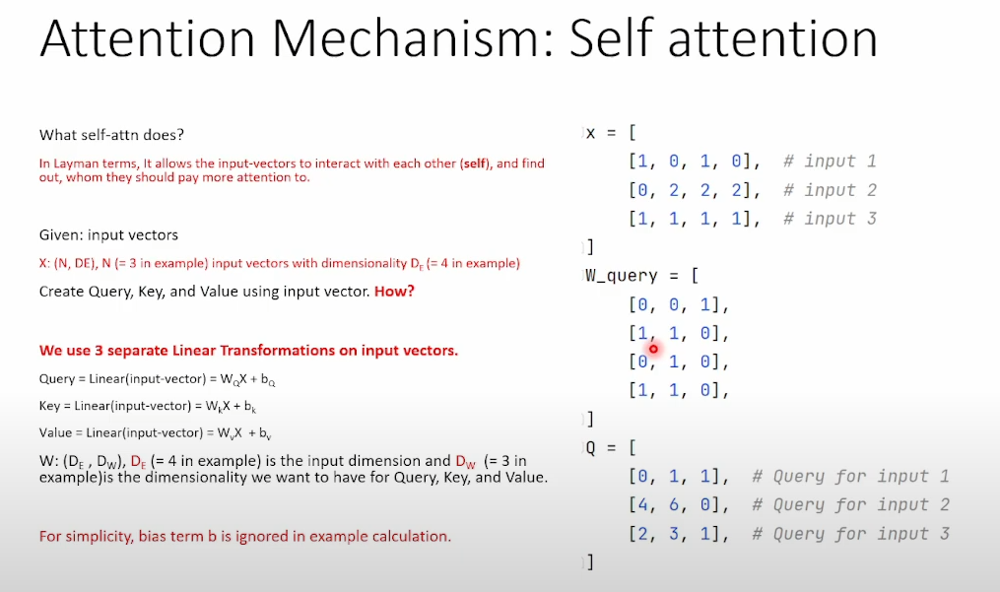

In [ ]:
import numpy
import torch
from torch import nn, matmul
from torch.nn.functional import softmax

#the input is divided into query, key and value
#input is linearly transformed each time to obtain Q, K, V
# Q = Wq X + bias (Wq -> linear transformation to obtain Q; X -> input)

w_query = torch.tensor(
    [
        [0, 0, 1],
        [1, 1, 0],
        [0, 1, 0],
        [1, 1, 0],
    ], dtype=torch.float32)

w_key = torch.tensor(
    [
        [1, 0, 1],
        [1, 0, 0],
        [0, 1, 0],
        [1, 0, 1],
    ]
    , dtype=torch.float32)

w_value = torch.tensor(
    [
        [1, 0, 1],
        [1, 1, 0],
        [0, 1, 1],
        [0, 0, 1],
    ], dtype=torch.float32)

w_unify_heads = torch.tensor(
    [
        [1, 0, 1],
        [0, 1, 0],
        [0, 1, 1],
        [1, 0, 1],
        [0, 1, 1],
        [1, 1, 0],
    ], dtype=torch.float32)


class SelfAttention(nn.Module):
    def __init__(self, embeddings, heads_dim, heads=2):
        super(SelfAttention, self).__init__()

        # Head 1
        self.to_query_h1 = nn.Linear(embeddings, heads_dim, bias=False)
        self.to_query_h1.weight = nn.Parameter(w_query.t())

        self.to_key_h1 = nn.Linear(embeddings, heads_dim, bias=False)
        self.to_key_h1.weight = nn.Parameter(w_key.t())

        self.to_value_h1 = nn.Linear(embeddings, heads_dim, bias=False)
        self.to_value_h1.weight = nn.Parameter(w_value.t())

        # Head 2
        self.to_query_h2 = nn.Linear(embeddings, heads_dim, bias=False)
        self.to_query_h2.weight = nn.Parameter(w_query.t())

        self.to_key_h2 = nn.Linear(embeddings, heads_dim, bias=False)
        self.to_key_h2.weight = nn.Parameter(w_key.t())

        self.to_value_h2 = nn.Linear(embeddings, heads_dim, bias=False)
        self.to_value_h2.weight = nn.Parameter(w_value.t())

        self.unify_heads = nn.Linear(heads * heads_dim, embeddings, bias=False)
        self.unify_heads.weight = nn.Parameter(w_unify_heads.t())

    def forward(self, inputs):
        # Head 1
        # Create Q, K, and V using input vectors
        q_h1 = self.to_query_h1(inputs)
        k_h1 = self.to_key_h1(inputs)
        v_h1 = self.to_value_h1(inputs)
        # Compute Attention scores dot product of Q and K
        attn_scores_h1 = matmul(q_h1, k_h1.transpose(-1, -2))

        # Convert attention scores into probability distributions
        softmax_attn_scores_h1 = softmax(attn_scores_h1, dim=-1)
        output_h1 = matmul(softmax_attn_scores_h1, v_h1)
        print(output_h1.shape)

        # Head 2
        # Create Q, K, and V using input vectors
        q_h2 = self.to_query_h2(inputs)
        k_h2 = self.to_key_h2(inputs)
        v_h2 = self.to_value_h2(inputs)
        # Compute Attention scores
        attn_scores_h2 = matmul(q_h2, k_h2.transpose(-1, -2))

        # Convert attention scores into probability distributions
        softmax_attn_scores_h2 = softmax(attn_scores_h2, dim=-1)
        output_h2 = matmul(softmax_attn_scores_h2, v_h2)
        print(output_h2.shape)
        output_h1_h2 = torch.cat([output_h1, output_h2], dim=-1)
        print(output_h1_h2.shape)
        output_final = self.unify_heads(output_h1_h2)
        print(output_final.shape)


x = torch.tensor([[
    [1, 0, 1, 0],  # input 1
    [0, 2, 2, 2],  # input 2
    [1, 1, 1, 1],  # input 3
],
[
    [1, 0, 1, 0],  # input 1
    [0, 2, 2, 2],  # input 2
    [1, 1, 1, 1],  # input 3
]],
dtype=torch.float32)

attn = SelfAttention(4, 3)
attn(x)

torch.Size([2, 3, 3])
torch.Size([2, 3, 3])
torch.Size([2, 3, 6])
torch.Size([2, 3, 3])


In [ ]:


x.shape

torch.Size([2, 3, 4])

In [ ]:
X = torch.rand((2,16,20))

In [ ]:
X

tensor([[[0.5356, 0.1585, 0.1931, 0.1496, 0.7772, 0.1981, 0.6026, 0.8275,
          0.2311, 0.6132, 0.3543, 0.9691, 0.1090, 0.7575, 0.2141, 0.2807,
          0.6493, 0.2477, 0.5033, 0.7004],
         [0.9144, 0.3881, 0.1941, 0.3612, 0.6362, 0.4048, 0.5467, 0.1307,
          0.3048, 0.4482, 0.8600, 0.4911, 0.3043, 0.6005, 0.8559, 0.2698,
          0.3922, 0.7179, 0.9959, 0.7295],
         [0.1848, 0.8628, 0.7730, 0.0073, 0.1055, 0.0834, 0.1061, 0.1554,
          0.1667, 0.9971, 0.3990, 0.6006, 0.0882, 0.3464, 0.8166, 0.7735,
          0.1551, 0.0325, 0.5463, 0.3466],
         [0.2675, 0.4805, 0.6227, 0.7919, 0.2215, 0.4464, 0.5198, 0.0424,
          0.5900, 0.9826, 0.0420, 0.4781, 0.0251, 0.6196, 0.7115, 0.7263,
          0.6031, 0.3647, 0.4680, 0.1009],
         [0.7701, 0.6132, 0.8302, 0.0711, 0.2015, 0.8427, 0.5024, 0.2177,
          0.7898, 0.9635, 0.7467, 0.7948, 0.9196, 0.4634, 0.2671, 0.9349,
          0.6244, 0.8849, 0.6321, 0.2543],
         [0.7362, 0.1635, 0.1791, 0.1945, 0.5

In [ ]:
# Self Attention: Batched Implementation

# Steps
# 1. Create Query, Key, and Value using input vectors.
# 2. Compute attention scores using Query and Key (transpose).
# 3. Convert attention scores to probability distribution using SoftMax.
# 4. Compute weighted values by multiplying attention scores to corresponding values.
# [Q₁ x K₁] * V₁, [Q₁ x K₂] * V₂ … [Q₁ x Kₙ] * Vₙ
# [Q₂ x K₁] * V₁, [Q₂ x K₂] * V₂ … [Q₂ x Kₙ] * Vₙ
# …
# [Qₙ x K₁] * V₁, [Qₙ x K₂] * V₂ … [Qₙ x Kₙ] * Vₙ
#
# Where "x" is the dot product and "*" is the point-wise matrix multiplication.
# Also, Qₙ is defined as-
# Q = [
# [0, 1, 1], # Q₁
# [4, 6, 0], # Q₂
# [2, 3, 1], # Q₃
# ]
# Similarly, Vₙ is a row of Value matrix, and Kₙ is the column of Key Matrix.

# 5. Add-up the weighted values, computed using the scores of a particular query.
# [Q₁ x K₁] * V₁+ [Q₁ x K₂] * V₂ … + [Q₁ x Kₙ] * Vₙ (R₁)
# [Q₂ x K₁] * V₁+ [Q₂ x K₂] * V₂ … + [Q₂ x Kₙ] * Vₙ (R₂)
# …
# [Qₙ x K₁]* V₁+ [Qₙ x K₂]* V₂… + [Qₙ x Kₙ]* Vₙ (Rₙ)


import numpy
import torch
from torch import nn, matmul
from torch.nn.functional import softmax

w_query = w_key = w_value = torch.rand((20,10))
w_unify_heads = torch.rand((20,10))


class SelfAttention(nn.Module):
    def __init__(self, embeddings, heads_dim, heads=2):
        super(SelfAttention, self).__init__()

        # Head 1
        self.to_query_h1 = nn.Linear(embeddings, heads_dim, bias=False)
        self.to_query_h1.weight = nn.Parameter(w_query.t())

        self.to_key_h1 = nn.Linear(embeddings, heads_dim, bias=False)
        self.to_key_h1.weight = nn.Parameter(w_key.t())

        self.to_value_h1 = nn.Linear(embeddings, heads_dim, bias=False)
        self.to_value_h1.weight = nn.Parameter(w_value.t())

        # Head 2
        self.to_query_h2 = nn.Linear(embeddings, heads_dim, bias=False)
        self.to_query_h2.weight = nn.Parameter(w_query.t())

        self.to_key_h2 = nn.Linear(embeddings, heads_dim, bias=False)
        self.to_key_h2.weight = nn.Parameter(w_key.t())

        self.to_value_h2 = nn.Linear(embeddings, heads_dim, bias=False)
        self.to_value_h2.weight = nn.Parameter(w_value.t())

        self.unify_heads = nn.Linear(heads * heads_dim, embeddings, bias=False)
        self.unify_heads.weight = nn.Parameter(w_unify_heads.t())

    def forward(self, inputs):
        # Head 1
        # Create Q, K, and V using input vectors
        q_h1 = self.to_query_h1(inputs)
        k_h1 = self.to_key_h1(inputs)
        v_h1 = self.to_value_h1(inputs)
        # Compute Attention scores
        attn_scores_h1 = matmul(q_h1, k_h1.transpose(-1, -2))

        # Convert attention scores into probability distributions
        softmax_attn_scores_h1 = softmax(attn_scores_h1, dim=-1)
        output_h1 = matmul(softmax_attn_scores_h1, v_h1)
        print(output_h1.shape)

        # Head 2
        # Create Q, K, and V using input vectors
        q_h2 = self.to_query_h2(inputs)
        k_h2 = self.to_key_h2(inputs)
        v_h2 = self.to_value_h2(inputs)
        # Compute Attention scores
        attn_scores_h2 = matmul(q_h2, k_h2.transpose(-1, -2))

        # Convert attention scores into probability distributions
        softmax_attn_scores_h2 = softmax(attn_scores_h2, dim=-1)
        output_h2 = matmul(softmax_attn_scores_h2, v_h2) #this isn't a scaled dot product, it's a regular softmax
        print(output_h2.shape)
        output_h1_h2 = torch.cat([output_h1, output_h2], dim=-1)
        print(output_h1_h2.shape)
        output_final = self.unify_heads(output_h1_h2)
       #print(output_final)
        print(output_final.shape)
        return output_final


x = torch.rand((2, 16, 20)) #1st and 2nd sentences from 16 reviews, 20 words each

attn = SelfAttention(20,16)
attn(x)

torch.Size([2, 16, 10])
torch.Size([2, 16, 10])
torch.Size([2, 16, 20])
torch.Size([2, 16, 10])


tensor([[[54.7625, 64.7016, 61.0653, 56.7574, 59.6469, 68.8497, 66.2883,
          58.1863, 68.7607, 70.2114],
         [54.7625, 64.7015, 61.0653, 56.7574, 59.6468, 68.8497, 66.2883,
          58.1863, 68.7607, 70.2114],
         [54.7625, 64.7016, 61.0653, 56.7574, 59.6469, 68.8497, 66.2883,
          58.1863, 68.7607, 70.2114],
         [54.7625, 64.7016, 61.0653, 56.7574, 59.6469, 68.8497, 66.2883,
          58.1863, 68.7607, 70.2114],
         [54.7625, 64.7016, 61.0653, 56.7574, 59.6469, 68.8497, 66.2883,
          58.1863, 68.7607, 70.2114],
         [54.7625, 64.7016, 61.0653, 56.7574, 59.6469, 68.8497, 66.2883,
          58.1863, 68.7607, 70.2114],
         [54.7625, 64.7016, 61.0653, 56.7574, 59.6469, 68.8497, 66.2883,
          58.1863, 68.7607, 70.2114],
         [54.7625, 64.7015, 61.0653, 56.7574, 59.6469, 68.8497, 66.2883,
          58.1863, 68.7607, 70.2114],
         [54.7625, 64.7015, 61.0653, 56.7574, 59.6468, 68.8497, 66.2883,
          58.1863, 68.7607, 70.2114],
 

###word attention trial

In [ ]:
bsz = 16
maxlen_sent = 20
hidden_dim  = 32
embed_dim   = 100
vocab_size  = 1000
padding_idx = 1

# net
word_embed = nn.Embedding(vocab_size, embed_dim, padding_idx=padding_idx)
rnn = nn.GRU(embed_dim, hidden_dim, bidirectional=True, batch_first=True)
attn = nn.Linear(hidden_dim*2, hidden_dim*2)
contx = nn.Linear(hidden_dim*2, 1, bias=False)

# inputs
np.arange(1000)
np.arange(1000)
X = torch.from_numpy(np.random.choice(vocab_size, (bsz, maxlen_sent))) #generates bsz x maxlen_sent size arrray with randomly chosen samples from np.arange(vocab_size)
h_n = torch.zeros((2, bsz, hidden_dim)) #initialising hidden state for GRU

In [ ]:
embed = word_embed(X)
embed.shape

torch.Size([16, 20, 100])

In [ ]:
# 2. GRU
h_t, h_n = rnn(embed, h_n)
# (bsz, seq_len, hidden_dim*2)
h_t.shape

torch.Size([16, 20, 64])

In [ ]:
m = nn.Linear(64, 20)
input = torch.randn(16, 20, 64)
output = m(input)
print(output.size())

torch.Size([16, 20, 20])


In [ ]:
# 3. Attention

import numpy
import torch
from torch import nn, matmul
from torch.nn.functional import softmax

w_query = w_key = w_value = torch.rand((64,10))
w_unify_heads = torch.rand((20,50))


class SelfAttention(nn.Module):
    def __init__(self, embeddings, heads_dim, heads=2):
        super(SelfAttention, self).__init__()

        # Head 1
        self.to_query_h1 = nn.Linear(embeddings, heads_dim, bias=False)
        self.to_query_h1.weight = nn.Parameter(w_query.t())

        self.to_key_h1 = nn.Linear(embeddings, heads_dim, bias=False)
        self.to_key_h1.weight = nn.Parameter(w_key.t())

        self.to_value_h1 = nn.Linear(embeddings, heads_dim, bias=False)
        self.to_value_h1.weight = nn.Parameter(w_value.t())

        # Head 2
        self.to_query_h2 = nn.Linear(embeddings, heads_dim, bias=False)
        self.to_query_h2.weight = nn.Parameter(w_query.t())

        self.to_key_h2 = nn.Linear(embeddings, heads_dim, bias=False)
        self.to_key_h2.weight = nn.Parameter(w_key.t())

        self.to_value_h2 = nn.Linear(embeddings, heads_dim, bias=False)
        self.to_value_h2.weight = nn.Parameter(w_value.t())

        self.unify_heads = nn.Linear(heads * heads_dim, embeddings, bias=False)
        self.unify_heads.weight = nn.Parameter(w_unify_heads.t())

    def forward(self, inputs):
        # Head 1
        # Create Q, K, and V using input vectors
        q_h1 = self.to_query_h1(inputs)
        k_h1 = self.to_key_h1(inputs)
        v_h1 = self.to_value_h1(inputs)
        # Compute Attention scores
        attn_scores_h1 = matmul(q_h1, k_h1.transpose(-1, -2))

        # Convert attention scores into probability distributions
        softmax_attn_scores_h1 = softmax(attn_scores_h1, dim=-1)
        output_h1 = matmul(softmax_attn_scores_h1, v_h1)
        print(output_h1.shape)

        # Head 2
        # Create Q, K, and V using input vectors
        q_h2 = self.to_query_h2(inputs)
        k_h2 = self.to_key_h2(inputs)
        v_h2 = self.to_value_h2(inputs)
        # Compute Attention scores
        attn_scores_h2 = matmul(q_h2, k_h2.transpose(-1, -2))

        # Convert attention scores into probability distributions
        softmax_attn_scores_h2 = softmax(attn_scores_h2, dim=-1)
        output_h2 = matmul(softmax_attn_scores_h2, v_h2) #this isn't a scaled dot product, it's a regular softmax
        print(output_h2.shape)
        output_h1_h2 = torch.cat([output_h1, output_h2], dim=-1)
        print(output_h1_h2.shape)
        output_final = self.unify_heads(output_h1_h2)
       #print(output_final)
        print(output_final.shape)
        return output_final

attn = SelfAttention(64,20)
attn(h_t)

torch.Size([16, 20, 10])
torch.Size([16, 20, 10])
torch.Size([16, 20, 20])
torch.Size([16, 20, 50])


tensor([[[-38.7324, -38.7447, -37.8275,  ..., -34.5507, -34.1809, -44.6667],
         [-38.7382, -38.7514, -37.8349,  ..., -34.5555, -34.1865, -44.6722],
         [-38.7382, -38.7514, -37.8350,  ..., -34.5555, -34.1865, -44.6722],
         ...,
         [-38.6394, -38.5701, -37.6186,  ..., -34.4916, -34.0669, -44.6172],
         [-38.0077, -33.6562, -32.3529,  ..., -34.9505, -32.0805, -44.9194],
         [ -4.2436,  -3.4335,  -4.0710,  ...,  -4.5608,  -4.9822,  -4.4586]],

        [[  1.2360,  -1.4670,  -1.0864,  ...,   0.8294,  -0.9107,   0.8917],
         [-25.3837, -25.3981, -23.8741,  ..., -22.4781, -22.1105, -30.5486],
         [ 52.9309,  50.0785,  47.8462,  ...,  47.3891,  44.7762,  61.7179],
         ...,
         [ -3.3614,  -4.5032,  -3.7266,  ...,  -1.9755,  -1.8869,  -4.7650],
         [ 52.9317,  50.0793,  47.8470,  ...,  47.3898,  44.7770,  61.7189],
         [ 52.9317,  50.0793,  47.8470,  ...,  47.3898,  44.7770,  61.7189]],

        [[  4.2959,   6.1923,   4.6909,  ...

In [ ]:
# RNN outputs scaled by their importance weights
s = attn(h_t)
print(s.shape)
# Sum along the seq dim so we end up with a representation per document/review
s = s.sum(1) #sentence vector obtained for each review as the sum of the 20 attention-weighted GRU-processed 64D word vectors
print(s.shape)
# Because this will be stack for all sentences, we do the `.unsqueeze(1)`
print(s.unsqueeze(1).shape)

torch.Size([16, 20, 10])
torch.Size([16, 20, 10])
torch.Size([16, 20, 20])
torch.Size([16, 20, 50])
torch.Size([16, 20, 50])
torch.Size([16, 50])
torch.Size([16, 1, 50])


now we have our sentence vectors

##optimised code multi-head

In [ ]:
w_query = torch.tensor(
    [
        [0, 0, 1, 0, 0, 1],
        [1, 1, 0, 1, 1, 0],
        [0, 1, 0, 0, 1, 0],
        [1, 1, 0, 1, 1, 0],
    ], dtype=torch.float32)

In [ ]:
w_query.shape

torch.Size([4, 6])

In [ ]:
h_t.shape

torch.Size([16, 20, 64])

In [ ]:
m = nn.Linear(64, 100)
input = torch.randn(16, 20, 64)
output = m(input)
print(output.size())

torch.Size([16, 20, 100])


In [ ]:
output.view(16, 20, 5, 20).transpose(1, 2)

tensor([[[[ 0.0602, -0.1856, -0.5088,  ..., -0.1220, -0.2534, -0.3581],
          [ 0.1386, -0.1888,  0.9645,  ...,  0.2582, -0.8333, -0.6541],
          [-0.3521,  0.0360,  0.1770,  ...,  0.2438,  0.7481, -0.1967],
          ...,
          [ 0.3454, -0.4647,  1.1432,  ...,  0.1979, -0.7681, -0.4365],
          [ 0.1183,  0.6908, -0.8221,  ..., -0.2499,  0.6233,  1.2517],
          [-0.9988,  0.2781, -0.5105,  ...,  0.9083, -0.2979,  0.1656]],

         [[-0.3650, -0.3744, -0.0290,  ..., -0.0694, -0.1652, -1.4873],
          [ 1.5640,  0.1779, -0.6626,  ...,  0.3874, -1.0209,  1.1120],
          [ 0.0195, -0.4788, -0.4325,  ..., -0.1648,  1.6110, -0.6804],
          ...,
          [ 0.3479, -0.1198, -0.2342,  ..., -0.4062, -1.0134,  1.7937],
          [-0.6795,  0.0253,  0.4827,  ...,  0.5226,  0.7773, -1.1036],
          [-0.3995, -0.0884, -0.7511,  ...,  0.0711,  0.4848,  0.5559]],

         [[ 0.2189, -0.0903, -0.3812,  ..., -0.0096,  0.2032, -0.4341],
          [ 0.2740, -1.1898, -

In [ ]:
# Multiheaded Attention: Optimized Implementation
import numpy
import torch
from torch import nn, matmul
from torch.nn.functional import softmax

w_query = w_key = w_value = torch.rand((64,100))
w_unify_heads = torch.rand((100,50)) #here 100 = head_dim * no of heads and 50 is whatever we want to output size to be

class SelfAttention(nn.Module):
    def __init__(self, embeddings, heads_dim, heads=5):
        super(SelfAttention, self).__init__()

        # Head 1
        self.heads = heads
        self.heads_dim = heads_dim

        # In final implementation, we must use bias=True
        self.to_query = nn.Linear(embeddings, heads * heads_dim, bias=False)
        self.to_query.weight = nn.Parameter(w_query.t())  # This should be commented in final implementation

        # In final implementation, we must use bias=True
        self.to_key = nn.Linear(embeddings, heads* heads_dim, bias=False)
        self.to_key.weight = nn.Parameter(w_key.t())  # This should be commented in final implementation

        # In final implementation, we must use bias=True
        self.to_value = nn.Linear(embeddings, heads * heads_dim, bias=False)
        self.to_value.weight = nn.Parameter(w_value.t())  # This should be commented in final implementation

        # In final implementation, we must use bias=True
        self.unify_heads = nn.Linear(heads * heads_dim, embeddings, bias=False)
        self.unify_heads.weight = nn.Parameter(w_unify_heads.t())  # This should be commented in final implementation

    def forward(self, inputs):
        # Head 1
        # Create Q, K, and V using input vectors
        bs, seq, emb_dim = inputs.shape
        print(inputs.shape)

        # Transpose: bs x seq-length x num-heads x heads_dim -> bs x num-heads x seq-length x heads_dim
        q = self.to_query(inputs).view(bs, seq, self.heads, self.heads_dim).transpose(1, 2)
        k = self.to_key(inputs).view(bs, seq, self.heads, self.heads_dim).transpose(1, 2)
        v = self.to_value(inputs).view(bs, seq, self.heads, self.heads_dim).transpose(1, 2)
        # Compute Attention scores
        attn_scores = matmul(q, k.transpose(-1, -2))

        # Convert attention scores into probability distributions
        softmax_attn_scores = softmax(attn_scores, dim=-1)

        # Compute Weighted Values
        output = matmul(softmax_attn_scores, v)

        # Reshape the weighted values
        # Transpose: bs x seq-length x num-heads x heads_dim -> bs x seq-length x num-heads x heads_dim)
        output = output.transpose(1, 2).contiguous().view(bs, seq, self.heads * self.heads_dim)
        output_final = self.unify_heads(output)
        print(output_final)
        return output_final


attn = SelfAttention(64,20)
attn(h_t)

torch.Size([16, 20, 64])
tensor([[[-159.3791, -180.6657, -155.6199,  ..., -182.0208, -179.4115,
          -176.8349],
         [-162.9032, -184.0933, -159.1181,  ..., -185.5910, -184.3916,
          -181.2815],
         [-163.7738, -183.7806, -159.8811,  ..., -185.0898, -183.7320,
          -181.2233],
         ...,
         [-162.3956, -180.8928, -155.5311,  ..., -182.7347, -183.8336,
          -177.8990],
         [ -69.3506,  -67.4663,  -54.1737,  ...,  -63.7203,  -80.6141,
           -85.2194],
         [ -63.0975,  -63.2846,  -50.4480,  ...,  -58.4550,  -78.1956,
           -80.0683]],

        [[ 120.1780,  153.7127,  126.2924,  ...,  154.4488,  138.9702,
           124.9534],
         [-127.8187, -143.9400, -128.5450,  ..., -150.0062, -143.2434,
          -142.8719],
         [ 121.6803,  144.7573,  123.6351,  ...,  146.9764,  131.4981,
           126.7871],
         ...,
         [-102.6377, -117.0566, -105.5281,  ..., -118.8937, -111.8279,
          -111.6120],
         [ 210.

tensor([[[-159.3791, -180.6657, -155.6199,  ..., -182.0208, -179.4115,
          -176.8349],
         [-162.9032, -184.0933, -159.1181,  ..., -185.5910, -184.3916,
          -181.2815],
         [-163.7738, -183.7806, -159.8811,  ..., -185.0898, -183.7320,
          -181.2233],
         ...,
         [-162.3956, -180.8928, -155.5311,  ..., -182.7347, -183.8336,
          -177.8990],
         [ -69.3506,  -67.4663,  -54.1737,  ...,  -63.7203,  -80.6141,
           -85.2194],
         [ -63.0975,  -63.2846,  -50.4480,  ...,  -58.4550,  -78.1956,
           -80.0683]],

        [[ 120.1780,  153.7127,  126.2924,  ...,  154.4488,  138.9702,
           124.9534],
         [-127.8187, -143.9400, -128.5450,  ..., -150.0062, -143.2434,
          -142.8719],
         [ 121.6803,  144.7573,  123.6351,  ...,  146.9764,  131.4981,
           126.7871],
         ...,
         [-102.6377, -117.0566, -105.5281,  ..., -118.8937, -111.8279,
          -111.6120],
         [ 210.7244,  240.5189,  215.490

In [ ]:
# RNN outputs scaled by their importance weights
s = attn(h_t)
print(s.shape)
# Sum along the seq dim so we end up with a representation per document/review
s = s.sum(1) #sentence vector obtained for each review as the sum of the 20 attention-weighted GRU-processed 64D word vectors
print(s.shape)
# Because this will be stack for all sentences, we do the `.unsqueeze(1)`
print(s.unsqueeze(1).shape)

torch.Size([16, 20, 64])
tensor([[[-159.3791, -180.6657, -155.6199,  ..., -182.0208, -179.4115,
          -176.8349],
         [-162.9032, -184.0933, -159.1181,  ..., -185.5910, -184.3916,
          -181.2815],
         [-163.7738, -183.7806, -159.8811,  ..., -185.0898, -183.7320,
          -181.2233],
         ...,
         [-162.3956, -180.8928, -155.5311,  ..., -182.7347, -183.8336,
          -177.8990],
         [ -69.3506,  -67.4663,  -54.1737,  ...,  -63.7203,  -80.6141,
           -85.2194],
         [ -63.0975,  -63.2846,  -50.4480,  ...,  -58.4550,  -78.1956,
           -80.0683]],

        [[ 120.1780,  153.7127,  126.2924,  ...,  154.4488,  138.9702,
           124.9534],
         [-127.8187, -143.9400, -128.5450,  ..., -150.0062, -143.2434,
          -142.8719],
         [ 121.6803,  144.7573,  123.6351,  ...,  146.9764,  131.4981,
           126.7871],
         ...,
         [-102.6377, -117.0566, -105.5281,  ..., -118.8937, -111.8279,
          -111.6120],
         [ 210.

##scaled dot product

the above implementations are dot product alone without scaling i.e., Q dot K transpose. Below we implement the scaled dot product of Q and K along with the involvement of V

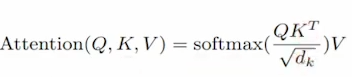

In [ ]:
# Multiheaded Attention Scaled: Optimized Implementation
import numpy
import torch
from torch import nn, matmul
from torch.nn.functional import softmax

class MultiHeadAttention(nn.Module):
    def __init__(self, embeddings, heads_dim=512, heads=5):
        super(MultiHeadAttention, self).__init__()

        self.heads = heads
        self.heads_dim = heads_dim

        # In final implementation, we must use bias=True
        self.to_query = nn.Linear(embeddings, heads * heads_dim, bias=True)
        # self.to_query.weight = nn.Parameter(w_query.t())  # This should be commented in final implementation

        # In final implementation, we must use bias=True
        self.to_key = nn.Linear(embeddings, heads* heads_dim, bias=True)
        # self.to_key.weight = nn.Parameter(w_key.t())  # This should be commented in final implementation

        # In final implementation, we must use bias=True
        self.to_value = nn.Linear(embeddings, heads * heads_dim, bias=True)
        # self.to_value.weight = nn.Parameter(w_value.t())  # This should be commented in final implementation

        # In final implementation, we must use bias=True
        self.unify_heads = nn.Linear(heads * heads_dim, embeddings, bias=True)
        # self.unify_heads.weight = nn.Parameter(w_unify_heads.t())  # This should be commented in final implementation

    def forward(self, inputs, mask=None):
        # Create Q, K, and V using input vectors
        bs, seq, emb_dim = inputs.shape

        # Transpose: bs x seq-length x num-heads x heads_dim -> bs x num-heads x seq-length x heads_dim
        q = self.to_query(inputs).view(bs, seq, self.heads, self.heads_dim).transpose(1, 2)
        k = self.to_key(inputs).view(bs, seq, self.heads, self.heads_dim).transpose(1, 2)
        v = self.to_value(inputs).view(bs, seq, self.heads, self.heads_dim).transpose(1, 2)

        # Scale before Dot-product: q/root_forth(head_dim) and k/root_forth(head_dim)
        q = q/(self.heads_dim ** 1/float(4))
        k = k/(self.heads_dim ** 1/float(4))

        # Compute Attention scores
        attn_scores = matmul(q, k.transpose(-1, -2))
        # Scale after Dot-product : attn_scores/root_square(head_dim)
        attn_scores = attn_scores/(self.heads_dim ** 1/float(2))

        # Apply masking
        if mask is not None:
            attn_scores = attn_scores.masked_fill(mask == 1, value=-1e9)

        # Convert attention scores into probability distributions
        softmax_attn_scores = softmax(attn_scores, dim=-1)

        # Compute Weighted Values
        output = matmul(softmax_attn_scores, v)

        # Reshape the weighted values
        # Transpose: bs x seq-length x num-heads x heads_dim -> bs x seq-length x num-heads x heads_dim)
        output = output.transpose(1, 2).contiguous().view(bs, seq, self.heads * self.heads_dim)
        output_final = self.unify_heads(output)
        return output_final


if __name__ == '__main__':
    attn = MultiHeadAttention(64,20)
    attn(h_t)

NameError: ignored

In [ ]:
# RNN outputs scaled by their importance weights
s = attn(h_t)
print(s.shape)
# Sum along the seq dim so we end up with a representation per document/review
s = s.sum(1) #sentence vector obtained for each review as the sum of the 20 attention-weighted GRU-processed 64D word vectors
print(s.shape)
# Because this will be stack for all sentences, we do the `.unsqueeze(1)`
print(s.unsqueeze(1).shape)

torch.Size([16, 20, 64])
torch.Size([16, 64])
torch.Size([16, 1, 64])


as we don't specify a weight matrix for unify weights, it outputs a 64 dim (same as output size of the unify heads layer)

#complete implementation of multi-head HAN

##defining model and classes

In [ ]:
import torch
import warnings

from torch import nn
import pickle
import torch
import os
import torch.nn.functional as F

from pathlib import Path
from tqdm import trange
from sklearn.metrics import accuracy_score, f1_score, precision_score
from torch.optim.lr_scheduler import CyclicLR, ReduceLROnPlateau
from torch.utils.data import TensorDataset, DataLoader


class WeightDrop(nn.Module):
    def __init__(self, module, weights, dropout=0, variational=False, verbose=True):
        super(WeightDrop, self).__init__()
        self.module = module
        self.weights = weights
        self.dropout = dropout
        self.variational = variational
        self.verbose = verbose
        self._setup()

    def widget_demagnetizer_y2k_edition(*args, **kwargs):
        # We need to replace flatten_parameters with a nothing function
        # It must be a function rather than a lambda as otherwise pickling explodes
        return

    def _setup(self):
        # Terrible temporary solution to an issue regarding compacting weights re: CUDNN RNN
        if issubclass(type(self.module), torch.nn.RNNBase):
            self.module.flatten_parameters = self.widget_demagnetizer_y2k_edition

        for name_w in self.weights:
            if self.verbose:
                print("Applying weight drop of {} to {}".format(self.dropout, name_w))
            w = getattr(self.module, name_w)
            del self.module._parameters[name_w]
            self.module.register_parameter(name_w + "_raw", nn.Parameter(w.data))

    def _setweights(self):
        for name_w in self.weights:
            raw_w = getattr(self.module, name_w + "_raw")
            w = None
            if self.variational:
                mask = torch.ones(raw_w.size(0), 1)
                if raw_w.is_cuda:
                    mask = mask.cuda()
                mask = torch.nn.functional.dropout(mask, p=self.dropout, training=self.training)
                w = nn.Parameter(mask.expand_as(raw_w) * raw_w)
            else:
                w = nn.Parameter(
                    torch.nn.functional.dropout(raw_w, p=self.dropout, training=self.training)
                )
            setattr(self.module, name_w, w)

    def forward(self, *args):
        self._setweights()
        with warnings.catch_warnings():
            # To avoid the warning that comes because the weights aren't flattened.
            warnings.simplefilter("ignore")
            return self.module.forward(*args)

In [ ]:
import torch


def embedded_dropout(embed, words, dropout=0.1, scale=None):
    if dropout:
        mask = embed.weight.data.new().resize_((embed.weight.size(0), 1)).bernoulli_(
            1 - dropout
        ).expand_as(embed.weight) / (1 - dropout)
        masked_embed_weight = mask * embed.weight
    else:
        masked_embed_weight = embed.weight
    if scale:
        masked_embed_weight = scale.expand_as(masked_embed_weight) * masked_embed_weight

    padding_idx = embed.padding_idx
    if padding_idx is None:
        padding_idx = -1

    X = torch.nn.functional.embedding(
        words,
        masked_embed_weight,
        padding_idx,
        embed.max_norm,
        embed.norm_type,
        embed.scale_grad_by_freq,
        embed.sparse,
    )
    return X

In [ ]:
from torch import nn


class LockedDropout(nn.Module):
    def __init__(self):
        super().__init__()

    def forward(self, x, dropout=0.5):
        if not self.training or not dropout:
            return x
        mask = x.data.new(1, x.size(1), x.size(2)).bernoulli_(1 - dropout) / (1 - dropout)
        mask = mask.expand_as(x)
        return mask * x

In [ ]:
# Multiheaded Attention Scaled: Optimized Implementation
import numpy
import torch
from torch import nn, matmul
from torch.nn.functional import softmax

class MultiHeadAttention(nn.Module):
    def __init__(self, embeddings, heads_dim=128, heads=5):
        super(MultiHeadAttention, self).__init__()

        self.heads = heads
        self.heads_dim = heads_dim

        # In final implementation, we must use bias=True
        self.to_query = nn.Linear(embeddings, heads * heads_dim, bias=True)
        # self.to_query.weight = nn.Parameter(w_query.t())  # This should be commented in final implementation

        # In final implementation, we must use bias=True
        self.to_key = nn.Linear(embeddings, heads * heads_dim, bias=True)
        # self.to_key.weight = nn.Parameter(w_key.t())  # This should be commented in final implementation

        # In final implementation, we must use bias=True
        self.to_value = nn.Linear(embeddings, heads * heads_dim, bias=True)
        # self.to_value.weight = nn.Parameter(w_value.t())  # This should be commented in final implementation

        # In final implementation, we must use bias=True
        self.unify_heads = nn.Linear(heads * heads_dim, embeddings, bias=True)
        # self.unify_heads.weight = nn.Parameter(w_unify_heads.t())  # This should be commented in final implementation

    def forward(self, inputs, mask=None):
        # Create Q, K, and V using input vectors
        bs, seq, emb_dim = inputs.shape

        # Transpose: bs x seq-length x num-heads x heads_dim -> bs x num-heads x seq-length x heads_dim
        q = self.to_query(inputs).view(bs, seq, self.heads, self.heads_dim).transpose(1, 2)
        k = self.to_key(inputs).view(bs, seq, self.heads, self.heads_dim).transpose(1, 2)
        v = self.to_value(inputs).view(bs, seq, self.heads, self.heads_dim).transpose(1, 2)

        # Scale before Dot-product: q/root_forth(head_dim) and k/root_forth(head_dim)
        q = q/(self.heads_dim ** 1/float(4))
        k = k/(self.heads_dim ** 1/float(4))

        # Compute Attention scores
        attn_scores = matmul(q, k.transpose(-1, -2))
        # Scale after Dot-product : attn_scores/root_square(head_dim)
        attn_scores = attn_scores/(self.heads_dim ** 1/float(2)) #-> was commented in all implementations before 3rd dec

        # Apply masking
        if mask is not None:
            attn_scores = attn_scores.masked_fill(mask == 1, value=-1e9)

        # Convert attention scores into probability distributions
        softmax_attn_scores = softmax(attn_scores, dim=-1)

        # Compute Weighted Values
        output = matmul(softmax_attn_scores, v)

        # Reshape the weighted values
        # Transpose: bs x seq-length x num-heads x heads_dim -> bs x seq-length x num-heads x heads_dim)
        output = output.transpose(1, 2).contiguous().view(bs, seq, self.heads * self.heads_dim)
        output_final = self.unify_heads(output)
        return output_final

In [ ]:
class WordAttnNet(nn.Module):
    def __init__(
        self,
        vocab_size,
        hidden_dim=64,
        padding_idx=1,
        embed_dim=50,
        embedding_matrix=None,
        heads=25,
        heads_dim=50,
        weight_drop=1,
        embed_drop=0,
        locked_drop=0,
    ):
        super(WordAttnNet, self).__init__()

        self.lockdrop = LockedDropout()
        self.embed_drop = embed_drop
        self.weight_drop = weight_drop
        self.locked_drop = locked_drop

        if isinstance(embedding_matrix, np.ndarray): #if the embedding matrix is given and is a numpy array, then execute below code
        #the above is to allow the use of pre-trained embeddings
            self.word_embed = nn.Embedding(
                vocab_size, embedding_matrix.shape[1], padding_idx=padding_idx
            ) #A simple lookup table that stores embeddings of each word in the specified vocabulary
            self.word_embed.weight = nn.Parameter(torch.Tensor(embedding_matrix))
            embed_dim = embedding_matrix.shape[1]
        else:
            self.word_embed = nn.Embedding(vocab_size, embed_dim, padding_idx=padding_idx)


        self.rnn = nn.GRU(embed_dim, hidden_dim, bidirectional=True, batch_first=True)


        if weight_drop:
            self.rnn = WeightDrop(
                self.rnn, ["weight_hh_l0", "weight_hh_l0_reverse"], dropout=weight_drop
            )


        self.word_attn = MultiHeadAttention(embeddings=hidden_dim*2, heads_dim=maxlen_sent, heads=heads) #seq_len=25 here as each sentence has 25 words

        #self.word_attn = MultiHeadAttention(hidden_dim*2)

    def forward(self, X, h_n): #X: input matrix (reviews), h_n: initial hidden_state for GRU

        if self.embed_drop:
            embed = embedded_dropout(
                self.word_embed, X.long(), dropout=self.embed_drop if self.training else 0,
            )
        else:
            embed = self.word_embed(X.long())

        if self.locked_drop:
            embed = self.lockdrop(embed, self.locked_drop)

        #embed = self.word_embed(X.long())

        h_t, h_n = self.rnn(embed, h_n)
        s = self.word_attn(h_t)
        s = s.sum(1)
        return s.unsqueeze(1), h_n #returns sentence vectors, last hidden state

In [ ]:
a = np.matrix('1 2; 3 4')

In [ ]:
a.shape

(2, 2)

In [ ]:
class SentAttnNet(nn.Module):
    def __init__(self, word_hidden_dim=32, sent_hidden_dim=32, padding_idx=1, hidden_dim=64, heads=5, heads_dim=50, weight_drop=1):

        super(SentAttnNet, self).__init__()


        self.rnn = nn.GRU(word_hidden_dim * 2, sent_hidden_dim, bidirectional=True, batch_first=True)
        #gru takes 16,1,64 sentence matrix from last step and gives out a 16,1,64

        if weight_drop:
            self.rnn = WeightDrop(
                self.rnn, ["weight_hh_l0", "weight_hh_l0_reverse"], dropout=weight_drop
            )

        self.sent_attn = MultiHeadAttention(embeddings=sent_hidden_dim*2, heads_dim=heads_dim, heads=heads) #seq_len = 5 here as each review has 5 sentences
        #self.sent_attn = MultiHeadAttention(hidden_dim*2)

    def forward(self, X):
        h_t, h_n = self.rnn(X)
        print("\n Output shape:")
        print(h_t.shape)
        print("\n: Summed output shape")
        h_t_summed = h_t.sum(1)
        print(h_t_summed.shape)
        v = self.sent_attn(h_t)
        v = v.sum(1)
        print("\n Weighted sum output shape:")
        print(v.shape)
        return v #returns document vector

In [ ]:
class HierAttnNet(nn.Module):
    def __init__(
        self,
        vocab_size,
        maxlen_sent,
        maxlen_doc,
        word_hidden_dim=256,
        sent_hidden_dim=256,
        padding_idx=1,
        embed_dim=200,
        embedding_matrix=None,
        num_class=2,
        heads=10,
        heads_dim=50
    ):
        super(HierAttnNet, self).__init__()

        self.word_hidden_dim = word_hidden_dim

        self.wordattnnet = WordAttnNet(
            vocab_size=vocab_size,
            hidden_dim=word_hidden_dim,
            padding_idx=padding_idx,
            embed_dim=embed_dim,
            embedding_matrix=embedding_matrix,
            heads=heads,
            heads_dim=heads_dim,
        )

        self.sentattnnet = SentAttnNet(
            word_hidden_dim=word_hidden_dim,
            sent_hidden_dim=sent_hidden_dim,
            padding_idx=padding_idx,
            heads=heads,
            heads_dim=heads_dim,
        )

        self.fc = nn.Linear(sent_hidden_dim * 2, num_class)

    def forward(self, X):
        x = X.permute(1, 0, 2)
        #word_h_n = nn.init.zeros_(torch.Tensor(2, X.shape[0], self.word_hidden_dim)) #initialising random context vector

        word_h_n = nn.init.zeros_(torch.Tensor(2, X.shape[0], self.word_hidden_dim)) #initialising random context vector


        if use_cuda:
            word_h_n = word_h_n.cuda()
        else:
          pass

        # alpha and s Tensor Lists
        word_s_list = []
        for sent in x: #going through the numerical representation of each sentence
            word_s, word_h_n = self.wordattnnet(sent, word_h_n)  #we get sentence vector and updated context vector (last hidden state of rnn)
            word_s_list.append(word_s)

        # Sentences representation
        sent_s = torch.cat(word_s_list, 1)
        # Importance attention weights per sentence in doc and document representation
        doc_s = self.sentattnnet(sent_s)
        return self.fc(doc_s)

##example implementation

In [ ]:
maxlen_sent = 30
maxlen_doc = 7
num_class = 2
word_hidden_dim = 256
sent_hidden_dim = 256
vocab_size  = 1000
hidden_dim=32

wordattnnet = WordAttnNet(vocab_size, hidden_dim, padding_idx, embed_dim, embedding_matrix=None)
sentattnnet = SentAttnNet(word_hidden_dim, sent_hidden_dim, padding_idx)
fc = nn.Linear(sent_hidden_dim * 2, num_class)

NameError: ignored

In [ ]:
X = torch.from_numpy(np.random.choice(vocab_size, (bsz, maxlen_doc, maxlen_sent))) #16,5,20

16 reviews made up of 5 sentences and 20 words each

In [ ]:
x = X.permute(1, 0, 2)
x.shape

torch.Size([5, 16, 20])

this is done to pass in sentence-by-sentence for each review ie 1st sentence of each review, then 2nd, then 3rd, and so on

In [ ]:
# Initial Word RNN hidden state
word_h_n = nn.init.zeros_(torch.Tensor(2, X.shape[0], word_hidden_dim))

In [ ]:
word_h_n.shape

torch.Size([2, 16, 32])

In [ ]:
# Loop through sentences:
word_a_list, word_s_list = [], []
for sent in x:
    word_s, word_h_n = wordattnnet(sent, word_h_n)
    word_s_list.append(word_s)

# Sentences representation
sent_s = torch.cat(word_s_list, 1)

# (bsz, maxlen_doc, hidden_dim*2)
print(sent_s.shape)

torch.Size([16, 5, 64])


In [ ]:
sent.shape #ith sentence from each review

torch.Size([16, 20])

In [ ]:
word_s.shape #sentence vector

torch.Size([16, 1, 64])

In [ ]:
len(word_s_list) #concat of all 5 sentence vectors for all reviews

5

In [ ]:
sent_s.shape #basically forming a 3D tensor out of a list of tensors (word_s_list)

torch.Size([16, 5, 64])

In [ ]:
doc_s = sentattnnet(sent_s) #getting document vectors

# (bsz, hidden_dim*2)
print(doc_s.shape)

torch.Size([16, 64])


In [ ]:
out = fc(doc_s)
out.shape

torch.Size([16, 2])

In [ ]:
out

tensor([[-0.2918,  0.2227],
        [-0.4085,  0.1218],
        [-0.2867,  0.1625],
        [-0.1118, -0.4464],
        [-0.0137, -0.1923],
        [-0.2348,  0.0293],
        [-0.4011,  0.1005],
        [-0.2645,  0.0447],
        [-0.3691,  0.1600],
        [-0.0629,  0.0511],
        [-0.2622, -0.0011],
        [-0.3614, -0.1364],
        [-0.3061,  0.0901],
        [-0.1327, -0.2172],
        [-0.1851, -0.2436],
        [-0.4704,  0.1897]], grad_fn=<AddmmBackward0>)

##running the model

myle ott

In [ ]:
X_train, X_valid, y_train, y_valid = train_test_split(
        padded_texts, df.label, train_size=0.7, random_state=1, stratify=df.label
    )
X_valid, X_test, y_valid, y_test = train_test_split(
        X_valid, y_valid, train_size=0.5, random_state=1, stratify=y_valid
)

yelp

In [ ]:
X_train, X_valid, y_train, y_valid = train_test_split(
        padded_texts, df.flagged, train_size=0.7, random_state=1, stratify=df.flagged
    )
X_valid, X_test, y_valid, y_test = train_test_split(
        X_valid, y_valid, train_size=0.5, random_state=1, stratify=y_valid
)

In [ ]:
y_valid.astype(int)

60247    1
61077    1
4789     0
40507    0
61509    1
        ..
32172    0
31221    0
23361    0
61923    1
7553     0
Name: flagged, Length: 3007, dtype: int64

In [ ]:
from tqdm import trange
from sklearn.metrics import accuracy_score, f1_score, precision_score
from torch.optim.lr_scheduler import CyclicLR, ReduceLROnPlateau
from torch.utils.data import TensorDataset, DataLoader

In [ ]:
batch_size=64

train_set = TensorDataset(
    torch.from_numpy(X_train),
    torch.from_numpy( y_train.values.astype(int) ),
)

train_loader = DataLoader(dataset=train_set, batch_size=batch_size, num_workers=n_cpus)

test_set = TensorDataset(
    torch.from_numpy(X_test),
    torch.from_numpy( y_test.values.astype(int) ),
)

test_loader = DataLoader(dataset=test_set, batch_size=batch_size, num_workers=n_cpus)

eval_set = TensorDataset(
    torch.from_numpy(X_valid),
    torch.from_numpy( np.array( y_valid.astype(int) ) ),
)

eval_loader = DataLoader(
    dataset=eval_set, batch_size=batch_size, num_workers=n_cpus, shuffle=False
)

In [ ]:
class CategoricalAccuracy(object):
    def __init__(self, top_k=1):
        self.top_k = top_k
        self.correct_count = 0
        self.total_count = 0

        self._name = "acc"

    def reset(self):
        self.correct_count = 0
        self.total_count = 0

    def __call__(self, y_pred, y_true):
        top_k = y_pred.topk(self.top_k, 1)[1]
        true_k = y_true.view(len(y_true), 1).expand_as(top_k)
        self.correct_count += top_k.eq(true_k).float().sum().item()
        self.total_count += len(y_pred)
        accuracy = float(self.correct_count) / float(self.total_count)
        return np.round(accuracy, 4)

In [ ]:
model = HierAttnNet(
    vocab_size=len(vocab.stoi),
    maxlen_sent=maxlen_sent,
    maxlen_doc=maxlen_doc,
    word_hidden_dim=64,
    sent_hidden_dim=64,
    padding_idx=1,
    embed_dim=100,
    #weight_drop=0.,
    #embed_drop=0.,
    #locked_drop=0.,
    #last_drop=0.,
    embedding_matrix=None,
    num_class=2,
    heads=50,
    heads_dim=128
)

Applying weight drop of 1 to weight_hh_l0
Applying weight drop of 1 to weight_hh_l0_reverse
Applying weight drop of 1 to weight_hh_l0
Applying weight drop of 1 to weight_hh_l0_reverse


In [ ]:
optimizer = torch.optim.AdamW(model.parameters(), lr=0.005, weight_decay=0.05)
# This class is at the utils module
metric = CategoricalAccuracy()

###normal run

In [ ]:
def train_step(model, optimizer, train_loader, epoch, metric):
    model.train()
    metric.reset()
    train_steps = len(train_loader)
    running_loss = 0
    with trange(train_steps) as t:
        for batch_idx, (data, target) in zip(t, train_loader):
            t.set_description("epoch %i" % (epoch + 1))

            X = data.cuda() if use_cuda else data
            y = target.cuda() if use_cuda else target

            optimizer.zero_grad()
            y_pred = model(X)
            loss = F.cross_entropy(y_pred, y)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()
            avg_loss = running_loss / (batch_idx + 1)
            acc = metric(F.softmax(y_pred, dim=1), y)

            t.set_postfix(acc=acc, loss=avg_loss)

def eval_step(model, eval_loader, metric, is_test=False):
    model.eval()
    metric.reset()
    eval_steps = len(eval_loader)
    running_loss = 0
    preds = []
    with torch.no_grad():
        with trange(eval_steps) as t:
            for batch_idx, (data, target) in zip(t, eval_loader):
                if is_test:
                    t.set_description("test")
                else:
                    t.set_description("valid")

                X = data.cuda() if use_cuda else data
                y = target.cuda() if use_cuda else target

                y_pred = model(X)
                loss = F.cross_entropy(y_pred, y)
                running_loss += loss.item()
                avg_loss = running_loss / (batch_idx + 1)
                acc = metric(F.softmax(y_pred, dim=1), y)
                if is_test:
                    preds.append(y_pred)
                t.set_postfix(acc=acc, loss=avg_loss)

    return avg_loss, preds, acc

def early_stopping(curr_value, best_value, stop_step, patience):
    if curr_value <= best_value:
        stop_step, best_value = 0, curr_value
    else:
        stop_step += 1
    if stop_step >= patience:
        print("Early stopping triggered. log:{}".format(best_value))
        stop = True
    else:
        stop = False
    return best_value, stop_step, stop

n_cpus = os.cpu_count()
use_cuda = torch.cuda.is_available()

In [ ]:
metric = CategoricalAccuracy()
n_epochs = 45
eval_every = 1
patience = 45
stop_step = 0
best_loss = 1e6
for epoch in range(n_epochs):
    train_step(model, optimizer, train_loader, epoch, metric)
    if epoch % eval_every == (eval_every - 1):
        val_loss, _, _ = eval_step(model, eval_loader, metric)
        best_loss, stop_step, stop = early_stopping(
            val_loss, best_loss, stop_step, patience
        )
    if stop:
        break

epoch 1:   0%|          | 0/18 [00:00<?, ?it/s]


 Output shape:
torch.Size([64, 13, 128])

: Summed output shape
torch.Size([64, 128])

 Weighted sum output shape:
torch.Size([64, 128])


epoch 1:   6%|▌         | 1/18 [00:06<01:48,  6.37s/it, acc=0.469, loss=0.712]


 Output shape:
torch.Size([64, 13, 128])

: Summed output shape
torch.Size([64, 128])

 Weighted sum output shape:
torch.Size([64, 128])


epoch 1:  11%|█         | 2/18 [00:11<01:32,  5.79s/it, acc=0.492, loss=31.8]


 Output shape:
torch.Size([64, 13, 128])

: Summed output shape
torch.Size([64, 128])

 Weighted sum output shape:
torch.Size([64, 128])


epoch 1:  17%|█▋        | 3/18 [00:15<01:09,  4.64s/it, acc=0.49, loss=187]


 Output shape:
torch.Size([64, 13, 128])

: Summed output shape
torch.Size([64, 128])

 Weighted sum output shape:
torch.Size([64, 128])


epoch 1:  22%|██▏       | 4/18 [00:20<01:07,  4.85s/it, acc=0.496, loss=163]


 Output shape:
torch.Size([64, 13, 128])

: Summed output shape
torch.Size([64, 128])

 Weighted sum output shape:
torch.Size([64, 128])


epoch 1:  28%|██▊       | 5/18 [00:23<00:56,  4.38s/it, acc=0.503, loss=141]


 Output shape:
torch.Size([64, 13, 128])

: Summed output shape
torch.Size([64, 128])

 Weighted sum output shape:
torch.Size([64, 128])


epoch 1:  33%|███▎      | 6/18 [00:27<00:48,  4.02s/it, acc=0.49, loss=133]


 Output shape:
torch.Size([64, 13, 128])

: Summed output shape
torch.Size([64, 128])

 Weighted sum output shape:
torch.Size([64, 128])


epoch 1:  39%|███▉      | 7/18 [00:37<01:05,  5.96s/it, acc=0.48, loss=118]


 Output shape:
torch.Size([64, 13, 128])

: Summed output shape
torch.Size([64, 128])

 Weighted sum output shape:
torch.Size([64, 128])


epoch 1:  39%|███▉      | 7/18 [02:25<03:48, 20.81s/it, acc=0.48, loss=118]


KeyboardInterrupt: ignored

validation accuracy saturates at 0.5 for myle ott full dataset

###k-fold cross validation

In [ ]:
def train_step(model, optimizer, train_loader, epoch, metric):
    model.train()
    metric.reset()
    train_steps = len(train_loader)
    running_loss = 0
    with trange(train_steps) as t:
        for batch_idx, (data, target) in zip(t, train_loader):
            t.set_description("epoch %i" % (epoch + 1))

            X = data.cuda() if use_cuda else data
            y = target.cuda() if use_cuda else target

            optimizer.zero_grad()
            y_pred = model(X)
            loss = F.cross_entropy(y_pred, y)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()
            avg_loss = running_loss / (batch_idx + 1)
            acc = metric(F.softmax(y_pred, dim=1), y)

            t.set_postfix(acc=acc, loss=avg_loss)

In [ ]:
def eval_step(model, eval_loader, metric, is_test=False):
    model.eval()
    metric.reset()
    eval_steps = len(eval_loader)
    running_loss = 0
    preds = []
    with torch.no_grad():
        with trange(eval_steps) as t:
            for batch_idx, (data, target) in zip(t, eval_loader):
                if is_test:
                    t.set_description("test")
                else:
                    t.set_description("valid")

                X = data.cuda() if use_cuda else data
                y = target.cuda() if use_cuda else target

                y_pred = model(X)
                loss = F.cross_entropy(y_pred, y)
                running_loss += loss.item()
                avg_loss = running_loss / (batch_idx + 1)
                acc = metric(F.softmax(y_pred, dim=1), y)
                if is_test:
                    preds.append(y_pred)
                t.set_postfix(acc=acc, loss=avg_loss)

    return avg_loss, preds, acc

In [ ]:
def early_stopping(curr_value, best_value, stop_step, patience):
    if curr_value <= best_value:
        stop_step, best_value = 0, curr_value
    else:
        stop_step += 1
    if stop_step >= patience:
        print("Early stopping triggered. log:{}".format(best_value))
        stop = True
    else:
        stop = False
    return best_value, stop_step, stop

In [ ]:
n_cpus = os.cpu_count()
use_cuda = torch.cuda.is_available()

In [ ]:
import os
import torch
from torch import nn
from torchvision.datasets import MNIST
from torch.utils.data import DataLoader, ConcatDataset
from torchvision import transforms
from sklearn.model_selection import KFold


if __name__ == '__main__':

  # Configuration options
  k_folds = 5
  num_epochs = 5
  loss_function = nn.CrossEntropyLoss()

  # For fold results
  results = {}

  # Set fixed random number seed
  torch.manual_seed(42)

  # Prepare MNIST dataset by concatenating Train/Test part; we split later.
  dataset = torch.utils.data.ConcatDataset([train_set, test_set])

  # Define the K-fold Cross Validator
  kfold = KFold(n_splits=k_folds, shuffle=True)

  # Start print
  print('--------------------------------')

  # K-fold Cross Validation model evaluation
  for fold, (train_ids, test_ids) in enumerate(kfold.split(dataset)):

    # Print
    print(f'FOLD {fold}')
    print('--------------------------------')


    # Sample elements randomly from a given list of ids, no replacement.
    train_subsampler = torch.utils.data.SubsetRandomSampler(train_ids)
    test_subsampler = torch.utils.data.SubsetRandomSampler(test_ids)

    # Define data loaders for training and testing data in this fold
    trainloader = torch.utils.data.DataLoader(
                      dataset,
                      batch_size=10, sampler=train_subsampler)
    testloader = torch.utils.data.DataLoader(
                      dataset,
                      batch_size=10, sampler=test_subsampler)

    # Init the neural network
    network = model

    # Initialize optimizer
    optimizer = optimizer

    # Run the training loop for defined number of epochs
    for epoch in range(0, num_epochs):

      # Print epoch
      print(f'Starting epoch {epoch+1}')

      # Set current loss value
      current_loss = 0.0

      # Iterate over the DataLoader for training data
      for i, data in enumerate(trainloader, 0):

        # Get inputs
        inputs, targets = data

        # Zero the gradients
        optimizer.zero_grad()

        # Perform forward pass
        outputs = network(inputs)

        # Compute loss
        loss = loss_function(outputs, targets)

        # Perform backward pass
        loss.backward()

        # Perform optimization
        optimizer.step()

        # Print statistics
        current_loss += loss.item()
        if i % 500 == 499:
            print('Loss after mini-batch %5d: %.3f' %
                  (i + 1, current_loss / 500))
            current_loss = 0.0

    # Process is complete.
    print('Training process has finished. Saving trained model.')

    # Print about testing
    print('Starting testing')

    # Saving the model
    save_path = f'./model-fold-{fold}.pth'
    torch.save(network.state_dict(), save_path)

    # Evaluationfor this fold
    correct, total = 0, 0
    with torch.no_grad():

      # Iterate over the test data and generate predictions
      for i, data in enumerate(testloader, 0):

        # Get inputs
        inputs, targets = data

        # Generate outputs
        outputs = network(inputs)

        # Set total and correct
        _, predicted = torch.max(outputs.data, 1)
        total += targets.size(0)
        correct += (predicted == targets).sum().item()

      # Print accuracy
      print('Accuracy for fold %d: %d %%' % (fold, 100.0 * correct / total))
      print('--------------------------------')
      results[fold] = 100.0 * (correct / total)

  # Print fold results
  print(f'K-FOLD CROSS VALIDATION RESULTS FOR {k_folds} FOLDS')
  print('--------------------------------')
  sum = 0.0
  for key, value in results.items():
    print(f'Fold {key}: {value} %')
    sum += value
  print(f'Average: {sum/len(results.items())} %')

--------------------------------
FOLD 0
--------------------------------
Starting epoch 1
Loss after mini-batch   500: 2.265
Loss after mini-batch  1000: 22.734
Starting epoch 2
Loss after mini-batch   500: 0.689
Loss after mini-batch  1000: 0.681
Starting epoch 3
Loss after mini-batch   500: 0.682
Loss after mini-batch  1000: 0.682
Starting epoch 4
Loss after mini-batch   500: 0.684
Loss after mini-batch  1000: 280.410
Starting epoch 5
Loss after mini-batch   500: 1.077
Loss after mini-batch  1000: 0.754
Training process has finished. Saving trained model.
Starting testing
Accuracy for fold 0: 60 %
--------------------------------
FOLD 1
--------------------------------
Starting epoch 1
Loss after mini-batch   500: 0.682
Loss after mini-batch  1000: 0.680
Starting epoch 2
Loss after mini-batch   500: 0.669
Loss after mini-batch  1000: 0.669
Starting epoch 3
Loss after mini-batch   500: 0.665
Loss after mini-batch  1000: 0.671
Starting epoch 4
Loss after mini-batch   500: 0.680
Loss af

    word_hidden_dim=64,
    sent_hidden_dim=64,
    embed_dim=100,
    heads=1

In [ ]:
metric = CategoricalAccuracy()
n_epochs = 10
eval_every = 1
patience = 1
stop_step = 0
best_loss = 1e6
for epoch in range(n_epochs):
    train_step(model, optimizer, train_loader, epoch, metric)
    if epoch % eval_every == (eval_every - 1):
        val_loss, _ = eval_step(model, eval_loader, metric)
        best_loss, stop_step, stop = early_stopping(
            val_loss, best_loss, stop_step, patience
        )
    if stop:
        break

valid: 100%|██████████| 2/2 [00:00<00:00,  3.80it/s, acc=0.8, loss=0.467]


Early stopping triggered. log:0.4616222679615021


    word_hidden_dim=64,
    sent_hidden_dim=64,
    embed_dim=100,
    heads=5

In [ ]:
metric = CategoricalAccuracy()
n_epochs = 10
eval_every = 1
patience = 1
stop_step = 0
best_loss = 1e6
for epoch in range(n_epochs):
    train_step(model, optimizer, train_loader, epoch, metric)
    if epoch % eval_every == (eval_every - 1):
        val_loss, _ = eval_step(model, eval_loader, metric)
        best_loss, stop_step, stop = early_stopping(
            val_loss, best_loss, stop_step, patience
        )
    if stop:
        break

valid: 100%|██████████| 2/2 [00:00<00:00,  2.62it/s, acc=0.75, loss=0.592]

Early stopping triggered. log:0.5638110339641571


###hyperparameter tuning



*   this [paper](https://arxiv.org/pdf/2102.02680.pdf) mentions that they set aside some 10% data for hyperparameter tuning after which they proceed with k-fold cross val for the remaining 90% of the data
*   this [one](https://www.sciencedirect.com/science/article/pii/S0306437921000934?casa_token=fdldSNEFmigAAAAA:0YCjLdSJIVFE9Ny6dJirDRlvY7E5DwA69jKUBUUraypd0IJ6Nv36nchiyoj63B7q4ZZA47I5jQ#b27) doesn't say naything about how they tune parameters it just gives the accuracy for every setting of every parameter

*   this [paper](https://www.sciencedirect.com/science/article/pii/S0306457317304272) does hyperparameter tuning along with k-fold cv





In [ ]:
!pip install optuna

In [ ]:
!pip install ray torch torchvision

In [ ]:
!pip install "ray[tune]"

In [ ]:
batch_size = 64

train_set = TensorDataset(
    torch.from_numpy(X_train),
    torch.from_numpy( y_train.values.astype(int) ),
)

train_loader = DataLoader(dataset=train_set, batch_size=batch_size, num_workers=n_cpus)



test_set = TensorDataset(
    torch.from_numpy(X_test),
    torch.from_numpy( y_test.values.astype(int) ),
)

test_loader = DataLoader(
    dataset=test_set, batch_size=batch_size, num_workers=n_cpus, shuffle=False
)



eval_set = TensorDataset(
    torch.from_numpy(X_valid),
    torch.from_numpy( np.array( y_valid.astype(int) ) ),
)


eval_loader = DataLoader(
    dataset=eval_set, batch_size=batch_size, num_workers=n_cpus, shuffle=False
)

In [ ]:
# 1. Wrap your PyTorch model in an objective function.
import torch
import ray
from ray import tune, air
from ray.air import session
from ray.tune.search.optuna import OptunaSearch
from ray.tune.schedulers import ASHAScheduler
from ray.tune import CLIReporter


# 1. Wrap a PyTorch model in an objective function.
def objective(config):
    tr_loader, tst_loader = train_loader, eval_loader # Load some data
    mod = model
    opt = optimizer
    num_epochs = 15
    met = metric

    while True:
        train_step(mod, opt, tr_loader, num_epochs, met)  # Train the model
        _, _, acc = eval_step(mod, tst_loader, met, True)  # Compute test accuracy
        session.report({"mean_accuracy": acc})  # Report to Tune


# 2. Define a search space and initialize the search algorithm.
search_space = {"word_hidden_dim": tune.randint(32, 256), "sent_hidden_dim": tune.randint(32, 256), "embed_dim": tune.randint(20, 400), "heads": tune.randint(1,100),
                "heads_dim":tune.randint(1,200)}
algo = OptunaSearch()

#scheduler = ASHAScheduler(
#        max_t=10,
#        grace_period=5,
#        reduction_factor=4)

reporter = CLIReporter()


# 3. Start a Tune run that maximizes mean accuracy
tuner = tune.Tuner(
    objective,
    tune_config=tune.TuneConfig(
        metric="mean_accuracy",
        mode="max",
        search_alg=algo,
#        scheduler=scheduler
    ),
    run_config=air.RunConfig(
        stop={"training_iteration": 30},
        progress_reporter=reporter,
        local_dir="/content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1",
        name="test_experiment"
    ),
    param_space=search_space,


)

results = tuner.fit()
print("Best config is:", results.get_best_result().config)

[I 2022-11-16 16:37:00,268] A new study created in memory with name: optuna
2022-11-16 16:37:03,644	WARNING worker.py:1839 -- Warning: The actor ImplicitFunc is very large (83 MiB). Check that its definition is not implicitly capturing a large array or other object in scope. Tip: use ray.put() to put large objects in the Ray object store.
2022-11-16 16:37:04,035	WARNING util.py:244 -- The `start_trial` operation took 2.426 s, which may be a performance bottleneck.


== Status ==
Current time: 2022-11-16 16:37:08 (running for 00:00:07.97)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:   0%|          | 0/220 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-16 16:37:13 (running for 00:00:12.97)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:   0%|          | 1/220 [00:06<21:56,  6.01s/it, acc=0.578, loss=0.652]


== Status ==
Current time: 2022-11-16 16:37:18 (running for 00:00:18.02)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:   1%|          | 2/220 [00:14<27:31,  7.58s/it, acc=0.531, loss=12.6]


== Status ==
Current time: 2022-11-16 16:37:23 (running for 00:00:23.03)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:   1%|▏         | 3/220 [00:30<40:45, 11.27s/it, acc=0.552, loss=15.1]


== Status ==
Current time: 2022-11-16 16:37:43 (running for 00:00:43.17)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:   2%|▏         | 4/220 [00:46<46:48, 13.00s/it, acc=0.508, loss=28.1]


== Status ==
Current time: 2022-11-16 16:37:58 (running for 00:00:58.27)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:   2%|▏         | 5/220 [00:53<39:49, 11.12s/it, acc=0.497, loss=25.6]


== Status ==
Current time: 2022-11-16 16:38:03 (running for 00:01:03.27)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:   3%|▎         | 6/220 [00:59<33:23,  9.36s/it, acc=0.471, loss=22.6]


== Status ==
Current time: 2022-11-16 16:38:08 (running for 00:01:08.32)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:   3%|▎         | 7/220 [01:04<28:23,  8.00s/it, acc=0.473, loss=20]


== Status ==
Current time: 2022-11-16 16:38:13 (running for 00:01:13.33)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:   4%|▎         | 8/220 [01:10<25:06,  7.11s/it, acc=0.469, loss=18.4]


== Status ==
Current time: 2022-11-16 16:38:18 (running for 00:01:18.39)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:   4%|▍         | 9/220 [01:15<22:53,  6.51s/it, acc=0.479, loss=16.7]


== Status ==
Current time: 2022-11-16 16:38:23 (running for 00:01:23.40)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:   5%|▍         | 10/220 [01:20<21:15,  6.07s/it, acc=0.494, loss=15.1]


== Status ==
Current time: 2022-11-16 16:38:33 (running for 00:01:33.46)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:   5%|▌         | 11/220 [01:25<20:09,  5.79s/it, acc=0.489, loss=14]


== Status ==
Current time: 2022-11-16 16:38:38 (running for 00:01:38.52)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:   5%|▌         | 12/220 [01:30<19:22,  5.59s/it, acc=0.499, loss=13.2]


== Status ==
Current time: 2022-11-16 16:38:43 (running for 00:01:43.53)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:   6%|▌         | 13/220 [01:35<18:49,  5.46s/it, acc=0.505, loss=12.3]


== Status ==
Current time: 2022-11-16 16:38:48 (running for 00:01:48.58)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:   6%|▋         | 14/220 [01:41<18:40,  5.44s/it, acc=0.494, loss=12.1]


== Status ==
Current time: 2022-11-16 16:38:53 (running for 00:01:53.58)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:   7%|▋         | 15/220 [01:47<18:56,  5.55s/it, acc=0.485, loss=11.5]


== Status ==
Current time: 2022-11-16 16:38:58 (running for 00:01:58.63)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:   7%|▋         | 16/220 [01:52<18:46,  5.52s/it, acc=0.493, loss=11.2]


== Status ==
Current time: 2022-11-16 16:39:03 (running for 00:02:03.63)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:   8%|▊         | 17/220 [01:57<18:31,  5.48s/it, acc=0.498, loss=11]


== Status ==
Current time: 2022-11-16 16:39:08 (running for 00:02:08.69)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:   8%|▊         | 18/220 [02:04<19:27,  5.78s/it, acc=0.504, loss=10.6]


== Status ==
Current time: 2022-11-16 16:39:13 (running for 00:02:13.69)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:   9%|▊         | 19/220 [02:09<18:56,  5.65s/it, acc=0.506, loss=10.1]


== Status ==
Current time: 2022-11-16 16:39:19 (running for 00:02:18.74)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:   9%|▉         | 20/220 [02:15<19:28,  5.84s/it, acc=0.502, loss=9.76]


== Status ==
Current time: 2022-11-16 16:39:29 (running for 00:02:28.81)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  10%|▉         | 21/220 [02:22<19:58,  6.02s/it, acc=0.499, loss=9.41]


== Status ==
Current time: 2022-11-16 16:39:34 (running for 00:02:33.81)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  10%|█         | 22/220 [02:32<23:31,  7.13s/it, acc=0.499, loss=9.04]


== Status ==
Current time: 2022-11-16 16:39:44 (running for 00:02:43.86)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  10%|█         | 23/220 [02:39<23:47,  7.25s/it, acc=0.505, loss=8.7]


== Status ==
Current time: 2022-11-16 16:39:49 (running for 00:02:48.91)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  11%|█         | 24/220 [02:48<25:36,  7.84s/it, acc=0.506, loss=8.38]


== Status ==
Current time: 2022-11-16 16:39:59 (running for 00:02:58.96)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  11%|█▏        | 25/220 [02:56<25:41,  7.90s/it, acc=0.506, loss=8.11]


== Status ==
Current time: 2022-11-16 16:40:09 (running for 00:03:09.01)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  12%|█▏        | 26/220 [03:06<27:15,  8.43s/it, acc=0.51, loss=7.86]


== Status ==
Current time: 2022-11-16 16:40:19 (running for 00:03:19.06)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  12%|█▏        | 27/220 [03:12<25:07,  7.81s/it, acc=0.507, loss=7.61]


== Status ==
Current time: 2022-11-16 16:40:24 (running for 00:03:24.06)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  13%|█▎        | 28/220 [03:20<24:46,  7.74s/it, acc=0.514, loss=7.38]


== Status ==
Current time: 2022-11-16 16:40:29 (running for 00:03:29.11)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  13%|█▎        | 29/220 [03:29<25:59,  8.17s/it, acc=0.516, loss=7.21]


== Status ==
Current time: 2022-11-16 16:40:39 (running for 00:03:39.19)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  14%|█▎        | 30/220 [03:38<26:34,  8.39s/it, acc=0.519, loss=7.02]


== Status ==
Current time: 2022-11-16 16:40:49 (running for 00:03:49.24)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  14%|█▍        | 31/220 [03:48<27:41,  8.79s/it, acc=0.519, loss=6.82]


== Status ==
Current time: 2022-11-16 16:40:59 (running for 00:03:59.29)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  15%|█▍        | 32/220 [03:57<28:16,  9.02s/it, acc=0.515, loss=6.66]


== Status ==
Current time: 2022-11-16 16:41:09 (running for 00:04:09.34)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  15%|█▌        | 33/220 [04:06<27:44,  8.90s/it, acc=0.514, loss=6.5]


== Status ==
Current time: 2022-11-16 16:41:19 (running for 00:04:19.41)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  15%|█▌        | 34/220 [04:15<27:24,  8.84s/it, acc=0.513, loss=6.33]


== Status ==
Current time: 2022-11-16 16:41:24 (running for 00:04:24.42)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  16%|█▌        | 35/220 [04:24<27:50,  9.03s/it, acc=0.516, loss=6.17]


== Status ==
Current time: 2022-11-16 16:41:34 (running for 00:04:34.47)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  16%|█▋        | 36/220 [04:33<27:08,  8.85s/it, acc=0.521, loss=6.02]


== Status ==
Current time: 2022-11-16 16:41:44 (running for 00:04:44.53)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  17%|█▋        | 37/220 [04:42<27:14,  8.93s/it, acc=0.525, loss=5.87]


== Status ==
Current time: 2022-11-16 16:41:54 (running for 00:04:54.60)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  17%|█▋        | 38/220 [04:51<27:27,  9.05s/it, acc=0.526, loss=5.74]


== Status ==
Current time: 2022-11-16 16:41:59 (running for 00:04:59.65)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  18%|█▊        | 39/220 [04:58<25:18,  8.39s/it, acc=0.526, loss=5.61]


== Status ==
Current time: 2022-11-16 16:42:09 (running for 00:05:09.70)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  18%|█▊        | 40/220 [05:07<25:51,  8.62s/it, acc=0.523, loss=5.5]


== Status ==
Current time: 2022-11-16 16:42:20 (running for 00:05:19.75)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  19%|█▊        | 41/220 [05:15<25:18,  8.49s/it, acc=0.524, loss=5.38]


== Status ==
Current time: 2022-11-16 16:42:25 (running for 00:05:24.76)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  19%|█▉        | 42/220 [05:24<25:45,  8.68s/it, acc=0.525, loss=5.27]


== Status ==
Current time: 2022-11-16 16:42:35 (running for 00:05:34.86)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  20%|█▉        | 43/220 [05:36<27:56,  9.47s/it, acc=0.526, loss=5.17]


== Status ==
Current time: 2022-11-16 16:42:45 (running for 00:05:44.91)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  20%|██        | 44/220 [05:51<32:32, 11.09s/it, acc=0.526, loss=5.07]


== Status ==
Current time: 2022-11-16 16:43:00 (running for 00:06:00.05)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  20%|██        | 45/220 [06:05<35:41, 12.24s/it, acc=0.527, loss=4.97]


== Status ==
Current time: 2022-11-16 16:43:15 (running for 00:06:15.11)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  21%|██        | 46/220 [06:21<38:29, 13.27s/it, acc=0.524, loss=4.88]


== Status ==
Current time: 2022-11-16 16:43:30 (running for 00:06:30.20)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  21%|██▏       | 47/220 [06:37<40:02, 13.88s/it, acc=0.522, loss=4.79]


== Status ==
Current time: 2022-11-16 16:43:45 (running for 00:06:45.25)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  22%|██▏       | 48/220 [06:53<42:00, 14.66s/it, acc=0.524, loss=4.71]


== Status ==
Current time: 2022-11-16 16:44:05 (running for 00:07:05.48)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  22%|██▏       | 49/220 [07:06<40:36, 14.25s/it, acc=0.525, loss=4.63]


== Status ==
Current time: 2022-11-16 16:44:15 (running for 00:07:15.55)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  23%|██▎       | 50/220 [07:21<41:12, 14.55s/it, acc=0.527, loss=4.55]


== Status ==
Current time: 2022-11-16 16:44:30 (running for 00:07:30.64)
Memory usage on this node: 2.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  23%|██▎       | 51/220 [07:36<40:57, 14.54s/it, acc=0.527, loss=4.47]


== Status ==
Current time: 2022-11-16 16:44:45 (running for 00:07:45.72)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  24%|██▎       | 52/220 [07:46<36:44, 13.12s/it, acc=0.531, loss=4.4]


== Status ==
Current time: 2022-11-16 16:44:56 (running for 00:07:55.77)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  24%|██▍       | 53/220 [07:55<33:01, 11.86s/it, acc=0.532, loss=4.33]


== Status ==
Current time: 2022-11-16 16:45:06 (running for 00:08:05.81)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  25%|██▍       | 54/220 [08:12<37:16, 13.47s/it, acc=0.531, loss=4.26]


== Status ==
Current time: 2022-11-16 16:45:21 (running for 00:08:20.92)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  25%|██▌       | 55/220 [08:29<39:37, 14.41s/it, acc=0.531, loss=4.2]


== Status ==
Current time: 2022-11-16 16:45:41 (running for 00:08:41.03)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  25%|██▌       | 56/220 [08:47<42:50, 15.67s/it, acc=0.532, loss=4.13]


== Status ==
Current time: 2022-11-16 16:45:56 (running for 00:08:56.07)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  26%|██▌       | 57/220 [09:05<44:03, 16.22s/it, acc=0.532, loss=4.07]


== Status ==
Current time: 2022-11-16 16:46:16 (running for 00:09:16.18)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  26%|██▋       | 58/220 [09:22<44:21, 16.43s/it, acc=0.533, loss=4.01]


== Status ==
Current time: 2022-11-16 16:46:31 (running for 00:09:31.30)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  27%|██▋       | 59/220 [09:38<43:51, 16.35s/it, acc=0.534, loss=3.96]


== Status ==
Current time: 2022-11-16 16:46:46 (running for 00:09:46.36)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  27%|██▋       | 60/220 [09:55<43:57, 16.48s/it, acc=0.534, loss=3.9]


== Status ==
Current time: 2022-11-16 16:47:06 (running for 00:10:06.48)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  28%|██▊       | 61/220 [10:11<43:40, 16.48s/it, acc=0.536, loss=3.85]


== Status ==
Current time: 2022-11-16 16:47:21 (running for 00:10:21.59)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  28%|██▊       | 62/220 [10:29<44:55, 17.06s/it, acc=0.538, loss=3.8]


== Status ==
Current time: 2022-11-16 16:47:41 (running for 00:10:41.70)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  29%|██▊       | 63/220 [10:47<44:53, 17.16s/it, acc=0.539, loss=3.75]


== Status ==
Current time: 2022-11-16 16:47:57 (running for 00:10:56.78)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  29%|██▉       | 64/220 [11:04<44:25, 17.09s/it, acc=0.541, loss=3.7]


== Status ==
Current time: 2022-11-16 16:48:17 (running for 00:11:16.87)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  30%|██▉       | 65/220 [11:20<43:44, 16.93s/it, acc=0.541, loss=3.65]


== Status ==
Current time: 2022-11-16 16:48:32 (running for 00:11:31.99)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  30%|███       | 66/220 [11:35<41:50, 16.30s/it, acc=0.543, loss=3.61]


== Status ==
Current time: 2022-11-16 16:48:47 (running for 00:11:47.05)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  30%|███       | 67/220 [11:51<40:55, 16.05s/it, acc=0.544, loss=3.56]


== Status ==
Current time: 2022-11-16 16:49:02 (running for 00:12:02.15)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  31%|███       | 68/220 [12:04<38:46, 15.31s/it, acc=0.546, loss=3.52]


== Status ==
Current time: 2022-11-16 16:49:17 (running for 00:12:17.20)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  31%|███▏      | 69/220 [12:16<36:01, 14.32s/it, acc=0.546, loss=3.48]


== Status ==
Current time: 2022-11-16 16:49:27 (running for 00:12:27.25)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  32%|███▏      | 70/220 [12:27<33:26, 13.38s/it, acc=0.548, loss=3.44]


== Status ==
Current time: 2022-11-16 16:49:37 (running for 00:12:37.32)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  32%|███▏      | 71/220 [12:39<31:38, 12.74s/it, acc=0.549, loss=3.4]


== Status ==
Current time: 2022-11-16 16:49:47 (running for 00:12:47.37)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  33%|███▎      | 72/220 [12:50<30:05, 12.20s/it, acc=0.548, loss=3.36]


== Status ==
Current time: 2022-11-16 16:50:02 (running for 00:13:02.49)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  33%|███▎      | 73/220 [13:00<28:53, 11.79s/it, acc=0.547, loss=3.33]


== Status ==
Current time: 2022-11-16 16:50:12 (running for 00:13:12.57)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  34%|███▎      | 74/220 [13:14<30:11, 12.41s/it, acc=0.549, loss=3.29]


== Status ==
Current time: 2022-11-16 16:50:27 (running for 00:13:27.64)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  34%|███▍      | 75/220 [13:29<31:49, 13.17s/it, acc=0.55, loss=3.26]


== Status ==
Current time: 2022-11-16 16:50:37 (running for 00:13:37.72)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  35%|███▍      | 76/220 [13:45<33:43, 14.05s/it, acc=0.551, loss=3.22]


== Status ==
Current time: 2022-11-16 16:50:58 (running for 00:13:57.81)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  35%|███▌      | 77/220 [14:00<33:37, 14.11s/it, acc=0.55, loss=3.19]


== Status ==
Current time: 2022-11-16 16:51:13 (running for 00:14:12.92)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  35%|███▌      | 78/220 [14:15<34:39, 14.65s/it, acc=0.552, loss=3.16]


== Status ==
Current time: 2022-11-16 16:51:28 (running for 00:14:27.97)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  36%|███▌      | 79/220 [14:30<34:40, 14.75s/it, acc=0.552, loss=3.13]


== Status ==
Current time: 2022-11-16 16:51:43 (running for 00:14:43.08)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  36%|███▋      | 80/220 [14:44<33:46, 14.47s/it, acc=0.553, loss=3.09]


== Status ==
Current time: 2022-11-16 16:51:53 (running for 00:14:53.13)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  37%|███▋      | 81/220 [14:55<31:14, 13.49s/it, acc=0.553, loss=3.06]


== Status ==
Current time: 2022-11-16 16:52:08 (running for 00:15:08.18)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  37%|███▋      | 82/220 [15:05<28:22, 12.33s/it, acc=0.553, loss=3.04]


== Status ==
Current time: 2022-11-16 16:52:18 (running for 00:15:18.25)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  38%|███▊      | 83/220 [15:16<27:05, 11.87s/it, acc=0.553, loss=3.01]


== Status ==
Current time: 2022-11-16 16:52:28 (running for 00:15:28.30)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  38%|███▊      | 84/220 [15:26<25:34, 11.28s/it, acc=0.553, loss=2.98]


== Status ==
Current time: 2022-11-16 16:52:38 (running for 00:15:38.35)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  39%|███▊      | 85/220 [15:40<27:14, 12.10s/it, acc=0.554, loss=2.95]


== Status ==
Current time: 2022-11-16 16:52:48 (running for 00:15:48.44)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  39%|███▉      | 86/220 [16:00<32:38, 14.62s/it, acc=0.554, loss=2.93]


== Status ==
Current time: 2022-11-16 16:53:13 (running for 00:16:13.57)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  40%|███▉      | 87/220 [16:14<31:29, 14.21s/it, acc=0.555, loss=2.9]


== Status ==
Current time: 2022-11-16 16:53:23 (running for 00:16:23.62)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  40%|████      | 88/220 [16:21<26:49, 12.19s/it, acc=0.557, loss=2.87]


== Status ==
Current time: 2022-11-16 16:53:33 (running for 00:16:33.68)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  40%|████      | 89/220 [16:32<25:40, 11.76s/it, acc=0.557, loss=2.85]


== Status ==
Current time: 2022-11-16 16:53:44 (running for 00:16:43.72)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  41%|████      | 90/220 [16:46<26:50, 12.39s/it, acc=0.557, loss=2.82]


== Status ==
Current time: 2022-11-16 16:53:59 (running for 00:16:58.80)
Memory usage on this node: 4.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  41%|████▏     | 91/220 [17:07<32:34, 15.15s/it, acc=0.559, loss=2.8]


== Status ==
Current time: 2022-11-16 16:54:19 (running for 00:17:18.91)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  42%|████▏     | 92/220 [17:20<31:03, 14.56s/it, acc=0.56, loss=2.78]


== Status ==
Current time: 2022-11-16 16:54:34 (running for 00:17:34.04)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  42%|████▏     | 93/220 [17:35<30:45, 14.53s/it, acc=0.56, loss=2.75]


== Status ==
Current time: 2022-11-16 16:54:44 (running for 00:17:44.10)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  43%|████▎     | 94/220 [17:46<28:02, 13.36s/it, acc=0.56, loss=2.73]


== Status ==
Current time: 2022-11-16 16:54:54 (running for 00:17:54.71)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  43%|████▎     | 95/220 [17:56<26:06, 12.53s/it, acc=0.561, loss=2.71]


== Status ==
Current time: 2022-11-16 16:55:05 (running for 00:18:04.75)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  44%|████▎     | 96/220 [18:04<23:12, 11.23s/it, acc=0.562, loss=2.69]


== Status ==
Current time: 2022-11-16 16:55:15 (running for 00:18:14.80)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  44%|████▍     | 97/220 [18:18<24:33, 11.98s/it, acc=0.562, loss=2.67]


== Status ==
Current time: 2022-11-16 16:55:30 (running for 00:18:29.85)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  45%|████▍     | 98/220 [18:26<21:57, 10.80s/it, acc=0.563, loss=2.65]


== Status ==
Current time: 2022-11-16 16:55:35 (running for 00:18:34.91)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  45%|████▌     | 99/220 [18:35<20:53, 10.36s/it, acc=0.563, loss=2.63]


== Status ==
Current time: 2022-11-16 16:55:45 (running for 00:18:44.96)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  45%|████▌     | 100/220 [18:53<25:03, 12.53s/it, acc=0.563, loss=2.61]


== Status ==
Current time: 2022-11-16 16:56:05 (running for 00:19:05.07)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  46%|████▌     | 101/220 [19:09<27:09, 13.69s/it, acc=0.564, loss=2.59]


== Status ==
Current time: 2022-11-16 16:56:20 (running for 00:19:20.12)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  46%|████▋     | 102/220 [19:24<27:14, 13.85s/it, acc=0.565, loss=2.57]


== Status ==
Current time: 2022-11-16 16:56:35 (running for 00:19:35.23)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  47%|████▋     | 103/220 [19:32<23:37, 12.11s/it, acc=0.565, loss=2.55]


== Status ==
Current time: 2022-11-16 16:56:45 (running for 00:19:45.28)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  47%|████▋     | 104/220 [19:47<25:24, 13.14s/it, acc=0.566, loss=2.53]


== Status ==
Current time: 2022-11-16 16:57:00 (running for 00:20:00.32)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  48%|████▊     | 105/220 [20:01<25:42, 13.41s/it, acc=0.565, loss=2.51]


== Status ==
Current time: 2022-11-16 16:57:10 (running for 00:20:10.42)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  48%|████▊     | 106/220 [20:10<23:01, 12.12s/it, acc=0.564, loss=2.5]


== Status ==
Current time: 2022-11-16 16:57:20 (running for 00:20:20.47)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  49%|████▊     | 107/220 [20:31<27:47, 14.75s/it, acc=0.564, loss=2.48]


== Status ==
Current time: 2022-11-16 16:57:40 (running for 00:20:40.57)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  49%|████▉     | 108/220 [20:53<31:36, 16.93s/it, acc=0.564, loss=2.46]


== Status ==
Current time: 2022-11-16 16:58:05 (running for 00:21:05.72)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  50%|████▉     | 109/220 [21:13<32:48, 17.74s/it, acc=0.564, loss=2.45]


== Status ==
Current time: 2022-11-16 16:58:26 (running for 00:21:25.83)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  50%|█████     | 110/220 [21:26<29:53, 16.30s/it, acc=0.564, loss=2.43]


== Status ==
Current time: 2022-11-16 16:58:36 (running for 00:21:35.88)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  50%|█████     | 111/220 [21:42<29:38, 16.32s/it, acc=0.564, loss=2.42]


== Status ==
Current time: 2022-11-16 16:58:51 (running for 00:21:50.94)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  51%|█████     | 112/220 [21:59<29:20, 16.30s/it, acc=0.564, loss=2.4]


== Status ==
Current time: 2022-11-16 16:59:11 (running for 00:22:11.08)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  51%|█████▏    | 113/220 [22:10<26:30, 14.86s/it, acc=0.563, loss=2.39]


== Status ==
Current time: 2022-11-16 16:59:21 (running for 00:22:21.15)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  52%|█████▏    | 114/220 [22:20<23:47, 13.47s/it, acc=0.563, loss=2.37]


== Status ==
Current time: 2022-11-16 16:59:31 (running for 00:22:31.20)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  52%|█████▏    | 115/220 [22:31<22:09, 12.66s/it, acc=0.564, loss=2.36]


== Status ==
Current time: 2022-11-16 16:59:41 (running for 00:22:41.28)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  53%|█████▎    | 116/220 [22:40<19:55, 11.50s/it, acc=0.564, loss=2.34]


== Status ==
Current time: 2022-11-16 16:59:51 (running for 00:22:51.35)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  53%|█████▎    | 117/220 [22:50<18:59, 11.07s/it, acc=0.564, loss=2.33]


== Status ==
Current time: 2022-11-16 17:00:01 (running for 00:23:01.40)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  54%|█████▎    | 118/220 [23:01<18:51, 11.09s/it, acc=0.564, loss=2.32]


== Status ==
Current time: 2022-11-16 17:00:11 (running for 00:23:11.47)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  54%|█████▍    | 119/220 [23:10<17:29, 10.39s/it, acc=0.565, loss=2.3]


== Status ==
Current time: 2022-11-16 17:00:21 (running for 00:23:21.51)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  55%|█████▍    | 120/220 [23:21<17:47, 10.67s/it, acc=0.565, loss=2.29]


== Status ==
Current time: 2022-11-16 17:00:31 (running for 00:23:31.58)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  55%|█████▌    | 121/220 [23:34<18:30, 11.22s/it, acc=0.564, loss=2.27]


== Status ==
Current time: 2022-11-16 17:00:46 (running for 00:23:46.69)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  55%|█████▌    | 122/220 [23:46<19:08, 11.72s/it, acc=0.564, loss=2.26]


== Status ==
Current time: 2022-11-16 17:00:57 (running for 00:23:56.77)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  56%|█████▌    | 123/220 [23:57<18:26, 11.41s/it, acc=0.564, loss=2.25]


== Status ==
Current time: 2022-11-16 17:01:07 (running for 00:24:06.81)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  56%|█████▋    | 124/220 [24:07<17:28, 10.92s/it, acc=0.565, loss=2.24]


== Status ==
Current time: 2022-11-16 17:01:17 (running for 00:24:16.87)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  57%|█████▋    | 125/220 [24:14<15:36,  9.86s/it, acc=0.565, loss=2.22]


== Status ==
Current time: 2022-11-16 17:01:27 (running for 00:24:26.95)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  57%|█████▋    | 126/220 [24:22<14:19,  9.14s/it, acc=0.565, loss=2.21]


== Status ==
Current time: 2022-11-16 17:01:32 (running for 00:24:31.95)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  58%|█████▊    | 127/220 [24:29<13:03,  8.42s/it, acc=0.565, loss=2.2]


== Status ==
Current time: 2022-11-16 17:01:42 (running for 00:24:42.02)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  58%|█████▊    | 128/220 [24:37<12:51,  8.39s/it, acc=0.565, loss=2.19]


== Status ==
Current time: 2022-11-16 17:01:47 (running for 00:24:47.06)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  59%|█████▊    | 129/220 [24:48<13:49,  9.11s/it, acc=0.566, loss=2.17]


== Status ==
Current time: 2022-11-16 17:01:57 (running for 00:24:57.12)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  59%|█████▉    | 130/220 [24:56<13:25,  8.95s/it, acc=0.566, loss=2.16]


== Status ==
Current time: 2022-11-16 17:02:07 (running for 00:25:07.19)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  60%|█████▉    | 131/220 [25:08<14:31,  9.79s/it, acc=0.567, loss=2.15]


== Status ==
Current time: 2022-11-16 17:02:17 (running for 00:25:17.24)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  60%|██████    | 132/220 [25:20<15:15, 10.40s/it, acc=0.567, loss=2.14]


== Status ==
Current time: 2022-11-16 17:02:32 (running for 00:25:32.30)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  60%|██████    | 133/220 [25:31<15:33, 10.73s/it, acc=0.567, loss=2.13]


== Status ==
Current time: 2022-11-16 17:02:42 (running for 00:25:42.36)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  61%|██████    | 134/220 [25:39<14:02,  9.80s/it, acc=0.567, loss=2.12]


== Status ==
Current time: 2022-11-16 17:02:52 (running for 00:25:52.43)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  61%|██████▏   | 135/220 [25:46<12:44,  8.99s/it, acc=0.566, loss=2.11]


== Status ==
Current time: 2022-11-16 17:02:57 (running for 00:25:57.48)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  62%|██████▏   | 136/220 [25:54<12:15,  8.75s/it, acc=0.566, loss=2.1]


== Status ==
Current time: 2022-11-16 17:03:07 (running for 00:26:07.56)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  62%|██████▏   | 137/220 [26:01<11:28,  8.29s/it, acc=0.567, loss=2.09]


== Status ==
Current time: 2022-11-16 17:03:12 (running for 00:26:12.57)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  63%|██████▎   | 138/220 [26:10<11:18,  8.27s/it, acc=0.567, loss=2.08]


== Status ==
Current time: 2022-11-16 17:03:22 (running for 00:26:22.62)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  63%|██████▎   | 139/220 [26:17<10:40,  7.90s/it, acc=0.567, loss=2.07]


== Status ==
Current time: 2022-11-16 17:03:27 (running for 00:26:27.68)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  64%|██████▎   | 140/220 [26:25<10:33,  7.92s/it, acc=0.568, loss=2.06]


== Status ==
Current time: 2022-11-16 17:03:38 (running for 00:26:37.76)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  64%|██████▍   | 141/220 [26:32<10:17,  7.81s/it, acc=0.569, loss=2.05]


== Status ==
Current time: 2022-11-16 17:03:43 (running for 00:26:42.76)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  65%|██████▍   | 142/220 [26:40<10:01,  7.71s/it, acc=0.569, loss=2.04]


== Status ==
Current time: 2022-11-16 17:03:53 (running for 00:26:52.81)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  65%|██████▌   | 143/220 [26:47<09:45,  7.60s/it, acc=0.569, loss=2.03]


== Status ==
Current time: 2022-11-16 17:03:58 (running for 00:26:57.86)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  65%|██████▌   | 144/220 [26:56<10:02,  7.93s/it, acc=0.569, loss=2.02]


== Status ==
Current time: 2022-11-16 17:04:08 (running for 00:27:07.91)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  66%|██████▌   | 145/220 [27:03<09:48,  7.85s/it, acc=0.569, loss=2.01]


== Status ==
Current time: 2022-11-16 17:04:13 (running for 00:27:12.92)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  66%|██████▋   | 146/220 [27:12<09:47,  7.94s/it, acc=0.569, loss=2]


== Status ==
Current time: 2022-11-16 17:04:23 (running for 00:27:22.99)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  67%|██████▋   | 147/220 [27:20<09:44,  8.01s/it, acc=0.569, loss=1.99]


== Status ==
Current time: 2022-11-16 17:04:33 (running for 00:27:33.07)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  67%|██████▋   | 148/220 [27:27<09:18,  7.75s/it, acc=0.569, loss=1.98]


== Status ==
Current time: 2022-11-16 17:04:38 (running for 00:27:38.13)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  68%|██████▊   | 149/220 [27:35<09:14,  7.82s/it, acc=0.569, loss=1.97]


== Status ==
Current time: 2022-11-16 17:04:48 (running for 00:27:48.66)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  68%|██████▊   | 150/220 [27:44<09:34,  8.21s/it, acc=0.57, loss=1.96]


== Status ==
Current time: 2022-11-16 17:04:53 (running for 00:27:53.66)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  69%|██████▊   | 151/220 [27:52<09:15,  8.05s/it, acc=0.571, loss=1.95]


== Status ==
Current time: 2022-11-16 17:05:03 (running for 00:28:03.71)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  69%|██████▉   | 152/220 [28:00<09:18,  8.21s/it, acc=0.571, loss=1.95]


== Status ==
Current time: 2022-11-16 17:05:14 (running for 00:28:13.76)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  70%|██████▉   | 153/220 [28:09<09:29,  8.50s/it, acc=0.571, loss=1.94]


== Status ==
Current time: 2022-11-16 17:05:19 (running for 00:28:18.85)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  70%|███████   | 154/220 [28:17<09:03,  8.24s/it, acc=0.572, loss=1.93]


== Status ==
Current time: 2022-11-16 17:05:29 (running for 00:28:28.90)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  70%|███████   | 155/220 [28:24<08:28,  7.82s/it, acc=0.571, loss=1.92]


== Status ==
Current time: 2022-11-16 17:05:34 (running for 00:28:33.91)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  71%|███████   | 156/220 [28:31<08:09,  7.64s/it, acc=0.572, loss=1.91]


== Status ==
Current time: 2022-11-16 17:05:44 (running for 00:28:43.97)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  71%|███████▏  | 157/220 [28:40<08:28,  8.06s/it, acc=0.572, loss=1.91]


== Status ==
Current time: 2022-11-16 17:05:49 (running for 00:28:49.05)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  72%|███████▏  | 158/220 [28:48<08:20,  8.07s/it, acc=0.571, loss=1.9]


== Status ==
Current time: 2022-11-16 17:05:59 (running for 00:28:59.10)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  72%|███████▏  | 159/220 [28:56<07:58,  7.85s/it, acc=0.572, loss=1.89]


== Status ==
Current time: 2022-11-16 17:06:04 (running for 00:29:04.11)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  73%|███████▎  | 160/220 [29:03<07:35,  7.58s/it, acc=0.573, loss=1.88]


== Status ==
Current time: 2022-11-16 17:06:14 (running for 00:29:14.17)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  73%|███████▎  | 161/220 [29:10<07:24,  7.54s/it, acc=0.572, loss=1.88]


== Status ==
Current time: 2022-11-16 17:06:19 (running for 00:29:19.22)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  74%|███████▎  | 162/220 [29:17<07:08,  7.38s/it, acc=0.573, loss=1.87]


== Status ==
Current time: 2022-11-16 17:06:29 (running for 00:29:29.30)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  74%|███████▍  | 163/220 [29:24<06:47,  7.15s/it, acc=0.573, loss=1.86]


== Status ==
Current time: 2022-11-16 17:06:34 (running for 00:29:34.30)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  75%|███████▍  | 164/220 [29:31<06:41,  7.16s/it, acc=0.574, loss=1.85]


== Status ==
Current time: 2022-11-16 17:06:39 (running for 00:29:39.35)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  75%|███████▌  | 165/220 [29:37<06:22,  6.96s/it, acc=0.574, loss=1.85]


== Status ==
Current time: 2022-11-16 17:06:49 (running for 00:29:49.41)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  75%|███████▌  | 166/220 [29:45<06:33,  7.28s/it, acc=0.575, loss=1.84]


== Status ==
Current time: 2022-11-16 17:06:54 (running for 00:29:54.41)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  76%|███████▌  | 167/220 [29:52<06:13,  7.04s/it, acc=0.575, loss=1.83]


== Status ==
Current time: 2022-11-16 17:07:04 (running for 00:30:04.49)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  76%|███████▋  | 168/220 [29:58<05:57,  6.88s/it, acc=0.575, loss=1.83]


== Status ==
Current time: 2022-11-16 17:07:09 (running for 00:30:09.55)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  77%|███████▋  | 169/220 [30:06<06:00,  7.07s/it, acc=0.575, loss=1.82]


== Status ==
Current time: 2022-11-16 17:07:14 (running for 00:30:14.55)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  77%|███████▋  | 170/220 [30:13<05:52,  7.05s/it, acc=0.576, loss=1.81]


== Status ==
Current time: 2022-11-16 17:07:24 (running for 00:30:24.60)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  78%|███████▊  | 171/220 [30:19<05:39,  6.92s/it, acc=0.575, loss=1.81]


== Status ==
Current time: 2022-11-16 17:07:29 (running for 00:30:29.67)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  78%|███████▊  | 172/220 [30:26<05:28,  6.85s/it, acc=0.575, loss=1.8]


== Status ==
Current time: 2022-11-16 17:07:34 (running for 00:30:34.68)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  79%|███████▊  | 173/220 [30:33<05:23,  6.88s/it, acc=0.575, loss=1.79]


== Status ==
Current time: 2022-11-16 17:07:45 (running for 00:30:44.74)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  79%|███████▉  | 174/220 [30:40<05:20,  6.97s/it, acc=0.575, loss=1.79]


== Status ==
Current time: 2022-11-16 17:07:50 (running for 00:30:49.79)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  80%|███████▉  | 175/220 [30:49<05:42,  7.60s/it, acc=0.574, loss=1.78]


== Status ==
Current time: 2022-11-16 17:08:00 (running for 00:30:59.89)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  80%|████████  | 176/220 [30:57<05:34,  7.61s/it, acc=0.574, loss=1.77]


== Status ==
Current time: 2022-11-16 17:08:10 (running for 00:31:09.95)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  80%|████████  | 177/220 [31:04<05:25,  7.57s/it, acc=0.575, loss=1.77]


== Status ==
Current time: 2022-11-16 17:08:15 (running for 00:31:14.95)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  81%|████████  | 178/220 [31:12<05:14,  7.48s/it, acc=0.574, loss=1.76]


== Status ==
Current time: 2022-11-16 17:08:25 (running for 00:31:25.02)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  81%|████████▏ | 179/220 [31:26<06:36,  9.67s/it, acc=0.573, loss=1.76]


== Status ==
Current time: 2022-11-16 17:08:35 (running for 00:31:35.08)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  82%|████████▏ | 180/220 [31:34<06:00,  9.02s/it, acc=0.573, loss=1.76]


== Status ==
Current time: 2022-11-16 17:08:45 (running for 00:31:45.15)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  82%|████████▏ | 181/220 [31:42<05:41,  8.76s/it, acc=0.573, loss=1.75]


== Status ==
Current time: 2022-11-16 17:08:55 (running for 00:31:55.20)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  83%|████████▎ | 182/220 [31:50<05:24,  8.55s/it, acc=0.572, loss=1.74]


== Status ==
Current time: 2022-11-16 17:09:00 (running for 00:32:00.26)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  83%|████████▎ | 183/220 [32:03<06:08,  9.95s/it, acc=0.571, loss=1.74]


== Status ==
Current time: 2022-11-16 17:09:15 (running for 00:32:15.35)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  84%|████████▎ | 184/220 [32:14<06:02, 10.07s/it, acc=0.571, loss=1.73]


== Status ==
Current time: 2022-11-16 17:09:25 (running for 00:32:25.41)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  84%|████████▍ | 185/220 [32:24<05:57, 10.21s/it, acc=0.57, loss=1.73]


== Status ==
Current time: 2022-11-16 17:09:35 (running for 00:32:35.48)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  85%|████████▍ | 186/220 [32:34<05:45, 10.17s/it, acc=0.571, loss=1.72]


== Status ==
Current time: 2022-11-16 17:09:45 (running for 00:32:45.55)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  85%|████████▌ | 187/220 [32:47<05:58, 10.85s/it, acc=0.57, loss=1.72]


== Status ==
Current time: 2022-11-16 17:09:55 (running for 00:32:55.60)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  85%|████████▌ | 188/220 [33:00<06:10, 11.59s/it, acc=0.57, loss=1.71]


== Status ==
Current time: 2022-11-16 17:10:11 (running for 00:33:10.73)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  86%|████████▌ | 189/220 [33:08<05:25, 10.51s/it, acc=0.57, loss=1.71]


== Status ==
Current time: 2022-11-16 17:10:21 (running for 00:33:20.78)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  86%|████████▋ | 190/220 [33:21<05:35, 11.18s/it, acc=0.569, loss=1.7]


== Status ==
Current time: 2022-11-16 17:10:31 (running for 00:33:30.83)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  87%|████████▋ | 191/220 [33:32<05:21, 11.08s/it, acc=0.568, loss=1.7]


== Status ==
Current time: 2022-11-16 17:10:41 (running for 00:33:40.88)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  87%|████████▋ | 192/220 [33:40<04:43, 10.12s/it, acc=0.568, loss=1.69]


== Status ==
Current time: 2022-11-16 17:10:51 (running for 00:33:50.95)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  88%|████████▊ | 193/220 [33:48<04:21,  9.70s/it, acc=0.569, loss=1.68]


== Status ==
Current time: 2022-11-16 17:11:01 (running for 00:34:01.01)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  88%|████████▊ | 194/220 [33:57<04:03,  9.36s/it, acc=0.569, loss=1.68]


== Status ==
Current time: 2022-11-16 17:11:06 (running for 00:34:06.01)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  89%|████████▊ | 195/220 [34:06<03:55,  9.43s/it, acc=0.569, loss=1.67]


== Status ==
Current time: 2022-11-16 17:11:16 (running for 00:34:16.07)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  89%|████████▉ | 196/220 [34:14<03:33,  8.91s/it, acc=0.569, loss=1.67]


== Status ==
Current time: 2022-11-16 17:11:26 (running for 00:34:26.14)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  90%|████████▉ | 197/220 [34:22<03:19,  8.66s/it, acc=0.57, loss=1.66]


== Status ==
Current time: 2022-11-16 17:11:31 (running for 00:34:31.20)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  90%|█████████ | 198/220 [34:30<03:01,  8.25s/it, acc=0.57, loss=1.66]


== Status ==
Current time: 2022-11-16 17:11:41 (running for 00:34:41.27)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  90%|█████████ | 199/220 [34:38<02:57,  8.47s/it, acc=0.57, loss=1.65]


== Status ==
Current time: 2022-11-16 17:11:51 (running for 00:34:51.34)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  91%|█████████ | 200/220 [34:48<02:56,  8.81s/it, acc=0.57, loss=1.65]


== Status ==
Current time: 2022-11-16 17:12:01 (running for 00:35:01.41)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  91%|█████████▏| 201/220 [34:55<02:38,  8.36s/it, acc=0.57, loss=1.64]


== Status ==
Current time: 2022-11-16 17:12:06 (running for 00:35:06.41)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  92%|█████████▏| 202/220 [35:02<02:22,  7.93s/it, acc=0.57, loss=1.64]


== Status ==
Current time: 2022-11-16 17:12:11 (running for 00:35:11.47)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  92%|█████████▏| 203/220 [35:16<02:44,  9.69s/it, acc=0.569, loss=1.64]


== Status ==
Current time: 2022-11-16 17:12:26 (running for 00:35:26.54)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  93%|█████████▎| 204/220 [35:32<03:06, 11.68s/it, acc=0.568, loss=1.63]


== Status ==
Current time: 2022-11-16 17:12:41 (running for 00:35:41.65)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  93%|█████████▎| 205/220 [35:49<03:15, 13.04s/it, acc=0.568, loss=1.63]


== Status ==
Current time: 2022-11-16 17:13:02 (running for 00:36:01.77)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  94%|█████████▎| 206/220 [36:05<03:15, 13.93s/it, acc=0.568, loss=1.62]


== Status ==
Current time: 2022-11-16 17:13:17 (running for 00:36:16.83)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  94%|█████████▍| 207/220 [36:23<03:16, 15.13s/it, acc=0.568, loss=1.62]


== Status ==
Current time: 2022-11-16 17:13:32 (running for 00:36:31.95)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  95%|█████████▍| 208/220 [36:40<03:10, 15.90s/it, acc=0.568, loss=1.61]


== Status ==
Current time: 2022-11-16 17:13:52 (running for 00:36:52.05)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  95%|█████████▌| 209/220 [36:56<02:55, 15.99s/it, acc=0.568, loss=1.61]


== Status ==
Current time: 2022-11-16 17:14:07 (running for 00:37:07.14)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  95%|█████████▌| 210/220 [37:13<02:40, 16.04s/it, acc=0.568, loss=1.6]


== Status ==
Current time: 2022-11-16 17:14:22 (running for 00:37:22.25)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  96%|█████████▌| 211/220 [37:30<02:27, 16.39s/it, acc=0.568, loss=1.6]


== Status ==
Current time: 2022-11-16 17:14:42 (running for 00:37:42.37)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  96%|█████████▋| 212/220 [37:46<02:09, 16.24s/it, acc=0.569, loss=1.6]


== Status ==
Current time: 2022-11-16 17:14:57 (running for 00:37:57.62)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  97%|█████████▋| 213/220 [38:00<01:48, 15.53s/it, acc=0.569, loss=1.59]


== Status ==
Current time: 2022-11-16 17:15:13 (running for 00:38:12.73)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  97%|█████████▋| 214/220 [38:14<01:31, 15.22s/it, acc=0.568, loss=1.59]


== Status ==
Current time: 2022-11-16 17:15:23 (running for 00:38:22.80)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  98%|█████████▊| 215/220 [38:30<01:16, 15.35s/it, acc=0.568, loss=1.58]


== Status ==
Current time: 2022-11-16 17:15:43 (running for 00:38:42.92)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  98%|█████████▊| 216/220 [38:45<01:00, 15.19s/it, acc=0.568, loss=1.58]


== Status ==
Current time: 2022-11-16 17:15:58 (running for 00:38:57.99)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  99%|█████████▊| 217/220 [38:59<00:45, 15.01s/it, acc=0.566, loss=1.58]


== Status ==
Current time: 2022-11-16 17:16:08 (running for 00:39:08.04)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16:  99%|█████████▉| 218/220 [39:14<00:30, 15.07s/it, acc=0.567, loss=1.57]


== Status ==
Current time: 2022-11-16 17:16:23 (running for 00:39:23.18)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

epoch 16: 100%|█████████▉| 219/220 [39:30<00:15, 15.10s/it, acc=0.567, loss=1.57]


== Status ==
Current time: 2022-11-16 17:16:38 (running for 00:39:38.24)
Memory usage on this node: 2.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

test:   0%|          | 0/47 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-16 17:16:43 (running for 00:39:43.32)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

test:   6%|▋         | 3/47 [00:05<01:16,  1.75s/it, acc=0.438, loss=0.693]


== Status ==
Current time: 2022-11-16 17:16:48 (running for 00:39:48.32)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

test:  13%|█▎        | 6/47 [00:10<01:11,  1.74s/it, acc=0.417, loss=0.693]


== Status ==
Current time: 2022-11-16 17:16:53 (running for 00:39:53.38)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

test:  17%|█▋        | 8/47 [00:13<01:07,  1.73s/it, acc=0.428, loss=0.693]


== Status ==
Current time: 2022-11-16 17:16:58 (running for 00:39:58.39)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

test:  23%|██▎       | 11/47 [00:19<01:01,  1.71s/it, acc=0.412, loss=0.693]


== Status ==
Current time: 2022-11-16 17:17:03 (running for 00:40:03.44)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

test:  30%|██▉       | 14/47 [00:24<00:56,  1.73s/it, acc=0.4, loss=0.693]


== Status ==
Current time: 2022-11-16 17:17:08 (running for 00:40:08.45)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

test:  36%|███▌      | 17/47 [00:29<00:51,  1.71s/it, acc=0.402, loss=0.693]


== Status ==
Current time: 2022-11-16 17:17:13 (running for 00:40:13.50)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

test:  43%|████▎     | 20/47 [00:34<00:46,  1.72s/it, acc=0.398, loss=0.693]


== Status ==
Current time: 2022-11-16 17:17:18 (running for 00:40:18.50)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

test:  49%|████▉     | 23/47 [00:39<00:41,  1.71s/it, acc=0.402, loss=0.693]


== Status ==
Current time: 2022-11-16 17:17:23 (running for 00:40:23.57)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

test:  55%|█████▌    | 26/47 [00:44<00:35,  1.70s/it, acc=0.398, loss=0.693]


== Status ==
Current time: 2022-11-16 17:17:28 (running for 00:40:28.58)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

test:  62%|██████▏   | 29/47 [00:49<00:30,  1.69s/it, acc=0.4, loss=0.693]


== Status ==
Current time: 2022-11-16 17:17:33 (running for 00:40:33.64)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

test:  68%|██████▊   | 32/47 [00:54<00:25,  1.70s/it, acc=0.402, loss=0.693]


== Status ==
Current time: 2022-11-16 17:17:38 (running for 00:40:38.64)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

test:  74%|███████▍  | 35/47 [01:00<00:20,  1.70s/it, acc=0.405, loss=0.693]


== Status ==
Current time: 2022-11-16 17:17:43 (running for 00:40:43.69)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

test:  81%|████████  | 38/47 [01:05<00:15,  1.70s/it, acc=0.41, loss=0.693]


== Status ==
Current time: 2022-11-16 17:17:48 (running for 00:40:48.70)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

test:  87%|████████▋ | 41/47 [01:10<00:10,  1.68s/it, acc=0.413, loss=0.693]


== Status ==
Current time: 2022-11-16 17:17:54 (running for 00:40:53.77)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

test:  94%|█████████▎| 44/47 [01:15<00:05,  1.69s/it, acc=0.416, loss=0.693]


== Status ==
Current time: 2022-11-16 17:17:59 (running for 00:40:58.78)
Memory usage on this node: 2.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------|
| objective_e4af3826 | RUNNING  | 172.28.0.2:922 |         168 |      65 |          17 |               126 |               111 |
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+----------------

test:  98%|█████████▊| 46/47 [01:18<00:01,  1.69s/it, acc=0.415, loss=0.693]


Trial name,date,done,episodes_total,experiment_id,hostname,iterations_since_restore,mean_accuracy,node_ip,pid,time_since_restore,time_this_iter_s,time_total_s,timestamp,timesteps_since_restore,timesteps_total,training_iteration,trial_id,warmup_time
objective_e4af3826,2022-11-16_22-49-09,False,,a26540fccad6487dac33381cb8098641,048e52579be0,9,0.414,172.28.0.2,922,22321.7,2616.33,22321.7,1668638949,0,,9,e4af3826,0.0078342


epoch 16:   0%|          | 0/220 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-16 17:18:08 (running for 00:41:08.25)
Memory usage on this node: 4.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:   0%|          | 1/220 [00:20<1:13:43, 20.20s/it, acc=0.406, loss=0.693]


== Status ==
Current time: 2022-11-16 17:18:28 (running for 00:41:28.38)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:   1%|          | 2/220 [00:36<1:04:12, 17.67s/it, acc=0.445, loss=0.721]


== Status ==
Current time: 2022-11-16 17:18:43 (running for 00:41:43.45)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:   1%|▏         | 3/220 [00:51<1:00:03, 16.60s/it, acc=0.432, loss=0.734]


== Status ==
Current time: 2022-11-16 17:18:58 (running for 00:41:58.57)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:   2%|▏         | 4/220 [01:07<58:24, 16.22s/it, acc=0.48, loss=0.716]


== Status ==
Current time: 2022-11-16 17:19:13 (running for 00:42:13.63)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:   2%|▏         | 5/220 [01:23<58:06, 16.22s/it, acc=0.472, loss=0.774]


== Status ==
Current time: 2022-11-16 17:19:29 (running for 00:42:28.75)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:   3%|▎         | 6/220 [01:38<56:24, 15.82s/it, acc=0.497, loss=0.757]


== Status ==
Current time: 2022-11-16 17:19:44 (running for 00:42:43.82)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:   3%|▎         | 7/220 [01:52<54:22, 15.32s/it, acc=0.507, loss=0.747]


== Status ==
Current time: 2022-11-16 17:19:59 (running for 00:42:58.92)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:   4%|▎         | 8/220 [02:08<54:37, 15.46s/it, acc=0.498, loss=0.747]


== Status ==
Current time: 2022-11-16 17:20:14 (running for 00:43:14.01)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:   4%|▍         | 9/220 [02:23<54:19, 15.45s/it, acc=0.493, loss=0.742]


== Status ==
Current time: 2022-11-16 17:20:29 (running for 00:43:29.11)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:   5%|▍         | 10/220 [02:40<55:10, 15.77s/it, acc=0.506, loss=0.735]


== Status ==
Current time: 2022-11-16 17:20:44 (running for 00:43:44.19)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:   5%|▌         | 11/220 [02:55<54:39, 15.69s/it, acc=0.511, loss=0.734]


== Status ==
Current time: 2022-11-16 17:20:59 (running for 00:43:59.32)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:   5%|▌         | 12/220 [03:10<53:52, 15.54s/it, acc=0.517, loss=0.734]


== Status ==
Current time: 2022-11-16 17:21:14 (running for 00:44:14.40)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:   6%|▌         | 13/220 [03:25<52:46, 15.30s/it, acc=0.522, loss=0.732]


== Status ==
Current time: 2022-11-16 17:21:29 (running for 00:44:29.52)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:   6%|▋         | 14/220 [03:41<52:43, 15.36s/it, acc=0.53, loss=0.727]


== Status ==
Current time: 2022-11-16 17:21:44 (running for 00:44:44.60)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:   7%|▋         | 15/220 [03:55<51:29, 15.07s/it, acc=0.543, loss=0.723]


== Status ==
Current time: 2022-11-16 17:21:59 (running for 00:44:59.70)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:   7%|▋         | 16/220 [04:10<50:34, 14.88s/it, acc=0.547, loss=0.72]


== Status ==
Current time: 2022-11-16 17:22:15 (running for 00:45:14.76)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:   8%|▊         | 17/220 [04:26<51:58, 15.36s/it, acc=0.549, loss=0.719]


== Status ==
Current time: 2022-11-16 17:22:30 (running for 00:45:29.86)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:   8%|▊         | 18/220 [04:43<53:29, 15.89s/it, acc=0.552, loss=0.716]


== Status ==
Current time: 2022-11-16 17:22:50 (running for 00:45:49.98)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:   9%|▊         | 19/220 [04:59<53:07, 15.86s/it, acc=0.55, loss=0.718]


== Status ==
Current time: 2022-11-16 17:23:05 (running for 00:46:05.05)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:   9%|▉         | 20/220 [05:16<53:47, 16.14s/it, acc=0.55, loss=0.717]


== Status ==
Current time: 2022-11-16 17:23:20 (running for 00:46:20.18)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  10%|▉         | 21/220 [05:30<51:45, 15.61s/it, acc=0.545, loss=0.716]


== Status ==
Current time: 2022-11-16 17:23:35 (running for 00:46:35.23)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  10%|█         | 22/220 [05:46<51:47, 15.69s/it, acc=0.543, loss=0.715]


== Status ==
Current time: 2022-11-16 17:23:50 (running for 00:46:50.35)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  10%|█         | 23/220 [06:02<51:51, 15.79s/it, acc=0.535, loss=0.716]


== Status ==
Current time: 2022-11-16 17:24:10 (running for 00:47:10.46)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  11%|█         | 24/220 [06:17<50:40, 15.51s/it, acc=0.535, loss=0.715]


== Status ==
Current time: 2022-11-16 17:24:25 (running for 00:47:25.51)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  11%|█▏        | 25/220 [06:32<49:49, 15.33s/it, acc=0.537, loss=0.714]


== Status ==
Current time: 2022-11-16 17:24:35 (running for 00:47:35.59)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  12%|█▏        | 26/220 [06:47<49:14, 15.23s/it, acc=0.537, loss=0.715]


== Status ==
Current time: 2022-11-16 17:24:50 (running for 00:47:50.72)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  12%|█▏        | 27/220 [07:02<49:12, 15.30s/it, acc=0.541, loss=0.713]


== Status ==
Current time: 2022-11-16 17:25:11 (running for 00:48:10.84)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  13%|█▎        | 28/220 [07:16<47:37, 14.88s/it, acc=0.547, loss=0.709]


== Status ==
Current time: 2022-11-16 17:25:21 (running for 00:48:20.91)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  13%|█▎        | 29/220 [07:32<48:07, 15.12s/it, acc=0.548, loss=0.709]


== Status ==
Current time: 2022-11-16 17:25:36 (running for 00:48:35.99)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  14%|█▎        | 30/220 [07:47<47:33, 15.02s/it, acc=0.55, loss=0.707]


== Status ==
Current time: 2022-11-16 17:25:51 (running for 00:48:51.09)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  14%|█▍        | 31/220 [08:03<48:12, 15.30s/it, acc=0.552, loss=0.706]


== Status ==
Current time: 2022-11-16 17:26:11 (running for 00:49:11.21)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  15%|█▍        | 32/220 [08:18<47:47, 15.26s/it, acc=0.554, loss=0.705]


== Status ==
Current time: 2022-11-16 17:26:26 (running for 00:49:26.29)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  15%|█▌        | 33/220 [08:32<47:01, 15.09s/it, acc=0.553, loss=0.705]


== Status ==
Current time: 2022-11-16 17:26:36 (running for 00:49:36.35)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  15%|█▌        | 34/220 [08:48<47:16, 15.25s/it, acc=0.552, loss=0.704]


== Status ==
Current time: 2022-11-16 17:26:56 (running for 00:49:56.50)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  16%|█▌        | 35/220 [09:05<48:52, 15.85s/it, acc=0.554, loss=0.704]


== Status ==
Current time: 2022-11-16 17:27:11 (running for 00:50:11.63)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  16%|█▋        | 36/220 [09:20<47:41, 15.55s/it, acc=0.558, loss=0.703]


== Status ==
Current time: 2022-11-16 17:27:26 (running for 00:50:26.69)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  17%|█▋        | 37/220 [09:35<46:59, 15.41s/it, acc=0.561, loss=0.701]


== Status ==
Current time: 2022-11-16 17:27:42 (running for 00:50:41.81)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  17%|█▋        | 38/220 [09:51<47:20, 15.61s/it, acc=0.558, loss=0.703]


== Status ==
Current time: 2022-11-16 17:27:57 (running for 00:50:56.87)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  18%|█▊        | 39/220 [10:06<46:33, 15.44s/it, acc=0.558, loss=0.703]


== Status ==
Current time: 2022-11-16 17:28:12 (running for 00:51:12.00)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  18%|█▊        | 40/220 [10:22<46:11, 15.40s/it, acc=0.56, loss=0.702]


== Status ==
Current time: 2022-11-16 17:28:27 (running for 00:51:27.08)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  19%|█▊        | 41/220 [10:36<45:01, 15.09s/it, acc=0.562, loss=0.701]


== Status ==
Current time: 2022-11-16 17:28:42 (running for 00:51:42.19)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  19%|█▉        | 42/220 [10:45<39:09, 13.20s/it, acc=0.561, loss=0.701]


== Status ==
Current time: 2022-11-16 17:28:52 (running for 00:51:52.27)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  20%|█▉        | 43/220 [10:57<37:59, 12.88s/it, acc=0.562, loss=0.7]


== Status ==
Current time: 2022-11-16 17:29:02 (running for 00:52:02.33)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  20%|██        | 44/220 [11:12<39:37, 13.51s/it, acc=0.561, loss=0.7]


== Status ==
Current time: 2022-11-16 17:29:17 (running for 00:52:17.40)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  20%|██        | 45/220 [11:27<40:24, 13.86s/it, acc=0.562, loss=0.7]


== Status ==
Current time: 2022-11-16 17:29:32 (running for 00:52:32.55)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  21%|██        | 46/220 [11:43<42:06, 14.52s/it, acc=0.563, loss=0.7]


== Status ==
Current time: 2022-11-16 17:29:47 (running for 00:52:47.62)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  21%|██▏       | 47/220 [11:58<42:45, 14.83s/it, acc=0.563, loss=0.699]


== Status ==
Current time: 2022-11-16 17:30:03 (running for 00:53:02.74)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  22%|██▏       | 48/220 [12:13<42:54, 14.97s/it, acc=0.563, loss=0.699]


== Status ==
Current time: 2022-11-16 17:30:18 (running for 00:53:17.80)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  22%|██▏       | 49/220 [12:29<43:14, 15.17s/it, acc=0.562, loss=0.699]


== Status ==
Current time: 2022-11-16 17:30:33 (running for 00:53:32.94)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  23%|██▎       | 50/220 [12:44<42:52, 15.13s/it, acc=0.563, loss=0.698]


== Status ==
Current time: 2022-11-16 17:30:48 (running for 00:53:48.00)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  23%|██▎       | 51/220 [12:58<41:54, 14.88s/it, acc=0.561, loss=0.699]


== Status ==
Current time: 2022-11-16 17:31:03 (running for 00:54:03.14)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  24%|██▎       | 52/220 [13:14<41:55, 14.98s/it, acc=0.564, loss=0.698]


== Status ==
Current time: 2022-11-16 17:31:18 (running for 00:54:18.21)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  24%|██▍       | 53/220 [13:29<41:38, 14.96s/it, acc=0.566, loss=0.697]


== Status ==
Current time: 2022-11-16 17:31:33 (running for 00:54:33.35)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  25%|██▍       | 54/220 [13:40<38:19, 13.85s/it, acc=0.566, loss=0.697]


== Status ==
Current time: 2022-11-16 17:31:48 (running for 00:54:48.43)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  25%|██▌       | 55/220 [13:53<37:35, 13.67s/it, acc=0.564, loss=0.698]


== Status ==
Current time: 2022-11-16 17:31:58 (running for 00:54:58.49)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  25%|██▌       | 56/220 [14:08<38:06, 13.94s/it, acc=0.566, loss=0.697]


== Status ==
Current time: 2022-11-16 17:32:13 (running for 00:55:13.62)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  26%|██▌       | 57/220 [14:22<38:19, 14.11s/it, acc=0.566, loss=0.696]


== Status ==
Current time: 2022-11-16 17:32:28 (running for 00:55:28.70)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  26%|██▋       | 58/220 [14:36<37:43, 13.97s/it, acc=0.566, loss=0.696]


== Status ==
Current time: 2022-11-16 17:32:44 (running for 00:55:43.82)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  27%|██▋       | 59/220 [14:50<37:53, 14.12s/it, acc=0.567, loss=0.696]


== Status ==
Current time: 2022-11-16 17:32:59 (running for 00:55:58.89)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  27%|██▋       | 60/220 [15:06<38:46, 14.54s/it, acc=0.566, loss=0.696]


== Status ==
Current time: 2022-11-16 17:33:14 (running for 00:56:14.02)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  28%|██▊       | 61/220 [15:21<39:03, 14.74s/it, acc=0.567, loss=0.696]


== Status ==
Current time: 2022-11-16 17:33:29 (running for 00:56:29.08)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  28%|██▊       | 62/220 [15:37<39:24, 14.97s/it, acc=0.569, loss=0.695]


== Status ==
Current time: 2022-11-16 17:33:44 (running for 00:56:44.21)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  29%|██▊       | 63/220 [15:52<39:56, 15.26s/it, acc=0.57, loss=0.695]


== Status ==
Current time: 2022-11-16 17:33:59 (running for 00:56:59.29)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  29%|██▉       | 64/220 [16:06<38:20, 14.75s/it, acc=0.571, loss=0.694]


== Status ==
Current time: 2022-11-16 17:34:14 (running for 00:57:14.41)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  30%|██▉       | 65/220 [16:20<37:41, 14.59s/it, acc=0.57, loss=0.694]


== Status ==
Current time: 2022-11-16 17:34:24 (running for 00:57:24.48)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  30%|███       | 66/220 [16:35<37:37, 14.66s/it, acc=0.571, loss=0.694]


== Status ==
Current time: 2022-11-16 17:34:39 (running for 00:57:39.54)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  30%|███       | 67/220 [16:52<39:13, 15.38s/it, acc=0.572, loss=0.693]


== Status ==
Current time: 2022-11-16 17:35:00 (running for 00:57:59.72)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  31%|███       | 68/220 [17:07<38:29, 15.20s/it, acc=0.572, loss=0.693]


== Status ==
Current time: 2022-11-16 17:35:15 (running for 00:58:14.85)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  31%|███▏      | 69/220 [17:22<38:10, 15.17s/it, acc=0.572, loss=0.693]


== Status ==
Current time: 2022-11-16 17:35:30 (running for 00:58:29.92)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  32%|███▏      | 70/220 [17:37<37:32, 15.02s/it, acc=0.572, loss=0.693]


== Status ==
Current time: 2022-11-16 17:35:45 (running for 00:58:45.04)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  32%|███▏      | 71/220 [17:52<37:34, 15.13s/it, acc=0.571, loss=0.693]


== Status ==
Current time: 2022-11-16 17:36:00 (running for 00:59:00.12)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  33%|███▎      | 72/220 [18:07<36:59, 15.00s/it, acc=0.571, loss=0.693]


== Status ==
Current time: 2022-11-16 17:36:15 (running for 00:59:15.24)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  33%|███▎      | 73/220 [18:22<36:45, 15.00s/it, acc=0.57, loss=0.693]


== Status ==
Current time: 2022-11-16 17:36:30 (running for 00:59:30.33)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  34%|███▎      | 74/220 [18:36<35:35, 14.63s/it, acc=0.571, loss=0.693]


== Status ==
Current time: 2022-11-16 17:36:40 (running for 00:59:40.39)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  34%|███▍      | 75/220 [18:51<35:44, 14.79s/it, acc=0.57, loss=0.693]


== Status ==
Current time: 2022-11-16 17:36:55 (running for 00:59:55.52)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  35%|███▍      | 76/220 [19:06<35:56, 14.98s/it, acc=0.573, loss=0.693]


== Status ==
Current time: 2022-11-16 17:37:10 (running for 01:00:10.59)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  35%|███▌      | 77/220 [19:21<35:41, 14.98s/it, acc=0.572, loss=0.693]


== Status ==
Current time: 2022-11-16 17:37:25 (running for 01:00:25.72)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  35%|███▌      | 78/220 [19:38<36:59, 15.63s/it, acc=0.573, loss=0.693]


== Status ==
Current time: 2022-11-16 17:37:46 (running for 01:00:45.85)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  36%|███▌      | 79/220 [19:54<36:38, 15.59s/it, acc=0.573, loss=0.692]


== Status ==
Current time: 2022-11-16 17:38:01 (running for 01:01:00.93)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  36%|███▋      | 80/220 [20:09<36:28, 15.63s/it, acc=0.574, loss=0.692]


== Status ==
Current time: 2022-11-16 17:38:16 (running for 01:01:16.07)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  37%|███▋      | 81/220 [20:25<36:20, 15.69s/it, acc=0.574, loss=0.692]


== Status ==
Current time: 2022-11-16 17:38:31 (running for 01:01:31.14)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  37%|███▋      | 82/220 [20:41<35:56, 15.62s/it, acc=0.575, loss=0.692]


== Status ==
Current time: 2022-11-16 17:38:46 (running for 01:01:46.29)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  38%|███▊      | 83/220 [20:56<35:37, 15.60s/it, acc=0.574, loss=0.692]


== Status ==
Current time: 2022-11-16 17:39:01 (running for 01:02:01.36)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  38%|███▊      | 84/220 [21:12<35:07, 15.50s/it, acc=0.576, loss=0.691]


== Status ==
Current time: 2022-11-16 17:39:16 (running for 01:02:16.49)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  39%|███▊      | 85/220 [21:27<34:31, 15.35s/it, acc=0.575, loss=0.691]


== Status ==
Current time: 2022-11-16 17:39:31 (running for 01:02:31.55)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  39%|███▉      | 86/220 [21:42<34:38, 15.51s/it, acc=0.576, loss=0.691]


== Status ==
Current time: 2022-11-16 17:39:46 (running for 01:02:46.68)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  40%|███▉      | 87/220 [21:58<34:21, 15.50s/it, acc=0.576, loss=0.691]


== Status ==
Current time: 2022-11-16 17:40:02 (running for 01:03:01.75)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  40%|████      | 88/220 [22:14<34:46, 15.81s/it, acc=0.577, loss=0.691]


== Status ==
Current time: 2022-11-16 17:40:22 (running for 01:03:21.89)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  40%|████      | 89/220 [22:29<33:54, 15.53s/it, acc=0.577, loss=0.69]


== Status ==
Current time: 2022-11-16 17:40:37 (running for 01:03:37.02)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  41%|████      | 90/220 [22:45<34:00, 15.70s/it, acc=0.577, loss=0.69]


== Status ==
Current time: 2022-11-16 17:40:52 (running for 01:03:52.12)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  41%|████▏     | 91/220 [23:00<33:07, 15.41s/it, acc=0.578, loss=0.69]


== Status ==
Current time: 2022-11-16 17:41:07 (running for 01:04:07.24)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  42%|████▏     | 92/220 [23:15<32:21, 15.17s/it, acc=0.579, loss=0.69]


== Status ==
Current time: 2022-11-16 17:41:22 (running for 01:04:22.34)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  42%|████▏     | 93/220 [23:30<31:56, 15.09s/it, acc=0.578, loss=0.69]


== Status ==
Current time: 2022-11-16 17:41:37 (running for 01:04:37.46)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  43%|████▎     | 94/220 [23:43<30:50, 14.69s/it, acc=0.578, loss=0.69]


== Status ==
Current time: 2022-11-16 17:41:47 (running for 01:04:47.52)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  43%|████▎     | 95/220 [23:57<30:05, 14.44s/it, acc=0.578, loss=0.69]


== Status ==
Current time: 2022-11-16 17:42:02 (running for 01:05:02.60)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  44%|████▎     | 96/220 [24:13<30:35, 14.80s/it, acc=0.578, loss=0.69]


== Status ==
Current time: 2022-11-16 17:42:18 (running for 01:05:17.73)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  44%|████▍     | 97/220 [24:28<30:37, 14.94s/it, acc=0.579, loss=0.689]


== Status ==
Current time: 2022-11-16 17:42:33 (running for 01:05:32.83)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  45%|████▍     | 98/220 [24:43<30:26, 14.97s/it, acc=0.578, loss=0.689]


== Status ==
Current time: 2022-11-16 17:42:48 (running for 01:05:47.95)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  45%|████▌     | 99/220 [24:59<30:24, 15.08s/it, acc=0.579, loss=0.689]


== Status ==
Current time: 2022-11-16 17:43:03 (running for 01:06:03.05)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  45%|████▌     | 100/220 [25:14<30:32, 15.27s/it, acc=0.579, loss=0.689]


== Status ==
Current time: 2022-11-16 17:43:18 (running for 01:06:18.21)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  46%|████▌     | 101/220 [25:29<29:51, 15.05s/it, acc=0.58, loss=0.689]


== Status ==
Current time: 2022-11-16 17:43:33 (running for 01:06:33.27)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  46%|████▋     | 102/220 [25:44<29:33, 15.03s/it, acc=0.58, loss=0.689]


== Status ==
Current time: 2022-11-16 17:43:48 (running for 01:06:48.40)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  47%|████▋     | 103/220 [25:59<29:07, 14.94s/it, acc=0.58, loss=0.689]


== Status ==
Current time: 2022-11-16 17:44:03 (running for 01:07:03.47)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  47%|████▋     | 104/220 [26:13<28:47, 14.89s/it, acc=0.58, loss=0.688]


== Status ==
Current time: 2022-11-16 17:44:18 (running for 01:07:18.62)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  48%|████▊     | 105/220 [26:29<29:17, 15.28s/it, acc=0.58, loss=0.689]


== Status ==
Current time: 2022-11-16 17:44:33 (running for 01:07:33.69)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  48%|████▊     | 106/220 [26:47<30:15, 15.93s/it, acc=0.579, loss=0.689]


== Status ==
Current time: 2022-11-16 17:44:54 (running for 01:07:53.87)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  49%|████▊     | 107/220 [27:02<29:43, 15.78s/it, acc=0.579, loss=0.689]


== Status ==
Current time: 2022-11-16 17:45:09 (running for 01:08:09.01)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  49%|████▉     | 108/220 [27:17<29:01, 15.55s/it, acc=0.579, loss=0.689]


== Status ==
Current time: 2022-11-16 17:45:24 (running for 01:08:24.08)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  50%|████▉     | 109/220 [27:32<28:12, 15.25s/it, acc=0.579, loss=0.689]


== Status ==
Current time: 2022-11-16 17:45:39 (running for 01:08:39.20)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  50%|█████     | 110/220 [27:47<27:59, 15.27s/it, acc=0.579, loss=0.689]


== Status ==
Current time: 2022-11-16 17:45:54 (running for 01:08:54.29)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  50%|█████     | 111/220 [28:02<27:16, 15.02s/it, acc=0.579, loss=0.689]


== Status ==
Current time: 2022-11-16 17:46:09 (running for 01:09:09.40)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  51%|█████     | 112/220 [28:17<27:13, 15.13s/it, acc=0.578, loss=0.689]


== Status ==
Current time: 2022-11-16 17:46:24 (running for 01:09:24.50)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  51%|█████▏    | 113/220 [28:33<27:40, 15.52s/it, acc=0.578, loss=0.689]


== Status ==
Current time: 2022-11-16 17:46:39 (running for 01:09:39.62)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  52%|█████▏    | 114/220 [28:49<27:33, 15.60s/it, acc=0.579, loss=0.689]


== Status ==
Current time: 2022-11-16 17:46:54 (running for 01:09:54.70)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  52%|█████▏    | 115/220 [29:06<28:00, 16.00s/it, acc=0.579, loss=0.689]


== Status ==
Current time: 2022-11-16 17:47:15 (running for 01:10:14.82)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  53%|█████▎    | 116/220 [29:22<27:26, 15.83s/it, acc=0.579, loss=0.689]


== Status ==
Current time: 2022-11-16 17:47:30 (running for 01:10:29.96)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  53%|█████▎    | 117/220 [29:37<26:50, 15.64s/it, acc=0.579, loss=0.689]


== Status ==
Current time: 2022-11-16 17:47:45 (running for 01:10:45.03)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  54%|█████▎    | 118/220 [29:51<25:42, 15.12s/it, acc=0.579, loss=0.689]


== Status ==
Current time: 2022-11-16 17:47:55 (running for 01:10:55.09)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  54%|█████▍    | 119/220 [30:06<25:45, 15.30s/it, acc=0.578, loss=0.689]


== Status ==
Current time: 2022-11-16 17:48:15 (running for 01:11:15.22)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  55%|█████▍    | 120/220 [30:21<25:09, 15.10s/it, acc=0.578, loss=0.689]


== Status ==
Current time: 2022-11-16 17:48:25 (running for 01:11:25.28)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  55%|█████▌    | 121/220 [30:37<25:10, 15.25s/it, acc=0.578, loss=0.689]


== Status ==
Current time: 2022-11-16 17:48:40 (running for 01:11:40.43)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  55%|█████▌    | 122/220 [30:53<25:24, 15.56s/it, acc=0.579, loss=0.689]


== Status ==
Current time: 2022-11-16 17:49:00 (running for 01:12:00.57)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  56%|█████▌    | 123/220 [31:08<25:05, 15.52s/it, acc=0.578, loss=0.689]


== Status ==
Current time: 2022-11-16 17:49:15 (running for 01:12:15.64)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  56%|█████▋    | 124/220 [31:23<24:36, 15.38s/it, acc=0.579, loss=0.689]


== Status ==
Current time: 2022-11-16 17:49:31 (running for 01:12:30.78)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  57%|█████▋    | 125/220 [31:39<24:30, 15.48s/it, acc=0.579, loss=0.689]


== Status ==
Current time: 2022-11-16 17:49:46 (running for 01:12:45.85)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  57%|█████▋    | 126/220 [31:55<24:28, 15.62s/it, acc=0.579, loss=0.689]


== Status ==
Current time: 2022-11-16 17:50:01 (running for 01:13:01.01)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  58%|█████▊    | 127/220 [32:12<24:59, 16.13s/it, acc=0.58, loss=0.688]


== Status ==
Current time: 2022-11-16 17:50:21 (running for 01:13:21.17)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  58%|█████▊    | 128/220 [32:29<24:51, 16.22s/it, acc=0.58, loss=0.688]


== Status ==
Current time: 2022-11-16 17:50:36 (running for 01:13:36.24)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  59%|█████▊    | 129/220 [32:44<24:15, 15.99s/it, acc=0.58, loss=0.688]


== Status ==
Current time: 2022-11-16 17:50:51 (running for 01:13:51.38)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  59%|█████▉    | 130/220 [33:01<24:22, 16.25s/it, acc=0.58, loss=0.688]


== Status ==
Current time: 2022-11-16 17:51:06 (running for 01:14:06.45)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  60%|█████▉    | 131/220 [33:19<24:44, 16.68s/it, acc=0.58, loss=0.688]


== Status ==
Current time: 2022-11-16 17:51:26 (running for 01:14:26.62)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  60%|██████    | 132/220 [33:34<23:37, 16.11s/it, acc=0.58, loss=0.688]


== Status ==
Current time: 2022-11-16 17:51:42 (running for 01:14:41.76)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  60%|██████    | 133/220 [33:49<22:52, 15.77s/it, acc=0.579, loss=0.688]


== Status ==
Current time: 2022-11-16 17:51:57 (running for 01:14:56.83)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  61%|██████    | 134/220 [34:05<22:52, 15.96s/it, acc=0.579, loss=0.688]


== Status ==
Current time: 2022-11-16 17:52:12 (running for 01:15:11.95)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  61%|██████▏   | 135/220 [34:22<22:56, 16.19s/it, acc=0.579, loss=0.688]


== Status ==
Current time: 2022-11-16 17:52:27 (running for 01:15:27.02)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  62%|██████▏   | 136/220 [34:37<22:18, 15.94s/it, acc=0.579, loss=0.688]


== Status ==
Current time: 2022-11-16 17:52:42 (running for 01:15:42.16)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  62%|██████▏   | 137/220 [34:54<22:23, 16.18s/it, acc=0.577, loss=0.688]


== Status ==
Current time: 2022-11-16 17:53:02 (running for 01:16:02.30)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  63%|██████▎   | 138/220 [35:09<21:52, 16.00s/it, acc=0.577, loss=0.688]


== Status ==
Current time: 2022-11-16 17:53:17 (running for 01:16:17.37)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  63%|██████▎   | 139/220 [35:25<21:35, 15.99s/it, acc=0.577, loss=0.688]


== Status ==
Current time: 2022-11-16 17:53:32 (running for 01:16:32.51)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  64%|██████▎   | 140/220 [35:40<20:57, 15.72s/it, acc=0.578, loss=0.688]


== Status ==
Current time: 2022-11-16 17:53:47 (running for 01:16:47.57)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  64%|██████▍   | 141/220 [35:57<20:50, 15.83s/it, acc=0.578, loss=0.688]


== Status ==
Current time: 2022-11-16 17:54:02 (running for 01:17:02.71)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  65%|██████▍   | 142/220 [36:12<20:21, 15.66s/it, acc=0.579, loss=0.688]


== Status ==
Current time: 2022-11-16 17:54:18 (running for 01:17:17.78)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  65%|██████▌   | 143/220 [36:27<20:06, 15.67s/it, acc=0.578, loss=0.688]


== Status ==
Current time: 2022-11-16 17:54:33 (running for 01:17:32.95)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  65%|██████▌   | 144/220 [36:44<19:59, 15.79s/it, acc=0.579, loss=0.688]


== Status ==
Current time: 2022-11-16 17:54:48 (running for 01:17:48.02)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  66%|██████▌   | 145/220 [36:59<19:36, 15.69s/it, acc=0.579, loss=0.688]


== Status ==
Current time: 2022-11-16 17:55:03 (running for 01:18:03.15)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  66%|██████▋   | 146/220 [37:18<20:32, 16.66s/it, acc=0.578, loss=0.688]


== Status ==
Current time: 2022-11-16 17:55:23 (running for 01:18:23.32)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  67%|██████▋   | 147/220 [37:35<20:25, 16.78s/it, acc=0.576, loss=0.688]


== Status ==
Current time: 2022-11-16 17:55:43 (running for 01:18:43.48)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  67%|██████▋   | 148/220 [37:50<19:38, 16.36s/it, acc=0.576, loss=0.688]


== Status ==
Current time: 2022-11-16 17:55:58 (running for 01:18:58.55)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  68%|██████▊   | 149/220 [38:07<19:26, 16.43s/it, acc=0.575, loss=0.688]


== Status ==
Current time: 2022-11-16 17:56:13 (running for 01:19:13.69)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  68%|██████▊   | 150/220 [38:21<18:17, 15.69s/it, acc=0.576, loss=0.688]


== Status ==
Current time: 2022-11-16 17:56:29 (running for 01:19:28.77)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  69%|██████▊   | 151/220 [38:36<17:50, 15.52s/it, acc=0.576, loss=0.688]


== Status ==
Current time: 2022-11-16 17:56:44 (running for 01:19:43.90)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  69%|██████▉   | 152/220 [38:53<17:57, 15.85s/it, acc=0.576, loss=0.688]


== Status ==
Current time: 2022-11-16 17:56:59 (running for 01:19:58.97)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  70%|██████▉   | 153/220 [39:08<17:24, 15.59s/it, acc=0.576, loss=0.688]


== Status ==
Current time: 2022-11-16 17:57:14 (running for 01:20:14.10)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  70%|███████   | 154/220 [39:23<17:07, 15.57s/it, acc=0.576, loss=0.688]


== Status ==
Current time: 2022-11-16 17:57:29 (running for 01:20:29.20)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  70%|███████   | 155/220 [39:40<17:14, 15.91s/it, acc=0.576, loss=0.688]


== Status ==
Current time: 2022-11-16 17:57:44 (running for 01:20:44.37)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  71%|███████   | 156/220 [39:56<16:59, 15.93s/it, acc=0.575, loss=0.688]


== Status ==
Current time: 2022-11-16 17:58:04 (running for 01:21:04.49)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  71%|███████▏  | 157/220 [40:11<16:31, 15.74s/it, acc=0.575, loss=0.688]


== Status ==
Current time: 2022-11-16 17:58:19 (running for 01:21:19.58)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  72%|███████▏  | 158/220 [40:27<16:13, 15.69s/it, acc=0.575, loss=0.688]


== Status ==
Current time: 2022-11-16 17:58:34 (running for 01:21:34.70)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  72%|███████▏  | 159/220 [40:42<15:54, 15.64s/it, acc=0.576, loss=0.687]


== Status ==
Current time: 2022-11-16 17:58:50 (running for 01:21:49.77)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  73%|███████▎  | 160/220 [40:58<15:46, 15.77s/it, acc=0.576, loss=0.687]


== Status ==
Current time: 2022-11-16 17:59:05 (running for 01:22:04.91)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  73%|███████▎  | 161/220 [41:14<15:29, 15.76s/it, acc=0.576, loss=0.688]


== Status ==
Current time: 2022-11-16 17:59:20 (running for 01:22:19.98)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  74%|███████▎  | 162/220 [41:30<15:23, 15.92s/it, acc=0.576, loss=0.688]


== Status ==
Current time: 2022-11-16 17:59:35 (running for 01:22:35.12)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  74%|███████▍  | 163/220 [41:46<15:05, 15.89s/it, acc=0.576, loss=0.687]


== Status ==
Current time: 2022-11-16 17:59:50 (running for 01:22:50.18)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  75%|███████▍  | 164/220 [42:03<15:06, 16.19s/it, acc=0.576, loss=0.687]


== Status ==
Current time: 2022-11-16 18:00:10 (running for 01:23:10.33)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  75%|███████▌  | 165/220 [42:20<14:58, 16.34s/it, acc=0.577, loss=0.687]


== Status ==
Current time: 2022-11-16 18:00:25 (running for 01:23:25.48)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  75%|███████▌  | 166/220 [42:37<14:58, 16.63s/it, acc=0.577, loss=0.687]


== Status ==
Current time: 2022-11-16 18:00:45 (running for 01:23:45.61)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  76%|███████▌  | 167/220 [42:53<14:29, 16.41s/it, acc=0.577, loss=0.687]


== Status ==
Current time: 2022-11-16 18:01:00 (running for 01:24:00.69)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  76%|███████▋  | 168/220 [43:09<14:02, 16.19s/it, acc=0.577, loss=0.687]


== Status ==
Current time: 2022-11-16 18:01:16 (running for 01:24:15.81)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  77%|███████▋  | 169/220 [43:25<13:48, 16.24s/it, acc=0.577, loss=0.687]


== Status ==
Current time: 2022-11-16 18:01:31 (running for 01:24:30.89)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  77%|███████▋  | 170/220 [43:40<13:12, 15.85s/it, acc=0.578, loss=0.687]


== Status ==
Current time: 2022-11-16 18:01:46 (running for 01:24:46.05)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  78%|███████▊  | 171/220 [43:55<12:45, 15.62s/it, acc=0.578, loss=0.687]


== Status ==
Current time: 2022-11-16 18:02:01 (running for 01:25:01.14)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  78%|███████▊  | 172/220 [44:10<12:20, 15.43s/it, acc=0.578, loss=0.687]


== Status ==
Current time: 2022-11-16 18:02:16 (running for 01:25:16.29)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  79%|███████▊  | 173/220 [44:23<11:37, 14.84s/it, acc=0.578, loss=0.687]


== Status ==
Current time: 2022-11-16 18:02:31 (running for 01:25:31.36)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  79%|███████▉  | 174/220 [44:39<11:33, 15.09s/it, acc=0.578, loss=0.687]


== Status ==
Current time: 2022-11-16 18:02:46 (running for 01:25:46.50)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  80%|███████▉  | 175/220 [44:53<11:00, 14.67s/it, acc=0.578, loss=0.687]


== Status ==
Current time: 2022-11-16 18:03:01 (running for 01:26:01.57)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  80%|████████  | 176/220 [45:09<11:00, 15.01s/it, acc=0.577, loss=0.687]


== Status ==
Current time: 2022-11-16 18:03:17 (running for 01:26:16.73)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  80%|████████  | 177/220 [45:23<10:37, 14.83s/it, acc=0.575, loss=0.687]


== Status ==
Current time: 2022-11-16 18:03:27 (running for 01:26:26.81)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  81%|████████  | 178/220 [45:39<10:34, 15.10s/it, acc=0.575, loss=0.687]


== Status ==
Current time: 2022-11-16 18:03:47 (running for 01:26:46.95)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  81%|████████▏ | 179/220 [45:54<10:25, 15.25s/it, acc=0.575, loss=0.687]


== Status ==
Current time: 2022-11-16 18:04:02 (running for 01:27:02.02)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  82%|████████▏ | 180/220 [46:11<10:27, 15.69s/it, acc=0.575, loss=0.687]


== Status ==
Current time: 2022-11-16 18:04:17 (running for 01:27:17.18)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  82%|████████▏ | 181/220 [46:27<10:09, 15.62s/it, acc=0.575, loss=0.687]


== Status ==
Current time: 2022-11-16 18:04:32 (running for 01:27:32.26)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  83%|████████▎ | 182/220 [46:42<09:48, 15.50s/it, acc=0.576, loss=0.687]


== Status ==
Current time: 2022-11-16 18:04:48 (running for 01:27:48.01)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  83%|████████▎ | 183/220 [46:57<09:30, 15.43s/it, acc=0.576, loss=0.687]


== Status ==
Current time: 2022-11-16 18:05:03 (running for 01:28:03.08)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  84%|████████▎ | 184/220 [47:13<09:20, 15.56s/it, acc=0.576, loss=0.687]


== Status ==
Current time: 2022-11-16 18:05:18 (running for 01:28:18.21)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  84%|████████▍ | 185/220 [47:29<09:11, 15.77s/it, acc=0.575, loss=0.687]


== Status ==
Current time: 2022-11-16 18:05:33 (running for 01:28:33.34)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  85%|████████▍ | 186/220 [47:44<08:44, 15.44s/it, acc=0.576, loss=0.687]


== Status ==
Current time: 2022-11-16 18:05:48 (running for 01:28:48.49)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  85%|████████▌ | 187/220 [47:58<08:14, 14.97s/it, acc=0.576, loss=0.687]


== Status ==
Current time: 2022-11-16 18:06:03 (running for 01:29:03.59)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  85%|████████▌ | 188/220 [48:11<07:45, 14.54s/it, acc=0.575, loss=0.687]


== Status ==
Current time: 2022-11-16 18:06:18 (running for 01:29:18.71)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  86%|████████▌ | 189/220 [48:24<07:11, 13.94s/it, acc=0.574, loss=0.687]


== Status ==
Current time: 2022-11-16 18:06:29 (running for 01:29:28.80)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  86%|████████▋ | 190/220 [48:37<06:52, 13.76s/it, acc=0.574, loss=0.687]


== Status ==
Current time: 2022-11-16 18:06:44 (running for 01:29:43.88)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  87%|████████▋ | 191/220 [48:51<06:38, 13.76s/it, acc=0.574, loss=0.687]


== Status ==
Current time: 2022-11-16 18:06:59 (running for 01:29:59.01)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  87%|████████▋ | 192/220 [49:03<06:10, 13.22s/it, acc=0.573, loss=0.687]


== Status ==
Current time: 2022-11-16 18:07:09 (running for 01:30:09.08)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  88%|████████▊ | 193/220 [49:16<05:53, 13.09s/it, acc=0.574, loss=0.687]


== Status ==
Current time: 2022-11-16 18:07:24 (running for 01:30:24.17)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  88%|████████▊ | 194/220 [49:30<05:47, 13.35s/it, acc=0.574, loss=0.687]


== Status ==
Current time: 2022-11-16 18:07:34 (running for 01:30:34.23)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  89%|████████▊ | 195/220 [49:43<05:34, 13.39s/it, acc=0.574, loss=0.687]


== Status ==
Current time: 2022-11-16 18:07:49 (running for 01:30:49.37)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  89%|████████▉ | 196/220 [49:56<05:19, 13.29s/it, acc=0.574, loss=0.687]


== Status ==
Current time: 2022-11-16 18:08:04 (running for 01:31:04.45)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  90%|████████▉ | 197/220 [50:11<05:14, 13.68s/it, acc=0.575, loss=0.687]


== Status ==
Current time: 2022-11-16 18:08:14 (running for 01:31:14.55)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  90%|█████████ | 198/220 [50:24<04:59, 13.59s/it, acc=0.575, loss=0.687]


== Status ==
Current time: 2022-11-16 18:08:29 (running for 01:31:29.68)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  90%|█████████ | 199/220 [50:38<04:45, 13.58s/it, acc=0.575, loss=0.687]


== Status ==
Current time: 2022-11-16 18:08:45 (running for 01:31:44.78)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  91%|█████████ | 200/220 [50:50<04:24, 13.21s/it, acc=0.575, loss=0.687]


== Status ==
Current time: 2022-11-16 18:08:55 (running for 01:31:54.85)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  91%|█████████▏| 201/220 [51:02<04:03, 12.81s/it, acc=0.574, loss=0.687]


== Status ==
Current time: 2022-11-16 18:09:10 (running for 01:32:09.99)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  92%|█████████▏| 202/220 [51:14<03:45, 12.53s/it, acc=0.573, loss=0.687]


== Status ==
Current time: 2022-11-16 18:09:20 (running for 01:32:20.06)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  92%|█████████▏| 203/220 [51:25<03:28, 12.27s/it, acc=0.573, loss=0.687]


== Status ==
Current time: 2022-11-16 18:09:30 (running for 01:32:30.13)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  93%|█████████▎| 204/220 [51:38<03:17, 12.31s/it, acc=0.573, loss=0.687]


== Status ==
Current time: 2022-11-16 18:09:45 (running for 01:32:45.20)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  93%|█████████▎| 205/220 [51:50<03:03, 12.25s/it, acc=0.573, loss=0.687]


== Status ==
Current time: 2022-11-16 18:09:55 (running for 01:32:55.29)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  94%|█████████▎| 206/220 [52:01<02:46, 11.89s/it, acc=0.573, loss=0.687]


== Status ==
Current time: 2022-11-16 18:10:05 (running for 01:33:05.36)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  94%|█████████▍| 207/220 [52:12<02:31, 11.64s/it, acc=0.573, loss=0.687]


== Status ==
Current time: 2022-11-16 18:10:20 (running for 01:33:20.51)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  95%|█████████▍| 208/220 [52:23<02:18, 11.54s/it, acc=0.573, loss=0.687]


== Status ==
Current time: 2022-11-16 18:10:30 (running for 01:33:30.59)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  95%|█████████▌| 209/220 [52:36<02:10, 11.88s/it, acc=0.573, loss=0.687]


== Status ==
Current time: 2022-11-16 18:10:40 (running for 01:33:40.67)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  95%|█████████▌| 210/220 [52:47<01:54, 11.48s/it, acc=0.572, loss=0.687]


== Status ==
Current time: 2022-11-16 18:10:51 (running for 01:33:50.76)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  96%|█████████▌| 211/220 [52:58<01:42, 11.40s/it, acc=0.571, loss=0.687]


== Status ==
Current time: 2022-11-16 18:11:06 (running for 01:34:05.83)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  96%|█████████▋| 212/220 [53:09<01:29, 11.24s/it, acc=0.571, loss=0.687]


== Status ==
Current time: 2022-11-16 18:11:16 (running for 01:34:15.90)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  97%|█████████▋| 213/220 [53:21<01:20, 11.50s/it, acc=0.572, loss=0.687]


== Status ==
Current time: 2022-11-16 18:11:26 (running for 01:34:26.01)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  97%|█████████▋| 214/220 [53:34<01:12, 12.12s/it, acc=0.571, loss=0.687]


== Status ==
Current time: 2022-11-16 18:11:41 (running for 01:34:41.14)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  98%|█████████▊| 215/220 [53:46<00:59, 11.89s/it, acc=0.571, loss=0.687]


== Status ==
Current time: 2022-11-16 18:11:51 (running for 01:34:51.22)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  98%|█████████▊| 216/220 [53:56<00:45, 11.46s/it, acc=0.57, loss=0.688]


== Status ==
Current time: 2022-11-16 18:12:01 (running for 01:35:01.29)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  99%|█████████▊| 217/220 [54:06<00:32, 10.91s/it, acc=0.569, loss=0.688]


== Status ==
Current time: 2022-11-16 18:12:11 (running for 01:35:11.37)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:  99%|█████████▉| 218/220 [54:17<00:21, 10.87s/it, acc=0.569, loss=0.688]


== Status ==
Current time: 2022-11-16 18:12:21 (running for 01:35:21.45)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16: 100%|█████████▉| 219/220 [54:27<00:10, 10.86s/it, acc=0.569, loss=0.688]


== Status ==
Current time: 2022-11-16 18:12:31 (running for 01:35:31.54)
Memory usage on this node: 3.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

test:   0%|          | 0/47 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-16 18:12:36 (running for 01:35:36.54)
Memory usage on this node: 3.0/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

test:   6%|▋         | 3/47 [00:05<01:27,  1.98s/it, acc=0.562, loss=0.705]


== Status ==
Current time: 2022-11-16 18:12:41 (running for 01:35:41.67)
Memory usage on this node: 8.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

test:   9%|▊         | 4/47 [00:09<01:49,  2.54s/it, acc=0.586, loss=0.69]


== Status ==
Current time: 2022-11-16 18:12:46 (running for 01:35:46.68)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

test:  15%|█▍        | 7/47 [00:15<01:23,  2.09s/it, acc=0.576, loss=0.696]


== Status ==
Current time: 2022-11-16 18:12:52 (running for 01:35:51.76)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

test:  21%|██▏       | 10/47 [00:20<01:07,  1.84s/it, acc=0.588, loss=0.689]


== Status ==
Current time: 2022-11-16 18:12:57 (running for 01:35:56.76)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

test:  28%|██▊       | 13/47 [00:25<00:59,  1.76s/it, acc=0.6, loss=0.681]


== Status ==
Current time: 2022-11-16 18:13:02 (running for 01:36:01.85)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

test:  34%|███▍      | 16/47 [00:30<00:53,  1.73s/it, acc=0.592, loss=0.686]


== Status ==
Current time: 2022-11-16 18:13:07 (running for 01:36:06.85)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

test:  40%|████      | 19/47 [00:36<00:48,  1.73s/it, acc=0.6, loss=0.68]


== Status ==
Current time: 2022-11-16 18:13:12 (running for 01:36:11.92)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

test:  47%|████▋     | 22/47 [00:41<00:43,  1.72s/it, acc=0.603, loss=0.678]


== Status ==
Current time: 2022-11-16 18:13:17 (running for 01:36:16.92)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

test:  53%|█████▎    | 25/47 [00:46<00:37,  1.72s/it, acc=0.601, loss=0.68]


== Status ==
Current time: 2022-11-16 18:13:22 (running for 01:36:21.99)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

test:  60%|█████▉    | 28/47 [00:51<00:32,  1.72s/it, acc=0.598, loss=0.682]


== Status ==
Current time: 2022-11-16 18:13:27 (running for 01:36:26.99)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

test:  64%|██████▍   | 30/47 [00:55<00:29,  1.73s/it, acc=0.6, loss=0.681]


== Status ==
Current time: 2022-11-16 18:13:32 (running for 01:36:32.11)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

test:  70%|███████   | 33/47 [01:00<00:24,  1.73s/it, acc=0.599, loss=0.681]


== Status ==
Current time: 2022-11-16 18:13:37 (running for 01:36:37.11)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

test:  77%|███████▋  | 36/47 [01:05<00:19,  1.73s/it, acc=0.591, loss=0.686]


== Status ==
Current time: 2022-11-16 18:13:42 (running for 01:36:42.18)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

test:  83%|████████▎ | 39/47 [01:10<00:13,  1.72s/it, acc=0.59, loss=0.687]


== Status ==
Current time: 2022-11-16 18:13:47 (running for 01:36:47.18)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

test:  89%|████████▉ | 42/47 [01:15<00:08,  1.73s/it, acc=0.587, loss=0.689]


== Status ==
Current time: 2022-11-16 18:13:52 (running for 01:36:52.26)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

test:  96%|█████████▌| 45/47 [01:21<00:03,  1.72s/it, acc=0.586, loss=0.689]


== Status ==
Current time: 2022-11-16 18:13:57 (running for 01:36:57.26)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.4134 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |    acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+--------+----

epoch 16:   0%|          | 0/220 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-16 18:14:05 (running for 01:37:04.97)
Memory usage on this node: 3.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   0%|          | 1/220 [00:15<55:42, 15.26s/it, acc=0.594, loss=0.684]


== Status ==
Current time: 2022-11-16 18:14:20 (running for 01:37:20.06)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   1%|          | 2/220 [00:26<46:15, 12.73s/it, acc=0.555, loss=0.691]


== Status ==
Current time: 2022-11-16 18:14:30 (running for 01:37:30.14)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   1%|▏         | 3/220 [00:35<41:03, 11.35s/it, acc=0.505, loss=0.713]


== Status ==
Current time: 2022-11-16 18:14:40 (running for 01:37:40.23)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   2%|▏         | 4/220 [00:46<39:38, 11.01s/it, acc=0.473, loss=0.715]


== Status ==
Current time: 2022-11-16 18:14:51 (running for 01:37:50.90)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   2%|▏         | 5/220 [00:57<38:58, 10.88s/it, acc=0.466, loss=0.726]


== Status ==
Current time: 2022-11-16 18:15:01 (running for 01:38:00.96)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   3%|▎         | 6/220 [01:08<38:55, 10.91s/it, acc=0.492, loss=0.716]


== Status ==
Current time: 2022-11-16 18:15:11 (running for 01:38:11.01)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   3%|▎         | 7/220 [01:18<38:42, 10.90s/it, acc=0.502, loss=0.716]


== Status ==
Current time: 2022-11-16 18:15:21 (running for 01:38:21.08)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   4%|▎         | 8/220 [01:30<39:07, 11.07s/it, acc=0.51, loss=0.715]


== Status ==
Current time: 2022-11-16 18:15:31 (running for 01:38:31.18)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   4%|▍         | 9/220 [01:43<40:59, 11.66s/it, acc=0.514, loss=0.713]


== Status ==
Current time: 2022-11-16 18:15:46 (running for 01:38:46.26)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▍         | 10/220 [01:54<40:03, 11.44s/it, acc=0.525, loss=0.709]


== Status ==
Current time: 2022-11-16 18:15:56 (running for 01:38:56.32)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▌         | 11/220 [02:04<38:04, 10.93s/it, acc=0.528, loss=0.707]


== Status ==
Current time: 2022-11-16 18:16:06 (running for 01:39:06.39)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▌         | 12/220 [02:14<37:25, 10.80s/it, acc=0.533, loss=0.705]


== Status ==
Current time: 2022-11-16 18:16:16 (running for 01:39:16.46)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   6%|▌         | 13/220 [02:24<36:11, 10.49s/it, acc=0.536, loss=0.703]


== Status ==
Current time: 2022-11-16 18:16:26 (running for 01:39:26.52)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   6%|▋         | 14/220 [02:35<36:31, 10.64s/it, acc=0.543, loss=0.7]


== Status ==
Current time: 2022-11-16 18:16:36 (running for 01:39:36.61)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   7%|▋         | 15/220 [02:45<35:39, 10.44s/it, acc=0.555, loss=0.694]


== Status ==
Current time: 2022-11-16 18:16:46 (running for 01:39:46.66)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   7%|▋         | 16/220 [02:55<34:54, 10.27s/it, acc=0.559, loss=0.695]


== Status ==
Current time: 2022-11-16 18:16:56 (running for 01:39:56.72)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   8%|▊         | 17/220 [03:06<35:37, 10.53s/it, acc=0.56, loss=0.697]


== Status ==
Current time: 2022-11-16 18:17:07 (running for 01:40:06.80)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   8%|▊         | 18/220 [03:18<36:52, 10.95s/it, acc=0.562, loss=0.696]


== Status ==
Current time: 2022-11-16 18:17:22 (running for 01:40:21.91)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   9%|▊         | 19/220 [03:30<37:58, 11.34s/it, acc=0.56, loss=0.696]


== Status ==
Current time: 2022-11-16 18:17:32 (running for 01:40:31.97)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   9%|▉         | 20/220 [03:43<39:34, 11.87s/it, acc=0.559, loss=0.696]


== Status ==
Current time: 2022-11-16 18:17:47 (running for 01:40:47.03)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|▉         | 21/220 [03:54<38:23, 11.57s/it, acc=0.559, loss=0.695]


== Status ==
Current time: 2022-11-16 18:17:57 (running for 01:40:57.11)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|█         | 22/220 [04:05<37:24, 11.33s/it, acc=0.556, loss=0.695]


== Status ==
Current time: 2022-11-16 18:18:07 (running for 01:41:07.18)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|█         | 23/220 [04:16<36:56, 11.25s/it, acc=0.56, loss=0.694]


== Status ==
Current time: 2022-11-16 18:18:17 (running for 01:41:17.26)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  11%|█         | 24/220 [04:26<35:46, 10.95s/it, acc=0.559, loss=0.695]


== Status ==
Current time: 2022-11-16 18:18:27 (running for 01:41:27.31)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  11%|█▏        | 25/220 [04:36<34:21, 10.57s/it, acc=0.559, loss=0.695]


== Status ==
Current time: 2022-11-16 18:18:37 (running for 01:41:37.37)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  12%|█▏        | 26/220 [04:46<33:33, 10.38s/it, acc=0.559, loss=0.695]


== Status ==
Current time: 2022-11-16 18:18:47 (running for 01:41:47.46)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  12%|█▏        | 27/220 [04:57<34:08, 10.61s/it, acc=0.562, loss=0.695]


== Status ==
Current time: 2022-11-16 18:18:57 (running for 01:41:57.51)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  13%|█▎        | 28/220 [05:07<33:49, 10.57s/it, acc=0.567, loss=0.694]


== Status ==
Current time: 2022-11-16 18:19:12 (running for 01:42:12.63)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  13%|█▎        | 29/220 [05:18<33:52, 10.64s/it, acc=0.567, loss=0.695]


== Status ==
Current time: 2022-11-16 18:19:22 (running for 01:42:22.68)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  14%|█▎        | 30/220 [05:29<33:45, 10.66s/it, acc=0.569, loss=0.695]


== Status ==
Current time: 2022-11-16 18:19:33 (running for 01:42:32.74)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  14%|█▍        | 31/220 [05:40<33:44, 10.71s/it, acc=0.57, loss=0.694]


== Status ==
Current time: 2022-11-16 18:19:43 (running for 01:42:42.79)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▍        | 32/220 [05:50<33:34, 10.72s/it, acc=0.572, loss=0.693]


== Status ==
Current time: 2022-11-16 18:19:53 (running for 01:42:52.86)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▌        | 33/220 [06:01<33:07, 10.63s/it, acc=0.571, loss=0.693]


== Status ==
Current time: 2022-11-16 18:20:03 (running for 01:43:02.92)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▌        | 34/220 [06:12<33:25, 10.78s/it, acc=0.569, loss=0.693]


== Status ==
Current time: 2022-11-16 18:20:13 (running for 01:43:12.98)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  16%|█▌        | 35/220 [06:24<34:08, 11.07s/it, acc=0.57, loss=0.693]


== Status ==
Current time: 2022-11-16 18:20:28 (running for 01:43:28.06)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  16%|█▋        | 36/220 [06:36<35:34, 11.60s/it, acc=0.574, loss=0.692]


== Status ==
Current time: 2022-11-16 18:20:38 (running for 01:43:38.12)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  17%|█▋        | 37/220 [06:48<35:10, 11.53s/it, acc=0.576, loss=0.691]


== Status ==
Current time: 2022-11-16 18:20:53 (running for 01:43:53.25)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  17%|█▋        | 38/220 [06:59<34:53, 11.50s/it, acc=0.572, loss=0.699]


== Status ==
Current time: 2022-11-16 18:21:03 (running for 01:44:03.30)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  18%|█▊        | 39/220 [07:10<34:05, 11.30s/it, acc=0.569, loss=0.699]


== Status ==
Current time: 2022-11-16 18:21:13 (running for 01:44:13.35)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  18%|█▊        | 40/220 [07:22<33:58, 11.33s/it, acc=0.564, loss=0.701]


== Status ==
Current time: 2022-11-16 18:21:23 (running for 01:44:23.41)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  19%|█▊        | 41/220 [07:33<33:52, 11.36s/it, acc=0.559, loss=0.702]


== Status ==
Current time: 2022-11-16 18:21:33 (running for 01:44:33.49)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  19%|█▉        | 42/220 [07:44<33:24, 11.26s/it, acc=0.558, loss=0.702]


== Status ==
Current time: 2022-11-16 18:21:48 (running for 01:44:48.57)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  20%|█▉        | 43/220 [07:54<31:54, 10.82s/it, acc=0.559, loss=0.705]


== Status ==
Current time: 2022-11-16 18:21:58 (running for 01:44:58.62)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  20%|██        | 44/220 [08:04<31:15, 10.66s/it, acc=0.558, loss=0.706]


== Status ==
Current time: 2022-11-16 18:22:08 (running for 01:45:08.69)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  20%|██        | 45/220 [08:14<30:30, 10.46s/it, acc=0.554, loss=0.706]


== Status ==
Current time: 2022-11-16 18:22:19 (running for 01:45:18.75)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  21%|██        | 46/220 [08:25<30:30, 10.52s/it, acc=0.551, loss=0.708]


== Status ==
Current time: 2022-11-16 18:22:29 (running for 01:45:28.80)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  21%|██▏       | 47/220 [08:37<31:51, 11.05s/it, acc=0.548, loss=0.708]


== Status ==
Current time: 2022-11-16 18:22:39 (running for 01:45:38.87)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  22%|██▏       | 48/220 [08:50<33:06, 11.55s/it, acc=0.549, loss=0.707]


== Status ==
Current time: 2022-11-16 18:22:54 (running for 01:45:53.97)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  22%|██▏       | 49/220 [09:02<33:34, 11.78s/it, acc=0.548, loss=0.71]


== Status ==
Current time: 2022-11-16 18:23:04 (running for 01:46:04.02)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  23%|██▎       | 50/220 [09:14<33:45, 11.91s/it, acc=0.549, loss=0.709]


== Status ==
Current time: 2022-11-16 18:23:19 (running for 01:46:19.10)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  23%|██▎       | 51/220 [09:26<33:00, 11.72s/it, acc=0.548, loss=0.709]


== Status ==
Current time: 2022-11-16 18:23:29 (running for 01:46:29.15)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  24%|██▎       | 52/220 [09:38<33:06, 11.82s/it, acc=0.543, loss=0.71]


== Status ==
Current time: 2022-11-16 18:23:39 (running for 01:46:39.21)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  24%|██▍       | 53/220 [09:48<31:39, 11.37s/it, acc=0.539, loss=0.71]


== Status ==
Current time: 2022-11-16 18:23:49 (running for 01:46:49.28)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  25%|██▍       | 54/220 [10:00<31:43, 11.47s/it, acc=0.539, loss=0.71]


== Status ==
Current time: 2022-11-16 18:24:04 (running for 01:47:04.39)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  25%|██▌       | 55/220 [10:11<31:47, 11.56s/it, acc=0.537, loss=0.711]


== Status ==
Current time: 2022-11-16 18:24:14 (running for 01:47:14.46)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  25%|██▌       | 56/220 [10:24<32:22, 11.84s/it, acc=0.539, loss=0.71]


== Status ==
Current time: 2022-11-16 18:24:24 (running for 01:47:24.54)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  26%|██▌       | 57/220 [10:36<32:46, 12.06s/it, acc=0.54, loss=0.71]


== Status ==
Current time: 2022-11-16 18:24:39 (running for 01:47:39.60)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  26%|██▋       | 58/220 [10:49<32:50, 12.16s/it, acc=0.541, loss=0.709]


== Status ==
Current time: 2022-11-16 18:24:50 (running for 01:47:50.06)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  27%|██▋       | 59/220 [11:01<32:35, 12.14s/it, acc=0.542, loss=0.709]


== Status ==
Current time: 2022-11-16 18:25:05 (running for 01:48:05.20)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  27%|██▋       | 60/220 [11:14<32:54, 12.34s/it, acc=0.541, loss=0.709]


== Status ==
Current time: 2022-11-16 18:25:15 (running for 01:48:15.26)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  28%|██▊       | 61/220 [11:28<34:04, 12.86s/it, acc=0.543, loss=0.708]


== Status ==
Current time: 2022-11-16 18:25:30 (running for 01:48:30.35)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  28%|██▊       | 62/220 [11:43<35:52, 13.62s/it, acc=0.545, loss=0.707]


== Status ==
Current time: 2022-11-16 18:25:45 (running for 01:48:45.46)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  29%|██▊       | 63/220 [11:57<35:36, 13.61s/it, acc=0.546, loss=0.706]


== Status ==
Current time: 2022-11-16 18:26:00 (running for 01:49:00.55)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  29%|██▉       | 64/220 [12:10<35:20, 13.59s/it, acc=0.548, loss=0.706]


== Status ==
Current time: 2022-11-16 18:26:15 (running for 01:49:15.66)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  30%|██▉       | 65/220 [12:23<34:03, 13.18s/it, acc=0.548, loss=0.706]


== Status ==
Current time: 2022-11-16 18:26:25 (running for 01:49:25.71)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  30%|███       | 66/220 [12:36<34:06, 13.29s/it, acc=0.548, loss=0.706]


== Status ==
Current time: 2022-11-16 18:26:41 (running for 01:49:40.81)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  30%|███       | 67/220 [12:49<33:44, 13.23s/it, acc=0.546, loss=0.706]


== Status ==
Current time: 2022-11-16 18:26:51 (running for 01:49:50.86)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  31%|███       | 68/220 [13:01<32:37, 12.88s/it, acc=0.547, loss=0.706]


== Status ==
Current time: 2022-11-16 18:27:06 (running for 01:50:05.97)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  31%|███▏      | 69/220 [13:13<31:27, 12.50s/it, acc=0.546, loss=0.706]


== Status ==
Current time: 2022-11-16 18:27:16 (running for 01:50:16.02)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  32%|███▏      | 70/220 [13:25<31:05, 12.43s/it, acc=0.547, loss=0.705]


== Status ==
Current time: 2022-11-16 18:27:26 (running for 01:50:26.10)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  32%|███▏      | 71/220 [13:38<31:16, 12.59s/it, acc=0.546, loss=0.706]


== Status ==
Current time: 2022-11-16 18:27:41 (running for 01:50:41.19)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  33%|███▎      | 72/220 [13:51<31:16, 12.68s/it, acc=0.547, loss=0.705]


== Status ==
Current time: 2022-11-16 18:27:56 (running for 01:50:56.31)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  33%|███▎      | 73/220 [14:04<31:22, 12.81s/it, acc=0.546, loss=0.705]


== Status ==
Current time: 2022-11-16 18:28:06 (running for 01:51:06.38)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  34%|███▎      | 74/220 [14:16<30:49, 12.67s/it, acc=0.547, loss=0.705]


== Status ==
Current time: 2022-11-16 18:28:21 (running for 01:51:21.45)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  34%|███▍      | 75/220 [14:29<30:41, 12.70s/it, acc=0.547, loss=0.705]


== Status ==
Current time: 2022-11-16 18:28:31 (running for 01:51:31.51)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  35%|███▍      | 76/220 [14:42<30:23, 12.66s/it, acc=0.543, loss=0.705]


== Status ==
Current time: 2022-11-16 18:28:46 (running for 01:51:46.63)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  35%|███▌      | 77/220 [14:54<30:04, 12.62s/it, acc=0.543, loss=0.705]


== Status ==
Current time: 2022-11-16 18:28:56 (running for 01:51:56.68)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  35%|███▌      | 78/220 [15:08<30:31, 12.90s/it, acc=0.544, loss=0.704]


== Status ==
Current time: 2022-11-16 18:29:12 (running for 01:52:11.74)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  36%|███▌      | 79/220 [15:20<29:49, 12.69s/it, acc=0.545, loss=0.703]


== Status ==
Current time: 2022-11-16 18:29:22 (running for 01:52:21.82)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  36%|███▋      | 80/220 [15:34<30:45, 13.18s/it, acc=0.546, loss=0.703]


== Status ==
Current time: 2022-11-16 18:29:37 (running for 01:52:36.92)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  37%|███▋      | 81/220 [15:47<30:25, 13.13s/it, acc=0.546, loss=0.703]


== Status ==
Current time: 2022-11-16 18:29:52 (running for 01:52:52.00)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  37%|███▋      | 82/220 [15:59<28:53, 12.56s/it, acc=0.547, loss=0.702]


== Status ==
Current time: 2022-11-16 18:30:02 (running for 01:53:02.06)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  38%|███▊      | 83/220 [16:11<28:14, 12.37s/it, acc=0.547, loss=0.702]


== Status ==
Current time: 2022-11-16 18:30:12 (running for 01:53:12.12)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  38%|███▊      | 84/220 [16:23<28:09, 12.42s/it, acc=0.549, loss=0.702]


== Status ==
Current time: 2022-11-16 18:30:27 (running for 01:53:27.25)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  39%|███▊      | 85/220 [16:38<29:28, 13.10s/it, acc=0.549, loss=0.702]


== Status ==
Current time: 2022-11-16 18:30:42 (running for 01:53:42.32)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  39%|███▉      | 86/220 [16:50<28:30, 12.76s/it, acc=0.549, loss=0.702]


== Status ==
Current time: 2022-11-16 18:30:52 (running for 01:53:52.41)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  40%|███▉      | 87/220 [17:01<27:24, 12.36s/it, acc=0.55, loss=0.702]


== Status ==
Current time: 2022-11-16 18:31:02 (running for 01:54:02.49)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  40%|████      | 88/220 [17:14<27:30, 12.51s/it, acc=0.552, loss=0.701]


== Status ==
Current time: 2022-11-16 18:31:17 (running for 01:54:17.60)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  40%|████      | 89/220 [17:26<27:08, 12.43s/it, acc=0.552, loss=0.701]


== Status ==
Current time: 2022-11-16 18:31:27 (running for 01:54:27.65)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  41%|████      | 90/220 [17:40<27:54, 12.88s/it, acc=0.552, loss=0.7]


== Status ==
Current time: 2022-11-16 18:31:43 (running for 01:54:42.73)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  41%|████▏     | 91/220 [17:53<27:31, 12.80s/it, acc=0.553, loss=0.7]


== Status ==
Current time: 2022-11-16 18:31:58 (running for 01:54:57.84)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  42%|████▏     | 92/220 [18:05<26:43, 12.52s/it, acc=0.554, loss=0.7]


== Status ==
Current time: 2022-11-16 18:32:08 (running for 01:55:07.91)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  42%|████▏     | 93/220 [18:17<26:11, 12.37s/it, acc=0.554, loss=0.7]


== Status ==
Current time: 2022-11-16 18:32:18 (running for 01:55:17.97)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  43%|████▎     | 94/220 [18:30<26:25, 12.58s/it, acc=0.554, loss=0.699]


== Status ==
Current time: 2022-11-16 18:32:33 (running for 01:55:33.05)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  43%|████▎     | 95/220 [18:42<25:56, 12.45s/it, acc=0.554, loss=0.699]


== Status ==
Current time: 2022-11-16 18:32:43 (running for 01:55:43.12)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  44%|████▎     | 96/220 [18:55<26:11, 12.67s/it, acc=0.555, loss=0.699]


== Status ==
Current time: 2022-11-16 18:32:58 (running for 01:55:58.22)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  44%|████▍     | 97/220 [19:08<25:50, 12.60s/it, acc=0.555, loss=0.699]


== Status ==
Current time: 2022-11-16 18:33:08 (running for 01:56:08.32)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  45%|████▍     | 98/220 [19:21<26:12, 12.89s/it, acc=0.555, loss=0.699]


== Status ==
Current time: 2022-11-16 18:33:23 (running for 01:56:23.39)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  45%|████▌     | 99/220 [19:34<26:09, 12.97s/it, acc=0.556, loss=0.698]


== Status ==
Current time: 2022-11-16 18:33:38 (running for 01:56:38.49)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  45%|████▌     | 100/220 [19:48<26:08, 13.07s/it, acc=0.556, loss=0.698]


== Status ==
Current time: 2022-11-16 18:33:48 (running for 01:56:48.56)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  46%|████▌     | 101/220 [20:00<25:35, 12.91s/it, acc=0.557, loss=0.698]


== Status ==
Current time: 2022-11-16 18:34:03 (running for 01:57:03.63)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  46%|████▋     | 102/220 [20:12<25:02, 12.73s/it, acc=0.558, loss=0.697]


== Status ==
Current time: 2022-11-16 18:34:13 (running for 01:57:13.69)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  47%|████▋     | 103/220 [20:25<24:42, 12.67s/it, acc=0.558, loss=0.697]


== Status ==
Current time: 2022-11-16 18:34:29 (running for 01:57:28.82)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  47%|████▋     | 104/220 [20:38<24:24, 12.63s/it, acc=0.559, loss=0.697]


== Status ==
Current time: 2022-11-16 18:34:39 (running for 01:57:38.89)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  48%|████▊     | 105/220 [20:51<24:40, 12.87s/it, acc=0.558, loss=0.697]


== Status ==
Current time: 2022-11-16 18:34:54 (running for 01:57:54.16)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  48%|████▊     | 106/220 [21:04<24:29, 12.89s/it, acc=0.558, loss=0.697]


== Status ==
Current time: 2022-11-16 18:35:09 (running for 01:58:09.27)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  49%|████▊     | 107/220 [21:18<24:53, 13.21s/it, acc=0.558, loss=0.697]


== Status ==
Current time: 2022-11-16 18:35:19 (running for 01:58:19.34)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  49%|████▉     | 108/220 [21:32<25:25, 13.62s/it, acc=0.558, loss=0.697]


== Status ==
Current time: 2022-11-16 18:35:34 (running for 01:58:34.44)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  50%|████▉     | 109/220 [21:45<24:33, 13.27s/it, acc=0.556, loss=0.697]


== Status ==
Current time: 2022-11-16 18:35:49 (running for 01:58:49.55)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  50%|█████     | 110/220 [21:59<24:45, 13.50s/it, acc=0.556, loss=0.697]


== Status ==
Current time: 2022-11-16 18:35:59 (running for 01:58:59.66)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  50%|█████     | 111/220 [22:11<23:53, 13.15s/it, acc=0.556, loss=0.697]


== Status ==
Current time: 2022-11-16 18:36:15 (running for 01:59:14.73)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  51%|█████     | 112/220 [22:25<23:56, 13.30s/it, acc=0.556, loss=0.697]


== Status ==
Current time: 2022-11-16 18:36:30 (running for 01:59:29.86)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  51%|█████▏    | 113/220 [22:38<23:20, 13.09s/it, acc=0.556, loss=0.697]


== Status ==
Current time: 2022-11-16 18:36:40 (running for 01:59:39.91)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  52%|█████▏    | 114/220 [22:51<23:20, 13.22s/it, acc=0.557, loss=0.696]


== Status ==
Current time: 2022-11-16 18:36:55 (running for 01:59:54.96)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  52%|█████▏    | 115/220 [23:05<23:18, 13.32s/it, acc=0.557, loss=0.696]


== Status ==
Current time: 2022-11-16 18:37:10 (running for 02:00:10.08)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  53%|█████▎    | 116/220 [23:17<22:37, 13.05s/it, acc=0.558, loss=0.696]


== Status ==
Current time: 2022-11-16 18:37:20 (running for 02:00:20.14)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  53%|█████▎    | 117/220 [23:30<22:14, 12.95s/it, acc=0.558, loss=0.696]


== Status ==
Current time: 2022-11-16 18:37:30 (running for 02:00:30.21)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  54%|█████▎    | 118/220 [23:41<21:02, 12.37s/it, acc=0.558, loss=0.696]


== Status ==
Current time: 2022-11-16 18:37:45 (running for 02:00:45.31)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  54%|█████▍    | 119/220 [23:53<20:56, 12.44s/it, acc=0.557, loss=0.696]


== Status ==
Current time: 2022-11-16 18:37:55 (running for 02:00:55.37)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  55%|█████▍    | 120/220 [24:06<20:54, 12.54s/it, acc=0.558, loss=0.696]


== Status ==
Current time: 2022-11-16 18:38:10 (running for 02:01:10.49)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  55%|█████▌    | 121/220 [24:20<21:11, 12.85s/it, acc=0.557, loss=0.696]


== Status ==
Current time: 2022-11-16 18:38:20 (running for 02:01:20.56)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  55%|█████▌    | 122/220 [24:32<20:51, 12.77s/it, acc=0.559, loss=0.696]


== Status ==
Current time: 2022-11-16 18:38:35 (running for 02:01:35.63)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  56%|█████▌    | 123/220 [24:45<20:29, 12.67s/it, acc=0.558, loss=0.696]


== Status ==
Current time: 2022-11-16 18:38:45 (running for 02:01:45.70)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  56%|█████▋    | 124/220 [24:58<20:25, 12.77s/it, acc=0.559, loss=0.696]


== Status ==
Current time: 2022-11-16 18:39:01 (running for 02:02:00.81)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  57%|█████▋    | 125/220 [25:11<20:21, 12.86s/it, acc=0.559, loss=0.695]


== Status ==
Current time: 2022-11-16 18:39:16 (running for 02:02:15.87)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  57%|█████▋    | 126/220 [25:22<19:34, 12.49s/it, acc=0.559, loss=0.695]


== Status ==
Current time: 2022-11-16 18:39:26 (running for 02:02:25.95)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  58%|█████▊    | 127/220 [25:35<19:12, 12.39s/it, acc=0.56, loss=0.695]


== Status ==
Current time: 2022-11-16 18:39:36 (running for 02:02:36.02)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  58%|█████▊    | 128/220 [25:47<19:09, 12.49s/it, acc=0.56, loss=0.695]


== Status ==
Current time: 2022-11-16 18:39:51 (running for 02:02:51.15)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  59%|█████▊    | 129/220 [26:00<18:53, 12.45s/it, acc=0.561, loss=0.695]


== Status ==
Current time: 2022-11-16 18:40:01 (running for 02:03:01.20)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  59%|█████▉    | 130/220 [26:16<20:25, 13.62s/it, acc=0.561, loss=0.694]


== Status ==
Current time: 2022-11-16 18:40:21 (running for 02:03:21.34)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  60%|█████▉    | 131/220 [26:30<20:18, 13.69s/it, acc=0.561, loss=0.694]


== Status ==
Current time: 2022-11-16 18:40:31 (running for 02:03:31.41)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  60%|██████    | 132/220 [26:43<19:36, 13.37s/it, acc=0.561, loss=0.694]


== Status ==
Current time: 2022-11-16 18:40:46 (running for 02:03:46.48)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  60%|██████    | 133/220 [26:55<19:11, 13.23s/it, acc=0.56, loss=0.694]


== Status ==
Current time: 2022-11-16 18:40:56 (running for 02:03:56.54)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  61%|██████    | 134/220 [27:09<19:17, 13.46s/it, acc=0.56, loss=0.694]


== Status ==
Current time: 2022-11-16 18:41:11 (running for 02:04:11.69)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  61%|██████▏   | 135/220 [27:23<18:57, 13.38s/it, acc=0.559, loss=0.694]


== Status ==
Current time: 2022-11-16 18:41:27 (running for 02:04:26.77)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  62%|██████▏   | 136/220 [27:35<18:24, 13.15s/it, acc=0.558, loss=0.694]


== Status ==
Current time: 2022-11-16 18:41:37 (running for 02:04:36.85)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  62%|██████▏   | 137/220 [27:48<18:06, 13.09s/it, acc=0.559, loss=0.694]


== Status ==
Current time: 2022-11-16 18:41:52 (running for 02:04:51.97)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  63%|██████▎   | 138/220 [28:02<18:16, 13.37s/it, acc=0.559, loss=0.694]


== Status ==
Current time: 2022-11-16 18:42:07 (running for 02:05:07.07)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  63%|██████▎   | 139/220 [28:16<18:22, 13.61s/it, acc=0.559, loss=0.694]


== Status ==
Current time: 2022-11-16 18:42:17 (running for 02:05:17.14)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  64%|██████▎   | 140/220 [28:30<18:01, 13.52s/it, acc=0.56, loss=0.694]


== Status ==
Current time: 2022-11-16 18:42:32 (running for 02:05:32.26)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  64%|██████▍   | 141/220 [28:42<17:27, 13.27s/it, acc=0.561, loss=0.693]


== Status ==
Current time: 2022-11-16 18:42:47 (running for 02:05:47.37)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  65%|██████▍   | 142/220 [28:54<16:43, 12.87s/it, acc=0.561, loss=0.693]


== Status ==
Current time: 2022-11-16 18:42:57 (running for 02:05:57.45)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  65%|██████▌   | 143/220 [29:07<16:25, 12.80s/it, acc=0.561, loss=0.693]


== Status ==
Current time: 2022-11-16 18:43:07 (running for 02:06:07.50)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  65%|██████▌   | 144/220 [29:20<16:22, 12.93s/it, acc=0.561, loss=0.693]


== Status ==
Current time: 2022-11-16 18:43:22 (running for 02:06:22.63)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  66%|██████▌   | 145/220 [29:33<16:09, 12.93s/it, acc=0.562, loss=0.693]


== Status ==
Current time: 2022-11-16 18:43:37 (running for 02:06:37.70)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  66%|██████▋   | 146/220 [29:46<16:06, 13.06s/it, acc=0.561, loss=0.693]


== Status ==
Current time: 2022-11-16 18:43:48 (running for 02:06:47.78)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  67%|██████▋   | 147/220 [30:00<15:58, 13.14s/it, acc=0.56, loss=0.693]


== Status ==
Current time: 2022-11-16 18:44:03 (running for 02:07:02.89)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  67%|██████▋   | 148/220 [30:13<15:39, 13.05s/it, acc=0.559, loss=0.693]


== Status ==
Current time: 2022-11-16 18:44:18 (running for 02:07:17.97)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  68%|██████▊   | 149/220 [30:26<15:42, 13.27s/it, acc=0.559, loss=0.693]


== Status ==
Current time: 2022-11-16 18:44:28 (running for 02:07:28.04)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  68%|██████▊   | 150/220 [30:39<15:12, 13.03s/it, acc=0.56, loss=0.693]


== Status ==
Current time: 2022-11-16 18:44:43 (running for 02:07:43.17)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  69%|██████▊   | 151/220 [30:52<14:58, 13.03s/it, acc=0.56, loss=0.692]


== Status ==
Current time: 2022-11-16 18:44:53 (running for 02:07:53.26)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  69%|██████▉   | 152/220 [31:08<15:55, 14.05s/it, acc=0.56, loss=0.692]


== Status ==
Current time: 2022-11-16 18:45:13 (running for 02:08:13.40)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  70%|██████▉   | 153/220 [31:20<15:02, 13.47s/it, acc=0.561, loss=0.692]


== Status ==
Current time: 2022-11-16 18:45:23 (running for 02:08:23.49)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  70%|███████   | 154/220 [31:34<14:52, 13.52s/it, acc=0.561, loss=0.692]


== Status ==
Current time: 2022-11-16 18:45:38 (running for 02:08:38.55)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  70%|███████   | 155/220 [31:48<14:46, 13.64s/it, acc=0.561, loss=0.692]


== Status ==
Current time: 2022-11-16 18:45:48 (running for 02:08:48.63)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  71%|███████   | 156/220 [32:01<14:15, 13.37s/it, acc=0.561, loss=0.692]


== Status ==
Current time: 2022-11-16 18:46:04 (running for 02:09:03.76)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  71%|███████▏  | 157/220 [32:14<13:54, 13.25s/it, acc=0.561, loss=0.692]


== Status ==
Current time: 2022-11-16 18:46:19 (running for 02:09:18.84)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  72%|███████▏  | 158/220 [32:27<13:33, 13.12s/it, acc=0.561, loss=0.692]


== Status ==
Current time: 2022-11-16 18:46:29 (running for 02:09:28.90)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  72%|███████▏  | 159/220 [32:39<13:10, 12.96s/it, acc=0.562, loss=0.692]


== Status ==
Current time: 2022-11-16 18:46:44 (running for 02:09:44.03)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  73%|███████▎  | 160/220 [32:53<13:15, 13.26s/it, acc=0.562, loss=0.692]


== Status ==
Current time: 2022-11-16 18:46:54 (running for 02:09:54.10)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  73%|███████▎  | 161/220 [33:07<13:15, 13.48s/it, acc=0.562, loss=0.692]


== Status ==
Current time: 2022-11-16 18:47:09 (running for 02:10:09.21)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  74%|███████▎  | 162/220 [33:21<13:11, 13.65s/it, acc=0.562, loss=0.692]


== Status ==
Current time: 2022-11-16 18:47:24 (running for 02:10:24.34)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  74%|███████▍  | 163/220 [33:33<12:33, 13.21s/it, acc=0.563, loss=0.691]


== Status ==
Current time: 2022-11-16 18:47:34 (running for 02:10:34.41)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  75%|███████▍  | 164/220 [33:46<12:04, 12.93s/it, acc=0.563, loss=0.691]


== Status ==
Current time: 2022-11-16 18:47:49 (running for 02:10:49.48)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  75%|███████▌  | 165/220 [33:58<11:46, 12.85s/it, acc=0.564, loss=0.691]


== Status ==
Current time: 2022-11-16 18:47:59 (running for 02:10:59.54)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  75%|███████▌  | 166/220 [34:11<11:28, 12.76s/it, acc=0.564, loss=0.691]


== Status ==
Current time: 2022-11-16 18:48:14 (running for 02:11:14.69)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  76%|███████▌  | 167/220 [34:24<11:26, 12.95s/it, acc=0.564, loss=0.691]


== Status ==
Current time: 2022-11-16 18:48:25 (running for 02:11:24.76)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  76%|███████▋  | 168/220 [34:37<11:12, 12.94s/it, acc=0.564, loss=0.691]


== Status ==
Current time: 2022-11-16 18:48:40 (running for 02:11:39.83)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  77%|███████▋  | 169/220 [34:50<11:00, 12.95s/it, acc=0.564, loss=0.691]


== Status ==
Current time: 2022-11-16 18:48:55 (running for 02:11:54.97)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  77%|███████▋  | 170/220 [35:03<10:50, 13.00s/it, acc=0.565, loss=0.691]


== Status ==
Current time: 2022-11-16 18:49:05 (running for 02:12:05.04)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  78%|███████▊  | 171/220 [35:15<10:24, 12.75s/it, acc=0.565, loss=0.69]


== Status ==
Current time: 2022-11-16 18:49:20 (running for 02:12:20.11)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  78%|███████▊  | 172/220 [35:29<10:31, 13.16s/it, acc=0.565, loss=0.69]


== Status ==
Current time: 2022-11-16 18:49:30 (running for 02:12:30.19)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  79%|███████▊  | 173/220 [35:43<10:17, 13.13s/it, acc=0.565, loss=0.69]


== Status ==
Current time: 2022-11-16 18:49:45 (running for 02:12:45.33)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  79%|███████▉  | 174/220 [35:59<10:44, 14.01s/it, acc=0.565, loss=0.69]


== Status ==
Current time: 2022-11-16 18:50:00 (running for 02:13:00.46)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  80%|███████▉  | 175/220 [36:11<10:04, 13.43s/it, acc=0.565, loss=0.69]


== Status ==
Current time: 2022-11-16 18:50:15 (running for 02:13:15.58)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  80%|████████  | 176/220 [36:25<10:03, 13.72s/it, acc=0.565, loss=0.69]


== Status ==
Current time: 2022-11-16 18:50:25 (running for 02:13:25.68)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  80%|████████  | 177/220 [36:39<09:46, 13.64s/it, acc=0.566, loss=0.69]


== Status ==
Current time: 2022-11-16 18:50:41 (running for 02:13:40.77)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  81%|████████  | 178/220 [36:53<09:47, 13.98s/it, acc=0.565, loss=0.69]


== Status ==
Current time: 2022-11-16 18:50:56 (running for 02:13:55.89)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  81%|████████▏ | 179/220 [37:06<09:21, 13.69s/it, acc=0.566, loss=0.69]


== Status ==
Current time: 2022-11-16 18:51:11 (running for 02:14:10.98)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  82%|████████▏ | 180/220 [37:19<08:57, 13.43s/it, acc=0.566, loss=0.69]


== Status ==
Current time: 2022-11-16 18:51:21 (running for 02:14:21.06)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  82%|████████▏ | 181/220 [37:33<08:51, 13.62s/it, acc=0.566, loss=0.69]


== Status ==
Current time: 2022-11-16 18:51:36 (running for 02:14:36.19)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  83%|████████▎ | 182/220 [37:47<08:36, 13.58s/it, acc=0.566, loss=0.69]


== Status ==
Current time: 2022-11-16 18:51:51 (running for 02:14:51.27)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  83%|████████▎ | 183/220 [38:00<08:22, 13.58s/it, acc=0.567, loss=0.69]


== Status ==
Current time: 2022-11-16 18:52:01 (running for 02:15:01.33)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  84%|████████▎ | 184/220 [38:14<08:08, 13.57s/it, acc=0.566, loss=0.69]


== Status ==
Current time: 2022-11-16 18:52:16 (running for 02:15:16.48)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  84%|████████▍ | 185/220 [38:27<07:55, 13.60s/it, acc=0.566, loss=0.69]


== Status ==
Current time: 2022-11-16 18:52:31 (running for 02:15:31.57)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  85%|████████▍ | 186/220 [38:40<07:30, 13.24s/it, acc=0.566, loss=0.69]


== Status ==
Current time: 2022-11-16 18:52:41 (running for 02:15:41.64)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  85%|████████▌ | 187/220 [38:53<07:11, 13.08s/it, acc=0.566, loss=0.69]


== Status ==
Current time: 2022-11-16 18:52:57 (running for 02:15:56.79)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  85%|████████▌ | 188/220 [39:06<07:00, 13.14s/it, acc=0.566, loss=0.69]


== Status ==
Current time: 2022-11-16 18:53:07 (running for 02:16:06.86)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  86%|████████▌ | 189/220 [39:19<06:50, 13.23s/it, acc=0.565, loss=0.69]


== Status ==
Current time: 2022-11-16 18:53:22 (running for 02:16:21.96)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  86%|████████▋ | 190/220 [39:33<06:37, 13.27s/it, acc=0.565, loss=0.69]


== Status ==
Current time: 2022-11-16 18:53:37 (running for 02:16:37.08)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  87%|████████▋ | 191/220 [39:46<06:22, 13.18s/it, acc=0.565, loss=0.69]


== Status ==
Current time: 2022-11-16 18:53:47 (running for 02:16:47.17)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  87%|████████▋ | 192/220 [39:58<06:02, 12.96s/it, acc=0.564, loss=0.69]


== Status ==
Current time: 2022-11-16 18:54:02 (running for 02:17:02.25)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  88%|████████▊ | 193/220 [40:11<05:52, 13.04s/it, acc=0.563, loss=0.69]


== Status ==
Current time: 2022-11-16 18:54:12 (running for 02:17:12.31)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  88%|████████▊ | 194/220 [40:25<05:43, 13.20s/it, acc=0.562, loss=0.69]


== Status ==
Current time: 2022-11-16 18:54:27 (running for 02:17:27.45)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  89%|████████▊ | 195/220 [40:38<05:29, 13.19s/it, acc=0.561, loss=0.69]


== Status ==
Current time: 2022-11-16 18:54:42 (running for 02:17:42.51)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  89%|████████▉ | 196/220 [40:53<05:28, 13.68s/it, acc=0.562, loss=0.69]


== Status ==
Current time: 2022-11-16 18:54:58 (running for 02:17:58.28)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  90%|████████▉ | 197/220 [41:06<05:10, 13.48s/it, acc=0.562, loss=0.69]


== Status ==
Current time: 2022-11-16 18:55:08 (running for 02:18:08.35)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  90%|█████████ | 198/220 [41:20<04:58, 13.55s/it, acc=0.562, loss=0.69]


== Status ==
Current time: 2022-11-16 18:55:23 (running for 02:18:23.44)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  90%|█████████ | 199/220 [41:33<04:41, 13.41s/it, acc=0.562, loss=0.69]


== Status ==
Current time: 2022-11-16 18:55:33 (running for 02:18:33.53)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  91%|█████████ | 200/220 [41:47<04:32, 13.61s/it, acc=0.562, loss=0.69]


== Status ==
Current time: 2022-11-16 18:55:48 (running for 02:18:48.64)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  91%|█████████▏| 201/220 [42:00<04:18, 13.60s/it, acc=0.562, loss=0.69]


== Status ==
Current time: 2022-11-16 18:56:04 (running for 02:19:03.72)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  92%|█████████▏| 202/220 [42:15<04:08, 13.81s/it, acc=0.562, loss=0.69]


== Status ==
Current time: 2022-11-16 18:56:19 (running for 02:19:18.87)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  92%|█████████▏| 203/220 [42:29<04:00, 14.12s/it, acc=0.562, loss=0.69]


== Status ==
Current time: 2022-11-16 18:56:34 (running for 02:19:33.94)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  93%|█████████▎| 204/220 [42:43<03:43, 13.98s/it, acc=0.561, loss=0.69]


== Status ==
Current time: 2022-11-16 18:56:44 (running for 02:19:44.02)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  93%|█████████▎| 205/220 [42:56<03:24, 13.66s/it, acc=0.561, loss=0.69]


== Status ==
Current time: 2022-11-16 18:56:59 (running for 02:19:59.13)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  94%|█████████▎| 206/220 [43:09<03:09, 13.55s/it, acc=0.561, loss=0.69]


== Status ==
Current time: 2022-11-16 18:57:14 (running for 02:20:14.23)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  94%|█████████▍| 207/220 [43:23<02:57, 13.67s/it, acc=0.561, loss=0.69]


== Status ==
Current time: 2022-11-16 18:57:24 (running for 02:20:24.30)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  95%|█████████▍| 208/220 [43:37<02:42, 13.57s/it, acc=0.561, loss=0.69]


== Status ==
Current time: 2022-11-16 18:57:39 (running for 02:20:39.44)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  95%|█████████▌| 209/220 [43:50<02:28, 13.52s/it, acc=0.561, loss=0.691]


== Status ==
Current time: 2022-11-16 18:57:54 (running for 02:20:54.51)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  95%|█████████▌| 210/220 [44:03<02:13, 13.37s/it, acc=0.561, loss=0.691]


== Status ==
Current time: 2022-11-16 18:58:04 (running for 02:21:04.58)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  96%|█████████▌| 211/220 [44:17<02:03, 13.69s/it, acc=0.561, loss=0.69]


== Status ==
Current time: 2022-11-16 18:58:20 (running for 02:21:19.74)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  96%|█████████▋| 212/220 [44:32<01:50, 13.79s/it, acc=0.562, loss=0.69]


== Status ==
Current time: 2022-11-16 18:58:35 (running for 02:21:34.82)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  97%|█████████▋| 213/220 [44:45<01:36, 13.78s/it, acc=0.562, loss=0.69]


== Status ==
Current time: 2022-11-16 18:58:50 (running for 02:21:49.96)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  97%|█████████▋| 214/220 [44:59<01:21, 13.64s/it, acc=0.562, loss=0.69]


== Status ==
Current time: 2022-11-16 18:59:00 (running for 02:22:00.03)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  98%|█████████▊| 215/220 [45:11<01:06, 13.39s/it, acc=0.561, loss=0.691]


== Status ==
Current time: 2022-11-16 18:59:15 (running for 02:22:15.10)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  98%|█████████▊| 216/220 [45:24<00:52, 13.23s/it, acc=0.561, loss=0.69]


== Status ==
Current time: 2022-11-16 18:59:25 (running for 02:22:25.19)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  99%|█████████▊| 217/220 [45:37<00:39, 13.11s/it, acc=0.562, loss=0.69]


== Status ==
Current time: 2022-11-16 18:59:40 (running for 02:22:40.33)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  99%|█████████▉| 218/220 [45:53<00:27, 13.84s/it, acc=0.562, loss=0.69]


== Status ==
Current time: 2022-11-16 18:59:55 (running for 02:22:55.41)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16: 100%|█████████▉| 219/220 [46:06<00:13, 13.76s/it, acc=0.562, loss=0.69]


== Status ==
Current time: 2022-11-16 19:00:10 (running for 02:23:10.56)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:   4%|▍         | 2/47 [00:03<01:22,  1.84s/it, acc=0.562, loss=0.69]


== Status ==
Current time: 2022-11-16 19:00:15 (running for 02:23:15.57)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:   9%|▊         | 4/47 [00:08<01:40,  2.35s/it, acc=0.586, loss=0.679]


== Status ==
Current time: 2022-11-16 19:00:20 (running for 02:23:20.67)
Memory usage on this node: 5.6/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  13%|█▎        | 6/47 [00:12<01:27,  2.13s/it, acc=0.583, loss=0.68]


== Status ==
Current time: 2022-11-16 19:00:25 (running for 02:23:25.67)
Memory usage on this node: 10.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+-------

test:  17%|█▋        | 8/47 [00:18<01:33,  2.39s/it, acc=0.572, loss=0.685]


== Status ==
Current time: 2022-11-16 19:00:31 (running for 02:23:30.81)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  23%|██▎       | 11/47 [00:23<01:10,  1.96s/it, acc=0.588, loss=0.678]


== Status ==
Current time: 2022-11-16 19:00:36 (running for 02:23:35.82)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  30%|██▉       | 14/47 [00:28<00:59,  1.80s/it, acc=0.6, loss=0.673]


== Status ==
Current time: 2022-11-16 19:00:41 (running for 02:23:40.88)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  36%|███▌      | 17/47 [00:33<00:52,  1.76s/it, acc=0.598, loss=0.674]


== Status ==
Current time: 2022-11-16 19:00:46 (running for 02:23:45.89)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  43%|████▎     | 20/47 [00:39<00:47,  1.74s/it, acc=0.602, loss=0.673]


== Status ==
Current time: 2022-11-16 19:00:51 (running for 02:23:50.96)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  49%|████▉     | 23/47 [00:44<00:41,  1.74s/it, acc=0.599, loss=0.674]


== Status ==
Current time: 2022-11-16 19:00:56 (running for 02:23:55.96)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  55%|█████▌    | 26/47 [00:49<00:36,  1.72s/it, acc=0.602, loss=0.672]


== Status ==
Current time: 2022-11-16 19:01:01 (running for 02:24:01.05)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  62%|██████▏   | 29/47 [00:54<00:31,  1.74s/it, acc=0.6, loss=0.673]


== Status ==
Current time: 2022-11-16 19:01:06 (running for 02:24:06.05)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  68%|██████▊   | 32/47 [00:59<00:26,  1.74s/it, acc=0.598, loss=0.674]


== Status ==
Current time: 2022-11-16 19:01:11 (running for 02:24:11.12)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  72%|███████▏  | 34/47 [01:03<00:22,  1.75s/it, acc=0.598, loss=0.674]


== Status ==
Current time: 2022-11-16 19:01:16 (running for 02:24:16.13)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  79%|███████▊  | 37/47 [01:08<00:17,  1.74s/it, acc=0.589, loss=0.678]


== Status ==
Current time: 2022-11-16 19:01:21 (running for 02:24:21.19)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  85%|████████▌ | 40/47 [01:13<00:12,  1.73s/it, acc=0.587, loss=0.679]


== Status ==
Current time: 2022-11-16 19:01:26 (running for 02:24:26.20)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  91%|█████████▏| 43/47 [01:19<00:06,  1.73s/it, acc=0.586, loss=0.679]


== Status ==
Current time: 2022-11-16 19:01:31 (running for 02:24:31.28)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  98%|█████████▊| 46/47 [01:24<00:01,  1.73s/it, acc=0.584, loss=0.68]


== Status ==
Current time: 2022-11-16 19:01:36 (running for 02:24:36.29)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   0%|          | 0/220 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-16 19:01:42 (running for 02:24:42.23)
Memory usage on this node: 3.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   0%|          | 1/220 [00:15<56:01, 15.35s/it, acc=0.594, loss=0.676]


== Status ==
Current time: 2022-11-16 19:01:57 (running for 02:24:57.33)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   1%|          | 2/220 [00:30<54:23, 14.97s/it, acc=0.555, loss=0.694]


== Status ==
Current time: 2022-11-16 19:02:07 (running for 02:25:07.39)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   1%|▏         | 3/220 [00:43<52:10, 14.43s/it, acc=0.568, loss=0.688]


== Status ==
Current time: 2022-11-16 19:02:22 (running for 02:25:22.55)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   2%|▏         | 4/220 [00:57<51:25, 14.28s/it, acc=0.582, loss=0.682]


== Status ==
Current time: 2022-11-16 19:02:37 (running for 02:25:37.64)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   2%|▏         | 5/220 [01:11<50:32, 14.10s/it, acc=0.553, loss=0.69]


== Status ==
Current time: 2022-11-16 19:02:53 (running for 02:25:52.81)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   3%|▎         | 6/220 [01:24<48:42, 13.66s/it, acc=0.565, loss=0.688]


== Status ==
Current time: 2022-11-16 19:03:03 (running for 02:26:02.88)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   3%|▎         | 7/220 [01:37<48:07, 13.56s/it, acc=0.565, loss=0.688]


== Status ==
Current time: 2022-11-16 19:03:18 (running for 02:26:17.97)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   4%|▎         | 8/220 [01:52<49:19, 13.96s/it, acc=0.565, loss=0.688]


== Status ==
Current time: 2022-11-16 19:03:33 (running for 02:26:33.09)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   4%|▍         | 9/220 [02:06<48:36, 13.82s/it, acc=0.562, loss=0.688]


== Status ==
Current time: 2022-11-16 19:03:48 (running for 02:26:48.19)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▍         | 10/220 [02:20<49:08, 14.04s/it, acc=0.569, loss=0.687]


== Status ==
Current time: 2022-11-16 19:03:58 (running for 02:26:58.27)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▌         | 11/220 [02:35<49:14, 14.14s/it, acc=0.568, loss=0.687]


== Status ==
Current time: 2022-11-16 19:04:13 (running for 02:27:13.40)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▌         | 12/220 [02:50<50:00, 14.43s/it, acc=0.569, loss=0.686]


== Status ==
Current time: 2022-11-16 19:04:28 (running for 02:27:28.50)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   6%|▌         | 13/220 [03:05<50:54, 14.75s/it, acc=0.57, loss=0.686]


== Status ==
Current time: 2022-11-16 19:04:43 (running for 02:27:43.67)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   6%|▋         | 14/220 [03:20<50:51, 14.81s/it, acc=0.575, loss=0.684]


== Status ==
Current time: 2022-11-16 19:04:59 (running for 02:27:59.29)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   7%|▋         | 15/220 [03:34<50:05, 14.66s/it, acc=0.584, loss=0.679]


== Status ==
Current time: 2022-11-16 19:05:14 (running for 02:28:14.44)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   7%|▋         | 16/220 [03:49<49:16, 14.49s/it, acc=0.586, loss=0.679]


== Status ==
Current time: 2022-11-16 19:05:29 (running for 02:28:29.53)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   8%|▊         | 17/220 [04:04<49:36, 14.66s/it, acc=0.586, loss=0.68]


== Status ==
Current time: 2022-11-16 19:05:44 (running for 02:28:44.67)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   8%|▊         | 18/220 [04:19<49:43, 14.77s/it, acc=0.587, loss=0.68]


== Status ==
Current time: 2022-11-16 19:06:00 (running for 02:28:59.74)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   9%|▊         | 19/220 [04:32<48:06, 14.36s/it, acc=0.583, loss=0.682]


== Status ==
Current time: 2022-11-16 19:06:10 (running for 02:29:09.84)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   9%|▉         | 20/220 [04:45<46:45, 14.03s/it, acc=0.581, loss=0.683]


== Status ==
Current time: 2022-11-16 19:06:25 (running for 02:29:24.96)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|▉         | 21/220 [04:58<45:11, 13.62s/it, acc=0.58, loss=0.683]


== Status ==
Current time: 2022-11-16 19:06:40 (running for 02:29:40.05)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|█         | 22/220 [05:12<45:47, 13.88s/it, acc=0.576, loss=0.684]


== Status ==
Current time: 2022-11-16 19:06:50 (running for 02:29:50.11)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|█         | 23/220 [05:26<45:43, 13.93s/it, acc=0.567, loss=0.685]


== Status ==
Current time: 2022-11-16 19:07:05 (running for 02:30:05.25)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  11%|█         | 24/220 [05:40<45:30, 13.93s/it, acc=0.565, loss=0.686]


== Status ==
Current time: 2022-11-16 19:07:20 (running for 02:30:20.36)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  11%|█▏        | 25/220 [05:54<45:02, 13.86s/it, acc=0.566, loss=0.686]


== Status ==
Current time: 2022-11-16 19:07:35 (running for 02:30:35.48)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  12%|█▏        | 26/220 [06:07<44:06, 13.64s/it, acc=0.565, loss=0.687]


== Status ==
Current time: 2022-11-16 19:07:45 (running for 02:30:45.58)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  12%|█▏        | 27/220 [06:21<44:16, 13.77s/it, acc=0.568, loss=0.686]


== Status ==
Current time: 2022-11-16 19:08:00 (running for 02:31:00.67)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  13%|█▎        | 28/220 [06:34<43:11, 13.50s/it, acc=0.573, loss=0.684]


== Status ==
Current time: 2022-11-16 19:08:16 (running for 02:31:15.81)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  13%|█▎        | 29/220 [06:47<42:32, 13.37s/it, acc=0.573, loss=0.684]


== Status ==
Current time: 2022-11-16 19:08:26 (running for 02:31:25.89)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  14%|█▎        | 30/220 [07:02<43:18, 13.68s/it, acc=0.574, loss=0.684]


== Status ==
Current time: 2022-11-16 19:08:41 (running for 02:31:40.98)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  14%|█▍        | 31/220 [07:16<43:47, 13.90s/it, acc=0.575, loss=0.683]


== Status ==
Current time: 2022-11-16 19:08:56 (running for 02:31:56.12)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▍        | 32/220 [07:31<44:43, 14.28s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 19:09:11 (running for 02:32:11.21)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▌        | 33/220 [07:47<45:52, 14.72s/it, acc=0.575, loss=0.683]


== Status ==
Current time: 2022-11-16 19:09:26 (running for 02:32:26.36)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▌        | 34/220 [08:02<45:30, 14.68s/it, acc=0.574, loss=0.684]


== Status ==
Current time: 2022-11-16 19:09:41 (running for 02:32:41.46)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  16%|█▌        | 35/220 [08:10<39:29, 12.81s/it, acc=0.575, loss=0.684]


== Status ==
Current time: 2022-11-16 19:09:51 (running for 02:32:51.53)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  16%|█▋        | 36/220 [08:18<34:53, 11.38s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 19:09:56 (running for 02:32:56.62)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  17%|█▋        | 37/220 [08:27<32:14, 10.57s/it, acc=0.58, loss=0.683]


== Status ==
Current time: 2022-11-16 19:10:06 (running for 02:33:06.69)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  17%|█▋        | 38/220 [08:36<31:17, 10.32s/it, acc=0.577, loss=0.684]


== Status ==
Current time: 2022-11-16 19:10:17 (running for 02:33:16.76)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  18%|█▊        | 39/220 [08:44<28:44,  9.53s/it, acc=0.577, loss=0.684]


== Status ==
Current time: 2022-11-16 19:10:22 (running for 02:33:21.76)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  18%|█▊        | 40/220 [08:53<28:01,  9.34s/it, acc=0.578, loss=0.684]


== Status ==
Current time: 2022-11-16 19:10:32 (running for 02:33:31.83)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  19%|█▊        | 41/220 [09:01<26:24,  8.85s/it, acc=0.579, loss=0.683]


== Status ==
Current time: 2022-11-16 19:10:42 (running for 02:33:41.91)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  19%|█▉        | 42/220 [09:10<26:36,  8.97s/it, acc=0.579, loss=0.683]


== Status ==
Current time: 2022-11-16 19:10:52 (running for 02:33:51.99)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  20%|█▉        | 43/220 [09:20<27:13,  9.23s/it, acc=0.579, loss=0.683]


== Status ==
Current time: 2022-11-16 19:11:02 (running for 02:34:02.06)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  20%|██        | 44/220 [09:29<27:24,  9.34s/it, acc=0.577, loss=0.684]


== Status ==
Current time: 2022-11-16 19:11:07 (running for 02:34:07.14)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  20%|██        | 45/220 [09:38<27:01,  9.27s/it, acc=0.578, loss=0.684]


== Status ==
Current time: 2022-11-16 19:11:17 (running for 02:34:17.22)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  21%|██        | 46/220 [09:47<26:28,  9.13s/it, acc=0.579, loss=0.683]


== Status ==
Current time: 2022-11-16 19:11:27 (running for 02:34:27.30)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  21%|██▏       | 47/220 [09:55<25:21,  8.80s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 19:11:37 (running for 02:34:37.39)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  22%|██▏       | 48/220 [10:03<23:56,  8.35s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 19:11:42 (running for 02:34:42.40)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  22%|██▏       | 49/220 [10:11<23:45,  8.33s/it, acc=0.577, loss=0.684]


== Status ==
Current time: 2022-11-16 19:11:52 (running for 02:34:52.47)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  23%|██▎       | 50/220 [10:21<24:41,  8.71s/it, acc=0.577, loss=0.684]


== Status ==
Current time: 2022-11-16 19:12:02 (running for 02:35:02.53)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  23%|██▎       | 51/220 [10:29<24:22,  8.65s/it, acc=0.575, loss=0.684]


== Status ==
Current time: 2022-11-16 19:12:07 (running for 02:35:07.59)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  24%|██▎       | 52/220 [10:38<24:08,  8.62s/it, acc=0.578, loss=0.684]


== Status ==
Current time: 2022-11-16 19:12:17 (running for 02:35:17.69)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  24%|██▍       | 53/220 [10:46<23:35,  8.47s/it, acc=0.58, loss=0.683]


== Status ==
Current time: 2022-11-16 19:12:28 (running for 02:35:27.76)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  25%|██▍       | 54/220 [10:53<22:23,  8.09s/it, acc=0.579, loss=0.683]


== Status ==
Current time: 2022-11-16 19:12:33 (running for 02:35:32.77)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  25%|██▌       | 55/220 [11:01<22:36,  8.22s/it, acc=0.577, loss=0.684]


== Status ==
Current time: 2022-11-16 19:12:43 (running for 02:35:42.84)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  25%|██▌       | 56/220 [11:11<23:36,  8.63s/it, acc=0.578, loss=0.684]


== Status ==
Current time: 2022-11-16 19:12:53 (running for 02:35:52.92)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  26%|██▌       | 57/220 [11:18<22:16,  8.20s/it, acc=0.579, loss=0.683]


== Status ==
Current time: 2022-11-16 19:12:58 (running for 02:35:57.98)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  26%|██▋       | 58/220 [11:26<21:51,  8.09s/it, acc=0.579, loss=0.683]


== Status ==
Current time: 2022-11-16 19:13:08 (running for 02:36:08.05)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  27%|██▋       | 59/220 [11:35<22:10,  8.26s/it, acc=0.579, loss=0.683]


== Status ==
Current time: 2022-11-16 19:13:13 (running for 02:36:13.06)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  27%|██▋       | 60/220 [11:43<22:14,  8.34s/it, acc=0.578, loss=0.684]


== Status ==
Current time: 2022-11-16 19:13:23 (running for 02:36:23.16)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  28%|██▊       | 61/220 [11:53<22:53,  8.64s/it, acc=0.579, loss=0.683]


== Status ==
Current time: 2022-11-16 19:13:33 (running for 02:36:33.23)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  28%|██▊       | 62/220 [12:01<22:20,  8.48s/it, acc=0.581, loss=0.683]


== Status ==
Current time: 2022-11-16 19:13:43 (running for 02:36:43.30)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  29%|██▊       | 63/220 [12:09<21:45,  8.31s/it, acc=0.581, loss=0.683]


== Status ==
Current time: 2022-11-16 19:13:48 (running for 02:36:48.36)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  29%|██▉       | 64/220 [12:17<21:41,  8.34s/it, acc=0.582, loss=0.682]


== Status ==
Current time: 2022-11-16 19:13:58 (running for 02:36:58.45)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  30%|██▉       | 65/220 [12:25<21:38,  8.38s/it, acc=0.581, loss=0.683]


== Status ==
Current time: 2022-11-16 19:14:03 (running for 02:37:03.46)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  30%|███       | 66/220 [12:35<22:36,  8.81s/it, acc=0.582, loss=0.683]


== Status ==
Current time: 2022-11-16 19:14:13 (running for 02:37:13.54)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  30%|███       | 67/220 [12:44<22:18,  8.75s/it, acc=0.583, loss=0.682]


== Status ==
Current time: 2022-11-16 19:14:23 (running for 02:37:23.66)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  31%|███       | 68/220 [12:57<25:48, 10.19s/it, acc=0.583, loss=0.682]


== Status ==
Current time: 2022-11-16 19:14:39 (running for 02:37:38.79)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  31%|███▏      | 69/220 [13:11<28:31, 11.34s/it, acc=0.582, loss=0.682]


== Status ==
Current time: 2022-11-16 19:14:49 (running for 02:37:49.34)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  32%|███▏      | 70/220 [13:25<29:52, 11.95s/it, acc=0.582, loss=0.683]


== Status ==
Current time: 2022-11-16 19:15:04 (running for 02:38:04.44)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  32%|███▏      | 71/220 [13:38<30:29, 12.28s/it, acc=0.581, loss=0.683]


== Status ==
Current time: 2022-11-16 19:15:19 (running for 02:38:19.56)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  33%|███▎      | 72/220 [13:53<32:04, 13.01s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 19:15:34 (running for 02:38:34.65)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  33%|███▎      | 73/220 [14:07<32:50, 13.40s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 19:15:44 (running for 02:38:44.72)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  34%|███▎      | 74/220 [14:19<31:39, 13.01s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 19:16:00 (running for 02:38:59.86)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  34%|███▍      | 75/220 [14:33<32:26, 13.42s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 19:16:15 (running for 02:39:14.96)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  35%|███▍      | 76/220 [14:47<32:02, 13.35s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:16:25 (running for 02:39:25.02)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  35%|███▌      | 77/220 [15:00<31:56, 13.40s/it, acc=0.579, loss=0.683]


== Status ==
Current time: 2022-11-16 19:16:40 (running for 02:39:40.18)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  35%|███▌      | 78/220 [15:13<31:39, 13.37s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:16:55 (running for 02:39:55.25)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  36%|███▌      | 79/220 [15:27<31:24, 13.36s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:17:05 (running for 02:40:05.33)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  36%|███▋      | 80/220 [15:41<31:45, 13.61s/it, acc=0.581, loss=0.682]


== Status ==
Current time: 2022-11-16 19:17:20 (running for 02:40:20.47)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  37%|███▋      | 81/220 [15:55<32:03, 13.84s/it, acc=0.581, loss=0.682]


== Status ==
Current time: 2022-11-16 19:17:35 (running for 02:40:35.56)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  37%|███▋      | 82/220 [16:10<32:36, 14.18s/it, acc=0.581, loss=0.682]


== Status ==
Current time: 2022-11-16 19:17:50 (running for 02:40:50.70)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  38%|███▊      | 83/220 [16:24<31:59, 14.01s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:18:06 (running for 02:41:05.79)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  38%|███▊      | 84/220 [16:37<31:25, 13.86s/it, acc=0.582, loss=0.682]


== Status ==
Current time: 2022-11-16 19:18:16 (running for 02:41:15.86)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  39%|███▊      | 85/220 [16:50<30:27, 13.54s/it, acc=0.582, loss=0.682]


== Status ==
Current time: 2022-11-16 19:18:31 (running for 02:41:31.03)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  39%|███▉      | 86/220 [17:04<30:38, 13.72s/it, acc=0.582, loss=0.682]


== Status ==
Current time: 2022-11-16 19:18:46 (running for 02:41:46.10)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  40%|███▉      | 87/220 [17:21<32:06, 14.49s/it, acc=0.582, loss=0.682]


== Status ==
Current time: 2022-11-16 19:19:01 (running for 02:42:01.31)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  40%|████      | 88/220 [17:34<31:19, 14.24s/it, acc=0.584, loss=0.681]


== Status ==
Current time: 2022-11-16 19:19:16 (running for 02:42:16.37)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  40%|████      | 89/220 [17:49<31:27, 14.41s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 19:19:31 (running for 02:42:31.52)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  41%|████      | 90/220 [18:02<30:06, 13.89s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 19:19:41 (running for 02:42:41.60)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  41%|████▏     | 91/220 [18:15<29:08, 13.55s/it, acc=0.584, loss=0.681]


== Status ==
Current time: 2022-11-16 19:19:56 (running for 02:42:56.66)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  42%|████▏     | 92/220 [18:24<25:59, 12.18s/it, acc=0.584, loss=0.681]


== Status ==
Current time: 2022-11-16 19:20:02 (running for 02:43:01.75)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  42%|████▏     | 93/220 [18:32<23:41, 11.19s/it, acc=0.584, loss=0.681]


== Status ==
Current time: 2022-11-16 19:20:12 (running for 02:43:11.82)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  43%|████▎     | 94/220 [18:42<22:23, 10.66s/it, acc=0.584, loss=0.681]


== Status ==
Current time: 2022-11-16 19:20:22 (running for 02:43:21.89)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  43%|████▎     | 95/220 [18:51<21:09, 10.16s/it, acc=0.584, loss=0.681]


== Status ==
Current time: 2022-11-16 19:20:32 (running for 02:43:31.96)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  44%|████▎     | 96/220 [18:59<19:43,  9.54s/it, acc=0.584, loss=0.681]


== Status ==
Current time: 2022-11-16 19:20:37 (running for 02:43:36.97)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  44%|████▍     | 97/220 [19:07<18:41,  9.12s/it, acc=0.584, loss=0.681]


== Status ==
Current time: 2022-11-16 19:20:47 (running for 02:43:47.06)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  45%|████▍     | 98/220 [19:16<18:30,  9.10s/it, acc=0.584, loss=0.681]


== Status ==
Current time: 2022-11-16 19:20:57 (running for 02:43:57.13)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  45%|████▌     | 99/220 [19:27<19:09,  9.50s/it, acc=0.584, loss=0.681]


== Status ==
Current time: 2022-11-16 19:21:07 (running for 02:44:07.20)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  45%|████▌     | 100/220 [19:36<18:41,  9.35s/it, acc=0.584, loss=0.681]


== Status ==
Current time: 2022-11-16 19:21:17 (running for 02:44:17.28)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  46%|████▌     | 101/220 [19:44<18:14,  9.19s/it, acc=0.585, loss=0.681]


== Status ==
Current time: 2022-11-16 19:21:22 (running for 02:44:22.34)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  46%|████▋     | 102/220 [19:53<17:52,  9.09s/it, acc=0.585, loss=0.681]


== Status ==
Current time: 2022-11-16 19:21:32 (running for 02:44:32.43)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  47%|████▋     | 103/220 [20:01<17:00,  8.73s/it, acc=0.585, loss=0.681]


== Status ==
Current time: 2022-11-16 19:21:42 (running for 02:44:42.52)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  47%|████▋     | 104/220 [20:09<16:32,  8.56s/it, acc=0.586, loss=0.68]


== Status ==
Current time: 2022-11-16 19:21:47 (running for 02:44:47.52)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  48%|████▊     | 105/220 [20:17<16:13,  8.46s/it, acc=0.585, loss=0.681]


== Status ==
Current time: 2022-11-16 19:21:57 (running for 02:44:57.61)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  48%|████▊     | 106/220 [20:26<16:06,  8.47s/it, acc=0.584, loss=0.681]


== Status ==
Current time: 2022-11-16 19:22:07 (running for 02:45:07.68)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  49%|████▊     | 107/220 [20:35<16:14,  8.62s/it, acc=0.584, loss=0.681]


== Status ==
Current time: 2022-11-16 19:22:13 (running for 02:45:12.78)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  49%|████▉     | 108/220 [20:44<16:08,  8.65s/it, acc=0.584, loss=0.681]


== Status ==
Current time: 2022-11-16 19:22:23 (running for 02:45:22.86)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  50%|████▉     | 109/220 [20:52<16:05,  8.70s/it, acc=0.584, loss=0.681]


== Status ==
Current time: 2022-11-16 19:22:33 (running for 02:45:32.93)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  50%|█████     | 110/220 [21:02<16:13,  8.85s/it, acc=0.584, loss=0.681]


== Status ==
Current time: 2022-11-16 19:22:43 (running for 02:45:42.99)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  50%|█████     | 111/220 [21:09<15:25,  8.49s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 19:22:48 (running for 02:45:47.99)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  51%|█████     | 112/220 [21:18<15:23,  8.55s/it, acc=0.583, loss=0.682]


== Status ==
Current time: 2022-11-16 19:22:58 (running for 02:45:58.08)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  51%|█████▏    | 113/220 [21:27<15:13,  8.54s/it, acc=0.583, loss=0.682]


== Status ==
Current time: 2022-11-16 19:23:08 (running for 02:46:08.15)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  52%|█████▏    | 114/220 [21:36<15:23,  8.72s/it, acc=0.583, loss=0.682]


== Status ==
Current time: 2022-11-16 19:23:18 (running for 02:46:18.23)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  52%|█████▏    | 115/220 [21:45<15:24,  8.80s/it, acc=0.584, loss=0.682]


== Status ==
Current time: 2022-11-16 19:23:23 (running for 02:46:23.32)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  53%|█████▎    | 116/220 [21:55<15:48,  9.12s/it, acc=0.584, loss=0.682]


== Status ==
Current time: 2022-11-16 19:23:33 (running for 02:46:33.43)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  53%|█████▎    | 117/220 [22:04<16:05,  9.37s/it, acc=0.584, loss=0.682]


== Status ==
Current time: 2022-11-16 19:23:43 (running for 02:46:43.52)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  54%|█████▎    | 118/220 [22:12<15:11,  8.94s/it, acc=0.584, loss=0.682]


== Status ==
Current time: 2022-11-16 19:23:53 (running for 02:46:53.60)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  54%|█████▍    | 119/220 [22:25<16:46,  9.96s/it, acc=0.583, loss=0.682]


== Status ==
Current time: 2022-11-16 19:24:03 (running for 02:47:03.68)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  55%|█████▍    | 120/220 [22:38<18:01, 10.82s/it, acc=0.583, loss=0.682]


== Status ==
Current time: 2022-11-16 19:24:19 (running for 02:47:18.75)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  55%|█████▌    | 121/220 [22:49<18:10, 11.02s/it, acc=0.582, loss=0.682]


== Status ==
Current time: 2022-11-16 19:24:29 (running for 02:47:28.82)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  55%|█████▌    | 122/220 [23:01<18:28, 11.31s/it, acc=0.579, loss=0.683]


== Status ==
Current time: 2022-11-16 19:24:39 (running for 02:47:38.91)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  56%|█████▌    | 123/220 [23:15<19:39, 12.16s/it, acc=0.579, loss=0.683]


== Status ==
Current time: 2022-11-16 19:24:54 (running for 02:47:54.26)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  56%|█████▋    | 124/220 [23:26<19:00, 11.88s/it, acc=0.579, loss=0.683]


== Status ==
Current time: 2022-11-16 19:25:04 (running for 02:48:04.37)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  57%|█████▋    | 125/220 [23:36<17:50, 11.27s/it, acc=0.579, loss=0.683]


== Status ==
Current time: 2022-11-16 19:25:14 (running for 02:48:14.44)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  57%|█████▋    | 126/220 [23:46<16:48, 10.73s/it, acc=0.58, loss=0.683]


== Status ==
Current time: 2022-11-16 19:25:24 (running for 02:48:24.53)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  58%|█████▊    | 127/220 [23:55<16:04, 10.37s/it, acc=0.58, loss=0.683]


== Status ==
Current time: 2022-11-16 19:25:34 (running for 02:48:34.62)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  58%|█████▊    | 128/220 [24:03<14:53,  9.71s/it, acc=0.58, loss=0.683]


== Status ==
Current time: 2022-11-16 19:25:44 (running for 02:48:44.69)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  59%|█████▊    | 129/220 [24:13<14:48,  9.76s/it, acc=0.58, loss=0.683]


== Status ==
Current time: 2022-11-16 19:25:55 (running for 02:48:54.75)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  59%|█████▉    | 130/220 [24:23<14:28,  9.66s/it, acc=0.58, loss=0.683]


== Status ==
Current time: 2022-11-16 19:26:05 (running for 02:49:04.81)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  60%|█████▉    | 131/220 [24:32<14:01,  9.45s/it, acc=0.581, loss=0.682]


== Status ==
Current time: 2022-11-16 19:26:10 (running for 02:49:09.82)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  60%|██████    | 132/220 [24:41<13:48,  9.41s/it, acc=0.58, loss=0.683]


== Status ==
Current time: 2022-11-16 19:26:20 (running for 02:49:19.90)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  60%|██████    | 133/220 [24:51<13:42,  9.46s/it, acc=0.58, loss=0.683]


== Status ==
Current time: 2022-11-16 19:26:30 (running for 02:49:29.97)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  61%|██████    | 134/220 [25:00<13:31,  9.44s/it, acc=0.579, loss=0.683]


== Status ==
Current time: 2022-11-16 19:26:40 (running for 02:49:40.04)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  61%|██████▏   | 135/220 [25:10<13:30,  9.53s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 19:26:50 (running for 02:49:50.11)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  62%|██████▏   | 136/220 [25:19<13:07,  9.37s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 19:27:00 (running for 02:50:00.17)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  62%|██████▏   | 137/220 [25:29<13:20,  9.65s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 19:27:10 (running for 02:50:10.23)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  63%|██████▎   | 138/220 [25:38<12:50,  9.39s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 19:27:20 (running for 02:50:20.33)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  63%|██████▎   | 139/220 [25:47<12:32,  9.29s/it, acc=0.579, loss=0.683]


== Status ==
Current time: 2022-11-16 19:27:25 (running for 02:50:25.39)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  64%|██████▎   | 140/220 [25:56<12:28,  9.35s/it, acc=0.579, loss=0.683]


== Status ==
Current time: 2022-11-16 19:27:35 (running for 02:50:35.46)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  64%|██████▍   | 141/220 [26:04<11:45,  8.92s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:27:45 (running for 02:50:45.54)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  65%|██████▍   | 142/220 [26:13<11:32,  8.88s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:27:55 (running for 02:50:55.63)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  65%|██████▌   | 143/220 [26:22<11:23,  8.87s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:28:00 (running for 02:51:00.63)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  65%|██████▌   | 144/220 [26:31<11:23,  8.99s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:28:10 (running for 02:51:10.71)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  66%|██████▌   | 145/220 [26:43<12:08,  9.71s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:28:21 (running for 02:51:20.83)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  66%|██████▋   | 146/220 [26:52<11:57,  9.70s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:28:31 (running for 02:51:30.93)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  67%|██████▋   | 147/220 [27:00<11:11,  9.20s/it, acc=0.581, loss=0.682]


== Status ==
Current time: 2022-11-16 19:28:41 (running for 02:51:41.01)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  67%|██████▋   | 148/220 [27:09<10:55,  9.11s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:28:51 (running for 02:51:51.09)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  68%|██████▊   | 149/220 [27:18<10:40,  9.01s/it, acc=0.58, loss=0.683]


== Status ==
Current time: 2022-11-16 19:28:56 (running for 02:51:56.17)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  68%|██████▊   | 150/220 [27:26<10:09,  8.70s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:29:06 (running for 02:52:06.25)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  69%|██████▊   | 151/220 [27:34<09:55,  8.63s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:29:16 (running for 02:52:16.31)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  69%|██████▉   | 152/220 [27:44<09:57,  8.78s/it, acc=0.581, loss=0.682]


== Status ==
Current time: 2022-11-16 19:29:21 (running for 02:52:21.32)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  70%|██████▉   | 153/220 [27:52<09:43,  8.71s/it, acc=0.581, loss=0.682]


== Status ==
Current time: 2022-11-16 19:29:31 (running for 02:52:31.42)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  70%|███████   | 154/220 [28:02<10:06,  9.18s/it, acc=0.581, loss=0.682]


== Status ==
Current time: 2022-11-16 19:29:41 (running for 02:52:41.50)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  70%|███████   | 155/220 [28:11<09:54,  9.15s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:29:51 (running for 02:52:51.57)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  71%|███████   | 156/220 [28:20<09:32,  8.95s/it, acc=0.581, loss=0.682]


== Status ==
Current time: 2022-11-16 19:30:01 (running for 02:53:01.64)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  71%|███████▏  | 157/220 [28:30<09:36,  9.14s/it, acc=0.581, loss=0.682]


== Status ==
Current time: 2022-11-16 19:30:12 (running for 02:53:11.73)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  72%|███████▏  | 158/220 [28:39<09:24,  9.11s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:30:17 (running for 02:53:16.80)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  72%|███████▏  | 159/220 [28:48<09:13,  9.08s/it, acc=0.581, loss=0.682]


== Status ==
Current time: 2022-11-16 19:30:27 (running for 02:53:26.88)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  73%|███████▎  | 160/220 [28:57<09:12,  9.20s/it, acc=0.581, loss=0.682]


== Status ==
Current time: 2022-11-16 19:30:37 (running for 02:53:36.98)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  73%|███████▎  | 161/220 [29:05<08:42,  8.86s/it, acc=0.581, loss=0.682]


== Status ==
Current time: 2022-11-16 19:30:47 (running for 02:53:47.05)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  74%|███████▎  | 162/220 [29:13<08:24,  8.71s/it, acc=0.581, loss=0.682]


== Status ==
Current time: 2022-11-16 19:30:52 (running for 02:53:52.06)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  74%|███████▍  | 163/220 [29:22<08:10,  8.61s/it, acc=0.582, loss=0.682]


== Status ==
Current time: 2022-11-16 19:31:02 (running for 02:54:02.14)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  75%|███████▍  | 164/220 [29:33<08:40,  9.29s/it, acc=0.582, loss=0.682]


== Status ==
Current time: 2022-11-16 19:31:12 (running for 02:54:12.26)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  75%|███████▌  | 165/220 [29:42<08:30,  9.29s/it, acc=0.582, loss=0.682]


== Status ==
Current time: 2022-11-16 19:31:22 (running for 02:54:22.35)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  75%|███████▌  | 166/220 [29:52<08:31,  9.48s/it, acc=0.582, loss=0.681]


== Status ==
Current time: 2022-11-16 19:31:32 (running for 02:54:32.43)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  76%|███████▌  | 167/220 [30:01<08:10,  9.25s/it, acc=0.582, loss=0.682]


== Status ==
Current time: 2022-11-16 19:31:42 (running for 02:54:42.50)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  76%|███████▋  | 168/220 [30:10<08:01,  9.27s/it, acc=0.582, loss=0.682]


== Status ==
Current time: 2022-11-16 19:31:52 (running for 02:54:52.60)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  77%|███████▋  | 169/220 [30:19<07:52,  9.26s/it, acc=0.582, loss=0.682]


== Status ==
Current time: 2022-11-16 19:31:57 (running for 02:54:57.67)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  77%|███████▋  | 170/220 [30:28<07:38,  9.16s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 19:32:08 (running for 02:55:07.74)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  78%|███████▊  | 171/220 [30:38<07:38,  9.37s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 19:32:18 (running for 02:55:17.83)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  78%|███████▊  | 172/220 [30:48<07:31,  9.42s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 19:32:28 (running for 02:55:27.91)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  79%|███████▊  | 173/220 [30:57<07:21,  9.39s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 19:32:38 (running for 02:55:37.99)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  79%|███████▉  | 174/220 [31:05<06:58,  9.11s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 19:32:43 (running for 02:55:43.00)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  80%|███████▉  | 175/220 [31:15<06:51,  9.15s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 19:32:53 (running for 02:55:53.08)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  80%|████████  | 176/220 [31:26<07:06,  9.70s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 19:33:08 (running for 02:56:08.22)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  80%|████████  | 177/220 [31:33<06:29,  9.07s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 19:33:13 (running for 02:56:13.22)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  81%|████████  | 178/220 [31:42<06:18,  9.00s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 19:33:23 (running for 02:56:23.28)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  81%|████████▏ | 179/220 [31:51<06:09,  9.00s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 19:33:33 (running for 02:56:33.39)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  82%|████████▏ | 180/220 [31:59<05:52,  8.80s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 19:33:38 (running for 02:56:38.46)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  82%|████████▏ | 181/220 [32:08<05:47,  8.90s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 19:33:48 (running for 02:56:48.53)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  83%|████████▎ | 182/220 [32:17<05:35,  8.82s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 19:33:58 (running for 02:56:58.61)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  83%|████████▎ | 183/220 [32:25<05:15,  8.52s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 19:34:03 (running for 02:57:03.61)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  84%|████████▎ | 184/220 [32:34<05:11,  8.64s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 19:34:13 (running for 02:57:13.70)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  84%|████████▍ | 185/220 [32:44<05:16,  9.06s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 19:34:24 (running for 02:57:23.80)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  85%|████████▍ | 186/220 [32:53<05:09,  9.10s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 19:34:34 (running for 02:57:33.86)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  85%|████████▌ | 187/220 [33:03<05:08,  9.33s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 19:34:44 (running for 02:57:43.93)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  85%|████████▌ | 188/220 [33:11<04:49,  9.04s/it, acc=0.582, loss=0.681]


== Status ==
Current time: 2022-11-16 19:34:49 (running for 02:57:49.38)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  86%|████████▌ | 189/220 [33:20<04:34,  8.87s/it, acc=0.582, loss=0.682]


== Status ==
Current time: 2022-11-16 19:34:59 (running for 02:57:59.46)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  86%|████████▋ | 190/220 [33:29<04:31,  9.04s/it, acc=0.581, loss=0.682]


== Status ==
Current time: 2022-11-16 19:35:09 (running for 02:58:09.55)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  87%|████████▋ | 191/220 [33:38<04:21,  9.02s/it, acc=0.581, loss=0.682]


== Status ==
Current time: 2022-11-16 19:35:19 (running for 02:58:19.62)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  87%|████████▋ | 192/220 [33:46<04:02,  8.65s/it, acc=0.581, loss=0.682]


== Status ==
Current time: 2022-11-16 19:35:24 (running for 02:58:24.62)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  88%|████████▊ | 193/220 [33:54<03:48,  8.45s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:35:34 (running for 02:58:34.70)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  88%|████████▊ | 194/220 [34:03<03:41,  8.50s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:35:45 (running for 02:58:44.80)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  89%|████████▊ | 195/220 [34:11<03:31,  8.45s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:35:50 (running for 02:58:49.87)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  89%|████████▉ | 196/220 [34:20<03:30,  8.79s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:36:00 (running for 02:58:59.95)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  90%|████████▉ | 197/220 [34:30<03:27,  9.03s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:36:10 (running for 02:59:10.02)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  90%|█████████ | 198/220 [34:39<03:17,  8.98s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:36:20 (running for 02:59:20.09)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  90%|█████████ | 199/220 [34:48<03:07,  8.93s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:36:30 (running for 02:59:30.16)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  91%|█████████ | 200/220 [34:56<02:54,  8.71s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 19:36:35 (running for 02:59:35.17)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  91%|█████████▏| 201/220 [35:05<02:45,  8.71s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 19:36:45 (running for 02:59:45.23)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  92%|█████████▏| 202/220 [35:14<02:38,  8.83s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 19:36:55 (running for 02:59:55.32)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  92%|█████████▏| 203/220 [35:22<02:26,  8.62s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 19:37:00 (running for 03:00:00.38)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  93%|█████████▎| 204/220 [35:31<02:18,  8.67s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 19:37:10 (running for 03:00:10.46)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  93%|█████████▎| 205/220 [35:39<02:10,  8.71s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 19:37:20 (running for 03:00:20.55)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  94%|█████████▎| 206/220 [35:48<02:00,  8.59s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 19:37:25 (running for 03:00:25.56)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  94%|█████████▍| 207/220 [35:59<02:00,  9.27s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 19:37:40 (running for 03:00:40.69)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  95%|█████████▍| 208/220 [36:06<01:45,  8.78s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 19:37:45 (running for 03:00:45.69)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  95%|█████████▌| 209/220 [36:14<01:32,  8.38s/it, acc=0.578, loss=0.682]


== Status ==
Current time: 2022-11-16 19:37:56 (running for 03:00:55.78)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  95%|█████████▌| 210/220 [36:22<01:24,  8.42s/it, acc=0.578, loss=0.682]


== Status ==
Current time: 2022-11-16 19:38:01 (running for 03:01:00.85)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  96%|█████████▌| 211/220 [36:31<01:17,  8.65s/it, acc=0.579, loss=0.683]


== Status ==
Current time: 2022-11-16 19:38:11 (running for 03:01:10.93)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  96%|█████████▋| 212/220 [36:39<01:07,  8.42s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 19:38:21 (running for 03:01:20.99)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  97%|█████████▋| 213/220 [36:47<00:57,  8.16s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 19:38:26 (running for 03:01:26.00)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  97%|█████████▋| 214/220 [36:54<00:47,  7.96s/it, acc=0.579, loss=0.683]


== Status ==
Current time: 2022-11-16 19:38:36 (running for 03:01:36.06)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  98%|█████████▊| 215/220 [37:03<00:40,  8.13s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 19:38:41 (running for 03:01:41.13)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  98%|█████████▊| 216/220 [37:11<00:32,  8.03s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 19:38:51 (running for 03:01:51.21)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  99%|█████████▊| 217/220 [37:19<00:24,  8.27s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 19:39:01 (running for 03:02:01.29)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  99%|█████████▉| 218/220 [37:27<00:16,  8.16s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 19:39:06 (running for 03:02:06.29)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:   0%|          | 0/47 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-16 19:39:16 (running for 03:02:16.38)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:   2%|▏         | 1/47 [00:03<02:35,  3.38s/it, acc=0.594, loss=0.677]


== Status ==
Current time: 2022-11-16 19:39:21 (running for 03:02:21.48)
Memory usage on this node: 6.6/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:   6%|▋         | 3/47 [00:07<01:42,  2.33s/it, acc=0.562, loss=0.685]


== Status ==
Current time: 2022-11-16 19:39:26 (running for 03:02:26.49)
Memory usage on this node: 7.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  13%|█▎        | 6/47 [00:14<01:30,  2.20s/it, acc=0.583, loss=0.68]


== Status ==
Current time: 2022-11-16 19:39:31 (running for 03:02:31.59)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  19%|█▉        | 9/47 [00:19<01:10,  1.86s/it, acc=0.582, loss=0.68]


== Status ==
Current time: 2022-11-16 19:39:36 (running for 03:02:36.59)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  26%|██▌       | 12/47 [00:24<01:01,  1.76s/it, acc=0.589, loss=0.679]


== Status ==
Current time: 2022-11-16 19:39:41 (running for 03:02:41.66)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  32%|███▏      | 15/47 [00:29<00:55,  1.72s/it, acc=0.596, loss=0.677]


== Status ==
Current time: 2022-11-16 19:39:46 (running for 03:02:46.66)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  38%|███▊      | 18/47 [00:35<00:49,  1.72s/it, acc=0.603, loss=0.675]


== Status ==
Current time: 2022-11-16 19:39:52 (running for 03:02:51.73)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  45%|████▍     | 21/47 [00:40<00:44,  1.71s/it, acc=0.602, loss=0.675]


== Status ==
Current time: 2022-11-16 19:39:57 (running for 03:02:56.74)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  51%|█████     | 24/47 [00:45<00:39,  1.72s/it, acc=0.603, loss=0.675]


== Status ==
Current time: 2022-11-16 19:40:02 (running for 03:03:01.84)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  57%|█████▋    | 27/47 [00:50<00:34,  1.71s/it, acc=0.599, loss=0.676]


== Status ==
Current time: 2022-11-16 19:40:07 (running for 03:03:06.85)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  62%|██████▏   | 29/47 [00:53<00:30,  1.72s/it, acc=0.6, loss=0.676]


== Status ==
Current time: 2022-11-16 19:40:12 (running for 03:03:11.92)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  68%|██████▊   | 32/47 [00:59<00:26,  1.74s/it, acc=0.598, loss=0.676]


== Status ==
Current time: 2022-11-16 19:40:17 (running for 03:03:16.93)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  74%|███████▍  | 35/47 [01:04<00:20,  1.72s/it, acc=0.596, loss=0.677]


== Status ==
Current time: 2022-11-16 19:40:22 (running for 03:03:22.00)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  81%|████████  | 38/47 [01:09<00:15,  1.72s/it, acc=0.589, loss=0.678]


== Status ==
Current time: 2022-11-16 19:40:27 (running for 03:03:27.01)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  87%|████████▋ | 41/47 [01:14<00:10,  1.70s/it, acc=0.587, loss=0.679]


== Status ==
Current time: 2022-11-16 19:40:32 (running for 03:03:32.10)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  94%|█████████▎| 44/47 [01:19<00:05,  1.70s/it, acc=0.584, loss=0.68]


== Status ==
Current time: 2022-11-16 19:40:37 (running for 03:03:37.10)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   0%|          | 0/220 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-16 19:40:46 (running for 03:03:46.12)
Memory usage on this node: 3.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   0%|          | 1/220 [00:10<37:23, 10.25s/it, acc=0.594, loss=0.677]


== Status ==
Current time: 2022-11-16 19:40:56 (running for 03:03:56.21)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   1%|          | 2/220 [00:19<35:26,  9.75s/it, acc=0.539, loss=0.685]


== Status ==
Current time: 2022-11-16 19:41:01 (running for 03:04:01.22)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   1%|▏         | 3/220 [00:27<32:06,  8.88s/it, acc=0.495, loss=0.699]


== Status ==
Current time: 2022-11-16 19:41:11 (running for 03:04:11.30)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   2%|▏         | 4/220 [00:35<31:20,  8.71s/it, acc=0.527, loss=0.69]


== Status ==
Current time: 2022-11-16 19:41:21 (running for 03:04:21.39)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   2%|▏         | 5/220 [00:44<30:48,  8.60s/it, acc=0.509, loss=0.729]


== Status ==
Current time: 2022-11-16 19:41:26 (running for 03:04:26.47)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   3%|▎         | 6/220 [00:51<28:57,  8.12s/it, acc=0.529, loss=0.718]


== Status ==
Current time: 2022-11-16 19:41:36 (running for 03:04:36.54)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   3%|▎         | 7/220 [01:00<29:45,  8.38s/it, acc=0.533, loss=0.713]


== Status ==
Current time: 2022-11-16 19:41:41 (running for 03:04:41.54)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   4%|▎         | 8/220 [01:08<29:26,  8.33s/it, acc=0.537, loss=0.71]


== Status ==
Current time: 2022-11-16 19:41:51 (running for 03:04:51.65)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   4%|▍         | 9/220 [01:17<29:41,  8.44s/it, acc=0.538, loss=0.708]


== Status ==
Current time: 2022-11-16 19:42:01 (running for 03:05:01.72)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▍         | 10/220 [01:26<30:40,  8.77s/it, acc=0.547, loss=0.703]


== Status ==
Current time: 2022-11-16 19:42:12 (running for 03:05:11.82)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▌         | 11/220 [01:36<31:46,  9.12s/it, acc=0.548, loss=0.705]


== Status ==
Current time: 2022-11-16 19:42:22 (running for 03:05:21.89)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▌         | 12/220 [01:46<32:00,  9.23s/it, acc=0.551, loss=0.703]


== Status ==
Current time: 2022-11-16 19:42:32 (running for 03:05:31.97)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   6%|▌         | 13/220 [01:53<29:46,  8.63s/it, acc=0.541, loss=0.703]


== Status ==
Current time: 2022-11-16 19:42:37 (running for 03:05:37.04)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   6%|▋         | 14/220 [02:02<30:07,  8.78s/it, acc=0.548, loss=0.702]


== Status ==
Current time: 2022-11-16 19:42:47 (running for 03:05:47.12)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   7%|▋         | 15/220 [02:11<30:24,  8.90s/it, acc=0.559, loss=0.694]


== Status ==
Current time: 2022-11-16 19:42:57 (running for 03:05:57.20)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   7%|▋         | 16/220 [02:20<29:47,  8.76s/it, acc=0.562, loss=0.703]


== Status ==
Current time: 2022-11-16 19:43:02 (running for 03:06:02.21)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   8%|▊         | 17/220 [02:29<29:58,  8.86s/it, acc=0.563, loss=0.704]


== Status ==
Current time: 2022-11-16 19:43:12 (running for 03:06:12.29)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   8%|▊         | 18/220 [02:39<30:45,  9.13s/it, acc=0.566, loss=0.702]


== Status ==
Current time: 2022-11-16 19:43:22 (running for 03:06:22.37)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   9%|▊         | 19/220 [02:46<29:08,  8.70s/it, acc=0.563, loss=0.702]


== Status ==
Current time: 2022-11-16 19:43:32 (running for 03:06:32.47)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   9%|▉         | 20/220 [02:54<27:58,  8.39s/it, acc=0.562, loss=0.702]


== Status ==
Current time: 2022-11-16 19:43:37 (running for 03:06:37.55)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|▉         | 21/220 [03:01<26:38,  8.03s/it, acc=0.562, loss=0.702]


== Status ==
Current time: 2022-11-16 19:43:47 (running for 03:06:47.63)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|█         | 22/220 [03:09<26:39,  8.08s/it, acc=0.559, loss=0.702]


== Status ==
Current time: 2022-11-16 19:43:52 (running for 03:06:52.64)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|█         | 23/220 [03:17<26:21,  8.03s/it, acc=0.55, loss=0.701]


== Status ==
Current time: 2022-11-16 19:44:02 (running for 03:07:02.71)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  11%|█         | 24/220 [03:26<26:35,  8.14s/it, acc=0.549, loss=0.733]


== Status ==
Current time: 2022-11-16 19:44:08 (running for 03:07:07.78)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  11%|█▏        | 25/220 [03:34<26:29,  8.15s/it, acc=0.544, loss=0.759]


== Status ==
Current time: 2022-11-16 19:44:18 (running for 03:07:17.85)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  12%|█▏        | 26/220 [03:43<26:58,  8.34s/it, acc=0.541, loss=0.757]


== Status ==
Current time: 2022-11-16 19:44:28 (running for 03:07:27.92)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  12%|█▏        | 27/220 [03:50<26:01,  8.09s/it, acc=0.545, loss=0.753]


== Status ==
Current time: 2022-11-16 19:44:33 (running for 03:07:32.92)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  13%|█▎        | 28/220 [03:58<25:34,  7.99s/it, acc=0.536, loss=0.752]


== Status ==
Current time: 2022-11-16 19:44:43 (running for 03:07:43.01)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  13%|█▎        | 29/220 [04:06<25:22,  7.97s/it, acc=0.537, loss=0.751]


== Status ==
Current time: 2022-11-16 19:44:48 (running for 03:07:48.50)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  14%|█▎        | 30/220 [04:14<25:42,  8.12s/it, acc=0.532, loss=0.75]


== Status ==
Current time: 2022-11-16 19:44:58 (running for 03:07:58.57)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  14%|█▍        | 31/220 [04:22<25:34,  8.12s/it, acc=0.535, loss=0.763]


== Status ==
Current time: 2022-11-16 19:45:08 (running for 03:08:08.67)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▍        | 32/220 [04:31<26:16,  8.39s/it, acc=0.53, loss=0.856]


== Status ==
Current time: 2022-11-16 19:45:13 (running for 03:08:13.68)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▌        | 33/220 [04:39<25:34,  8.21s/it, acc=0.53, loss=0.872]


== Status ==
Current time: 2022-11-16 19:45:24 (running for 03:08:23.75)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▌        | 34/220 [04:47<25:11,  8.12s/it, acc=0.529, loss=0.869]


== Status ==
Current time: 2022-11-16 19:45:29 (running for 03:08:28.82)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  16%|█▌        | 35/220 [04:55<24:38,  7.99s/it, acc=0.525, loss=0.878]


== Status ==
Current time: 2022-11-16 19:45:39 (running for 03:08:38.93)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  16%|█▋        | 36/220 [05:02<24:05,  7.85s/it, acc=0.53, loss=0.871]


== Status ==
Current time: 2022-11-16 19:45:49 (running for 03:08:49.00)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  17%|█▋        | 37/220 [05:10<23:54,  7.84s/it, acc=0.534, loss=0.887]


== Status ==
Current time: 2022-11-16 19:45:54 (running for 03:08:54.01)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  17%|█▋        | 38/220 [05:20<25:39,  8.46s/it, acc=0.531, loss=0.891]


== Status ==
Current time: 2022-11-16 19:46:04 (running for 03:09:04.08)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  18%|█▊        | 39/220 [05:28<24:54,  8.26s/it, acc=0.528, loss=0.928]


== Status ==
Current time: 2022-11-16 19:46:14 (running for 03:09:14.17)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  18%|█▊        | 40/220 [05:37<25:15,  8.42s/it, acc=0.531, loss=0.941]


== Status ==
Current time: 2022-11-16 19:46:19 (running for 03:09:19.26)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  19%|█▊        | 41/220 [05:44<23:59,  8.04s/it, acc=0.533, loss=0.942]


== Status ==
Current time: 2022-11-16 19:46:29 (running for 03:09:29.33)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  19%|█▉        | 42/220 [05:52<23:44,  8.00s/it, acc=0.532, loss=0.974]


== Status ==
Current time: 2022-11-16 19:46:34 (running for 03:09:34.33)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  20%|█▉        | 43/220 [06:01<24:31,  8.31s/it, acc=0.533, loss=0.967]


== Status ==
Current time: 2022-11-16 19:46:44 (running for 03:09:44.41)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  20%|██        | 44/220 [06:13<27:39,  9.43s/it, acc=0.532, loss=0.98]


== Status ==
Current time: 2022-11-16 19:46:54 (running for 03:09:54.55)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  20%|██        | 45/220 [06:21<26:29,  9.08s/it, acc=0.529, loss=0.981]


== Status ==
Current time: 2022-11-16 19:47:04 (running for 03:10:04.65)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  21%|██        | 46/220 [06:30<26:13,  9.04s/it, acc=0.526, loss=0.977]


== Status ==
Current time: 2022-11-16 19:47:15 (running for 03:10:14.72)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  21%|██▏       | 47/220 [06:38<24:58,  8.66s/it, acc=0.527, loss=0.978]


== Status ==
Current time: 2022-11-16 19:47:20 (running for 03:10:19.81)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  22%|██▏       | 48/220 [06:45<23:32,  8.21s/it, acc=0.528, loss=0.973]


== Status ==
Current time: 2022-11-16 19:47:30 (running for 03:10:29.88)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  22%|██▏       | 49/220 [06:53<22:59,  8.07s/it, acc=0.527, loss=0.974]


== Status ==
Current time: 2022-11-16 19:47:35 (running for 03:10:34.88)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  23%|██▎       | 50/220 [07:02<23:40,  8.36s/it, acc=0.525, loss=0.97]


== Status ==
Current time: 2022-11-16 19:47:45 (running for 03:10:44.96)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  23%|██▎       | 51/220 [07:10<23:36,  8.38s/it, acc=0.524, loss=0.974]


== Status ==
Current time: 2022-11-16 19:47:55 (running for 03:10:55.03)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  24%|██▎       | 52/220 [07:19<23:55,  8.54s/it, acc=0.527, loss=0.967]


== Status ==
Current time: 2022-11-16 19:48:05 (running for 03:11:05.11)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  24%|██▍       | 53/220 [07:27<22:59,  8.26s/it, acc=0.523, loss=0.965]


== Status ==
Current time: 2022-11-16 19:48:10 (running for 03:11:10.18)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  25%|██▍       | 54/220 [07:34<22:23,  8.09s/it, acc=0.524, loss=0.964]


== Status ==
Current time: 2022-11-16 19:48:20 (running for 03:11:20.25)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  25%|██▌       | 55/220 [07:42<22:10,  8.06s/it, acc=0.523, loss=0.963]


== Status ==
Current time: 2022-11-16 19:48:25 (running for 03:11:25.26)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  25%|██▌       | 56/220 [07:51<22:21,  8.18s/it, acc=0.52, loss=0.961]


== Status ==
Current time: 2022-11-16 19:48:35 (running for 03:11:35.36)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  26%|██▌       | 57/220 [07:58<21:25,  7.89s/it, acc=0.518, loss=0.957]


== Status ==
Current time: 2022-11-16 19:48:40 (running for 03:11:40.43)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  26%|██▋       | 58/220 [08:06<21:10,  7.84s/it, acc=0.519, loss=0.952]


== Status ==
Current time: 2022-11-16 19:48:50 (running for 03:11:50.51)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  27%|██▋       | 59/220 [08:15<21:48,  8.13s/it, acc=0.52, loss=0.95]


== Status ==
Current time: 2022-11-16 19:49:00 (running for 03:12:00.61)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  27%|██▋       | 60/220 [08:22<21:14,  7.97s/it, acc=0.52, loss=0.945]


== Status ==
Current time: 2022-11-16 19:49:05 (running for 03:12:05.61)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  28%|██▊       | 61/220 [08:31<21:32,  8.13s/it, acc=0.518, loss=0.944]


== Status ==
Current time: 2022-11-16 19:49:15 (running for 03:12:15.68)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  28%|██▊       | 62/220 [08:38<20:55,  7.95s/it, acc=0.514, loss=0.94]


== Status ==
Current time: 2022-11-16 19:49:21 (running for 03:12:20.74)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  29%|██▊       | 63/220 [08:46<20:40,  7.90s/it, acc=0.516, loss=0.937]


== Status ==
Current time: 2022-11-16 19:49:31 (running for 03:12:30.82)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  29%|██▉       | 64/220 [08:54<21:00,  8.08s/it, acc=0.518, loss=0.933]


== Status ==
Current time: 2022-11-16 19:49:41 (running for 03:12:40.92)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  30%|██▉       | 65/220 [09:02<20:44,  8.03s/it, acc=0.518, loss=0.93]


== Status ==
Current time: 2022-11-16 19:49:46 (running for 03:12:45.92)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  30%|███       | 66/220 [09:11<20:49,  8.11s/it, acc=0.516, loss=0.931]


== Status ==
Current time: 2022-11-16 19:49:56 (running for 03:12:56.01)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  30%|███       | 67/220 [09:19<20:44,  8.13s/it, acc=0.517, loss=0.927]


== Status ==
Current time: 2022-11-16 19:50:01 (running for 03:13:01.09)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  31%|███       | 68/220 [09:27<20:30,  8.09s/it, acc=0.519, loss=0.924]


== Status ==
Current time: 2022-11-16 19:50:11 (running for 03:13:11.19)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  31%|███▏      | 69/220 [09:35<20:17,  8.07s/it, acc=0.519, loss=0.923]


== Status ==
Current time: 2022-11-16 19:50:21 (running for 03:13:21.27)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  32%|███▏      | 70/220 [09:43<20:12,  8.09s/it, acc=0.517, loss=0.92]


== Status ==
Current time: 2022-11-16 19:50:26 (running for 03:13:26.28)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  32%|███▏      | 71/220 [09:51<19:50,  7.99s/it, acc=0.517, loss=0.919]


== Status ==
Current time: 2022-11-16 19:50:36 (running for 03:13:36.36)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  33%|███▎      | 72/220 [10:00<20:29,  8.31s/it, acc=0.518, loss=0.916]


== Status ==
Current time: 2022-11-16 19:50:41 (running for 03:13:41.47)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  33%|███▎      | 73/220 [10:08<20:35,  8.40s/it, acc=0.518, loss=0.914]


== Status ==
Current time: 2022-11-16 19:50:51 (running for 03:13:51.56)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  34%|███▎      | 74/220 [10:17<20:14,  8.32s/it, acc=0.519, loss=0.911]


== Status ==
Current time: 2022-11-16 19:51:01 (running for 03:14:01.63)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  34%|███▍      | 75/220 [10:25<20:13,  8.37s/it, acc=0.519, loss=0.908]


== Status ==
Current time: 2022-11-16 19:51:11 (running for 03:14:11.70)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  35%|███▍      | 76/220 [10:33<20:05,  8.37s/it, acc=0.516, loss=0.906]


== Status ==
Current time: 2022-11-16 19:51:16 (running for 03:14:16.70)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  35%|███▌      | 77/220 [10:43<21:08,  8.87s/it, acc=0.516, loss=0.904]


== Status ==
Current time: 2022-11-16 19:51:27 (running for 03:14:26.79)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  35%|███▌      | 78/220 [10:53<21:09,  8.94s/it, acc=0.517, loss=0.901]


== Status ==
Current time: 2022-11-16 19:51:37 (running for 03:14:36.88)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  36%|███▌      | 79/220 [11:01<20:50,  8.87s/it, acc=0.519, loss=0.898]


== Status ==
Current time: 2022-11-16 19:51:47 (running for 03:14:46.95)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  36%|███▋      | 80/220 [11:09<19:51,  8.51s/it, acc=0.52, loss=0.895]


== Status ==
Current time: 2022-11-16 19:51:52 (running for 03:14:52.04)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  37%|███▋      | 81/220 [11:18<20:26,  8.82s/it, acc=0.521, loss=0.892]


== Status ==
Current time: 2022-11-16 19:52:02 (running for 03:15:02.12)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  37%|███▋      | 82/220 [11:26<19:37,  8.53s/it, acc=0.522, loss=0.89]


== Status ==
Current time: 2022-11-16 19:52:12 (running for 03:15:12.18)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  38%|███▊      | 83/220 [11:36<20:12,  8.85s/it, acc=0.522, loss=0.887]


== Status ==
Current time: 2022-11-16 19:52:22 (running for 03:15:22.29)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  38%|███▊      | 84/220 [11:43<18:51,  8.32s/it, acc=0.519, loss=0.885]


== Status ==
Current time: 2022-11-16 19:52:27 (running for 03:15:27.30)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  39%|███▊      | 85/220 [11:51<18:15,  8.12s/it, acc=0.519, loss=0.883]


== Status ==
Current time: 2022-11-16 19:52:32 (running for 03:15:32.36)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  39%|███▉      | 86/220 [12:00<18:46,  8.41s/it, acc=0.52, loss=0.881]


== Status ==
Current time: 2022-11-16 19:52:42 (running for 03:15:42.43)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  40%|███▉      | 87/220 [12:09<19:02,  8.59s/it, acc=0.521, loss=0.879]


== Status ==
Current time: 2022-11-16 19:52:52 (running for 03:15:52.50)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  40%|████      | 88/220 [12:17<18:53,  8.58s/it, acc=0.523, loss=0.876]


== Status ==
Current time: 2022-11-16 19:53:02 (running for 03:16:02.59)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  40%|████      | 89/220 [12:25<18:17,  8.38s/it, acc=0.524, loss=0.874]


== Status ==
Current time: 2022-11-16 19:53:07 (running for 03:16:07.59)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  41%|████      | 90/220 [12:34<18:08,  8.37s/it, acc=0.524, loss=0.871]


== Status ==
Current time: 2022-11-16 19:53:17 (running for 03:16:17.70)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  41%|████▏     | 91/220 [12:43<18:28,  8.59s/it, acc=0.525, loss=0.869]


== Status ==
Current time: 2022-11-16 19:53:28 (running for 03:16:27.78)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  42%|████▏     | 92/220 [12:51<17:50,  8.36s/it, acc=0.527, loss=0.867]


== Status ==
Current time: 2022-11-16 19:53:33 (running for 03:16:32.85)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  42%|████▏     | 93/220 [12:59<17:43,  8.37s/it, acc=0.527, loss=0.865]


== Status ==
Current time: 2022-11-16 19:53:43 (running for 03:16:42.93)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  43%|████▎     | 94/220 [13:06<16:48,  8.01s/it, acc=0.528, loss=0.863]


== Status ==
Current time: 2022-11-16 19:53:48 (running for 03:16:47.93)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  43%|████▎     | 95/220 [13:15<17:17,  8.30s/it, acc=0.528, loss=0.861]


== Status ==
Current time: 2022-11-16 19:53:58 (running for 03:16:58.02)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  44%|████▎     | 96/220 [13:23<16:45,  8.11s/it, acc=0.529, loss=0.859]


== Status ==
Current time: 2022-11-16 19:54:08 (running for 03:17:08.13)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  44%|████▍     | 97/220 [13:31<16:40,  8.13s/it, acc=0.53, loss=0.857]


== Status ==
Current time: 2022-11-16 19:54:13 (running for 03:17:13.20)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  45%|████▍     | 98/220 [13:39<16:29,  8.11s/it, acc=0.53, loss=0.856]


== Status ==
Current time: 2022-11-16 19:54:23 (running for 03:17:23.27)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  45%|████▌     | 99/220 [13:48<16:50,  8.36s/it, acc=0.531, loss=0.854]


== Status ==
Current time: 2022-11-16 19:54:33 (running for 03:17:33.37)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  45%|████▌     | 100/220 [13:56<16:42,  8.36s/it, acc=0.531, loss=0.852]


== Status ==
Current time: 2022-11-16 19:54:38 (running for 03:17:38.38)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  46%|████▌     | 101/220 [14:04<16:27,  8.30s/it, acc=0.532, loss=0.85]


== Status ==
Current time: 2022-11-16 19:54:48 (running for 03:17:48.47)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  46%|████▋     | 102/220 [14:13<16:12,  8.24s/it, acc=0.533, loss=0.848]


== Status ==
Current time: 2022-11-16 19:54:58 (running for 03:17:58.54)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  47%|████▋     | 103/220 [14:21<16:07,  8.27s/it, acc=0.534, loss=0.847]


== Status ==
Current time: 2022-11-16 19:55:03 (running for 03:18:03.61)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  47%|████▋     | 104/220 [14:29<15:41,  8.12s/it, acc=0.535, loss=0.845]


== Status ==
Current time: 2022-11-16 19:55:13 (running for 03:18:13.69)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  48%|████▊     | 105/220 [14:37<15:46,  8.23s/it, acc=0.534, loss=0.844]


== Status ==
Current time: 2022-11-16 19:55:24 (running for 03:18:23.78)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  48%|████▊     | 106/220 [14:46<15:47,  8.31s/it, acc=0.534, loss=0.843]


== Status ==
Current time: 2022-11-16 19:55:29 (running for 03:18:28.79)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  49%|████▊     | 107/220 [14:54<15:35,  8.28s/it, acc=0.535, loss=0.841]


== Status ==
Current time: 2022-11-16 19:55:39 (running for 03:18:38.87)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  49%|████▉     | 108/220 [15:01<14:55,  8.00s/it, acc=0.535, loss=0.84]


== Status ==
Current time: 2022-11-16 19:55:44 (running for 03:18:43.98)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  50%|████▉     | 109/220 [15:10<15:19,  8.29s/it, acc=0.533, loss=0.838]


== Status ==
Current time: 2022-11-16 19:55:54 (running for 03:18:54.15)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  50%|█████     | 110/220 [15:20<15:55,  8.69s/it, acc=0.534, loss=0.837]


== Status ==
Current time: 2022-11-16 19:56:04 (running for 03:19:04.24)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  50%|█████     | 111/220 [15:28<15:16,  8.41s/it, acc=0.533, loss=0.836]


== Status ==
Current time: 2022-11-16 19:56:09 (running for 03:19:09.24)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  51%|█████     | 112/220 [15:35<14:40,  8.15s/it, acc=0.533, loss=0.835]


== Status ==
Current time: 2022-11-16 19:56:19 (running for 03:19:19.36)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  51%|█████▏    | 113/220 [15:45<15:36,  8.75s/it, acc=0.534, loss=0.833]


== Status ==
Current time: 2022-11-16 19:56:29 (running for 03:19:29.45)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  52%|█████▏    | 114/220 [15:53<15:10,  8.59s/it, acc=0.535, loss=0.832]


== Status ==
Current time: 2022-11-16 19:56:39 (running for 03:19:39.52)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  52%|█████▏    | 115/220 [16:01<14:39,  8.37s/it, acc=0.536, loss=0.83]


== Status ==
Current time: 2022-11-16 19:56:44 (running for 03:19:44.61)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  53%|█████▎    | 116/220 [16:10<14:26,  8.33s/it, acc=0.536, loss=0.829]


== Status ==
Current time: 2022-11-16 19:56:54 (running for 03:19:54.69)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  53%|█████▎    | 117/220 [16:17<13:46,  8.02s/it, acc=0.536, loss=0.828]


== Status ==
Current time: 2022-11-16 19:56:59 (running for 03:19:59.70)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  54%|█████▎    | 118/220 [16:25<13:57,  8.21s/it, acc=0.537, loss=0.827]


== Status ==
Current time: 2022-11-16 19:57:10 (running for 03:20:09.77)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  54%|█████▍    | 119/220 [16:33<13:32,  8.04s/it, acc=0.536, loss=0.826]


== Status ==
Current time: 2022-11-16 19:57:15 (running for 03:20:14.84)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  55%|█████▍    | 120/220 [16:41<13:08,  7.89s/it, acc=0.537, loss=0.824]


== Status ==
Current time: 2022-11-16 19:57:25 (running for 03:20:24.93)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  55%|█████▌    | 121/220 [16:51<14:19,  8.68s/it, acc=0.537, loss=0.823]


== Status ==
Current time: 2022-11-16 19:57:35 (running for 03:20:35.01)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  55%|█████▌    | 122/220 [17:00<14:05,  8.63s/it, acc=0.538, loss=0.822]


== Status ==
Current time: 2022-11-16 19:57:45 (running for 03:20:45.08)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  56%|█████▌    | 123/220 [17:07<13:24,  8.29s/it, acc=0.538, loss=0.821]


== Status ==
Current time: 2022-11-16 19:57:50 (running for 03:20:50.09)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  56%|█████▋    | 124/220 [17:15<13:11,  8.25s/it, acc=0.538, loss=0.82]


== Status ==
Current time: 2022-11-16 19:58:00 (running for 03:21:00.20)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  57%|█████▋    | 125/220 [17:24<13:04,  8.26s/it, acc=0.539, loss=0.819]


== Status ==
Current time: 2022-11-16 19:58:05 (running for 03:21:05.28)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  57%|█████▋    | 126/220 [17:32<13:02,  8.32s/it, acc=0.54, loss=0.818]


== Status ==
Current time: 2022-11-16 19:58:15 (running for 03:21:15.36)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  58%|█████▊    | 127/220 [17:40<12:48,  8.26s/it, acc=0.54, loss=0.816]


== Status ==
Current time: 2022-11-16 19:58:25 (running for 03:21:25.44)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  58%|█████▊    | 128/220 [17:48<12:38,  8.24s/it, acc=0.541, loss=0.815]


== Status ==
Current time: 2022-11-16 19:58:30 (running for 03:21:30.45)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  59%|█████▊    | 129/220 [17:59<13:33,  8.94s/it, acc=0.541, loss=0.814]


== Status ==
Current time: 2022-11-16 19:58:45 (running for 03:21:45.60)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  59%|█████▉    | 130/220 [18:08<13:14,  8.83s/it, acc=0.542, loss=0.813]


== Status ==
Current time: 2022-11-16 19:58:50 (running for 03:21:50.60)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  60%|█████▉    | 131/220 [18:15<12:35,  8.49s/it, acc=0.542, loss=0.812]


== Status ==
Current time: 2022-11-16 19:59:00 (running for 03:22:00.67)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  60%|██████    | 132/220 [18:22<11:46,  8.03s/it, acc=0.542, loss=0.811]


== Status ==
Current time: 2022-11-16 19:59:06 (running for 03:22:05.77)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  60%|██████    | 133/220 [18:30<11:26,  7.89s/it, acc=0.542, loss=0.81]


== Status ==
Current time: 2022-11-16 19:59:16 (running for 03:22:15.84)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  61%|██████    | 134/220 [18:38<11:24,  7.96s/it, acc=0.541, loss=0.809]


== Status ==
Current time: 2022-11-16 19:59:21 (running for 03:22:20.84)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  61%|██████▏   | 135/220 [18:46<11:14,  7.93s/it, acc=0.54, loss=0.809]


== Status ==
Current time: 2022-11-16 19:59:31 (running for 03:22:30.92)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  62%|██████▏   | 136/220 [18:53<10:57,  7.83s/it, acc=0.54, loss=0.808]


== Status ==
Current time: 2022-11-16 19:59:36 (running for 03:22:36.01)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  62%|██████▏   | 137/220 [19:03<11:42,  8.47s/it, acc=0.541, loss=0.807]


== Status ==
Current time: 2022-11-16 19:59:46 (running for 03:22:46.13)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  63%|██████▎   | 138/220 [19:14<12:18,  9.01s/it, acc=0.541, loss=0.806]


== Status ==
Current time: 2022-11-16 19:59:56 (running for 03:22:56.22)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  63%|██████▎   | 139/220 [19:22<12:02,  8.92s/it, acc=0.541, loss=0.805]


== Status ==
Current time: 2022-11-16 20:00:06 (running for 03:23:06.29)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  64%|██████▎   | 140/220 [19:30<11:28,  8.61s/it, acc=0.542, loss=0.804]


== Status ==
Current time: 2022-11-16 20:00:16 (running for 03:23:16.39)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  64%|██████▍   | 141/220 [19:39<11:31,  8.75s/it, acc=0.543, loss=0.803]


== Status ==
Current time: 2022-11-16 20:00:21 (running for 03:23:21.39)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  65%|██████▍   | 142/220 [19:47<10:50,  8.34s/it, acc=0.544, loss=0.802]


== Status ==
Current time: 2022-11-16 20:00:31 (running for 03:23:31.47)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  65%|██████▌   | 143/220 [19:55<10:34,  8.24s/it, acc=0.544, loss=0.801]


== Status ==
Current time: 2022-11-16 20:00:36 (running for 03:23:36.56)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  65%|██████▌   | 144/220 [20:05<11:06,  8.76s/it, acc=0.544, loss=0.8]


== Status ==
Current time: 2022-11-16 20:00:46 (running for 03:23:46.64)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  66%|██████▌   | 145/220 [20:13<10:57,  8.77s/it, acc=0.544, loss=0.799]


== Status ==
Current time: 2022-11-16 20:00:57 (running for 03:23:56.79)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  66%|██████▋   | 146/220 [20:24<11:19,  9.18s/it, acc=0.544, loss=0.799]


== Status ==
Current time: 2022-11-16 20:01:07 (running for 03:24:06.88)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  67%|██████▋   | 147/220 [20:32<11:02,  9.07s/it, acc=0.545, loss=0.798]


== Status ==
Current time: 2022-11-16 20:01:17 (running for 03:24:16.97)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  67%|██████▋   | 148/220 [20:41<10:34,  8.81s/it, acc=0.545, loss=0.797]


== Status ==
Current time: 2022-11-16 20:01:27 (running for 03:24:27.05)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  68%|██████▊   | 149/220 [20:49<10:09,  8.59s/it, acc=0.545, loss=0.797]


== Status ==
Current time: 2022-11-16 20:01:32 (running for 03:24:32.06)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  68%|██████▊   | 150/220 [20:57<10:00,  8.58s/it, acc=0.546, loss=0.796]


== Status ==
Current time: 2022-11-16 20:01:42 (running for 03:24:42.14)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  69%|██████▊   | 151/220 [21:06<09:51,  8.57s/it, acc=0.546, loss=0.795]


== Status ==
Current time: 2022-11-16 20:01:52 (running for 03:24:52.24)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  69%|██████▉   | 152/220 [21:15<09:52,  8.71s/it, acc=0.547, loss=0.794]


== Status ==
Current time: 2022-11-16 20:01:57 (running for 03:24:57.31)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  70%|██████▉   | 153/220 [21:24<09:59,  8.94s/it, acc=0.547, loss=0.793]


== Status ==
Current time: 2022-11-16 20:02:07 (running for 03:25:07.39)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  70%|███████   | 154/220 [21:33<09:47,  8.90s/it, acc=0.547, loss=0.793]


== Status ==
Current time: 2022-11-16 20:02:17 (running for 03:25:17.49)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  70%|███████   | 155/220 [21:42<09:42,  8.97s/it, acc=0.547, loss=0.792]


== Status ==
Current time: 2022-11-16 20:02:27 (running for 03:25:27.58)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  71%|███████   | 156/220 [21:50<09:06,  8.54s/it, acc=0.547, loss=0.791]


== Status ==
Current time: 2022-11-16 20:02:32 (running for 03:25:32.59)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  71%|███████▏  | 157/220 [21:59<09:08,  8.70s/it, acc=0.548, loss=0.79]


== Status ==
Current time: 2022-11-16 20:02:42 (running for 03:25:42.66)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  72%|███████▏  | 158/220 [22:07<08:56,  8.65s/it, acc=0.548, loss=0.79]


== Status ==
Current time: 2022-11-16 20:02:53 (running for 03:25:52.73)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  72%|███████▏  | 159/220 [22:15<08:32,  8.40s/it, acc=0.549, loss=0.789]


== Status ==
Current time: 2022-11-16 20:02:58 (running for 03:25:57.82)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  73%|███████▎  | 160/220 [22:24<08:32,  8.54s/it, acc=0.549, loss=0.788]


== Status ==
Current time: 2022-11-16 20:03:08 (running for 03:26:07.94)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  73%|███████▎  | 161/220 [22:36<09:21,  9.52s/it, acc=0.549, loss=0.788]


== Status ==
Current time: 2022-11-16 20:03:18 (running for 03:26:18.02)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  74%|███████▎  | 162/220 [22:44<08:53,  9.20s/it, acc=0.55, loss=0.787]


== Status ==
Current time: 2022-11-16 20:03:28 (running for 03:26:28.10)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  74%|███████▍  | 163/220 [22:52<08:20,  8.78s/it, acc=0.55, loss=0.786]


== Status ==
Current time: 2022-11-16 20:03:38 (running for 03:26:38.18)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  75%|███████▍  | 164/220 [23:01<08:05,  8.67s/it, acc=0.55, loss=0.786]


== Status ==
Current time: 2022-11-16 20:03:43 (running for 03:26:43.19)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  75%|███████▌  | 165/220 [23:10<08:02,  8.77s/it, acc=0.551, loss=0.785]


== Status ==
Current time: 2022-11-16 20:03:53 (running for 03:26:53.28)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  75%|███████▌  | 166/220 [23:18<07:49,  8.69s/it, acc=0.551, loss=0.784]


== Status ==
Current time: 2022-11-16 20:04:03 (running for 03:27:03.35)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  76%|███████▌  | 167/220 [23:26<07:30,  8.51s/it, acc=0.551, loss=0.783]


== Status ==
Current time: 2022-11-16 20:04:08 (running for 03:27:08.44)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  76%|███████▋  | 168/220 [23:34<07:15,  8.37s/it, acc=0.551, loss=0.783]


== Status ==
Current time: 2022-11-16 20:04:18 (running for 03:27:18.57)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  77%|███████▋  | 169/220 [23:46<08:02,  9.46s/it, acc=0.552, loss=0.782]


== Status ==
Current time: 2022-11-16 20:04:28 (running for 03:27:28.64)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  77%|███████▋  | 170/220 [23:54<07:35,  9.12s/it, acc=0.552, loss=0.782]


== Status ==
Current time: 2022-11-16 20:04:39 (running for 03:27:38.73)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  78%|███████▊  | 171/220 [24:02<07:06,  8.70s/it, acc=0.553, loss=0.781]


== Status ==
Current time: 2022-11-16 20:04:49 (running for 03:27:48.82)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  78%|███████▊  | 172/220 [24:11<07:04,  8.84s/it, acc=0.553, loss=0.781]


== Status ==
Current time: 2022-11-16 20:04:54 (running for 03:27:53.83)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  79%|███████▊  | 173/220 [24:19<06:37,  8.46s/it, acc=0.553, loss=0.78]


== Status ==
Current time: 2022-11-16 20:05:04 (running for 03:28:03.91)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  79%|███████▉  | 174/220 [24:28<06:31,  8.51s/it, acc=0.553, loss=0.78]


== Status ==
Current time: 2022-11-16 20:05:14 (running for 03:28:14.02)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  80%|███████▉  | 175/220 [24:36<06:23,  8.53s/it, acc=0.553, loss=0.779]


== Status ==
Current time: 2022-11-16 20:05:19 (running for 03:28:19.11)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  80%|████████  | 176/220 [24:46<06:36,  9.02s/it, acc=0.553, loss=0.779]


== Status ==
Current time: 2022-11-16 20:05:29 (running for 03:28:29.25)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  80%|████████  | 177/220 [24:58<07:04,  9.87s/it, acc=0.554, loss=0.778]


== Status ==
Current time: 2022-11-16 20:05:44 (running for 03:28:44.34)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  81%|████████  | 178/220 [25:07<06:37,  9.47s/it, acc=0.553, loss=0.777]


== Status ==
Current time: 2022-11-16 20:05:49 (running for 03:28:49.45)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  81%|████████▏ | 179/220 [25:15<06:11,  9.06s/it, acc=0.554, loss=0.777]


== Status ==
Current time: 2022-11-16 20:05:59 (running for 03:28:59.53)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  82%|████████▏ | 180/220 [25:23<05:46,  8.67s/it, acc=0.554, loss=0.776]


== Status ==
Current time: 2022-11-16 20:06:04 (running for 03:29:04.53)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  82%|████████▏ | 181/220 [25:31<05:36,  8.63s/it, acc=0.554, loss=0.776]


== Status ==
Current time: 2022-11-16 20:06:14 (running for 03:29:14.61)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  83%|████████▎ | 182/220 [25:41<05:38,  8.91s/it, acc=0.555, loss=0.775]


== Status ==
Current time: 2022-11-16 20:06:24 (running for 03:29:24.71)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  83%|████████▎ | 183/220 [25:49<05:22,  8.72s/it, acc=0.555, loss=0.775]


== Status ==
Current time: 2022-11-16 20:06:35 (running for 03:29:34.79)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  84%|████████▎ | 184/220 [25:58<05:21,  8.93s/it, acc=0.555, loss=0.775]


== Status ==
Current time: 2022-11-16 20:06:45 (running for 03:29:44.92)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  84%|████████▍ | 185/220 [26:07<05:14,  8.98s/it, acc=0.555, loss=0.774]


== Status ==
Current time: 2022-11-16 20:06:50 (running for 03:29:49.99)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  85%|████████▍ | 186/220 [26:15<04:52,  8.61s/it, acc=0.555, loss=0.774]


== Status ==
Current time: 2022-11-16 20:07:00 (running for 03:30:00.07)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  85%|████████▌ | 187/220 [26:24<04:45,  8.65s/it, acc=0.555, loss=0.773]


== Status ==
Current time: 2022-11-16 20:07:10 (running for 03:30:10.15)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  85%|████████▌ | 188/220 [26:33<04:35,  8.62s/it, acc=0.555, loss=0.773]


== Status ==
Current time: 2022-11-16 20:07:15 (running for 03:30:15.15)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  86%|████████▌ | 189/220 [26:41<04:21,  8.45s/it, acc=0.554, loss=0.772]


== Status ==
Current time: 2022-11-16 20:07:25 (running for 03:30:25.23)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  86%|████████▋ | 190/220 [26:50<04:26,  8.88s/it, acc=0.554, loss=0.772]


== Status ==
Current time: 2022-11-16 20:07:35 (running for 03:30:35.34)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  87%|████████▋ | 191/220 [26:59<04:12,  8.71s/it, acc=0.553, loss=0.772]


== Status ==
Current time: 2022-11-16 20:07:40 (running for 03:30:40.43)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  87%|████████▋ | 192/220 [27:10<04:27,  9.54s/it, acc=0.553, loss=0.771]


== Status ==
Current time: 2022-11-16 20:07:55 (running for 03:30:55.51)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  88%|████████▊ | 193/220 [27:18<04:03,  9.02s/it, acc=0.553, loss=0.771]


== Status ==
Current time: 2022-11-16 20:08:00 (running for 03:31:00.59)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  88%|████████▊ | 194/220 [27:26<03:46,  8.72s/it, acc=0.554, loss=0.77]


== Status ==
Current time: 2022-11-16 20:08:10 (running for 03:31:10.67)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  89%|████████▊ | 195/220 [27:35<03:38,  8.73s/it, acc=0.554, loss=0.77]


== Status ==
Current time: 2022-11-16 20:08:21 (running for 03:31:20.74)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  89%|████████▉ | 196/220 [27:43<03:23,  8.49s/it, acc=0.554, loss=0.769]


== Status ==
Current time: 2022-11-16 20:08:26 (running for 03:31:25.75)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  90%|████████▉ | 197/220 [27:51<03:12,  8.38s/it, acc=0.554, loss=0.769]


== Status ==
Current time: 2022-11-16 20:08:36 (running for 03:31:35.86)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  90%|█████████ | 198/220 [28:00<03:10,  8.64s/it, acc=0.555, loss=0.769]


== Status ==
Current time: 2022-11-16 20:08:46 (running for 03:31:45.93)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  90%|█████████ | 199/220 [28:08<02:59,  8.55s/it, acc=0.555, loss=0.768]


== Status ==
Current time: 2022-11-16 20:08:51 (running for 03:31:51.00)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  91%|█████████ | 200/220 [28:19<03:02,  9.11s/it, acc=0.555, loss=0.768]


== Status ==
Current time: 2022-11-16 20:09:01 (running for 03:32:01.08)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  91%|█████████▏| 201/220 [28:28<02:55,  9.23s/it, acc=0.555, loss=0.767]


== Status ==
Current time: 2022-11-16 20:09:11 (running for 03:32:11.19)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  92%|█████████▏| 202/220 [28:37<02:40,  8.94s/it, acc=0.555, loss=0.767]


== Status ==
Current time: 2022-11-16 20:09:21 (running for 03:32:21.26)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  92%|█████████▏| 203/220 [28:45<02:27,  8.71s/it, acc=0.555, loss=0.767]


== Status ==
Current time: 2022-11-16 20:09:31 (running for 03:32:31.34)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  93%|█████████▎| 204/220 [28:53<02:17,  8.62s/it, acc=0.555, loss=0.766]


== Status ==
Current time: 2022-11-16 20:09:36 (running for 03:32:36.35)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  93%|█████████▎| 205/220 [29:01<02:06,  8.41s/it, acc=0.555, loss=0.766]


== Status ==
Current time: 2022-11-16 20:09:46 (running for 03:32:46.44)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  94%|█████████▎| 206/220 [29:09<01:54,  8.15s/it, acc=0.555, loss=0.766]


== Status ==
Current time: 2022-11-16 20:09:51 (running for 03:32:51.51)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  94%|█████████▍| 207/220 [29:18<01:51,  8.57s/it, acc=0.555, loss=0.765]


== Status ==
Current time: 2022-11-16 20:10:01 (running for 03:33:01.61)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  95%|█████████▍| 208/220 [29:28<01:46,  8.89s/it, acc=0.555, loss=0.765]


== Status ==
Current time: 2022-11-16 20:10:11 (running for 03:33:11.71)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  95%|█████████▌| 209/220 [29:37<01:39,  9.09s/it, acc=0.555, loss=0.764]


== Status ==
Current time: 2022-11-16 20:10:22 (running for 03:33:21.79)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  95%|█████████▌| 210/220 [29:46<01:29,  9.00s/it, acc=0.555, loss=0.764]


== Status ==
Current time: 2022-11-16 20:10:32 (running for 03:33:31.87)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  96%|█████████▌| 211/220 [29:55<01:19,  8.88s/it, acc=0.555, loss=0.764]


== Status ==
Current time: 2022-11-16 20:10:37 (running for 03:33:36.87)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  96%|█████████▋| 212/220 [30:04<01:11,  8.98s/it, acc=0.556, loss=0.763]


== Status ==
Current time: 2022-11-16 20:10:47 (running for 03:33:46.97)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  97%|█████████▋| 213/220 [30:11<00:59,  8.52s/it, acc=0.556, loss=0.763]


== Status ==
Current time: 2022-11-16 20:10:57 (running for 03:33:57.07)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  97%|█████████▋| 214/220 [30:19<00:50,  8.36s/it, acc=0.556, loss=0.763]


== Status ==
Current time: 2022-11-16 20:11:02 (running for 03:34:02.14)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  98%|█████████▊| 215/220 [30:28<00:42,  8.42s/it, acc=0.555, loss=0.762]


== Status ==
Current time: 2022-11-16 20:11:12 (running for 03:34:12.24)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  98%|█████████▊| 216/220 [30:38<00:35,  8.94s/it, acc=0.556, loss=0.762]


== Status ==
Current time: 2022-11-16 20:11:22 (running for 03:34:22.34)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  99%|█████████▊| 217/220 [30:46<00:26,  8.74s/it, acc=0.556, loss=0.762]


== Status ==
Current time: 2022-11-16 20:11:32 (running for 03:34:32.41)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  99%|█████████▉| 218/220 [30:54<00:16,  8.39s/it, acc=0.556, loss=0.761]


== Status ==
Current time: 2022-11-16 20:11:37 (running for 03:34:37.41)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:   0%|          | 0/47 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-16 20:11:47 (running for 03:34:47.48)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:   6%|▋         | 3/47 [00:05<01:18,  1.78s/it, acc=0.562, loss=0.705]


== Status ==
Current time: 2022-11-16 20:11:52 (running for 03:34:52.58)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  13%|█▎        | 6/47 [00:10<01:11,  1.75s/it, acc=0.583, loss=0.691]


== Status ==
Current time: 2022-11-16 20:11:57 (running for 03:34:57.58)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  19%|█▉        | 9/47 [00:15<01:05,  1.73s/it, acc=0.582, loss=0.692]


== Status ==
Current time: 2022-11-16 20:12:02 (running for 03:35:02.66)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  23%|██▎       | 11/47 [00:19<01:02,  1.74s/it, acc=0.588, loss=0.688]


== Status ==
Current time: 2022-11-16 20:12:07 (running for 03:35:07.66)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  30%|██▉       | 14/47 [00:24<00:57,  1.74s/it, acc=0.6, loss=0.68]


== Status ==
Current time: 2022-11-16 20:12:13 (running for 03:35:12.74)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  36%|███▌      | 17/47 [00:29<00:52,  1.75s/it, acc=0.598, loss=0.681]


== Status ==
Current time: 2022-11-16 20:12:18 (running for 03:35:17.75)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  40%|████      | 19/47 [00:35<01:01,  2.19s/it, acc=0.6, loss=0.68]


== Status ==
Current time: 2022-11-16 20:12:23 (running for 03:35:22.82)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  45%|████▍     | 21/47 [00:39<00:58,  2.25s/it, acc=0.602, loss=0.679]


== Status ==
Current time: 2022-11-16 20:12:28 (running for 03:35:27.83)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  51%|█████     | 24/47 [00:45<00:44,  1.92s/it, acc=0.603, loss=0.678]


== Status ==
Current time: 2022-11-16 20:12:33 (running for 03:35:32.91)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  57%|█████▋    | 27/47 [00:50<00:36,  1.81s/it, acc=0.599, loss=0.681]


== Status ==
Current time: 2022-11-16 20:12:38 (running for 03:35:37.91)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  64%|██████▍   | 30/47 [00:55<00:29,  1.75s/it, acc=0.6, loss=0.68]


== Status ==
Current time: 2022-11-16 20:12:43 (running for 03:35:42.98)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  70%|███████   | 33/47 [01:00<00:24,  1.75s/it, acc=0.599, loss=0.681]


== Status ==
Current time: 2022-11-16 20:12:48 (running for 03:35:47.99)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  77%|███████▋  | 36/47 [01:06<00:19,  1.75s/it, acc=0.591, loss=0.686]


== Status ==
Current time: 2022-11-16 20:12:53 (running for 03:35:53.05)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  83%|████████▎ | 39/47 [01:11<00:13,  1.73s/it, acc=0.59, loss=0.687]


== Status ==
Current time: 2022-11-16 20:12:58 (running for 03:35:58.06)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  89%|████████▉ | 42/47 [01:16<00:08,  1.74s/it, acc=0.587, loss=0.689]


== Status ==
Current time: 2022-11-16 20:13:03 (running for 03:36:03.15)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  94%|█████████▎| 44/47 [01:20<00:05,  1.75s/it, acc=0.584, loss=0.691]


== Status ==
Current time: 2022-11-16 20:13:08 (running for 03:36:08.16)
Memory usage on this node: 3.4/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   0%|          | 0/220 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-16 20:13:17 (running for 03:36:16.96)
Memory usage on this node: 3.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   0%|          | 1/220 [00:09<34:17,  9.40s/it, acc=0.594, loss=0.684]


== Status ==
Current time: 2022-11-16 20:13:22 (running for 03:36:21.96)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   1%|          | 2/220 [00:20<37:26, 10.30s/it, acc=0.555, loss=0.695]


== Status ==
Current time: 2022-11-16 20:13:37 (running for 03:36:37.15)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   1%|▏         | 3/220 [00:28<33:12,  9.18s/it, acc=0.568, loss=0.692]


== Status ==
Current time: 2022-11-16 20:13:42 (running for 03:36:42.15)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   2%|▏         | 4/220 [00:36<31:39,  8.79s/it, acc=0.519, loss=0.693]


== Status ==
Current time: 2022-11-16 20:13:52 (running for 03:36:52.23)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   2%|▏         | 5/220 [00:44<30:41,  8.56s/it, acc=0.503, loss=0.693]


== Status ==
Current time: 2022-11-16 20:13:57 (running for 03:36:57.30)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   3%|▎         | 6/220 [00:52<29:57,  8.40s/it, acc=0.523, loss=0.692]


== Status ==
Current time: 2022-11-16 20:14:07 (running for 03:37:07.40)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   3%|▎         | 7/220 [01:01<29:54,  8.43s/it, acc=0.529, loss=0.691]


== Status ==
Current time: 2022-11-16 20:14:17 (running for 03:37:17.47)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   4%|▎         | 8/220 [01:09<29:27,  8.34s/it, acc=0.533, loss=0.691]


== Status ==
Current time: 2022-11-16 20:14:22 (running for 03:37:22.47)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   4%|▍         | 9/220 [01:17<29:11,  8.30s/it, acc=0.535, loss=0.692]


== Status ==
Current time: 2022-11-16 20:14:32 (running for 03:37:32.56)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▍         | 10/220 [01:25<28:53,  8.26s/it, acc=0.544, loss=0.689]


== Status ==
Current time: 2022-11-16 20:14:37 (running for 03:37:37.63)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▌         | 11/220 [01:34<29:48,  8.56s/it, acc=0.545, loss=0.689]


== Status ==
Current time: 2022-11-16 20:14:48 (running for 03:37:47.74)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▌         | 12/220 [01:43<29:47,  8.59s/it, acc=0.548, loss=0.688]


== Status ==
Current time: 2022-11-16 20:14:58 (running for 03:37:57.85)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   6%|▌         | 13/220 [01:53<31:03,  9.00s/it, acc=0.55, loss=0.688]


== Status ==
Current time: 2022-11-16 20:15:08 (running for 03:38:07.93)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   6%|▋         | 14/220 [02:02<30:41,  8.94s/it, acc=0.557, loss=0.686]


== Status ==
Current time: 2022-11-16 20:15:18 (running for 03:38:18.03)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   7%|▋         | 15/220 [02:11<30:30,  8.93s/it, acc=0.568, loss=0.684]


== Status ==
Current time: 2022-11-16 20:15:28 (running for 03:38:28.12)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   7%|▋         | 16/220 [02:20<30:45,  9.04s/it, acc=0.57, loss=0.683]


== Status ==
Current time: 2022-11-16 20:15:33 (running for 03:38:33.13)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   8%|▊         | 17/220 [02:28<30:02,  8.88s/it, acc=0.571, loss=0.683]


== Status ==
Current time: 2022-11-16 20:15:43 (running for 03:38:43.21)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   8%|▊         | 18/220 [02:36<29:00,  8.62s/it, acc=0.573, loss=0.683]


== Status ==
Current time: 2022-11-16 20:15:53 (running for 03:38:53.30)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   9%|▊         | 19/220 [02:45<28:57,  8.64s/it, acc=0.57, loss=0.685]


== Status ==
Current time: 2022-11-16 20:15:58 (running for 03:38:58.37)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   9%|▉         | 20/220 [02:53<28:15,  8.48s/it, acc=0.569, loss=0.686]


== Status ==
Current time: 2022-11-16 20:16:08 (running for 03:39:08.47)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|▉         | 21/220 [03:01<26:59,  8.14s/it, acc=0.568, loss=0.686]


== Status ==
Current time: 2022-11-16 20:16:13 (running for 03:39:13.47)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|█         | 22/220 [03:09<27:07,  8.22s/it, acc=0.565, loss=0.686]


== Status ==
Current time: 2022-11-16 20:16:23 (running for 03:39:23.54)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|█         | 23/220 [03:18<27:59,  8.52s/it, acc=0.568, loss=0.686]


== Status ==
Current time: 2022-11-16 20:16:33 (running for 03:39:33.67)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  11%|█         | 24/220 [03:28<28:42,  8.79s/it, acc=0.566, loss=0.686]


== Status ==
Current time: 2022-11-16 20:16:44 (running for 03:39:43.76)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  11%|█▏        | 25/220 [03:37<28:47,  8.86s/it, acc=0.567, loss=0.686]


== Status ==
Current time: 2022-11-16 20:16:54 (running for 03:39:53.84)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  12%|█▏        | 26/220 [03:45<28:10,  8.71s/it, acc=0.566, loss=0.687]


== Status ==
Current time: 2022-11-16 20:16:59 (running for 03:39:58.93)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  12%|█▏        | 27/220 [03:53<27:36,  8.58s/it, acc=0.569, loss=0.685]


== Status ==
Current time: 2022-11-16 20:17:09 (running for 03:40:09.01)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  13%|█▎        | 28/220 [04:02<27:07,  8.48s/it, acc=0.574, loss=0.684]


== Status ==
Current time: 2022-11-16 20:17:14 (running for 03:40:14.01)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  13%|█▎        | 29/220 [04:11<28:06,  8.83s/it, acc=0.574, loss=0.684]


== Status ==
Current time: 2022-11-16 20:17:24 (running for 03:40:24.09)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  14%|█▎        | 30/220 [04:20<28:09,  8.89s/it, acc=0.575, loss=0.684]


== Status ==
Current time: 2022-11-16 20:17:34 (running for 03:40:34.19)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  14%|█▍        | 31/220 [04:32<31:05,  9.87s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 20:17:49 (running for 03:40:49.33)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▍        | 32/220 [04:40<28:54,  9.23s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 20:17:54 (running for 03:40:54.34)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▌        | 33/220 [04:49<28:02,  9.00s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 20:18:04 (running for 03:41:04.41)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▌        | 34/220 [04:57<27:34,  8.90s/it, acc=0.574, loss=0.683]


== Status ==
Current time: 2022-11-16 20:18:14 (running for 03:41:14.53)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  16%|█▌        | 35/220 [05:06<27:02,  8.77s/it, acc=0.575, loss=0.684]


== Status ==
Current time: 2022-11-16 20:18:19 (running for 03:41:19.62)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  16%|█▋        | 36/220 [05:14<26:39,  8.69s/it, acc=0.579, loss=0.684]


== Status ==
Current time: 2022-11-16 20:18:29 (running for 03:41:29.69)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  17%|█▋        | 37/220 [05:22<25:50,  8.47s/it, acc=0.581, loss=0.683]


== Status ==
Current time: 2022-11-16 20:18:34 (running for 03:41:34.70)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  17%|█▋        | 38/220 [05:32<26:58,  8.89s/it, acc=0.577, loss=0.686]


== Status ==
Current time: 2022-11-16 20:18:45 (running for 03:41:44.79)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  18%|█▊        | 39/220 [05:42<27:29,  9.11s/it, acc=0.577, loss=0.686]


== Status ==
Current time: 2022-11-16 20:18:55 (running for 03:41:54.91)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  18%|█▊        | 40/220 [05:49<25:34,  8.53s/it, acc=0.579, loss=0.686]


== Status ==
Current time: 2022-11-16 20:19:05 (running for 03:42:05.00)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  19%|█▊        | 41/220 [05:57<25:08,  8.43s/it, acc=0.573, loss=0.686]


== Status ==
Current time: 2022-11-16 20:19:10 (running for 03:42:10.11)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  19%|█▉        | 42/220 [06:06<25:01,  8.44s/it, acc=0.573, loss=0.687]


== Status ==
Current time: 2022-11-16 20:19:20 (running for 03:42:20.19)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  20%|█▉        | 43/220 [06:16<26:24,  8.95s/it, acc=0.573, loss=0.686]


== Status ==
Current time: 2022-11-16 20:19:30 (running for 03:42:30.28)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  20%|██        | 44/220 [06:26<27:06,  9.24s/it, acc=0.571, loss=0.687]


== Status ==
Current time: 2022-11-16 20:19:40 (running for 03:42:40.40)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  20%|██        | 45/220 [06:37<28:29,  9.77s/it, acc=0.572, loss=0.686]


== Status ==
Current time: 2022-11-16 20:19:50 (running for 03:42:50.57)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  21%|██        | 46/220 [06:49<30:18, 10.45s/it, acc=0.573, loss=0.686]


== Status ==
Current time: 2022-11-16 20:20:05 (running for 03:43:05.66)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  21%|██▏       | 47/220 [06:57<28:26,  9.86s/it, acc=0.573, loss=0.686]


== Status ==
Current time: 2022-11-16 20:20:11 (running for 03:43:10.74)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  22%|██▏       | 48/220 [07:05<26:23,  9.20s/it, acc=0.573, loss=0.686]


== Status ==
Current time: 2022-11-16 20:20:21 (running for 03:43:20.82)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  22%|██▏       | 49/220 [07:13<25:04,  8.80s/it, acc=0.571, loss=0.686]


== Status ==
Current time: 2022-11-16 20:20:26 (running for 03:43:25.83)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  23%|██▎       | 50/220 [07:22<25:37,  9.04s/it, acc=0.572, loss=0.686]


== Status ==
Current time: 2022-11-16 20:20:36 (running for 03:43:35.92)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  23%|██▎       | 51/220 [07:33<26:33,  9.43s/it, acc=0.571, loss=0.687]


== Status ==
Current time: 2022-11-16 20:20:46 (running for 03:43:46.00)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  24%|██▎       | 52/220 [07:41<25:34,  9.13s/it, acc=0.573, loss=0.687]


== Status ==
Current time: 2022-11-16 20:20:56 (running for 03:43:56.10)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  24%|██▍       | 53/220 [07:51<26:06,  9.38s/it, acc=0.575, loss=0.686]


== Status ==
Current time: 2022-11-16 20:21:06 (running for 03:44:06.20)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  25%|██▍       | 54/220 [08:01<26:05,  9.43s/it, acc=0.575, loss=0.688]


== Status ==
Current time: 2022-11-16 20:21:16 (running for 03:44:16.27)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  25%|██▌       | 55/220 [08:10<25:48,  9.38s/it, acc=0.573, loss=0.69]


== Status ==
Current time: 2022-11-16 20:21:26 (running for 03:44:26.35)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  25%|██▌       | 56/220 [08:19<25:10,  9.21s/it, acc=0.574, loss=0.689]


== Status ==
Current time: 2022-11-16 20:21:31 (running for 03:44:31.43)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  26%|██▌       | 57/220 [08:26<23:51,  8.78s/it, acc=0.574, loss=0.689]


== Status ==
Current time: 2022-11-16 20:21:41 (running for 03:44:41.52)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  26%|██▋       | 58/220 [08:34<22:51,  8.47s/it, acc=0.574, loss=0.689]


== Status ==
Current time: 2022-11-16 20:21:51 (running for 03:44:51.61)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  27%|██▋       | 59/220 [08:42<22:27,  8.37s/it, acc=0.574, loss=0.69]


== Status ==
Current time: 2022-11-16 20:21:56 (running for 03:44:56.61)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  27%|██▋       | 60/220 [08:50<21:43,  8.15s/it, acc=0.574, loss=0.69]


== Status ==
Current time: 2022-11-16 20:22:06 (running for 03:45:06.70)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  28%|██▊       | 61/220 [09:02<24:39,  9.31s/it, acc=0.57, loss=0.692]


== Status ==
Current time: 2022-11-16 20:22:17 (running for 03:45:16.77)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  28%|██▊       | 62/220 [09:11<24:13,  9.20s/it, acc=0.573, loss=0.691]


== Status ==
Current time: 2022-11-16 20:22:27 (running for 03:45:26.84)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  29%|██▊       | 63/220 [09:19<23:26,  8.96s/it, acc=0.573, loss=0.694]


== Status ==
Current time: 2022-11-16 20:22:32 (running for 03:45:31.92)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  29%|██▉       | 64/220 [09:28<22:47,  8.77s/it, acc=0.575, loss=0.693]


== Status ==
Current time: 2022-11-16 20:22:42 (running for 03:45:42.00)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  30%|██▉       | 65/220 [09:37<22:52,  8.86s/it, acc=0.574, loss=0.694]


== Status ==
Current time: 2022-11-16 20:22:52 (running for 03:45:52.07)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  30%|███       | 66/220 [09:44<21:44,  8.47s/it, acc=0.574, loss=0.693]


== Status ==
Current time: 2022-11-16 20:22:57 (running for 03:45:57.08)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  30%|███       | 67/220 [09:53<21:44,  8.52s/it, acc=0.575, loss=0.693]


== Status ==
Current time: 2022-11-16 20:23:07 (running for 03:46:07.20)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  31%|███       | 68/220 [10:02<22:18,  8.80s/it, acc=0.576, loss=0.693]


== Status ==
Current time: 2022-11-16 20:23:17 (running for 03:46:17.28)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  31%|███▏      | 69/220 [10:12<22:49,  9.07s/it, acc=0.575, loss=0.695]


== Status ==
Current time: 2022-11-16 20:23:27 (running for 03:46:27.37)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  32%|███▏      | 70/220 [10:20<21:34,  8.63s/it, acc=0.573, loss=0.695]


== Status ==
Current time: 2022-11-16 20:23:32 (running for 03:46:32.44)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  32%|███▏      | 71/220 [10:27<20:24,  8.22s/it, acc=0.571, loss=0.696]


== Status ==
Current time: 2022-11-16 20:23:42 (running for 03:46:42.56)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  33%|███▎      | 72/220 [10:36<21:18,  8.64s/it, acc=0.571, loss=0.696]


== Status ==
Current time: 2022-11-16 20:23:52 (running for 03:46:52.63)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  33%|███▎      | 73/220 [10:46<21:33,  8.80s/it, acc=0.571, loss=0.697]


== Status ==
Current time: 2022-11-16 20:24:02 (running for 03:47:02.70)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  34%|███▎      | 74/220 [10:54<21:07,  8.68s/it, acc=0.571, loss=0.697]


== Status ==
Current time: 2022-11-16 20:24:07 (running for 03:47:07.70)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  34%|███▍      | 75/220 [11:04<21:48,  9.02s/it, acc=0.571, loss=0.697]


== Status ==
Current time: 2022-11-16 20:24:18 (running for 03:47:17.81)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  35%|███▍      | 76/220 [11:18<25:37, 10.68s/it, acc=0.567, loss=0.697]


== Status ==
Current time: 2022-11-16 20:24:33 (running for 03:47:32.97)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  35%|███▌      | 77/220 [11:27<23:53, 10.02s/it, acc=0.566, loss=0.697]


== Status ==
Current time: 2022-11-16 20:24:43 (running for 03:47:43.08)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  35%|███▌      | 78/220 [11:36<22:49,  9.65s/it, acc=0.567, loss=0.696]


== Status ==
Current time: 2022-11-16 20:24:48 (running for 03:47:48.59)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  36%|███▌      | 79/220 [11:44<22:01,  9.37s/it, acc=0.567, loss=0.696]


== Status ==
Current time: 2022-11-16 20:24:58 (running for 03:47:58.67)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  36%|███▋      | 80/220 [11:55<22:39,  9.71s/it, acc=0.568, loss=0.696]


== Status ==
Current time: 2022-11-16 20:25:09 (running for 03:48:08.76)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  37%|███▋      | 81/220 [12:04<21:47,  9.40s/it, acc=0.569, loss=0.696]


== Status ==
Current time: 2022-11-16 20:25:19 (running for 03:48:18.84)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  37%|███▋      | 82/220 [12:12<20:44,  9.02s/it, acc=0.569, loss=0.695]


== Status ==
Current time: 2022-11-16 20:25:29 (running for 03:48:28.91)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  38%|███▊      | 83/220 [12:22<21:28,  9.41s/it, acc=0.568, loss=0.695]


== Status ==
Current time: 2022-11-16 20:25:39 (running for 03:48:38.99)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  38%|███▊      | 84/220 [12:30<20:13,  8.92s/it, acc=0.565, loss=0.696]


== Status ==
Current time: 2022-11-16 20:25:44 (running for 03:48:44.08)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  39%|███▊      | 85/220 [12:38<19:38,  8.73s/it, acc=0.565, loss=0.696]


== Status ==
Current time: 2022-11-16 20:25:54 (running for 03:48:54.17)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  39%|███▉      | 86/220 [12:47<19:44,  8.84s/it, acc=0.565, loss=0.696]


== Status ==
Current time: 2022-11-16 20:26:04 (running for 03:49:04.24)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  40%|███▉      | 87/220 [12:56<19:30,  8.80s/it, acc=0.565, loss=0.695]


== Status ==
Current time: 2022-11-16 20:26:09 (running for 03:49:09.25)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  40%|████      | 88/220 [13:05<19:26,  8.84s/it, acc=0.567, loss=0.695]


== Status ==
Current time: 2022-11-16 20:26:19 (running for 03:49:19.33)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  40%|████      | 89/220 [13:14<19:20,  8.86s/it, acc=0.567, loss=0.695]


== Status ==
Current time: 2022-11-16 20:26:29 (running for 03:49:29.42)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  41%|████      | 90/220 [13:24<20:07,  9.29s/it, acc=0.567, loss=0.694]


== Status ==
Current time: 2022-11-16 20:26:39 (running for 03:49:39.51)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  41%|████▏     | 91/220 [13:34<20:16,  9.43s/it, acc=0.568, loss=0.694]


== Status ==
Current time: 2022-11-16 20:26:49 (running for 03:49:49.58)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  42%|████▏     | 92/220 [13:42<19:04,  8.94s/it, acc=0.569, loss=0.694]


== Status ==
Current time: 2022-11-16 20:26:54 (running for 03:49:54.67)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  42%|████▏     | 93/220 [13:50<18:29,  8.74s/it, acc=0.568, loss=0.694]


== Status ==
Current time: 2022-11-16 20:27:05 (running for 03:50:04.75)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  43%|████▎     | 94/220 [13:58<18:05,  8.62s/it, acc=0.569, loss=0.694]


== Status ==
Current time: 2022-11-16 20:27:15 (running for 03:50:14.82)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  43%|████▎     | 95/220 [14:07<17:48,  8.55s/it, acc=0.569, loss=0.694]


== Status ==
Current time: 2022-11-16 20:27:20 (running for 03:50:19.83)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  44%|████▎     | 96/220 [14:14<17:08,  8.29s/it, acc=0.569, loss=0.694]


== Status ==
Current time: 2022-11-16 20:27:30 (running for 03:50:29.92)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  44%|████▍     | 97/220 [14:22<16:43,  8.16s/it, acc=0.569, loss=0.693]


== Status ==
Current time: 2022-11-16 20:27:35 (running for 03:50:35.02)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  45%|████▍     | 98/220 [14:34<18:58,  9.33s/it, acc=0.569, loss=0.693]


== Status ==
Current time: 2022-11-16 20:27:50 (running for 03:50:50.09)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  45%|████▌     | 99/220 [14:45<19:34,  9.71s/it, acc=0.569, loss=0.693]


== Status ==
Current time: 2022-11-16 20:28:00 (running for 03:51:00.16)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  45%|████▌     | 100/220 [14:54<18:50,  9.42s/it, acc=0.57, loss=0.693]


== Status ==
Current time: 2022-11-16 20:28:10 (running for 03:51:10.25)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  46%|████▌     | 101/220 [15:02<18:15,  9.20s/it, acc=0.571, loss=0.693]


== Status ==
Current time: 2022-11-16 20:28:15 (running for 03:51:15.32)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  46%|████▋     | 102/220 [15:11<17:46,  9.04s/it, acc=0.571, loss=0.692]


== Status ==
Current time: 2022-11-16 20:28:25 (running for 03:51:25.40)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  47%|████▋     | 103/220 [15:19<17:15,  8.85s/it, acc=0.571, loss=0.692]


== Status ==
Current time: 2022-11-16 20:28:35 (running for 03:51:35.49)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  47%|████▋     | 104/220 [15:28<16:52,  8.73s/it, acc=0.572, loss=0.692]


== Status ==
Current time: 2022-11-16 20:28:40 (running for 03:51:40.50)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  48%|████▊     | 105/220 [15:37<16:57,  8.85s/it, acc=0.571, loss=0.692]


== Status ==
Current time: 2022-11-16 20:28:50 (running for 03:51:50.64)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  48%|████▊     | 106/220 [15:50<19:00, 10.01s/it, acc=0.571, loss=0.692]


== Status ==
Current time: 2022-11-16 20:29:06 (running for 03:52:05.79)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  49%|████▊     | 107/220 [15:58<18:00,  9.56s/it, acc=0.571, loss=0.692]


== Status ==
Current time: 2022-11-16 20:29:11 (running for 03:52:10.79)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  49%|████▉     | 108/220 [16:07<17:25,  9.33s/it, acc=0.57, loss=0.692]


== Status ==
Current time: 2022-11-16 20:29:21 (running for 03:52:20.91)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  50%|████▉     | 109/220 [16:15<16:50,  9.11s/it, acc=0.571, loss=0.692]


== Status ==
Current time: 2022-11-16 20:29:31 (running for 03:52:31.00)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  50%|█████     | 110/220 [16:25<16:51,  9.20s/it, acc=0.571, loss=0.692]


== Status ==
Current time: 2022-11-16 20:29:41 (running for 03:52:41.07)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  50%|█████     | 111/220 [16:34<16:32,  9.11s/it, acc=0.57, loss=0.692]


== Status ==
Current time: 2022-11-16 20:29:51 (running for 03:52:51.17)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  51%|█████     | 112/220 [16:44<16:47,  9.33s/it, acc=0.57, loss=0.692]


== Status ==
Current time: 2022-11-16 20:29:56 (running for 03:52:56.29)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  51%|█████▏    | 113/220 [16:54<17:14,  9.67s/it, acc=0.57, loss=0.692]


== Status ==
Current time: 2022-11-16 20:30:11 (running for 03:53:11.39)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  52%|█████▏    | 114/220 [17:03<16:51,  9.54s/it, acc=0.571, loss=0.692]


== Status ==
Current time: 2022-11-16 20:30:16 (running for 03:53:16.46)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  52%|█████▏    | 115/220 [17:13<16:38,  9.51s/it, acc=0.571, loss=0.691]


== Status ==
Current time: 2022-11-16 20:30:26 (running for 03:53:26.56)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  53%|█████▎    | 116/220 [17:21<15:41,  9.05s/it, acc=0.571, loss=0.691]


== Status ==
Current time: 2022-11-16 20:30:36 (running for 03:53:36.63)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  53%|█████▎    | 117/220 [17:31<15:54,  9.27s/it, acc=0.571, loss=0.692]


== Status ==
Current time: 2022-11-16 20:30:46 (running for 03:53:46.71)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  54%|█████▎    | 118/220 [17:39<15:13,  8.96s/it, acc=0.571, loss=0.691]


== Status ==
Current time: 2022-11-16 20:30:51 (running for 03:53:51.72)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  54%|█████▍    | 119/220 [17:48<15:00,  8.92s/it, acc=0.57, loss=0.692]


== Status ==
Current time: 2022-11-16 20:31:02 (running for 03:54:01.82)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  55%|█████▍    | 120/220 [18:00<16:34,  9.95s/it, acc=0.569, loss=0.692]


== Status ==
Current time: 2022-11-16 20:31:17 (running for 03:54:17.00)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  55%|█████▌    | 121/220 [18:09<16:05,  9.75s/it, acc=0.568, loss=0.692]


== Status ==
Current time: 2022-11-16 20:31:22 (running for 03:54:22.01)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  55%|█████▌    | 122/220 [18:18<15:21,  9.41s/it, acc=0.569, loss=0.692]


== Status ==
Current time: 2022-11-16 20:31:32 (running for 03:54:32.12)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  56%|█████▌    | 123/220 [18:26<14:36,  9.04s/it, acc=0.568, loss=0.692]


== Status ==
Current time: 2022-11-16 20:31:42 (running for 03:54:42.20)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  56%|█████▋    | 124/220 [18:35<14:12,  8.89s/it, acc=0.569, loss=0.692]


== Status ==
Current time: 2022-11-16 20:31:47 (running for 03:54:47.30)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  57%|█████▋    | 125/220 [18:43<14:01,  8.86s/it, acc=0.569, loss=0.692]


== Status ==
Current time: 2022-11-16 20:31:57 (running for 03:54:57.38)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  57%|█████▋    | 126/220 [18:52<13:35,  8.68s/it, acc=0.569, loss=0.691]


== Status ==
Current time: 2022-11-16 20:32:07 (running for 03:55:07.46)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  58%|█████▊    | 127/220 [19:01<13:49,  8.92s/it, acc=0.57, loss=0.691]


== Status ==
Current time: 2022-11-16 20:32:17 (running for 03:55:17.53)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  58%|█████▊    | 128/220 [19:10<13:33,  8.85s/it, acc=0.57, loss=0.691]


== Status ==
Current time: 2022-11-16 20:32:22 (running for 03:55:22.54)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  59%|█████▊    | 129/220 [19:18<13:19,  8.79s/it, acc=0.57, loss=0.691]


== Status ==
Current time: 2022-11-16 20:32:32 (running for 03:55:32.62)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  59%|█████▉    | 130/220 [19:27<13:12,  8.80s/it, acc=0.571, loss=0.691]


== Status ==
Current time: 2022-11-16 20:32:42 (running for 03:55:42.72)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  60%|█████▉    | 131/220 [19:35<12:46,  8.61s/it, acc=0.571, loss=0.691]


== Status ==
Current time: 2022-11-16 20:32:53 (running for 03:55:52.81)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  60%|██████    | 132/220 [19:45<13:04,  8.91s/it, acc=0.571, loss=0.691]


== Status ==
Current time: 2022-11-16 20:32:58 (running for 03:55:57.88)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  60%|██████    | 133/220 [19:54<12:53,  8.89s/it, acc=0.57, loss=0.691]


== Status ==
Current time: 2022-11-16 20:33:08 (running for 03:56:08.01)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  61%|██████    | 134/220 [20:03<13:02,  9.10s/it, acc=0.569, loss=0.691]


== Status ==
Current time: 2022-11-16 20:33:18 (running for 03:56:18.09)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  61%|██████▏   | 135/220 [20:14<13:40,  9.66s/it, acc=0.569, loss=0.691]


== Status ==
Current time: 2022-11-16 20:33:28 (running for 03:56:28.20)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  62%|██████▏   | 136/220 [20:23<13:07,  9.37s/it, acc=0.568, loss=0.692]


== Status ==
Current time: 2022-11-16 20:33:38 (running for 03:56:38.31)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  62%|██████▏   | 137/220 [20:34<13:33,  9.81s/it, acc=0.567, loss=0.692]


== Status ==
Current time: 2022-11-16 20:33:48 (running for 03:56:48.40)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  63%|██████▎   | 138/220 [20:42<12:41,  9.29s/it, acc=0.567, loss=0.692]


== Status ==
Current time: 2022-11-16 20:33:58 (running for 03:56:58.49)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  63%|██████▎   | 139/220 [20:52<12:48,  9.49s/it, acc=0.567, loss=0.692]


== Status ==
Current time: 2022-11-16 20:34:08 (running for 03:57:08.58)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  64%|██████▎   | 140/220 [21:01<12:32,  9.40s/it, acc=0.568, loss=0.692]


== Status ==
Current time: 2022-11-16 20:34:18 (running for 03:57:18.69)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  64%|██████▍   | 141/220 [21:09<11:45,  8.93s/it, acc=0.568, loss=0.691]


== Status ==
Current time: 2022-11-16 20:34:23 (running for 03:57:23.70)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  65%|██████▍   | 142/220 [21:19<12:06,  9.32s/it, acc=0.569, loss=0.691]


== Status ==
Current time: 2022-11-16 20:34:34 (running for 03:57:33.78)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  65%|██████▌   | 143/220 [21:27<11:24,  8.89s/it, acc=0.569, loss=0.691]


== Status ==
Current time: 2022-11-16 20:34:44 (running for 03:57:43.86)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  65%|██████▌   | 144/220 [21:36<11:06,  8.76s/it, acc=0.569, loss=0.691]


== Status ==
Current time: 2022-11-16 20:34:49 (running for 03:57:48.96)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  66%|██████▌   | 145/220 [21:44<10:42,  8.56s/it, acc=0.569, loss=0.691]


== Status ==
Current time: 2022-11-16 20:34:59 (running for 03:57:59.07)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  66%|██████▋   | 146/220 [21:52<10:36,  8.60s/it, acc=0.569, loss=0.691]


== Status ==
Current time: 2022-11-16 20:35:09 (running for 03:58:09.15)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  67%|██████▋   | 147/220 [22:01<10:37,  8.74s/it, acc=0.567, loss=0.691]


== Status ==
Current time: 2022-11-16 20:35:14 (running for 03:58:14.15)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  67%|██████▋   | 148/220 [22:10<10:19,  8.60s/it, acc=0.567, loss=0.691]


== Status ==
Current time: 2022-11-16 20:35:24 (running for 03:58:24.27)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  68%|██████▊   | 149/220 [22:19<10:16,  8.69s/it, acc=0.566, loss=0.691]


== Status ==
Current time: 2022-11-16 20:35:34 (running for 03:58:34.35)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  68%|██████▊   | 150/220 [22:29<10:43,  9.19s/it, acc=0.567, loss=0.691]


== Status ==
Current time: 2022-11-16 20:35:44 (running for 03:58:44.45)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  69%|██████▊   | 151/220 [22:37<10:10,  8.84s/it, acc=0.567, loss=0.691]


== Status ==
Current time: 2022-11-16 20:35:49 (running for 03:58:49.52)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  69%|██████▉   | 152/220 [22:46<09:56,  8.78s/it, acc=0.568, loss=0.691]


== Status ==
Current time: 2022-11-16 20:35:59 (running for 03:58:59.63)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  70%|██████▉   | 153/220 [22:54<09:32,  8.54s/it, acc=0.568, loss=0.69]


== Status ==
Current time: 2022-11-16 20:36:09 (running for 03:59:09.71)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  70%|███████   | 154/220 [23:03<09:48,  8.91s/it, acc=0.568, loss=0.691]


== Status ==
Current time: 2022-11-16 20:36:20 (running for 03:59:19.79)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  70%|███████   | 155/220 [23:12<09:33,  8.82s/it, acc=0.568, loss=0.691]


== Status ==
Current time: 2022-11-16 20:36:25 (running for 03:59:24.80)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  71%|███████   | 156/220 [23:20<09:17,  8.71s/it, acc=0.568, loss=0.69]


== Status ==
Current time: 2022-11-16 20:36:35 (running for 03:59:34.91)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  71%|███████▏  | 157/220 [23:32<09:54,  9.44s/it, acc=0.568, loss=0.69]


== Status ==
Current time: 2022-11-16 20:36:45 (running for 03:59:45.01)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  72%|███████▏  | 158/220 [23:40<09:31,  9.21s/it, acc=0.568, loss=0.69]


== Status ==
Current time: 2022-11-16 20:36:55 (running for 03:59:55.10)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  72%|███████▏  | 159/220 [23:50<09:26,  9.29s/it, acc=0.569, loss=0.69]


== Status ==
Current time: 2022-11-16 20:37:05 (running for 04:00:05.19)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  73%|███████▎  | 160/220 [23:58<09:04,  9.08s/it, acc=0.569, loss=0.69]


== Status ==
Current time: 2022-11-16 20:37:15 (running for 04:00:15.27)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  73%|███████▎  | 161/220 [24:08<09:00,  9.17s/it, acc=0.569, loss=0.69]


== Status ==
Current time: 2022-11-16 20:37:20 (running for 04:00:20.36)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  74%|███████▎  | 162/220 [24:17<08:55,  9.22s/it, acc=0.569, loss=0.69]


== Status ==
Current time: 2022-11-16 20:37:30 (running for 04:00:30.45)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  74%|███████▍  | 163/220 [24:26<08:42,  9.17s/it, acc=0.57, loss=0.69]


== Status ==
Current time: 2022-11-16 20:37:40 (running for 04:00:40.55)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  75%|███████▍  | 164/220 [24:35<08:34,  9.18s/it, acc=0.57, loss=0.69]


== Status ==
Current time: 2022-11-16 20:37:50 (running for 04:00:50.70)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  75%|███████▌  | 165/220 [24:45<08:40,  9.47s/it, acc=0.57, loss=0.69]


== Status ==
Current time: 2022-11-16 20:38:01 (running for 04:01:00.78)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  75%|███████▌  | 166/220 [24:53<07:59,  8.89s/it, acc=0.571, loss=0.69]


== Status ==
Current time: 2022-11-16 20:38:06 (running for 04:01:05.78)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  76%|███████▌  | 167/220 [25:01<07:40,  8.69s/it, acc=0.571, loss=0.69]


== Status ==
Current time: 2022-11-16 20:38:16 (running for 04:01:15.90)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  76%|███████▋  | 168/220 [25:10<07:27,  8.61s/it, acc=0.57, loss=0.69]


== Status ==
Current time: 2022-11-16 20:38:26 (running for 04:01:25.99)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  77%|███████▋  | 169/220 [25:21<08:05,  9.53s/it, acc=0.571, loss=0.69]


== Status ==
Current time: 2022-11-16 20:38:36 (running for 04:01:36.08)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  77%|███████▋  | 170/220 [25:30<07:41,  9.22s/it, acc=0.571, loss=0.689]


== Status ==
Current time: 2022-11-16 20:38:46 (running for 04:01:46.19)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  78%|███████▊  | 171/220 [25:38<07:11,  8.80s/it, acc=0.572, loss=0.689]


== Status ==
Current time: 2022-11-16 20:38:51 (running for 04:01:51.25)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  78%|███████▊  | 172/220 [25:49<07:44,  9.68s/it, acc=0.571, loss=0.689]


== Status ==
Current time: 2022-11-16 20:39:06 (running for 04:02:06.33)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  79%|███████▊  | 173/220 [25:57<07:08,  9.11s/it, acc=0.572, loss=0.689]


== Status ==
Current time: 2022-11-16 20:39:11 (running for 04:02:11.42)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  79%|███████▉  | 174/220 [26:06<06:54,  9.02s/it, acc=0.571, loss=0.689]


== Status ==
Current time: 2022-11-16 20:39:21 (running for 04:02:21.51)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  80%|███████▉  | 175/220 [26:14<06:32,  8.73s/it, acc=0.571, loss=0.689]


== Status ==
Current time: 2022-11-16 20:39:26 (running for 04:02:26.52)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  80%|████████  | 176/220 [26:23<06:29,  8.85s/it, acc=0.571, loss=0.689]


== Status ==
Current time: 2022-11-16 20:39:36 (running for 04:02:36.61)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  80%|████████  | 177/220 [26:31<06:09,  8.58s/it, acc=0.572, loss=0.689]


== Status ==
Current time: 2022-11-16 20:39:46 (running for 04:02:46.71)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  81%|████████  | 178/220 [26:39<05:56,  8.48s/it, acc=0.572, loss=0.689]


== Status ==
Current time: 2022-11-16 20:39:52 (running for 04:02:51.82)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  81%|████████▏ | 179/220 [26:48<05:46,  8.46s/it, acc=0.572, loss=0.689]


== Status ==
Current time: 2022-11-16 20:40:02 (running for 04:03:01.91)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  82%|████████▏ | 180/220 [27:00<06:23,  9.58s/it, acc=0.572, loss=0.689]


== Status ==
Current time: 2022-11-16 20:40:17 (running for 04:03:17.01)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  82%|████████▏ | 181/220 [27:09<06:02,  9.30s/it, acc=0.572, loss=0.689]


== Status ==
Current time: 2022-11-16 20:40:22 (running for 04:03:22.13)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  83%|████████▎ | 182/220 [27:18<05:52,  9.28s/it, acc=0.572, loss=0.689]


== Status ==
Current time: 2022-11-16 20:40:32 (running for 04:03:32.23)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  83%|████████▎ | 183/220 [27:27<05:38,  9.15s/it, acc=0.573, loss=0.689]


== Status ==
Current time: 2022-11-16 20:40:42 (running for 04:03:42.30)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  84%|████████▎ | 184/220 [27:35<05:17,  8.83s/it, acc=0.572, loss=0.689]


== Status ==
Current time: 2022-11-16 20:40:47 (running for 04:03:47.31)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  84%|████████▍ | 185/220 [27:43<05:01,  8.62s/it, acc=0.572, loss=0.689]


== Status ==
Current time: 2022-11-16 20:40:57 (running for 04:03:57.41)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  85%|████████▍ | 186/220 [27:52<04:58,  8.79s/it, acc=0.572, loss=0.689]


== Status ==
Current time: 2022-11-16 20:41:07 (running for 04:04:07.49)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  85%|████████▌ | 187/220 [28:02<05:05,  9.27s/it, acc=0.572, loss=0.689]


== Status ==
Current time: 2022-11-16 20:41:17 (running for 04:04:17.61)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  85%|████████▌ | 188/220 [28:12<04:55,  9.23s/it, acc=0.572, loss=0.689]


== Status ==
Current time: 2022-11-16 20:41:27 (running for 04:04:27.72)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  86%|████████▌ | 189/220 [28:20<04:34,  8.87s/it, acc=0.572, loss=0.689]


== Status ==
Current time: 2022-11-16 20:41:33 (running for 04:04:32.80)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  86%|████████▋ | 190/220 [28:28<04:21,  8.71s/it, acc=0.571, loss=0.689]


== Status ==
Current time: 2022-11-16 20:41:43 (running for 04:04:42.89)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  87%|████████▋ | 191/220 [28:37<04:17,  8.88s/it, acc=0.571, loss=0.689]


== Status ==
Current time: 2022-11-16 20:41:53 (running for 04:04:52.97)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  87%|████████▋ | 192/220 [28:45<04:01,  8.62s/it, acc=0.571, loss=0.689]


== Status ==
Current time: 2022-11-16 20:41:58 (running for 04:04:57.97)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  88%|████████▊ | 193/220 [28:53<03:47,  8.42s/it, acc=0.571, loss=0.689]


== Status ==
Current time: 2022-11-16 20:42:08 (running for 04:05:08.09)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  88%|████████▊ | 194/220 [29:01<03:37,  8.36s/it, acc=0.571, loss=0.689]


== Status ==
Current time: 2022-11-16 20:42:18 (running for 04:05:18.19)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  89%|████████▊ | 195/220 [29:13<03:50,  9.24s/it, acc=0.571, loss=0.689]


== Status ==
Current time: 2022-11-16 20:42:28 (running for 04:05:28.27)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  89%|████████▉ | 196/220 [29:21<03:37,  9.06s/it, acc=0.572, loss=0.689]


== Status ==
Current time: 2022-11-16 20:42:38 (running for 04:05:38.37)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  90%|████████▉ | 197/220 [29:30<03:25,  8.95s/it, acc=0.572, loss=0.689]


== Status ==
Current time: 2022-11-16 20:42:43 (running for 04:05:43.45)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  90%|█████████ | 198/220 [29:39<03:20,  9.10s/it, acc=0.572, loss=0.689]


== Status ==
Current time: 2022-11-16 20:42:53 (running for 04:05:53.54)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  90%|█████████ | 199/220 [29:48<03:06,  8.88s/it, acc=0.572, loss=0.689]


== Status ==
Current time: 2022-11-16 20:43:03 (running for 04:06:03.63)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  91%|█████████ | 200/220 [29:57<02:58,  8.91s/it, acc=0.572, loss=0.689]


== Status ==
Current time: 2022-11-16 20:43:13 (running for 04:06:13.71)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  91%|█████████▏| 201/220 [30:08<03:03,  9.66s/it, acc=0.571, loss=0.689]


== Status ==
Current time: 2022-11-16 20:43:24 (running for 04:06:23.81)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  92%|█████████▏| 202/220 [30:21<03:10, 10.58s/it, acc=0.571, loss=0.689]


== Status ==
Current time: 2022-11-16 20:43:34 (running for 04:06:33.89)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  92%|█████████▏| 203/220 [30:30<02:51, 10.12s/it, acc=0.571, loss=0.689]


== Status ==
Current time: 2022-11-16 20:43:44 (running for 04:06:43.99)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  93%|█████████▎| 204/220 [30:39<02:38,  9.93s/it, acc=0.571, loss=0.689]


== Status ==
Current time: 2022-11-16 20:43:54 (running for 04:06:54.07)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  93%|█████████▎| 205/220 [30:49<02:26,  9.79s/it, acc=0.571, loss=0.689]


== Status ==
Current time: 2022-11-16 20:44:04 (running for 04:07:04.16)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  94%|█████████▎| 206/220 [30:58<02:12,  9.45s/it, acc=0.571, loss=0.689]


== Status ==
Current time: 2022-11-16 20:44:14 (running for 04:07:14.26)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  94%|█████████▍| 207/220 [31:06<01:59,  9.20s/it, acc=0.571, loss=0.689]


== Status ==
Current time: 2022-11-16 20:44:19 (running for 04:07:19.26)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  95%|█████████▍| 208/220 [31:14<01:46,  8.90s/it, acc=0.571, loss=0.689]


== Status ==
Current time: 2022-11-16 20:44:29 (running for 04:07:29.34)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  95%|█████████▌| 209/220 [31:24<01:41,  9.26s/it, acc=0.57, loss=0.689]


== Status ==
Current time: 2022-11-16 20:44:39 (running for 04:07:39.50)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  95%|█████████▌| 210/220 [31:35<01:35,  9.55s/it, acc=0.57, loss=0.689]


== Status ==
Current time: 2022-11-16 20:44:49 (running for 04:07:49.64)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  96%|█████████▌| 211/220 [31:45<01:26,  9.66s/it, acc=0.568, loss=0.689]


== Status ==
Current time: 2022-11-16 20:44:59 (running for 04:07:59.72)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  96%|█████████▋| 212/220 [31:54<01:16,  9.51s/it, acc=0.569, loss=0.689]


== Status ==
Current time: 2022-11-16 20:45:10 (running for 04:08:09.80)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  97%|█████████▋| 213/220 [32:01<01:02,  8.92s/it, acc=0.569, loss=0.688]


== Status ==
Current time: 2022-11-16 20:45:15 (running for 04:08:14.86)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  97%|█████████▋| 214/220 [32:10<00:53,  8.93s/it, acc=0.569, loss=0.689]


== Status ==
Current time: 2022-11-16 20:45:25 (running for 04:08:24.97)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  98%|█████████▊| 215/220 [32:18<00:43,  8.70s/it, acc=0.568, loss=0.689]


== Status ==
Current time: 2022-11-16 20:45:35 (running for 04:08:35.04)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  98%|█████████▊| 216/220 [32:26<00:32,  8.24s/it, acc=0.568, loss=0.689]


== Status ==
Current time: 2022-11-16 20:45:40 (running for 04:08:40.05)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  99%|█████████▊| 217/220 [32:36<00:26,  8.88s/it, acc=0.567, loss=0.69]


== Status ==
Current time: 2022-11-16 20:45:50 (running for 04:08:50.15)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  99%|█████████▉| 218/220 [32:44<00:17,  8.73s/it, acc=0.567, loss=0.69]


== Status ==
Current time: 2022-11-16 20:46:00 (running for 04:09:00.26)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:   2%|▏         | 1/47 [00:02<01:33,  2.03s/it, acc=0.406, loss=0.798]


== Status ==
Current time: 2022-11-16 20:46:10 (running for 04:09:10.34)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:   6%|▋         | 3/47 [00:05<01:20,  1.82s/it, acc=0.438, loss=0.779]


== Status ==
Current time: 2022-11-16 20:46:15 (running for 04:09:15.41)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  11%|█         | 5/47 [00:09<01:15,  1.79s/it, acc=0.416, loss=0.792]


== Status ==
Current time: 2022-11-16 20:46:20 (running for 04:09:20.43)
Memory usage on this node: 4.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  15%|█▍        | 7/47 [00:15<01:34,  2.36s/it, acc=0.424, loss=0.787]


== Status ==
Current time: 2022-11-16 20:46:26 (running for 04:09:25.91)
Memory usage on this node: 10.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+-------

test:  21%|██▏       | 10/47 [00:22<01:22,  2.22s/it, acc=0.412, loss=0.794]


== Status ==
Current time: 2022-11-16 20:46:31 (running for 04:09:30.94)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  28%|██▊       | 13/47 [00:27<01:03,  1.88s/it, acc=0.4, loss=0.802]


== Status ==
Current time: 2022-11-16 20:46:36 (running for 04:09:36.03)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  34%|███▍      | 16/47 [00:32<00:55,  1.80s/it, acc=0.408, loss=0.797]


== Status ==
Current time: 2022-11-16 20:46:41 (running for 04:09:41.03)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  40%|████      | 19/47 [00:37<00:49,  1.78s/it, acc=0.4, loss=0.802]


== Status ==
Current time: 2022-11-16 20:46:46 (running for 04:09:46.13)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  43%|████▎     | 20/47 [00:40<00:56,  2.08s/it, acc=0.398, loss=0.803]


== Status ==
Current time: 2022-11-16 20:46:51 (running for 04:09:51.14)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  49%|████▉     | 23/47 [00:47<00:53,  2.23s/it, acc=0.402, loss=0.801]


== Status ==
Current time: 2022-11-16 20:46:56 (running for 04:09:56.22)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  53%|█████▎    | 25/47 [00:51<00:44,  2.00s/it, acc=0.399, loss=0.803]


== Status ==
Current time: 2022-11-16 20:47:01 (running for 04:10:01.23)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  60%|█████▉    | 28/47 [00:56<00:35,  1.84s/it, acc=0.402, loss=0.801]


== Status ==
Current time: 2022-11-16 20:47:06 (running for 04:10:06.32)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  66%|██████▌   | 31/47 [01:02<00:28,  1.80s/it, acc=0.402, loss=0.801]


== Status ==
Current time: 2022-11-16 20:47:11 (running for 04:10:11.33)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  72%|███████▏  | 34/47 [01:07<00:23,  1.77s/it, acc=0.402, loss=0.801]


== Status ==
Current time: 2022-11-16 20:47:16 (running for 04:10:16.41)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  79%|███████▊  | 37/47 [01:12<00:17,  1.78s/it, acc=0.411, loss=0.795]


== Status ==
Current time: 2022-11-16 20:47:21 (running for 04:10:21.41)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  85%|████████▌ | 40/47 [01:17<00:12,  1.76s/it, acc=0.413, loss=0.794]


== Status ==
Current time: 2022-11-16 20:47:26 (running for 04:10:26.57)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  91%|█████████▏| 43/47 [01:23<00:07,  1.77s/it, acc=0.414, loss=0.793]


== Status ==
Current time: 2022-11-16 20:47:31 (running for 04:10:31.58)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  96%|█████████▌| 45/47 [01:26<00:03,  1.77s/it, acc=0.414, loss=0.793]


== Status ==
Current time: 2022-11-16 20:47:36 (running for 04:10:36.69)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   0%|          | 0/220 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-16 20:47:43 (running for 04:10:43.63)
Memory usage on this node: 4.0/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   0%|          | 1/220 [00:12<45:38, 12.50s/it, acc=0.406, loss=0.798]


== Status ==
Current time: 2022-11-16 20:47:53 (running for 04:10:53.71)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   1%|          | 2/220 [00:26<47:47, 13.15s/it, acc=0.461, loss=0.762]


== Status ==
Current time: 2022-11-16 20:48:09 (running for 04:11:08.91)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   1%|▏         | 3/220 [00:35<42:01, 11.62s/it, acc=0.505, loss=0.745]


== Status ==
Current time: 2022-11-16 20:48:19 (running for 04:11:18.99)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   2%|▏         | 4/220 [00:45<38:59, 10.83s/it, acc=0.535, loss=0.724]


== Status ==
Current time: 2022-11-16 20:48:29 (running for 04:11:29.10)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   2%|▏         | 5/220 [00:54<37:02, 10.34s/it, acc=0.516, loss=0.72]


== Status ==
Current time: 2022-11-16 20:48:34 (running for 04:11:34.10)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   3%|▎         | 6/220 [01:03<34:59,  9.81s/it, acc=0.492, loss=0.754]


== Status ==
Current time: 2022-11-16 20:48:44 (running for 04:11:44.21)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   3%|▎         | 7/220 [01:11<32:53,  9.26s/it, acc=0.502, loss=0.747]


== Status ==
Current time: 2022-11-16 20:48:54 (running for 04:11:54.29)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   4%|▎         | 8/220 [01:20<31:48,  9.00s/it, acc=0.51, loss=0.751]


== Status ==
Current time: 2022-11-16 20:48:59 (running for 04:11:59.36)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   4%|▍         | 9/220 [01:31<33:42,  9.59s/it, acc=0.514, loss=0.752]


== Status ==
Current time: 2022-11-16 20:49:14 (running for 04:12:14.45)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▍         | 10/220 [01:39<32:02,  9.15s/it, acc=0.525, loss=0.743]


== Status ==
Current time: 2022-11-16 20:49:19 (running for 04:12:19.55)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▌         | 11/220 [01:48<31:34,  9.06s/it, acc=0.528, loss=0.738]


== Status ==
Current time: 2022-11-16 20:49:29 (running for 04:12:29.63)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▌         | 12/220 [01:57<31:31,  9.09s/it, acc=0.519, loss=0.735]


== Status ==
Current time: 2022-11-16 20:49:39 (running for 04:12:39.72)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   6%|▌         | 13/220 [02:06<31:12,  9.04s/it, acc=0.512, loss=0.732]


== Status ==
Current time: 2022-11-16 20:49:50 (running for 04:12:49.82)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   6%|▋         | 14/220 [02:14<30:14,  8.81s/it, acc=0.521, loss=0.727]


== Status ==
Current time: 2022-11-16 20:49:55 (running for 04:12:54.82)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   7%|▋         | 15/220 [02:23<30:39,  8.97s/it, acc=0.534, loss=0.718]


== Status ==
Current time: 2022-11-16 20:50:05 (running for 04:13:04.93)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   7%|▋         | 16/220 [02:33<31:07,  9.16s/it, acc=0.539, loss=0.72]


== Status ==
Current time: 2022-11-16 20:50:15 (running for 04:13:15.09)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   8%|▊         | 17/220 [02:43<31:47,  9.40s/it, acc=0.541, loss=0.723]


== Status ==
Current time: 2022-11-16 20:50:25 (running for 04:13:25.19)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   8%|▊         | 18/220 [02:52<31:10,  9.26s/it, acc=0.545, loss=0.72]


== Status ==
Current time: 2022-11-16 20:50:35 (running for 04:13:35.28)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   9%|▊         | 19/220 [03:01<31:05,  9.28s/it, acc=0.542, loss=0.719]


== Status ==
Current time: 2022-11-16 20:50:45 (running for 04:13:45.37)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   9%|▉         | 20/220 [03:11<30:54,  9.27s/it, acc=0.537, loss=0.72]


== Status ==
Current time: 2022-11-16 20:50:50 (running for 04:13:50.45)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|▉         | 21/220 [03:20<31:12,  9.41s/it, acc=0.533, loss=0.719]


== Status ==
Current time: 2022-11-16 20:51:00 (running for 04:14:00.57)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|█         | 22/220 [03:30<31:10,  9.45s/it, acc=0.532, loss=0.719]


== Status ==
Current time: 2022-11-16 20:51:10 (running for 04:14:10.66)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|█         | 23/220 [03:41<32:39,  9.95s/it, acc=0.537, loss=0.716]


== Status ==
Current time: 2022-11-16 20:51:21 (running for 04:14:20.74)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  11%|█         | 24/220 [03:51<32:16,  9.88s/it, acc=0.536, loss=0.716]


== Status ==
Current time: 2022-11-16 20:51:31 (running for 04:14:30.86)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  11%|█▏        | 25/220 [04:01<32:13,  9.91s/it, acc=0.538, loss=0.715]


== Status ==
Current time: 2022-11-16 20:51:41 (running for 04:14:40.95)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  12%|█▏        | 26/220 [04:09<30:05,  9.31s/it, acc=0.538, loss=0.714]


== Status ==
Current time: 2022-11-16 20:51:51 (running for 04:14:51.03)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  12%|█▏        | 27/220 [04:18<29:50,  9.28s/it, acc=0.532, loss=0.713]


== Status ==
Current time: 2022-11-16 20:52:01 (running for 04:15:01.12)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  13%|█▎        | 28/220 [04:27<29:47,  9.31s/it, acc=0.538, loss=0.712]


== Status ==
Current time: 2022-11-16 20:52:11 (running for 04:15:11.30)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  13%|█▎        | 29/220 [04:37<29:48,  9.37s/it, acc=0.539, loss=0.711]


== Status ==
Current time: 2022-11-16 20:52:16 (running for 04:15:16.31)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  14%|█▎        | 30/220 [04:47<30:22,  9.59s/it, acc=0.542, loss=0.71]


== Status ==
Current time: 2022-11-16 20:52:26 (running for 04:15:26.40)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  14%|█▍        | 31/220 [04:59<32:30, 10.32s/it, acc=0.544, loss=0.709]


== Status ==
Current time: 2022-11-16 20:52:41 (running for 04:15:41.58)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▍        | 32/220 [05:06<29:32,  9.43s/it, acc=0.546, loss=0.708]


== Status ==
Current time: 2022-11-16 20:52:46 (running for 04:15:46.58)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▌        | 33/220 [05:15<29:08,  9.35s/it, acc=0.546, loss=0.707]


== Status ==
Current time: 2022-11-16 20:52:56 (running for 04:15:56.67)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▌        | 34/220 [05:24<28:36,  9.23s/it, acc=0.545, loss=0.707]


== Status ==
Current time: 2022-11-16 20:53:07 (running for 04:16:06.77)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  16%|█▌        | 35/220 [05:33<28:20,  9.19s/it, acc=0.547, loss=0.706]


== Status ==
Current time: 2022-11-16 20:53:17 (running for 04:16:16.87)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  16%|█▋        | 36/220 [05:44<29:08,  9.50s/it, acc=0.551, loss=0.704]


== Status ==
Current time: 2022-11-16 20:53:27 (running for 04:16:26.95)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  17%|█▋        | 37/220 [05:55<31:03, 10.19s/it, acc=0.554, loss=0.704]


== Status ==
Current time: 2022-11-16 20:53:37 (running for 04:16:37.05)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  17%|█▋        | 38/220 [06:05<30:09,  9.94s/it, acc=0.551, loss=0.71]


== Status ==
Current time: 2022-11-16 20:53:47 (running for 04:16:47.14)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  18%|█▊        | 39/220 [06:13<28:09,  9.34s/it, acc=0.548, loss=0.713]


== Status ==
Current time: 2022-11-16 20:53:52 (running for 04:16:52.22)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  18%|█▊        | 40/220 [06:21<26:50,  8.95s/it, acc=0.543, loss=0.714]


== Status ==
Current time: 2022-11-16 20:54:02 (running for 04:17:02.30)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  19%|█▊        | 41/220 [06:29<26:18,  8.82s/it, acc=0.546, loss=0.713]


== Status ==
Current time: 2022-11-16 20:54:12 (running for 04:17:12.38)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  19%|█▉        | 42/220 [06:38<25:52,  8.72s/it, acc=0.546, loss=0.715]


== Status ==
Current time: 2022-11-16 20:54:17 (running for 04:17:17.38)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  20%|█▉        | 43/220 [06:47<25:48,  8.75s/it, acc=0.542, loss=0.715]


== Status ==
Current time: 2022-11-16 20:54:27 (running for 04:17:27.48)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  20%|██        | 44/220 [06:59<28:31,  9.72s/it, acc=0.541, loss=0.716]


== Status ==
Current time: 2022-11-16 20:54:42 (running for 04:17:42.67)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  20%|██        | 45/220 [07:06<26:48,  9.19s/it, acc=0.543, loss=0.715]


== Status ==
Current time: 2022-11-16 20:54:47 (running for 04:17:47.71)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  21%|██        | 46/220 [07:16<26:33,  9.16s/it, acc=0.544, loss=0.715]


== Status ==
Current time: 2022-11-16 20:54:58 (running for 04:17:57.81)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  21%|██▏       | 47/220 [07:25<26:54,  9.33s/it, acc=0.542, loss=0.715]


== Status ==
Current time: 2022-11-16 20:55:08 (running for 04:18:07.88)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  22%|██▏       | 48/220 [07:34<26:18,  9.17s/it, acc=0.54, loss=0.715]


== Status ==
Current time: 2022-11-16 20:55:18 (running for 04:18:17.96)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  22%|██▏       | 49/220 [07:43<26:04,  9.15s/it, acc=0.539, loss=0.717]


== Status ==
Current time: 2022-11-16 20:55:23 (running for 04:18:23.06)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  23%|██▎       | 50/220 [07:53<26:08,  9.23s/it, acc=0.54, loss=0.716]


== Status ==
Current time: 2022-11-16 20:55:33 (running for 04:18:33.16)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  23%|██▎       | 51/220 [08:05<29:06, 10.33s/it, acc=0.539, loss=0.715]


== Status ==
Current time: 2022-11-16 20:55:48 (running for 04:18:48.24)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  24%|██▎       | 52/220 [08:14<27:12,  9.72s/it, acc=0.535, loss=0.716]


== Status ==
Current time: 2022-11-16 20:55:53 (running for 04:18:53.34)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  24%|██▍       | 53/220 [08:23<26:55,  9.68s/it, acc=0.537, loss=0.714]


== Status ==
Current time: 2022-11-16 20:56:03 (running for 04:19:03.43)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  25%|██▍       | 54/220 [08:32<25:58,  9.39s/it, acc=0.538, loss=0.716]


== Status ==
Current time: 2022-11-16 20:56:13 (running for 04:19:13.51)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  25%|██▌       | 55/220 [08:43<26:54,  9.78s/it, acc=0.536, loss=0.718]


== Status ==
Current time: 2022-11-16 20:56:23 (running for 04:19:23.60)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  25%|██▌       | 56/220 [08:54<28:02, 10.26s/it, acc=0.538, loss=0.718]


== Status ==
Current time: 2022-11-16 20:56:34 (running for 04:19:33.73)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  26%|██▌       | 57/220 [09:03<26:22,  9.71s/it, acc=0.536, loss=0.718]


== Status ==
Current time: 2022-11-16 20:56:44 (running for 04:19:43.84)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  26%|██▋       | 58/220 [09:13<27:04, 10.03s/it, acc=0.537, loss=0.717]


== Status ==
Current time: 2022-11-16 20:56:54 (running for 04:19:53.93)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  27%|██▋       | 59/220 [09:22<25:30,  9.51s/it, acc=0.537, loss=0.717]


== Status ==
Current time: 2022-11-16 20:57:04 (running for 04:20:04.03)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  27%|██▋       | 60/220 [09:30<24:46,  9.29s/it, acc=0.537, loss=0.717]


== Status ==
Current time: 2022-11-16 20:57:14 (running for 04:20:14.12)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  28%|██▊       | 61/220 [09:42<26:49, 10.12s/it, acc=0.535, loss=0.719]


== Status ==
Current time: 2022-11-16 20:57:24 (running for 04:20:24.21)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  28%|██▊       | 62/220 [09:52<26:12,  9.95s/it, acc=0.537, loss=0.718]


== Status ==
Current time: 2022-11-16 20:57:34 (running for 04:20:34.29)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  29%|██▊       | 63/220 [10:00<24:47,  9.47s/it, acc=0.538, loss=0.72]


== Status ==
Current time: 2022-11-16 20:57:44 (running for 04:20:44.38)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  29%|██▉       | 64/220 [10:10<25:00,  9.62s/it, acc=0.54, loss=0.72]


== Status ==
Current time: 2022-11-16 20:57:54 (running for 04:20:54.49)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  30%|██▉       | 65/220 [10:21<26:00, 10.07s/it, acc=0.54, loss=0.719]


== Status ==
Current time: 2022-11-16 20:58:04 (running for 04:21:04.57)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  30%|███       | 66/220 [10:30<24:42,  9.63s/it, acc=0.538, loss=0.719]


== Status ==
Current time: 2022-11-16 20:58:09 (running for 04:21:09.58)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  30%|███       | 67/220 [10:40<24:35,  9.64s/it, acc=0.539, loss=0.718]


== Status ==
Current time: 2022-11-16 20:58:19 (running for 04:21:19.68)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  31%|███       | 68/220 [10:50<25:13,  9.96s/it, acc=0.54, loss=0.719]


== Status ==
Current time: 2022-11-16 20:58:30 (running for 04:21:29.76)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  31%|███▏      | 69/220 [10:59<23:47,  9.45s/it, acc=0.54, loss=0.72]


== Status ==
Current time: 2022-11-16 20:58:40 (running for 04:21:39.85)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  32%|███▏      | 70/220 [11:07<22:39,  9.07s/it, acc=0.538, loss=0.724]


== Status ==
Current time: 2022-11-16 20:58:50 (running for 04:21:49.94)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  32%|███▏      | 71/220 [11:15<22:10,  8.93s/it, acc=0.538, loss=0.724]


== Status ==
Current time: 2022-11-16 20:58:55 (running for 04:21:55.03)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  33%|███▎      | 72/220 [11:25<22:16,  9.03s/it, acc=0.538, loss=0.724]


== Status ==
Current time: 2022-11-16 20:59:05 (running for 04:22:05.12)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  33%|███▎      | 73/220 [11:33<21:28,  8.77s/it, acc=0.538, loss=0.723]


== Status ==
Current time: 2022-11-16 20:59:15 (running for 04:22:15.22)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  34%|███▎      | 74/220 [11:42<21:50,  8.98s/it, acc=0.536, loss=0.725]


== Status ==
Current time: 2022-11-16 20:59:25 (running for 04:22:25.30)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  34%|███▍      | 75/220 [11:52<22:06,  9.14s/it, acc=0.536, loss=0.725]


== Status ==
Current time: 2022-11-16 20:59:35 (running for 04:22:35.39)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  35%|███▍      | 76/220 [12:01<22:00,  9.17s/it, acc=0.539, loss=0.723]


== Status ==
Current time: 2022-11-16 20:59:40 (running for 04:22:40.39)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  35%|███▌      | 77/220 [12:10<21:23,  8.98s/it, acc=0.538, loss=0.726]


== Status ==
Current time: 2022-11-16 20:59:50 (running for 04:22:50.49)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  35%|███▌      | 78/220 [12:19<21:29,  9.08s/it, acc=0.54, loss=0.725]


== Status ==
Current time: 2022-11-16 21:00:00 (running for 04:23:00.60)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  36%|███▌      | 79/220 [12:28<21:09,  9.00s/it, acc=0.538, loss=0.726]


== Status ==
Current time: 2022-11-16 21:00:10 (running for 04:23:10.67)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  36%|███▋      | 80/220 [12:39<22:14,  9.53s/it, acc=0.539, loss=0.725]


== Status ==
Current time: 2022-11-16 21:00:21 (running for 04:23:20.74)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  37%|███▋      | 81/220 [12:48<21:57,  9.48s/it, acc=0.539, loss=0.725]


== Status ==
Current time: 2022-11-16 21:00:31 (running for 04:23:30.85)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  37%|███▋      | 82/220 [12:57<21:43,  9.45s/it, acc=0.54, loss=0.725]


== Status ==
Current time: 2022-11-16 21:00:41 (running for 04:23:40.93)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  38%|███▊      | 83/220 [13:07<21:56,  9.61s/it, acc=0.54, loss=0.725]


== Status ==
Current time: 2022-11-16 21:00:51 (running for 04:23:51.01)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  38%|███▊      | 84/220 [13:16<21:01,  9.28s/it, acc=0.537, loss=0.725]


== Status ==
Current time: 2022-11-16 21:00:56 (running for 04:23:56.11)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  39%|███▊      | 85/220 [13:25<20:50,  9.26s/it, acc=0.536, loss=0.724]


== Status ==
Current time: 2022-11-16 21:01:06 (running for 04:24:06.20)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  39%|███▉      | 86/220 [13:35<21:08,  9.46s/it, acc=0.537, loss=0.724]


== Status ==
Current time: 2022-11-16 21:01:16 (running for 04:24:16.27)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  40%|███▉      | 87/220 [13:44<20:56,  9.45s/it, acc=0.537, loss=0.723]


== Status ==
Current time: 2022-11-16 21:01:26 (running for 04:24:26.37)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  40%|████      | 88/220 [13:53<20:31,  9.33s/it, acc=0.539, loss=0.722]


== Status ==
Current time: 2022-11-16 21:01:36 (running for 04:24:36.47)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  40%|████      | 89/220 [14:04<21:24,  9.81s/it, acc=0.54, loss=0.723]


== Status ==
Current time: 2022-11-16 21:01:46 (running for 04:24:46.56)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  41%|████      | 90/220 [14:15<21:55, 10.12s/it, acc=0.54, loss=0.722]


== Status ==
Current time: 2022-11-16 21:01:56 (running for 04:24:56.65)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  41%|████▏     | 91/220 [14:25<21:25,  9.96s/it, acc=0.541, loss=0.722]


== Status ==
Current time: 2022-11-16 21:02:07 (running for 04:25:06.77)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  42%|████▏     | 92/220 [14:35<21:18,  9.98s/it, acc=0.539, loss=0.722]


== Status ==
Current time: 2022-11-16 21:02:17 (running for 04:25:16.86)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  42%|████▏     | 93/220 [14:44<20:22,  9.63s/it, acc=0.539, loss=0.721]


== Status ==
Current time: 2022-11-16 21:02:27 (running for 04:25:26.94)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  43%|████▎     | 94/220 [14:53<20:13,  9.63s/it, acc=0.539, loss=0.721]


== Status ==
Current time: 2022-11-16 21:02:37 (running for 04:25:37.05)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  43%|████▎     | 95/220 [15:03<19:58,  9.59s/it, acc=0.54, loss=0.721]


== Status ==
Current time: 2022-11-16 21:02:42 (running for 04:25:42.05)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  44%|████▎     | 96/220 [15:10<18:38,  9.02s/it, acc=0.54, loss=0.72]


== Status ==
Current time: 2022-11-16 21:02:52 (running for 04:25:52.16)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  44%|████▍     | 97/220 [15:22<19:59,  9.75s/it, acc=0.541, loss=0.72]


== Status ==
Current time: 2022-11-16 21:03:02 (running for 04:26:02.36)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  45%|████▍     | 98/220 [15:33<20:22, 10.02s/it, acc=0.541, loss=0.719]


== Status ==
Current time: 2022-11-16 21:03:12 (running for 04:26:12.45)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  45%|████▌     | 99/220 [15:44<20:48, 10.32s/it, acc=0.542, loss=0.719]


== Status ==
Current time: 2022-11-16 21:03:27 (running for 04:26:27.65)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  45%|████▌     | 100/220 [15:53<19:59, 10.00s/it, acc=0.542, loss=0.719]


== Status ==
Current time: 2022-11-16 21:03:32 (running for 04:26:32.66)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  46%|████▌     | 101/220 [16:03<19:41,  9.93s/it, acc=0.543, loss=0.718]


== Status ==
Current time: 2022-11-16 21:03:43 (running for 04:26:42.74)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  46%|████▋     | 102/220 [16:13<19:44, 10.04s/it, acc=0.544, loss=0.718]


== Status ==
Current time: 2022-11-16 21:03:53 (running for 04:26:52.86)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  47%|████▋     | 103/220 [16:22<18:55,  9.71s/it, acc=0.544, loss=0.717]


== Status ==
Current time: 2022-11-16 21:04:03 (running for 04:27:02.95)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  47%|████▋     | 104/220 [16:31<18:29,  9.57s/it, acc=0.545, loss=0.717]


== Status ==
Current time: 2022-11-16 21:04:13 (running for 04:27:13.02)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  48%|████▊     | 105/220 [16:39<17:27,  9.11s/it, acc=0.545, loss=0.717]


== Status ==
Current time: 2022-11-16 21:04:23 (running for 04:27:23.13)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  48%|████▊     | 106/220 [16:49<17:54,  9.42s/it, acc=0.545, loss=0.717]


== Status ==
Current time: 2022-11-16 21:04:33 (running for 04:27:33.23)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  49%|████▊     | 107/220 [17:00<18:44,  9.95s/it, acc=0.545, loss=0.717]


== Status ==
Current time: 2022-11-16 21:04:43 (running for 04:27:43.36)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  49%|████▉     | 108/220 [17:09<17:45,  9.51s/it, acc=0.545, loss=0.716]


== Status ==
Current time: 2022-11-16 21:04:49 (running for 04:27:48.85)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  50%|████▉     | 109/220 [17:19<18:06,  9.79s/it, acc=0.545, loss=0.716]


== Status ==
Current time: 2022-11-16 21:04:59 (running for 04:27:58.95)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  50%|█████     | 110/220 [17:29<17:41,  9.65s/it, acc=0.546, loss=0.716]


== Status ==
Current time: 2022-11-16 21:05:09 (running for 04:28:09.04)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  50%|█████     | 111/220 [17:38<17:18,  9.52s/it, acc=0.546, loss=0.716]


== Status ==
Current time: 2022-11-16 21:05:19 (running for 04:28:19.13)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  51%|█████     | 112/220 [17:47<17:07,  9.51s/it, acc=0.545, loss=0.716]


== Status ==
Current time: 2022-11-16 21:05:29 (running for 04:28:29.23)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  51%|█████▏    | 113/220 [17:56<16:43,  9.37s/it, acc=0.546, loss=0.715]


== Status ==
Current time: 2022-11-16 21:05:39 (running for 04:28:39.31)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  52%|█████▏    | 114/220 [18:06<16:51,  9.55s/it, acc=0.547, loss=0.715]


== Status ==
Current time: 2022-11-16 21:05:49 (running for 04:28:49.38)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  52%|█████▏    | 115/220 [18:17<17:09,  9.81s/it, acc=0.547, loss=0.715]


== Status ==
Current time: 2022-11-16 21:05:59 (running for 04:28:59.49)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  53%|█████▎    | 116/220 [18:25<16:16,  9.39s/it, acc=0.548, loss=0.714]


== Status ==
Current time: 2022-11-16 21:06:04 (running for 04:29:04.49)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  53%|█████▎    | 117/220 [18:35<16:17,  9.49s/it, acc=0.548, loss=0.714]


== Status ==
Current time: 2022-11-16 21:06:14 (running for 04:29:14.58)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  54%|█████▎    | 118/220 [18:49<18:26, 10.85s/it, acc=0.548, loss=0.714]


== Status ==
Current time: 2022-11-16 21:06:30 (running for 04:29:29.80)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  54%|█████▍    | 119/220 [18:59<17:49, 10.59s/it, acc=0.547, loss=0.714]


== Status ==
Current time: 2022-11-16 21:06:40 (running for 04:29:39.89)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  55%|█████▍    | 120/220 [19:09<17:25, 10.46s/it, acc=0.548, loss=0.714]


== Status ==
Current time: 2022-11-16 21:06:50 (running for 04:29:49.98)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  55%|█████▌    | 121/220 [19:18<16:44, 10.14s/it, acc=0.548, loss=0.713]


== Status ==
Current time: 2022-11-16 21:07:00 (running for 04:30:00.07)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  55%|█████▌    | 122/220 [19:28<16:21, 10.02s/it, acc=0.549, loss=0.713]


== Status ==
Current time: 2022-11-16 21:07:10 (running for 04:30:10.21)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  56%|█████▌    | 123/220 [19:40<17:08, 10.61s/it, acc=0.549, loss=0.713]


== Status ==
Current time: 2022-11-16 21:07:20 (running for 04:30:20.30)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  56%|█████▋    | 124/220 [19:49<15:53,  9.93s/it, acc=0.549, loss=0.713]


== Status ==
Current time: 2022-11-16 21:07:30 (running for 04:30:30.38)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  57%|█████▋    | 125/220 [19:57<14:56,  9.43s/it, acc=0.549, loss=0.713]


== Status ==
Current time: 2022-11-16 21:07:40 (running for 04:30:40.47)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  57%|█████▋    | 126/220 [20:05<13:59,  8.93s/it, acc=0.55, loss=0.712]


== Status ==
Current time: 2022-11-16 21:07:45 (running for 04:30:45.48)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  58%|█████▊    | 127/220 [20:12<13:05,  8.44s/it, acc=0.551, loss=0.712]


== Status ==
Current time: 2022-11-16 21:07:55 (running for 04:30:55.57)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  58%|█████▊    | 128/220 [20:20<12:44,  8.31s/it, acc=0.551, loss=0.712]


== Status ==
Current time: 2022-11-16 21:08:00 (running for 04:31:00.64)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  59%|█████▊    | 129/220 [20:31<13:53,  9.16s/it, acc=0.552, loss=0.711]


== Status ==
Current time: 2022-11-16 21:08:10 (running for 04:31:10.72)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  59%|█████▉    | 130/220 [20:41<14:06,  9.41s/it, acc=0.552, loss=0.711]


== Status ==
Current time: 2022-11-16 21:08:21 (running for 04:31:20.82)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  60%|█████▉    | 131/220 [20:49<13:29,  9.09s/it, acc=0.552, loss=0.711]


== Status ==
Current time: 2022-11-16 21:08:31 (running for 04:31:30.91)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  60%|██████    | 132/220 [20:58<13:16,  9.05s/it, acc=0.552, loss=0.711]


== Status ==
Current time: 2022-11-16 21:08:41 (running for 04:31:41.00)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  60%|██████    | 133/220 [21:08<13:15,  9.14s/it, acc=0.552, loss=0.711]


== Status ==
Current time: 2022-11-16 21:08:51 (running for 04:31:51.12)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  61%|██████    | 134/220 [21:20<14:19,  9.99s/it, acc=0.552, loss=0.71]


== Status ==
Current time: 2022-11-16 21:09:01 (running for 04:32:01.24)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  61%|██████▏   | 135/220 [21:32<14:56, 10.55s/it, acc=0.551, loss=0.71]


== Status ==
Current time: 2022-11-16 21:09:11 (running for 04:32:11.33)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  62%|██████▏   | 136/220 [21:41<14:07, 10.10s/it, acc=0.551, loss=0.71]


== Status ==
Current time: 2022-11-16 21:09:21 (running for 04:32:21.45)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  62%|██████▏   | 137/220 [21:50<13:42,  9.90s/it, acc=0.551, loss=0.71]


== Status ==
Current time: 2022-11-16 21:09:31 (running for 04:32:31.54)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  63%|██████▎   | 138/220 [21:59<12:59,  9.51s/it, acc=0.551, loss=0.71]


== Status ==
Current time: 2022-11-16 21:09:41 (running for 04:32:41.62)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  63%|██████▎   | 139/220 [22:08<12:45,  9.45s/it, acc=0.552, loss=0.709]


== Status ==
Current time: 2022-11-16 21:09:52 (running for 04:32:51.77)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  64%|██████▎   | 140/220 [22:19<13:20, 10.00s/it, acc=0.553, loss=0.709]


== Status ==
Current time: 2022-11-16 21:10:02 (running for 04:33:01.85)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  64%|██████▍   | 141/220 [22:27<12:28,  9.47s/it, acc=0.553, loss=0.709]


== Status ==
Current time: 2022-11-16 21:10:07 (running for 04:33:06.85)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  65%|██████▍   | 142/220 [22:36<12:03,  9.28s/it, acc=0.554, loss=0.708]


== Status ==
Current time: 2022-11-16 21:10:17 (running for 04:33:16.94)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  65%|██████▌   | 143/220 [22:45<11:46,  9.18s/it, acc=0.554, loss=0.708]


== Status ==
Current time: 2022-11-16 21:10:27 (running for 04:33:27.02)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  65%|██████▌   | 144/220 [22:58<12:56, 10.22s/it, acc=0.554, loss=0.708]


== Status ==
Current time: 2022-11-16 21:10:37 (running for 04:33:37.13)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  66%|██████▌   | 145/220 [23:08<12:49, 10.26s/it, acc=0.554, loss=0.708]


== Status ==
Current time: 2022-11-16 21:10:52 (running for 04:33:52.33)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  66%|██████▋   | 146/220 [23:20<13:11, 10.69s/it, acc=0.554, loss=0.708]


== Status ==
Current time: 2022-11-16 21:11:02 (running for 04:34:02.43)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  67%|██████▋   | 147/220 [23:30<12:40, 10.42s/it, acc=0.555, loss=0.708]


== Status ==
Current time: 2022-11-16 21:11:12 (running for 04:34:12.51)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  67%|██████▋   | 148/220 [23:39<12:05, 10.08s/it, acc=0.555, loss=0.708]


== Status ==
Current time: 2022-11-16 21:11:22 (running for 04:34:22.60)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  68%|██████▊   | 149/220 [23:49<11:44,  9.92s/it, acc=0.555, loss=0.708]


== Status ==
Current time: 2022-11-16 21:11:32 (running for 04:34:32.70)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  68%|██████▊   | 150/220 [23:58<11:29,  9.85s/it, acc=0.555, loss=0.707]


== Status ==
Current time: 2022-11-16 21:11:37 (running for 04:34:37.71)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  69%|██████▊   | 151/220 [24:09<11:49, 10.28s/it, acc=0.556, loss=0.707]


== Status ==
Current time: 2022-11-16 21:11:53 (running for 04:34:52.88)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  69%|██████▉   | 152/220 [24:18<11:02,  9.74s/it, acc=0.556, loss=0.707]


== Status ==
Current time: 2022-11-16 21:11:58 (running for 04:34:57.89)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  70%|██████▉   | 153/220 [24:28<10:51,  9.72s/it, acc=0.557, loss=0.706]


== Status ==
Current time: 2022-11-16 21:12:08 (running for 04:35:07.99)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  70%|███████   | 154/220 [24:38<10:47,  9.81s/it, acc=0.556, loss=0.706]


== Status ==
Current time: 2022-11-16 21:12:18 (running for 04:35:18.09)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  70%|███████   | 155/220 [24:48<10:56, 10.10s/it, acc=0.557, loss=0.706]


== Status ==
Current time: 2022-11-16 21:12:28 (running for 04:35:28.19)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  71%|███████   | 156/220 [24:59<10:59, 10.31s/it, acc=0.557, loss=0.706]


== Status ==
Current time: 2022-11-16 21:12:43 (running for 04:35:43.39)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  71%|███████▏  | 157/220 [25:10<11:00, 10.48s/it, acc=0.557, loss=0.706]


== Status ==
Current time: 2022-11-16 21:12:53 (running for 04:35:53.49)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  72%|███████▏  | 158/220 [25:20<10:32, 10.20s/it, acc=0.557, loss=0.706]


== Status ==
Current time: 2022-11-16 21:13:03 (running for 04:36:03.57)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  72%|███████▏  | 159/220 [25:29<10:12, 10.04s/it, acc=0.558, loss=0.706]


== Status ==
Current time: 2022-11-16 21:13:08 (running for 04:36:08.57)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  73%|███████▎  | 160/220 [25:39<09:56,  9.94s/it, acc=0.558, loss=0.705]


== Status ==
Current time: 2022-11-16 21:13:18 (running for 04:36:18.69)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  73%|███████▎  | 161/220 [25:47<09:16,  9.43s/it, acc=0.558, loss=0.705]


== Status ==
Current time: 2022-11-16 21:13:29 (running for 04:36:28.80)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  74%|███████▎  | 162/220 [26:00<10:03, 10.40s/it, acc=0.559, loss=0.705]


== Status ==
Current time: 2022-11-16 21:13:44 (running for 04:36:43.98)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  74%|███████▍  | 163/220 [26:09<09:26,  9.95s/it, acc=0.559, loss=0.705]


== Status ==
Current time: 2022-11-16 21:13:49 (running for 04:36:48.99)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  75%|███████▍  | 164/220 [26:19<09:28, 10.15s/it, acc=0.559, loss=0.705]


== Status ==
Current time: 2022-11-16 21:13:59 (running for 04:36:59.08)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  75%|███████▌  | 165/220 [26:29<09:04,  9.90s/it, acc=0.56, loss=0.704]


== Status ==
Current time: 2022-11-16 21:14:09 (running for 04:37:09.16)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  75%|███████▌  | 166/220 [26:41<09:33, 10.62s/it, acc=0.56, loss=0.704]


== Status ==
Current time: 2022-11-16 21:14:24 (running for 04:37:24.38)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  76%|███████▌  | 167/220 [26:52<09:32, 10.81s/it, acc=0.56, loss=0.704]


== Status ==
Current time: 2022-11-16 21:14:34 (running for 04:37:34.47)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  76%|███████▋  | 168/220 [27:02<09:00, 10.40s/it, acc=0.56, loss=0.704]


== Status ==
Current time: 2022-11-16 21:14:44 (running for 04:37:44.55)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  77%|███████▋  | 169/220 [27:11<08:26,  9.93s/it, acc=0.559, loss=0.705]


== Status ==
Current time: 2022-11-16 21:14:50 (running for 04:37:49.94)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  77%|███████▋  | 170/220 [27:20<08:04,  9.69s/it, acc=0.56, loss=0.704]


== Status ==
Current time: 2022-11-16 21:15:00 (running for 04:38:00.06)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  78%|███████▊  | 171/220 [27:31<08:24, 10.29s/it, acc=0.56, loss=0.704]


== Status ==
Current time: 2022-11-16 21:15:15 (running for 04:38:15.24)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  78%|███████▊  | 172/220 [27:43<08:32, 10.68s/it, acc=0.56, loss=0.705]


== Status ==
Current time: 2022-11-16 21:15:25 (running for 04:38:25.37)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  79%|███████▊  | 173/220 [27:55<08:40, 11.08s/it, acc=0.56, loss=0.704]


== Status ==
Current time: 2022-11-16 21:15:35 (running for 04:38:35.46)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  79%|███████▉  | 174/220 [28:05<08:10, 10.66s/it, acc=0.559, loss=0.704]


== Status ==
Current time: 2022-11-16 21:15:45 (running for 04:38:45.54)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  80%|███████▉  | 175/220 [28:14<07:38, 10.20s/it, acc=0.559, loss=0.705]


== Status ==
Current time: 2022-11-16 21:15:55 (running for 04:38:55.63)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  80%|████████  | 176/220 [28:23<07:16,  9.92s/it, acc=0.559, loss=0.704]


== Status ==
Current time: 2022-11-16 21:16:06 (running for 04:39:05.74)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  80%|████████  | 177/220 [28:33<07:04,  9.88s/it, acc=0.559, loss=0.704]


== Status ==
Current time: 2022-11-16 21:16:16 (running for 04:39:15.82)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  81%|████████  | 178/220 [28:44<07:07, 10.18s/it, acc=0.559, loss=0.705]


== Status ==
Current time: 2022-11-16 21:16:26 (running for 04:39:25.91)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  81%|████████▏ | 179/220 [28:53<06:44,  9.86s/it, acc=0.559, loss=0.705]


== Status ==
Current time: 2022-11-16 21:16:36 (running for 04:39:36.02)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  82%|████████▏ | 180/220 [29:03<06:37,  9.95s/it, acc=0.559, loss=0.705]


== Status ==
Current time: 2022-11-16 21:16:46 (running for 04:39:46.10)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  82%|████████▏ | 181/220 [29:14<06:34, 10.11s/it, acc=0.56, loss=0.705]


== Status ==
Current time: 2022-11-16 21:16:56 (running for 04:39:56.20)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  83%|████████▎ | 182/220 [29:24<06:31, 10.31s/it, acc=0.56, loss=0.704]


== Status ==
Current time: 2022-11-16 21:17:06 (running for 04:40:06.32)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  83%|████████▎ | 183/220 [29:37<06:49, 11.07s/it, acc=0.56, loss=0.704]


== Status ==
Current time: 2022-11-16 21:17:16 (running for 04:40:16.42)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  84%|████████▎ | 184/220 [29:47<06:26, 10.74s/it, acc=0.56, loss=0.705]


== Status ==
Current time: 2022-11-16 21:17:26 (running for 04:40:26.53)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  84%|████████▍ | 185/220 [29:56<05:58, 10.24s/it, acc=0.56, loss=0.705]


== Status ==
Current time: 2022-11-16 21:17:36 (running for 04:40:36.60)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  85%|████████▍ | 186/220 [30:06<05:43, 10.11s/it, acc=0.559, loss=0.705]


== Status ==
Current time: 2022-11-16 21:17:46 (running for 04:40:46.70)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  85%|████████▌ | 187/220 [30:16<05:37, 10.22s/it, acc=0.559, loss=0.705]


== Status ==
Current time: 2022-11-16 21:17:57 (running for 04:40:56.82)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  85%|████████▌ | 188/220 [30:32<06:15, 11.75s/it, acc=0.558, loss=0.705]


== Status ==
Current time: 2022-11-16 21:18:12 (running for 04:41:11.93)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  86%|████████▌ | 189/220 [30:40<05:30, 10.65s/it, acc=0.558, loss=0.705]


== Status ==
Current time: 2022-11-16 21:18:22 (running for 04:41:22.06)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  86%|████████▋ | 190/220 [30:51<05:23, 10.77s/it, acc=0.558, loss=0.705]


== Status ==
Current time: 2022-11-16 21:18:32 (running for 04:41:32.14)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  87%|████████▋ | 191/220 [31:00<05:00, 10.36s/it, acc=0.557, loss=0.705]


== Status ==
Current time: 2022-11-16 21:18:42 (running for 04:41:42.21)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  87%|████████▋ | 192/220 [31:09<04:37,  9.90s/it, acc=0.557, loss=0.705]


== Status ==
Current time: 2022-11-16 21:18:52 (running for 04:41:52.32)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  88%|████████▊ | 193/220 [31:22<04:48, 10.67s/it, acc=0.556, loss=0.705]


== Status ==
Current time: 2022-11-16 21:19:02 (running for 04:42:02.44)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  88%|████████▊ | 194/220 [31:31<04:24, 10.18s/it, acc=0.557, loss=0.705]


== Status ==
Current time: 2022-11-16 21:19:12 (running for 04:42:12.51)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  89%|████████▊ | 195/220 [31:40<04:04,  9.80s/it, acc=0.557, loss=0.705]


== Status ==
Current time: 2022-11-16 21:19:22 (running for 04:42:22.62)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  89%|████████▉ | 196/220 [31:50<04:02, 10.10s/it, acc=0.557, loss=0.705]


== Status ==
Current time: 2022-11-16 21:19:32 (running for 04:42:32.69)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  90%|████████▉ | 197/220 [31:59<03:43,  9.73s/it, acc=0.558, loss=0.704]


== Status ==
Current time: 2022-11-16 21:19:43 (running for 04:42:42.77)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  90%|█████████ | 198/220 [32:10<03:42, 10.10s/it, acc=0.558, loss=0.704]


== Status ==
Current time: 2022-11-16 21:19:53 (running for 04:42:52.86)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  90%|█████████ | 199/220 [32:22<03:42, 10.60s/it, acc=0.558, loss=0.704]


== Status ==
Current time: 2022-11-16 21:20:03 (running for 04:43:02.97)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  91%|█████████ | 200/220 [32:31<03:24, 10.23s/it, acc=0.557, loss=0.704]


== Status ==
Current time: 2022-11-16 21:20:13 (running for 04:43:13.05)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  91%|█████████▏| 201/220 [32:40<03:07,  9.85s/it, acc=0.556, loss=0.704]


== Status ==
Current time: 2022-11-16 21:20:23 (running for 04:43:23.13)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  92%|█████████▏| 202/220 [32:50<02:56,  9.80s/it, acc=0.556, loss=0.704]


== Status ==
Current time: 2022-11-16 21:20:33 (running for 04:43:33.23)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  92%|█████████▏| 203/220 [32:59<02:43,  9.63s/it, acc=0.556, loss=0.704]


== Status ==
Current time: 2022-11-16 21:20:43 (running for 04:43:43.33)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  93%|█████████▎| 204/220 [33:09<02:36,  9.79s/it, acc=0.556, loss=0.704]


== Status ==
Current time: 2022-11-16 21:20:53 (running for 04:43:53.41)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  93%|█████████▎| 205/220 [33:20<02:30, 10.05s/it, acc=0.556, loss=0.704]


== Status ==
Current time: 2022-11-16 21:21:03 (running for 04:44:03.53)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  94%|█████████▎| 206/220 [33:30<02:18,  9.91s/it, acc=0.557, loss=0.704]


== Status ==
Current time: 2022-11-16 21:21:13 (running for 04:44:13.63)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  94%|█████████▍| 207/220 [33:40<02:09,  9.95s/it, acc=0.557, loss=0.704]


== Status ==
Current time: 2022-11-16 21:21:23 (running for 04:44:23.72)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  95%|█████████▍| 208/220 [33:51<02:05, 10.45s/it, acc=0.556, loss=0.704]


== Status ==
Current time: 2022-11-16 21:21:34 (running for 04:44:33.85)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  95%|█████████▌| 209/220 [34:02<01:55, 10.47s/it, acc=0.556, loss=0.704]


== Status ==
Current time: 2022-11-16 21:21:44 (running for 04:44:43.92)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  95%|█████████▌| 210/220 [34:13<01:46, 10.70s/it, acc=0.556, loss=0.704]


== Status ==
Current time: 2022-11-16 21:21:54 (running for 04:44:54.02)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  96%|█████████▌| 211/220 [34:23<01:33, 10.35s/it, acc=0.557, loss=0.703]


== Status ==
Current time: 2022-11-16 21:22:04 (running for 04:45:04.11)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  96%|█████████▋| 212/220 [34:33<01:22, 10.32s/it, acc=0.557, loss=0.703]


== Status ==
Current time: 2022-11-16 21:22:14 (running for 04:45:14.20)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  97%|█████████▋| 213/220 [34:44<01:14, 10.63s/it, acc=0.558, loss=0.703]


== Status ==
Current time: 2022-11-16 21:22:24 (running for 04:45:24.30)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  97%|█████████▋| 214/220 [34:56<01:05, 10.96s/it, acc=0.557, loss=0.703]


== Status ==
Current time: 2022-11-16 21:22:39 (running for 04:45:39.48)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  98%|█████████▊| 215/220 [35:05<00:51, 10.36s/it, acc=0.557, loss=0.703]


== Status ==
Current time: 2022-11-16 21:22:44 (running for 04:45:44.48)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  98%|█████████▊| 216/220 [35:13<00:38,  9.72s/it, acc=0.557, loss=0.703]


== Status ==
Current time: 2022-11-16 21:22:54 (running for 04:45:54.57)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  99%|█████████▊| 217/220 [35:22<00:28,  9.43s/it, acc=0.556, loss=0.703]


== Status ==
Current time: 2022-11-16 21:23:04 (running for 04:46:04.66)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  99%|█████████▉| 218/220 [35:31<00:18,  9.38s/it, acc=0.556, loss=0.703]


== Status ==
Current time: 2022-11-16 21:23:15 (running for 04:46:14.74)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16: 100%|█████████▉| 219/220 [35:45<00:10, 10.80s/it, acc=0.556, loss=0.703]


== Status ==
Current time: 2022-11-16 21:23:25 (running for 04:46:24.82)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:   2%|▏         | 1/47 [00:01<01:31,  1.99s/it, acc=0.594, loss=0.68]


== Status ==
Current time: 2022-11-16 21:23:30 (running for 04:46:29.90)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:   9%|▊         | 4/47 [00:07<01:16,  1.77s/it, acc=0.586, loss=0.685]


== Status ==
Current time: 2022-11-16 21:23:35 (running for 04:46:34.91)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  15%|█▍        | 7/47 [00:12<01:10,  1.75s/it, acc=0.576, loss=0.691]


== Status ==
Current time: 2022-11-16 21:23:40 (running for 04:46:40.02)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  21%|██▏       | 10/47 [00:17<01:04,  1.73s/it, acc=0.588, loss=0.684]


== Status ==
Current time: 2022-11-16 21:23:45 (running for 04:46:45.03)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  28%|██▊       | 13/47 [00:22<00:59,  1.74s/it, acc=0.6, loss=0.677]


== Status ==
Current time: 2022-11-16 21:23:50 (running for 04:46:50.15)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  32%|███▏      | 15/47 [00:26<00:55,  1.75s/it, acc=0.596, loss=0.679]


== Status ==
Current time: 2022-11-16 21:23:55 (running for 04:46:55.16)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  38%|███▊      | 18/47 [00:31<00:50,  1.74s/it, acc=0.603, loss=0.675]


== Status ==
Current time: 2022-11-16 21:24:00 (running for 04:47:00.24)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  45%|████▍     | 21/47 [00:36<00:45,  1.74s/it, acc=0.602, loss=0.676]


== Status ==
Current time: 2022-11-16 21:24:05 (running for 04:47:05.24)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  49%|████▉     | 23/47 [00:41<00:47,  1.99s/it, acc=0.599, loss=0.678]


== Status ==
Current time: 2022-11-16 21:24:10 (running for 04:47:10.32)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  53%|█████▎    | 25/47 [00:46<00:52,  2.36s/it, acc=0.601, loss=0.676]


== Status ==
Current time: 2022-11-16 21:24:15 (running for 04:47:15.33)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  60%|█████▉    | 28/47 [00:52<00:37,  1.98s/it, acc=0.598, loss=0.678]


== Status ==
Current time: 2022-11-16 21:24:20 (running for 04:47:20.44)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  66%|██████▌   | 31/47 [00:57<00:29,  1.82s/it, acc=0.598, loss=0.678]


== Status ==
Current time: 2022-11-16 21:24:25 (running for 04:47:25.44)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  70%|███████   | 33/47 [01:01<00:25,  1.84s/it, acc=0.599, loss=0.678]


== Status ==
Current time: 2022-11-16 21:24:30 (running for 04:47:30.56)
Memory usage on this node: 5.3/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  74%|███████▍  | 35/47 [01:06<00:25,  2.16s/it, acc=0.596, loss=0.679]


== Status ==
Current time: 2022-11-16 21:24:35 (running for 04:47:35.57)
Memory usage on this node: 10.6/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+-------

test:  81%|████████  | 38/47 [01:12<00:19,  2.11s/it, acc=0.589, loss=0.683]


== Status ==
Current time: 2022-11-16 21:24:40 (running for 04:47:40.68)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  87%|████████▋ | 41/47 [01:18<00:11,  1.87s/it, acc=0.587, loss=0.685]


== Status ==
Current time: 2022-11-16 21:24:45 (running for 04:47:45.69)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  94%|█████████▎| 44/47 [01:23<00:05,  1.83s/it, acc=0.584, loss=0.686]


== Status ==
Current time: 2022-11-16 21:24:51 (running for 04:47:51.08)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  98%|█████████▊| 46/47 [01:27<00:01,  1.80s/it, acc=0.584, loss=0.686]


== Status ==
Current time: 2022-11-16 21:24:56 (running for 04:47:56.09)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   0%|          | 0/220 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-16 21:25:01 (running for 04:48:01.33)
Memory usage on this node: 4.0/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   0%|          | 1/220 [00:16<1:01:13, 16.77s/it, acc=0.594, loss=0.68]


== Status ==
Current time: 2022-11-16 21:25:16 (running for 04:48:16.42)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   1%|          | 2/220 [00:27<47:20, 13.03s/it, acc=0.555, loss=0.695]


== Status ==
Current time: 2022-11-16 21:25:26 (running for 04:48:26.55)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   1%|▏         | 3/220 [00:38<45:04, 12.46s/it, acc=0.568, loss=0.691]


== Status ==
Current time: 2022-11-16 21:25:36 (running for 04:48:36.67)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   2%|▏         | 4/220 [00:49<42:13, 11.73s/it, acc=0.519, loss=0.694]


== Status ==
Current time: 2022-11-16 21:25:47 (running for 04:48:46.76)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   2%|▏         | 5/220 [00:58<38:44, 10.81s/it, acc=0.503, loss=0.695]


== Status ==
Current time: 2022-11-16 21:25:57 (running for 04:48:56.85)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   3%|▎         | 6/220 [01:10<39:14, 11.00s/it, acc=0.523, loss=0.693]


== Status ==
Current time: 2022-11-16 21:26:07 (running for 04:49:06.97)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   3%|▎         | 7/220 [01:18<36:33, 10.30s/it, acc=0.529, loss=0.692]


== Status ==
Current time: 2022-11-16 21:26:17 (running for 04:49:17.08)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   4%|▎         | 8/220 [01:27<34:36,  9.80s/it, acc=0.533, loss=0.691]


== Status ==
Current time: 2022-11-16 21:26:27 (running for 04:49:27.17)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   4%|▍         | 9/220 [01:36<33:14,  9.45s/it, acc=0.535, loss=0.692]


== Status ==
Current time: 2022-11-16 21:26:37 (running for 04:49:37.26)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▍         | 10/220 [01:46<33:26,  9.56s/it, acc=0.544, loss=0.689]


== Status ==
Current time: 2022-11-16 21:26:47 (running for 04:49:47.35)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▌         | 11/220 [01:57<34:46,  9.98s/it, acc=0.545, loss=0.689]


== Status ==
Current time: 2022-11-16 21:26:57 (running for 04:49:57.45)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▌         | 12/220 [02:07<35:09, 10.14s/it, acc=0.548, loss=0.688]


== Status ==
Current time: 2022-11-16 21:27:07 (running for 04:50:07.53)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   6%|▌         | 13/220 [02:18<35:57, 10.42s/it, acc=0.55, loss=0.688]


== Status ==
Current time: 2022-11-16 21:27:17 (running for 04:50:17.64)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   6%|▋         | 14/220 [02:29<35:50, 10.44s/it, acc=0.557, loss=0.686]


== Status ==
Current time: 2022-11-16 21:27:27 (running for 04:50:27.72)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   7%|▋         | 15/220 [02:39<35:43, 10.46s/it, acc=0.568, loss=0.683]


== Status ==
Current time: 2022-11-16 21:27:38 (running for 04:50:37.81)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   7%|▋         | 16/220 [02:51<36:42, 10.80s/it, acc=0.57, loss=0.682]


== Status ==
Current time: 2022-11-16 21:27:48 (running for 04:50:47.93)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   8%|▊         | 17/220 [03:02<36:49, 10.89s/it, acc=0.571, loss=0.682]


== Status ==
Current time: 2022-11-16 21:28:03 (running for 04:51:03.10)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   8%|▊         | 18/220 [03:12<35:47, 10.63s/it, acc=0.573, loss=0.681]


== Status ==
Current time: 2022-11-16 21:28:13 (running for 04:51:13.20)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   9%|▊         | 19/220 [03:23<35:47, 10.68s/it, acc=0.57, loss=0.684]


== Status ==
Current time: 2022-11-16 21:28:23 (running for 04:51:23.29)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   9%|▉         | 20/220 [03:32<34:01, 10.21s/it, acc=0.569, loss=0.684]


== Status ==
Current time: 2022-11-16 21:28:34 (running for 04:51:34.31)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|▉         | 21/220 [03:43<35:17, 10.64s/it, acc=0.568, loss=0.685]


== Status ==
Current time: 2022-11-16 21:28:44 (running for 04:51:44.32)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|█         | 22/220 [03:53<34:22, 10.42s/it, acc=0.565, loss=0.685]


== Status ==
Current time: 2022-11-16 21:28:54 (running for 04:51:54.43)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|█         | 23/220 [04:04<34:44, 10.58s/it, acc=0.568, loss=0.685]


== Status ==
Current time: 2022-11-16 21:29:04 (running for 04:52:04.55)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  11%|█         | 24/220 [04:15<34:51, 10.67s/it, acc=0.566, loss=0.685]


== Status ==
Current time: 2022-11-16 21:29:14 (running for 04:52:14.65)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  11%|█▏        | 25/220 [04:26<34:48, 10.71s/it, acc=0.567, loss=0.685]


== Status ==
Current time: 2022-11-16 21:29:25 (running for 04:52:24.73)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  12%|█▏        | 26/220 [04:38<35:54, 11.10s/it, acc=0.566, loss=0.685]


== Status ==
Current time: 2022-11-16 21:29:40 (running for 04:52:39.86)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  12%|█▏        | 27/220 [04:49<35:41, 11.09s/it, acc=0.569, loss=0.684]


== Status ==
Current time: 2022-11-16 21:29:50 (running for 04:52:49.94)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  13%|█▎        | 28/220 [05:01<35:54, 11.22s/it, acc=0.574, loss=0.682]


== Status ==
Current time: 2022-11-16 21:30:00 (running for 04:53:00.03)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  13%|█▎        | 29/220 [05:10<34:25, 10.81s/it, acc=0.574, loss=0.684]


== Status ==
Current time: 2022-11-16 21:30:10 (running for 04:53:10.13)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  14%|█▎        | 30/220 [05:20<33:22, 10.54s/it, acc=0.575, loss=0.683]


== Status ==
Current time: 2022-11-16 21:30:20 (running for 04:53:20.21)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  14%|█▍        | 31/220 [05:30<32:28, 10.31s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 21:30:30 (running for 04:53:30.31)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▍        | 32/220 [05:40<32:18, 10.31s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 21:30:40 (running for 04:53:40.41)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▌        | 33/220 [05:50<31:13, 10.02s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 21:30:50 (running for 04:53:50.51)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▌        | 34/220 [06:01<31:41, 10.22s/it, acc=0.574, loss=0.684]


== Status ==
Current time: 2022-11-16 21:31:00 (running for 04:54:00.61)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  16%|█▌        | 35/220 [06:11<31:34, 10.24s/it, acc=0.575, loss=0.683]


== Status ==
Current time: 2022-11-16 21:31:10 (running for 04:54:10.69)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  16%|█▋        | 36/220 [06:21<31:08, 10.15s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 21:31:21 (running for 04:54:20.78)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  17%|█▋        | 37/220 [06:31<31:19, 10.27s/it, acc=0.581, loss=0.681]


== Status ==
Current time: 2022-11-16 21:31:31 (running for 04:54:30.88)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  17%|█▋        | 38/220 [06:42<31:40, 10.44s/it, acc=0.577, loss=0.684]


== Status ==
Current time: 2022-11-16 21:31:41 (running for 04:54:40.97)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  18%|█▊        | 39/220 [06:51<30:04,  9.97s/it, acc=0.577, loss=0.684]


== Status ==
Current time: 2022-11-16 21:31:51 (running for 04:54:51.07)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  18%|█▊        | 40/220 [07:00<29:14,  9.75s/it, acc=0.579, loss=0.684]


== Status ==
Current time: 2022-11-16 21:32:01 (running for 04:55:01.15)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  19%|█▊        | 41/220 [07:10<28:52,  9.68s/it, acc=0.58, loss=0.684]


== Status ==
Current time: 2022-11-16 21:32:11 (running for 04:55:11.25)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  19%|█▉        | 42/220 [07:23<31:59, 10.78s/it, acc=0.579, loss=0.684]


== Status ==
Current time: 2022-11-16 21:32:21 (running for 04:55:21.39)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  20%|█▉        | 43/220 [07:34<31:54, 10.82s/it, acc=0.58, loss=0.684]


== Status ==
Current time: 2022-11-16 21:32:31 (running for 04:55:31.50)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  20%|██        | 44/220 [07:46<33:11, 11.31s/it, acc=0.578, loss=0.684]


== Status ==
Current time: 2022-11-16 21:32:47 (running for 04:55:46.74)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  20%|██        | 45/220 [07:58<33:18, 11.42s/it, acc=0.579, loss=0.684]


== Status ==
Current time: 2022-11-16 21:32:57 (running for 04:55:56.85)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  21%|██        | 46/220 [08:09<32:12, 11.11s/it, acc=0.579, loss=0.684]


== Status ==
Current time: 2022-11-16 21:33:07 (running for 04:56:06.95)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  21%|██▏       | 47/220 [08:19<31:51, 11.05s/it, acc=0.579, loss=0.684]


== Status ==
Current time: 2022-11-16 21:33:17 (running for 04:56:17.05)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  22%|██▏       | 48/220 [08:29<30:22, 10.59s/it, acc=0.579, loss=0.684]


== Status ==
Current time: 2022-11-16 21:33:27 (running for 04:56:27.18)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  22%|██▏       | 49/220 [08:39<29:32, 10.37s/it, acc=0.577, loss=0.684]


== Status ==
Current time: 2022-11-16 21:33:37 (running for 04:56:37.27)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  23%|██▎       | 50/220 [08:49<29:09, 10.29s/it, acc=0.578, loss=0.684]


== Status ==
Current time: 2022-11-16 21:33:47 (running for 04:56:47.36)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  23%|██▎       | 51/220 [08:59<29:00, 10.30s/it, acc=0.576, loss=0.684]


== Status ==
Current time: 2022-11-16 21:33:57 (running for 04:56:57.49)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  24%|██▎       | 52/220 [09:12<30:42, 10.97s/it, acc=0.571, loss=0.685]


== Status ==
Current time: 2022-11-16 21:34:12 (running for 04:57:12.58)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  24%|██▍       | 53/220 [09:24<31:20, 11.26s/it, acc=0.573, loss=0.684]


== Status ==
Current time: 2022-11-16 21:34:22 (running for 04:57:22.66)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  25%|██▍       | 54/220 [09:32<28:33, 10.32s/it, acc=0.572, loss=0.685]


== Status ==
Current time: 2022-11-16 21:34:33 (running for 04:57:32.75)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  25%|██▌       | 55/220 [09:41<27:42, 10.08s/it, acc=0.571, loss=0.686]


== Status ==
Current time: 2022-11-16 21:34:43 (running for 04:57:42.87)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  25%|██▌       | 56/220 [09:52<27:50, 10.18s/it, acc=0.572, loss=0.686]


== Status ==
Current time: 2022-11-16 21:34:53 (running for 04:57:53.11)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  26%|██▌       | 57/220 [10:04<29:38, 10.91s/it, acc=0.569, loss=0.687]


== Status ==
Current time: 2022-11-16 21:35:03 (running for 04:58:03.19)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  26%|██▋       | 58/220 [10:15<29:30, 10.93s/it, acc=0.566, loss=0.687]


== Status ==
Current time: 2022-11-16 21:35:13 (running for 04:58:13.30)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  27%|██▋       | 59/220 [10:25<28:30, 10.62s/it, acc=0.567, loss=0.687]


== Status ==
Current time: 2022-11-16 21:35:23 (running for 04:58:23.40)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  27%|██▋       | 60/220 [10:36<28:23, 10.64s/it, acc=0.566, loss=0.687]


== Status ==
Current time: 2022-11-16 21:35:33 (running for 04:58:33.50)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  28%|██▊       | 61/220 [10:46<27:30, 10.38s/it, acc=0.567, loss=0.687]


== Status ==
Current time: 2022-11-16 21:35:43 (running for 04:58:43.63)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  28%|██▊       | 62/220 [10:57<28:21, 10.77s/it, acc=0.569, loss=0.686]


== Status ==
Current time: 2022-11-16 21:35:59 (running for 04:58:58.78)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  29%|██▊       | 63/220 [11:07<27:28, 10.50s/it, acc=0.57, loss=0.685]


== Status ==
Current time: 2022-11-16 21:36:09 (running for 04:59:08.89)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  29%|██▉       | 64/220 [11:18<27:36, 10.62s/it, acc=0.571, loss=0.685]


== Status ==
Current time: 2022-11-16 21:36:19 (running for 04:59:18.98)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  30%|██▉       | 65/220 [11:28<26:42, 10.34s/it, acc=0.57, loss=0.686]


== Status ==
Current time: 2022-11-16 21:36:29 (running for 04:59:29.06)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  30%|███       | 66/220 [11:37<25:51, 10.07s/it, acc=0.571, loss=0.685]


== Status ==
Current time: 2022-11-16 21:36:39 (running for 04:59:39.17)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  30%|███       | 67/220 [11:49<27:13, 10.68s/it, acc=0.572, loss=0.685]


== Status ==
Current time: 2022-11-16 21:36:49 (running for 04:59:49.27)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  31%|███       | 68/220 [11:59<25:59, 10.26s/it, acc=0.572, loss=0.685]


== Status ==
Current time: 2022-11-16 21:36:59 (running for 04:59:59.35)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  31%|███▏      | 69/220 [12:09<25:31, 10.14s/it, acc=0.572, loss=0.686]


== Status ==
Current time: 2022-11-16 21:37:09 (running for 05:00:09.43)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  32%|███▏      | 70/220 [12:19<25:28, 10.19s/it, acc=0.572, loss=0.686]


== Status ==
Current time: 2022-11-16 21:37:19 (running for 05:00:19.56)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  32%|███▏      | 71/220 [12:31<26:51, 10.81s/it, acc=0.571, loss=0.686]


== Status ==
Current time: 2022-11-16 21:37:29 (running for 05:00:29.65)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  33%|███▎      | 72/220 [12:43<27:44, 11.25s/it, acc=0.569, loss=0.686]


== Status ==
Current time: 2022-11-16 21:37:45 (running for 05:00:44.75)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  33%|███▎      | 73/220 [12:53<26:37, 10.87s/it, acc=0.568, loss=0.686]


== Status ==
Current time: 2022-11-16 21:37:55 (running for 05:00:54.86)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  34%|███▎      | 74/220 [13:03<25:33, 10.51s/it, acc=0.569, loss=0.686]


== Status ==
Current time: 2022-11-16 21:38:00 (running for 05:00:59.95)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  34%|███▍      | 75/220 [13:13<25:05, 10.38s/it, acc=0.568, loss=0.686]


== Status ==
Current time: 2022-11-16 21:38:10 (running for 05:01:10.06)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  35%|███▍      | 76/220 [13:23<24:19, 10.13s/it, acc=0.571, loss=0.685]


== Status ==
Current time: 2022-11-16 21:38:20 (running for 05:01:20.17)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  35%|███▌      | 77/220 [13:36<26:09, 10.98s/it, acc=0.57, loss=0.686]


== Status ==
Current time: 2022-11-16 21:38:35 (running for 05:01:35.26)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  35%|███▌      | 78/220 [13:45<24:55, 10.53s/it, acc=0.571, loss=0.685]


== Status ==
Current time: 2022-11-16 21:38:45 (running for 05:01:45.34)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  36%|███▌      | 79/220 [13:56<24:54, 10.60s/it, acc=0.571, loss=0.685]


== Status ==
Current time: 2022-11-16 21:38:55 (running for 05:01:55.41)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  36%|███▋      | 80/220 [14:06<24:30, 10.51s/it, acc=0.572, loss=0.685]


== Status ==
Current time: 2022-11-16 21:39:05 (running for 05:02:05.52)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  37%|███▋      | 81/220 [14:16<24:07, 10.41s/it, acc=0.572, loss=0.685]


== Status ==
Current time: 2022-11-16 21:39:15 (running for 05:02:15.61)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  37%|███▋      | 82/220 [14:28<25:06, 10.92s/it, acc=0.573, loss=0.685]


== Status ==
Current time: 2022-11-16 21:39:26 (running for 05:02:25.75)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  38%|███▊      | 83/220 [14:38<24:20, 10.66s/it, acc=0.572, loss=0.685]


== Status ==
Current time: 2022-11-16 21:39:36 (running for 05:02:35.89)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  38%|███▊      | 84/220 [14:48<23:10, 10.22s/it, acc=0.574, loss=0.685]


== Status ==
Current time: 2022-11-16 21:39:46 (running for 05:02:45.99)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  39%|███▊      | 85/220 [14:59<23:41, 10.53s/it, acc=0.574, loss=0.685]


== Status ==
Current time: 2022-11-16 21:39:56 (running for 05:02:56.15)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  39%|███▉      | 86/220 [15:10<23:58, 10.73s/it, acc=0.574, loss=0.684]


== Status ==
Current time: 2022-11-16 21:40:11 (running for 05:03:11.38)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  40%|███▉      | 87/220 [15:21<24:02, 10.85s/it, acc=0.574, loss=0.684]


== Status ==
Current time: 2022-11-16 21:40:21 (running for 05:03:21.50)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  40%|████      | 88/220 [15:32<23:47, 10.81s/it, acc=0.576, loss=0.684]


== Status ==
Current time: 2022-11-16 21:40:31 (running for 05:03:31.59)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  40%|████      | 89/220 [15:42<22:48, 10.45s/it, acc=0.576, loss=0.684]


== Status ==
Current time: 2022-11-16 21:40:41 (running for 05:03:41.69)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  41%|████      | 90/220 [15:51<22:07, 10.21s/it, acc=0.576, loss=0.684]


== Status ==
Current time: 2022-11-16 21:40:52 (running for 05:03:51.77)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  41%|████▏     | 91/220 [16:01<21:37, 10.06s/it, acc=0.576, loss=0.684]


== Status ==
Current time: 2022-11-16 21:41:02 (running for 05:04:01.87)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  42%|████▏     | 92/220 [16:16<24:25, 11.45s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:41:17 (running for 05:04:16.98)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  42%|████▏     | 93/220 [16:27<24:07, 11.40s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 21:41:27 (running for 05:04:27.07)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  43%|████▎     | 94/220 [16:36<22:30, 10.71s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:41:37 (running for 05:04:37.15)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  43%|████▎     | 95/220 [16:45<21:12, 10.18s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:41:42 (running for 05:04:42.26)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  44%|████▎     | 96/220 [16:55<21:12, 10.26s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:41:52 (running for 05:04:52.35)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  44%|████▍     | 97/220 [17:07<21:39, 10.56s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:42:07 (running for 05:05:07.45)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  45%|████▍     | 98/220 [17:15<20:05,  9.88s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:42:12 (running for 05:05:12.53)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  45%|████▌     | 99/220 [17:25<19:56,  9.89s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:42:22 (running for 05:05:22.64)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  45%|████▌     | 100/220 [17:36<20:13, 10.11s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:42:33 (running for 05:05:32.73)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  46%|████▌     | 101/220 [17:45<19:42,  9.94s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 21:42:43 (running for 05:05:42.84)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  46%|████▋     | 102/220 [17:59<21:50, 11.11s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 21:42:58 (running for 05:05:57.95)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  47%|████▋     | 103/220 [18:09<21:18, 10.93s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 21:43:08 (running for 05:06:08.04)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  47%|████▋     | 104/220 [18:20<20:52, 10.80s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 21:43:18 (running for 05:06:18.14)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  48%|████▊     | 105/220 [18:32<21:12, 11.06s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 21:43:33 (running for 05:06:33.36)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  48%|████▊     | 106/220 [18:43<21:19, 11.23s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 21:43:43 (running for 05:06:43.45)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  49%|████▊     | 107/220 [18:55<21:30, 11.42s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 21:43:53 (running for 05:06:53.56)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  49%|████▉     | 108/220 [19:04<19:56, 10.68s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:44:03 (running for 05:07:03.67)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  50%|████▉     | 109/220 [19:14<19:27, 10.52s/it, acc=0.575, loss=0.683]


== Status ==
Current time: 2022-11-16 21:44:14 (running for 05:07:13.76)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  50%|█████     | 110/220 [19:24<19:03, 10.40s/it, acc=0.575, loss=0.683]


== Status ==
Current time: 2022-11-16 21:44:24 (running for 05:07:23.85)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  50%|█████     | 111/220 [19:33<17:58,  9.89s/it, acc=0.575, loss=0.683]


== Status ==
Current time: 2022-11-16 21:44:34 (running for 05:07:33.99)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  51%|█████     | 112/220 [19:44<18:21, 10.20s/it, acc=0.574, loss=0.684]


== Status ==
Current time: 2022-11-16 21:44:44 (running for 05:07:44.07)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  51%|█████▏    | 113/220 [19:55<18:26, 10.34s/it, acc=0.575, loss=0.683]


== Status ==
Current time: 2022-11-16 21:44:54 (running for 05:07:54.16)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  52%|█████▏    | 114/220 [20:06<19:01, 10.77s/it, acc=0.575, loss=0.683]


== Status ==
Current time: 2022-11-16 21:45:04 (running for 05:08:04.29)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  52%|█████▏    | 115/220 [20:18<19:07, 10.93s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 21:45:19 (running for 05:08:19.40)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  53%|█████▎    | 116/220 [20:30<19:39, 11.34s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 21:45:29 (running for 05:08:29.49)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  53%|█████▎    | 117/220 [20:40<18:58, 11.05s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 21:45:39 (running for 05:08:39.60)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  54%|█████▎    | 118/220 [20:52<18:59, 11.17s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 21:45:49 (running for 05:08:49.68)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  54%|█████▍    | 119/220 [21:01<17:46, 10.56s/it, acc=0.575, loss=0.683]


== Status ==
Current time: 2022-11-16 21:46:00 (running for 05:08:59.78)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  55%|█████▍    | 120/220 [21:12<17:45, 10.66s/it, acc=0.575, loss=0.683]


== Status ==
Current time: 2022-11-16 21:46:10 (running for 05:09:09.87)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  55%|█████▌    | 121/220 [21:24<18:26, 11.18s/it, acc=0.575, loss=0.683]


== Status ==
Current time: 2022-11-16 21:46:25 (running for 05:09:25.03)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  55%|█████▌    | 122/220 [21:33<16:56, 10.37s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 21:46:30 (running for 05:09:30.04)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  56%|█████▌    | 123/220 [21:42<16:13, 10.04s/it, acc=0.575, loss=0.684]


== Status ==
Current time: 2022-11-16 21:46:40 (running for 05:09:40.13)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  56%|█████▋    | 124/220 [21:52<15:59, 10.00s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 21:46:50 (running for 05:09:50.25)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  57%|█████▋    | 125/220 [22:03<16:22, 10.34s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 21:47:00 (running for 05:10:00.35)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  57%|█████▋    | 126/220 [22:16<17:18, 11.05s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 21:47:15 (running for 05:10:15.60)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  58%|█████▊    | 127/220 [22:26<16:42, 10.78s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:47:25 (running for 05:10:25.68)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  58%|█████▊    | 128/220 [22:36<16:22, 10.68s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:47:36 (running for 05:10:35.77)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  59%|█████▊    | 129/220 [22:45<15:15, 10.06s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:47:46 (running for 05:10:45.88)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  59%|█████▉    | 130/220 [22:54<14:45,  9.84s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:47:56 (running for 05:10:55.97)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  60%|█████▉    | 131/220 [23:06<15:31, 10.47s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:48:06 (running for 05:11:06.07)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  60%|██████    | 132/220 [23:16<15:12, 10.37s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:48:16 (running for 05:11:16.16)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  60%|██████    | 133/220 [23:27<15:17, 10.55s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 21:48:26 (running for 05:11:26.29)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  61%|██████    | 134/220 [23:36<14:18,  9.98s/it, acc=0.575, loss=0.683]


== Status ==
Current time: 2022-11-16 21:48:36 (running for 05:11:36.38)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  61%|██████▏   | 135/220 [23:49<15:27, 10.92s/it, acc=0.574, loss=0.683]


== Status ==
Current time: 2022-11-16 21:48:46 (running for 05:11:46.47)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  62%|██████▏   | 136/220 [24:02<16:19, 11.66s/it, acc=0.574, loss=0.684]


== Status ==
Current time: 2022-11-16 21:49:01 (running for 05:12:01.58)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  62%|██████▏   | 137/220 [24:11<14:51, 10.74s/it, acc=0.574, loss=0.683]


== Status ==
Current time: 2022-11-16 21:49:11 (running for 05:12:11.66)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  63%|██████▎   | 138/220 [24:21<14:14, 10.42s/it, acc=0.574, loss=0.683]


== Status ==
Current time: 2022-11-16 21:49:22 (running for 05:12:21.74)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  63%|██████▎   | 139/220 [24:31<14:03, 10.42s/it, acc=0.575, loss=0.683]


== Status ==
Current time: 2022-11-16 21:49:32 (running for 05:12:31.82)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  64%|██████▎   | 140/220 [24:41<13:41, 10.27s/it, acc=0.575, loss=0.683]


== Status ==
Current time: 2022-11-16 21:49:42 (running for 05:12:41.90)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  64%|██████▍   | 141/220 [24:53<14:15, 10.83s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 21:49:52 (running for 05:12:51.97)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  65%|██████▍   | 142/220 [25:05<14:23, 11.07s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 21:50:02 (running for 05:13:02.05)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  65%|██████▌   | 143/220 [25:15<14:01, 10.92s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 21:50:12 (running for 05:13:12.18)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  65%|██████▌   | 144/220 [25:25<13:17, 10.50s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 21:50:22 (running for 05:13:22.27)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  66%|██████▌   | 145/220 [25:36<13:23, 10.71s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 21:50:37 (running for 05:13:37.49)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  66%|██████▋   | 146/220 [25:52<15:15, 12.38s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 21:50:52 (running for 05:13:52.57)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  67%|██████▋   | 147/220 [26:02<14:08, 11.63s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:51:02 (running for 05:14:02.65)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  67%|██████▋   | 148/220 [26:15<14:20, 11.95s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 21:51:13 (running for 05:14:12.74)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  68%|██████▊   | 149/220 [26:26<13:47, 11.65s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 21:51:23 (running for 05:14:22.85)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  68%|██████▊   | 150/220 [26:38<13:48, 11.84s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 21:51:38 (running for 05:14:38.05)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  69%|██████▊   | 151/220 [26:49<13:12, 11.48s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:51:48 (running for 05:14:48.14)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  69%|██████▉   | 152/220 [26:59<12:36, 11.13s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:51:58 (running for 05:14:58.24)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  70%|██████▉   | 153/220 [27:12<12:58, 11.62s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:52:13 (running for 05:15:13.33)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  70%|███████   | 154/220 [27:26<13:31, 12.29s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:52:23 (running for 05:15:23.47)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  70%|███████   | 155/220 [27:35<12:19, 11.38s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:52:33 (running for 05:15:33.57)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  71%|███████   | 156/220 [27:46<12:04, 11.33s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:52:43 (running for 05:15:43.68)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  71%|███████▏  | 157/220 [27:56<11:28, 10.92s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:52:54 (running for 05:15:53.81)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  72%|███████▏  | 158/220 [28:07<11:11, 10.83s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 21:53:04 (running for 05:16:03.90)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  72%|███████▏  | 159/220 [28:20<11:50, 11.65s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 21:53:19 (running for 05:16:19.10)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  73%|███████▎  | 160/220 [28:29<10:43, 10.72s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 21:53:29 (running for 05:16:29.19)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  73%|███████▎  | 161/220 [28:39<10:26, 10.62s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 21:53:39 (running for 05:16:39.27)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  74%|███████▎  | 162/220 [28:49<10:00, 10.35s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 21:53:49 (running for 05:16:49.35)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  74%|███████▍  | 163/220 [28:58<09:19,  9.81s/it, acc=0.578, loss=0.682]


== Status ==
Current time: 2022-11-16 21:53:59 (running for 05:16:59.52)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  75%|███████▍  | 164/220 [29:10<09:55, 10.64s/it, acc=0.578, loss=0.682]


== Status ==
Current time: 2022-11-16 21:54:09 (running for 05:17:09.62)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  75%|███████▌  | 165/220 [29:20<09:39, 10.53s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 21:54:19 (running for 05:17:19.72)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  75%|███████▌  | 166/220 [29:31<09:36, 10.68s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 21:54:30 (running for 05:17:29.85)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  76%|███████▌  | 167/220 [29:41<09:02, 10.24s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 21:54:40 (running for 05:17:39.94)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  76%|███████▋  | 168/220 [29:51<08:54, 10.28s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 21:54:50 (running for 05:17:50.33)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  77%|███████▋  | 169/220 [30:02<08:54, 10.48s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 21:55:00 (running for 05:18:00.45)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  77%|███████▋  | 170/220 [30:12<08:35, 10.30s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 21:55:10 (running for 05:18:10.54)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  78%|███████▊  | 171/220 [30:23<08:43, 10.68s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 21:55:20 (running for 05:18:20.65)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  78%|███████▊  | 172/220 [30:33<08:15, 10.33s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 21:55:31 (running for 05:18:30.76)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  79%|███████▊  | 173/220 [30:45<08:34, 10.94s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 21:55:46 (running for 05:18:45.90)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  79%|███████▉  | 174/220 [30:56<08:25, 10.99s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 21:55:56 (running for 05:18:55.99)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  80%|███████▉  | 175/220 [31:07<08:11, 10.92s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 21:56:06 (running for 05:19:06.07)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  80%|████████  | 176/220 [31:16<07:32, 10.28s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 21:56:16 (running for 05:19:16.18)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  80%|████████  | 177/220 [31:26<07:22, 10.28s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 21:56:26 (running for 05:19:26.27)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  81%|████████  | 178/220 [31:37<07:23, 10.57s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 21:56:36 (running for 05:19:36.37)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  81%|████████▏ | 179/220 [31:48<07:13, 10.57s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 21:56:46 (running for 05:19:46.49)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  82%|████████▏ | 180/220 [31:57<06:41, 10.03s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 21:56:56 (running for 05:19:56.58)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  82%|████████▏ | 181/220 [32:07<06:35, 10.15s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 21:57:06 (running for 05:20:06.66)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  83%|████████▎ | 182/220 [32:18<06:29, 10.26s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 21:57:17 (running for 05:20:16.76)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  83%|████████▎ | 183/220 [32:29<06:30, 10.55s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 21:57:27 (running for 05:20:26.85)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  84%|████████▎ | 184/220 [32:40<06:24, 10.68s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 21:57:37 (running for 05:20:36.96)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  84%|████████▍ | 185/220 [32:51<06:21, 10.91s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 21:57:52 (running for 05:20:52.22)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  85%|████████▍ | 186/220 [33:01<05:53, 10.38s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 21:58:02 (running for 05:21:02.30)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  85%|████████▌ | 187/220 [33:11<05:48, 10.55s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 21:58:12 (running for 05:21:12.40)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  85%|████████▌ | 188/220 [33:23<05:42, 10.69s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 21:58:22 (running for 05:21:22.53)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  86%|████████▌ | 189/220 [33:34<05:39, 10.95s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 21:58:32 (running for 05:21:32.63)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  86%|████████▋ | 190/220 [33:44<05:17, 10.58s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 21:58:43 (running for 05:21:42.73)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  87%|████████▋ | 191/220 [33:54<05:03, 10.47s/it, acc=0.578, loss=0.682]


== Status ==
Current time: 2022-11-16 21:58:53 (running for 05:21:52.85)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  87%|████████▋ | 192/220 [34:04<04:45, 10.20s/it, acc=0.578, loss=0.682]


== Status ==
Current time: 2022-11-16 21:59:03 (running for 05:22:02.94)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  88%|████████▊ | 193/220 [34:18<05:05, 11.33s/it, acc=0.578, loss=0.682]


== Status ==
Current time: 2022-11-16 21:59:18 (running for 05:22:18.03)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  88%|████████▊ | 194/220 [34:27<04:42, 10.85s/it, acc=0.578, loss=0.682]


== Status ==
Current time: 2022-11-16 21:59:28 (running for 05:22:28.14)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  89%|████████▊ | 195/220 [34:38<04:29, 10.79s/it, acc=0.578, loss=0.682]


== Status ==
Current time: 2022-11-16 21:59:38 (running for 05:22:38.22)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  89%|████████▉ | 196/220 [34:48<04:14, 10.60s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 21:59:48 (running for 05:22:48.31)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  90%|████████▉ | 197/220 [34:58<04:00, 10.44s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 21:59:58 (running for 05:22:58.39)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  90%|█████████ | 198/220 [35:11<04:07, 11.24s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 22:00:08 (running for 05:23:08.51)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  90%|█████████ | 199/220 [35:21<03:49, 10.94s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 22:00:18 (running for 05:23:18.61)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  91%|█████████ | 200/220 [35:33<03:44, 11.24s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 22:00:34 (running for 05:23:33.81)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  91%|█████████▏| 201/220 [35:42<03:16, 10.33s/it, acc=0.579, loss=0.682]


== Status ==
Current time: 2022-11-16 22:00:39 (running for 05:23:38.81)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  92%|█████████▏| 202/220 [35:52<03:05, 10.29s/it, acc=0.578, loss=0.682]


== Status ==
Current time: 2022-11-16 22:00:49 (running for 05:23:48.90)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  92%|█████████▏| 203/220 [36:04<03:05, 10.89s/it, acc=0.578, loss=0.682]


== Status ==
Current time: 2022-11-16 22:01:04 (running for 05:24:04.39)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  93%|█████████▎| 204/220 [36:17<03:06, 11.63s/it, acc=0.578, loss=0.682]


== Status ==
Current time: 2022-11-16 22:01:14 (running for 05:24:14.48)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  93%|█████████▎| 205/220 [36:28<02:49, 11.31s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 22:01:29 (running for 05:24:29.60)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  94%|█████████▎| 206/220 [36:41<02:44, 11.72s/it, acc=0.578, loss=0.682]


== Status ==
Current time: 2022-11-16 22:01:39 (running for 05:24:39.68)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  94%|█████████▍| 207/220 [36:54<02:36, 12.06s/it, acc=0.578, loss=0.682]


== Status ==
Current time: 2022-11-16 22:01:55 (running for 05:24:54.93)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  95%|█████████▍| 208/220 [37:03<02:14, 11.20s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 22:02:00 (running for 05:24:59.93)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  95%|█████████▌| 209/220 [37:13<02:01, 11.01s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 22:02:15 (running for 05:25:15.14)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  95%|█████████▌| 210/220 [37:23<01:46, 10.61s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 22:02:20 (running for 05:25:20.14)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  96%|█████████▌| 211/220 [37:34<01:35, 10.59s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 22:02:35 (running for 05:25:35.32)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  96%|█████████▋| 212/220 [37:46<01:28, 11.03s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 22:02:45 (running for 05:25:45.44)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  97%|█████████▋| 213/220 [37:57<01:17, 11.11s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 22:02:55 (running for 05:25:55.54)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  97%|█████████▋| 214/220 [38:06<01:03, 10.51s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 22:03:05 (running for 05:26:05.64)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  98%|█████████▊| 215/220 [38:17<00:52, 10.53s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 22:03:16 (running for 05:26:15.73)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  98%|█████████▊| 216/220 [38:27<00:42, 10.64s/it, acc=0.577, loss=0.683]


== Status ==
Current time: 2022-11-16 22:03:26 (running for 05:26:25.84)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  99%|█████████▊| 217/220 [38:41<00:34, 11.40s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 22:03:41 (running for 05:26:40.94)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  99%|█████████▉| 218/220 [38:50<00:21, 10.85s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 22:03:51 (running for 05:26:51.04)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:   0%|          | 0/47 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-16 22:04:01 (running for 05:27:01.15)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:   6%|▋         | 3/47 [00:05<01:21,  1.85s/it, acc=0.562, loss=0.69]


== Status ==
Current time: 2022-11-16 22:04:06 (running for 05:27:06.29)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  11%|█         | 5/47 [00:09<01:16,  1.83s/it, acc=0.584, loss=0.68]


== Status ==
Current time: 2022-11-16 22:04:11 (running for 05:27:11.29)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  17%|█▋        | 8/47 [00:16<01:25,  2.19s/it, acc=0.572, loss=0.686]


== Status ==
Current time: 2022-11-16 22:04:16 (running for 05:27:16.45)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  21%|██▏       | 10/47 [00:21<01:26,  2.34s/it, acc=0.588, loss=0.679]


== Status ==
Current time: 2022-11-16 22:04:21 (running for 05:27:21.45)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  26%|██▌       | 12/47 [00:24<01:11,  2.05s/it, acc=0.589, loss=0.678]


== Status ==
Current time: 2022-11-16 22:04:26 (running for 05:27:26.56)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  32%|███▏      | 15/47 [00:30<00:59,  1.86s/it, acc=0.596, loss=0.675]


== Status ==
Current time: 2022-11-16 22:04:31 (running for 05:27:31.56)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  38%|███▊      | 18/47 [00:35<00:52,  1.81s/it, acc=0.603, loss=0.672]


== Status ==
Current time: 2022-11-16 22:04:36 (running for 05:27:36.69)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  43%|████▎     | 20/47 [00:40<01:01,  2.30s/it, acc=0.602, loss=0.673]


== Status ==
Current time: 2022-11-16 22:04:41 (running for 05:27:41.70)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  47%|████▋     | 22/47 [00:45<00:55,  2.22s/it, acc=0.603, loss=0.672]


== Status ==
Current time: 2022-11-16 22:04:47 (running for 05:27:47.32)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  53%|█████▎    | 25/47 [00:51<00:43,  1.98s/it, acc=0.601, loss=0.673]


== Status ==
Current time: 2022-11-16 22:04:52 (running for 05:27:52.32)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  60%|█████▉    | 28/47 [00:56<00:34,  1.83s/it, acc=0.598, loss=0.674]


== Status ==
Current time: 2022-11-16 22:04:57 (running for 05:27:57.41)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  66%|██████▌   | 31/47 [01:01<00:28,  1.80s/it, acc=0.598, loss=0.674]


== Status ==
Current time: 2022-11-16 22:05:02 (running for 05:28:02.42)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  70%|███████   | 33/47 [01:06<00:31,  2.23s/it, acc=0.599, loss=0.674]


== Status ==
Current time: 2022-11-16 22:05:07 (running for 05:28:07.54)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  74%|███████▍  | 35/47 [01:11<00:27,  2.31s/it, acc=0.596, loss=0.675]


== Status ==
Current time: 2022-11-16 22:05:12 (running for 05:28:12.54)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  81%|████████  | 38/47 [01:17<00:17,  1.95s/it, acc=0.589, loss=0.678]


== Status ==
Current time: 2022-11-16 22:05:17 (running for 05:28:17.63)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  85%|████████▌ | 40/47 [01:20<00:13,  1.86s/it, acc=0.587, loss=0.679]


== Status ==
Current time: 2022-11-16 22:05:22 (running for 05:28:22.64)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  91%|█████████▏| 43/47 [01:26<00:07,  1.80s/it, acc=0.586, loss=0.68]


== Status ==
Current time: 2022-11-16 22:05:28 (running for 05:28:27.72)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  98%|█████████▊| 46/47 [01:31<00:01,  1.77s/it, acc=0.584, loss=0.68]


== Status ==
Current time: 2022-11-16 22:05:33 (running for 05:28:32.73)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   0%|          | 0/220 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-16 22:05:38 (running for 05:28:38.48)
Memory usage on this node: 4.0/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   0%|          | 1/220 [00:12<44:19, 12.14s/it, acc=0.594, loss=0.676]


== Status ==
Current time: 2022-11-16 22:05:48 (running for 05:28:48.57)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   1%|          | 2/220 [00:23<43:18, 11.92s/it, acc=0.555, loss=0.694]


== Status ==
Current time: 2022-11-16 22:05:58 (running for 05:28:58.66)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   1%|▏         | 3/220 [00:36<43:45, 12.10s/it, acc=0.568, loss=0.688]


== Status ==
Current time: 2022-11-16 22:06:14 (running for 05:29:13.78)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   2%|▏         | 4/220 [00:45<40:03, 11.13s/it, acc=0.582, loss=0.683]


== Status ==
Current time: 2022-11-16 22:06:24 (running for 05:29:23.87)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   2%|▏         | 5/220 [00:55<37:30, 10.47s/it, acc=0.553, loss=0.689]


== Status ==
Current time: 2022-11-16 22:06:29 (running for 05:29:28.95)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   3%|▎         | 6/220 [01:04<36:03, 10.11s/it, acc=0.565, loss=0.69]


== Status ==
Current time: 2022-11-16 22:06:39 (running for 05:29:39.07)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   3%|▎         | 7/220 [01:15<37:14, 10.49s/it, acc=0.565, loss=0.69]


== Status ==
Current time: 2022-11-16 22:06:54 (running for 05:29:54.20)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   4%|▎         | 8/220 [01:27<38:22, 10.86s/it, acc=0.565, loss=0.689]


== Status ==
Current time: 2022-11-16 22:07:04 (running for 05:30:04.31)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   4%|▍         | 9/220 [01:39<39:43, 11.30s/it, acc=0.562, loss=0.689]


== Status ==
Current time: 2022-11-16 22:07:14 (running for 05:30:14.40)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▍         | 10/220 [01:49<37:48, 10.80s/it, acc=0.569, loss=0.687]


== Status ==
Current time: 2022-11-16 22:07:24 (running for 05:30:24.53)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▌         | 11/220 [01:59<36:33, 10.50s/it, acc=0.568, loss=0.687]


== Status ==
Current time: 2022-11-16 22:07:34 (running for 05:30:34.63)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▌         | 12/220 [02:11<38:25, 11.09s/it, acc=0.569, loss=0.687]


== Status ==
Current time: 2022-11-16 22:07:50 (running for 05:30:49.83)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   6%|▌         | 13/220 [02:22<37:48, 10.96s/it, acc=0.57, loss=0.686]


== Status ==
Current time: 2022-11-16 22:08:00 (running for 05:30:59.91)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   6%|▋         | 14/220 [02:32<37:12, 10.84s/it, acc=0.575, loss=0.684]


== Status ==
Current time: 2022-11-16 22:08:10 (running for 05:31:10.04)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   7%|▋         | 15/220 [02:45<39:13, 11.48s/it, acc=0.584, loss=0.68]


== Status ==
Current time: 2022-11-16 22:08:20 (running for 05:31:20.15)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   7%|▋         | 16/220 [02:58<39:52, 11.73s/it, acc=0.586, loss=0.679]


== Status ==
Current time: 2022-11-16 22:08:35 (running for 05:31:35.27)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   8%|▊         | 17/220 [03:09<38:55, 11.51s/it, acc=0.586, loss=0.68]


== Status ==
Current time: 2022-11-16 22:08:45 (running for 05:31:45.35)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   8%|▊         | 18/220 [03:20<38:32, 11.45s/it, acc=0.587, loss=0.679]


== Status ==
Current time: 2022-11-16 22:08:55 (running for 05:31:55.45)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   9%|▊         | 19/220 [03:28<35:11, 10.50s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 22:09:05 (running for 05:32:05.58)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   9%|▉         | 20/220 [03:39<34:46, 10.43s/it, acc=0.581, loss=0.682]


== Status ==
Current time: 2022-11-16 22:09:15 (running for 05:32:15.66)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|▉         | 21/220 [03:49<34:42, 10.47s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 22:09:26 (running for 05:32:25.76)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|█         | 22/220 [04:00<34:41, 10.51s/it, acc=0.576, loss=0.683]


== Status ==
Current time: 2022-11-16 22:09:36 (running for 05:32:35.86)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|█         | 23/220 [04:10<34:11, 10.41s/it, acc=0.579, loss=0.683]


== Status ==
Current time: 2022-11-16 22:09:46 (running for 05:32:45.94)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  11%|█         | 24/220 [04:21<34:32, 10.57s/it, acc=0.577, loss=0.684]


== Status ==
Current time: 2022-11-16 22:09:56 (running for 05:32:56.03)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  11%|█▏        | 25/220 [04:33<35:27, 10.91s/it, acc=0.577, loss=0.684]


== Status ==
Current time: 2022-11-16 22:10:11 (running for 05:33:11.30)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  12%|█▏        | 26/220 [04:47<38:35, 11.94s/it, acc=0.576, loss=0.684]


== Status ==
Current time: 2022-11-16 22:10:21 (running for 05:33:21.40)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  12%|█▏        | 27/220 [04:57<36:23, 11.31s/it, acc=0.578, loss=0.683]


== Status ==
Current time: 2022-11-16 22:10:31 (running for 05:33:31.53)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  13%|█▎        | 28/220 [05:06<34:08, 10.67s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 22:10:41 (running for 05:33:41.62)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  13%|█▎        | 29/220 [05:16<33:17, 10.46s/it, acc=0.582, loss=0.681]


== Status ==
Current time: 2022-11-16 22:10:51 (running for 05:33:51.71)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  14%|█▎        | 30/220 [05:27<33:30, 10.58s/it, acc=0.583, loss=0.681]


== Status ==
Current time: 2022-11-16 22:11:02 (running for 05:34:01.83)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  14%|█▍        | 31/220 [05:39<35:12, 11.18s/it, acc=0.584, loss=0.681]


== Status ==
Current time: 2022-11-16 22:11:17 (running for 05:34:16.94)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▍        | 32/220 [05:50<34:27, 11.00s/it, acc=0.585, loss=0.68]


== Status ==
Current time: 2022-11-16 22:11:27 (running for 05:34:27.03)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▌        | 33/220 [05:59<32:42, 10.50s/it, acc=0.584, loss=0.681]


== Status ==
Current time: 2022-11-16 22:11:37 (running for 05:34:37.12)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▌        | 34/220 [06:13<35:30, 11.45s/it, acc=0.582, loss=0.681]


== Status ==
Current time: 2022-11-16 22:11:47 (running for 05:34:47.24)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  16%|█▌        | 35/220 [06:26<36:38, 11.89s/it, acc=0.576, loss=0.682]


== Status ==
Current time: 2022-11-16 22:12:02 (running for 05:35:02.44)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  16%|█▋        | 36/220 [06:38<36:25, 11.88s/it, acc=0.58, loss=0.682]


== Status ==
Current time: 2022-11-16 22:12:12 (running for 05:35:12.56)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  17%|█▋        | 37/220 [06:49<35:22, 11.60s/it, acc=0.582, loss=0.681]


== Status ==
Current time: 2022-11-16 22:12:22 (running for 05:35:22.66)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  17%|█▋        | 38/220 [06:59<34:22, 11.33s/it, acc=0.578, loss=0.687]


== Status ==
Current time: 2022-11-16 22:12:38 (running for 05:35:37.76)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  18%|█▊        | 39/220 [07:11<34:20, 11.39s/it, acc=0.578, loss=0.687]


== Status ==
Current time: 2022-11-16 22:12:48 (running for 05:35:47.86)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  18%|█▊        | 40/220 [07:26<37:52, 12.62s/it, acc=0.573, loss=0.688]


== Status ==
Current time: 2022-11-16 22:13:03 (running for 05:36:03.08)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  19%|█▊        | 41/220 [07:37<35:56, 12.04s/it, acc=0.575, loss=0.688]


== Status ==
Current time: 2022-11-16 22:13:13 (running for 05:36:13.17)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  19%|█▉        | 42/220 [07:48<34:35, 11.66s/it, acc=0.574, loss=0.692]


== Status ==
Current time: 2022-11-16 22:13:23 (running for 05:36:23.28)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  20%|█▉        | 43/220 [07:58<33:12, 11.26s/it, acc=0.575, loss=0.692]


== Status ==
Current time: 2022-11-16 22:13:33 (running for 05:36:33.37)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  20%|██        | 44/220 [08:11<34:22, 11.72s/it, acc=0.573, loss=0.692]


== Status ==
Current time: 2022-11-16 22:13:48 (running for 05:36:48.47)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  20%|██        | 45/220 [08:22<33:59, 11.66s/it, acc=0.569, loss=0.694]


== Status ==
Current time: 2022-11-16 22:13:58 (running for 05:36:58.58)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  21%|██        | 46/220 [08:33<33:12, 11.45s/it, acc=0.57, loss=0.693]


== Status ==
Current time: 2022-11-16 22:14:08 (running for 05:37:08.68)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  21%|██▏       | 47/220 [08:44<32:37, 11.31s/it, acc=0.57, loss=0.695]


== Status ==
Current time: 2022-11-16 22:14:19 (running for 05:37:18.79)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  22%|██▏       | 48/220 [08:57<33:45, 11.77s/it, acc=0.57, loss=0.695]


== Status ==
Current time: 2022-11-16 22:14:34 (running for 05:37:33.97)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  22%|██▏       | 49/220 [09:09<33:27, 11.74s/it, acc=0.568, loss=0.695]


== Status ==
Current time: 2022-11-16 22:14:44 (running for 05:37:44.07)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  23%|██▎       | 50/220 [09:19<31:53, 11.25s/it, acc=0.565, loss=0.696]


== Status ==
Current time: 2022-11-16 22:14:54 (running for 05:37:54.36)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  23%|██▎       | 51/220 [09:30<31:30, 11.19s/it, acc=0.564, loss=0.696]


== Status ==
Current time: 2022-11-16 22:15:04 (running for 05:38:04.47)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  24%|██▎       | 52/220 [09:45<34:14, 12.23s/it, acc=0.566, loss=0.695]


== Status ==
Current time: 2022-11-16 22:15:19 (running for 05:38:19.57)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  24%|██▍       | 53/220 [09:56<32:58, 11.85s/it, acc=0.569, loss=0.695]


== Status ==
Current time: 2022-11-16 22:15:29 (running for 05:38:29.68)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  25%|██▍       | 54/220 [10:05<30:33, 11.05s/it, acc=0.568, loss=0.699]


== Status ==
Current time: 2022-11-16 22:15:40 (running for 05:38:39.81)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  25%|██▌       | 55/220 [10:15<29:39, 10.79s/it, acc=0.567, loss=0.699]


== Status ==
Current time: 2022-11-16 22:15:50 (running for 05:38:49.91)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  25%|██▌       | 56/220 [10:26<29:26, 10.77s/it, acc=0.563, loss=0.699]


== Status ==
Current time: 2022-11-16 22:16:00 (running for 05:39:00.01)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  26%|██▌       | 57/220 [10:41<33:13, 12.23s/it, acc=0.564, loss=0.703]


== Status ==
Current time: 2022-11-16 22:16:20 (running for 05:39:20.30)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  26%|██▋       | 58/220 [10:53<32:13, 11.93s/it, acc=0.564, loss=0.703]


== Status ==
Current time: 2022-11-16 22:16:30 (running for 05:39:30.38)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  27%|██▋       | 59/220 [11:02<30:06, 11.22s/it, acc=0.561, loss=0.709]


== Status ==
Current time: 2022-11-16 22:16:40 (running for 05:39:40.47)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  27%|██▋       | 60/220 [11:14<30:19, 11.37s/it, acc=0.561, loss=0.711]


== Status ==
Current time: 2022-11-16 22:16:50 (running for 05:39:50.56)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  28%|██▊       | 61/220 [11:26<30:53, 11.65s/it, acc=0.562, loss=0.711]


== Status ==
Current time: 2022-11-16 22:17:00 (running for 05:40:00.70)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  28%|██▊       | 62/220 [11:37<30:22, 11.53s/it, acc=0.564, loss=0.71]


== Status ==
Current time: 2022-11-16 22:17:16 (running for 05:40:15.89)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  29%|██▊       | 63/220 [11:49<30:22, 11.61s/it, acc=0.561, loss=0.71]


== Status ==
Current time: 2022-11-16 22:17:26 (running for 05:40:25.99)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  29%|██▉       | 64/220 [12:00<29:27, 11.33s/it, acc=0.563, loss=0.709]


== Status ==
Current time: 2022-11-16 22:17:36 (running for 05:40:36.08)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  30%|██▉       | 65/220 [12:15<31:48, 12.32s/it, acc=0.562, loss=0.71]


== Status ==
Current time: 2022-11-16 22:17:51 (running for 05:40:51.23)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  30%|███       | 66/220 [12:26<30:55, 12.05s/it, acc=0.563, loss=0.71]


== Status ==
Current time: 2022-11-16 22:18:01 (running for 05:41:01.32)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  30%|███       | 67/220 [12:37<30:10, 11.83s/it, acc=0.564, loss=0.709]


== Status ==
Current time: 2022-11-16 22:18:11 (running for 05:41:11.41)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  31%|███       | 68/220 [12:48<28:49, 11.38s/it, acc=0.565, loss=0.709]


== Status ==
Current time: 2022-11-16 22:18:26 (running for 05:41:26.62)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  31%|███▏      | 69/220 [12:57<27:17, 10.84s/it, acc=0.564, loss=0.709]


== Status ==
Current time: 2022-11-16 22:18:31 (running for 05:41:31.62)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  32%|███▏      | 70/220 [13:11<29:27, 11.79s/it, acc=0.564, loss=0.709]


== Status ==
Current time: 2022-11-16 22:18:47 (running for 05:41:46.83)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  32%|███▏      | 71/220 [13:22<28:26, 11.46s/it, acc=0.564, loss=0.708]


== Status ==
Current time: 2022-11-16 22:18:57 (running for 05:41:56.95)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  33%|███▎      | 72/220 [13:32<26:58, 10.94s/it, acc=0.562, loss=0.708]


== Status ==
Current time: 2022-11-16 22:19:07 (running for 05:42:07.05)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  33%|███▎      | 73/220 [13:44<27:30, 11.23s/it, acc=0.561, loss=0.708]


== Status ==
Current time: 2022-11-16 22:19:22 (running for 05:42:22.17)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  34%|███▎      | 74/220 [13:58<29:36, 12.17s/it, acc=0.562, loss=0.708]


== Status ==
Current time: 2022-11-16 22:19:32 (running for 05:42:32.32)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  34%|███▍      | 75/220 [14:07<27:14, 11.27s/it, acc=0.561, loss=0.708]


== Status ==
Current time: 2022-11-16 22:19:42 (running for 05:42:42.42)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  35%|███▍      | 76/220 [14:16<25:20, 10.56s/it, acc=0.564, loss=0.707]


== Status ==
Current time: 2022-11-16 22:19:52 (running for 05:42:52.52)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  35%|███▌      | 77/220 [14:27<25:32, 10.72s/it, acc=0.563, loss=0.708]


== Status ==
Current time: 2022-11-16 22:20:02 (running for 05:43:02.61)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  35%|███▌      | 78/220 [14:37<24:29, 10.35s/it, acc=0.564, loss=0.708]


== Status ==
Current time: 2022-11-16 22:20:13 (running for 05:43:12.73)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  36%|███▌      | 79/220 [14:48<24:57, 10.62s/it, acc=0.565, loss=0.707]


== Status ==
Current time: 2022-11-16 22:20:23 (running for 05:43:22.91)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  36%|███▋      | 80/220 [14:59<24:52, 10.66s/it, acc=0.565, loss=0.707]


== Status ==
Current time: 2022-11-16 22:20:33 (running for 05:43:33.02)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  37%|███▋      | 81/220 [15:09<24:24, 10.53s/it, acc=0.566, loss=0.706]


== Status ==
Current time: 2022-11-16 22:20:43 (running for 05:43:43.14)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  37%|███▋      | 82/220 [15:20<24:34, 10.69s/it, acc=0.567, loss=0.706]


== Status ==
Current time: 2022-11-16 22:20:58 (running for 05:43:58.33)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  38%|███▊      | 83/220 [15:31<24:38, 10.79s/it, acc=0.566, loss=0.706]


== Status ==
Current time: 2022-11-16 22:21:08 (running for 05:44:08.51)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  38%|███▊      | 84/220 [15:43<25:40, 11.33s/it, acc=0.568, loss=0.705]


== Status ==
Current time: 2022-11-16 22:21:18 (running for 05:44:18.61)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  39%|███▊      | 85/220 [15:55<25:21, 11.27s/it, acc=0.568, loss=0.705]


== Status ==
Current time: 2022-11-16 22:21:29 (running for 05:44:28.76)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  39%|███▉      | 86/220 [16:04<23:56, 10.72s/it, acc=0.568, loss=0.705]


== Status ==
Current time: 2022-11-16 22:21:39 (running for 05:44:38.87)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  40%|███▉      | 87/220 [16:14<23:34, 10.64s/it, acc=0.568, loss=0.704]


== Status ==
Current time: 2022-11-16 22:21:49 (running for 05:44:48.99)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  40%|████      | 88/220 [16:27<24:44, 11.25s/it, acc=0.57, loss=0.704]


== Status ==
Current time: 2022-11-16 22:22:04 (running for 05:45:04.12)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  40%|████      | 89/220 [16:41<26:35, 12.18s/it, acc=0.57, loss=0.703]


== Status ==
Current time: 2022-11-16 22:22:19 (running for 05:45:19.32)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  41%|████      | 90/220 [16:52<25:25, 11.74s/it, acc=0.57, loss=0.703]


== Status ==
Current time: 2022-11-16 22:22:29 (running for 05:45:29.41)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  41%|████▏     | 91/220 [17:04<24:59, 11.63s/it, acc=0.57, loss=0.703]


== Status ==
Current time: 2022-11-16 22:22:39 (running for 05:45:39.51)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  42%|████▏     | 92/220 [17:16<25:08, 11.78s/it, acc=0.571, loss=0.702]


== Status ==
Current time: 2022-11-16 22:22:49 (running for 05:45:49.66)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  42%|████▏     | 93/220 [17:28<25:25, 12.01s/it, acc=0.571, loss=0.702]


== Status ==
Current time: 2022-11-16 22:23:05 (running for 05:46:04.75)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  43%|████▎     | 94/220 [17:39<24:42, 11.77s/it, acc=0.571, loss=0.702]


== Status ==
Current time: 2022-11-16 22:23:15 (running for 05:46:14.84)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  43%|████▎     | 95/220 [17:50<23:39, 11.35s/it, acc=0.571, loss=0.702]


== Status ==
Current time: 2022-11-16 22:23:25 (running for 05:46:24.97)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  44%|████▎     | 96/220 [18:01<23:29, 11.37s/it, acc=0.571, loss=0.702]


== Status ==
Current time: 2022-11-16 22:23:40 (running for 05:46:40.18)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  44%|████▍     | 97/220 [18:14<24:05, 11.75s/it, acc=0.572, loss=0.701]


== Status ==
Current time: 2022-11-16 22:23:50 (running for 05:46:50.28)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  45%|████▍     | 98/220 [18:26<24:07, 11.86s/it, acc=0.571, loss=0.701]


== Status ==
Current time: 2022-11-16 22:24:00 (running for 05:47:00.38)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  45%|████▌     | 99/220 [18:37<23:25, 11.62s/it, acc=0.572, loss=0.701]


== Status ==
Current time: 2022-11-16 22:24:15 (running for 05:47:15.50)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  45%|████▌     | 100/220 [18:46<21:52, 10.93s/it, acc=0.572, loss=0.701]


== Status ==
Current time: 2022-11-16 22:24:20 (running for 05:47:20.65)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  46%|████▌     | 101/220 [18:59<22:25, 11.31s/it, acc=0.573, loss=0.7]


== Status ==
Current time: 2022-11-16 22:24:36 (running for 05:47:35.77)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  46%|████▋     | 102/220 [19:09<21:41, 11.03s/it, acc=0.573, loss=0.7]


== Status ==
Current time: 2022-11-16 22:24:46 (running for 05:47:45.87)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  47%|████▋     | 103/220 [19:20<21:43, 11.14s/it, acc=0.573, loss=0.7]


== Status ==
Current time: 2022-11-16 22:24:56 (running for 05:47:56.48)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  47%|████▋     | 104/220 [19:32<21:50, 11.30s/it, acc=0.574, loss=0.699]


== Status ==
Current time: 2022-11-16 22:25:06 (running for 05:48:06.60)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  48%|████▊     | 105/220 [19:46<23:02, 12.02s/it, acc=0.573, loss=0.7]


== Status ==
Current time: 2022-11-16 22:25:22 (running for 05:48:21.80)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  48%|████▊     | 106/220 [19:56<21:34, 11.36s/it, acc=0.573, loss=0.7]


== Status ==
Current time: 2022-11-16 22:25:32 (running for 05:48:31.90)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  49%|████▊     | 107/220 [20:11<23:35, 12.52s/it, acc=0.573, loss=0.7]


== Status ==
Current time: 2022-11-16 22:25:47 (running for 05:48:47.01)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  49%|████▉     | 108/220 [20:21<22:03, 11.81s/it, acc=0.572, loss=0.699]


== Status ==
Current time: 2022-11-16 22:25:57 (running for 05:48:57.10)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  50%|████▉     | 109/220 [20:33<22:13, 12.01s/it, acc=0.573, loss=0.699]


== Status ==
Current time: 2022-11-16 22:26:12 (running for 05:49:12.32)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  50%|█████     | 110/220 [20:44<21:12, 11.57s/it, acc=0.573, loss=0.699]


== Status ==
Current time: 2022-11-16 22:26:22 (running for 05:49:22.41)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  50%|█████     | 111/220 [20:55<20:55, 11.52s/it, acc=0.573, loss=0.699]


== Status ==
Current time: 2022-11-16 22:26:32 (running for 05:49:32.50)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  51%|█████     | 112/220 [21:06<20:02, 11.13s/it, acc=0.572, loss=0.699]


== Status ==
Current time: 2022-11-16 22:26:42 (running for 05:49:42.62)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  51%|█████▏    | 113/220 [21:18<20:43, 11.62s/it, acc=0.572, loss=0.699]


== Status ==
Current time: 2022-11-16 22:26:53 (running for 05:49:52.77)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  52%|█████▏    | 114/220 [21:30<20:29, 11.60s/it, acc=0.573, loss=0.699]


== Status ==
Current time: 2022-11-16 22:27:08 (running for 05:50:07.87)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  52%|█████▏    | 115/220 [21:40<19:33, 11.17s/it, acc=0.573, loss=0.698]


== Status ==
Current time: 2022-11-16 22:27:18 (running for 05:50:17.99)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  53%|█████▎    | 116/220 [21:52<19:32, 11.27s/it, acc=0.573, loss=0.698]


== Status ==
Current time: 2022-11-16 22:27:28 (running for 05:50:28.08)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  53%|█████▎    | 117/220 [22:02<18:50, 10.97s/it, acc=0.573, loss=0.698]


== Status ==
Current time: 2022-11-16 22:27:38 (running for 05:50:38.18)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  54%|█████▎    | 118/220 [22:14<19:15, 11.32s/it, acc=0.573, loss=0.698]


== Status ==
Current time: 2022-11-16 22:27:48 (running for 05:50:48.28)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  54%|█████▍    | 119/220 [22:26<19:21, 11.50s/it, acc=0.572, loss=0.698]


== Status ==
Current time: 2022-11-16 22:28:03 (running for 05:51:03.48)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  55%|█████▍    | 120/220 [22:36<18:41, 11.21s/it, acc=0.573, loss=0.698]


== Status ==
Current time: 2022-11-16 22:28:13 (running for 05:51:13.58)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  55%|█████▌    | 121/220 [22:47<18:18, 11.10s/it, acc=0.573, loss=0.698]


== Status ==
Current time: 2022-11-16 22:28:23 (running for 05:51:23.70)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  55%|█████▌    | 122/220 [22:57<17:38, 10.80s/it, acc=0.574, loss=0.698]


== Status ==
Current time: 2022-11-16 22:28:34 (running for 05:51:33.85)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  56%|█████▌    | 123/220 [23:12<19:16, 11.92s/it, acc=0.573, loss=0.698]


== Status ==
Current time: 2022-11-16 22:28:49 (running for 05:51:48.94)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  56%|█████▋    | 124/220 [23:27<20:25, 12.77s/it, acc=0.573, loss=0.698]


== Status ==
Current time: 2022-11-16 22:29:04 (running for 05:52:04.22)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  57%|█████▋    | 125/220 [23:38<19:42, 12.44s/it, acc=0.573, loss=0.698]


== Status ==
Current time: 2022-11-16 22:29:14 (running for 05:52:14.32)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  57%|█████▋    | 126/220 [23:52<20:01, 12.79s/it, acc=0.574, loss=0.697]


== Status ==
Current time: 2022-11-16 22:29:29 (running for 05:52:29.42)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  58%|█████▊    | 127/220 [24:02<18:33, 11.98s/it, acc=0.574, loss=0.697]


== Status ==
Current time: 2022-11-16 22:29:39 (running for 05:52:39.52)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  58%|█████▊    | 128/220 [24:12<17:32, 11.44s/it, acc=0.575, loss=0.697]


== Status ==
Current time: 2022-11-16 22:29:49 (running for 05:52:49.61)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  59%|█████▊    | 129/220 [24:22<16:42, 11.02s/it, acc=0.575, loss=0.697]


== Status ==
Current time: 2022-11-16 22:29:59 (running for 05:52:59.70)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  59%|█████▉    | 130/220 [24:34<16:45, 11.17s/it, acc=0.575, loss=0.696]


== Status ==
Current time: 2022-11-16 22:30:10 (running for 05:53:09.82)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  60%|█████▉    | 131/220 [24:47<17:19, 11.68s/it, acc=0.575, loss=0.696]


== Status ==
Current time: 2022-11-16 22:30:25 (running for 05:53:25.04)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  60%|██████    | 132/220 [24:58<16:52, 11.50s/it, acc=0.575, loss=0.696]


== Status ==
Current time: 2022-11-16 22:30:35 (running for 05:53:35.15)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  60%|██████    | 133/220 [25:09<16:45, 11.56s/it, acc=0.574, loss=0.696]


== Status ==
Current time: 2022-11-16 22:30:45 (running for 05:53:45.25)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  61%|██████    | 134/220 [25:19<15:56, 11.12s/it, acc=0.574, loss=0.696]


== Status ==
Current time: 2022-11-16 22:30:55 (running for 05:53:55.34)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  61%|██████▏   | 135/220 [25:32<16:18, 11.51s/it, acc=0.574, loss=0.696]


== Status ==
Current time: 2022-11-16 22:31:10 (running for 05:54:10.46)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  62%|██████▏   | 136/220 [25:41<15:18, 10.93s/it, acc=0.574, loss=0.696]


== Status ==
Current time: 2022-11-16 22:31:15 (running for 05:54:15.56)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  62%|██████▏   | 137/220 [25:52<14:55, 10.78s/it, acc=0.574, loss=0.696]


== Status ==
Current time: 2022-11-16 22:31:30 (running for 05:54:30.69)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  63%|██████▎   | 138/220 [26:03<14:57, 10.94s/it, acc=0.574, loss=0.696]


== Status ==
Current time: 2022-11-16 22:31:41 (running for 05:54:40.78)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  63%|██████▎   | 139/220 [26:15<15:04, 11.17s/it, acc=0.574, loss=0.696]


== Status ==
Current time: 2022-11-16 22:31:51 (running for 05:54:50.88)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  64%|██████▎   | 140/220 [26:27<15:13, 11.42s/it, acc=0.575, loss=0.695]


== Status ==
Current time: 2022-11-16 22:32:01 (running for 05:55:00.98)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  64%|██████▍   | 141/220 [26:37<14:35, 11.08s/it, acc=0.575, loss=0.695]


== Status ==
Current time: 2022-11-16 22:32:16 (running for 05:55:16.18)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  65%|██████▍   | 142/220 [26:51<15:20, 11.80s/it, acc=0.576, loss=0.695]


== Status ==
Current time: 2022-11-16 22:32:26 (running for 05:55:26.28)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  65%|██████▌   | 143/220 [27:01<14:25, 11.24s/it, acc=0.576, loss=0.695]


== Status ==
Current time: 2022-11-16 22:32:36 (running for 05:55:36.41)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  65%|██████▌   | 144/220 [27:14<14:54, 11.77s/it, acc=0.576, loss=0.695]


== Status ==
Current time: 2022-11-16 22:32:51 (running for 05:55:51.52)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  66%|██████▌   | 145/220 [27:25<14:22, 11.50s/it, acc=0.576, loss=0.695]


== Status ==
Current time: 2022-11-16 22:33:01 (running for 05:56:01.61)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  66%|██████▋   | 146/220 [27:35<13:37, 11.05s/it, acc=0.576, loss=0.695]


== Status ==
Current time: 2022-11-16 22:33:11 (running for 05:56:11.70)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  67%|██████▋   | 147/220 [27:45<13:18, 10.94s/it, acc=0.574, loss=0.695]


== Status ==
Current time: 2022-11-16 22:33:22 (running for 05:56:21.78)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  67%|██████▋   | 148/220 [27:58<13:53, 11.58s/it, acc=0.573, loss=0.695]


== Status ==
Current time: 2022-11-16 22:33:37 (running for 05:56:37.03)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  68%|██████▊   | 149/220 [28:09<13:27, 11.38s/it, acc=0.573, loss=0.695]


== Status ==
Current time: 2022-11-16 22:33:47 (running for 05:56:47.12)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  68%|██████▊   | 150/220 [28:19<12:43, 10.91s/it, acc=0.574, loss=0.695]


== Status ==
Current time: 2022-11-16 22:33:57 (running for 05:56:57.24)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  69%|██████▊   | 151/220 [28:32<13:12, 11.49s/it, acc=0.574, loss=0.695]


== Status ==
Current time: 2022-11-16 22:34:07 (running for 05:57:07.34)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  69%|██████▉   | 152/220 [28:44<13:23, 11.81s/it, acc=0.574, loss=0.694]


== Status ==
Current time: 2022-11-16 22:34:22 (running for 05:57:22.48)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  70%|██████▉   | 153/220 [28:58<13:47, 12.36s/it, acc=0.574, loss=0.694]


== Status ==
Current time: 2022-11-16 22:34:32 (running for 05:57:32.59)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  70%|███████   | 154/220 [29:08<12:57, 11.78s/it, acc=0.574, loss=0.694]


== Status ==
Current time: 2022-11-16 22:34:42 (running for 05:57:42.68)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  70%|███████   | 155/220 [29:19<12:29, 11.53s/it, acc=0.574, loss=0.694]


== Status ==
Current time: 2022-11-16 22:34:58 (running for 05:57:57.86)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  71%|███████   | 156/220 [29:31<12:10, 11.41s/it, acc=0.573, loss=0.694]


== Status ==
Current time: 2022-11-16 22:35:08 (running for 05:58:08.04)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  71%|███████▏  | 157/220 [29:43<12:13, 11.64s/it, acc=0.573, loss=0.694]


== Status ==
Current time: 2022-11-16 22:35:18 (running for 05:58:18.15)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  72%|███████▏  | 158/220 [29:54<11:48, 11.43s/it, acc=0.573, loss=0.694]


== Status ==
Current time: 2022-11-16 22:35:28 (running for 05:58:28.24)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  72%|███████▏  | 159/220 [30:05<11:34, 11.39s/it, acc=0.574, loss=0.694]


== Status ==
Current time: 2022-11-16 22:35:43 (running for 05:58:43.36)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  73%|███████▎  | 160/220 [30:19<12:17, 12.29s/it, acc=0.574, loss=0.694]


== Status ==
Current time: 2022-11-16 22:35:53 (running for 05:58:53.49)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  73%|███████▎  | 161/220 [30:33<12:24, 12.61s/it, acc=0.574, loss=0.694]


== Status ==
Current time: 2022-11-16 22:36:08 (running for 05:59:08.72)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  74%|███████▎  | 162/220 [30:43<11:38, 12.05s/it, acc=0.574, loss=0.694]


== Status ==
Current time: 2022-11-16 22:36:19 (running for 05:59:18.81)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  74%|███████▍  | 163/220 [30:55<11:20, 11.93s/it, acc=0.574, loss=0.693]


== Status ==
Current time: 2022-11-16 22:36:34 (running for 05:59:33.92)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  75%|███████▍  | 164/220 [31:06<10:57, 11.73s/it, acc=0.574, loss=0.693]


== Status ==
Current time: 2022-11-16 22:36:44 (running for 05:59:44.02)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  75%|███████▌  | 165/220 [31:21<11:39, 12.72s/it, acc=0.575, loss=0.693]


== Status ==
Current time: 2022-11-16 22:36:59 (running for 05:59:59.25)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  75%|███████▌  | 166/220 [31:30<10:26, 11.60s/it, acc=0.575, loss=0.693]


== Status ==
Current time: 2022-11-16 22:37:09 (running for 06:00:09.35)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  76%|███████▌  | 167/220 [31:42<10:16, 11.63s/it, acc=0.575, loss=0.693]


== Status ==
Current time: 2022-11-16 22:37:19 (running for 06:00:19.45)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  76%|███████▋  | 168/220 [31:53<09:51, 11.38s/it, acc=0.575, loss=0.693]


== Status ==
Current time: 2022-11-16 22:37:29 (running for 06:00:29.54)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  77%|███████▋  | 169/220 [32:06<10:03, 11.84s/it, acc=0.575, loss=0.693]


== Status ==
Current time: 2022-11-16 22:37:44 (running for 06:00:44.68)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  77%|███████▋  | 170/220 [32:19<10:07, 12.16s/it, acc=0.576, loss=0.693]


== Status ==
Current time: 2022-11-16 22:37:55 (running for 06:00:54.78)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  78%|███████▊  | 171/220 [32:31<09:55, 12.16s/it, acc=0.576, loss=0.692]


== Status ==
Current time: 2022-11-16 22:38:05 (running for 06:01:04.87)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  78%|███████▊  | 172/220 [32:44<09:59, 12.49s/it, acc=0.576, loss=0.692]


== Status ==
Current time: 2022-11-16 22:38:20 (running for 06:01:20.08)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  79%|███████▊  | 173/220 [32:58<09:59, 12.76s/it, acc=0.576, loss=0.692]


== Status ==
Current time: 2022-11-16 22:38:35 (running for 06:01:35.20)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  79%|███████▉  | 174/220 [33:08<09:16, 12.09s/it, acc=0.576, loss=0.692]


== Status ==
Current time: 2022-11-16 22:38:45 (running for 06:01:45.29)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  80%|███████▉  | 175/220 [33:18<08:38, 11.53s/it, acc=0.576, loss=0.692]


== Status ==
Current time: 2022-11-16 22:38:55 (running for 06:01:55.38)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  80%|████████  | 176/220 [33:30<08:25, 11.49s/it, acc=0.576, loss=0.692]


== Status ==
Current time: 2022-11-16 22:39:05 (running for 06:02:05.47)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  80%|████████  | 177/220 [33:44<08:52, 12.39s/it, acc=0.576, loss=0.692]


== Status ==
Current time: 2022-11-16 22:39:20 (running for 06:02:20.69)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  81%|████████  | 178/220 [33:55<08:24, 12.02s/it, acc=0.576, loss=0.692]


== Status ==
Current time: 2022-11-16 22:39:31 (running for 06:02:30.92)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  81%|████████▏ | 179/220 [34:07<08:12, 12.01s/it, acc=0.576, loss=0.692]


== Status ==
Current time: 2022-11-16 22:39:46 (running for 06:02:46.04)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  82%|████████▏ | 180/220 [34:16<07:26, 11.15s/it, acc=0.576, loss=0.692]


== Status ==
Current time: 2022-11-16 22:39:51 (running for 06:02:51.14)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  82%|████████▏ | 181/220 [34:28<07:14, 11.14s/it, acc=0.576, loss=0.692]


== Status ==
Current time: 2022-11-16 22:40:06 (running for 06:03:06.27)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  83%|████████▎ | 182/220 [34:42<07:38, 12.06s/it, acc=0.577, loss=0.692]


== Status ==
Current time: 2022-11-16 22:40:16 (running for 06:03:16.37)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  83%|████████▎ | 183/220 [34:54<07:27, 12.09s/it, acc=0.577, loss=0.692]


== Status ==
Current time: 2022-11-16 22:40:31 (running for 06:03:31.56)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  84%|████████▎ | 184/220 [35:04<06:52, 11.46s/it, acc=0.576, loss=0.692]


== Status ==
Current time: 2022-11-16 22:40:41 (running for 06:03:41.65)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  84%|████████▍ | 185/220 [35:15<06:39, 11.41s/it, acc=0.576, loss=0.692]


== Status ==
Current time: 2022-11-16 22:40:52 (running for 06:03:51.75)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  85%|████████▍ | 186/220 [35:30<07:00, 12.36s/it, acc=0.576, loss=0.692]


== Status ==
Current time: 2022-11-16 22:41:07 (running for 06:04:06.84)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  85%|████████▌ | 187/220 [35:42<06:46, 12.31s/it, acc=0.576, loss=0.692]


== Status ==
Current time: 2022-11-16 22:41:17 (running for 06:04:16.96)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  85%|████████▌ | 188/220 [35:54<06:28, 12.13s/it, acc=0.576, loss=0.692]


== Status ==
Current time: 2022-11-16 22:41:32 (running for 06:04:32.17)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  86%|████████▌ | 189/220 [36:06<06:14, 12.08s/it, acc=0.575, loss=0.692]


== Status ==
Current time: 2022-11-16 22:41:42 (running for 06:04:42.30)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  86%|████████▋ | 190/220 [36:17<05:57, 11.92s/it, acc=0.574, loss=0.692]


== Status ==
Current time: 2022-11-16 22:41:52 (running for 06:04:52.44)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  87%|████████▋ | 191/220 [36:27<05:31, 11.42s/it, acc=0.574, loss=0.692]


== Status ==
Current time: 2022-11-16 22:42:02 (running for 06:05:02.54)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  87%|████████▋ | 192/220 [36:38<05:15, 11.27s/it, acc=0.574, loss=0.692]


== Status ==
Current time: 2022-11-16 22:42:12 (running for 06:05:12.70)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  88%|████████▊ | 193/220 [36:50<05:04, 11.27s/it, acc=0.574, loss=0.692]


== Status ==
Current time: 2022-11-16 22:42:28 (running for 06:05:27.79)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  88%|████████▊ | 194/220 [37:05<05:25, 12.53s/it, acc=0.574, loss=0.692]


== Status ==
Current time: 2022-11-16 22:42:43 (running for 06:05:43.00)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  89%|████████▊ | 195/220 [37:17<05:08, 12.32s/it, acc=0.574, loss=0.692]


== Status ==
Current time: 2022-11-16 22:42:53 (running for 06:05:53.12)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  89%|████████▉ | 196/220 [37:28<04:44, 11.87s/it, acc=0.574, loss=0.691]


== Status ==
Current time: 2022-11-16 22:43:03 (running for 06:06:03.22)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  90%|████████▉ | 197/220 [37:41<04:40, 12.20s/it, acc=0.575, loss=0.691]


== Status ==
Current time: 2022-11-16 22:43:18 (running for 06:06:18.32)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  90%|█████████ | 198/220 [37:51<04:14, 11.58s/it, acc=0.575, loss=0.691]


== Status ==
Current time: 2022-11-16 22:43:28 (running for 06:06:28.47)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  90%|█████████ | 199/220 [38:04<04:11, 11.95s/it, acc=0.575, loss=0.691]


== Status ==
Current time: 2022-11-16 22:43:38 (running for 06:06:38.57)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  91%|█████████ | 200/220 [38:14<03:48, 11.40s/it, acc=0.575, loss=0.691]


== Status ==
Current time: 2022-11-16 22:43:48 (running for 06:06:48.68)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  91%|█████████▏| 201/220 [38:25<03:35, 11.34s/it, acc=0.575, loss=0.691]


== Status ==
Current time: 2022-11-16 22:44:04 (running for 06:07:03.90)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  92%|█████████▏| 202/220 [38:35<03:15, 10.86s/it, acc=0.574, loss=0.691]


== Status ==
Current time: 2022-11-16 22:44:09 (running for 06:07:08.91)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  92%|█████████▏| 203/220 [38:47<03:13, 11.41s/it, acc=0.574, loss=0.691]


== Status ==
Current time: 2022-11-16 22:44:24 (running for 06:07:24.18)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  93%|█████████▎| 204/220 [38:58<02:58, 11.15s/it, acc=0.573, loss=0.692]


== Status ==
Current time: 2022-11-16 22:44:34 (running for 06:07:34.26)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  93%|█████████▎| 205/220 [39:09<02:46, 11.09s/it, acc=0.573, loss=0.692]


== Status ==
Current time: 2022-11-16 22:44:44 (running for 06:07:44.37)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  94%|█████████▎| 206/220 [39:19<02:30, 10.75s/it, acc=0.573, loss=0.692]


== Status ==
Current time: 2022-11-16 22:44:54 (running for 06:07:54.67)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  94%|█████████▍| 207/220 [39:30<02:20, 10.79s/it, acc=0.573, loss=0.692]


== Status ==
Current time: 2022-11-16 22:45:05 (running for 06:08:04.81)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  95%|█████████▍| 208/220 [39:45<02:27, 12.25s/it, acc=0.573, loss=0.692]


== Status ==
Current time: 2022-11-16 22:45:20 (running for 06:08:19.92)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  95%|█████████▌| 209/220 [39:57<02:11, 11.99s/it, acc=0.573, loss=0.692]


== Status ==
Current time: 2022-11-16 22:45:35 (running for 06:08:35.11)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  95%|█████████▌| 210/220 [40:06<01:52, 11.29s/it, acc=0.572, loss=0.692]


== Status ==
Current time: 2022-11-16 22:45:45 (running for 06:08:45.21)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  96%|█████████▌| 211/220 [40:19<01:44, 11.60s/it, acc=0.573, loss=0.692]


== Status ==
Current time: 2022-11-16 22:45:55 (running for 06:08:55.36)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  96%|█████████▋| 212/220 [40:35<01:43, 12.99s/it, acc=0.573, loss=0.692]


== Status ==
Current time: 2022-11-16 22:46:10 (running for 06:09:10.49)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  97%|█████████▋| 213/220 [40:46<01:25, 12.26s/it, acc=0.574, loss=0.692]


== Status ==
Current time: 2022-11-16 22:46:20 (running for 06:09:20.58)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  97%|█████████▋| 214/220 [40:57<01:12, 12.10s/it, acc=0.573, loss=0.692]


== Status ==
Current time: 2022-11-16 22:46:36 (running for 06:09:35.77)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  98%|█████████▊| 215/220 [41:09<00:59, 11.84s/it, acc=0.573, loss=0.692]


== Status ==
Current time: 2022-11-16 22:46:46 (running for 06:09:45.92)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  98%|█████████▊| 216/220 [41:22<00:49, 12.44s/it, acc=0.572, loss=0.693]


== Status ==
Current time: 2022-11-16 22:47:01 (running for 06:10:01.02)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  99%|█████████▊| 217/220 [41:34<00:36, 12.08s/it, acc=0.573, loss=0.693]


== Status ==
Current time: 2022-11-16 22:47:11 (running for 06:10:11.11)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  99%|█████████▉| 218/220 [41:45<00:23, 12.00s/it, acc=0.573, loss=0.693]


== Status ==
Current time: 2022-11-16 22:47:21 (running for 06:10:21.22)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16: 100%|█████████▉| 219/220 [41:58<00:12, 12.22s/it, acc=0.573, loss=0.693]


== Status ==
Current time: 2022-11-16 22:47:36 (running for 06:10:36.43)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:   0%|          | 0/47 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-16 22:47:41 (running for 06:10:41.43)
Memory usage on this node: 5.3/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:   6%|▋         | 3/47 [00:09<02:06,  2.88s/it, acc=0.438, loss=0.753]


== Status ==
Current time: 2022-11-16 22:47:46 (running for 06:10:46.57)
Memory usage on this node: 8.2/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  11%|█         | 5/47 [00:13<01:36,  2.30s/it, acc=0.416, loss=0.764]


== Status ==
Current time: 2022-11-16 22:47:51 (running for 06:10:51.57)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  17%|█▋        | 8/47 [00:18<01:14,  1.90s/it, acc=0.428, loss=0.758]


== Status ==
Current time: 2022-11-16 22:47:56 (running for 06:10:56.67)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  23%|██▎       | 11/47 [00:23<01:04,  1.79s/it, acc=0.412, loss=0.766]


== Status ==
Current time: 2022-11-16 22:48:01 (running for 06:11:01.68)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  30%|██▉       | 14/47 [00:28<00:58,  1.77s/it, acc=0.4, loss=0.772]


== Status ==
Current time: 2022-11-16 22:48:07 (running for 06:11:06.78)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  36%|███▌      | 17/47 [00:34<00:52,  1.75s/it, acc=0.402, loss=0.771]


== Status ==
Current time: 2022-11-16 22:48:12 (running for 06:11:11.78)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  40%|████      | 19/47 [00:38<00:54,  1.96s/it, acc=0.4, loss=0.772]


== Status ==
Current time: 2022-11-16 22:48:17 (running for 06:11:16.89)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  45%|████▍     | 21/47 [00:43<01:00,  2.32s/it, acc=0.398, loss=0.772]


== Status ==
Current time: 2022-11-16 22:48:22 (running for 06:11:21.91)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  51%|█████     | 24/47 [00:49<00:45,  1.99s/it, acc=0.397, loss=0.773]


== Status ==
Current time: 2022-11-16 22:48:27 (running for 06:11:27.03)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  57%|█████▋    | 27/47 [00:54<00:36,  1.82s/it, acc=0.401, loss=0.771]


== Status ==
Current time: 2022-11-16 22:48:32 (running for 06:11:32.03)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  64%|██████▍   | 30/47 [00:59<00:30,  1.77s/it, acc=0.401, loss=0.771]


== Status ==
Current time: 2022-11-16 22:48:37 (running for 06:11:37.13)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  68%|██████▊   | 32/47 [01:03<00:26,  1.76s/it, acc=0.402, loss=0.771]


== Status ==
Current time: 2022-11-16 22:48:42 (running for 06:11:42.13)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  74%|███████▍  | 35/47 [01:08<00:20,  1.74s/it, acc=0.405, loss=0.769]


== Status ==
Current time: 2022-11-16 22:48:47 (running for 06:11:47.24)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  81%|████████  | 38/47 [01:13<00:15,  1.75s/it, acc=0.411, loss=0.766]


== Status ==
Current time: 2022-11-16 22:48:52 (running for 06:11:52.24)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  87%|████████▋ | 41/47 [01:19<00:10,  1.73s/it, acc=0.413, loss=0.765]


== Status ==
Current time: 2022-11-16 22:48:57 (running for 06:11:57.35)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  94%|█████████▎| 44/47 [01:24<00:05,  1.74s/it, acc=0.416, loss=0.763]


== Status ==
Current time: 2022-11-16 22:49:02 (running for 06:12:02.35)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

test:  98%|█████████▊| 46/47 [01:29<00:02,  2.21s/it, acc=0.416, loss=0.764]


== Status ==
Current time: 2022-11-16 22:49:07 (running for 06:12:07.50)
Memory usage on this node: 3.5/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.586 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   0%|          | 0/220 [00:00<?, ?it/s]


== Status ==
Current time: 2022-11-16 22:49:14 (running for 06:12:14.72)
Memory usage on this node: 3.9/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   0%|          | 1/220 [00:15<56:33, 15.49s/it, acc=0.406, loss=0.769]


== Status ==
Current time: 2022-11-16 22:49:30 (running for 06:12:29.90)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   1%|          | 2/220 [00:25<44:54, 12.36s/it, acc=0.461, loss=0.786]


== Status ==
Current time: 2022-11-16 22:49:40 (running for 06:12:40.01)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   1%|▏         | 3/220 [00:37<43:50, 12.12s/it, acc=0.505, loss=0.751]


== Status ==
Current time: 2022-11-16 22:49:50 (running for 06:12:50.11)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   2%|▏         | 4/220 [00:50<45:13, 12.56s/it, acc=0.473, loss=0.738]


== Status ==
Current time: 2022-11-16 22:50:05 (running for 06:13:05.21)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   2%|▏         | 5/220 [01:01<42:54, 11.97s/it, acc=0.491, loss=0.728]


== Status ==
Current time: 2022-11-16 22:50:15 (running for 06:13:15.32)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   3%|▎         | 6/220 [01:13<43:01, 12.06s/it, acc=0.471, loss=0.731]


== Status ==
Current time: 2022-11-16 22:50:25 (running for 06:13:25.42)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   3%|▎         | 7/220 [01:23<39:36, 11.16s/it, acc=0.484, loss=0.724]


== Status ==
Current time: 2022-11-16 22:50:35 (running for 06:13:35.52)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   4%|▎         | 8/220 [01:34<39:53, 11.29s/it, acc=0.494, loss=0.721]


== Status ==
Current time: 2022-11-16 22:50:45 (running for 06:13:45.66)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   4%|▍         | 9/220 [01:46<40:18, 11.46s/it, acc=0.5, loss=0.72]


== Status ==
Current time: 2022-11-16 22:51:01 (running for 06:14:00.87)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▍         | 10/220 [01:58<40:02, 11.44s/it, acc=0.512, loss=0.714]


== Status ==
Current time: 2022-11-16 22:51:11 (running for 06:14:10.97)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▌         | 11/220 [02:09<39:49, 11.43s/it, acc=0.517, loss=0.712]


== Status ==
Current time: 2022-11-16 22:51:21 (running for 06:14:21.08)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   5%|▌         | 12/220 [02:22<40:50, 11.78s/it, acc=0.522, loss=0.71]


== Status ==
Current time: 2022-11-16 22:51:36 (running for 06:14:36.19)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   6%|▌         | 13/220 [02:34<41:38, 12.07s/it, acc=0.514, loss=0.709]


== Status ==
Current time: 2022-11-16 22:51:46 (running for 06:14:46.29)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   6%|▋         | 14/220 [02:44<39:15, 11.43s/it, acc=0.523, loss=0.706]


== Status ==
Current time: 2022-11-16 22:51:56 (running for 06:14:56.41)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   7%|▋         | 15/220 [02:56<39:09, 11.46s/it, acc=0.536, loss=0.7]


== Status ==
Current time: 2022-11-16 22:52:06 (running for 06:15:06.53)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   7%|▋         | 16/220 [03:09<41:00, 12.06s/it, acc=0.541, loss=0.701]


== Status ==
Current time: 2022-11-16 22:52:22 (running for 06:15:21.78)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   8%|▊         | 17/220 [03:24<43:49, 12.95s/it, acc=0.543, loss=0.703]


== Status ==
Current time: 2022-11-16 22:52:37 (running for 06:15:36.94)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   8%|▊         | 18/220 [03:34<40:15, 11.96s/it, acc=0.547, loss=0.701]


== Status ==
Current time: 2022-11-16 22:52:47 (running for 06:15:47.04)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   9%|▊         | 19/220 [03:46<40:18, 12.03s/it, acc=0.545, loss=0.701]


== Status ==
Current time: 2022-11-16 22:52:57 (running for 06:15:57.15)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:   9%|▉         | 20/220 [03:59<40:34, 12.17s/it, acc=0.541, loss=0.701]


== Status ==
Current time: 2022-11-16 22:53:12 (running for 06:16:12.37)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|▉         | 21/220 [04:12<41:17, 12.45s/it, acc=0.536, loss=0.701]


== Status ==
Current time: 2022-11-16 22:53:22 (running for 06:16:22.47)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|█         | 22/220 [04:24<41:09, 12.47s/it, acc=0.535, loss=0.701]


== Status ==
Current time: 2022-11-16 22:53:37 (running for 06:16:37.57)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  10%|█         | 23/220 [04:35<39:40, 12.09s/it, acc=0.539, loss=0.699]


== Status ==
Current time: 2022-11-16 22:53:47 (running for 06:16:47.66)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  11%|█         | 24/220 [04:47<39:03, 11.96s/it, acc=0.539, loss=0.701]


== Status ==
Current time: 2022-11-16 22:53:58 (running for 06:16:57.76)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  11%|█▏        | 25/220 [04:59<38:45, 11.93s/it, acc=0.541, loss=0.7]


== Status ==
Current time: 2022-11-16 22:54:13 (running for 06:17:12.97)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  12%|█▏        | 26/220 [05:10<38:05, 11.78s/it, acc=0.537, loss=0.7]


== Status ==
Current time: 2022-11-16 22:54:23 (running for 06:17:23.07)
Memory usage on this node: 3.7/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  12%|█▏        | 27/220 [05:23<38:25, 11.94s/it, acc=0.541, loss=0.7]


== Status ==
Current time: 2022-11-16 22:54:33 (running for 06:17:33.24)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  13%|█▎        | 28/220 [05:36<39:13, 12.26s/it, acc=0.547, loss=0.697]


== Status ==
Current time: 2022-11-16 22:54:49 (running for 06:17:48.75)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  13%|█▎        | 29/220 [05:47<38:19, 12.04s/it, acc=0.548, loss=0.702]


== Status ==
Current time: 2022-11-16 22:54:59 (running for 06:17:58.84)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  14%|█▎        | 30/220 [05:58<37:12, 11.75s/it, acc=0.55, loss=0.701]


== Status ==
Current time: 2022-11-16 22:55:09 (running for 06:18:08.98)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  14%|█▍        | 31/220 [06:09<35:55, 11.41s/it, acc=0.552, loss=0.7]


== Status ==
Current time: 2022-11-16 22:55:24 (running for 06:18:24.16)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▍        | 32/220 [06:23<38:11, 12.19s/it, acc=0.554, loss=0.7]


== Status ==
Current time: 2022-11-16 22:55:34 (running for 06:18:34.28)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▌        | 33/220 [06:36<39:00, 12.52s/it, acc=0.553, loss=0.7]


== Status ==
Current time: 2022-11-16 22:55:49 (running for 06:18:49.42)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

epoch 16:  15%|█▌        | 34/220 [06:48<37:50, 12.21s/it, acc=0.552, loss=0.7]


== Status ==
Current time: 2022-11-16 22:55:59 (running for 06:18:59.53)
Memory usage on this node: 3.8/12.7 GiB 
Using FIFO scheduling algorithm.
Resources requested: 1.0/2 CPUs, 0/0 GPUs, 0.0/7.31 GiB heap, 0.0/3.66 GiB objects
Current best trial: e4af3826 with mean_accuracy=0.414 and parameters={'word_hidden_dim': 111, 'sent_hidden_dim': 126, 'embed_dim': 168, 'heads': 65, 'heads_dim': 17}
Result logdir: /content/drive/MyDrive/DL Project | Sundar NIT-T/results/trail_1/test_experiment
Number of trials: 1/1 (1 RUNNING)
+--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------+------------------+
| Trial name         | status   | loc            |   embed_dim |   heads |   heads_dim |   sent_hidden_dim |   word_hidden_dim |   acc |   iter |   total time (s) |
|--------------------+----------+----------------+-------------+---------+-------------+-------------------+-------------------+-------+--------

#multi-head with lstm

In [ ]:
##defining model and classes

import torch
import warnings

from torch import nn


class WeightDrop(nn.Module):
    def __init__(self, module, weights, dropout=0, variational=False, verbose=True):
        super(WeightDrop, self).__init__()
        self.module = module
        self.weights = weights
        self.dropout = dropout
        self.variational = variational
        self.verbose = verbose
        self._setup()

    def widget_demagnetizer_y2k_edition(*args, **kwargs):
        # We need to replace flatten_parameters with a nothing function
        # It must be a function rather than a lambda as otherwise pickling explodes
        return

    def _setup(self):
        # Terrible temporary solution to an issue regarding compacting weights re: CUDNN RNN
        if issubclass(type(self.module), torch.nn.RNNBase):
            self.module.flatten_parameters = self.widget_demagnetizer_y2k_edition

        for name_w in self.weights:
            if self.verbose:
                print("Applying weight drop of {} to {}".format(self.dropout, name_w))
            w = getattr(self.module, name_w)
            del self.module._parameters[name_w]
            self.module.register_parameter(name_w + "_raw", nn.Parameter(w.data))

    def _setweights(self):
        for name_w in self.weights:
            raw_w = getattr(self.module, name_w + "_raw")
            w = None
            if self.variational:
                mask = torch.ones(raw_w.size(0), 1)
                if raw_w.is_cuda:
                    mask = mask.cuda()
                mask = torch.nn.functional.dropout(mask, p=self.dropout, training=self.training)
                w = nn.Parameter(mask.expand_as(raw_w) * raw_w)
            else:
                w = nn.Parameter(
                    torch.nn.functional.dropout(raw_w, p=self.dropout, training=self.training)
                )
            setattr(self.module, name_w, w)

    def forward(self, *args):
        self._setweights()
        with warnings.catch_warnings():
            # To avoid the warning that comes because the weights aren't flattened.
            warnings.simplefilter("ignore")
            return self.module.forward(*args)

import torch








def embedded_dropout(embed, words, dropout=0.1, scale=None):
    if dropout:
        mask = embed.weight.data.new().resize_((embed.weight.size(0), 1)).bernoulli_(
            1 - dropout
        ).expand_as(embed.weight) / (1 - dropout)
        masked_embed_weight = mask * embed.weight
    else:
        masked_embed_weight = embed.weight
    if scale:
        masked_embed_weight = scale.expand_as(masked_embed_weight) * masked_embed_weight

    padding_idx = embed.padding_idx
    if padding_idx is None:
        padding_idx = -1

    X = torch.nn.functional.embedding(
        words,
        masked_embed_weight,
        padding_idx,
        embed.max_norm,
        embed.norm_type,
        embed.scale_grad_by_freq,
        embed.sparse,
    )
    return X

from torch import nn






class LockedDropout(nn.Module):
    def __init__(self):
        super().__init__()

    def forward(self, x, dropout=0.5):
        if not self.training or not dropout:
            return x
        mask = x.data.new(1, x.size(1), x.size(2)).bernoulli_(1 - dropout) / (1 - dropout)
        mask = mask.expand_as(x)
        return mask * x





# Multiheaded Attention Scaled: Optimized Implementation
import numpy
import torch
from torch import nn, matmul
from torch.nn.functional import softmax

class MultiHeadAttention(nn.Module):
    def __init__(self, embeddings, heads_dim=128, heads=5):
        super(MultiHeadAttention, self).__init__()

        self.heads = heads
        self.heads_dim = heads_dim

        # In final implementation, we must use bias=True
        self.to_query = nn.Linear(embeddings, heads * heads_dim, bias=True)
        # self.to_query.weight = nn.Parameter(w_query.t())  # This should be commented in final implementation

        # In final implementation, we must use bias=True
        self.to_key = nn.Linear(embeddings, heads * heads_dim, bias=True)
        # self.to_key.weight = nn.Parameter(w_key.t())  # This should be commented in final implementation

        # In final implementation, we must use bias=True
        self.to_value = nn.Linear(embeddings, heads * heads_dim, bias=True)
        # self.to_value.weight = nn.Parameter(w_value.t())  # This should be commented in final implementation

        # In final implementation, we must use bias=True
        self.unify_heads = nn.Linear(heads * heads_dim, embeddings, bias=True)
        # self.unify_heads.weight = nn.Parameter(w_unify_heads.t())  # This should be commented in final implementation

    def forward(self, inputs, mask=None):
        # Create Q, K, and V using input vectors
        bs, seq, emb_dim = inputs.shape

        # Transpose: bs x seq-length x num-heads x heads_dim -> bs x num-heads x seq-length x heads_dim
        q = self.to_query(inputs).view(bs, seq, self.heads, self.heads_dim).transpose(1, 2)
        k = self.to_key(inputs).view(bs, seq, self.heads, self.heads_dim).transpose(1, 2)
        v = self.to_value(inputs).view(bs, seq, self.heads, self.heads_dim).transpose(1, 2)

        # Scale before Dot-product: q/root_forth(head_dim) and k/root_forth(head_dim)
        q = q/(self.heads_dim ** 1/float(4))
        k = k/(self.heads_dim ** 1/float(4))

        # Compute Attention scores
        attn_scores = matmul(q, k.transpose(-1, -2))
        # Scale after Dot-product : attn_scores/root_square(head_dim)
        attn_scores = attn_scores/(self.heads_dim ** 1/float(2)) #-> was commented in all implementations before 3rd dec

        # Apply masking
        if mask is not None:
            attn_scores = attn_scores.masked_fill(mask == 1, value=-1e9)

        # Convert attention scores into probability distributions
        softmax_attn_scores = softmax(attn_scores, dim=-1)

        # Compute Weighted Values
        output = matmul(softmax_attn_scores, v)

        # Reshape the weighted values
        # Transpose: bs x seq-length x num-heads x heads_dim -> bs x seq-length x num-heads x heads_dim)
        output = output.transpose(1, 2).contiguous().view(bs, seq, self.heads * self.heads_dim)
        output_final = self.unify_heads(output)
        return output_final







class WordAttnNet(nn.Module):
    def __init__(
        self,
        vocab_size,
        hidden_dim=64,
        padding_idx=1,
        embed_dim=50,
        embedding_matrix=None,
        heads=25,
        heads_dim=50,
        weight_drop=0,
        embed_drop=0,
        locked_drop=0,
    ):
        super(WordAttnNet, self).__init__()

        self.lockdrop = LockedDropout()
        self.embed_drop = embed_drop
        self.weight_drop = weight_drop
        self.locked_drop = locked_drop

        if isinstance(embedding_matrix, np.ndarray): #if the embedding matrix is given and is a numpy array, then execute below code
        #the above is to allow the use of pre-trained embeddings
            self.word_embed = nn.Embedding(
                vocab_size, embedding_matrix.shape[1], padding_idx=padding_idx
            ) #A simple lookup table that stores embeddings of each word in the specified vocabulary
            self.word_embed.weight = nn.Parameter(torch.Tensor(embedding_matrix))
            embed_dim = embedding_matrix.shape[1]
        else:
            self.word_embed = nn.Embedding(vocab_size, embed_dim, padding_idx=padding_idx)


        self.rnn = nn.LSTM(embed_dim, hidden_dim, 20, bidirectional=True, batch_first=True)


        if weight_drop:
            self.rnn = WeightDrop(
                self.rnn, ["weight_hh_l0", "weight_hh_l0_reverse"], dropout=weight_drop
            )


        self.word_attn = MultiHeadAttention(embeddings=hidden_dim*2, heads_dim=maxlen_sent, heads=heads) #seq_len=25 here as each sentence has 25 words

        #self.word_attn = MultiHeadAttention(hidden_dim*2)

    def forward(self, X, h_n, c_n): #X: input matrix (reviews), h_n: initial hidden_state for GRU

        if self.embed_drop:
            embed = embedded_dropout(
                self.word_embed, X.long(), dropout=self.embed_drop if self.training else 0,
            )
        else:
            embed = self.word_embed(X.long())

        if self.locked_drop:
            embed = self.lockdrop(embed, self.locked_drop)

        #embed = self.word_embed(X.long())

        #print(0)

        output, (hn, cn) = self.rnn(embed, (h_n, c_n))
        s = self.word_attn(output)

        s = s.sum(1)
        return s.unsqueeze(1), h_n #returns sentence vectors, last hidden state







class SentAttnNet(nn.Module):
    def __init__(self, word_hidden_dim=32, sent_hidden_dim=32, padding_idx=1, hidden_dim=64, heads=5, heads_dim=50, weight_drop=0):

        super(SentAttnNet, self).__init__()

        self.rnn = nn.LSTM(word_hidden_dim * 2, sent_hidden_dim, 20, bidirectional=True, batch_first=True)

        if weight_drop:
            self.rnn = WeightDrop(
                self.rnn, ["weight_hh_l0", "weight_hh_l0_reverse"], dropout=weight_drop
            )

        self.sent_attn = MultiHeadAttention(embeddings=sent_hidden_dim*2, heads_dim=heads_dim, heads=heads) #seq_len = 5 here as each review has 5 sentences
        #self.sent_attn = MultiHeadAttention(hidden_dim*2)

    def forward(self, X):
        output, (hn, cn) = self.rnn(X)
        v = self.sent_attn(output)

        v = v.sum(1)
        return v #returns document vector







class HierAttnNet(nn.Module):
    def __init__(
        self,
        vocab_size,
        maxlen_sent,
        maxlen_doc,
        word_hidden_dim=256,
        sent_hidden_dim=256,
        padding_idx=1,
        embed_dim=200,
        embedding_matrix=None,
        num_class=2,
        heads=10,
        heads_dim=50
    ):
        super(HierAttnNet, self).__init__()

        self.word_hidden_dim = word_hidden_dim

        self.wordattnnet = WordAttnNet(
            vocab_size=vocab_size,
            hidden_dim=word_hidden_dim,
            padding_idx=padding_idx,
            embed_dim=embed_dim,
            embedding_matrix=embedding_matrix,
            heads=heads,
            heads_dim=heads_dim,
        )

        self.sentattnnet = SentAttnNet(
            word_hidden_dim=word_hidden_dim,
            sent_hidden_dim=sent_hidden_dim,
            padding_idx=padding_idx,
            heads=heads,
            heads_dim=heads_dim,
        )

        self.fc = nn.Linear(sent_hidden_dim * 2, num_class)

    def forward(self, X):
        x = X.permute(1, 0, 2)
        #word_h_n = nn.init.zeros_(torch.Tensor(2, X.shape[0], self.word_hidden_dim)) #initialising random context vector

        word_h_n = nn.init.zeros_(torch.Tensor(40, X.shape[0], self.word_hidden_dim)) #initialising random context vector first argument is 2*5 which is bi*no of layers
        word_c_n = nn.init.zeros_(torch.Tensor(40, X.shape[0], self.word_hidden_dim)) #initialising random context vector
        #https://stackoverflow.com/questions/71486886/batched-input-shows-3d-but-got-2d-2d-tensor



        if use_cuda:
            word_h_n = word_h_n.cuda()
        else:
          pass


        # alpha and s Tensor Lists
        word_s_list = []

        for sent in x: #going through the numerical representation of each sentence
            word_s, word_h_n = self.wordattnnet(sent, word_h_n, word_c_n)  #we get sentence vector and updated context vector (last hidden state of rnn)
            word_s_list.append(word_s)



        # Sentences representation
        sent_s = torch.cat(word_s_list, 1)
        # Importance attention weights per sentence in doc and document representation
        doc_s = self.sentattnnet(sent_s)
        return self.fc(doc_s)

In [ ]:


#myle ott

X_train, X_valid, y_train, y_valid = train_test_split(
        padded_texts, df.label, train_size=0.7, random_state=1, stratify=df.label
    )
X_valid, X_test, y_valid, y_test = train_test_split(
        X_valid, y_valid, train_size=0.5, random_state=1, stratify=y_valid
)

'''
#yelp

X_train, X_valid, y_train, y_valid = train_test_split(
        padded_texts, df.flagged, train_size=0.7, random_state=1, stratify=df.flagged
    )
X_valid, X_test, y_valid, y_test = train_test_split(
        X_valid, y_valid, train_size=0.5, random_state=1, stratify=y_valid
)

y_valid.astype(int)
'''

from tqdm import trange
from sklearn.metrics import accuracy_score, f1_score, precision_score
from torch.optim.lr_scheduler import CyclicLR, ReduceLROnPlateau
from torch.utils.data import TensorDataset, DataLoader

batch_size=1

train_set = TensorDataset(
    torch.from_numpy(X_train),
    torch.from_numpy( y_train.values.astype(int) ),
)

train_loader = DataLoader(dataset=train_set, batch_size=batch_size, num_workers=n_cpus)

test_set = TensorDataset(
    torch.from_numpy(X_test),
    torch.from_numpy( y_test.values.astype(int) ),
)

test_loader = DataLoader(dataset=test_set, batch_size=batch_size, num_workers=n_cpus)

eval_set = TensorDataset(
    torch.from_numpy(X_valid),
    torch.from_numpy( np.array( y_valid.astype(int) ) ),
)

eval_loader = DataLoader(
    dataset=eval_set, batch_size=batch_size, num_workers=n_cpus, shuffle=False
)

class CategoricalAccuracy(object):
    def __init__(self, top_k=1):
        self.top_k = top_k
        self.correct_count = 0
        self.total_count = 0

        self._name = "acc"

    def reset(self):
        self.correct_count = 0
        self.total_count = 0

    def __call__(self, y_pred, y_true):
        top_k = y_pred.topk(self.top_k, 1)[1]
        true_k = y_true.view(len(y_true), 1).expand_as(top_k)
        self.correct_count += top_k.eq(true_k).float().sum().item()
        self.total_count += len(y_pred)
        accuracy = float(self.correct_count) / float(self.total_count)
        return np.round(accuracy, 4)

model = HierAttnNet(
    vocab_size=len(vocab.stoi),
    maxlen_sent=maxlen_sent,
    maxlen_doc=maxlen_doc,
    word_hidden_dim=64,
    sent_hidden_dim=64,
    padding_idx=1,
    embed_dim=100,
    embedding_matrix=None,
    num_class=2,
    heads=50,
    heads_dim=128
)

optimizer = torch.optim.AdamW(model.parameters(), lr=0.005, weight_decay=0.05)
# This class is at the utils module
metric = CategoricalAccuracy()

In [ ]:
#normal run

def train_step(model, optimizer, train_loader, epoch, metric):
    model.train()
    metric.reset()
    train_steps = len(train_loader)
    running_loss = 0
    with trange(train_steps) as t:
        for batch_idx, (data, target) in zip(t, train_loader):
            t.set_description("epoch %i" % (epoch + 1))

            X = data.cuda() if use_cuda else data
            y = target.cuda() if use_cuda else target

            optimizer.zero_grad()
            y_pred = model(X)
            loss = F.cross_entropy(y_pred, y)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()
            avg_loss = running_loss / (batch_idx + 1)
            acc = metric(F.softmax(y_pred, dim=1), y)

            t.set_postfix(acc=acc, loss=avg_loss)

def eval_step(model, eval_loader, metric, is_test=False):
    model.eval()
    metric.reset()
    eval_steps = len(eval_loader)
    running_loss = 0
    preds = []
    with torch.no_grad():
        with trange(eval_steps) as t:
            for batch_idx, (data, target) in zip(t, eval_loader):
                if is_test:
                    t.set_description("test")
                else:
                    t.set_description("valid")

                X = data.cuda() if use_cuda else data
                y = target.cuda() if use_cuda else target

                y_pred = model(X)
                loss = F.cross_entropy(y_pred, y)
                running_loss += loss.item()
                avg_loss = running_loss / (batch_idx + 1)
                acc = metric(F.softmax(y_pred, dim=1), y)
                if is_test:
                    preds.append(y_pred)
                t.set_postfix(acc=acc, loss=avg_loss)

    return avg_loss, preds, acc

def early_stopping(curr_value, best_value, stop_step, patience):
    if curr_value <= best_value:
        stop_step, best_value = 0, curr_value
    else:
        stop_step += 1
    if stop_step >= patience:
        print("Early stopping triggered. log:{}".format(best_value))
        stop = True
    else:
        stop = False
    return best_value, stop_step, stop

n_cpus = os.cpu_count()
use_cuda = torch.cuda.is_available()

metric = CategoricalAccuracy()
n_epochs = 15
eval_every = 1
patience = 5
stop_step = 0
best_loss = 1e6
for epoch in range(n_epochs):
    train_step(model, optimizer, train_loader, epoch, metric)
    if epoch % eval_every == (eval_every - 1):
        val_loss, _, _ = eval_step(model, eval_loader, metric)
        best_loss, stop_step, stop = early_stopping(
            val_loss, best_loss, stop_step, patience
        )
    if stop:
        break

epoch 12:  26%|██▋       | 148/560 [09:11<25:21,  3.69s/it, acc=0.507, loss=0.794]

validation accuracy not crossing 0.5 for myle ott complete dataset

#multi head with only word level attention

In [ ]:
##defining model and classes

import torch
import warnings

from torch import nn


class WeightDrop(nn.Module):
    def __init__(self, module, weights, dropout=0, variational=False, verbose=True):
        super(WeightDrop, self).__init__()
        self.module = module
        self.weights = weights
        self.dropout = dropout
        self.variational = variational
        self.verbose = verbose
        self._setup()

    def widget_demagnetizer_y2k_edition(*args, **kwargs):
        # We need to replace flatten_parameters with a nothing function
        # It must be a function rather than a lambda as otherwise pickling explodes
        return

    def _setup(self):
        # Terrible temporary solution to an issue regarding compacting weights re: CUDNN RNN
        if issubclass(type(self.module), torch.nn.RNNBase):
            self.module.flatten_parameters = self.widget_demagnetizer_y2k_edition

        for name_w in self.weights:
            if self.verbose:
                print("Applying weight drop of {} to {}".format(self.dropout, name_w))
            w = getattr(self.module, name_w)
            del self.module._parameters[name_w]
            self.module.register_parameter(name_w + "_raw", nn.Parameter(w.data))

    def _setweights(self):
        for name_w in self.weights:
            raw_w = getattr(self.module, name_w + "_raw")
            w = None
            if self.variational:
                mask = torch.ones(raw_w.size(0), 1)
                if raw_w.is_cuda:
                    mask = mask.cuda()
                mask = torch.nn.functional.dropout(mask, p=self.dropout, training=self.training)
                w = nn.Parameter(mask.expand_as(raw_w) * raw_w)
            else:
                w = nn.Parameter(
                    torch.nn.functional.dropout(raw_w, p=self.dropout, training=self.training)
                )
            setattr(self.module, name_w, w)

    def forward(self, *args):
        self._setweights()
        with warnings.catch_warnings():
            # To avoid the warning that comes because the weights aren't flattened.
            warnings.simplefilter("ignore")
            return self.module.forward(*args)

import torch








def embedded_dropout(embed, words, dropout=0.1, scale=None):
    if dropout:
        mask = embed.weight.data.new().resize_((embed.weight.size(0), 1)).bernoulli_(
            1 - dropout
        ).expand_as(embed.weight) / (1 - dropout)
        masked_embed_weight = mask * embed.weight
    else:
        masked_embed_weight = embed.weight
    if scale:
        masked_embed_weight = scale.expand_as(masked_embed_weight) * masked_embed_weight

    padding_idx = embed.padding_idx
    if padding_idx is None:
        padding_idx = -1

    X = torch.nn.functional.embedding(
        words,
        masked_embed_weight,
        padding_idx,
        embed.max_norm,
        embed.norm_type,
        embed.scale_grad_by_freq,
        embed.sparse,
    )
    return X

from torch import nn






class LockedDropout(nn.Module):
    def __init__(self):
        super().__init__()

    def forward(self, x, dropout=0.5):
        if not self.training or not dropout:
            return x
        mask = x.data.new(1, x.size(1), x.size(2)).bernoulli_(1 - dropout) / (1 - dropout)
        mask = mask.expand_as(x)
        return mask * x





# Multiheaded Attention Scaled: Optimized Implementation
import numpy
import torch
from torch import nn, matmul
from torch.nn.functional import softmax

class MultiHeadAttention(nn.Module):
    def __init__(self, embeddings, heads_dim=128, heads=5):
        super(MultiHeadAttention, self).__init__()

        self.heads = heads
        self.heads_dim = heads_dim

        # In final implementation, we must use bias=True
        self.to_query = nn.Linear(embeddings, heads * heads_dim, bias=True)
        # self.to_query.weight = nn.Parameter(w_query.t())  # This should be commented in final implementation

        # In final implementation, we must use bias=True
        self.to_key = nn.Linear(embeddings, heads * heads_dim, bias=True)
        # self.to_key.weight = nn.Parameter(w_key.t())  # This should be commented in final implementation

        # In final implementation, we must use bias=True
        self.to_value = nn.Linear(embeddings, heads * heads_dim, bias=True)
        # self.to_value.weight = nn.Parameter(w_value.t())  # This should be commented in final implementation

        # In final implementation, we must use bias=True
        self.unify_heads = nn.Linear(heads * heads_dim, embeddings, bias=True)
        # self.unify_heads.weight = nn.Parameter(w_unify_heads.t())  # This should be commented in final implementation

    def forward(self, inputs, mask=None):
        # Create Q, K, and V using input vectors
        bs, seq, emb_dim = inputs.shape

        # Transpose: bs x seq-length x num-heads x heads_dim -> bs x num-heads x seq-length x heads_dim
        q = self.to_query(inputs).view(bs, seq, self.heads, self.heads_dim).transpose(1, 2)
        k = self.to_key(inputs).view(bs, seq, self.heads, self.heads_dim).transpose(1, 2)
        v = self.to_value(inputs).view(bs, seq, self.heads, self.heads_dim).transpose(1, 2)

        # Scale before Dot-product: q/root_forth(head_dim) and k/root_forth(head_dim)
        q = q/(self.heads_dim ** 1/float(4))
        k = k/(self.heads_dim ** 1/float(4))

        # Compute Attention scores
        attn_scores = matmul(q, k.transpose(-1, -2))
        # Scale after Dot-product : attn_scores/root_square(head_dim)
        attn_scores = attn_scores/(self.heads_dim ** 1/float(2)) #-> was commented in all implementations before 3rd dec

        # Apply masking
        if mask is not None:
            attn_scores = attn_scores.masked_fill(mask == 1, value=-1e9)

        # Convert attention scores into probability distributions
        softmax_attn_scores = softmax(attn_scores, dim=-1)

        # Compute Weighted Values
        output = matmul(softmax_attn_scores, v)

        # Reshape the weighted values
        # Transpose: bs x seq-length x num-heads x heads_dim -> bs x seq-length x num-heads x heads_dim)
        output = output.transpose(1, 2).contiguous().view(bs, seq, self.heads * self.heads_dim)
        output_final = self.unify_heads(output)
        return output_final







class WordAttnNet(nn.Module):
    def __init__(
        self,
        vocab_size,
        hidden_dim=64,
        padding_idx=1,
        embed_dim=50,
        embedding_matrix=None,
        heads=25,
        heads_dim=50,
        weight_drop=0,
        embed_drop=0,
        locked_drop=0,
    ):
        super(WordAttnNet, self).__init__()

        self.lockdrop = LockedDropout()
        self.embed_drop = embed_drop
        self.weight_drop = weight_drop
        self.locked_drop = locked_drop

        if isinstance(embedding_matrix, np.ndarray): #if the embedding matrix is given and is a numpy array, then execute below code
        #the above is to allow the use of pre-trained embeddings
            self.word_embed = nn.Embedding(
                vocab_size, embedding_matrix.shape[1], padding_idx=padding_idx
            ) #A simple lookup table that stores embeddings of each word in the specified vocabulary
            self.word_embed.weight = nn.Parameter(torch.Tensor(embedding_matrix))
            embed_dim = embedding_matrix.shape[1]
        else:
            self.word_embed = nn.Embedding(vocab_size, embed_dim, padding_idx=padding_idx)


        self.rnn = nn.LSTM(embed_dim, hidden_dim, 1, bidirectional=True, batch_first=True)


        if weight_drop:
            self.rnn = WeightDrop(
                self.rnn, ["weight_hh_l0", "weight_hh_l0_reverse"], dropout=weight_drop
            )


        self.word_attn = MultiHeadAttention(embeddings=hidden_dim*2, heads_dim=maxlen_sent, heads=heads) #seq_len=25 here as each sentence has 25 words

        #self.word_attn = MultiHeadAttention(hidden_dim*2)

    def forward(self, X, h_n, c_n): #X: input matrix (reviews), h_n: initial hidden_state for GRU

        if self.embed_drop:
            embed = embedded_dropout(
                self.word_embed, X.long(), dropout=self.embed_drop if self.training else 0,
            )
        else:
            embed = self.word_embed(X.long())

        if self.locked_drop:
            embed = self.lockdrop(embed, self.locked_drop)

        #embed = self.word_embed(X.long())

        #print(0)

        output, (hn, cn) = self.rnn(embed, (h_n, c_n))
        s = self.word_attn(output)

        s = s.sum(1)
        return s.unsqueeze(1), h_n #returns sentence vectors, last hidden state







class SentAttnNet(nn.Module):
    def __init__(self, word_hidden_dim=32, sent_hidden_dim=32, padding_idx=1, hidden_dim=64, heads=5, heads_dim=50, weight_drop=0):

        super(SentAttnNet, self).__init__()

        self.rnn = nn.LSTM(word_hidden_dim * 2, sent_hidden_dim, 1, bidirectional=True, batch_first=True)

        if weight_drop:
            self.rnn = WeightDrop(
                self.rnn, ["weight_hh_l0", "weight_hh_l0_reverse"], dropout=weight_drop
            )

        #self.sent_attn = MultiHeadAttention(embeddings=sent_hidden_dim*2, heads_dim=heads_dim, heads=heads) #seq_len = 5 here as each review has 5 sentences
        #self.sent_attn = MultiHeadAttention(hidden_dim*2)

    def forward(self, X):
        output, (hn, cn) = self.rnn(X)
        #v = self.sent_attn(output)


        v = output.sum(1)
        return v #returns document vector







class HierAttnNet(nn.Module):
    def __init__(
        self,
        vocab_size,
        maxlen_sent,
        maxlen_doc,
        word_hidden_dim=256,
        sent_hidden_dim=256,
        padding_idx=1,
        embed_dim=200,
        embedding_matrix=None,
        num_class=2,
        heads=10,
        heads_dim=50
    ):
        super(HierAttnNet, self).__init__()

        self.word_hidden_dim = word_hidden_dim

        self.wordattnnet = WordAttnNet(
            vocab_size=vocab_size,
            hidden_dim=word_hidden_dim,
            padding_idx=padding_idx,
            embed_dim=embed_dim,
            embedding_matrix=embedding_matrix,
            heads=heads,
            heads_dim=heads_dim,
        )

        self.sentattnnet = SentAttnNet(
            word_hidden_dim=word_hidden_dim,
            sent_hidden_dim=sent_hidden_dim,
            padding_idx=padding_idx,
            heads=heads,
            heads_dim=heads_dim,
        )

        self.fc = nn.Linear(sent_hidden_dim * 2, num_class)

    def forward(self, X):
        x = X.permute(1, 0, 2)
        #word_h_n = nn.init.zeros_(torch.Tensor(2, X.shape[0], self.word_hidden_dim)) #initialising random context vector

        word_h_n = nn.init.zeros_(torch.Tensor(2, X.shape[0], self.word_hidden_dim)) #initialising random context vector first argument is 2*5 which is bi*no of layers
        word_c_n = nn.init.zeros_(torch.Tensor(2, X.shape[0], self.word_hidden_dim)) #initialising random context vector
        #https://stackoverflow.com/questions/71486886/batched-input-shows-3d-but-got-2d-2d-tensor



        if use_cuda:
            word_h_n = word_h_n.cuda()
        else:
          pass


        # alpha and s Tensor Lists
        word_s_list = []

        for sent in x: #going through the numerical representation of each sentence
            word_s, word_h_n = self.wordattnnet(sent, word_h_n, word_c_n)  #we get sentence vector and updated context vector (last hidden state of rnn)
            word_s_list.append(word_s)



        # Sentences representation
        sent_s = torch.cat(word_s_list, 1)
        # Importance attention weights per sentence in doc and document representation
        doc_s = self.sentattnnet(sent_s)
        return self.fc(doc_s)

In [ ]:


#myle ott

X_train, X_valid, y_train, y_valid = train_test_split(
        padded_texts, df.label, train_size=0.7, random_state=1, stratify=df.label
    )
X_valid, X_test, y_valid, y_test = train_test_split(
        X_valid, y_valid, train_size=0.5, random_state=1, stratify=y_valid
)

'''
#yelp

X_train, X_valid, y_train, y_valid = train_test_split(
        padded_texts, df.flagged, train_size=0.7, random_state=1, stratify=df.flagged
    )
X_valid, X_test, y_valid, y_test = train_test_split(
        X_valid, y_valid, train_size=0.5, random_state=1, stratify=y_valid
)

y_valid.astype(int)
'''

from tqdm import trange
from sklearn.metrics import accuracy_score, f1_score, precision_score
from torch.optim.lr_scheduler import CyclicLR, ReduceLROnPlateau
from torch.utils.data import TensorDataset, DataLoader

batch_size=1

train_set = TensorDataset(
    torch.from_numpy(X_train),
    torch.from_numpy( y_train.values.astype(int) ),
)

train_loader = DataLoader(dataset=train_set, batch_size=batch_size, num_workers=n_cpus)

test_set = TensorDataset(
    torch.from_numpy(X_test),
    torch.from_numpy( y_test.values.astype(int) ),
)

test_loader = DataLoader(dataset=test_set, batch_size=batch_size, num_workers=n_cpus)

eval_set = TensorDataset(
    torch.from_numpy(X_valid),
    torch.from_numpy( np.array( y_valid.astype(int) ) ),
)

eval_loader = DataLoader(
    dataset=eval_set, batch_size=batch_size, num_workers=n_cpus, shuffle=False
)

class CategoricalAccuracy(object):
    def __init__(self, top_k=1):
        self.top_k = top_k
        self.correct_count = 0
        self.total_count = 0

        self._name = "acc"

    def reset(self):
        self.correct_count = 0
        self.total_count = 0

    def __call__(self, y_pred, y_true):
        top_k = y_pred.topk(self.top_k, 1)[1]
        true_k = y_true.view(len(y_true), 1).expand_as(top_k)
        self.correct_count += top_k.eq(true_k).float().sum().item()
        self.total_count += len(y_pred)
        accuracy = float(self.correct_count) / float(self.total_count)
        return np.round(accuracy, 4)

model = HierAttnNet(
    vocab_size=len(vocab.stoi),
    maxlen_sent=maxlen_sent,
    maxlen_doc=maxlen_doc,
    word_hidden_dim=64,
    sent_hidden_dim=64,
    padding_idx=1,
    embed_dim=100,
    embedding_matrix=None,
    num_class=2,
    heads=5,
    heads_dim=32
)

optimizer = torch.optim.AdamW(model.parameters(), lr=0.005, weight_decay=0.05)
# This class is at the utils module
metric = CategoricalAccuracy()

In [ ]:
#normal run

def train_step(model, optimizer, train_loader, epoch, metric):
    model.train()
    metric.reset()
    train_steps = len(train_loader)
    running_loss = 0
    with trange(train_steps) as t:
        for batch_idx, (data, target) in zip(t, train_loader):
            t.set_description("epoch %i" % (epoch + 1))

            X = data.cuda() if use_cuda else data
            y = target.cuda() if use_cuda else target

            optimizer.zero_grad()
            y_pred = model(X)
            loss = F.cross_entropy(y_pred, y)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()
            avg_loss = running_loss / (batch_idx + 1)
            acc = metric(F.softmax(y_pred, dim=1), y)

            t.set_postfix(acc=acc, loss=avg_loss)

def eval_step(model, eval_loader, metric, is_test=False):
    model.eval()
    metric.reset()
    eval_steps = len(eval_loader)
    running_loss = 0
    preds = []
    with torch.no_grad():
        with trange(eval_steps) as t:
            for batch_idx, (data, target) in zip(t, eval_loader):
                if is_test:
                    t.set_description("test")
                else:
                    t.set_description("valid")

                X = data.cuda() if use_cuda else data
                y = target.cuda() if use_cuda else target

                y_pred = model(X)
                loss = F.cross_entropy(y_pred, y)
                running_loss += loss.item()
                avg_loss = running_loss / (batch_idx + 1)
                acc = metric(F.softmax(y_pred, dim=1), y)
                if is_test:
                    preds.append(y_pred)
                t.set_postfix(acc=acc, loss=avg_loss)

    return avg_loss, preds, acc

def early_stopping(curr_value, best_value, stop_step, patience):
    if curr_value <= best_value:
        stop_step, best_value = 0, curr_value
    else:
        stop_step += 1
    if stop_step >= patience:
        print("Early stopping triggered. log:{}".format(best_value))
        stop = True
    else:
        stop = False
    return best_value, stop_step, stop

In [ ]:
n_cpus = os.cpu_count()
use_cuda = torch.cuda.is_available()

metric = CategoricalAccuracy()
n_epochs = 15
eval_every = 1
patience = 5
stop_step = 0
best_loss = 1e6
for epoch in range(n_epochs):
    train_step(model, optimizer, train_loader, epoch, metric)
    if epoch % eval_every == (eval_every - 1):
        val_loss, _, _ = eval_step(model, eval_loader, metric)
        best_loss, stop_step, stop = early_stopping(
            val_loss, best_loss, stop_step, patience
        )
    if stop:
        break

valid: 100%|██████████| 240/240 [00:11<00:00, 21.73it/s, acc=0.5, loss=0.747]


Early stopping triggered. log:0.7084722816944122


validation acccuracy saturates at 0.5 for only word level attention with myle ott

#multi head with only sentence level attention

In [ ]:
##defining model and classes

import torch
import warnings

from torch import nn


class WeightDrop(nn.Module):
    def __init__(self, module, weights, dropout=0, variational=False, verbose=True):
        super(WeightDrop, self).__init__()
        self.module = module
        self.weights = weights
        self.dropout = dropout
        self.variational = variational
        self.verbose = verbose
        self._setup()

    def widget_demagnetizer_y2k_edition(*args, **kwargs):
        # We need to replace flatten_parameters with a nothing function
        # It must be a function rather than a lambda as otherwise pickling explodes
        return

    def _setup(self):
        # Terrible temporary solution to an issue regarding compacting weights re: CUDNN RNN
        if issubclass(type(self.module), torch.nn.RNNBase):
            self.module.flatten_parameters = self.widget_demagnetizer_y2k_edition

        for name_w in self.weights:
            if self.verbose:
                print("Applying weight drop of {} to {}".format(self.dropout, name_w))
            w = getattr(self.module, name_w)
            del self.module._parameters[name_w]
            self.module.register_parameter(name_w + "_raw", nn.Parameter(w.data))

    def _setweights(self):
        for name_w in self.weights:
            raw_w = getattr(self.module, name_w + "_raw")
            w = None
            if self.variational:
                mask = torch.ones(raw_w.size(0), 1)
                if raw_w.is_cuda:
                    mask = mask.cuda()
                mask = torch.nn.functional.dropout(mask, p=self.dropout, training=self.training)
                w = nn.Parameter(mask.expand_as(raw_w) * raw_w)
            else:
                w = nn.Parameter(
                    torch.nn.functional.dropout(raw_w, p=self.dropout, training=self.training)
                )
            setattr(self.module, name_w, w)

    def forward(self, *args):
        self._setweights()
        with warnings.catch_warnings():
            # To avoid the warning that comes because the weights aren't flattened.
            warnings.simplefilter("ignore")
            return self.module.forward(*args)

import torch








def embedded_dropout(embed, words, dropout=0.1, scale=None):
    if dropout:
        mask = embed.weight.data.new().resize_((embed.weight.size(0), 1)).bernoulli_(
            1 - dropout
        ).expand_as(embed.weight) / (1 - dropout)
        masked_embed_weight = mask * embed.weight
    else:
        masked_embed_weight = embed.weight
    if scale:
        masked_embed_weight = scale.expand_as(masked_embed_weight) * masked_embed_weight

    padding_idx = embed.padding_idx
    if padding_idx is None:
        padding_idx = -1

    X = torch.nn.functional.embedding(
        words,
        masked_embed_weight,
        padding_idx,
        embed.max_norm,
        embed.norm_type,
        embed.scale_grad_by_freq,
        embed.sparse,
    )
    return X

from torch import nn






class LockedDropout(nn.Module):
    def __init__(self):
        super().__init__()

    def forward(self, x, dropout=0.5):
        if not self.training or not dropout:
            return x
        mask = x.data.new(1, x.size(1), x.size(2)).bernoulli_(1 - dropout) / (1 - dropout)
        mask = mask.expand_as(x)
        return mask * x





# Multiheaded Attention Scaled: Optimized Implementation
import numpy
import torch
from torch import nn, matmul
from torch.nn.functional import softmax

class MultiHeadAttention(nn.Module):
    def __init__(self, embeddings, heads_dim=128, heads=5):
        super(MultiHeadAttention, self).__init__()

        self.heads = heads
        self.heads_dim = heads_dim

        # In final implementation, we must use bias=True
        self.to_query = nn.Linear(embeddings, heads * heads_dim, bias=True)
        # self.to_query.weight = nn.Parameter(w_query.t())  # This should be commented in final implementation

        # In final implementation, we must use bias=True
        self.to_key = nn.Linear(embeddings, heads * heads_dim, bias=True)
        # self.to_key.weight = nn.Parameter(w_key.t())  # This should be commented in final implementation

        # In final implementation, we must use bias=True
        self.to_value = nn.Linear(embeddings, heads * heads_dim, bias=True)
        # self.to_value.weight = nn.Parameter(w_value.t())  # This should be commented in final implementation

        # In final implementation, we must use bias=True
        self.unify_heads = nn.Linear(heads * heads_dim, embeddings, bias=True)
        # self.unify_heads.weight = nn.Parameter(w_unify_heads.t())  # This should be commented in final implementation

    def forward(self, inputs, mask=None):
        # Create Q, K, and V using input vectors
        bs, seq, emb_dim = inputs.shape

        # Transpose: bs x seq-length x num-heads x heads_dim -> bs x num-heads x seq-length x heads_dim
        q = self.to_query(inputs).view(bs, seq, self.heads, self.heads_dim).transpose(1, 2)
        k = self.to_key(inputs).view(bs, seq, self.heads, self.heads_dim).transpose(1, 2)
        v = self.to_value(inputs).view(bs, seq, self.heads, self.heads_dim).transpose(1, 2)

        # Scale before Dot-product: q/root_forth(head_dim) and k/root_forth(head_dim)
        q = q/(self.heads_dim ** 1/float(4))
        k = k/(self.heads_dim ** 1/float(4))

        # Compute Attention scores
        attn_scores = matmul(q, k.transpose(-1, -2))
        # Scale after Dot-product : attn_scores/root_square(head_dim)
        attn_scores = attn_scores/(self.heads_dim ** 1/float(2)) #-> was commented in all implementations before 3rd dec

        # Apply masking
        if mask is not None:
            attn_scores = attn_scores.masked_fill(mask == 1, value=-1e9)

        # Convert attention scores into probability distributions
        softmax_attn_scores = softmax(attn_scores, dim=-1)

        # Compute Weighted Values
        output = matmul(softmax_attn_scores, v)

        # Reshape the weighted values
        # Transpose: bs x seq-length x num-heads x heads_dim -> bs x seq-length x num-heads x heads_dim)
        output = output.transpose(1, 2).contiguous().view(bs, seq, self.heads * self.heads_dim)
        output_final = self.unify_heads(output)
        return output_final







class WordAttnNet(nn.Module):
    def __init__(
        self,
        vocab_size,
        hidden_dim=64,
        padding_idx=1,
        embed_dim=50,
        embedding_matrix=None,
        heads=25,
        heads_dim=50,
        weight_drop=0,
        embed_drop=0,
        locked_drop=0,
    ):
        super(WordAttnNet, self).__init__()

        self.lockdrop = LockedDropout()
        self.embed_drop = embed_drop
        self.weight_drop = weight_drop
        self.locked_drop = locked_drop

        if isinstance(embedding_matrix, np.ndarray): #if the embedding matrix is given and is a numpy array, then execute below code
        #the above is to allow the use of pre-trained embeddings
            self.word_embed = nn.Embedding(
                vocab_size, embedding_matrix.shape[1], padding_idx=padding_idx
            ) #A simple lookup table that stores embeddings of each word in the specified vocabulary
            self.word_embed.weight = nn.Parameter(torch.Tensor(embedding_matrix))
            embed_dim = embedding_matrix.shape[1]
        else:
            self.word_embed = nn.Embedding(vocab_size, embed_dim, padding_idx=padding_idx)


        self.rnn = nn.LSTM(embed_dim, hidden_dim, 1, bidirectional=True, batch_first=True)


        if weight_drop:
            self.rnn = WeightDrop(
                self.rnn, ["weight_hh_l0", "weight_hh_l0_reverse"], dropout=weight_drop
            )


        self.word_attn = MultiHeadAttention(embeddings=hidden_dim*2, heads_dim=maxlen_sent, heads=heads) #seq_len=25 here as each sentence has 25 words

        #self.word_attn = MultiHeadAttention(hidden_dim*2)

    def forward(self, X, h_n, c_n): #X: input matrix (reviews), h_n: initial hidden_state for GRU

        if self.embed_drop:
            embed = embedded_dropout(
                self.word_embed, X.long(), dropout=self.embed_drop if self.training else 0,
            )
        else:
            embed = self.word_embed(X.long())

        if self.locked_drop:
            embed = self.lockdrop(embed, self.locked_drop)

        #embed = self.word_embed(X.long())

        #print(0)

        output, (hn, cn) = self.rnn(embed, (h_n, c_n))
        #s = self.word_attn(output)

        s = output.sum(1)
        return s.unsqueeze(1), h_n #returns sentence vectors, last hidden state







class SentAttnNet(nn.Module):
    def __init__(self, word_hidden_dim=32, sent_hidden_dim=32, padding_idx=1, hidden_dim=64, heads=5, heads_dim=50, weight_drop=0):

        super(SentAttnNet, self).__init__()

        self.rnn = nn.LSTM(word_hidden_dim * 2, sent_hidden_dim, 1, bidirectional=True, batch_first=True)

        if weight_drop:
            self.rnn = WeightDrop(
                self.rnn, ["weight_hh_l0", "weight_hh_l0_reverse"], dropout=weight_drop
            )

        self.sent_attn = MultiHeadAttention(embeddings=sent_hidden_dim*2, heads_dim=heads_dim, heads=heads) #seq_len = 5 here as each review has 5 sentences
        #self.sent_attn = MultiHeadAttention(hidden_dim*2)

    def forward(self, X):
        output, (hn, cn) = self.rnn(X)
        v = self.sent_attn(output)
        v = v.sum(1)
        return v #returns document vector







class HierAttnNet(nn.Module):
    def __init__(
        self,
        vocab_size,
        maxlen_sent,
        maxlen_doc,
        word_hidden_dim=256,
        sent_hidden_dim=256,
        padding_idx=1,
        embed_dim=200,
        embedding_matrix=None,
        num_class=2,
        heads=10,
        heads_dim=50
    ):
        super(HierAttnNet, self).__init__()

        self.word_hidden_dim = word_hidden_dim

        self.wordattnnet = WordAttnNet(
            vocab_size=vocab_size,
            hidden_dim=word_hidden_dim,
            padding_idx=padding_idx,
            embed_dim=embed_dim,
            embedding_matrix=embedding_matrix,
            heads=heads,
            heads_dim=heads_dim,
        )

        self.sentattnnet = SentAttnNet(
            word_hidden_dim=word_hidden_dim,
            sent_hidden_dim=sent_hidden_dim,
            padding_idx=padding_idx,
            heads=heads,
            heads_dim=heads_dim,
        )

        self.fc = nn.Linear(sent_hidden_dim * 2, num_class)

    def forward(self, X):
        x = X.permute(1, 0, 2)
        #word_h_n = nn.init.zeros_(torch.Tensor(2, X.shape[0], self.word_hidden_dim)) #initialising random context vector

        word_h_n = nn.init.zeros_(torch.Tensor(2, X.shape[0], self.word_hidden_dim)) #initialising random context vector first argument is 2*5 which is bi*no of layers
        word_c_n = nn.init.zeros_(torch.Tensor(2, X.shape[0], self.word_hidden_dim)) #initialising random context vector
        #https://stackoverflow.com/questions/71486886/batched-input-shows-3d-but-got-2d-2d-tensor



        if use_cuda:
            word_h_n = word_h_n.cuda()
        else:
          pass


        # alpha and s Tensor Lists
        word_s_list = []

        for sent in x: #going through the numerical representation of each sentence
            word_s, word_h_n = self.wordattnnet(sent, word_h_n, word_c_n)  #we get sentence vector and updated context vector (last hidden state of rnn)
            word_s_list.append(word_s)



        # Sentences representation
        sent_s = torch.cat(word_s_list, 1)
        # Importance attention weights per sentence in doc and document representation
        doc_s = self.sentattnnet(sent_s)
        return self.fc(doc_s)

In [ ]:


#myle ott

X_train, X_valid, y_train, y_valid = train_test_split(
        padded_texts, df.label, train_size=0.7, random_state=1, stratify=df.label
    )
X_valid, X_test, y_valid, y_test = train_test_split(
        X_valid, y_valid, train_size=0.5, random_state=1, stratify=y_valid
)

'''
#yelp

X_train, X_valid, y_train, y_valid = train_test_split(
        padded_texts, df.flagged, train_size=0.7, random_state=1, stratify=df.flagged
    )
X_valid, X_test, y_valid, y_test = train_test_split(
        X_valid, y_valid, train_size=0.5, random_state=1, stratify=y_valid
)

y_valid.astype(int)
'''

from tqdm import trange
from sklearn.metrics import accuracy_score, f1_score, precision_score
from torch.optim.lr_scheduler import CyclicLR, ReduceLROnPlateau
from torch.utils.data import TensorDataset, DataLoader

batch_size=1

train_set = TensorDataset(
    torch.from_numpy(X_train),
    torch.from_numpy( y_train.values.astype(int) ),
)

train_loader = DataLoader(dataset=train_set, batch_size=batch_size, num_workers=n_cpus)

test_set = TensorDataset(
    torch.from_numpy(X_test),
    torch.from_numpy( y_test.values.astype(int) ),
)

test_loader = DataLoader(dataset=test_set, batch_size=batch_size, num_workers=n_cpus)

eval_set = TensorDataset(
    torch.from_numpy(X_valid),
    torch.from_numpy( np.array( y_valid.astype(int) ) ),
)

eval_loader = DataLoader(
    dataset=eval_set, batch_size=batch_size, num_workers=n_cpus, shuffle=False
)

class CategoricalAccuracy(object):
    def __init__(self, top_k=1):
        self.top_k = top_k
        self.correct_count = 0
        self.total_count = 0

        self._name = "acc"

    def reset(self):
        self.correct_count = 0
        self.total_count = 0

    def __call__(self, y_pred, y_true):
        top_k = y_pred.topk(self.top_k, 1)[1]
        true_k = y_true.view(len(y_true), 1).expand_as(top_k)
        self.correct_count += top_k.eq(true_k).float().sum().item()
        self.total_count += len(y_pred)
        accuracy = float(self.correct_count) / float(self.total_count)
        return np.round(accuracy, 4)

model = HierAttnNet(
    vocab_size=len(vocab.stoi),
    maxlen_sent=maxlen_sent,
    maxlen_doc=maxlen_doc,
    word_hidden_dim=64,
    sent_hidden_dim=64,
    padding_idx=1,
    embed_dim=100,
    embedding_matrix=None,
    num_class=2,
    heads=10,
    heads_dim=64
)

optimizer = torch.optim.AdamW(model.parameters(), lr=0.005, weight_decay=0.05)
# This class is at the utils module
metric = CategoricalAccuracy()

In [ ]:
#normal run

def train_step(model, optimizer, train_loader, epoch, metric):
    model.train()
    metric.reset()
    train_steps = len(train_loader)
    running_loss = 0
    with trange(train_steps) as t:
        for batch_idx, (data, target) in zip(t, train_loader):
            t.set_description("epoch %i" % (epoch + 1))

            X = data.cuda() if use_cuda else data
            y = target.cuda() if use_cuda else target

            optimizer.zero_grad()
            y_pred = model(X)
            loss = F.cross_entropy(y_pred, y)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()
            avg_loss = running_loss / (batch_idx + 1)
            acc = metric(F.softmax(y_pred, dim=1), y)

            t.set_postfix(acc=acc, loss=avg_loss)

def eval_step(model, eval_loader, metric, is_test=False):
    model.eval()
    metric.reset()
    eval_steps = len(eval_loader)
    running_loss = 0
    preds = []
    with torch.no_grad():
        with trange(eval_steps) as t:
            for batch_idx, (data, target) in zip(t, eval_loader):
                if is_test:
                    t.set_description("test")
                else:
                    t.set_description("valid")

                X = data.cuda() if use_cuda else data
                y = target.cuda() if use_cuda else target

                y_pred = model(X)
                loss = F.cross_entropy(y_pred, y)
                running_loss += loss.item()
                avg_loss = running_loss / (batch_idx + 1)
                acc = metric(F.softmax(y_pred, dim=1), y)
                if is_test:
                    preds.append(y_pred)
                t.set_postfix(acc=acc, loss=avg_loss)

    return avg_loss, preds, acc

def early_stopping(curr_value, best_value, stop_step, patience):
    if curr_value <= best_value:
        stop_step, best_value = 0, curr_value
    else:
        stop_step += 1
    if stop_step >= patience:
        print("Early stopping triggered. log:{}".format(best_value))
        stop = True
    else:
        stop = False
    return best_value, stop_step, stop

In [ ]:
n_cpus = os.cpu_count()
use_cuda = torch.cuda.is_available()

metric = CategoricalAccuracy()
n_epochs = 15
eval_every = 1
patience = 5
stop_step = 0
best_loss = 1e6
for epoch in range(n_epochs):
    train_step(model, optimizer, train_loader, epoch, metric)
    if epoch % eval_every == (eval_every - 1):
        val_loss, _, _ = eval_step(model, eval_loader, metric)
        best_loss, stop_step, stop = early_stopping(
            val_loss, best_loss, stop_step, patience
        )
    if stop:
        break

valid: 100%|██████████| 240/240 [00:11<00:00, 21.11it/s, acc=0.5, loss=0.693]


Early stopping triggered. log:0.6931477641065915


validation acccuracy saturates at 0.5 for only sentence level attention with myle ott